# Enformer experiments

The following notebook contains all the analysis for our paper **Current sequence-based models of gene expression captures causal determinants of promoters but mostly ignore distal enhancers**. 

# Setup

## Imports

In [1]:
import itertools
import functools
import collections
import random
import re
import glob
import math
import os
import json
import pickle

import pyranges as pr

#os.environ["TF_FORCE_GPU_ALLOW_GROWTH"] = "true"

#import joblib
import gzip
import kipoiseq
from kipoiseq import Interval
import pyfaidx
import pandas as pd
import numpy as np
import scipy
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap

import seaborn as sns
import statannot
import plotnine as p9
import sklearn
from sklearn import ensemble
from sklearn import pipeline
import statsmodels
import statsmodels.api as sm
import statsmodels.formula.api as smf
import patsy

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [2]:
import tensorflow_hub as hub
import tensorflow as tf
# Make sure the GPU is enabled 
assert tf.config.list_physical_devices('GPU')

In [3]:
from Code.Utilities.seq_utils import one_hot_encode, rev_comp_sequence, rev_comp_one_hot, compute_offset_to_center_landmark
from Code.Utilities.enformer_utils import *

import Code.Utilities.basenji2_utils as basenji2_utils
import Code.Utilities.basenji1_utils as basenji1_utils
import kipoi

In [4]:
transform_path = 'gs://dm-enformer/models/enformer.finetuned.SAD.robustscaler-PCA500-robustscaler.transform.pkl'
model_path = 'https://tfhub.dev/deepmind/enformer/1'
fasta_file = 'Data/Genome/genome.fa'
fasta_file_hg19 = 'Data/Genome/genome_hg19.fa'
gtf_file = 'Data/Genome/genes.gtf'

## Download files

In [3]:
# Download targets from Basenji2 dataset 
# Cite: Kelley et al Cross-species regulatory sequence activity prediction. PLoS Comput. Biol. 16, e1008050 (2020).
targets_txt = 'https://raw.githubusercontent.com/calico/basenji/master/manuscripts/cross2020/targets_human.txt'
df_targets = pd.read_csv(targets_txt, sep='\t')
df_targets.head(3)

,index,genome,identifier,file,clip,scale,sum_stat,description
0,0,0,ENCFF833POA,/home/drk/tillage/datasets/human/dnase/encode/...,32,2,mean,DNASE:cerebellum male adult (27 years) and mal...
1,1,0,ENCFF110QGM,/home/drk/tillage/datasets/human/dnase/encode/...,32,2,mean,DNASE:frontal cortex male adult (27 years) and...
2,2,0,ENCFF880MKD,/home/drk/tillage/datasets/human/dnase/encode/...,32,2,mean,DNASE:chorion


In [6]:
df_targets.to_csv("Data/Targets/targets.tsv",sep="\t",index=None)

Download and index the reference genome fasta file

Credit to Genome Reference Consortium: https://www.ncbi.nlm.nih.gov/grc

Schneider et al 2017 http://dx.doi.org/10.1101/gr.213611.116: Evaluation of GRCh38 and de novo haploid genome assemblies demonstrates the enduring quality of the reference assembly

In [8]:
!wget -O - http://hgdownload.cse.ucsc.edu/goldenPath/hg38/bigZips/hg38.fa.gz | gunzip -c > {fasta_file}
pyfaidx.Faidx(fasta_file)

--2022-01-27 19:43:58--  http://hgdownload.cse.ucsc.edu/goldenPath/hg38/bigZips/hg38.fa.gz
Resolving hgdownload.cse.ucsc.edu (hgdownload.cse.ucsc.edu)... 128.114.119.163
Connecting to hgdownload.cse.ucsc.edu (hgdownload.cse.ucsc.edu)|128.114.119.163|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 983659424 (938M) [application/x-gzip]
Saving to: ‘STDOUT’

-                   100%[===================>] 938.09M  3.12MB/s    in 3m 13s  

2022-01-27 19:47:12 (4.85 MB/s) - written to stdout [983659424/983659424]



Faidx("Data/genome.fa")

Download and index hg19 reference genome fasta file

In [6]:
!wget -O - http://hgdownload.cse.ucsc.edu/goldenPath/hg19/bigZips/hg19.fa.gz | gunzip -c > {fasta_file_hg19}
pyfaidx.Faidx(fasta_file_hg19)

--2022-02-06 11:48:57--  http://hgdownload.cse.ucsc.edu/goldenPath/hg19/bigZips/hg19.fa.gz
Resolving hgdownload.cse.ucsc.edu (hgdownload.cse.ucsc.edu)... 128.114.119.163
Connecting to hgdownload.cse.ucsc.edu (hgdownload.cse.ucsc.edu)|128.114.119.163|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 948731419 (905M) [application/x-gzip]
Saving to: ‘STDOUT’

-                   100%[===================>] 904.78M  8.06MB/s    in 82s     

2022-02-06 11:50:22 (11.1 MB/s) - written to stdout [948731419/948731419]



Faidx("Data/Genome/genome_hg19.fa")

Download the reference gtf

In [10]:
!wget -O - https://ftp.ebi.ac.uk/pub/databases/gencode/Gencode_human/release_39/gencode.v39.basic.annotation.gtf.gz | gunzip -c > {gtf_file}

--2022-01-27 19:49:41--  https://ftp.ebi.ac.uk/pub/databases/gencode/Gencode_human/release_39/gencode.v39.basic.annotation.gtf.gz
Resolving ftp.ebi.ac.uk (ftp.ebi.ac.uk)... 193.62.197.74
Connecting to ftp.ebi.ac.uk (ftp.ebi.ac.uk)|193.62.197.74|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 28441183 (27M) [application/octet-stream]
Saving to: ‘STDOUT’

-                   100%[===================>]  27.12M  9.24MB/s    in 2.9s    

2022-01-27 19:49:45 (9.24 MB/s) - written to stdout [28441183/28441183]



## Utility Code

In [90]:
def pearsonr_ci(x,y,alpha=0.05):
    ''' calculate Pearson correlation along with the confidence interval using scipy and numpy
    Parameters
    ----------
    x, y : iterable object such as a list or np.array
      Input for correlation calculation
    alpha : float
      Significance level. 0.05 by default
    Returns
    -------
    r : float
      Pearson's correlation coefficient
    pval : float
      The corresponding p value
    lo, hi : float
      The lower and upper bound of confidence intervals
    '''

    r, p = scipy.stats.pearsonr(x,y)
    r_z = np.arctanh(r)
    se = 1/np.sqrt(x.size-3)
    z = scipy.stats.norm.ppf(1-alpha/2)
    lo_z, hi_z = r_z-z*se, r_z+z*se
    lo, hi = np.tanh((lo_z, hi_z))
    return r, p, lo, hi

def pearson_scorer(estimator, X, y):
    y_pred = estimator.predict(X)
    return scipy.stats.pearsonr(y, y_pred)[0]

class Kmerizer:
    
    def __init__(self, k, log=False, divide=False):
        self.k = k
        self.kmers = {"".join(x):i for i,x in zip(range(4**k), itertools.product("ACGT",repeat=k))}
        self.log = log
        self.divide = divide
        
    def kmerize(self, seq):
        counts = np.zeros(4**self.k)
        i = 0
        while i < len(seq) - self.k: 
            kmer = seq[i:i+self.k]
            counts[self.kmers[kmer]] += 1
            i += 1
        if self.divide:
            counts = counts/len(seq)
        if self.log:
            counts = np.log(counts + 1)
        return counts

In [140]:
def plot_a(ax, base, left_edge, height, color):
    a_polygon_coords = [
        np.array([
           [0.0, 0.0],
           [0.5, 1.0],
           [0.5, 0.8],
           [0.2, 0.0],
        ]),
        np.array([
           [1.0, 0.0],
           [0.5, 1.0],
           [0.5, 0.8],
           [0.8, 0.0],
        ]),
        np.array([
           [0.225, 0.45],
           [0.775, 0.45],
           [0.85, 0.3],
           [0.15, 0.3],
        ])
    ]
    for polygon_coords in a_polygon_coords:
        ax.add_patch(mpl.patches.Polygon((np.array([1,height])[None,:]*polygon_coords
                                                 + np.array([left_edge,base])[None,:]),
                                                facecolor=color, edgecolor=color))


def plot_c(ax, base, left_edge, height, color):
    ax.add_patch(mpl.patches.Ellipse(xy=[left_edge+0.65, base+0.5*height], width=1.3, height=height,
                                            facecolor=color, edgecolor=color))
    ax.add_patch(mpl.patches.Ellipse(xy=[left_edge+0.65, base+0.5*height], width=0.7*1.3, height=0.7*height,
                                            facecolor='white', edgecolor='white'))
    ax.add_patch(mpl.patches.Rectangle(xy=[left_edge+1, base], width=1.0, height=height,
                                            facecolor='white', edgecolor='white', fill=True))


def plot_g(ax, base, left_edge, height, color):
    ax.add_patch(mpl.patches.Ellipse(xy=[left_edge+0.65, base+0.5*height], width=1.3, height=height,
                                            facecolor=color, edgecolor=color))
    ax.add_patch(mpl.patches.Ellipse(xy=[left_edge+0.65, base+0.5*height], width=0.7*1.3, height=0.7*height,
                                            facecolor='white', edgecolor='white'))
    ax.add_patch(mpl.patches.Rectangle(xy=[left_edge+1, base], width=1.0, height=height,
                                            facecolor='white', edgecolor='white', fill=True))
    ax.add_patch(mpl.patches.Rectangle(xy=[left_edge+0.825, base+0.085*height], width=0.174, height=0.415*height,
                                            facecolor=color, edgecolor=color, fill=True))
    ax.add_patch(mpl.patches.Rectangle(xy=[left_edge+0.625, base+0.35*height], width=0.374, height=0.15*height,
                                            facecolor=color, edgecolor=color, fill=True))


def plot_t(ax, base, left_edge, height, color):
    ax.add_patch(mpl.patches.Rectangle(xy=[left_edge+0.4, base],
                  width=0.2, height=height, facecolor=color, edgecolor=color, fill=True))
    ax.add_patch(mpl.patches.Rectangle(xy=[left_edge, base+0.8*height],
                  width=1.0, height=0.2*height, facecolor=color, edgecolor=color, fill=True))

default_colors = {0:'green', 1:'blue', 2:'orange', 3:'red'}
default_plot_funcs = {0:plot_a, 1:plot_c, 2:plot_g, 3:plot_t}
def plot_weights_given_ax(ax, array,
                 figsize=(20,2),
                 height_padding_factor=0.2,
                 length_padding=1.0,
                 subticks_frequency=1.0,
                 colors=default_colors,
                 plot_funcs=default_plot_funcs,
                 highlight={},
                 ylabel=""):
    if len(array.shape)==3:
        array = np.squeeze(array)
    assert len(array.shape)==2, array.shape
    if (array.shape[0]==4 and array.shape[1] != 4):
        array = array.transpose(1,0)
    assert array.shape[1]==4
    max_pos_height = 0.0
    min_neg_height = 0.0
    heights_at_positions = []
    depths_at_positions = []
    for i in range(array.shape[0]):
        #sort from smallest to highest magnitude
        acgt_vals = sorted(enumerate(array[i,:]), key=lambda x: abs(x[1]))
        positive_height_so_far = 0.0
        negative_height_so_far = 0.0
        for letter in acgt_vals:
            plot_func = plot_funcs[letter[0]]
            color=colors[letter[0]]
            if (letter[1] > 0):
                height_so_far = positive_height_so_far
                positive_height_so_far += letter[1]                
            else:
                height_so_far = negative_height_so_far
                negative_height_so_far += letter[1]
            plot_func(ax=ax, base=height_so_far, left_edge=i, height=letter[1], color=color)
        max_pos_height = max(max_pos_height, positive_height_so_far)
        min_neg_height = min(min_neg_height, negative_height_so_far)
        heights_at_positions.append(positive_height_so_far)
        depths_at_positions.append(negative_height_so_far)

    #now highlight any desired positions; the key of
    #the highlight dict should be the color
    for color in highlight:
        for start_pos, end_pos in highlight[color]:
            assert start_pos >= 0.0 and end_pos <= array.shape[0]
            min_depth = np.min(depths_at_positions[start_pos:end_pos])
            max_height = np.max(heights_at_positions[start_pos:end_pos])
            ax.add_patch(
                mpl.patches.Rectangle(xy=[start_pos,min_depth],
                    width=end_pos-start_pos,
                    height=max_height-min_depth,
                    edgecolor=color, fill=False))
            
    ax.set_xlim(-length_padding, array.shape[0]+length_padding)
    ax.xaxis.set_ticks(np.arange(0.0, array.shape[0]+1, subticks_frequency))
    height_padding = max(abs(min_neg_height)*(height_padding_factor),
                         abs(max_pos_height)*(height_padding_factor))
    ax.set_ylim(min_neg_height-height_padding, max_pos_height+height_padding)
    ax.set_ylabel(ylabel)
    ax.yaxis.label.set_fontsize(15)


def plot_weights(array,
                 figsize=(20,2),
                 despine=False,
                 **kwargs):
    fig = plt.figure(figsize=figsize)
    ax = fig.add_subplot(111) 
    plot_weights_given_ax(ax=ax, array=array,**kwargs)
    if despine:
        plt.axis('off')
    plt.show()
    return fig,ax


def plot_score_track_given_ax(arr, ax, threshold=None, **kwargs):
    ax.plot(np.arange(len(arr)), arr, **kwargs)
    if (threshold is not None):
        ax.plot([0, len(arr)-1], [threshold, threshold])
    ax.set_xlim(0,len(arr)-1)


def plot_score_track(arr, threshold=None, figsize=(20,2), **kwargs):
    fig = plt.figure(figsize=figsize)
    ax = fig.add_subplot(111) 
    plot_score_track_given_ax(arr, threshold=threshold, ax=ax, **kwargs) 
    plt.show()

## Code to do predictions

In [162]:
def xpresso_batcherator(sample_generator,
                        xpresso_model,
                        batch_size=2,
                        verbose=True):
    results = []
    debug_output_dict = {}
    done = False
    batch_idx = 0
    while True:
        batch = []
        # fill batch
        for i in range(batch_size):
            try:
                sample = next(sample_generator)
                batch.append(sample)
            except StopIteration:
                done = True
                break
        if len(batch) == 0:
              break
        if len(batch) == 1:
              batch_seq = one_hot_encode(batch[0][0])[np.newaxis]
        else:
              batch_seq = np.stack([one_hot_encode(x[0]) for x in batch])
        # predict
        mean_half_life_features = np.zeros((batch_seq.shape[0],6), dtype='float32')
        predictions = xpresso_model.predict_on_batch([batch_seq,mean_half_life_features]).reshape(-1)
        # collect relevant data
        for idx, sample in enumerate(batch):
            _, metadata = sample
            result_dict = {k:v for k,v in metadata.items()}
            result_dict["sample_idx"] = batch_idx*batch_size + idx
            result_dict["Prediction"] = predictions[idx]
            results.append(result_dict)
        batch_idx += 1
        if verbose and (batch_idx % 100 == 0):
              print(batch_idx*batch_size)
        if done:
              break
    return results#, debug_output_dict

In [11]:
def batcherator(sample_generator,
                track_dict,
                batch_size=2,
                revcomp=True,
                verbose=True):
    results = []
    debug_output_dict = {}
    done = False
    batch_idx = 0
    while True:
        batch = []
        # fill batch
        for i in range(batch_size):
            try:
                sample = next(sample_generator)
                batch.append(sample)
            except StopIteration:
                done = True
                break
        if len(batch) == 0:
              break
        if len(batch) == 1:
              batch_seq = one_hot_encode(batch[0][0])[np.newaxis]
        else:
              batch_seq = np.stack([one_hot_encode(x[0]) for x in batch])
        # predict
        predictions = model.predict_on_batch(batch_seq)['human']
        if revcomp:
            predictions_rc = model.predict_on_batch(rev_comp_one_hot(batch_seq))['human']
        # collect relevant track data
        for idx, sample in enumerate(batch):
            _, metadata = sample
            result_dict = {k:v for k,v in metadata.items()}
            result_dict["sample_idx"] = batch_idx*batch_size + idx
            minbin = result_dict["minbin"]
            maxbin = result_dict["maxbin"]
            landmarkbin = result_dict["landmarkbin"]
            for track in track_dict:
                #result_dict[track] = predictions[idx,minbin:maxbin,track_dict[track]].copy()
                result_dict[track] = np.max(predictions[idx,minbin-1:maxbin+1,track_dict[track]])
                result_dict[track + "arg"] = np.argmax(predictions[idx,minbin-1:maxbin+1,track_dict[track]])
                result_dict[track + "_sum"] = np.sum(predictions[idx,minbin-1:maxbin+1,track_dict[track]])
                result_dict[track + "_localsum"] = np.sum(predictions[idx,minbin-1:maxbin+1,track_dict[track]][max(landmarkbin-1,0):landmarkbin+2])
                if revcomp:
                    result_dict[track + "_rc"] = np.max(predictions_rc[idx,minbin-1:maxbin+1,track_dict[track]])
                    result_dict[track + "arg_rc"] = np.argmax(predictions_rc[idx,minbin-1:maxbin+1,track_dict[track]])
                    result_dict[track + "_sum_rc"] = np.sum(predictions_rc[idx,minbin-1:maxbin+1,track_dict[track]])
                    result_dict[track + "_localsum_rc"] = np.sum(predictions_rc[idx,minbin-1:maxbin+1,track_dict[track]][max(landmarkbin-1,0):landmarkbin+2])
            results.append(result_dict)
        batch_idx += 1
        if verbose and (batch_idx % 5 == 0):
              print(batch_idx*batch_size)
        if done:
              break
    return results#, debug_output_dict

# Prepare fasta, gtf and enformer

In [5]:
# import target df
target_df = pd.read_csv("Data/Targets/targets.tsv",sep="\t")
target_df_basenji1 = pd.read_csv("Models/Basenji/basenji1_targets.txt",sep="\t", names=["identifier","file","description"])
print("done")

# import gtf
gtf_df = pr.read_gtf(gtf_file)

done


In [6]:
# import fasta extractor
fasta_extractor = FastaStringExtractor(fasta_file)

In [7]:
# import model
model = Enformer(model_path)

2022-09-14 11:03:20.780040: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-09-14 11:03:23.950019: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1510] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 43540 MB memory:  -> device: 0, name: NVIDIA A40, pci bus id: 0000:27:00.0, compute capability: 8.6


## Test that enformer is loaded correctly

In [8]:
target_interval = kipoiseq.Interval('chr11', 35_082_742, 35_197_430)  # @param

sequence_one_hot = one_hot_encode(fasta_extractor.extract(target_interval.resize(SEQUENCE_LENGTH)))
predictions = model.predict_on_batch(sequence_one_hot[np.newaxis])['human'][0]

2022-09-14 11:03:29.799986: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)
2022-09-14 11:03:34.359041: I tensorflow/stream_executor/cuda/cuda_blas.cc:1760] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.
2022-09-14 11:03:37.107978: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8100
2022-09-14 11:03:41.856997: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2022-09-14 11:03:41.859186: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2022-09-14 11:03:41.859205: W tensorflow/stream_executor/gpu/asm_compiler.cc:77] Couldn't get ptxas version string: Internal: Couldn't invoke ptxas --version
2022-09-14 11:03:41.860721: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such fi

In [ ]:
tracks = {'DNASE:CD14-positive monocyte female': predictions[:, 41],
          'DNASE:keratinocyte female': predictions[:, 42],
          'CHIP:H3K27ac:keratinocyte female': predictions[:, 706],
          'CAGE:Keratinocyte - epidermal': np.log10(1 + predictions[:, 4799])}
plot_tracks(tracks, target_interval)

# Observations about input/output

This section contains some FYI about the model we considered useful to keep in mind during our analyses

## Enformer

- Coordinates appear to be zero-based
- Enformer takes as input 393216bp
- Actually processed are 196608bp
- It predicts for the central 114688, i.e. 896 128bp bins
- The Plot tracks function only works for this size, it does not clip to display shorter intervals!
- The center is at the boundary of bin 447 and bin 448
- CAGE tracks start at channel 4675

## Basenji2

It is not super clear (to us) what the Basenji2 receptive field actually is. Below is an attempt to compute it.

In [8]:
basenji2 = tf.keras.models.load_model(
    "Data/Bassenji2/model_human.h5",
    custom_objects={
        "StochasticShift": basenji2_utils.StochasticShift,
        "GELU": basenji2_utils.GELU})

2022-07-13 13:59:30.677380: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-07-13 13:59:30.680641: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-07-13 13:59:30.682977: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-07-13 13:59:30.684429: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zer

General formula:

$r_l = s_l \times r_{l-1} + (k_l - s_l)$

where:
- $s_l$: stride
- $k_l$: kernel size
- $r_{l-1}$: receptive field size  (after layer l)

For dilation, adapt kernel to:

- $k_l = \alpha (K_l - 1) + 1$, where $K_l$ is the undilated kernel size and $\alpha$ is the dilation rate

In [94]:
layers = []
layers += [(15,1),(2,2)]
layers += [(5,1),(2,2)]*6
dilation_rates = [basenji2.get_layer("conv1d_{}".format(i)).dilation_rate[0] for i in range(7,7 + 2*11, 2)]
layers += [(d*(3 - 1) + 1, 1) for d in dilation_rates]

r = 0
for layer in layers[::-1]:
    r = layer[1]*r + (layer[0] - layer[1])
print(r)

44294


# Run Xpresso

For analyses where it makes sense, we also compare Xpresso.

Since Xpresso runs very quickly, we simply do it in the notebook.

Xpresso takes sequence as:

- 7000 bp upstream of TSS
- 3500 bp downstream of TSS

## Xpresso - Segal

In [83]:
base_path_data = "Data/Segal_promoter/"
base_path_results = "Results/Segal_promoter_Xpresso/"

In [165]:
# Imports
Xpresso = kipoi.get_model("Models/Xpresso/human_median",source="dir")

Using downloaded and verified file: /data/cephrbg/project/multispecies/Modelling/Enformer/Models/Xpresso/downloaded/model_files/human_median/weights/9d00a3bc614da81655328b6e278569e2
Instructions for updating:
`normal` is a deprecated alias for `truncated_normal`


2022-06-08 21:50:16.969479: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-08 21:50:16.970080: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-08 21:50:16.970560: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-08 21:50:16.971096: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-08 21:50:16.971568: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from S

In [166]:
Xpresso.model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
promoter (InputLayer)           [(None, 10500, 4)]   0                                            
__________________________________________________________________________________________________
conv1d_1 (Conv1D)               (None, 10500, 128)   3200        promoter[0][0]                   
__________________________________________________________________________________________________
max_pooling1d_1 (MaxPooling1D)  (None, 350, 128)     0           conv1d_1[0][0]                   
__________________________________________________________________________________________________
conv1d_2 (Conv1D)               (None, 350, 32)      36896       max_pooling1d_1[0][0]            
____________________________________________________________________________________________

In [84]:
with open(base_path_data + "PZDONOR EF1alpha Cherry ACTB GFP synthetic core promoter library (Ns).gbk") as file:
    plasmid_sequence = ""
    started_reading = False
    for line in file.readlines():
        if started_reading:
            line = line.strip().replace(" ","").replace("/","")
            line = re.sub(r'[0-9]+', '', line)
            plasmid_sequence += line
        if line.startswith("ORIGIN"):
            started_reading = True
    plasmid_sequence = plasmid_sequence.upper()

In [85]:
# extract different components
egfp_seq = rev_comp_sequence(plasmid_sequence[4189:4909])

In [86]:
# variable region: 4658 - 4822 (0-based)
full_insert = plasmid_sequence[658:6742]

In [87]:
# AAVS1: (PPP1R12C-201, intron 1)
#aavs1 = kipoiseq.Interval(chrom="chr19",start=55116972,end=55117385)
aavs1 = kipoiseq.Interval(chrom="chr19",start=55_115_750,end=55_115_780)

In [88]:
segal_df = pd.read_csv(base_path_data + "GSM3323461_oligos_measurements_processed_data.tab",sep="\t")

### Test insertion

In [163]:
aavs1

Interval(chrom='chr19', start=55115750, end=55115780, name='', strand='.', ...)

In [167]:
idx = 15749 #15136#15749
prom = segal_df.loc[idx]["Oligo_sequence"] #15136
insert = full_insert[:4658] + prom + full_insert[4822:]
landmark = len(full_insert[:4658] + prom)

offset = compute_offset_to_center_landmark(landmark,insert)

modified_sequence, minbin, maxbin, landmarkbin = insert_sequence_at_landing_pad(insert, aavs1, fasta_extractor,landmark=landmark, shift_five_end=offset)

modified_sequence = modified_sequence[SEQUENCE_LENGTH//2-7000:SEQUENCE_LENGTH//2+3500]
sequence_one_hot = one_hot_encode(modified_sequence)
sequence_one_hot = sequence_one_hot[np.newaxis,...]

mean_half_life_features = np.zeros((sequence_one_hot.shape[0],6), dtype='float32')
pred = Xpresso.model.predict_on_batch([sequence_one_hot, mean_half_life_features])

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/keras/engine/training.py:2470: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


In [58]:
re.search(prom,modified_sequence)

<re.Match object; span=(6836, 7000), match='AAATCCTCGCCAGCTGATCCACCCTGCCCCACACTCAGCCAGAACCGAG>

### Run it 

In [27]:
15753*7*2

220542

In [18]:
len(segal_df) * 7*2

220542

In [31]:
def segal_sample_generator_factory(fasta_extractor):
    for crs_row in segal_df.iterrows():
        crs_row = crs_row[1]
        crs = crs_row["Oligo_sequence"]
        for insert_type in ["full", "minimal"]:
            if insert_type in ["full"]:
                insert = full_insert[:4658] + crs + full_insert[4822:]
                landmark = len(full_insert[:4658]) + len(crs)
            elif insert_type in ["minimal"]:
                insert = crs + egfp_seq
                landmark = len(crs)
            ideal_offset = compute_offset_to_center_landmark(landmark, insert)
            for offset in [-64,-32,-3,0,3,32,64]:
                    modified_sequence, minbin, maxbin, landmarkbin = \
                        insert_sequence_at_landing_pad(insert,aavs1,
                                                       fasta_extractor,
                                                       shift_five_end=ideal_offset + offset,
                                                       landmark=landmark)
                    modified_sequence = modified_sequence[SEQUENCE_LENGTH//2-7000:SEQUENCE_LENGTH//2+3500]
                    yield modified_sequence, {"Oligo_index":crs_row["Oligo_index"],
                                                "offset":offset,
                                                "insert_type":insert_type}

# prepare generator
sample_generator = \
    segal_sample_generator_factory(fasta_extractor=fasta_extractor)

In [32]:
# write jobs
xpresso_predictions = xpresso_batcherator(sample_generator, Xpresso.model, batch_size=512)

51200
102400
153600
204800


In [34]:
xpresso_predictions = pd.DataFrame(xpresso_predictions)

In [40]:
xpresso_predictions.to_csv(base_path_results + "xpresso_predictions.tsv", sep="\t", index=None)

### Analysis

In [89]:
merged_df = pd.read_csv(base_path_results + "xpresso_predictions.tsv", sep="\t")

In [90]:
pred_col = "Prediction"

In [91]:
native_df = pd.read_csv(base_path_data + "native_core_promoters.tsv",sep="\t").rename(columns={"GFP_RFP_ratio(mean exp)":"mean_exp"})
native_df["Set"] = "Native"
pic_df = pd.read_csv(base_path_data + "pic_binding_sites.tsv",sep="\t").rename(columns={"GFP_RFP_ratio(mean exp)":"mean_exp"})
elements_df = pd.read_csv(base_path_data + "synthetic_configurations_of_core_promoters.tsv",sep="\t").rename(columns={"GFP_RFP_ratio(mean exp)":"mean_exp"})
tata_shift_df = pd.read_csv(base_path_data + "tata_inr_shift.tsv",sep="\t").rename(columns={"GFP_RFP_ratio(mean exp)":"mean_exp"})
tf_activity_df = pd.read_csv(base_path_data + "tf_activity_screen.tsv", sep="\t").rename(columns={"GFP_RFP_ratio(mean exp)":"mean_exp"})
tf_multiplicity_df = pd.read_csv(base_path_data + "tf_multiplicity_screen.tsv", sep="\t").rename(columns={"GFP_RFP_ratio(mean exp)":"mean_exp"})

### Test impact of offset

In [92]:
native_tested = merged_df.merge(native_df,on="Oligo_index").dropna(subset=["mean_exp"])
pic_tested = merged_df.merge(pic_df,on="Oligo_index").dropna(subset=["mean_exp"])
columns = [pred_col, "Oligo_index", "mean_exp", "CV(std/mean)", "insert_type", "offset"]
endogenous = pd.concat([native_tested[columns],pic_tested[columns]])

for insert_type in ["full","minimal"]:
    print(insert_type)
    for offset in [-64,-32,-3,0,3,32,64]:
        print(offset)
        subset = endogenous.query('offset == @offset & insert_type == @insert_type')
        print(scipy.stats.pearsonr(subset[pred_col],
                        np.log2(subset["mean_exp"])))
        print(scipy.stats.spearmanr(subset[pred_col],subset["mean_exp"]))

full
-64
(0.48748889903658665, 3.079115661810454e-136)
SpearmanrResult(correlation=0.5209987353396783, pvalue=1.1496762552297512e-158)
-32
(0.4936502375936401, 3.5489473508293323e-140)
SpearmanrResult(correlation=0.5285339117569728, pvalue=4.598732359289679e-164)
-3
(0.49684211933645583, 3.0054903131900247e-142)
SpearmanrResult(correlation=0.5349683104030692, pvalue=8.791880795783297e-169)
0
(0.4826227607162327, 3.4863628339345583e-133)
SpearmanrResult(correlation=0.5206125743485456, pvalue=2.155551614883842e-158)
3
(0.4738425649284256, 8.498726405414093e-128)
SpearmanrResult(correlation=0.511077088912337, pvalue=9.201337981535063e-152)
32
(0.46479321973667165, 2.086148266107668e-122)
SpearmanrResult(correlation=0.5047485547920639, pvalue=1.7753694230153195e-147)
64
(0.4686366960575233, 1.1217351377415907e-124)
SpearmanrResult(correlation=0.5039052048064031, pvalue=6.510029614125848e-147)
minimal
-64
(0.47288176223251804, 3.2311461827132337e-127)
SpearmanrResult(correlation=0.509921337

## Xpresso TSS

In [176]:
base_path_results = "Results/TSS_Xpresso/"
base_path_data = "Data/TSS_sim/"
base_path_model = "Models/Xpresso/"
base_path_data_gtex = "Data/GTEX/"

### Run it

In [168]:
name_list = [
    "ts_id", "ts_ver", "ts_type", "chr", "strand", "ts_start", "ts_end", "tss",
    "ensembl_canonical", "mane", "tsl", "gene_id", "gene_name"
]
# conversion functions for some tsv columns
conv_funs = {
    "strand": lambda x: "+" if x == "1" else "-",
    "ensembl_canonical": lambda x: True if x == "1" else False,
    "mane": lambda x: x if not x == "" else pd.NA,
    "tsl": lambda x: x.split(" ")[0] if not x.split(" ")[0] == "" else pd.NA
}
# strand, ensembl_canonical, mane and tsl are handled by their converters
dtype_dict = {
    "ts_id": str,
    "ts_ver": int,
    "ts_type": str,
    "chr": str,
    "ts_start": int,
    "ts_end": int,
    "tss": int,
    "gene_id": str,
    "gene_name": str
}
# create the dataframe
tss_loc_df = pd.read_csv(os.path.join(base_path_data,
                                  "bigly_tss_from_biomart.txt"),
                     sep="\t",
                     dtype=dtype_dict,
                     names=name_list,
                     converters=conv_funs,
                     header=0)
# get protein_coding ensembl_canonical transcripts on the standard chromosomes
tss_loc_df = tss_loc_df[(tss_loc_df["ts_type"] == "protein_coding")
                & (tss_loc_df["ensembl_canonical"])
                & (tss_loc_df["chr"].isin(
                    list(map(lambda x: str(x), range(1, 23))) +
                    ["MT", "X", "Y"]))]

# needed to translate chromosome symbols from biomart output to fasta
chromosome_dict = {
    "1": "chr1",
    "2": "chr2",
    "3": "chr3",
    "4": "chr4",
    "5": "chr5",
    "6": "chr6",
    "7": "chr7",
    "8": "chr8",
    "9": "chr9",
    "10": "chr10",
    "11": "chr11",
    "12": "chr12",
    "13": "chr13",
    "14": "chr14",
    "15": "chr15",
    "16": "chr16",
    "17": "chr17",
    "18": "chr18",
    "19": "chr19",
    "20": "chr20",
    "21": "chr21",
    "22": "chr22",
    "MT": "chrM",
    "X": "chrX",
    "Y": "chrY"
}

In [169]:
stranded_fasta_extractor = kipoiseq.extractors.FastaStringExtractor(fasta_file, use_strand=True)

Xpresso = kipoi.get_model("Models/Xpresso/human_median",source="dir")

Using downloaded and verified file: /data/cephrbg/project/multispecies/Modelling/Enformer/Models/Xpresso/downloaded/model_files/human_median/weights/9d00a3bc614da81655328b6e278569e2


In [170]:
def tss_xpresso_sample_generator_factory():
    for crs_row in tss_loc_df.iterrows():
        crs_row = crs_row[1]
        tss = crs_row["tss"]
        chrom = chromosome_dict[crs_row["chr"]]
        strand = crs_row["strand"]
        if tss < 7000:
            continue
        if strand == "+":
            tss_interval =  kipoiseq.Interval(chrom=chrom,start=tss-1-7000,end=tss-1+3500, strand=strand)
        else:
            tss_interval =  kipoiseq.Interval(chrom=chrom,start=tss-1-3500,end=tss-1+7000, strand=strand)
        seq = stranded_fasta_extractor.extract(tss_interval).upper()
        if len(seq) != 7000+3500:
            seq = seq + "N"*(7000+3500-len(seq))
        yield seq, {"gene_id":crs_row["gene_id"]}

In [171]:
# run
xpresso_predictions = xpresso_batcherator(tss_xpresso_sample_generator_factory(), Xpresso.model, batch_size=512)

In [172]:
xpresso_pred_df = pd.DataFrame(xpresso_predictions)

In [174]:
xpresso_pred_df.to_csv(base_path_results + "xpresso_preds.tsv", sep="\t", index=None)

# Weingarten-Gabbay et al. (Segal lab) Promoter MPRA

This section contains our analysis for the Weingarten-Gabbay et al. promoter MPRA.

Some background info, to keep in mind

Experimental design:

- Tested ~15k different promoters at the AAVS1 site

- Cell type: K562

Makeup of the insert (in genbank file, 1-based)

- 659-1462: left homology arm
- 1481-2815: EF1alpha promoter
- 2832-3456: Kozak + mCherry
- 3594-3818: BGH Poly(A)
- 3931-4152: (rc) sv40 polyA
- 4190-4909: (rc) eGFP
- 4995-5127: (rc) chimeric intron
- 5317-5480: (rc) crs region
- 5905-6742: right homology arm

The relevant columns are:

\["Oligo_index", "Set", "GFP_RFP_ratio(mean exp)", "CV(std/mean)", "Oligo_Sequence"\]

NB: Native core promoters have no column "Set"

In [9]:
base_path_data = "Data/Segal_promoter/"
base_path_results = "Results/Segal_promoter/"
base_path_results_xpresso = "Results/Segal_promoter_Xpresso/"

In [10]:
with open(base_path_data + "PZDONOR EF1alpha Cherry ACTB GFP synthetic core promoter library (Ns).gbk") as file:
    plasmid_sequence = ""
    started_reading = False
    for line in file.readlines():
        if started_reading:
            line = line.strip().replace(" ","").replace("/","")
            line = re.sub(r'[0-9]+', '', line)
            plasmid_sequence += line
        if line.startswith("ORIGIN"):
            started_reading = True
    plasmid_sequence = plasmid_sequence.upper()

In [11]:
# extract different components
egfp_seq = rev_comp_sequence(plasmid_sequence[4189:4909])

In [12]:
# variable region: 4658 - 4822 (0-based)
full_insert = plasmid_sequence[658:6742]

In [13]:
# AAVS1: (PPP1R12C-201, intron 1)
#aavs1 = kipoiseq.Interval(chrom="chr19",start=55116972,end=55117385)
aavs1 = kipoiseq.Interval(chrom="chr19",start=55_115_750,end=55_115_780)

In [14]:
segal_df = pd.read_csv(base_path_data + "GSM3323461_oligos_measurements_processed_data.tab",sep="\t")

In [15]:
len(segal_df)

15753

In [16]:
segal_df["Oligo_sequence"].str.len().describe()

count    15753.0
mean       164.0
std          0.0
min        164.0
25%        164.0
50%        164.0
75%        164.0
max        164.0
Name: Oligo_sequence, dtype: float64

## Test insertion

We try out a particular promoter, to see if Enformer understands what we are trying to do at all

In [17]:
aavs1

Interval(chrom='chr19', start=55115750, end=55115780, name='', strand='.', ...)

In [20]:
def test_segal_insertion(insert, landmark, extra_offset=0, verbose=True):
    offset = compute_offset_to_center_landmark(landmark,insert)

    modified_sequence, minbin, maxbin, landmarkbin = insert_sequence_at_landing_pad(insert, aavs1, fasta_extractor,landmark=landmark, shift_five_end=offset + extra_offset)
    sequence_one_hot = one_hot_encode(modified_sequence)
    predictions = model.predict_on_batch(sequence_one_hot[np.newaxis])['human'][0]
    
    if verbose:
        tracks = {'DNASE:K562': predictions[:, 121],
                  'CAGE:chronic myelogenous leukemia cell line:K562': np.log10(1 + predictions[:,  4828]),
                 }
        plot_tracks(tracks, target_interval)

        print(predictions[minbin-1:maxbin+1,  4828])
        print(predictions[landmarkbin,  4828])
        print(sum(predictions[minbin-1:maxbin+1,  4828]))
    else:
        return (predictions[landmarkbin,  4828], sum(predictions[landmarkbin-1:landmarkbin+2,  4828]))

        

In [21]:
idx = 15136#15749
prom = segal_df.loc[idx]["Oligo_sequence"] #15136
insert = full_insert[:4658] + prom + full_insert[4822:]
landmark = len(full_insert[:4658]) + len(prom)//2


target_interval = kipoiseq.Interval(chrom="chr19",
                                    start=(aavs1.start+aavs1.end)//2 - 114688//2,
                                    end=(aavs1.start+aavs1.end)//2 + 114688//2,
                                   )

[0.15989006 0.2158105  0.16967015]


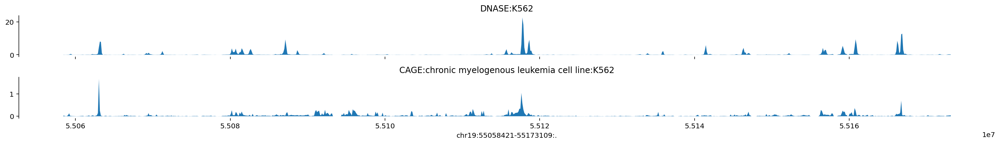

In [22]:
#basal
sequence_one_hot = one_hot_encode(fasta_extractor.extract(target_interval.resize(SEQUENCE_LENGTH)))
predictions = model.predict_on_batch(sequence_one_hot[np.newaxis])['human'][0]

tracks = {'DNASE:K562': predictions[:, 121],
          'CAGE:chronic myelogenous leukemia cell line:K562': np.log10(1 + predictions[:,  4828]),
         }
plot_tracks(tracks, target_interval)

print(predictions[446:449,  4828])

[1.33982256e-01 1.98563993e-01 1.65675685e-01 3.22495461e-01
 1.08778141e-01 1.00518808e-01 1.98136973e+00 2.27025419e-01
 1.57114938e-01 1.51070118e+00 3.22887535e+01 2.24865051e+02
 2.74669170e+00 1.08805561e+00 1.88539553e+00 3.97641420e+00
 4.32988071e+00 2.20379925e+00 2.44842987e+01 2.68654990e+00
 6.27997017e+00 4.43944263e+00 4.04118681e+00 1.39865713e+01
 1.05379543e+01 1.04707432e+01 5.01014423e+00 4.29462814e+00
 1.49879467e+00 2.24069786e+00 2.64951015e+00 4.15263176e+00
 2.45712805e+00 2.78414607e+00 2.40913725e+00 4.40430593e+00
 5.96024394e-01 9.47770238e-01 5.93232651e+01 8.80214155e-01
 2.36589983e-01 1.36645198e-01 2.27013931e-01 2.31643572e-01
 1.77087530e-01 1.23265699e-01 9.20582637e-02 1.09976925e-01
 7.51922950e-02 6.00896999e-02]
0.88021415
450.33494552224874


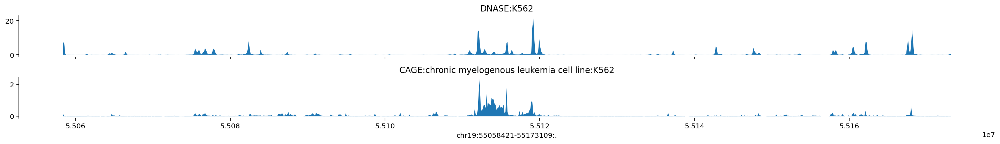

In [24]:
test_segal_insertion(insert, landmark)

[1.54220998e-01 1.62446678e-01 3.89443070e-01 1.23471439e-01
 9.18764547e-02 1.21703768e+00 9.11660492e-01 1.47335246e-01
 3.25489968e-01 2.47270823e+00 2.72471191e+02 3.55673409e+00
 7.66894817e-01 1.15805876e+00 1.57051396e+00 6.05836344e+00
 2.43649697e+00 5.19332504e+00 2.20972443e+01 1.43209302e+00
 6.28258848e+00 3.79287887e+00 8.02351284e+00 1.41550684e+01
 1.04143505e+01 5.96459627e+00 4.50381947e+00 2.55597138e+00
 1.32501960e+00 2.36493325e+00 3.71715212e+00 4.05997992e+00
 2.21353531e+00 3.03553820e+00 2.43035150e+00 2.34037709e+00
 8.78422976e-01 3.58075833e+00 6.36867485e+01 2.80664206e-01
 1.76937848e-01 1.38557956e-01 2.59184211e-01 1.90160677e-01
 1.64599732e-01 8.46002400e-02 1.08452663e-01 7.85847008e-02
 7.51595572e-02 6.23128973e-02]
63.68675
469.6814237199724


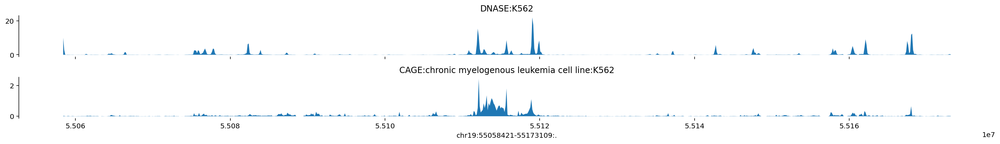

In [25]:
test_segal_insertion(insert, landmark, extra_offset = -64)

[1.2843280e-01 2.3460323e-01 1.1710190e-01 1.6161411e-01 1.0328211e-01
 1.6739190e-01 1.1878428e-01 2.8360400e-01 2.7833068e-01 1.7091267e-01
 1.6745147e-01 1.4708002e+00 2.1938236e+01 6.0769868e-01 6.0922432e-01
 1.5488605e+00 1.2547586e+00 1.7535677e+00 1.3415875e+00 3.1550922e+00
 1.4457585e+00 1.0124197e+00 1.6891141e+00 4.1325097e+00 4.1026053e+00
 4.7091165e+00 5.0173988e+00 3.8046269e+00 1.6365569e+00 1.5486526e+00
 3.3957937e+00 2.0371206e+00 6.5612044e+00 5.7612014e-01 1.4778230e+00
 9.3071127e-01 5.4753798e-01 3.5936341e-01 3.5012698e-01 1.2575515e+02
 1.3771809e+01 4.7579002e-01 9.2354506e-02 1.0593621e-01 1.1400522e+00
 1.2443655e-01 1.2590471e-01 3.8849524e-01 1.7567740e-01 1.5753272e-01]
21.938236
223.25903371721506


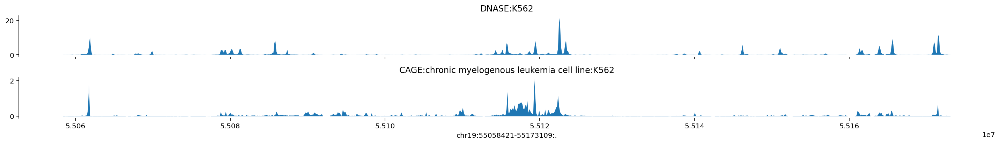

In [384]:
# revcomp
insert_rc = rev_comp_sequence(full_insert[:4658] + prom + full_insert[4822:])
landmark_rc = len(full_insert[4822:]) + len(prom)//2


test_segal_insertion(insert_rc, landmark_rc, extra_offset = 0)

[1.91823974e-01 1.62304342e-01 1.01897053e-01 1.35274425e-01
 6.97281063e-02 1.24960661e-01 1.35093257e-01 1.73050851e-01
 1.17851354e-01 1.04759686e-01 2.12165847e-01 1.40343216e+02
 8.91673863e-02 1.52974784e-01 2.91812629e-01 9.26686406e-01
 1.34679770e+00 1.58327186e+00 3.17440104e+00 2.91848230e+00
 7.81491935e-01 1.11152267e+00 3.64891529e+00 4.45342779e+00
 4.12207031e+00 4.19419956e+00 4.41034794e+00 2.71598220e+00
 1.65073204e+00 2.54683232e+00 1.13233590e+00 1.05516853e+01
 7.90211976e-01 7.94540763e-01 1.32523096e+00 7.10909188e-01
 3.22226077e-01 3.43759149e-01 5.84998667e-01 1.51458038e+02
 6.12806916e-01 1.65975451e-01 9.10630152e-02 4.49610919e-01
 6.52175963e-01 1.28316790e-01 2.04318076e-01 3.85273397e-01
 1.82068065e-01]
140.34322
352.8767866194248


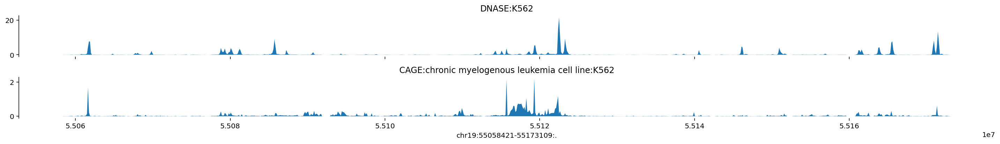

In [41]:
test_segal_insertion(insert_rc, landmark_rc, extra_offset = -64)

### Remove everything except the core promoter and the egfp

This produces a decent amount of expression...

[ 0.40856892  4.8759627  64.23136     5.1201234   0.88857037  0.8322495
  1.2614921   0.7198976   0.14121477]
64.23136
78.47944085299969


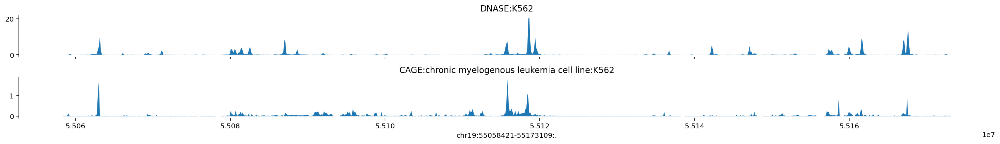

In [26]:
# with no offset
insert_min = prom + egfp_seq

landmark_min = len(prom)//2

test_segal_insertion(insert_min, landmark_min, extra_offset = 0)

[ 0.20710032  0.83652216 44.79255    57.840878    1.72739     0.7008133
  2.4404638   0.9722616   0.581627  ]
44.79255
110.09960488975048


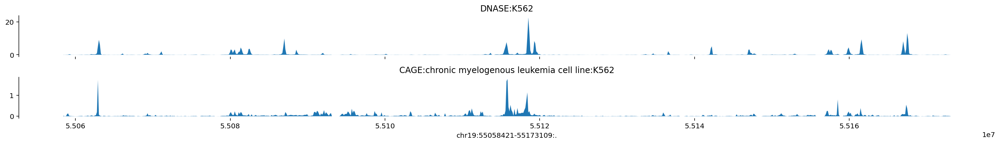

In [27]:
# with -64 offset
test_segal_insertion(insert_min, landmark_min, extra_offset = -64)

### Only insert a coding sequence

Reassuringly, this does not create expression

[0.04325084 0.20858188 0.14963797 0.31208986 0.41771558 0.65427756
 0.27135572 0.08909857]
0.41771558
2.1460079811513424


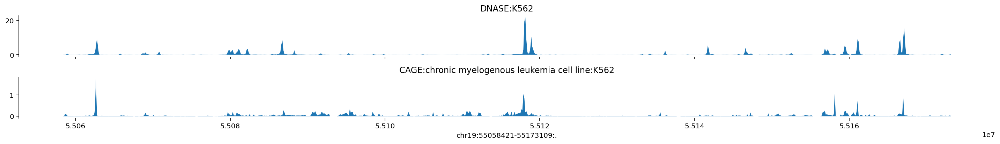

In [28]:
insert_egfp = egfp_seq

landmark =  len(egfp_seq)//2

test_segal_insertion(insert_egfp, landmark, extra_offset = -64)

## Analysis

In [222]:
# load enformer
pred_col = 'CAGE:chronic myelogenous leukemia cell line:K562  ENCODE, biol__landmark_sum'
pred_col_dnase = 'DNASE:K562_landmark_sum'

merged_df = pd.read_csv(base_path_results + "segal_promoters-enformer-latest_results.tsv", sep='\t')
merged_df = (merged_df
              .groupby(["Oligo_index","insert_type"])[[col for col in merged_df.keys() if col.startswith("CAGE") or col.startswith("DNASE")]]
              .mean()
              .reset_index())

merged_df_full = merged_df.query('insert_type == "full"')
merged_df_fullrv = merged_df.query('insert_type == "full_rv"')
merged_df_min = merged_df.query('insert_type == "minimal"')

In [223]:
# load basenji2
merged_df_basenji2 = pd.read_csv(base_path_results + "segal_promoters-basenji2-latest_results.tsv", sep='\t')
merged_df_basenji2 = (merged_df_basenji2
              .groupby(["Oligo_index","insert_type"])[[col for col in merged_df_basenji2.keys() if col.startswith("CAGE") or col.startswith("DNASE")]]
              .mean()
              .reset_index())

merged_df_full_basenji2 = merged_df_basenji2.query('insert_type == "full"')
merged_df_fullrv_basenji2 = merged_df_basenji2.query('insert_type == "full_rv"')
merged_df_min_basenji2 = merged_df_basenji2.query('insert_type == "minimal"')

In [224]:
# load basenji1
merged_df_basenji1 = pd.read_csv(base_path_results + "segal_promoters-basenji1-latest_results.tsv", sep='\t')
merged_df_basenji1 = (merged_df_basenji1
              .groupby(["Oligo_index","insert_type"])[[col for col in merged_df_basenji1.keys() if col.startswith("CAGE") or col.startswith("DNASE")]]
              .mean()
              .reset_index())

# combine replicates
merged_df_basenji1[pred_col] = (merged_df_basenji1['CAGE:chronic myelogenous leukemia cell line:K562 ENCODE, biol_rep1_landmark_sum']
                               + merged_df_basenji1['CAGE:chronic myelogenous leukemia cell line:K562 ENCODE, biol_rep2_landmark_sum']
                               + merged_df_basenji1['CAGE:chronic myelogenous leukemia cell line:K562 ENCODE, biol_rep3_landmark_sum']
                               )/3

merged_df_full_basenji1 = merged_df_basenji1.query('insert_type == "full"')
merged_df_fullrv_basenji1 = merged_df_basenji1.query('insert_type == "full_rv"')
merged_df_min_basenji1 = merged_df_basenji1.query('insert_type == "minimal"')

In [225]:
native_df = pd.read_csv(base_path_data + "native_core_promoters.tsv",sep="\t").rename(columns={"GFP_RFP_ratio(mean exp)":"mean_exp"})
native_df["Set"] = "Native"
pic_df = pd.read_csv(base_path_data + "pic_binding_sites.tsv",sep="\t").rename(columns={"GFP_RFP_ratio(mean exp)":"mean_exp"})
elements_df = pd.read_csv(base_path_data + "synthetic_configurations_of_core_promoters.tsv",sep="\t").rename(columns={"GFP_RFP_ratio(mean exp)":"mean_exp"})
tata_shift_df = pd.read_csv(base_path_data + "tata_inr_shift.tsv",sep="\t").rename(columns={"GFP_RFP_ratio(mean exp)":"mean_exp"})
tf_activity_df = pd.read_csv(base_path_data + "tf_activity_screen.tsv", sep="\t").rename(columns={"GFP_RFP_ratio(mean exp)":"mean_exp"})
tf_multiplicity_df = pd.read_csv(base_path_data + "tf_multiplicity_screen.tsv", sep="\t").rename(columns={"GFP_RFP_ratio(mean exp)":"mean_exp"})

In [226]:
tf_activity_df = tf_activity_df.drop_duplicates(subset=["Oligo_index","mean_exp"])

### Native Promoters

We see a good correlation with measured expression of endogenous promoters, regardless whether we use the full insert or the limited one.

#### Enformer

In [227]:
native_tested_full = merged_df_full.merge(native_df,on="Oligo_index").dropna(subset=["mean_exp"])
native_tested_fullrv = merged_df_fullrv.merge(native_df,on="Oligo_index").dropna(subset=["mean_exp"])
native_tested_min = merged_df_min.merge(native_df,on="Oligo_index").dropna(subset=["mean_exp"])

In [228]:
# full insert
subset = native_tested_fullrv
print(scipy.stats.pearsonr(np.log2(subset[pred_col]+1),
                           np.log2(subset["mean_exp"])))
print(scipy.stats.spearmanr(subset[pred_col],
                           subset["mean_exp"]))

subset = native_tested_full
print(scipy.stats.pearsonr(np.log2(subset[pred_col]+1),
                           np.log2(subset["mean_exp"])))
print(scipy.stats.spearmanr(subset[pred_col],
                           subset["mean_exp"]))

# min insert
subset = native_tested_min
print(scipy.stats.pearsonr(np.log2(subset[pred_col]+1),
                           np.log2(subset["mean_exp"])))
#print(pearsonr_ci(np.log2(subset[pred_col]+1),np.log2(subset["mean_exp"]),alpha=0.05))
print(scipy.stats.spearmanr(subset[pred_col],
                           subset["mean_exp"]))

# is enformer better than the invivo expression?
#print("\nK562 expression of associated gene vs MPRA")
#print(scipy.stats.pearsonr(np.log2(subset['K562_RPM_Mean']+1),
#                           np.log2(subset["mean_exp"])))
#print(pearsonr_ci(np.log2(subset['K562_RPM_Mean']+1),np.log2(subset["mean_exp"]),alpha=0.05))
#print(scipy.stats.spearmanr(subset['K562_RPM_Mean'],
#                           subset["mean_exp"]))
#print("\nK562 expression of associated gene vs Enformer prediction")
#print(scipy.stats.pearsonr(np.log2(subset['K562_RPM_Mean']+1),
#                           np.log2(subset[pred_col]+1)))
#print(scipy.stats.spearmanr(subset['K562_RPM_Mean'],
#                           subset[pred_col]))

(0.5356362838592976, 5.961568853360143e-101)
SpearmanrResult(correlation=0.5599095535548252, pvalue=4.447856894518011e-112)
(0.5179455041581111, 2.144313709434835e-93)
SpearmanrResult(correlation=0.5321114632297392, pvalue=2.0738370322298762e-99)
(0.559197760420829, 9.719582087892048e-112)
SpearmanrResult(correlation=0.5777892171668921, pvalue=6.968281259906013e-121)


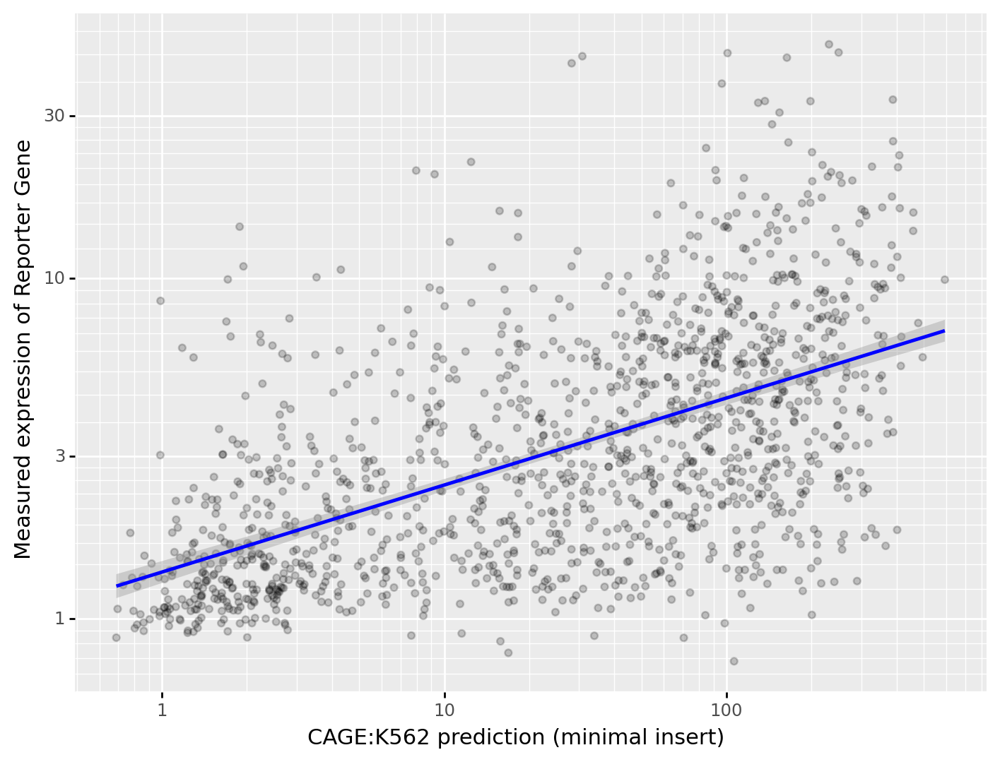

<ggplot: (1405546653465)>

In [229]:
scale = 1.3
p9.options.figure_size = (6.4*scale, 4.8*scale)
(p9.ggplot(data=native_tested_min,mapping=p9.aes(x=pred_col,y='mean_exp'))
 + p9.geom_point(alpha=0.2)
 #+ p9.geom_bin2d(binwidth = (0.05, 0.05))
 + p9.scale_x_log10()
 + p9.scale_y_log10()
 + p9.geom_smooth(method="lm",color="blue")
 + p9.labs(x="CAGE:K562 prediction (minimal insert)", y="Measured expression of Reporter Gene")
)

#### Basenji2

In [230]:
native_tested_full_basenji2 = merged_df_full_basenji2.merge(native_df,on="Oligo_index").dropna(subset=["mean_exp"])
native_tested_fullrv_basenji2 = merged_df_fullrv_basenji2.merge(native_df,on="Oligo_index").dropna(subset=["mean_exp"])
native_tested_min_basenji2 = merged_df_min_basenji2.merge(native_df,on="Oligo_index").dropna(subset=["mean_exp"])

In [231]:
# full insert
subset = native_tested_fullrv_basenji2
print(scipy.stats.pearsonr(np.log2(subset[pred_col]+1),
                           np.log2(subset["mean_exp"])))
print(scipy.stats.spearmanr(subset[pred_col],
                           subset["mean_exp"]))

subset = native_tested_full_basenji2
print(scipy.stats.pearsonr(np.log2(subset[pred_col]+1),
                           np.log2(subset["mean_exp"])))
print(scipy.stats.spearmanr(subset[pred_col],
                           subset["mean_exp"]))

# min insert
subset = native_tested_min_basenji2
print(scipy.stats.pearsonr(np.log2(subset[pred_col]+1),
                           np.log2(subset["mean_exp"])))
#print(pearsonr_ci(np.log2(subset[pred_col]+1),np.log2(subset["mean_exp"]),alpha=0.05))
print(scipy.stats.spearmanr(subset[pred_col],
                           subset["mean_exp"]))

(0.5096732111394421, 5.178207484292657e-90)
SpearmanrResult(correlation=0.5230885729409219, pvalue=1.5154246711431487e-95)
(0.5017152657424795, 7.617134503314044e-87)
SpearmanrResult(correlation=0.5184689580114924, pvalue=1.3003841057891562e-93)
(0.49292021063410196, 1.9343851567139335e-83)
SpearmanrResult(correlation=0.556162567094808, pvalue=2.6675517615962944e-110)


#### Basenji1

In [232]:
native_tested_full_basenji1 = merged_df_full_basenji1.merge(native_df,on="Oligo_index").dropna(subset=["mean_exp"])
native_tested_fullrv_basenji1 = merged_df_fullrv_basenji1.merge(native_df,on="Oligo_index").dropna(subset=["mean_exp"])
native_tested_min_basenji1 = merged_df_min_basenji1.merge(native_df,on="Oligo_index").dropna(subset=["mean_exp"])

In [233]:
# full insert
subset = native_tested_fullrv_basenji1
print(scipy.stats.pearsonr(np.log2(subset[pred_col]+1),
                           np.log2(subset["mean_exp"])))
print(scipy.stats.spearmanr(subset[pred_col],
                           subset["mean_exp"]))

subset = native_tested_full_basenji1
print(scipy.stats.pearsonr(np.log2(subset[pred_col]+1),
                           np.log2(subset["mean_exp"])))
print(scipy.stats.spearmanr(subset[pred_col],
                           subset["mean_exp"]))

# min insert
subset = native_tested_min_basenji1
print(scipy.stats.pearsonr(np.log2(subset[pred_col]+1),
                           np.log2(subset["mean_exp"])))
#print(pearsonr_ci(np.log2(subset[pred_col]+1),np.log2(subset["mean_exp"]),alpha=0.05))
print(scipy.stats.spearmanr(subset[pred_col],
                           subset["mean_exp"]))

(0.49086721498015584, 1.1670589854328772e-82)
SpearmanrResult(correlation=0.5071555098476428, pvalue=5.313918003362955e-89)
(0.47193522925049514, 1.0469223737036288e-75)
SpearmanrResult(correlation=0.4843633342918161, pvalue=3.199331678009176e-80)
(0.4717608190765058, 1.2076981268869968e-75)
SpearmanrResult(correlation=0.5125628502716185, pvalue=3.4919128421705125e-91)


### Promoter directionality


Weingarten-Gabbay et al. find that most promoters they tested are directional, i.e. they drive expression much stronger of the 3' reporter in one orientation than the other.
As a result, the correlation in measured reporter gene expression between oligos where promoters are placed in forward or in reverse orientation, is very low.

Enformer does not reproduce this result. In the full insert, there is a pretty strong correlation between forward and reverse expression. In the minimal insert, it is somewhat reduced but still present. The issue is that we cannot ask enformer in which direction it is predicting transcription to occur - the model only predicts CAGE.

In [234]:
pic_tested_fullrv = merged_df_fullrv.merge(pic_df,on="Oligo_index").dropna(subset=["mean_exp"])
pic_tested_min = merged_df_min.merge(pic_df,on="Oligo_index").dropna(subset=["mean_exp"])

In [235]:
print(scipy.stats.pearsonr(np.log2(pic_tested_fullrv[pred_col]+1),
                           np.log2(pic_tested_fullrv["mean_exp"])))
print(scipy.stats.spearmanr(np.log2(pic_tested_fullrv[pred_col]+1),
                           pic_tested_fullrv["mean_exp"]))

(0.5234356612271551, 1.7640156723999623e-66)
SpearmanrResult(correlation=0.4053721852442436, pvalue=4.6993246128959597e-38)


In [236]:
print(scipy.stats.pearsonr(np.log2(pic_tested_min[pred_col]+1),
                           np.log2(pic_tested_min["mean_exp"])))
print(scipy.stats.spearmanr(np.log2(pic_tested_min[pred_col]+1),
                           pic_tested_min["mean_exp"]))

(0.6669825337167796, 1.324612209056893e-120)
SpearmanrResult(correlation=0.49993207415260377, pvalue=6.715906443331664e-60)


In [237]:
# Compute correlation between forward and reverse for each
pic_fw = pic_tested_fullrv.query('CP_Orientation == "Fw"')
pic_rv = pic_tested_fullrv.query('CP_Orientation == "Rv"')
cols = ['Oligo_index',pred_col,'mean_exp','TFIIB_ID']
pic_orient = pic_fw[cols].merge(pic_rv[cols],on=['TFIIB_ID'],suffixes=("_fw","_rv"))

print("Measured")
print(scipy.stats.pearsonr(np.log2(pic_orient['mean_exp_fw']),
                           np.log2(pic_orient["mean_exp_rv"])))
print(scipy.stats.spearmanr((pic_orient['mean_exp_fw']),
                           pic_orient["mean_exp_rv"]))
print("Predicted")
print(scipy.stats.pearsonr(np.log2(pic_orient[pred_col + '_fw']),
                           np.log2(pic_orient[pred_col + "_rv"])))
print(scipy.stats.spearmanr((pic_orient[pred_col + '_fw']),
                           pic_orient[pred_col + "_rv"]))

Measured
(0.11136997417760167, 0.019452473664242804)
SpearmanrResult(correlation=0.24359756381023837, pvalue=2.2994161141026062e-07)
Predicted
(0.8188367061435726, 1.2008043024908978e-107)
SpearmanrResult(correlation=0.719204390086847, pvalue=2.8667518540163416e-71)


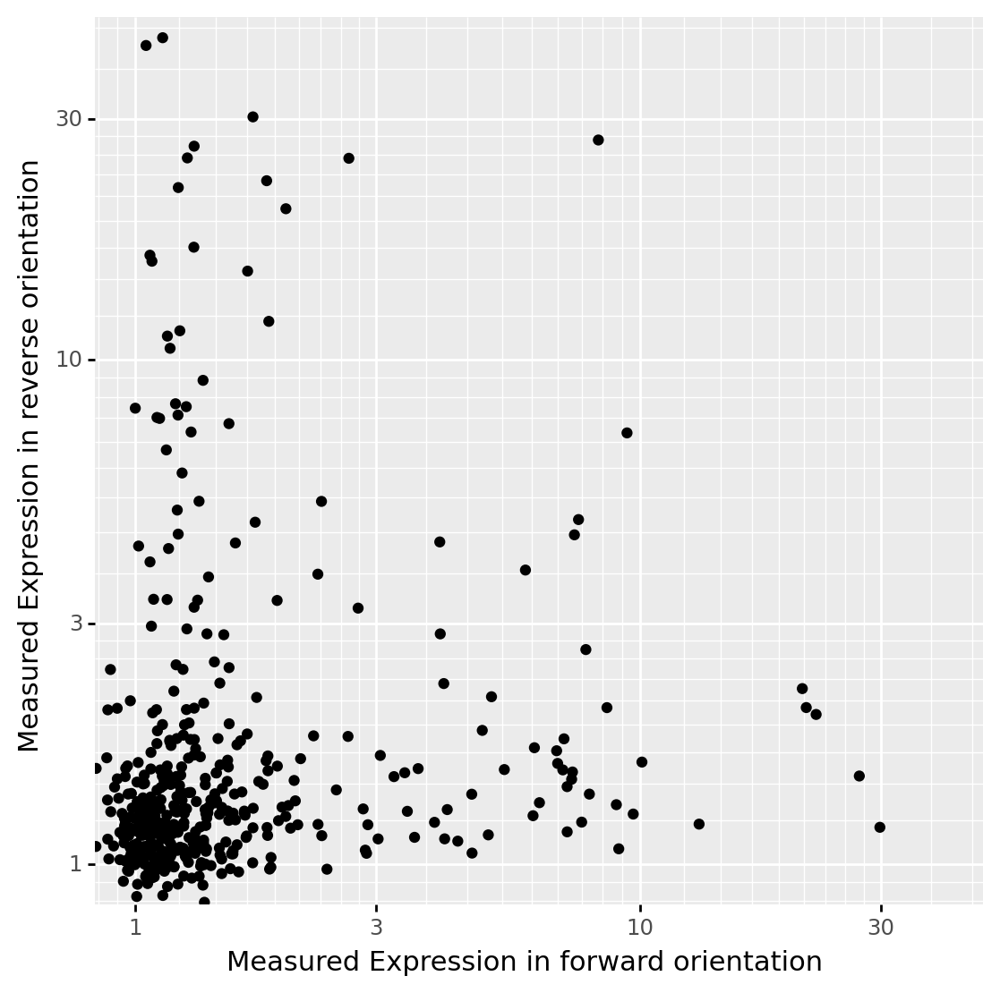

<ggplot: (1405546434030)>

In [238]:
scale = 1.0
p9.options.figure_size = (6.4*scale, 4.8*scale)
(p9.ggplot(data=pic_orient,mapping=p9.aes(x='mean_exp_fw',y='mean_exp_rv'))
 + p9.geom_point(alpha=1)
 + p9.scale_x_log10()
 + p9.scale_y_log10()
 + p9.labs(x="Measured Expression in forward orientation", y="Measured Expression in reverse orientation")
 + p9.coord_fixed(xlim=(0,1.6),ylim=(0,1.6))
)

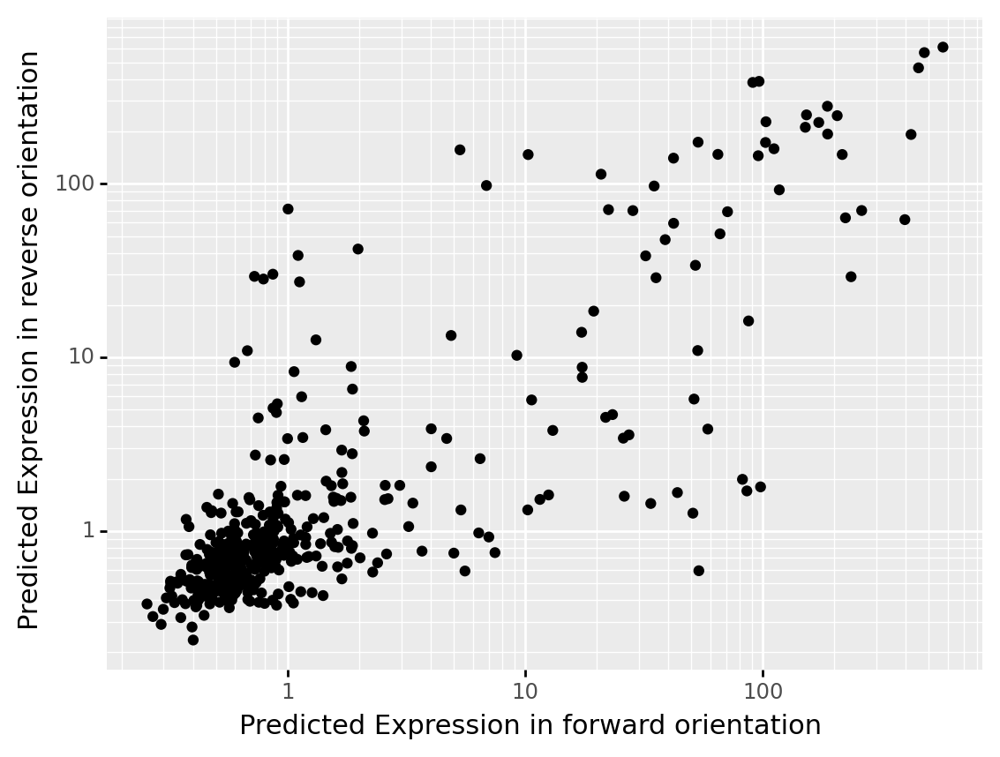

<ggplot: (1405544780740)>

In [239]:
scale = 1.0
p9.options.figure_size = (6.4*scale, 4.8*scale)
(p9.ggplot(data=pic_orient,mapping=p9.aes(x=pred_col+'_fw',y=pred_col+'_rv'))
 + p9.geom_point(alpha=1)
 + p9.scale_x_log10()
 + p9.scale_y_log10()
 + p9.labs(x="Predicted Expression in forward orientation", y="Predicted Expression in reverse orientation")
 #+ p9.coord_fixed(xlim=(0,2),ylim=(0,2))
)

### All endogenous constructs with Promoter/PIC activity

We combine the native promoter set with the set of tested constructs that were associated with in-vivo PIC activity, to get a bigger testset.

This is our set of endogenous promoters.

All models do reasonably well, but Enformer clearly performs the best. The minimal insert also (slightly) outperforms the full one.

#### Enformer

In [240]:
columns = [pred_col, "Oligo_index", "mean_exp", "CV(std/mean)", "Oligo_Sequence"]

native_tested_min = merged_df_min.merge(native_df,on="Oligo_index").dropna(subset=["mean_exp"])
pic_tested_min = merged_df_min.merge(pic_df.rename(columns={"Oligo_sequence":"Oligo_Sequence"}),on="Oligo_index").dropna(subset=["mean_exp"])
endogenous_min = pd.concat([native_tested_min[columns],pic_tested_min[columns]])
endogenous_min = endogenous_min.drop_duplicates()

native_tested_fullrv = merged_df_fullrv.merge(native_df,on="Oligo_index").dropna(subset=["mean_exp"])
pic_tested_fullrv = merged_df_fullrv.merge(pic_df.rename(columns={"Oligo_sequence":"Oligo_Sequence"}),on="Oligo_index").dropna(subset=["mean_exp"])
endogenous_fullrv = pd.concat([native_tested_fullrv[columns],pic_tested_fullrv[columns]])

In [241]:
print(scipy.stats.pearsonr(np.log2(endogenous_min[pred_col]+1),
                           np.log2(endogenous_min["mean_exp"])))
print(scipy.stats.spearmanr(endogenous_min[pred_col],
                           endogenous_min["mean_exp"]))

(0.6768047424656459, 1.4365754918111232e-304)
SpearmanrResult(correlation=0.7135753456540738, pvalue=0.0)


In [242]:
len(endogenous_min)

2274

In [243]:
print(scipy.stats.pearsonr(np.log2(endogenous_fullrv[pred_col]+1),
                           np.log2(endogenous_fullrv["mean_exp"])))
print(scipy.stats.spearmanr(endogenous_fullrv[pred_col],
                           endogenous_fullrv["mean_exp"]))

(0.621739144380085, 1.0485675320673655e-243)
SpearmanrResult(correlation=0.6571680440750182, pvalue=1.2299854674922582e-281)


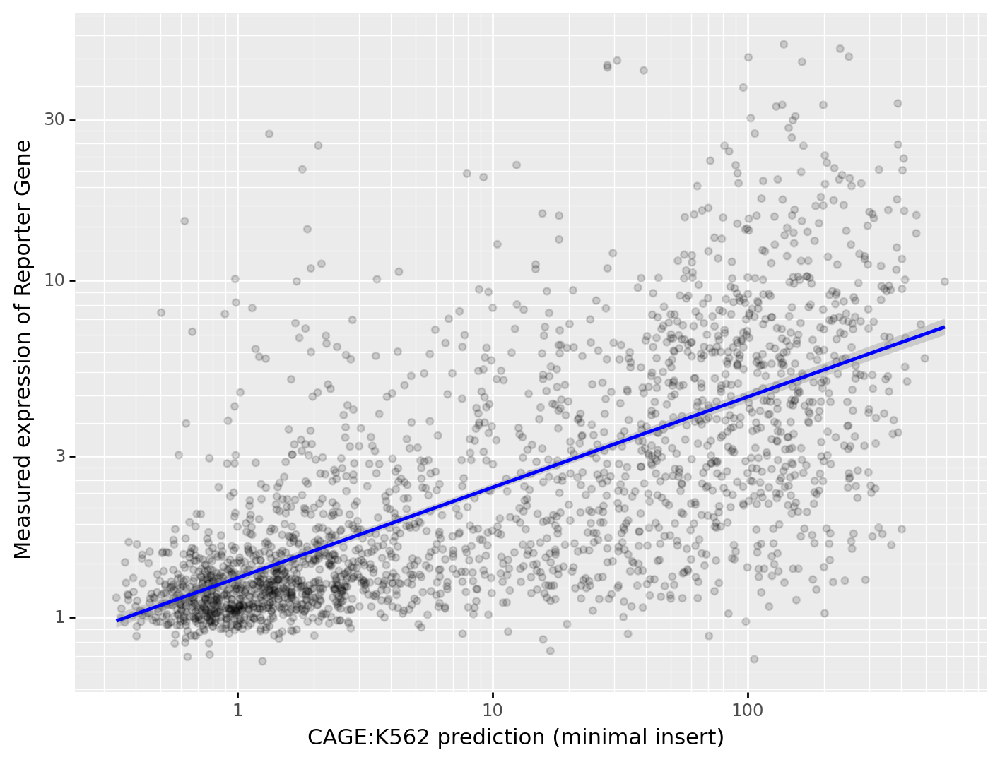

<ggplot: (1405542611170)>

In [244]:
scale = 1.3
p9.options.figure_size = (6.4*scale, 4.8*scale)
(p9.ggplot(data=endogenous_min,mapping=p9.aes(x=pred_col,y='mean_exp'))
 + p9.geom_point(alpha=0.15)
 #+ p9.geom_bin2d(binwidth = (0.05, 0.05))
 + p9.scale_x_log10()
 + p9.scale_y_log10()
 + p9.geom_smooth(method="lm",color="blue")
 + p9.labs(x="CAGE:K562 prediction (minimal insert)", y="Measured expression of Reporter Gene")
)

#### Basenji2

In [245]:
columns = [pred_col, "Oligo_index", "mean_exp", "CV(std/mean)", "Oligo_Sequence"]

native_tested_min_basenji2 = merged_df_min_basenji2.merge(native_df,on="Oligo_index").dropna(subset=["mean_exp"])
pic_tested_min_basenji2 = merged_df_min_basenji2.merge(pic_df.rename(columns={"Oligo_sequence":"Oligo_Sequence"}),on="Oligo_index").dropna(subset=["mean_exp"])
endogenous_min_basenji2 = pd.concat([native_tested_min_basenji2[columns],pic_tested_min_basenji2[columns]])
endogenous_min_basenji2 = endogenous_min_basenji2.drop_duplicates()

native_tested_fullrv_basenji2 = merged_df_fullrv_basenji2.merge(native_df,on="Oligo_index").dropna(subset=["mean_exp"])
pic_tested_fullrv_basenji2 = merged_df_fullrv_basenji2.merge(pic_df.rename(columns={"Oligo_sequence":"Oligo_Sequence"}),on="Oligo_index").dropna(subset=["mean_exp"])
endogenous_fullrv_basenji2 = pd.concat([native_tested_fullrv_basenji2[columns],pic_tested_fullrv_basenji2[columns]])

In [246]:
print(scipy.stats.pearsonr(np.log2(endogenous_min_basenji2[pred_col]+1),
                           np.log2(endogenous_min_basenji2["mean_exp"])))
print(scipy.stats.spearmanr(endogenous_min_basenji2[pred_col],
                           endogenous_min_basenji2["mean_exp"]))

print(scipy.stats.pearsonr(np.log2(endogenous_fullrv_basenji2[pred_col]+1),
                           np.log2(endogenous_fullrv_basenji2["mean_exp"])))
print(scipy.stats.spearmanr(endogenous_fullrv_basenji2[pred_col],
                           endogenous_fullrv_basenji2["mean_exp"]))

(0.6257345576451048, 2.0490922110511737e-247)
SpearmanrResult(correlation=0.7096905003776022, pvalue=0.0)
(0.6161552466097429, 3.629985002974387e-238)
SpearmanrResult(correlation=0.6760373412716048, pvalue=5.05723446072418e-304)


#### Basenji1

In [247]:
columns = [pred_col, "Oligo_index", "mean_exp", "CV(std/mean)", "Oligo_Sequence"]

native_tested_min_basenji1 = merged_df_min_basenji1.merge(native_df,on="Oligo_index").dropna(subset=["mean_exp"])
pic_tested_min_basenji1 = merged_df_min_basenji1.merge(pic_df.rename(columns={"Oligo_sequence":"Oligo_Sequence"}),on="Oligo_index").dropna(subset=["mean_exp"])
endogenous_min_basenji1 = pd.concat([native_tested_min_basenji1[columns],pic_tested_min_basenji1[columns]])
endogenous_min_basenji1 = endogenous_min_basenji1.drop_duplicates()

native_tested_fullrv_basenji1 = merged_df_fullrv_basenji1.merge(native_df,on="Oligo_index").dropna(subset=["mean_exp"])
pic_tested_fullrv_basenji1 = merged_df_fullrv_basenji1.merge(pic_df.rename(columns={"Oligo_sequence":"Oligo_Sequence"}),on="Oligo_index").dropna(subset=["mean_exp"])
endogenous_fullrv_basenji1 = pd.concat([native_tested_fullrv_basenji1[columns],pic_tested_fullrv_basenji1[columns]])

In [248]:
print(scipy.stats.pearsonr(np.log2(endogenous_min_basenji1[pred_col]+1),
                           np.log2(endogenous_min_basenji1["mean_exp"])))
print(scipy.stats.spearmanr(endogenous_min_basenji1[pred_col],
                           endogenous_min_basenji1["mean_exp"]))

print(scipy.stats.pearsonr(np.log2(endogenous_fullrv_basenji1[pred_col]+1),
                           np.log2(endogenous_fullrv_basenji1["mean_exp"])))
print(scipy.stats.spearmanr(endogenous_fullrv_basenji1[pred_col],
                           endogenous_fullrv_basenji1["mean_exp"]))

(0.5930871930937106, 3.871564458029421e-216)
SpearmanrResult(correlation=0.6762530562465552, pvalue=6.867012643215849e-304)
(0.5968008427929035, 8.385377927008165e-220)
SpearmanrResult(correlation=0.6537174944710721, pvalue=1.0227292668469351e-277)


#### Compare the models

In [249]:
xpresso_df = pd.read_csv(base_path_results_xpresso + "xpresso_predictions.tsv", sep="\t")
xpresso_df = xpresso_df.query('offset in [-3,0] & insert_type == "full"')[["Oligo_index","insert_type","Prediction"]]
xpresso_df = (xpresso_df
              .groupby(["Oligo_index","insert_type"])["Prediction"]
              .mean()
              .reset_index())
xpresso_df = xpresso_df[["Oligo_index","Prediction"]].rename(columns={"Prediction":"xpresso_pred"})

endogenous_min = xpresso_df.merge(endogenous_min,on=["Oligo_index"])

endogenous_min["GC_content"] = (endogenous_min["Oligo_Sequence"].apply(lambda x: np.sum([nt in ["G","C"] for nt in x])))/164

endogenous_min = endogenous_min.merge(endogenous_min_basenji1[["Oligo_index",pred_col]].rename(columns={pred_col:"basenji1_pred"}),on=["Oligo_index"])

endogenous_min = endogenous_min.merge(endogenous_min_basenji2[["Oligo_index",pred_col]].rename(columns={pred_col:"basenji2_pred"}),on=["Oligo_index"])

In [250]:
len(endogenous_min)

2274

In [251]:
task = "Endogenous\nPromoters"

row_list = [
    {"model":"GC content",
     "Dataset":task,
     "r":scipy.stats.pearsonr(endogenous_min["GC_content"],np.log2(endogenous_min["mean_exp"]))[0]},
    {"model":"Xpresso",
     "Dataset":task,
     "r":scipy.stats.pearsonr(endogenous_min["xpresso_pred"],np.log2(endogenous_min["mean_exp"]))[0]},
    {"model":"Basenji1",
     "Dataset":task,
     "r":scipy.stats.pearsonr(np.log2(endogenous_min["basenji1_pred"]+1),np.log2(endogenous_min["mean_exp"]))[0]},
    {"model":"Basenji2",
     "Dataset":task,
     "r":scipy.stats.pearsonr(np.log2(endogenous_min["basenji2_pred"]+1),np.log2(endogenous_min["mean_exp"]))[0]},
    {"model":"Enformer",
     "Dataset":task,
     "r":scipy.stats.pearsonr(np.log2(endogenous_min[pred_col]+1),np.log2(endogenous_min["mean_exp"]))[0]}
]
endogenous_corrs = pd.DataFrame(row_list)

In [252]:
endogenous_corrs

,model,Dataset,r
0,GC content,Endogenous\nPromoters,0.404834
1,Xpresso,Endogenous\nPromoters,0.491847
2,Basenji1,Endogenous\nPromoters,0.593087
3,Basenji2,Endogenous\nPromoters,0.625735
4,Enformer,Endogenous\nPromoters,0.676805


### TATA and other core promoter elements

Next, adding/removing core promoter motifs is tested in five backgrounds. In 3/5 backgrounds, all models fail to do well. But in 2/5 backgrounds Enformer does very well and better than the other models

In [253]:
elements_tested_fullrv = merged_df_fullrv.merge(elements_df,on="Oligo_index").dropna(subset=["mean_exp"])
elements_tested_min = merged_df_min.merge(elements_df,on="Oligo_index").dropna(subset=["mean_exp"])

In [254]:
def plot_motif_effect(motif, plot_df):
    dims = (4, 4)
    df = plot_df.query('Motif == "{}"'.format(motif))
    x = "x_lab"
    y = "log2_fc"
    #hue = "Motif_count"
    box_pairs=[
        (("-{}\nobserved".format(motif)), ("+{}\nobserved".format(motif))),
        (("-{}\npredicted".format(motif)), ("+{}\npredicted".format(motif)))
        ]
    fig, ax = plt.subplots(figsize=dims, dpi=100)
    ax = sns.boxplot(data=df, x=x, y=y, #hue=hue
                    )
    #plt.legend(bbox_to_anchor=(1, 0.5), title="Motif_count")
    statannot.add_stat_annotation(ax, data=df, x=x, y=y, #hue=hue, 
                                  box_pairs=box_pairs, comparisons_correction=None,
                        test='Mann-Whitney', loc='inside',  verbose=2)

    ax.set_xlabel("",fontsize=10, color="black")
    ax.set_ylabel("Expression change due to Motif\n(log2, relative to background)",fontsize=10, color="black")
    #plt.legend(bbox_to_anchor=(1, 0.5), title="Motif_count")
    #plt.setp(ax.get_legend().get_title(), fontsize='10')
    #plt.setp(ax.get_legend().get_texts(), fontsize='10')
    ax.tick_params(labelsize=10)
    plt.tight_layout()

In [255]:
def custom_boxplot(**kwargs):
    #df = plot_df.query('Motif == "{}"'.format(motif))
    #hue = "Motif_count"
    data = kwargs["data"]
    x = kwargs["x"]
    y = kwargs["y"]
    hue = kwargs.get("hue")
 
    motif = "Motif"

    box_pairs=[
        (("-{}\nobserved".format(motif)), ("+{}\nobserved".format(motif))),
        (("-{}\npredicted".format(motif)), ("+{}\npredicted".format(motif)))
        ]
    #fig, ax = plt.subplots(figsize=dims, dpi=100)
    ax = sns.boxplot(data=kwargs["data"],x=x, y=y)#, hue=kwargs["hue"])
    #ax.set_xlabel("",fontsize=10, color="black")
    #ax.set_ylabel("Expression change due to Motif\n(log2, relative to background)",fontsize=10, color="black")
    statannot.add_stat_annotation(ax, data=kwargs["data"], x=x, y=y, #hue=hue, 
                                  box_pairs=box_pairs, test='Mann-Whitney', 
                                  loc='inside',  verbose=0)

def plot_motif_effect_combined(df):
    df = df.copy()
    df["Log2 Fold Change vs Background"] = df["log2_fc"]
    df[" "] = pd.Categorical(df["x_lab"].apply(lambda x: x.split("\n")[0][0] + "Motif" + "\n" + x.split("\n")[1]),
                                categories=["-Motif\nobserved","+Motif\nobserved",
                                           "-Motif\npredicted","+Motif\npredicted"])
    
    # create plot
    g = sns.FacetGrid(df, col='Motif', height=5, col_wrap=3)
    g.map_dataframe(custom_boxplot, x = " ", y = "Log2 Fold Change vs Background")#, hue = "pred_obs")
    g.set_titles(col_template="{col_name}", y=1.00)

    plt.show()
    
#plot_motif_effect_combined(element_melt)

#### Enformer Full insert

In [256]:
print(scipy.stats.pearsonr(np.log2(elements_tested_fullrv[pred_col]+1),
                           np.log2(elements_tested_fullrv["mean_exp"])))
print(scipy.stats.spearmanr(np.log2(elements_tested_fullrv[pred_col]+1),
                           elements_tested_fullrv["mean_exp"]))

print(scipy.stats.pearsonr(np.log2(elements_tested_fullrv[pred_col_dnase]+1),
                           np.log2(elements_tested_fullrv["mean_exp"])))
print(scipy.stats.spearmanr(np.log2(elements_tested_fullrv[pred_col_dnase]+1),
                           elements_tested_fullrv["mean_exp"]))

(0.2934116164011616, 2.385615836282804e-07)
SpearmanrResult(correlation=0.27696841821732393, pvalue=1.146481273518419e-06)
(0.2997357876129929, 1.2696646725921956e-07)
SpearmanrResult(correlation=0.2265040066440708, pvalue=7.759995781083946e-05)


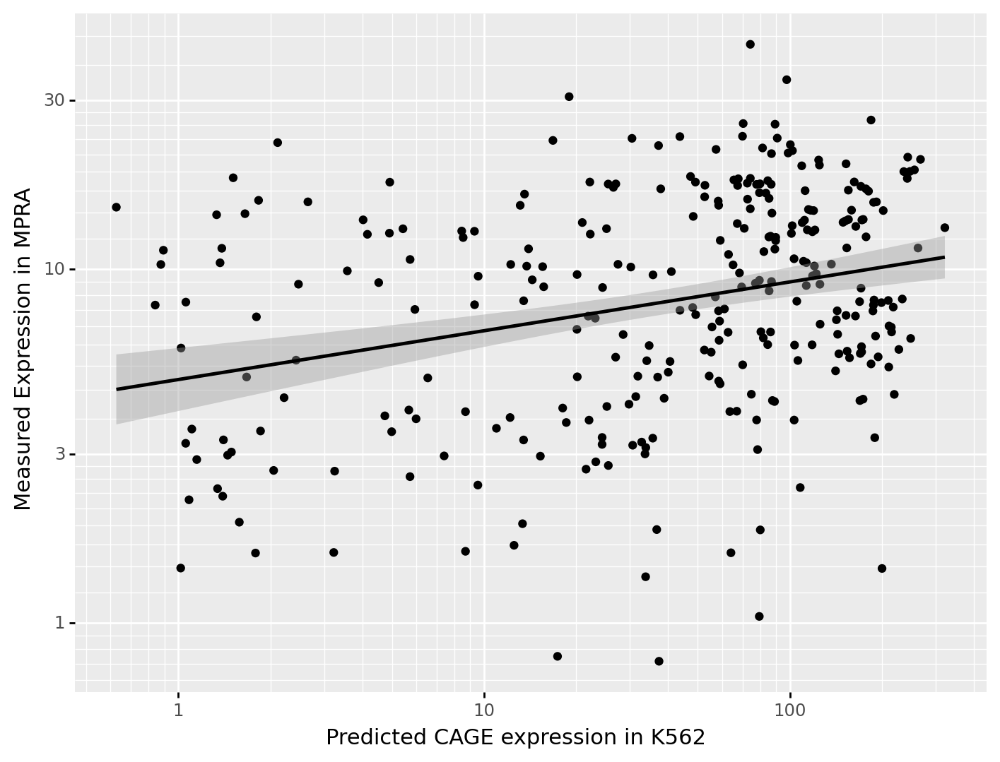

<ggplot: (1405545285310)>

In [257]:
scale = 1.3
p9.options.figure_size = (6.4*scale, 4.8*scale)
(p9.ggplot(data=elements_tested_fullrv,mapping=p9.aes(x=pred_col,y='mean_exp'))
 + p9.geom_point(alpha=1)
 + p9.scale_x_log10()
 + p9.scale_y_log10()
 + p9.geom_smooth(method="lm")
 + p9.labs(x="Predicted CAGE expression in K562", y="Measured Expression in MPRA")
)

In [258]:
for bg in set(elements_tested_fullrv["Background"]):
    print(bg)
    subset = elements_tested_fullrv.query('Background == @bg')
    print(scipy.stats.pearsonr(np.log2(subset[pred_col]),
                        np.log2(subset["mean_exp"])))

ACTB_CE_bg
(0.20156896024372908, 0.18424700476125214)
C14orf166_CE_bg
(0.6835806323468498, 9.194232338157268e-10)
CMV_CE_bg
(0.18185893782286844, 0.15037134726256224)
HIV1_CE_bg
(0.6217540380592089, 4.175650664547795e-08)
RPLP0_CE_bg
(0.07591087984579975, 0.5510555677467257)


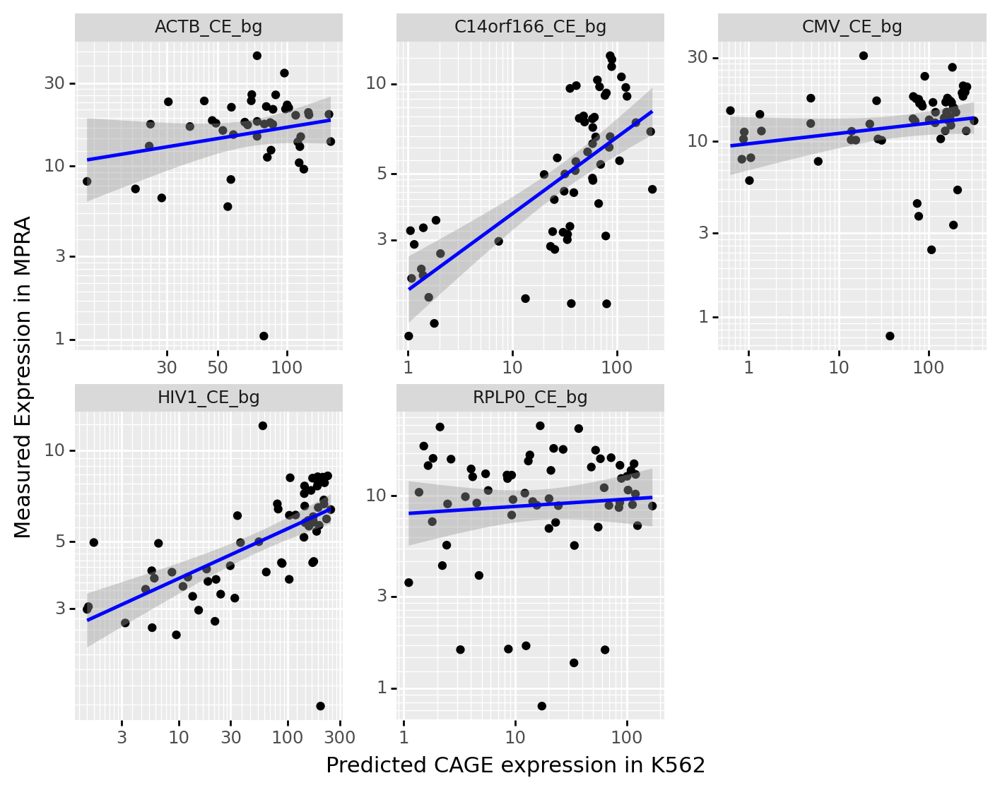

<ggplot: (1405643923143)>

In [259]:
scale = 1.3
p9.options.figure_size = (6.4*scale, 4.8*scale)
(p9.ggplot(data=elements_tested_fullrv,mapping=p9.aes(x=pred_col,y='mean_exp'))
 + p9.geom_point(alpha=1)
 + p9.scale_x_log10()
 + p9.scale_y_log10()
 + p9.geom_smooth(method="lm", color="blue")
 + p9.labs(x="Predicted CAGE expression in K562", y="Measured Expression in MPRA")
 + p9.theme(subplots_adjust={'wspace': 0.2,'hspace': 0.2})
 + p9.facet_wrap('~Background', scales="free")
)

In [260]:
# compute log2 fc caused by adding/deleting elements with respect to the background sequences
elements = ['BREu_position', 'TATA_position', 'BREd_position', 'Int_position', 'MTE_position', 'DPE_position']
background = elements_tested_fullrv.query('Configuration_summary == 0')[['Background', 'mean_exp', pred_col]]
altered = elements_tested_fullrv.query('Configuration_summary != 0')[['Background', 'mean_exp', pred_col] + elements]
element_expr = background.merge(altered,on='Background',suffixes=('_background','_altered'))
element_expr['log2_fc_obs'] = np.log2(element_expr['mean_exp_altered']) - np.log2(element_expr['mean_exp_background'])
element_expr['log2_fc_pred'] = np.log2(element_expr[pred_col + '_altered'] + 1) - np.log2(element_expr[pred_col + '_background'] + 1)
# melt to have one row for predicted and observed for each motif
prefixes = []
for element in elements:
    prefix = element.split("_")[0]
    prefixes.append(prefix)
    element_expr[prefix] = element_expr[element].apply(lambda x: "-" + prefix if x == "-" else "+" + prefix)
element_melt = element_expr[['Background','log2_fc_obs','log2_fc_pred'] + prefixes].melt(id_vars=["Background"]+prefixes,var_name="pred_obs",value_name="log2_fc")
element_melt = element_melt.melt(id_vars=["Background","pred_obs","log2_fc"],var_name="Motif",value_name="Motif_presence")
element_melt["x_lab"] = element_melt["Motif_presence"] + "\n" + element_melt["pred_obs"].apply(lambda x: "observed" if x.split("_")[-1] == "obs" else "predicted")

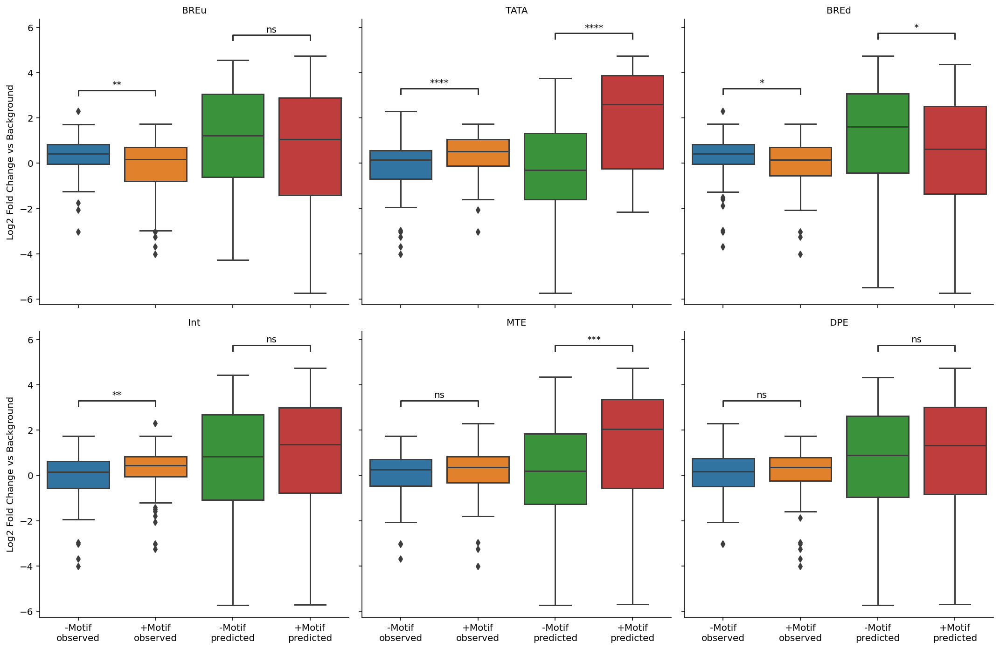

In [261]:
plot_motif_effect_combined(element_melt)

In [262]:
tata_shift = merged_df_fullrv.merge(tata_shift_df, on="Oligo_index")[['Background',"mean_exp",pred_col,"TATA_position"]]
#tata_shift = background.merge(tata_shift,on='Background',suffixes=('_background','_altered'))
tata_shift['obs'] = np.log2(tata_shift['mean_exp'])
tata_shift['pred'] = np.log2(tata_shift[pred_col] + 1) 
tata_shift_melt = tata_shift[['Background','obs','pred',"TATA_position"]].melt(id_vars=["Background","TATA_position"],var_name="pred_obs",value_name="Log Expression")

In [263]:
for bg in set(tata_shift_melt["Background"]):
    print(bg)
    subset = tata_shift_melt.query('Background == @bg')
    print(scipy.stats.pearsonr(subset.query('pred_obs == "obs"')["Log Expression"],
                     subset.query('pred_obs == "pred"')["Log Expression"]))

RPLP0_CE_bg
(0.8109159935340257, 7.840238444370089e-05)
CMV_CE_bg
(0.43852070032735957, 0.0782719055190006)
HIV1_CE_bg
(0.2705415293669139, 0.2936013819093915)
C14orf166_CE_bg
(0.4498031095417163, 0.07005164806347589)


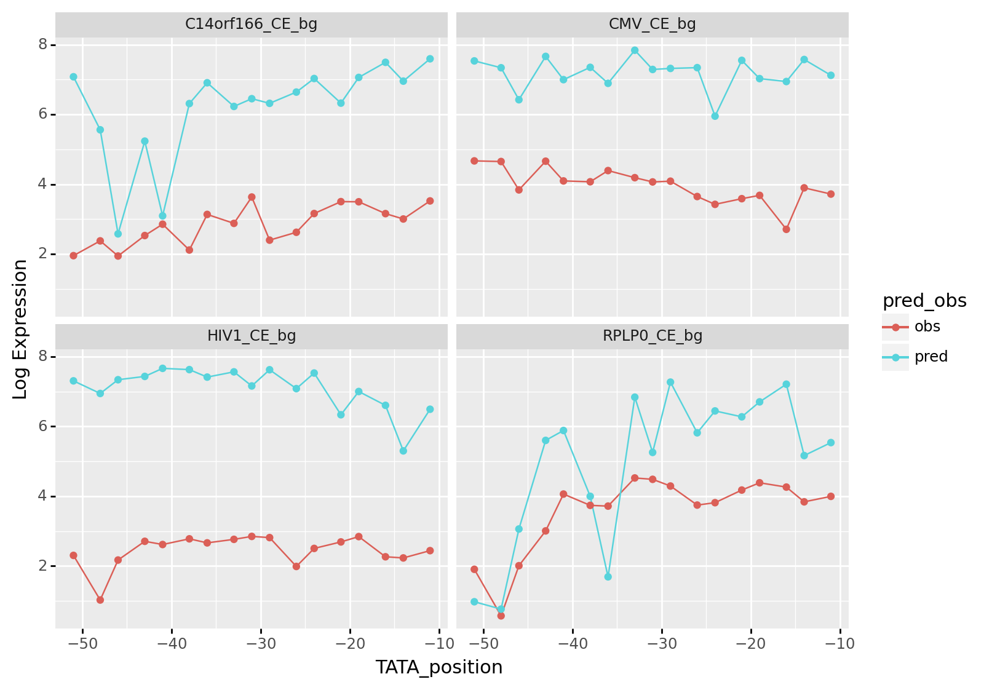

<ggplot: (1405545283581)>

In [264]:
(p9.ggplot(data=tata_shift_melt, mapping=p9.aes(x="TATA_position",y="Log Expression", color="pred_obs")) 
 + p9.geom_line()
 + p9.geom_point()
 + p9.facet_wrap("~Background")
)

#### Enformer Minimal insert

In [265]:
print(scipy.stats.pearsonr(np.log2(elements_tested_min[pred_col]+1),
                           np.log2(elements_tested_min["mean_exp"])))
print(scipy.stats.spearmanr(np.log2(elements_tested_min[pred_col]+1),
                           elements_tested_min["mean_exp"]))

(0.4020519251008841, 4.815869983679329e-13)
SpearmanrResult(correlation=0.3900657673228435, pvalue=2.6398826441029666e-12)


In [266]:
print(scipy.stats.pearsonr(np.log2(elements_tested_min[pred_col_dnase]+1),
                           np.log2(elements_tested_min["mean_exp"])))
print(scipy.stats.spearmanr(np.log2(elements_tested_min[pred_col_dnase]+1),
                           elements_tested_min["mean_exp"]))

(0.28340365774676746, 6.276624843897778e-07)
SpearmanrResult(correlation=0.22316132073354134, pvalue=9.948351537016557e-05)


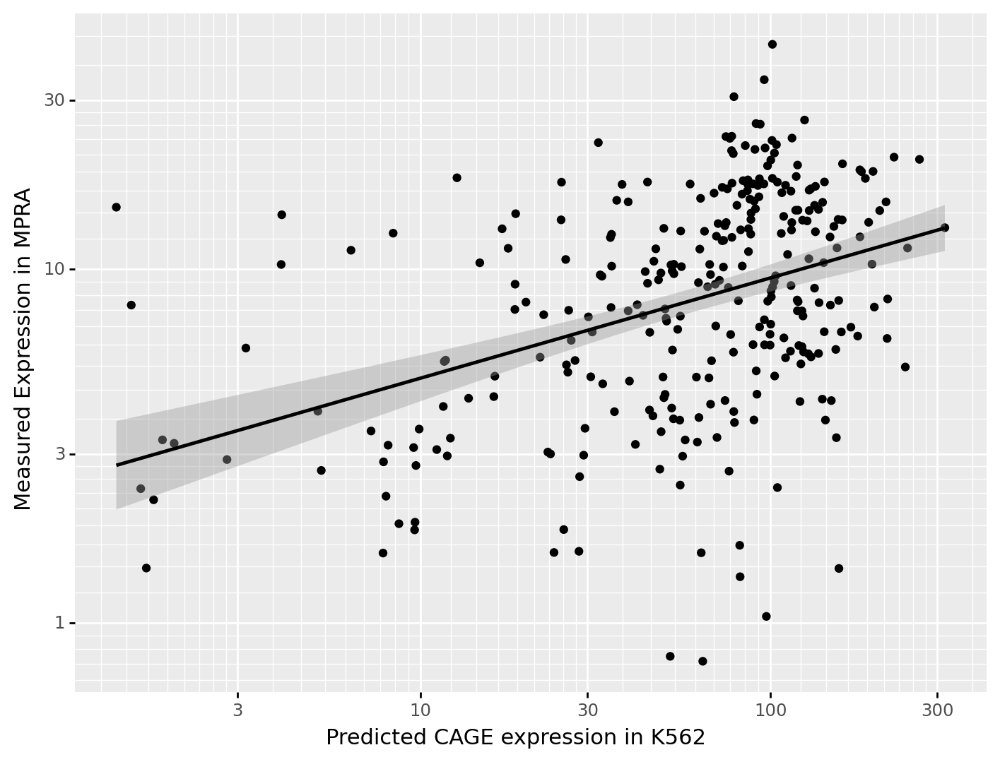

<ggplot: (1405546464196)>

In [267]:
scale = 1.3
p9.options.figure_size = (6.4*scale, 4.8*scale)
(p9.ggplot(data=elements_tested_min,mapping=p9.aes(x=pred_col,y='mean_exp'))
 + p9.geom_point(alpha=1)
 + p9.scale_x_log10()
 + p9.scale_y_log10()
 + p9.geom_smooth(method="lm")
 + p9.labs(x="Predicted CAGE expression in K562", y="Measured Expression in MPRA")
)

In [268]:
for bg in set(elements_tested_min["Background"]):
    print(bg)
    subset = elements_tested_min.query('Background == @bg')
    print(scipy.stats.pearsonr(np.log2(subset[pred_col]),
                        np.log2(subset["mean_exp"])))

ACTB_CE_bg
(0.05674889214892106, 0.7111818579484912)
C14orf166_CE_bg
(0.7782248005836342, 9.828516055927373e-14)
CMV_CE_bg
(0.15916487638637877, 0.20902566115452093)
HIV1_CE_bg
(0.5906625780343795, 2.781138617043533e-07)
RPLP0_CE_bg
(0.15075647068738196, 0.23440355304380045)


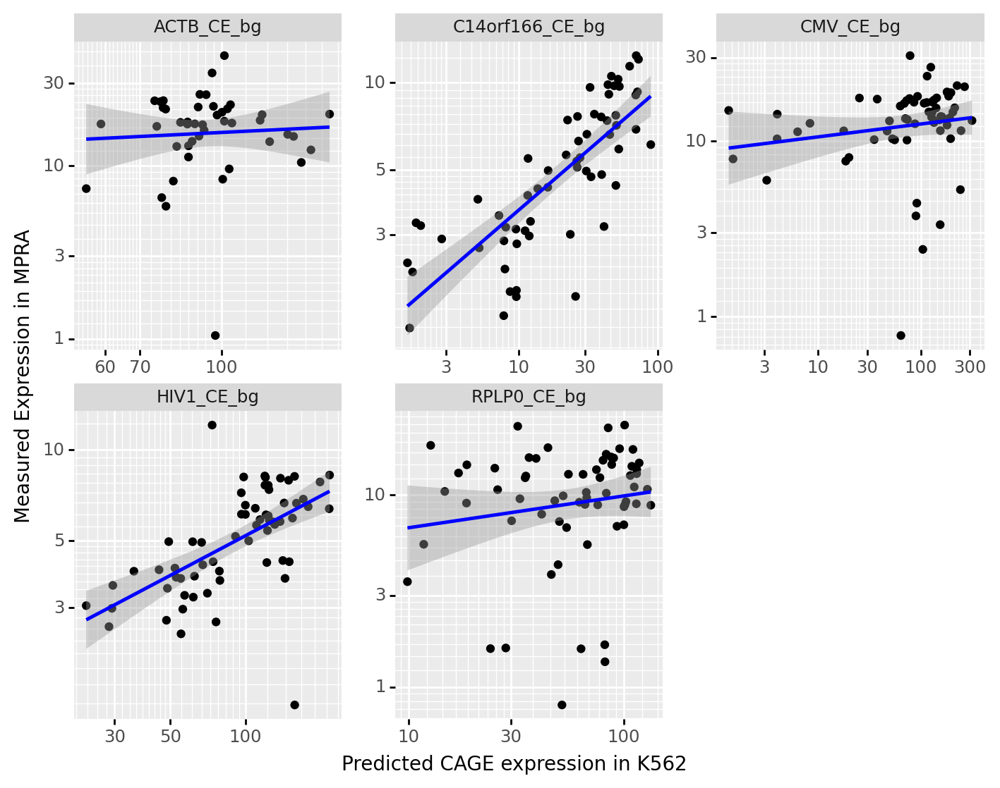

<ggplot: (1405545453900)>

In [269]:
scale = 1.3
p9.options.figure_size = (6.4*scale, 4.8*scale)
p = (p9.ggplot(data=elements_tested_min,mapping=p9.aes(x=pred_col,y='mean_exp'))
 + p9.geom_point(alpha=1)
 + p9.scale_x_log10()
 + p9.scale_y_log10()
 + p9.geom_smooth(method="lm", color="blue")
 + p9.labs(x="Predicted CAGE expression in K562", y="Measured Expression in MPRA")
 + p9.theme(subplots_adjust={'wspace': 0.2,'hspace': 0.2})
 + p9.facet_wrap('~Background', scales="free")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9), legend_position=(0.7,0.25), legend_background=p9.element_blank(),
           axis_title=p9.element_text(size=10))
)
p

In [270]:
p.save("Graphics/" + "xsup_promoter_backgrounds" + ".svg", width=6.4, height=5.6, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.4 x 5.6 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/xsup_promoter_backgrounds.svg


In [271]:
# compute log2 fc caused by adding/deleting elements with respect to the background sequences
elements = ['BREu_position', 'TATA_position', 'BREd_position', 'Int_position', 'MTE_position', 'DPE_position']
background = elements_tested_min.query('Configuration_summary == 0')[['Background', 'mean_exp', pred_col]]
altered = elements_tested_min.query('Configuration_summary != 0')[['Background', 'mean_exp', pred_col] + elements]
element_expr = background.merge(altered,on='Background',suffixes=('_background','_altered'))
element_expr['log2_fc_obs'] = np.log2(element_expr['mean_exp_altered']) - np.log2(element_expr['mean_exp_background'])
element_expr['log2_fc_pred'] = np.log2(element_expr[pred_col + '_altered'] + 1) - np.log2(element_expr[pred_col + '_background'] + 1)
# melt to have one row for predicted and observed for each motif
prefixes = []
for element in elements:
    prefix = element.split("_")[0]
    prefixes.append(prefix)
    element_expr[prefix] = element_expr[element].apply(lambda x: "-" + prefix if x == "-" else "+" + prefix)
element_melt = element_expr[['Background','log2_fc_obs','log2_fc_pred'] + prefixes].melt(id_vars=["Background"]+prefixes,var_name="pred_obs",value_name="log2_fc")
element_melt = element_melt.melt(id_vars=["Background","pred_obs","log2_fc"],var_name="Motif",value_name="Motif_presence")
element_melt["x_lab"] = element_melt["Motif_presence"] + "\n" + element_melt["pred_obs"].apply(lambda x: "observed" if x.split("_")[-1] == "obs" else "predicted")

(0.19159029920348564, 0.002347306932079616)
(0.5828636141595094, 5.381644425919037e-07)
(0.79028742749159, 3.646274263727353e-14)
(0.7927546071825181, 5.333768806703423e-28)


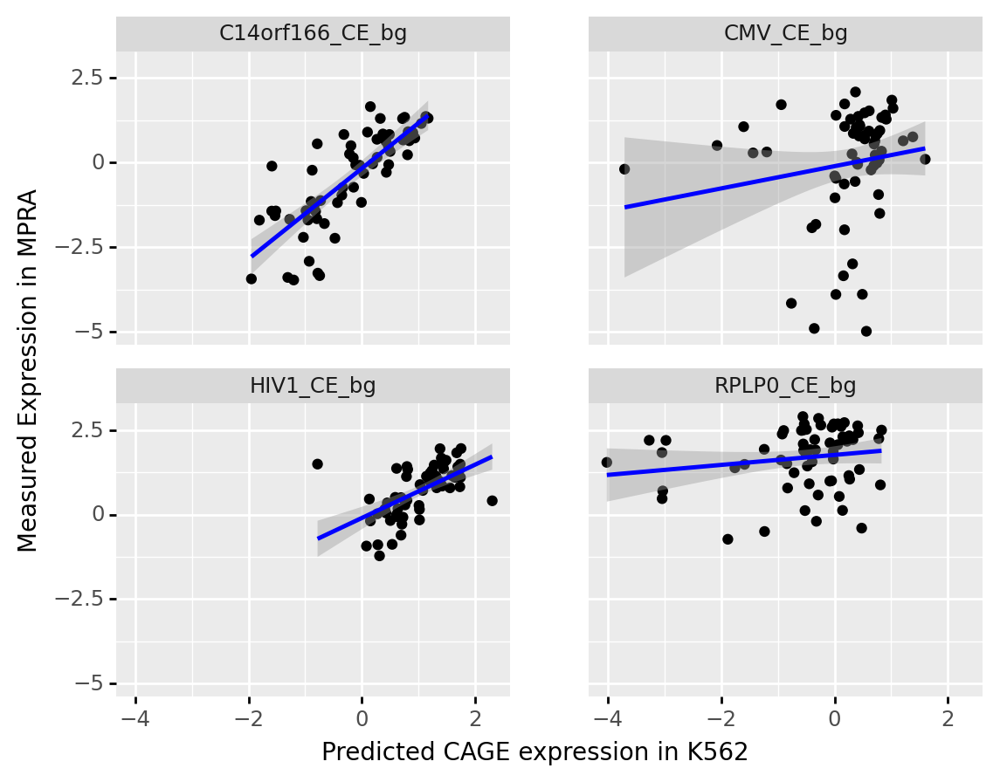

<ggplot: (1405645583770)>

In [272]:
scale = 1.0

print(scipy.stats.pearsonr(element_expr['log2_fc_obs'],
                           element_expr['log2_fc_pred']))
print(scipy.stats.pearsonr(element_expr.query('Background in ["HIV1_CE_bg"]')['log2_fc_obs'],
                           element_expr.query('Background in ["HIV1_CE_bg"]')['log2_fc_pred']))
print(scipy.stats.pearsonr(element_expr.query('Background in ["C14orf166_CE_bg"]')['log2_fc_obs'],
                           element_expr.query('Background in ["C14orf166_CE_bg"]')['log2_fc_pred']))
print(scipy.stats.pearsonr(element_expr.query('Background in ["C14orf166_CE_bg","HIV1_CE_bg"]')['log2_fc_obs'],
                           element_expr.query('Background in ["C14orf166_CE_bg","HIV1_CE_bg"]')['log2_fc_pred']))


p9.options.figure_size = (6.4*scale, 4.8*scale)
p = (p9.ggplot(data=element_expr,#.query('Background in ["C14orf166_CE_bg","HIV1_CE_bg"]'),
               mapping=p9.aes(x='log2_fc_obs',y='log2_fc_pred'))
 + p9.geom_point(alpha=1)
 #+ p9.scale_x_log10()
 #+ p9.scale_y_log10()
 + p9.geom_smooth(method="lm", color="blue")
 + p9.labs(x="Predicted CAGE expression in K562", y="Measured Expression in MPRA")
 + p9.theme(subplots_adjust={'wspace': 0.2,'hspace': 0.2})
 + p9.facet_wrap('~Background')
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9), legend_position=(0.7,0.25), legend_background=p9.element_blank(),
           axis_title=p9.element_text(size=10))
)
p

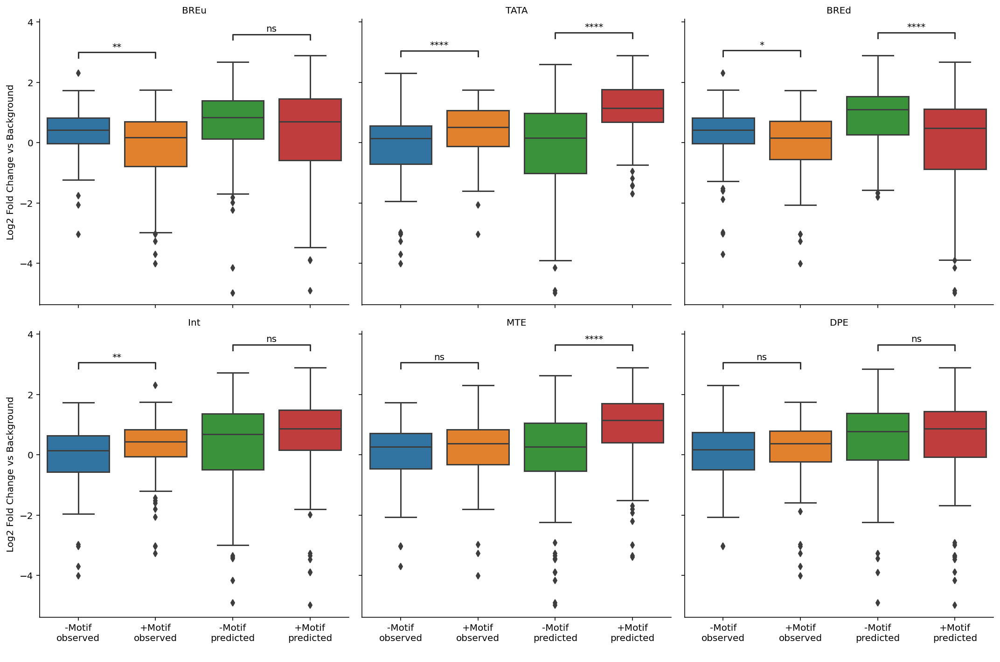

In [273]:
plot_motif_effect_combined(element_melt)

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

-TATA
observed v.s. +TATA
observed: Mann-Whitney-Wilcoxon test two-sided, P_val=1.554e-05 U_stat=5.338e+03
-TATA
predicted v.s. +TATA
predicted: Mann-Whitney-Wilcoxon test two-sided, P_val=7.243e-12 U_stat=3.891e+03


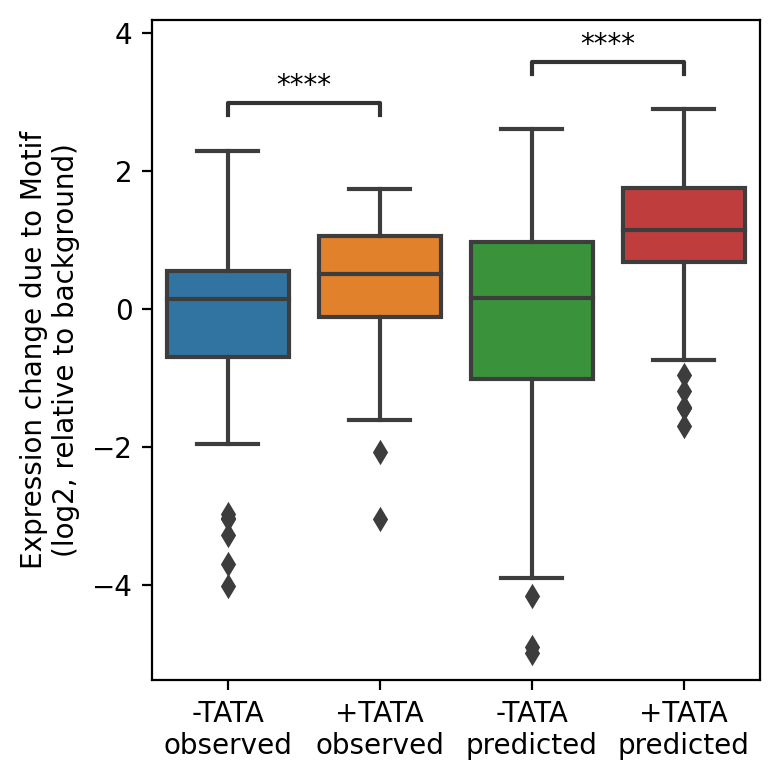

In [274]:
plot_motif_effect("TATA", element_melt)

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

-Int
observed v.s. +Int
observed: Mann-Whitney-Wilcoxon test two-sided, P_val=2.550e-03 U_stat=6.083e+03
-Int
predicted v.s. +Int
predicted: Mann-Whitney-Wilcoxon test two-sided, P_val=4.320e-02 U_stat=6.652e+03


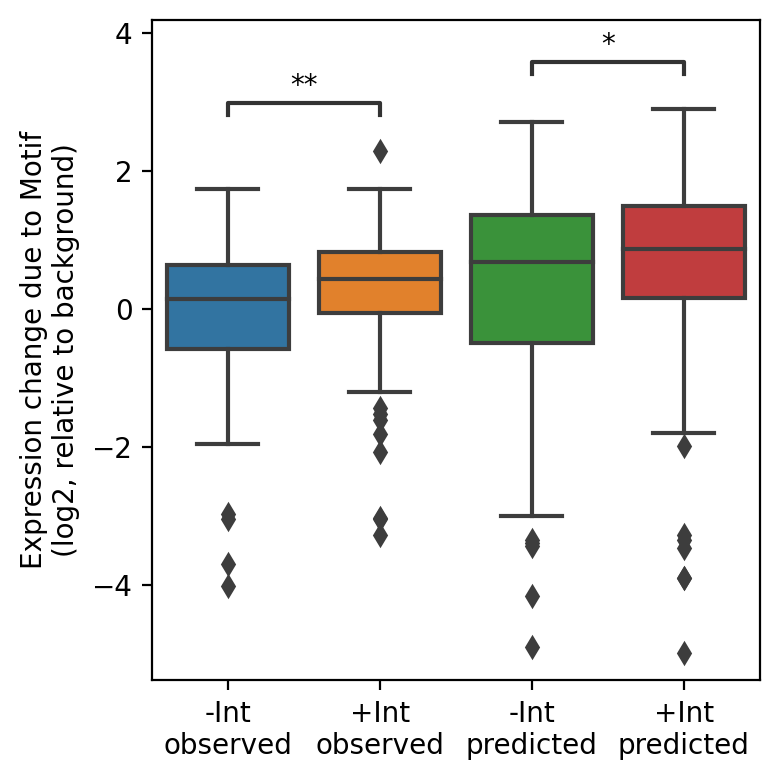

In [275]:
plot_motif_effect("Int", element_melt)

In [276]:
tata_shift = merged_df_min.merge(tata_shift_df, on="Oligo_index")[['Background',"mean_exp",pred_col,"TATA_position"]]
#tata_shift = background.merge(tata_shift,on='Background',suffixes=('_background','_altered'))
tata_shift['Measured'] = np.log2(tata_shift['mean_exp'])
tata_shift['Predicted'] = np.log2(tata_shift[pred_col] + 1) 
tata_shift_melt = tata_shift[['Background','Measured','Predicted',"TATA_position"]].melt(id_vars=["Background","TATA_position"],var_name="pred_obs",value_name="Log Expression")

In [277]:
for bg in set(tata_shift_melt["Background"]):
    print(bg)
    subset = tata_shift_melt.query('Background == @bg')
    print(scipy.stats.pearsonr(subset.query('pred_obs == "Measured"')["Log Expression"],
                     subset.query('pred_obs == "Predicted"')["Log Expression"]))
    print(scipy.stats.spearmanr(subset.query('pred_obs == "Measured"')["Log Expression"],
                     subset.query('pred_obs == "Predicted"')["Log Expression"]))

RPLP0_CE_bg
(0.8979655999698535, 1.000479176216319e-06)
SpearmanrResult(correlation=0.7794117647058825, pvalue=0.00022569855648436904)
CMV_CE_bg
(0.30831286708480965, 0.2285955576943159)
SpearmanrResult(correlation=0.3357843137254902, pvalue=0.1876141178747958)
HIV1_CE_bg
(0.21674885951413825, 0.4033749839996867)
SpearmanrResult(correlation=0.28921568627450983, pvalue=0.2602032490665047)
C14orf166_CE_bg
(0.6098255065766578, 0.0093434452605417)
SpearmanrResult(correlation=0.6813725490196079, pvalue=0.002596603135725265)


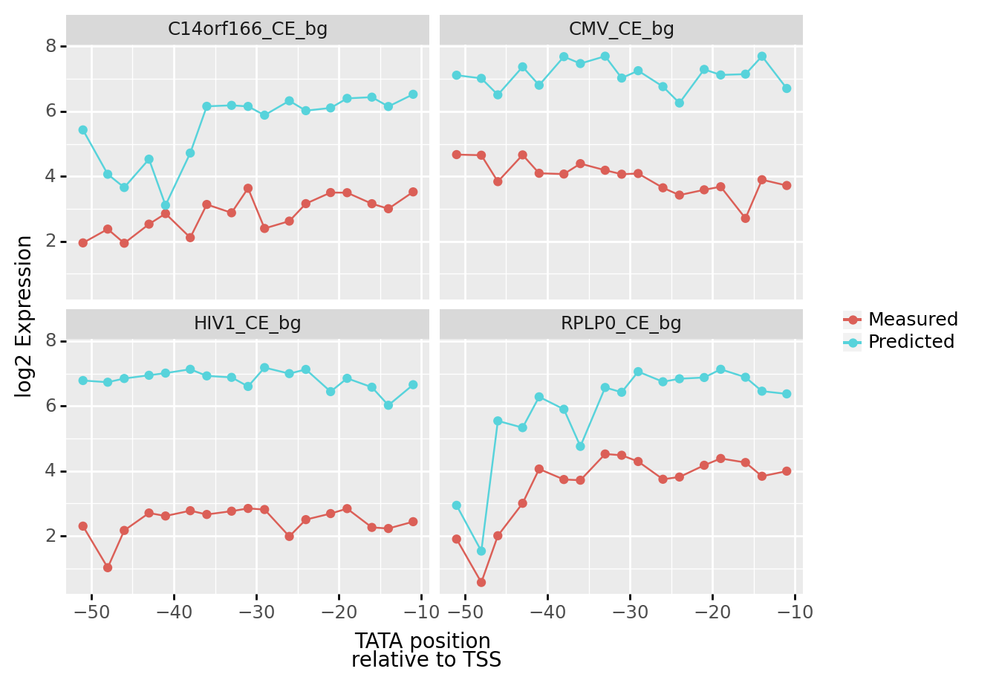

<ggplot: (1405537961247)>

In [278]:
p=(p9.ggplot(data=tata_shift_melt, mapping=p9.aes(x="TATA_position",y="Log Expression", color="pred_obs")) 
 + p9.geom_line()
 + p9.geom_point()
 + p9.facet_wrap("~Background")
 + p9.labs(y='log2 Expression', x="TATA position\n relative to TSS", color="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9), legend_background=p9.element_blank(),
           axis_title=p9.element_text(size=10))
)
p

In [396]:
p.save("Graphics/" + "xsup_promoter_tata" + ".svg", width=6.4, height=6.4, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.4 x 6.4 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/xsup_promoter_tata.svg


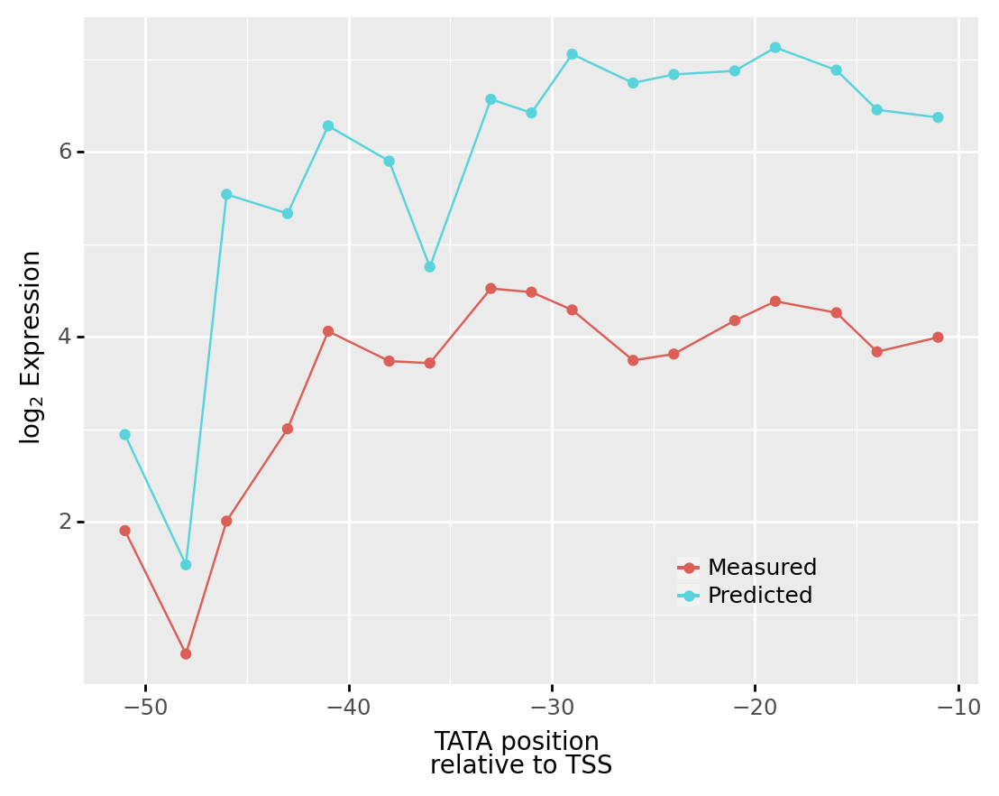

<ggplot: (1405538378876)>

In [279]:

p = (p9.ggplot(data=tata_shift_melt.query('Background == "RPLP0_CE_bg"'), mapping=p9.aes(x="TATA_position",y="Log Expression", color="pred_obs")) 
 + p9.geom_line()
 + p9.geom_point()
 + p9.labs(y='$\mathregular{log_2}$ Expression', x="TATA position\n relative to TSS", color="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9), legend_position=(0.7,0.25), legend_background=p9.element_blank(),
           axis_title=p9.element_text(size=10))
)
p

In [280]:
p.save("Graphics/" + "promoter_tata" + ".svg", width=2.8, height=1.8, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 2.8 x 1.8 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/promoter_tata.svg


#### Basenji2

In [400]:
elements_tested_fullrv_basenji2 = merged_df_fullrv_basenji2.merge(elements_df,on="Oligo_index").dropna(subset=["mean_exp"])
elements_tested_min_basenji2 = merged_df_min_basenji2.merge(elements_df,on="Oligo_index").dropna(subset=["mean_exp"])

In [401]:
print(scipy.stats.pearsonr(np.log2(elements_tested_fullrv_basenji2[pred_col]+1),
                           np.log2(elements_tested_fullrv_basenji2["mean_exp"])))
print(scipy.stats.spearmanr(np.log2(elements_tested_fullrv_basenji2[pred_col]+1),
                           elements_tested_fullrv_basenji2["mean_exp"]))

print(scipy.stats.pearsonr(np.log2(elements_tested_min_basenji2[pred_col]+1),
                           np.log2(elements_tested_min_basenji2["mean_exp"])))
print(scipy.stats.spearmanr(np.log2(elements_tested_min_basenji2[pred_col]+1),
                           elements_tested_min_basenji2["mean_exp"]))

(0.4309757256721297, 5.927982644833409e-15)
SpearmanrResult(correlation=0.4306049246930484, pvalue=6.2887875117317e-15)
(0.38336872482469236, 6.631338455957225e-12)
SpearmanrResult(correlation=0.3751812529460618, pvalue=1.9880477114558e-11)


In [402]:
print("full")
for bg in set(elements_tested_fullrv_basenji2["Background"]):
    print(bg)
    subset = elements_tested_fullrv_basenji2.query('Background == @bg')
    print(scipy.stats.pearsonr(np.log2(subset[pred_col]+1),
                        np.log2(subset["mean_exp"])))
print("min")    
for bg in set(elements_tested_min_basenji2["Background"]):
    print(bg)
    subset = elements_tested_min_basenji2.query('Background == @bg')
    print(scipy.stats.pearsonr(np.log2(subset[pred_col]+1),
                        np.log2(subset["mean_exp"])))

full
C14orf166_CE_bg
(0.6115110570266913, 1.2940853380685893e-07)
CMV_CE_bg
(0.1143104163731869, 0.3684329190908038)
RPLP0_CE_bg
(-0.1232846926666579, 0.3317735291356676)
ACTB_CE_bg
(0.21341138584606514, 0.1592503685734028)
HIV1_CE_bg
(0.6320432612515271, 2.1278909938949742e-08)
min
C14orf166_CE_bg
(0.7578807212079176, 9.930439694270837e-13)
CMV_CE_bg
(0.13533005969281203, 0.2863256622505103)
RPLP0_CE_bg
(0.24597862818040936, 0.05008212911889813)
ACTB_CE_bg
(0.30897979504654216, 0.03890327339586808)
HIV1_CE_bg
(0.47933707489879174, 6.141672460030201e-05)


#### Basenji1

In [403]:
elements_tested_fullrv_basenji1 = merged_df_fullrv_basenji1.merge(elements_df,on="Oligo_index").dropna(subset=["mean_exp"])
elements_tested_min_basenji1 = merged_df_min_basenji1.merge(elements_df,on="Oligo_index").dropna(subset=["mean_exp"])

In [404]:
print(scipy.stats.pearsonr(np.log2(elements_tested_fullrv_basenji1[pred_col]+1),
                           np.log2(elements_tested_fullrv_basenji1["mean_exp"])))
print(scipy.stats.spearmanr(np.log2(elements_tested_fullrv_basenji1[pred_col]+1),
                           elements_tested_fullrv_basenji1["mean_exp"]))

print(scipy.stats.pearsonr(np.log2(elements_tested_min_basenji1[pred_col]+1),
                           np.log2(elements_tested_min_basenji1["mean_exp"])))
print(scipy.stats.spearmanr(np.log2(elements_tested_min_basenji1[pred_col]+1),
                           elements_tested_min_basenji1["mean_exp"]))

(0.35306118834547073, 3.322825292774616e-10)
SpearmanrResult(correlation=0.3573320464187112, pvalue=1.9616091841618196e-10)
(0.34589157764488876, 7.909271831831255e-10)
SpearmanrResult(correlation=0.3260407173800813, pvalue=7.802950377493654e-09)


In [405]:
print("full")
for bg in set(elements_tested_fullrv_basenji1["Background"]):
    print(bg)
    subset = elements_tested_fullrv_basenji1.query('Background == @bg')
    print(scipy.stats.pearsonr(np.log2(subset[pred_col]+1),
                        np.log2(subset["mean_exp"])))
print("min")    
for bg in set(elements_tested_min_basenji1["Background"]):
    print(bg)
    subset = elements_tested_min_basenji1.query('Background == @bg')
    print(scipy.stats.pearsonr(np.log2(subset[pred_col]+1),
                        np.log2(subset["mean_exp"])))

full
C14orf166_CE_bg
(0.5307767649610966, 9.089192257678203e-06)
CMV_CE_bg
(0.1259129870630412, 0.3214886161183125)
RPLP0_CE_bg
(-0.027820777568615368, 0.8272562847491636)
ACTB_CE_bg
(0.2225189841440245, 0.14178152351223858)
HIV1_CE_bg
(0.3892324218683209, 0.0014785688227665266)
min
C14orf166_CE_bg
(0.6204332613395659, 7.50532677003291e-08)
CMV_CE_bg
(0.17889991249761153, 0.15723534765448652)
RPLP0_CE_bg
(0.17611076507499684, 0.16391483567145065)
ACTB_CE_bg
(0.2175542550260433, 0.1511189918835017)
HIV1_CE_bg
(0.39470445536607673, 0.0012486551595248063)


#### Compare the models

In [406]:
xpresso_df = pd.read_csv(base_path_results_xpresso + "xpresso_predictions.tsv", sep="\t")
xpresso_df = xpresso_df.query('offset in [-3,0] & insert_type == "full"')[["Oligo_index","insert_type","Prediction"]]
xpresso_df = (xpresso_df
              .groupby(["Oligo_index","insert_type"])["Prediction"]
              .mean()
              .reset_index())
xpresso_df = xpresso_df[["Oligo_index","Prediction"]].rename(columns={"Prediction":"xpresso_pred"})

elements_tested_min = xpresso_df.merge(elements_tested_min,on=["Oligo_index"])

elements_tested_min["GC_content"] = (elements_tested_min["Oligo_sequence"].apply(lambda x: np.sum([nt in ["G","C"] for nt in x])))/164

elements_tested_min = elements_tested_min.merge(elements_tested_min_basenji1[["Oligo_index",pred_col]].rename(columns={pred_col:"basenji1_pred"}),on=["Oligo_index"])

elements_tested_min = elements_tested_min.merge(elements_tested_min_basenji2[["Oligo_index",pred_col]].rename(columns={pred_col:"basenji2_pred"}),on=["Oligo_index"])

In [407]:
task = "Core Promoter\nMotifs"

row_list = []
for bg in set(elements_tested_min["Background"]):
    subset =  elements_tested_min.query('Background == @bg')
    bg = bg.split("_")[0]
    row_list += [
        {"model":"GC content",
         "Background":bg,
         "Dataset":task,
         "r":scipy.stats.pearsonr(subset["GC_content"],np.log2(subset["mean_exp"]))[0],
         "p":scipy.stats.pearsonr(subset["GC_content"],np.log2(subset["mean_exp"]))[1]},
        {"model":"Xpresso",
         "Background":bg,
         "Dataset":task,
         "r":scipy.stats.pearsonr(subset["xpresso_pred"],np.log2(subset["mean_exp"]))[0],
         "p":scipy.stats.pearsonr(subset["xpresso_pred"],np.log2(subset["mean_exp"]))[1]},
        {"model":"Basenji1",
         "Background":bg,
         "Dataset":task,
         "r":scipy.stats.pearsonr(np.log2(subset["basenji1_pred"]+1),np.log2(subset["mean_exp"]))[0],
         "p":scipy.stats.pearsonr(np.log2(subset["basenji1_pred"]+1),np.log2(subset["mean_exp"]))[1]},
        {"model":"Basenji2",
         "Background":bg,
         "Dataset":task,
         "r":scipy.stats.pearsonr(np.log2(subset["basenji2_pred"]+1),np.log2(subset["mean_exp"]))[0],
         "p":scipy.stats.pearsonr(np.log2(subset["basenji2_pred"]+1),np.log2(subset["mean_exp"]))[1]},
        {"model":"Enformer",
         "Background":bg,
         "Dataset":task,
         "r":scipy.stats.pearsonr(np.log2(subset[pred_col]+1),np.log2(subset["mean_exp"]))[0],
         "p":scipy.stats.pearsonr(np.log2(subset[pred_col]+1),np.log2(subset["mean_exp"]))[1]}
    ]
prom_motif_corrs = pd.DataFrame(row_list)

In [408]:
prom_motif_corrs["padj"] = statsmodels.stats.multitest.fdrcorrection(prom_motif_corrs["p"])[1]
prom_motif_corrs["sig"] = statsmodels.stats.multitest.fdrcorrection(prom_motif_corrs["p"])[0]

In [409]:
prom_motif_corrs

,model,Background,Dataset,r,p,padj,sig
0,GC content,C14orf166,Core Promoter\nMotifs,-0.342191,6.483105e-03,1.800862e-02,True
1,Xpresso,C14orf166,Core Promoter\nMotifs,-0.249538,5.047218e-02,1.051504e-01,False
2,Basenji1,C14orf166,Core Promoter\nMotifs,0.620433,7.505327e-08,6.254439e-07,True
3,Basenji2,C14orf166,Core Promoter\nMotifs,0.757881,9.930440e-13,1.241305e-11,True
4,Enformer,C14orf166,Core Promoter\nMotifs,0.790557,2.141186e-14,5.352964e-13,True
5,GC content,CMV,Core Promoter\nMotifs,-0.036356,7.754816e-01,8.429148e-01,False
6,Xpresso,CMV,Core Promoter\nMotifs,-0.107137,3.994356e-01,4.992945e-01,False
7,Basenji1,CMV,Core Promoter\nMotifs,0.178900,1.572353e-01,2.731914e-01,False
8,Basenji2,CMV,Core Promoter\nMotifs,0.135330,2.863257e-01,3.767443e-01,False
9,Enformer,CMV,Core Promoter\nMotifs,0.162681,1.990116e-01,3.109557e-01,False


In [410]:
prom_motif_corrs_sig = prom_motif_corrs.query('Background in ["HIV1","C14orf166"]')

### TF binding site activity

Generally, Enformer can predict with high accuracy which binding sites lead to high expression and which do not.

#### Enformer

In [411]:
tf_activity_fullrv = merged_df_fullrv.merge(tf_activity_df,on="Oligo_index").dropna(subset=["mean_exp"])
tf_activity_min = merged_df_min.merge(tf_activity_df,on="Oligo_index").dropna(subset=["mean_exp"])

tf_activity_fullrv["Background"] = tf_activity_fullrv["Background"].apply(lambda x: x.split("_")[0])
tf_activity_min["Background"] = tf_activity_min["Background"].apply(lambda x: x.split("_")[0])

In [412]:
print(scipy.stats.pearsonr(np.log2(tf_activity_fullrv[pred_col]+1),
                           np.log2(tf_activity_fullrv["mean_exp"])))
print(scipy.stats.spearmanr(tf_activity_fullrv[pred_col],
                           tf_activity_fullrv["mean_exp"]))

print(scipy.stats.pearsonr(np.log2(tf_activity_min[pred_col]+1),
                           np.log2(tf_activity_min["mean_exp"])))
print(scipy.stats.spearmanr(tf_activity_min[pred_col],
                           tf_activity_min["mean_exp"]))

(0.7359681010565939, 1.699404709786934e-82)
SpearmanrResult(correlation=0.6965671235413721, pvalue=1.7078126995409472e-70)
(0.7374462387985081, 5.472156499231105e-83)
SpearmanrResult(correlation=0.7109057562895721, pvalue=1.2552490264859844e-74)


In [413]:
backgrounds = set(tf_activity_fullrv["Background"])
print("full")
for bg in backgrounds:
    print(bg)
    subset = tf_activity_fullrv.query('Background == @bg')
    print(scipy.stats.pearsonr(np.log2(subset[pred_col]+1),
                               np.log2(subset["mean_exp"])))
    print(scipy.stats.spearmanr(subset[pred_col],
                               subset["mean_exp"]))
    
print("min")
backgrounds = set(tf_activity_min["Background"])
for bg in backgrounds:
    print(bg)
    subset = tf_activity_min.query('Background == @bg')
    print(scipy.stats.pearsonr(np.log2(subset[pred_col]+1),
                               np.log2(subset["mean_exp"])))
    print(scipy.stats.spearmanr(subset[pred_col],
                               subset["mean_exp"]))

full
CMV
(0.7448249632554345, 9.169099756944865e-45)
SpearmanrResult(correlation=0.707275156532446, pvalue=1.2751580252763819e-38)
ACTB
(0.7319194720300093, 5.049691312931495e-40)
SpearmanrResult(correlation=0.6838011272616746, pvalue=3.469409978316115e-33)
min
CMV
(0.7497331991954377, 1.2002943400561003e-45)
SpearmanrResult(correlation=0.712563907759213, pvalue=1.9963091650902805e-39)
ACTB
(0.7291329860797091, 1.3772968237896673e-39)
SpearmanrResult(correlation=0.7130827669361458, pvalue=3.526668498305127e-37)


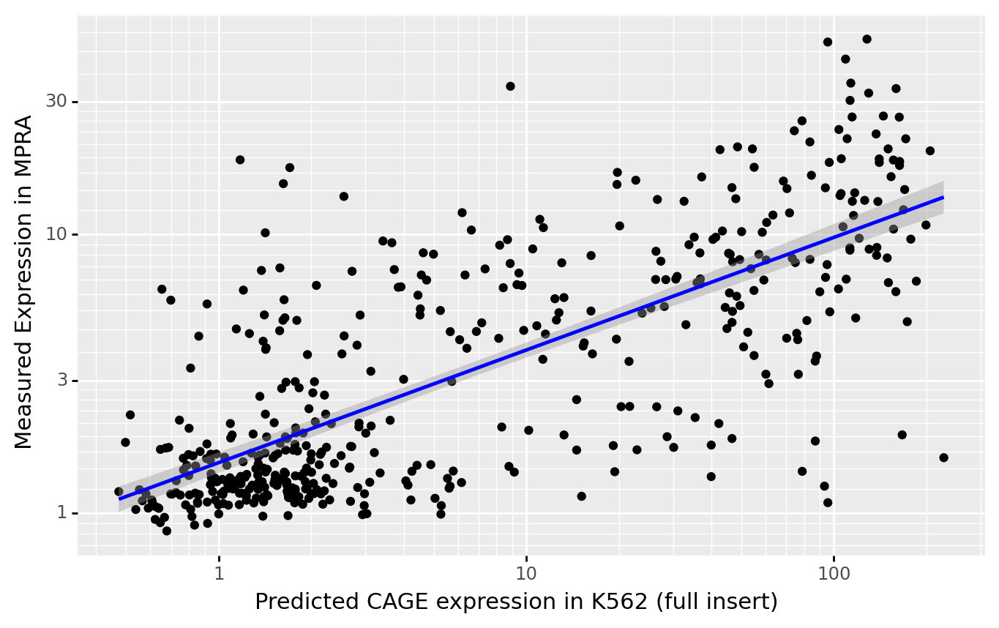

<ggplot: (1429204505329)>

In [414]:
scale = 1.0
p9.options.figure_size = (8*scale, 4.8*scale)
(p9.ggplot(data=tf_activity_min,mapping=p9.aes(x=pred_col,y='mean_exp'))
 + p9.geom_point(alpha=1)
 + p9.scale_x_log10()
 + p9.scale_y_log10()
 + p9.geom_smooth(method="lm", color="blue")
 + p9.labs(x="Predicted CAGE expression in K562 (full insert)", y="Measured Expression in MPRA")
 #+ p9.facet_wrap('~Background')
)

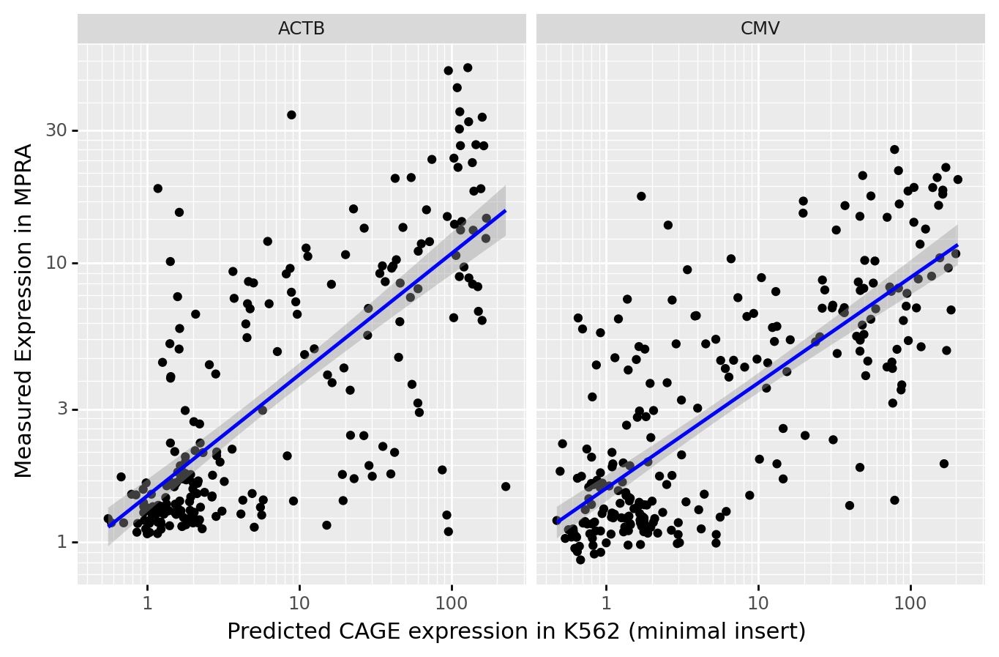

<ggplot: (1429227376270)>

In [419]:
scale = 1.0
p9.options.figure_size = (8*scale, 4.8*scale)
p=(p9.ggplot(data=tf_activity_min,mapping=p9.aes(x=pred_col,y='mean_exp'))
 + p9.geom_point(alpha=1)
 + p9.scale_x_log10()
 + p9.scale_y_log10()
 + p9.geom_smooth(method="lm", color="blue")
 + p9.labs(x="Predicted CAGE expression in K562 (minimal insert)", y="Measured Expression in MPRA")
 + p9.facet_wrap('~Background')
)
p

In [420]:
p.save("Graphics/" + "xsup_promoter_tf_sites" + ".svg", width=6.4, height=6.4, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.4 x 6.4 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/xsup_promoter_tf_sites.svg


#### Basenji2

In [416]:
tf_activity_fullrv_basenji2 = merged_df_fullrv_basenji2.merge(tf_activity_df,on="Oligo_index").dropna(subset=["mean_exp"])
tf_activity_min_basenji2 = merged_df_min_basenji2.merge(tf_activity_df,on="Oligo_index").dropna(subset=["mean_exp"])

tf_activity_fullrv_basenji2["Background"] = tf_activity_fullrv_basenji2["Background"].apply(lambda x: x.split("_")[0])
tf_activity_min_basenji2["Background"] = tf_activity_min_basenji2["Background"].apply(lambda x: x.split("_")[0])

In [417]:
print(scipy.stats.pearsonr(np.log2(tf_activity_fullrv_basenji2[pred_col]+1),
                           np.log2(tf_activity_fullrv_basenji2["mean_exp"])))
print(scipy.stats.spearmanr(tf_activity_fullrv_basenji2[pred_col],
                           tf_activity_fullrv_basenji2["mean_exp"]))

print(scipy.stats.pearsonr(np.log2(tf_activity_min_basenji2[pred_col]+1),
                           np.log2(tf_activity_min_basenji2["mean_exp"])))
print(scipy.stats.spearmanr(tf_activity_min_basenji2[pred_col],
                           tf_activity_min_basenji2["mean_exp"]))

(0.5108173590965315, 4.6213683515074084e-33)
SpearmanrResult(correlation=0.47310677102409204, pvalue=5.624109144478563e-28)
(0.5580508882587161, 2.1318299587391738e-40)
SpearmanrResult(correlation=0.5575584453636923, pvalue=2.5786413457231865e-40)


#### Basenji1

In [421]:
tf_activity_fullrv_basenji1 = merged_df_fullrv_basenji1.merge(tf_activity_df,on="Oligo_index").dropna(subset=["mean_exp"])
tf_activity_min_basenji1 = merged_df_min_basenji1.merge(tf_activity_df,on="Oligo_index").dropna(subset=["mean_exp"])

tf_activity_fullrv_basenji1["Background"] = tf_activity_fullrv_basenji1["Background"].apply(lambda x: x.split("_")[0])
tf_activity_min_basenji1["Background"] = tf_activity_min_basenji1["Background"].apply(lambda x: x.split("_")[0])

In [422]:
print(scipy.stats.pearsonr(np.log2(tf_activity_fullrv_basenji1[pred_col]+1),
                           np.log2(tf_activity_fullrv_basenji1["mean_exp"])))
print(scipy.stats.spearmanr(tf_activity_fullrv_basenji1[pred_col],
                           tf_activity_fullrv_basenji1["mean_exp"]))

print(scipy.stats.pearsonr(np.log2(tf_activity_min_basenji1[pred_col]+1),
                           np.log2(tf_activity_min_basenji1["mean_exp"])))
print(scipy.stats.spearmanr(tf_activity_min_basenji1[pred_col],
                           tf_activity_min_basenji1["mean_exp"]))

(0.45468769694892364, 1.0311041410547114e-25)
SpearmanrResult(correlation=0.4241490230657925, pvalue=2.98439886729079e-22)
(0.5296129114179833, 7.644915660033392e-36)
SpearmanrResult(correlation=0.5020069961674499, pvalue=8.130223341174599e-32)


#### Compare the models

In [423]:
xpresso_df = pd.read_csv(base_path_results_xpresso + "xpresso_predictions.tsv", sep="\t")
xpresso_df = xpresso_df.query('offset in [-3,0] & insert_type == "full"')[["Oligo_index","insert_type","Prediction"]]
xpresso_df = (xpresso_df
              .groupby(["Oligo_index","insert_type"])["Prediction"]
              .mean()
              .reset_index())
xpresso_df = xpresso_df[["Oligo_index","Prediction"]].rename(columns={"Prediction":"xpresso_pred"})

tf_activity_min = xpresso_df.merge(tf_activity_min,on=["Oligo_index"])

tf_activity_min["GC_content"] = (tf_activity_min["Oligo_sequence"].apply(lambda x: np.sum([nt in ["G","C"] for nt in x])))/164

tf_activity_min = tf_activity_min.merge(tf_activity_min_basenji1[["Oligo_index",pred_col]].rename(columns={pred_col:"basenji1_pred"}),on=["Oligo_index"])

tf_activity_min = tf_activity_min.merge(tf_activity_min_basenji2[["Oligo_index",pred_col]].rename(columns={pred_col:"basenji2_pred"}),on=["Oligo_index"])

In [424]:
task_tf = "Transcription\nFactor Motifs"

row_list = [
    {"model":"GC content",
     "Dataset":task_tf,
     "r":scipy.stats.pearsonr(tf_activity_min["GC_content"],np.log2(tf_activity_min["mean_exp"]))[0]},
    {"model":"Xpresso",
     "Dataset":task_tf,
     "r":scipy.stats.pearsonr(tf_activity_min["xpresso_pred"],np.log2(tf_activity_min["mean_exp"]))[0]},
    {"model":"Basenji1",
     "Dataset":task_tf,
     "r":scipy.stats.pearsonr(np.log2(tf_activity_min["basenji1_pred"]+1),np.log2(tf_activity_min["mean_exp"]))[0]},
    {"model":"Basenji2",
     "Dataset":task_tf,
     "r":scipy.stats.pearsonr(np.log2(tf_activity_min["basenji2_pred"]+1),np.log2(tf_activity_min["mean_exp"]))[0]},
    {"model":"Enformer",
     "Dataset":task_tf,
     "r":scipy.stats.pearsonr(np.log2(tf_activity_min[pred_col]+1),np.log2(tf_activity_min["mean_exp"]))[0]}
]
tf_activity_corrs = pd.DataFrame(row_list)

In [425]:
tf_activity_corrs

,model,Dataset,r
0,GC content,Transcription\nFactor Motifs,0.146517
1,Xpresso,Transcription\nFactor Motifs,0.327122
2,Basenji1,Transcription\nFactor Motifs,0.529613
3,Basenji2,Transcription\nFactor Motifs,0.558051
4,Enformer,Transcription\nFactor Motifs,0.737446


### Compare all models

Making a plot that combines all models

In [426]:
all_corrs = pd.concat([endogenous_corrs, tf_activity_corrs, prom_motif_corrs_sig])[["model","Dataset","r","Background"]]
all_corrs = all_corrs.fillna("")
all_corrs['model'] = pd.Categorical(all_corrs["model"], all_corrs.query('Dataset == @task_tf').sort_values('r')["model"])
all_corrs["Dataset"] = all_corrs.apply(lambda x: x["Dataset"] if x["Background"] == "" else "{} ({})".format(x["Dataset"],x["Background"]),axis=1)

In [427]:
all_corrs.to_csv(base_path_results + "all_corrs.tsv", sep="\t", index=None)

In [428]:
all_corrs = pd.read_csv(base_path_results + "all_corrs.tsv", sep="\t")

In [429]:
task_tf = "Transcription\nFactor Motifs"
all_corrs['model'] = pd.Categorical(all_corrs["model"], all_corrs.query('Dataset == @task_tf').sort_values('r')["model"])

all_corrs['Dataset'] = pd.Categorical(all_corrs["Dataset"], all_corrs["Dataset"].drop_duplicates())

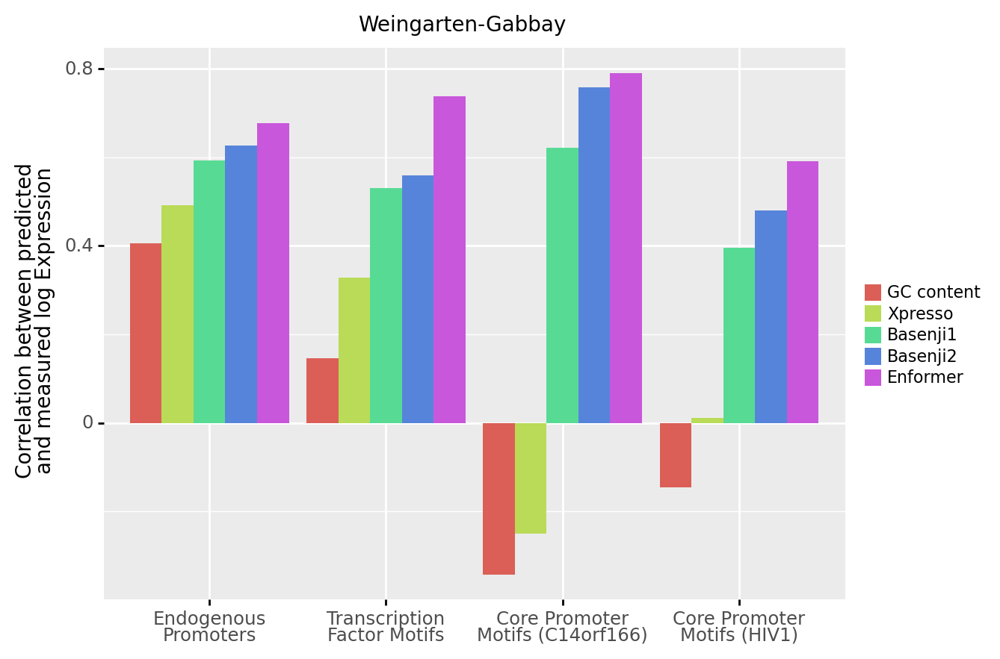

<ggplot: (1429243057830)>

In [433]:
scale = 1.0
p9.options.figure_size = (6.4*scale, 4.8*scale)
p = (p9.ggplot(data=all_corrs,mapping=p9.aes(x="Dataset",y="r", fill="model"))
 + p9.geom_bar(stat="identity", position="dodge")
 + p9.labs(x="", y="Correlation between predicted\nand measured log Expression", fill="",
          title="Weingarten-Gabbay")
 + p9.theme(legend_box_margin=0,legend_key_size = 8, legend_text = p9.element_text(size=8),
            title=p9.element_text(size=10),
           axis_title=p9.element_text(size=10))
     #axis_text_x=p9.element_text(rotation=45, hjust=1))    
)
p

In [434]:
p.save("Graphics/" + "promoter_segal" + ".svg", width=6.0, height=2.5, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.0 x 2.5 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/promoter_segal.svg


### DNAse/Expression

What is the relationship between the DNAse and CAGE prediction in Enformer?

In [126]:
scipy.stats.pearsonr(merged_df_min[pred_col],merged_df_min[pred_col_dnase])

(0.7699570316338298, 0.0)

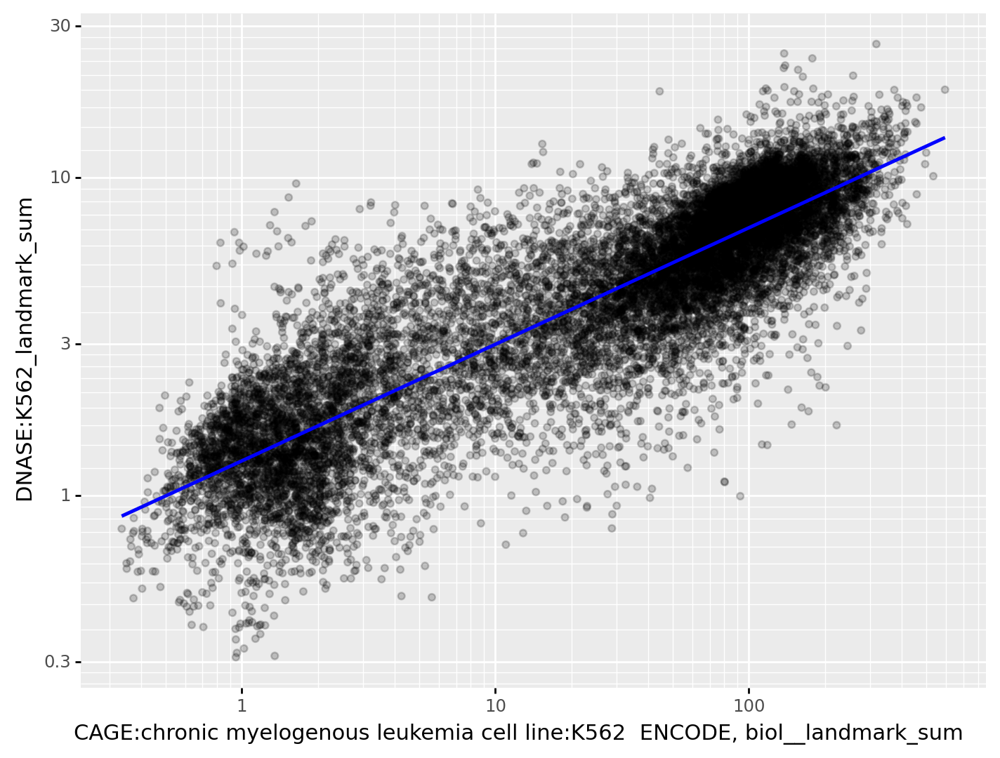

<ggplot: (1429646203856)>

In [127]:
scale = 1.3
p9.options.figure_size = (6.4*scale, 4.8*scale)
(p9.ggplot(data=merged_df_min,mapping=p9.aes(x=pred_col,y=pred_col_dnase))
 + p9.geom_point(alpha=0.2)
 #+ p9.geom_bin2d(binwidth = (0.05, 0.05))
 + p9.scale_x_log10()
 + p9.scale_y_log10()
 + p9.geom_smooth(method="lm",color="blue")
 + p9.labs(x=pred_col, y=pred_col_dnase)
)

In [128]:
(np.log2(merged_df_min[pred_col]+1) - np.log2(merged_df_min[pred_col_dnase]+1)).describe()

count    15753.000000
mean         2.369459
std          1.647839
min         -2.005885
25%          0.672361
50%          2.984338
75%          3.646116
max          6.385180
dtype: float64

### ISM for the different backgrounds

In [143]:
cols = ['Oligo_index','Background','Oligo_sequence']
dnase_example = segal_df.query('Oligo_index == 12885').copy()
dnase_example["Background"] = "DNAse_example"
background_seq_df = pd.concat([elements_df.query('Configuration_summary == 0')[cols], 
                               tf_activity_df.query('Motif_info == "-"')[cols],
                               dnase_example[cols]
                              ]).reset_index(drop=True)
background_seq_df["pos"] = -1
background_seq_df["alt"] = -1
background_seq_df["idx"] = -1

def ism(background_df):
    options = ["A", "C", "G", "T"]
    rows = []
    for _,crs_row in background_df.iterrows():
        seq = crs_row["Oligo_sequence"]
        for pos in range(len(seq)):
            for i in range(3):
                ref = seq[pos]
                alt = options[(options.index(ref) + i) % 4]
                new_seq = ''.join([seq[:pos], alt, seq[pos+1:]])
                rows.append({"Oligo_index":crs_row["Oligo_index"],
                             "Oligo_sequence":new_seq,
                             "Background":crs_row["Background"],
                             "pos":pos,
                             "alt":alt,
                             "idx":options.index(alt)
                            })
    return pd.DataFrame(rows)

ism_df = pd.concat([ism(background_seq_df), background_seq_df]).reset_index(drop=True)

In [146]:
ism_df.sort_values(['Background','pos']).query

,Oligo_index,Oligo_sequence,Background,pos,alt,idx
3940,1,GTTATCCCTTCAGCGGCGCGGGGCCAATCAGCGTGCGCCGTTCCGA...,ACTB_CE_bg,-1,-1,-1
1968,1,GTTATCCCTTCAGCGGCGCGGGGCCAATCAGCGTGCGCCGTTCCGA...,ACTB_CE_bg,0,G,2
1969,1,TTTATCCCTTCAGCGGCGCGGGGCCAATCAGCGTGCGCCGTTCCGA...,ACTB_CE_bg,0,T,3
1970,1,ATTATCCCTTCAGCGGCGCGGGGCCAATCAGCGTGCGCCGTTCCGA...,ACTB_CE_bg,0,A,0
1971,1,GTTATCCCTTCAGCGGCGCGGGGCCAATCAGCGTGCGCCGTTCCGA...,ACTB_CE_bg,1,T,3
...,...,...,...,...,...,...
487,1587,CGAATAAGGATTCTGACGGGCGATGGCGCAGCCAATAGACAGGAGC...,RPLP0_CE_bg,162,T,3
488,1587,CGAATAAGGATTCTGACGGGCGATGGCGCAGCCAATAGACAGGAGC...,RPLP0_CE_bg,162,A,0
489,1587,CGAATAAGGATTCTGACGGGCGATGGCGCAGCCAATAGACAGGAGC...,RPLP0_CE_bg,163,C,1
490,1587,CGAATAAGGATTCTGACGGGCGATGGCGCAGCCAATAGACAGGAGC...,RPLP0_CE_bg,163,G,2


### Analyzing the TATA shift

We saw in the experimental results that in the RPLP0 promoter, shifting the TATA to a position of -50 leads to a strong decrease in expression. What is the reason for this? We use Enformer to find out.

#### Occlude the tata positions

In [282]:
shifted_pos = tata_shift_df.query('Background == "RPLP0_CE_bg"')
shifted_pos['tata_pos'] = shifted_pos["Oligo_sequence"].apply(lambda x: x.find("TATATAAG"))

/scratch/tmp/karollus/ipykernel_786964/4263649438.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [283]:
#baseline_seq = elements_df.query('Configuration_summary == 0 & Background == "RPLP0_CE_bg"').iloc[0]['Oligo_sequence']
baseline_seq = tata_shift_df.query('Background == "RPLP0_CE_bg" & TATA_position == -11').iloc[0]['Oligo_sequence']

In [244]:
chip_targets = target_df.loc[target_df.description.str.contains('CHIP') & target_df.description.str.contains('K562')]['description']

In [ ]:
rows = []
chip_dict = {}

rng_insert = "".join(random.choices(["A","C","G","T"],k=8))

smpls = [(-1,baseline_seq)]
for _,df_row in shifted_pos.iterrows():
    tata_pos = df_row["tata_pos"]
    rel_pos = df_row["TATA_position"]
    seq = baseline_seq[:tata_pos] + "N"*8 + baseline_seq[tata_pos+8:]
    #seq = baseline_seq[:tata_pos] + rng_insert + baseline_seq[tata_pos+8:]
    assert len(seq) == len(baseline_seq)
    smpls.append((rel_pos,seq))

for crs_row in smpls:
    occlude_pos = crs_row[0]
    crs = crs_row[1]
    insert = crs + egfp_seq
    landmark = len(crs)//2
    ideal_offset = seq_utils.compute_offset_to_center_landmark(landmark, insert)
    for rev_comp in [False, True]:
        for offset in [-43, 0, 43]:
            modified_sequence, minbin, maxbin, landmarkbin = \
                insert_sequence_at_landing_pad(insert,
                                               aavs1,
                                               fasta_extractor,
                                               shift_five_end=ideal_offset + offset,
                                               landmark=landmark,
                                               rev_comp=rev_comp)
            # predict
            sequence_one_hot = one_hot_encode(modified_sequence)
            predictions = model.predict_on_batch(sequence_one_hot[np.newaxis])['human'][0]
            pred = np.sum(predictions[landmarkbin-1:landmarkbin+2,  5111])
            #append
            rows.append({
                "name": "base" if occlude_pos==-1 else "occlude_"+str(occlude_pos),
                "occlude_pos":occlude_pos,
                "offset":offset,
                "orient":rev_comp,
                "pred":pred
            })
            chip_dict[str(occlude_pos)+"_"+str(offset)+"_"+str(rev_comp)] = predictions[landmarkbin-1:landmarkbin+2,  [x for x in chip_targets.index]].sum(axis=0)

2022-09-05 02:19:46.501552: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)
2022-09-05 02:19:49.369865: I tensorflow/stream_executor/cuda/cuda_blas.cc:1760] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.


In [ ]:
occlude_pred_df = pd.DataFrame(rows).groupby(['name','occlude_pos'])["pred"].mean().reset_index()
occlude_pred_df["log_pred"] = np.log2(occlude_pred_df["pred"]+1)

In [ ]:
occlude_plot_df = occlude_pred_df.query('name != "base" and occlude_pos < -16')[["occlude_pos","log_pred"]]
occlude_plot_df["Group"] = "Occlusion_shift"
orig_preds = (tata_shift_melt.query('Background == "RPLP0_CE_bg" & pred_obs == "Predicted" & TATA_position < -16')
              [['TATA_position','Log Expression']]
              .rename(columns={'TATA_position':"occlude_pos","Log Expression":"log_pred"})
             )
orig_preds["Group"] = "TATA_shift"
occlude_plot_df = pd.concat([occlude_plot_df,orig_preds])

p = (p9.ggplot(data=occlude_plot_df, mapping=p9.aes(x="occlude_pos",y="log_pred",color="Group")) 
 + p9.geom_line()
 + p9.geom_point()
 + p9.labs(y='log2 Expression', x="TATA position\n relative to TSS", color="Type:")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9), legend_position=(0.7,0.25), legend_background=p9.element_blank(),
           axis_title=p9.element_text(size=10))
)
p

In [ ]:
p.save("Graphics/" + "xsup_promoter_tata_occlude" + ".svg", width=6.4, height=4.8, dpi=300)

#### ISM around the critical position

In [335]:
def ism_around_pos(seq, mut_pos=66, mut_range=20):
    options = ["A", "C", "G", "T"]
    rows = []
    for pos in range(max(mut_pos-mut_range,0),mut_pos+mut_range):
        ref = seq[pos]
        for i in range(1,4):
            alt = options[(options.index(ref) + i) % 4]
            new_seq = ''.join([seq[:pos], alt, seq[pos+1:]])
            rows.append({"Oligo_sequence":new_seq,
                         "ref":ref,
                         "pos":pos,
                         "alt":alt,
                         "idx":options.index(alt)
                        })
    return pd.DataFrame(rows)

ism_df = ism_around_pos(baseline_seq)

In [340]:
ism_rows = []

for _,ism_row in ism_df.iterrows():
    crs = ism_row['Oligo_sequence']
    insert = crs + egfp_seq
    landmark = len(crs)//2
    ideal_offset = seq_utils.compute_offset_to_center_landmark(landmark, insert)
    batch = []
    for rev_comp in [False, True]:
        for offset in [-43, 0, 43]:
            modified_sequence, minbin, maxbin, landmarkbin = \
                insert_sequence_at_landing_pad(insert,
                                               aavs1,
                                               fasta_extractor,
                                               shift_five_end=ideal_offset + offset,
                                               landmark=landmark,
                                               rev_comp=rev_comp)
            batch.append((modified_sequence,landmarkbin))
    # predict
    sequence_one_hot = batch_seq = np.stack([one_hot_encode(x[0]) for x in batch])
    predictions = model.predict_on_batch(sequence_one_hot)['human']
    #append
    for idx, sample in enumerate(batch):
        ism_rows.append({
            "ref":ism_row["ref"],
            "pos":ism_row["pos"],
            "alt":ism_row["alt"],
            "idx":ism_row["idx"],
            "pred":np.sum(predictions[idx, 447-1:447+2,  5111])
        })

In [364]:
ism_pred_df = pd.DataFrame(ism_rows).groupby(["ref","pos","alt","idx"])["pred"].mean().reset_index()
ism_pred_df["log_pred"] = np.log2(ism_pred_df["pred"]+1)
base_pred = occlude_pred_df.query('name == "base"')["log_pred"].iloc[0]
ism_pred_df["log2_fc"] = ism_pred_df["log_pred"] - base_pred

In [368]:
ism_pred_df.to_csv(base_path_results + "ism_tata_shift_preds.tsv",sep="\t",index=None)

In [281]:
ism_pred_df = pd.read_csv(base_path_results + "ism_tata_shift_preds.tsv",sep="\t")

In [284]:
ism_array = np.zeros((4,40))
total_effect_array = np.zeros((4,40))

min_pos = ism_pred_df['pos'].min()

for _,ism_result in ism_pred_df.sort_values('pos',ascending=True).iterrows():
    ism_array[ism_result['idx'],ism_result['pos']-min_pos] = ism_result['log2_fc']
    
for _,ism_result in ism_pred_df.groupby('pos')['log2_fc'].min().reset_index().sort_values('pos',ascending=True).iterrows():
    total_effect_array[:,int(ism_result['pos'])-min_pos] = np.abs(ism_result['log2_fc'])
    
base_seq_onehot = one_hot_encode(baseline_seq[66-20:66+20])
total_effect_array = base_seq_onehot.transpose()*total_effect_array

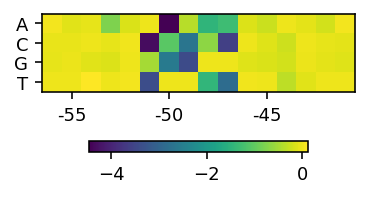

In [285]:
fig, ax = plt.subplots(figsize=(2.8, 3.0))
im = ax.imshow(ism_array[:,20-8:20+8])
cbar = fig.colorbar(im,shrink=0.7,location="bottom")
cbar.ax.tick_params(labelsize=9)
# fix axis labels
ax.set_xticks([1,6,11])
labels = ['-55','-50','-45']
ax.set_xticklabels(labels)
ax.set_yticks([0,1,2,3])
ax.set_yticklabels(['A','C','G','T'])
ax.tick_params(axis='both', which='major', labelsize=9)
fig.savefig("Graphics/" + "promoter_imshow" + ".svg")

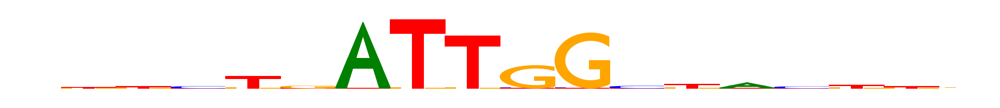

In [317]:
fig,ax = plot_weights(total_effect_array[:,20-8:20+8],despine=True)
fig.savefig("Graphics/" + "promoter_imshow_seq" + ".svg")

In [286]:
ism_pred_df

,ref,pos,alt,idx,pred,log_pred,log2_fc
0,A,49,C,1,82.413750,6.382213,0.009940
1,A,49,G,2,76.787170,6.281460,-0.090813
2,A,49,T,3,82.906380,6.390708,0.018435
3,A,63,C,1,3.169372,2.059830,-4.312443
4,A,63,G,2,57.336468,5.866326,-0.505947
...,...,...,...,...,...,...,...
115,T,77,C,1,75.188705,6.251505,-0.120768
116,T,77,G,2,76.584190,6.277691,-0.094583
117,T,82,A,0,81.876595,6.372893,0.000619
118,T,82,C,1,78.237540,6.308112,-0.064161


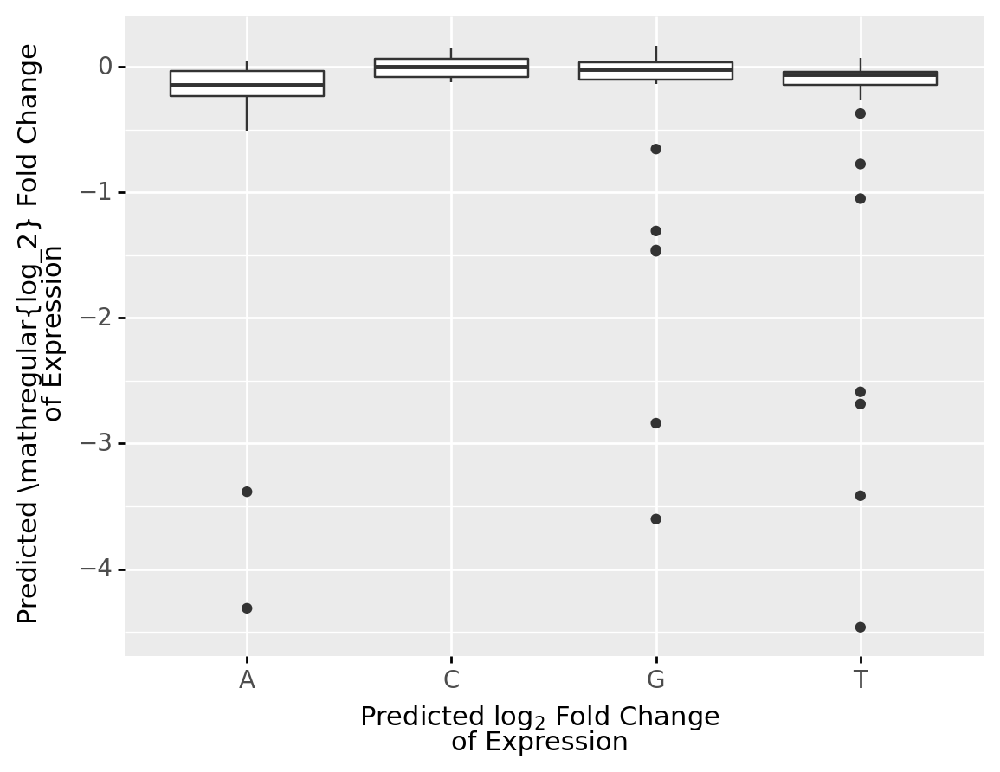

<ggplot: (1405643935763)>

In [295]:
p = (p9.ggplot(data=ism_pred_df,mapping=p9.aes(x="ref",y="log2_fc"))
 + p9.geom_boxplot()
 #+ p9.geom_bin2d(binwidth = (0.05, 0.05))
 + p9.labs(x="Predicted $\mathregular{log_2}$ Fold Change\nof Expression", y="Predicted $\mathregular{log_2}$ Fold Change\nof Expression")
 + p9.theme(axis_text=p9.element_text(size=10))
)
p

In [296]:
p.save("Graphics/" + "xsup_promoter_ism_nt" + ".svg", width=6.0, height=2.5, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.0 x 2.5 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/xsup_promoter_ism_nt.svg


# Hong et al. (Cohen lab) TRIP-Seq and Patch-MPRA

This section contains our results for the Hong et al experiment(s), who tested some promoters integrated in many backgrounds (TRIP-Seq) and many promoters in a few backgrounds (Patch-MPRA)

Positions on the plasmid:

- 1810: 5'-ITR
- 4294-4426: promoter insert
- 4433-5137: tdTomato
- 6128: 3'-ITR

In [6]:
base_path_data = "Data/Cohen_genomic_environments/"
base_path_results = "Results/Cohen_genomic_environments/" 
base_path_data_tss_sim = "Data/TSS_sim/"

In [7]:
with open(base_path_data + "mScarlet.txt") as file:
    lines = file.readlines()[1:]
    mScarlet_seq = "".join(lines).replace('\n', '').upper()
    
# get the plasmid sequence
with open(base_path_data + "trip_plasmid.gb") as file:
    plasmid_sequence = ""
    started_reading = False
    for line in file.readlines():
        if started_reading:
            line = line.strip().replace(" ","").replace("/","")
            line = re.sub(r'[0-9]+', '', line)
            plasmid_sequence += line
        if line.startswith("ORIGIN"):
            started_reading = True
    plasmid_sequence = plasmid_sequence.upper()

tdTomato = plasmid_sequence[4432:5137]
plasmid_left = plasmid_sequence[1809:4294]
plasmid_right = plasmid_sequence[4426:6128]

In [8]:
# coordinates here already seem to be hg38 according to methods section
trip_expression = pd.read_csv(base_path_data + "trip_seq.tsv", sep="\t").dropna()
trip_sequences = pd.read_csv(base_path_data + "trip_seq_sequences.tsv",sep="\t").rename(columns={"Name":"promoter"})
trip_sequences["Orientation"] = trip_sequences["Oligo_id"].apply(lambda x: "RC" if x.split("_")[-1] == "-" else "SS")

# add insertion interval
trip_expression["LP_interval"] = trip_expression.apply(lambda x: kipoiseq.Interval(chrom=x["chr"],
                                                                                  start=x["location"],
                                                                                  end=x["location"]+1)
                                                       ,axis=1)

trip = trip_expression.merge(trip_sequences, on="promoter")
trip['LP_interval'] = trip['LP_interval'].astype('str')

## Analysis

In [55]:
pred_col = 'CAGE:chronic myelogenous leukemia cell line:K562 ENCODE, biol__landmark_sum'

In [56]:
results = pd.read_csv(base_path_results + "cohen_tripseq-latest_results.tsv",sep="\t")
# average over different offsets
results = (results.groupby(["promoter","LP_interval", "insert_type", "window_size"])[[x for x in results.keys() if "CAGE" in x]].mean().reset_index())
merged_df = results.merge(trip, on=["promoter","LP_interval"])

In [57]:
scipy.stats.pearsonr(results.query('insert_type == "full" & window_size == -1')[pred_col],
                     results.query('insert_type == "minimal" & window_size == -1')[pred_col]
                    )

(0.8578068896982971, 0.0)

### Aggregate if the same location was measured several times

In [58]:
# average counts if the same promoter was measured several times at a location
merged_df = (merged_df.groupby(["promoter","LP_interval", "Orientation", "insert_type", "window_size"])
             [[pred_col,"log2(exp)"]]
            .mean().reset_index())

In [59]:
merged_df = merged_df.pivot(["promoter","LP_interval", "Orientation", "log2(exp)", "insert_type"], 
                             ["window_size"],
                            [pred_col]).reset_index()
merged_df.columns = ([x for x,y in zip(merged_df.columns.get_level_values(0),merged_df.columns.get_level_values(1)) if y == ""]
                   + [x + "_" + (str(y) if y != -1 else "ingenome") for x,y in zip(merged_df.columns.get_level_values(0),merged_df.columns.get_level_values(1)) if y != ""])

In [60]:
merged_df_full = merged_df.query('insert_type == "full"')
merged_df_min = merged_df.query('insert_type == "minimal"')

### Overall correlation

In [61]:
print(scipy.stats.pearsonr(np.log2(merged_df_min[pred_col+"_ingenome"]+1),
                           merged_df_min['log2(exp)']))
print(scipy.stats.spearmanr(merged_df_min[pred_col+"_ingenome"],
                           merged_df_min['log2(exp)']))

(0.49094726016490037, 0.0)
SpearmanrResult(correlation=0.4528158267115334, pvalue=0.0)


In [62]:
print(scipy.stats.pearsonr(np.log2(merged_df_full[pred_col+"_ingenome"]+1),
                           merged_df_full['log2(exp)']))
print(scipy.stats.spearmanr(merged_df_full[pred_col+"_ingenome"],
                           merged_df_full['log2(exp)']))

(0.44741504912842134, 0.0)
SpearmanrResult(correlation=0.37768423436343723, pvalue=0.0)


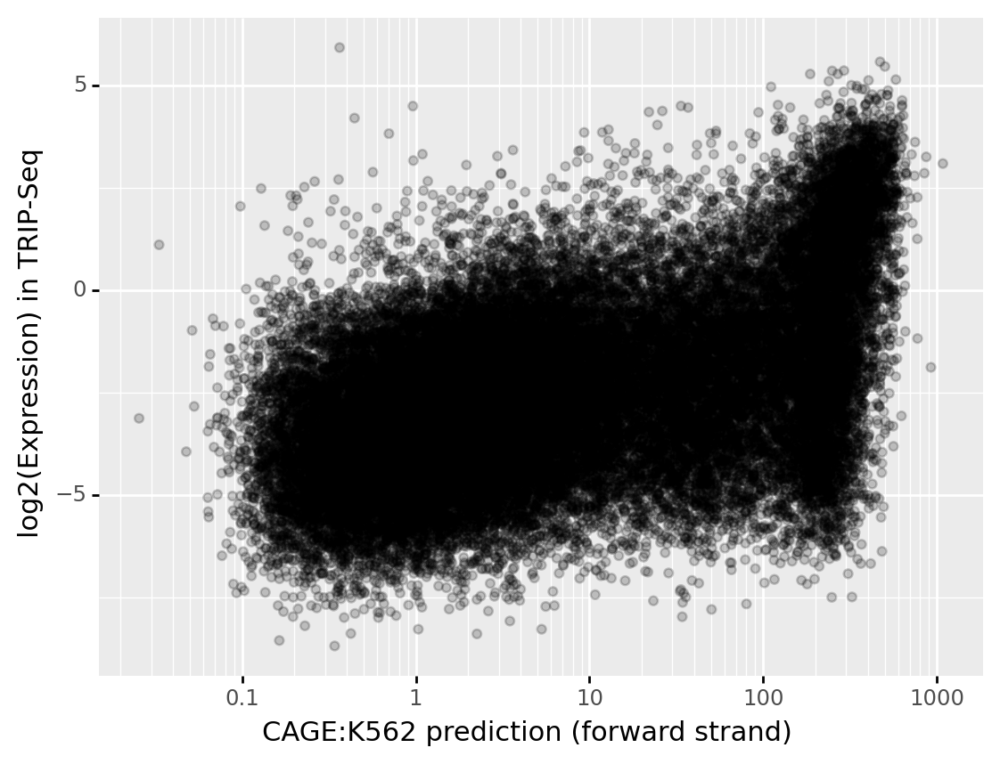

<ggplot: (1428452201882)>

In [63]:
scale = 1.0
p9.options.figure_size = (6.4*scale, 4.8*scale)
(p9.ggplot(data=merged_df_min,mapping=p9.aes(x=pred_col+"_ingenome",y='log2(exp)'))
 + p9.geom_point(alpha=0.2)
 + p9.scale_x_log10()
 + p9.labs(x="CAGE:K562 prediction (forward strand)", y="log2(Expression) in TRIP-Seq")
)

In [64]:
promoter_reduced = merged_df_min.groupby(['promoter']).median()[[pred_col+"_ingenome","log2(exp)"]]

In [65]:
print(scipy.stats.pearsonr(np.log2(promoter_reduced[pred_col+"_ingenome"]+1),
                           promoter_reduced['log2(exp)']))

(0.9824913005374185, 0.00045714814950393245)


In [66]:
print(scipy.stats.spearmanr(promoter_reduced[pred_col+"_ingenome"],
                           promoter_reduced['log2(exp)']))

SpearmanrResult(correlation=1.0, pvalue=0.0)


In [67]:
promoter_reduced.reset_index()

,promoter,"CAGE:chronic myelogenous leukemia cell line:K562 ENCODE, biol__landmark_sum_ingenome",log2(exp)
0,dev1,55.669757,-1.829988
1,dev2,0.829423,-3.423424
2,dev3,2.105943,-3.110301
3,hk1,254.197422,-0.385150
4,hk2,1.180725,-3.272280
5,hk3,6.343817,-2.404032


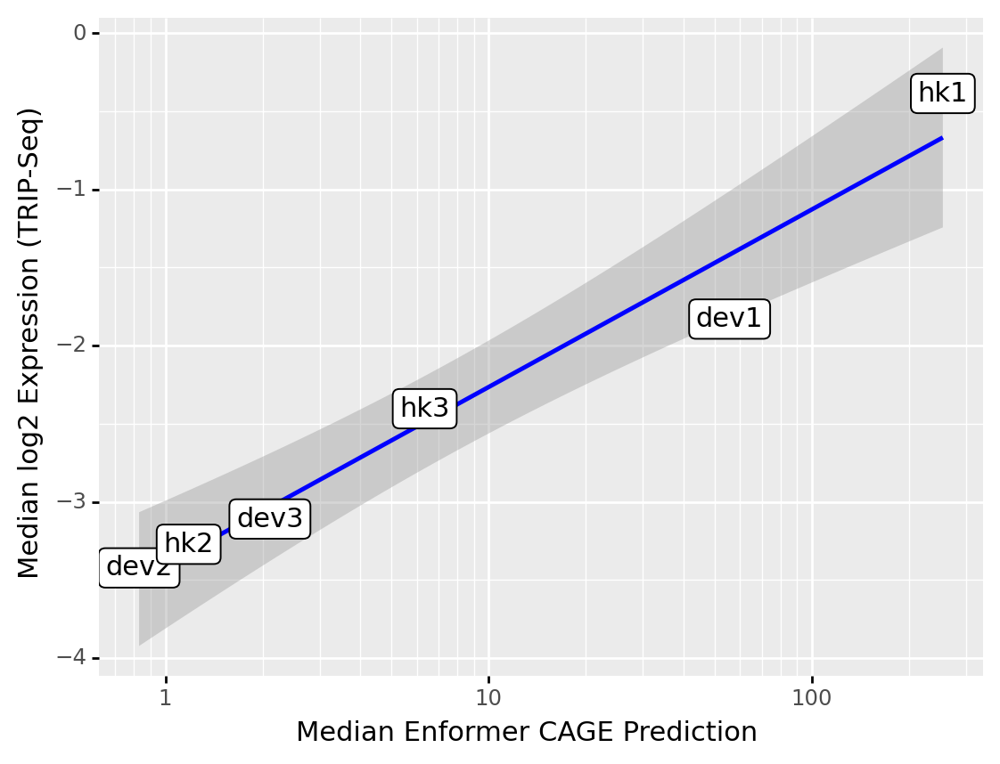

<ggplot: (1428452018878)>

In [68]:
scale = 1.0
p9.options.figure_size = (6.4*scale, 4.8*scale)
p = (p9.ggplot(data=promoter_reduced.reset_index(),mapping=p9.aes(x=pred_col+"_ingenome",y='log2(exp)'))
 + p9.geom_point()
 + p9.geom_smooth(method="lm", color="blue")
 + p9.geom_label(p9.aes(label="promoter"))
 + p9.scale_x_log10()
 + p9.labs(x="Median Enformer CAGE Prediction", y="Median log2 Expression (TRIP-Seq)")
)
p

In [69]:
scale = 1
p.save("Graphics/" + "xsup_distal_cohen_prom" + ".svg", width=6.4*scale, height=4.8*scale, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.4 x 4.8 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/xsup_distal_cohen_prom.svg


### Correlation for each promoter

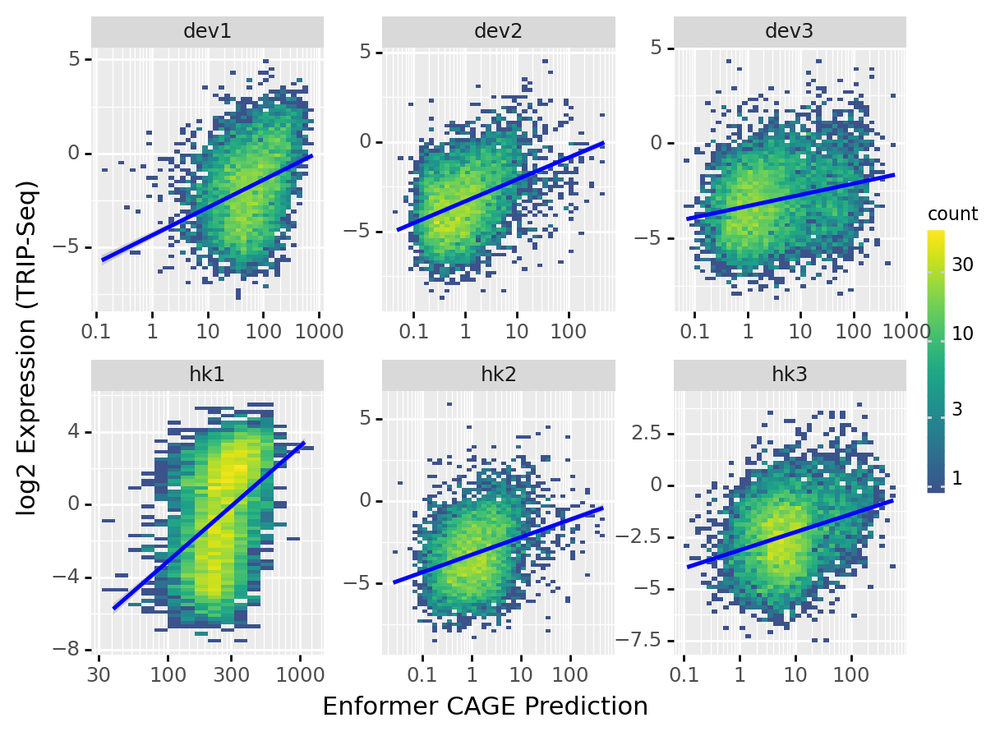

<ggplot: (1428471404017)>

In [71]:
scale = 1.0
p9.options.figure_size = (6.4*scale, 4.8*scale)
p = (p9.ggplot(data=merged_df_min,mapping=p9.aes(x=pred_col+"_ingenome",y='log2(exp)'))
 #+ p9.geom_point(alpha=0.1)
 + p9.geom_bin2d(binwidth = (0.1, 0.2), raster=True)
 + p9.scale_x_log10()
 + p9.labs(x="Enformer CAGE Prediction", y="log2 Expression (TRIP-Seq)")
 + p9.scale_fill_continuous(ListedColormap(cm.get_cmap('viridis', 512)(np.linspace(0.25, 1, 512))), trans="log10")
 + p9.geom_smooth(method="lm", color="blue")
 + p9.theme(legend_text=p9.element_text(size=8),legend_title=p9.element_text(size=8),
            legend_box_margin=0,legend_key_width=5,
            subplots_adjust={'wspace': 0.25,'hspace': 0.3})
 + p9.facet_wrap('~promoter',scales="free"))
p

In [72]:
scale = 1
p.save("Graphics/" + "xsup_distal_cohen_expr" + ".svg", width=6.4*scale, height=4.8*scale, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.4 x 4.8 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/xsup_distal_cohen_expr.svg


In [73]:
r_list = []
windows = [k.split("_")[-1] for k in merged_df_min.keys() if pred_col in k]
for promoter in ["hk1","hk2", "hk3", "dev1", "dev2", "dev3"]:
    for wdw in windows:
        subset = merged_df_min.query('promoter == @promoter')
        r = scipy.stats.pearsonr(subset['log2(exp)'],
                               np.log2(subset[pred_col+"_"+wdw]+1))[0]
        rho = scipy.stats.spearmanr(subset['log2(exp)'],
                                subset[pred_col+"_"+wdw])[0]
        r_list.append({
            "promoter":promoter,
            "window_size":wdw,
            "r":r,
            "rho":rho
        })
min_corrs = pd.DataFrame(r_list)

min_corrs["window_size"] = min_corrs["window_size"].apply(lambda x: x if x != "ingenome" else "Full")
min_corrs["window_size"] = pd.Categorical(min_corrs["window_size"], [x for x in windows if x != "ingenome"] + ["Full"])

In [74]:
min_corrs.query('window_size == "Full"')

,promoter,window_size,r,rho
0,hk1,Full,0.398340,0.413669
10,hk2,Full,0.304158,0.279203
20,hk3,Full,0.311923,0.253766
30,dev1,Full,0.334489,0.334219
40,dev2,Full,0.385766,0.358763
50,dev3,Full,0.238215,0.229634


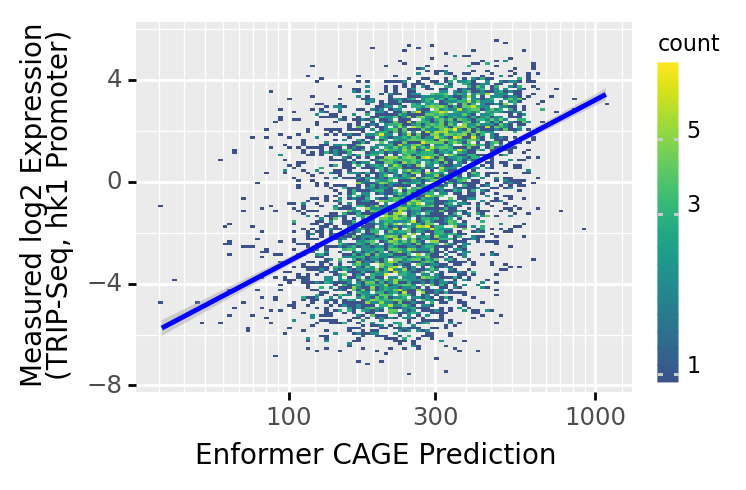

<ggplot: (1428449880149)>

In [93]:
scale = 0.5
p9.options.figure_size = (6.4*scale, 4.8*scale)
p = (p9.ggplot(data=merged_df_min.query('promoter == "hk1"'),mapping=p9.aes(x=pred_col+"_ingenome",y='log2(exp)'))
 #+ p9.geom_point(alpha=0.1)
 + p9.geom_bin2d(binwidth = (0.015, 0.1), raster=True)
 + p9.scale_x_log10()
 + p9.labs(x="Enformer CAGE Prediction", y="Measured log2 Expression\n(TRIP-Seq, hk1 Promoter)")
 + p9.scale_fill_continuous(ListedColormap(cm.get_cmap('viridis', 512)(np.linspace(0.25, 1, 512))), trans="log10")
 + p9.geom_smooth(method="lm", color="blue")
 + p9.theme(legend_text=p9.element_text(size=8),legend_title=p9.element_text(size=8),
            legend_box_margin=0,legend_key_width=5,
            legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10))
)
p

In [91]:
p.save("Graphics/" + "distal_cohen" + ".svg", width=2.7, height=3.2, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 2.7 x 3.2 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/distal_cohen.svg


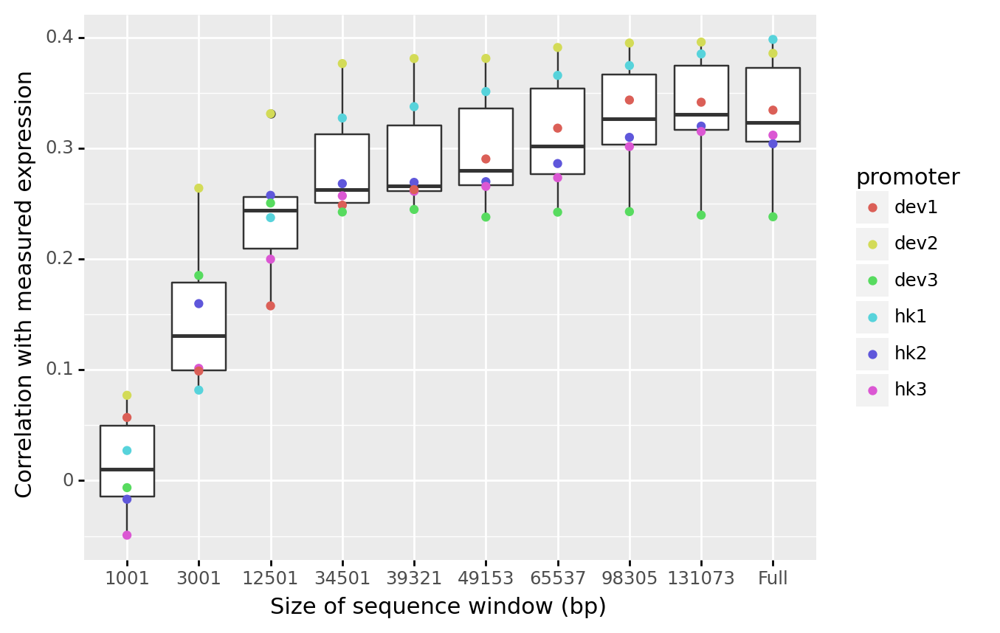

<ggplot: (1435589487258)>

In [33]:
scale = 1.0
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=min_corrs,mapping=p9.aes(x="window_size",y="r"))#,color="promoter"))
 + p9.geom_boxplot()
 + p9.geom_point(p9.aes(color="promoter"))
 #+ p9.geom_jitter()
 + p9.labs(x="Size of sequence window (bp)",y="Correlation with measured expression")
)
p

In [219]:
#scale = 1
#p.save("Graphics/" + "xsup_distal_cohen_windows" + ".svg", width=6.4*scale, height=4.8*scale, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.4 x 4.8 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/xsup_distal_cohen_windows.svg


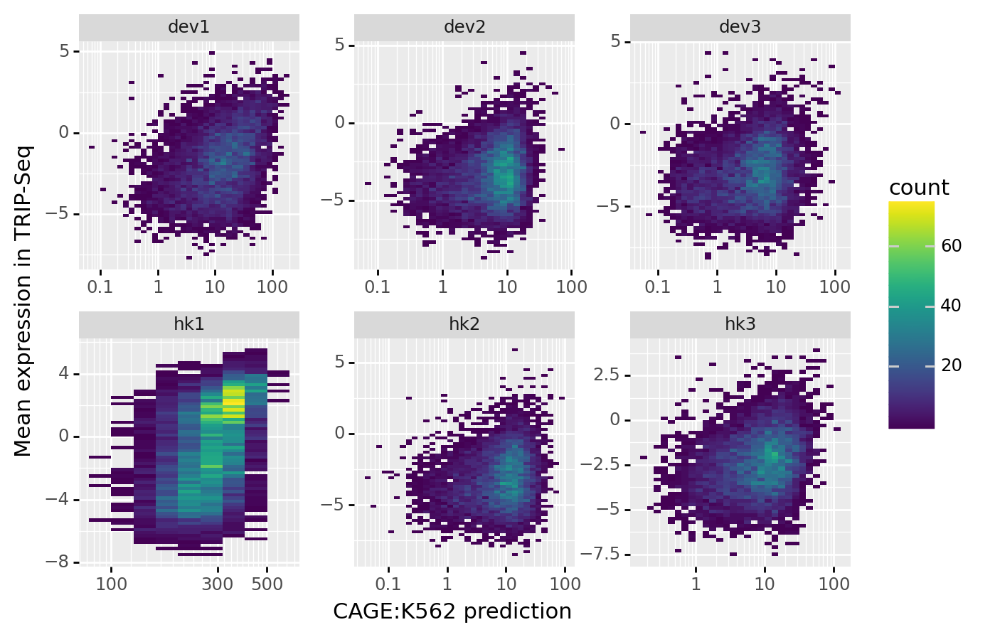

<ggplot: (1435589133303)>

In [34]:
scale = 1.0
p9.options.figure_size = (7*scale, 4.8*scale)
(p9.ggplot(data=merged_df_full,mapping=p9.aes(x=pred_col+"_ingenome",y='log2(exp)'))
 #+ p9.geom_point(alpha=0.1)
 + p9.geom_bin2d(binwidth = (0.1, 0.2))
 + p9.scale_x_log10()
 + p9.labs(x="CAGE:K562 prediction", y="Mean expression in TRIP-Seq")
 + p9.theme(subplots_adjust={'wspace': 0.25,'hspace': 0.3})
 + p9.facet_wrap('~promoter',scales="free"))

In [35]:
r_list = []
windows = [k.split("_")[-1] for k in merged_df_min.keys() if pred_col in k]
for promoter in ["hk1","hk2", "hk3", "dev1", "dev2", "dev3"]:
    for wdw in windows:
        subset = merged_df_full.query('promoter == @promoter')
        r = scipy.stats.pearsonr(subset['log2(exp)'],
                               np.log2(subset[pred_col+"_"+wdw]+1))[0]
        rho = scipy.stats.spearmanr(subset['log2(exp)'],
                                subset[pred_col+"_"+wdw])[0]
        r_list.append({
            "promoter":promoter,
            "window_size":wdw,
            "r":r,
            "rho":rho
        })
full_corrs = pd.DataFrame(r_list)

full_corrs["window_size"] = full_corrs["window_size"].apply(lambda x: x if x != "ingenome" else "Full")
full_corrs["window_size"] = pd.Categorical(full_corrs["window_size"], [x for x in windows if x != "ingenome"] + ["Full"])

In [36]:
full_corrs.query('window_size == "Full"')

,promoter,window_size,r,rho
0,hk1,Full,0.451577,0.467940
10,hk2,Full,0.185051,0.174059
20,hk3,Full,0.273889,0.265329
30,dev1,Full,0.389039,0.385172
40,dev2,Full,0.195220,0.180890
50,dev3,Full,0.212758,0.201066


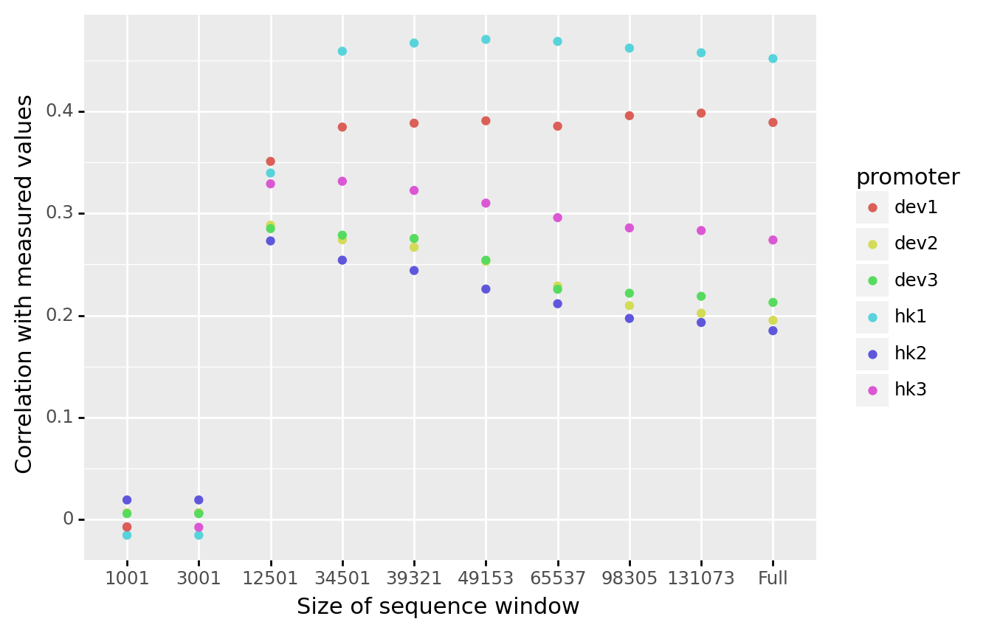

<ggplot: (1435588777569)>

In [37]:
scale = 1.0
p9.options.figure_size = (6.4*scale, 4.8*scale)

(p9.ggplot(data=full_corrs,mapping=p9.aes(x="window_size",y="r", color="promoter"))
 #+ p9.geom_boxplot()
 + p9.geom_point()
 #+ p9.geom_jitter()
 + p9.labs(x="Size of sequence window",y="Correlation with measured values")
)

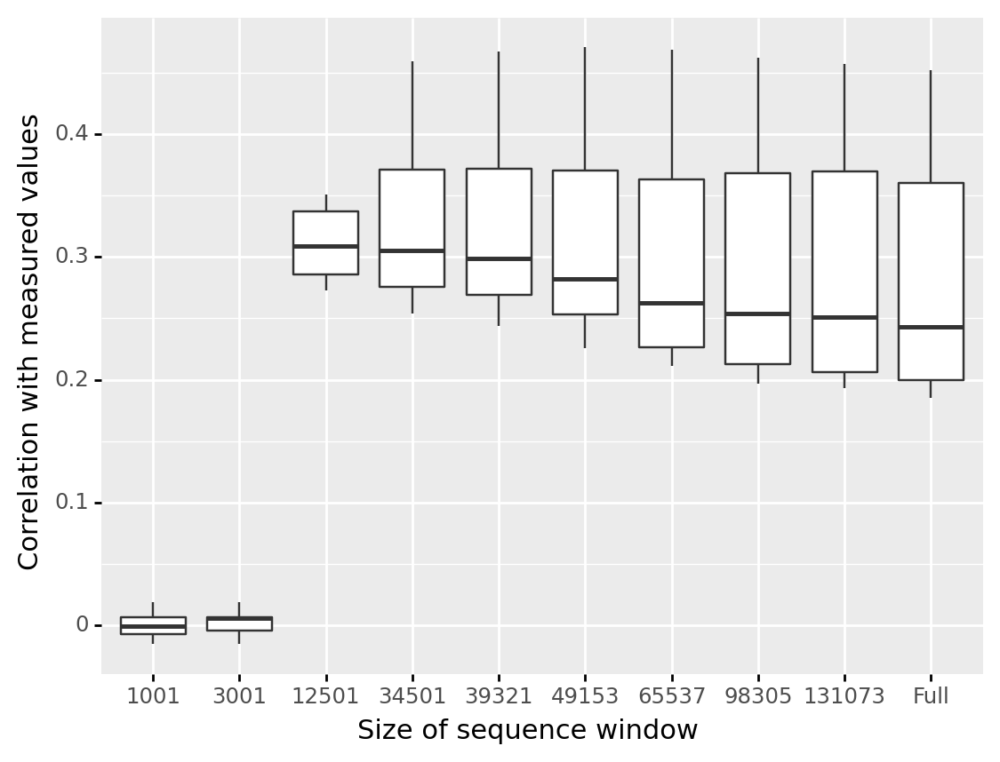

<ggplot: (1435588779731)>

In [38]:
scale = 1.0
p9.options.figure_size = (6.4*scale, 4.8*scale)

(p9.ggplot(data=full_corrs,mapping=p9.aes(x="window_size",y="r"))
 + p9.geom_boxplot()
 + p9.labs(x="Size of sequence window",y="Correlation with measured values")
)

### Basenji2

In [75]:
results_basenji2 = pd.read_csv(base_path_results + "cohen_tripseq-basenji2-latest_results.tsv",sep="\t")
# average over different offsets
results_basenji2 = (results_basenji2.groupby(["promoter","LP_interval", "insert_type", "window_size"])[[x for x in results.keys() if "CAGE" in x]].mean().reset_index())
merged_df_basenji2 = results_basenji2.merge(trip, on=["promoter","LP_interval"])

In [76]:
# average counts if the same promoter was measured several times at a location
merged_df_basenji2 = (merged_df_basenji2.groupby(["promoter","LP_interval", "Orientation", "insert_type", "window_size"])
             [[pred_col,"log2(exp)"]]
            .mean().reset_index())

In [77]:
merged_df_full_basenji2 = merged_df_basenji2.query('insert_type == "full"')
merged_df_min_basenji2 = merged_df_basenji2.query('insert_type == "minimal"')

In [78]:
print(scipy.stats.pearsonr(np.log2(merged_df_min_basenji2[pred_col]+1),
                           merged_df_min_basenji2['log2(exp)']))
print(scipy.stats.spearmanr(merged_df_min_basenji2[pred_col],
                           merged_df_min_basenji2['log2(exp)']))

(0.4602065591667928, 0.0)
SpearmanrResult(correlation=0.4216100434438393, pvalue=0.0)


In [79]:
print(scipy.stats.pearsonr(np.log2(merged_df_full_basenji2[pred_col]+1),
                           merged_df_full_basenji2['log2(exp)']))
print(scipy.stats.spearmanr(merged_df_full_basenji2[pred_col],
                           merged_df_full_basenji2['log2(exp)']))

(0.41243784391564486, 0.0)
SpearmanrResult(correlation=0.3544916600761526, pvalue=0.0)


In [80]:
promoter_reduced_basenji2 = merged_df_min_basenji2.groupby(['promoter']).median()[[pred_col,"log2(exp)"]]

In [81]:
print(scipy.stats.pearsonr(np.log2(promoter_reduced_basenji2[pred_col]+1),
                           promoter_reduced_basenji2['log2(exp)']))

(0.9555664305214904, 0.0029176496115404676)


In [82]:
print(scipy.stats.spearmanr(promoter_reduced_basenji2[pred_col],
                           promoter_reduced_basenji2['log2(exp)']))

SpearmanrResult(correlation=1.0, pvalue=0.0)


In [83]:
r_list = []
for promoter in ["hk1","hk2", "hk3", "dev1", "dev2", "dev3"]:
    subset = merged_df_min_basenji2.query('promoter == @promoter')
    r = scipy.stats.pearsonr(subset['log2(exp)'],
                           np.log2(subset[pred_col]+1))[0]
    rho = scipy.stats.spearmanr(subset['log2(exp)'],
                            subset[pred_col])[0]
    r_list.append({
        "promoter":promoter,
        "window_size":"Basenji2",
        "r":r,
        "rho":rho
    })
min_corrs_basenji2 = pd.DataFrame(r_list)

In [84]:
min_corrs_compare = pd.concat([min_corrs,min_corrs_basenji2])

/scratch/tmp/karollus/ipykernel_933531/1594768443.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/scratch/tmp/karollus/ipykernel_933531/1594768443.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/scratch/tmp/karollus/ipykernel_933531/1594768443.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.ht

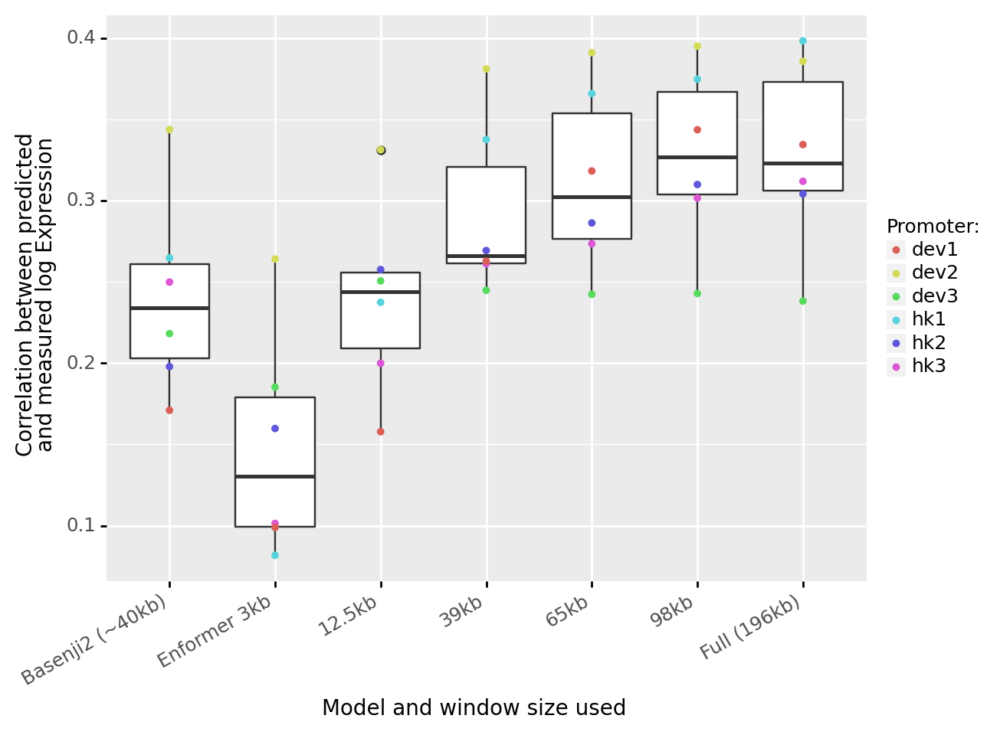

<ggplot: (1428452022032)>

In [88]:
scale = 1.0

compare_df = min_corrs_compare.query('window_size in ["3001","12501","Basenji2","39321","65537","98305","Full"]')
compare_df["model"] = (compare_df["window_size"]
                             .apply(lambda x: "Enformer" if x != "Basenji2" else "Basenji2"))

rename_dict = {
    "Basenji2": "Basenji2 (~40kb)",
    "3001":"Enformer 3kb",
    "12501":"12.5kb",
    "39321":"39kb",
    "65537":"65kb",
    "98305":"98kb",
    "Full":"Full (196kb)"
}
compare_df["window_size"] = (compare_df["window_size"]
                             .apply(lambda x: x if x not in rename_dict else rename_dict[x]))

compare_df["window_size"] = pd.Categorical(compare_df["window_size"], 
                                           [x for x in rename_dict.values()])

p9.options.figure_size = (6.4*scale, 4.8*scale)
p = (p9.ggplot(data=compare_df,mapping=p9.aes(x="window_size",y="r"))
 + p9.geom_boxplot()
 + p9.geom_point(p9.aes(color="promoter"),size=1)
 + p9.labs(x="Model and window size used", y="Correlation between predicted\nand measured log Expression", color="Promoter:")
 + p9.theme(legend_box_margin=0,legend_key_size = 9, 
            legend_text = p9.element_text(size=9),
            legend_title = p9.element_text(size=9),
           axis_title=p9.element_text(size=10),
     axis_text_x=p9.element_text(rotation=30, hjust=1))    
)
p

In [89]:
p.save("Graphics/" + "distal_cohen_compare" + ".svg", width=2.3, height=2.9, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 2.3 x 2.9 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/distal_cohen_compare.svg


## Analysis - Patch-MPRA

In [9]:
pred_col_patchmpra = 'CAGE:chronic myelogenous leukemia cell line:K562  ENCODE, biol__landmark_sum'

In [10]:
obs_patchmpra = pd.read_csv(base_path_data + "patchMPRA_expression.tsv", sep="\t").rename(columns={'LP':'LP_name'})

In [11]:
results_patchmpra = pd.read_csv(base_path_results + "cohen_patchmpra-latest_results.tsv",sep="\t")
# average over different offsets
results_patchmpra = (results_patchmpra.groupby(["oligo_id","LP_name"])[[x for x in results_patchmpra.keys() if "CAGE" in x]].mean().reset_index())

In [12]:
patchmpra_merged = results_patchmpra.merge(obs_patchmpra,on=["oligo_id","LP_name"])

In [13]:
patchmpra_merged["log_pred_col"] = np.log2(patchmpra_merged[pred_col_patchmpra] + 1)

In [14]:
scipy.stats.pearsonr(np.log10(patchmpra_merged[pred_col_patchmpra] + 1),patchmpra_merged["mean_exp"])

(0.5126459472246556, 9.476169557099362e-181)

### Promoter and location performance

In [87]:
patchmpra_prom = patchmpra_merged.groupby(['oligo_id']).mean()[[pred_col_patchmpra,"mean_exp"]]

In [88]:
scipy.stats.pearsonr(np.log10(patchmpra_prom[pred_col_patchmpra] + 1),patchmpra_prom["mean_exp"])

(0.6944941309663191, 1.9194987735539342e-98)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/guides/guides.py:197: PlotnineWarning: Cannot generate legend for the 'fill' aesthetic. Make sure you have mapped a variable to it


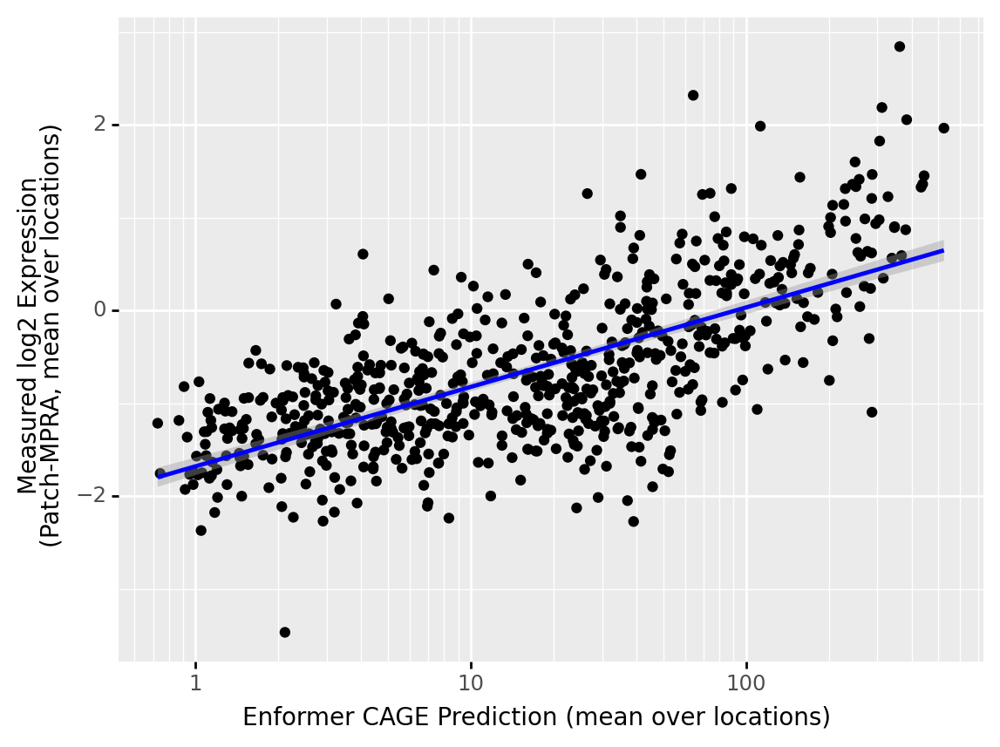

<ggplot: (1435589318120)>

In [118]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)
p = (p9.ggplot(data=patchmpra_prom,mapping=p9.aes(x=pred_col_patchmpra,y='mean_exp'))
 + p9.geom_point()
 #+ p9.geom_bin2d(binwidth = (0.015, 0.1), raster=True)
 + p9.scale_x_log10()
 + p9.labs(x="Enformer CAGE Prediction (mean over locations)", y="Measured log2 Expression\n(Patch-MPRA, mean over locations)")
 + p9.scale_fill_continuous(ListedColormap(cm.get_cmap('viridis', 512)(np.linspace(0.25, 1, 512))), trans="log10")
 + p9.geom_smooth(method="lm", color="blue")
 + p9.theme(legend_text=p9.element_text(size=8),legend_title=p9.element_text(size=8),
            legend_box_margin=0,legend_key_width=5,
            axis_title=p9.element_text(size=10))
)
p

In [119]:
scale = 1
p.save("Graphics/" + "xsup_distal_cohen_patch_prom" + ".svg", width=6.4*scale, height=4.8*scale, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.4 x 4.8 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/xsup_distal_cohen_patch_prom.svg
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/guides/guides.py:197: PlotnineWarning: Cannot generate legend for the 'fill' aesthetic. Make sure you have mapped a variable to it


In [114]:
patchmpra_loc = patchmpra_merged.groupby(['LP_name']).mean()[[pred_col_patchmpra,"mean_exp"]]

In [116]:
scipy.stats.pearsonr(np.log10(patchmpra_loc[pred_col_patchmpra] + 1),patchmpra_loc["mean_exp"])

(0.3669554021311579, 0.6330445978688422)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/guides/guides.py:197: PlotnineWarning: Cannot generate legend for the 'fill' aesthetic. Make sure you have mapped a variable to it


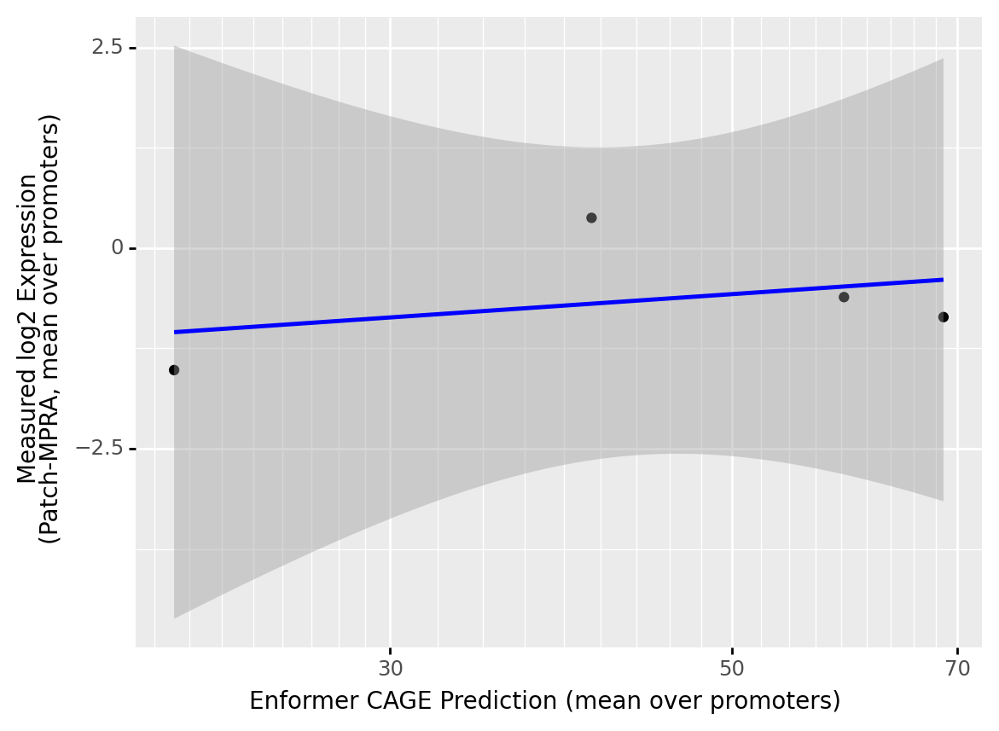

<ggplot: (1435589505591)>

In [121]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)
p = (p9.ggplot(data=patchmpra_loc,mapping=p9.aes(x=pred_col_patchmpra,y='mean_exp'))
 + p9.geom_point()
 #+ p9.geom_bin2d(binwidth = (0.015, 0.1), raster=True)
 + p9.scale_x_log10()
 + p9.labs(x="Enformer CAGE Prediction (mean over promoters)", y="Measured log2 Expression\n(Patch-MPRA, mean over promoters)")
 + p9.scale_fill_continuous(ListedColormap(cm.get_cmap('viridis', 512)(np.linspace(0.25, 1, 512))), trans="log10")
 + p9.geom_smooth(method="lm", color="blue")
 + p9.theme(legend_text=p9.element_text(size=8),legend_title=p9.element_text(size=8),
            legend_box_margin=0,legend_key_width=5,
            axis_title=p9.element_text(size=10))
)
p

In [111]:
scale = 1
p.save("Graphics/" + "xsup_distal_cohen_patch_prom" + ".svg", width=6.4*scale, height=4.8*scale, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.4 x 4.8 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/xsup_distal_cohen_patch_prom.svg
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/guides/guides.py:197: PlotnineWarning: Cannot generate legend for the 'fill' aesthetic. Make sure you have mapped a variable to it


### Multiplicative model

#### Cohen

In [93]:
ols_cohen_prom = (statsmodels.regression.linear_model.OLS
                  .from_formula('mean_exp ~ oligo_id',
                                data=patchmpra_merged))

res_cohen_prom = ols_cohen_prom.fit()

preds = res_cohen_prom.predict()

print(scipy.stats.pearsonr(patchmpra_merged["mean_exp"], preds))
print(sklearn.metrics.r2_score(patchmpra_merged["mean_exp"], preds))

(0.7428170408568986, 0.0)
0.5517771561873978


In [94]:
ols_cohen_mult = (statsmodels.regression.linear_model.OLS
                  .from_formula('mean_exp ~ oligo_id + LP_name',
                                data=patchmpra_merged))

res_cohen_mult = ols_cohen_mult.fit()

preds = res_cohen_mult.predict()

params_cohen = res_cohen_mult.params.reset_index().rename(columns={"index":"Name",0:"Cohen"})

print(scipy.stats.pearsonr(patchmpra_merged["mean_exp"], preds))
print(sklearn.metrics.r2_score(patchmpra_merged["mean_exp"], preds))

(0.952411057034112, 0.0)
0.907086821560838


#### Enformer

In [95]:
ols_enformer_prom = (statsmodels.regression.linear_model.OLS
                  .from_formula('log_pred_col ~ oligo_id',
                                data=patchmpra_merged))

res_enformer_prom = ols_enformer_prom.fit()

preds = res_enformer_prom.predict()

print(scipy.stats.pearsonr(patchmpra_merged["log_pred_col"], preds))
print(sklearn.metrics.r2_score(patchmpra_merged["log_pred_col"], preds))

(0.8289224958518522, 0.0)
0.687112504129262


In [96]:
ols_enformer_mult = (statsmodels.regression.linear_model.OLS
                  .from_formula('log_pred_col ~ oligo_id + LP_name',
                                data=patchmpra_merged))

res_enformer_mult = ols_enformer_mult.fit()

preds = res_enformer_mult.predict()

params_enformer = res_enformer_mult.params.reset_index().rename(columns={"index":"Name",0:"Enformer"})

print(scipy.stats.pearsonr(patchmpra_merged["log_pred_col"], preds))
print(sklearn.metrics.r2_score(patchmpra_merged["log_pred_col"], preds))

(0.9275820381791544, 0.0)
0.8604084375525923


#### Compare params

In [97]:
params_merged = params_enformer.merge(params_cohen, on="Name")

In [99]:
scipy.stats.pearsonr(params_merged.loc[params_merged.Name.str.startswith('oligo')]["Enformer"],params_merged.loc[params_merged.Name.str.startswith('oligo')]["Cohen"])

(0.7288025849683157, 8.443247425951618e-113)

In [100]:
scipy.stats.pearsonr(params_merged.loc[params_merged.Name.str.startswith('LP')]["Enformer"],params_merged.loc[params_merged.Name.str.startswith('LP')]["Cohen"])

(0.3019236883194698, 0.8047424333173329)

#### Induced variation

In [101]:
patchmpra_std = patchmpra_merged.groupby('oligo_id')[['mean_exp','log_pred_col']].std().reset_index()
patchmpra_std["Name"] = patchmpra_std["oligo_id"].apply(lambda x: "{}[T.{}]".format("oligo_id",x))
patchmpra_std = patchmpra_std.merge(params_merged,on="Name")

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/stats/smoothers.py:310: PlotnineWarning: Confidence intervals are not yet implementedfor lowess smoothings.


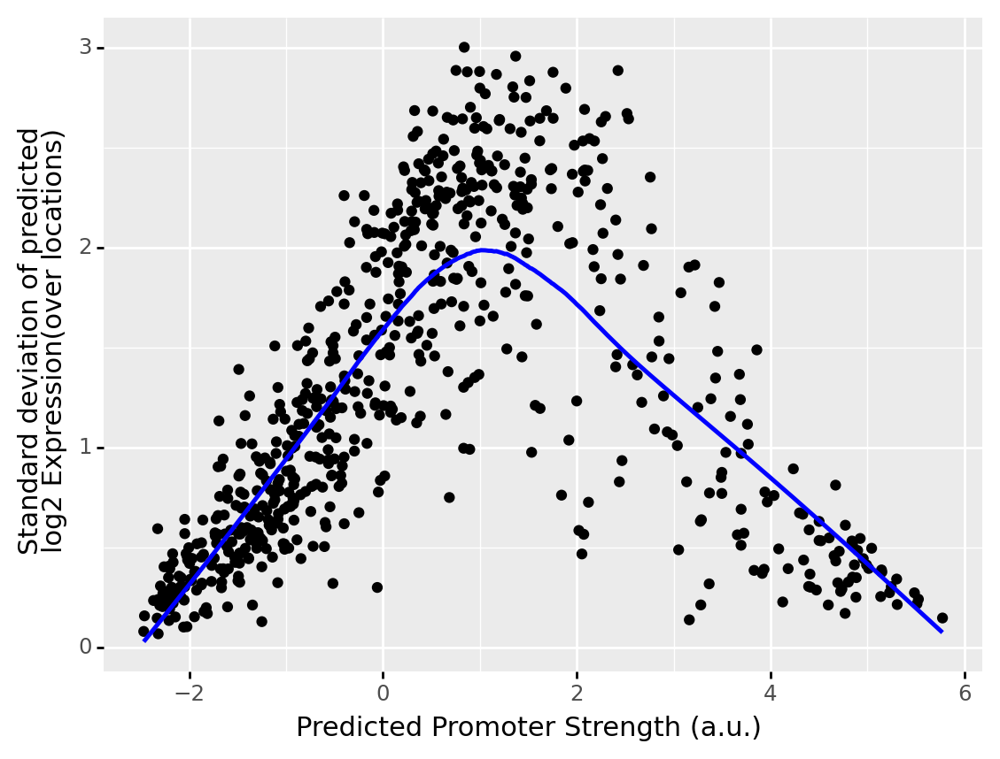

<ggplot: (1435588417588)>

In [106]:
p=(p9.ggplot(data=patchmpra_std, 
            mapping=p9.aes(x="Enformer",y="log_pred_col"))
 + p9.geom_point()
 + p9.geom_smooth(color="blue")
 + p9.labs(x="Predicted Promoter Strength (a.u.)",y="Standard deviation of predicted\nlog2 Expression(over locations)")
 #+ p9.geom_smooth(method="lm", color="blue")
)
p

In [107]:
p.save("Graphics/" + "xsup_distal_cohen_patch_std" + ".svg", width=6.4*scale, height=4.8*scale, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.4 x 4.8 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/xsup_distal_cohen_patch_std.svg
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/stats/smoothers.py:310: PlotnineWarning: Confidence intervals are not yet implementedfor lowess smoothings.


/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/stats/smoothers.py:310: PlotnineWarning: Confidence intervals are not yet implementedfor lowess smoothings.


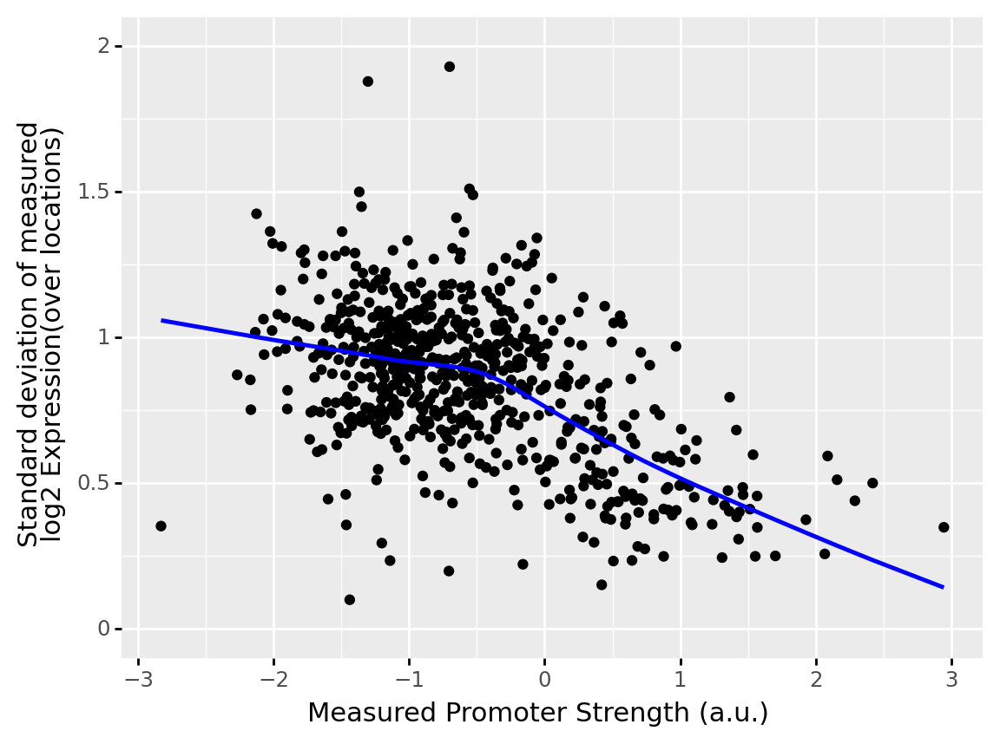

<ggplot: (1435588708587)>

In [122]:
p=(p9.ggplot(data=patchmpra_std, 
            mapping=p9.aes(x="Cohen",y="mean_exp"))
 + p9.geom_point()
 + p9.geom_smooth(color="blue")
 + p9.coord_cartesian(ylim=(0,2))
 + p9.labs(x="Measured Promoter Strength (a.u.)",y="Standard deviation of measured\nlog2 Expression(over locations)")
 #+ p9.geom_smooth(method="lm", color="blue")
)
p

In [109]:
p.save("Graphics/" + "xsup_distal_cohen_patch_stdobs" + ".svg", width=6.4*scale, height=4.8*scale, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.4 x 4.8 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/xsup_distal_cohen_patch_stdobs.svg
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/stats/smoothers.py:310: PlotnineWarning: Confidence intervals are not yet implementedfor lowess smoothings.


# Bergman et al. Enhancer-Promoter Compatibility MPRA

The experiment by Bergman et al. tested many combinations of promoter and enhancer in a plasmid background

Uses hSTARR-seq_SCP1_vector_ 6243

Locations:

- Promoter: 18-118 (KpnI-ApaI, replaces SCP1 promoter)
- Enhancer: 372-1838 (AgeI-SgrDI)

In between there is a truncated GFP and some other stuff.

Architecture:

plasmid_left + five_prime_prom + promoter + three_prime_prom + tGFP + bc_left + bc + bc_right + five_prime_enhancer + enhancer + three_prime_enhancer + plasmid_right

All enhancers are hg19, in the + direction.


Lots of duplicated rows apparently. Maybe:

- Aggregate by taking median accross replicates and then median across barcodes?
- Throw out rows which are only present in one replicate?

In [297]:
base_path_data = "Data/Bergman_compatibility_logic/"
base_path_data_fulco = "Data/Fulco_CRISPRi/"
base_path_results = "Results/Bergman_compatibility_logic/"
base_path_results_fulco = "Results/Fulco_CRISPRi/"

In [298]:
promoters = pd.read_csv(os.path.join(base_path_data,"promoters.txt"),sep="\t")[["fragment","seq"]]
enhancers = pd.read_csv(os.path.join(base_path_data,"enhancers.txt"),sep="\t")[["fragment","seq"]]
crs_df = pd.concat([promoters, enhancers])

In [299]:
len(promoters)

1000

In [300]:
promoters["seq"].str.len().describe()

count    1000.0
mean      264.0
std         0.0
min       264.0
25%       264.0
50%       264.0
75%       264.0
max       264.0
Name: seq, dtype: float64

In [301]:
enhancers["seq"].str.len().describe()

count    1000.0
mean      264.0
std         0.0
min       264.0
25%       264.0
50%       264.0
75%       264.0
max       264.0
Name: seq, dtype: float64

In [302]:
# get the plasmid sequence
with open(base_path_data + "hstarr_seq.gbk") as file:
    plasmid_sequence = ""
    started_reading = False
    for line in file.readlines():
        if started_reading:
            line = line.strip().replace(" ","").replace("/","")
            line = re.sub(r'[0-9]+', '', line)
            plasmid_sequence += line
        if line.startswith("ORIGIN"):
            started_reading = True
    plasmid_sequence = plasmid_sequence.upper()

plasmid_left = plasmid_sequence[17:]
tGFP = plasmid_sequence[119:372]
plasmid_right = plasmid_sequence[1838:]
five_prime_prom = "TCATGTGGGACATCAAGC"
three_prime_prom = "GCATAGTGAGTCCACCTT"
five_prime_enhancer = "GCTAACTTCTACCCATGC"
three_prime_enhancer = "GCAAGTTAAGTAGGTCGT"
bc_left = "TAGATTGATCTAGAGCATGCA" 
bc_right = "GAGTACTGGTATGTTCA"

In [303]:
#all(pd.read_csv(base_path_data + "GSE184426_ExP_1Kx1K_counts(1).txt",sep="\t") == pd.read_csv(base_path_data + "GSE184426_ExP_1Kx1K_counts.txt",sep="\t"))

In [304]:
exp_df = pd.read_csv(base_path_data + "GSE184426_ExP_1Kx1K_counts.txt",sep="\t")

In [305]:
exp_df["RNA_sum"] = (exp_df["weighted_reads_rep1"] + exp_df["weighted_reads_rep2"] + exp_df["weighted_reads_rep3"] + exp_df["weighted_reads_rep4"])
# subset DNA > 25 and RNA >= 1
exp_df =  exp_df.query('DNA_input > 25 & RNA_sum > 0')
# subset if < 2 barcodes
bc_count = (exp_df[["promoter","enhancer"]]
                  .groupby(["promoter","enhancer"])
                  .size()
                  .reset_index()
                  .rename(columns={0:"bc_count"})
                 ).query('bc_count > 1')
exp_df = exp_df.merge(bc_count, on=["promoter","enhancer"])

In [306]:
# check replicability analysis
exp_df["RNA_sum_1"] = (exp_df["weighted_reads_rep1"] + exp_df["weighted_reads_rep2"]) 
exp_df["RNA_sum_2"] = (exp_df["weighted_reads_rep3"] + exp_df["weighted_reads_rep4"])
exp_df["log(RNA/DNA)_1"] = np.log2(exp_df["RNA_sum_1"]/exp_df["DNA_input"])
exp_df["log(RNA/DNA)_2"] = np.log2(exp_df["RNA_sum_2"]/exp_df["DNA_input"])
scipy.stats.pearsonr(exp_df.replace([np.inf, -np.inf], np.nan).dropna()["log(RNA/DNA)_1"],
                     exp_df.replace([np.inf, -np.inf], np.nan).dropna()["log(RNA/DNA)_2"])[0]**2

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/pandas/core/arraylike.py:364: RuntimeWarning: divide by zero encountered in log2


0.9200486067332204

In [307]:
# aggregate over barcodes
exp_df = (exp_df[["promoter","enhancer","DNA_input","RNA_sum"]]
          .groupby(["promoter","enhancer"])
          .sum()
          .reset_index()
         )

In [308]:
exp_df["log(RNA/DNA)"] = np.log2(exp_df["RNA_sum"]/exp_df["DNA_input"])

In [309]:
# merge with sequences
promoters = pd.read_csv(base_path_data + "promoters.txt",sep="\t").rename(columns={"fragment":"promoter","seq":"promoter_seq"})
enhancers = pd.read_csv(base_path_data + "enhancers.txt",sep="\t").rename(columns={"fragment":"enhancer","seq":"enhancer_seq"})

exp_df = exp_df.merge(promoters[["promoter","promoter_seq"]], on="promoter")
exp_df = exp_df.merge(enhancers[["enhancer","enhancer_seq"]], on="enhancer")

In [19]:
#prom_df = pd.read_csv(base_path_data + "GSE184426_HS-STARR-seq-promoters_counts.txt",sep="\t")
#prom_df["promoter"] = prom_df["chr"] + ":" + prom_df["start"].astype("str") + "-" + prom_df["end"].astype("str") + "-promoter"
#enhance_df = pd.read_csv(base_path_data + "GSE184426_HS-STARR-seq-enhancers_counts.txt",sep="\t")
#enhance_df["enhancer"] = enhance_df["chr"] + ":" + enhance_df["start"].astype("str") + "-" + enhance_df["end"].astype("str") + "-enhancer"

## Test plasmid

In [37]:
def test_bergmann_plasmid(insert, landmark, extra_offset=0, verbose=True):
    offset = compute_offset_to_center_landmark(landmark,insert)

    modified_sequence, minbin, maxbin, landmarkbin = pad_sequence(insert, landmark=landmark, shift_five_end=offset + extra_offset)
    sequence_one_hot = one_hot_encode(modified_sequence)
    predictions = model.predict_on_batch(sequence_one_hot[np.newaxis])['human'][0]
    
    if verbose:
        tracks = {'DNASE:K562': predictions[:, 121],
                  'CAGE:chronic myelogenous leukemia cell line:K562': np.log10(1 + predictions[:,  4828]),
                 }
        plot_tracks(tracks, target_interval)

        print(predictions[minbin-1:maxbin+1,  4828])
        print(predictions[landmarkbin,  4828])
        print(sum(predictions[minbin-1:maxbin+1,  4828]))
    else:
        return sum(predictions[landmarkbin-1:landmarkbin+2,  4828])

In [40]:
promoter = exp_df.sort_values('log(RNA/DNA)').iloc[-1]["promoter_seq"]
enhancer = exp_df.sort_values('log(RNA/DNA)').iloc[-1]["enhancer_seq"]
bc = "N"*16 #dummy barcode

plasmid = plasmid_left + five_prime_prom + promoter + three_prime_prom + tGFP + bc_left + bc + bc_right + five_prime_enhancer + enhancer + three_prime_enhancer + plasmid_right
plasmid_min = five_prime_prom + promoter + three_prime_prom + tGFP + bc_left + bc + bc_right + five_prime_enhancer + enhancer + three_prime_enhancer 

landmark_plasmid = len(plasmid_left + five_prime_prom) + len(promoter)//2
landmark_min = len(five_prime_prom) + len(promoter)//2

target_interval = kipoiseq.Interval("chr0",0,(SEQUENCE_LENGTH - PADDING*2))

[5.39860316e-03 6.12268746e-02 3.43165994e-02 4.56262343e-02
 3.29784937e-02 2.33416334e-02 2.66539548e-02 3.46533954e-02
 2.66964063e-02 3.80323939e-02 4.50203791e-02 5.47565371e-02
 4.00429256e-02 6.72370866e-02 4.93355058e-02 6.90046251e-02
 5.12874760e-02 3.37585211e-02 7.55858496e-02 2.47035120e-02
 2.36154292e-02 3.90868448e-02 2.76219267e-02 7.10849836e-02
 4.68794145e-02 1.35668442e-01 6.08916767e-02 3.40589248e-02
 3.76577675e-02 4.30680327e-02 7.17845857e-02 5.14993817e-02
 6.26154542e-02 9.21903923e-02 5.79488464e-02 1.29159361e-01
 5.95867895e-02 1.37998357e-01 6.09404407e-02 8.51854160e-02
 3.60350385e-02 3.79725881e-02 3.60207260e-02 4.42589894e-02
 1.85257327e-02 2.98062954e-02 2.12418120e-02 2.46350449e-02
 5.71829230e-02 2.72013843e-02 1.54053867e-01 1.35285965e+02
 1.80938959e-01 8.74753967e-02 9.06983390e-02 8.93828645e-02
 1.07017010e-01 1.66069567e-01 9.83007550e-02 8.41763839e-02
 1.11042626e-01 3.33269611e-02 2.63204072e-02 5.25978245e-02
 5.70598319e-02 7.931418

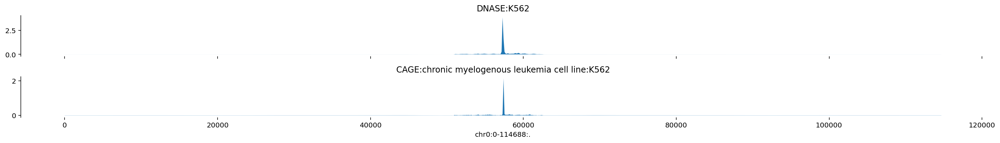

In [41]:
test_bergmann_plasmid(plasmid, landmark_plasmid, extra_offset=0)

[7.3781079e-03 1.2372775e-02 4.9740121e-02 4.1866064e-02 4.3218087e-02
 3.2133833e-02 3.0028585e-02 3.6738850e-02 2.9425956e-02 2.8236475e-02
 4.5547113e-02 6.4099342e-02 4.1979413e-02 6.5313764e-02 6.3859619e-02
 6.4586625e-02 6.4252317e-02 4.1894235e-02 5.4011434e-02 8.5862994e-02
 2.7593052e-02 1.9542411e-02 5.5202030e-02 4.5710985e-02 6.6658907e-02
 7.4338704e-02 1.2484500e-01 5.8792338e-02 4.0383037e-02 4.1184809e-02
 6.3245818e-02 6.5767445e-02 4.9615767e-02 9.0293787e-02 6.9530576e-02
 6.5442510e-02 1.2423794e-01 1.8959829e-01 5.6767728e-02 8.6645618e-02
 4.3372869e-02 4.2305972e-02 2.9021258e-02 4.5799192e-02 2.6714060e-02
 1.6909868e-02 3.6585022e-02 2.4998652e-02 4.5886017e-02 2.1802984e-02
 3.8283117e-02 1.8510243e+00 1.2307913e+02 6.4176477e-02 6.7181021e-02
 1.0712992e-01 8.5017063e-02 1.3493223e-01 1.2483383e-01 1.0406729e-01
 1.3147929e-01 3.4736242e-02 2.9850086e-02 4.4915009e-02 2.5933158e-02
 6.1718106e-02 4.4996299e-02 9.9948183e-02 5.3419862e-02 4.1493759e-02
 3.543

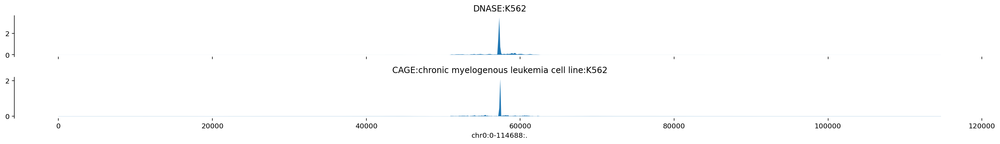

In [42]:
test_bergmann_plasmid(plasmid, landmark_plasmid, extra_offset=-64)

[2.4011133e-02 3.0708030e-02 1.4598701e+00 2.3747360e+02 2.4741664e+00
 4.4974327e-01 8.8769376e-01 5.5819678e-01 3.0049732e-01]
237.4736
243.65848909132183


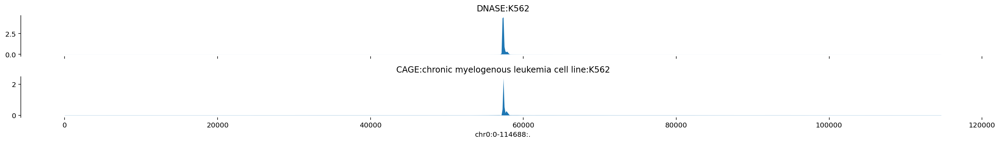

In [29]:
test_bergmann_plasmid(plasmid_min, landmark_min, extra_offset=0)

[2.2226883e-02 3.3893913e-01 2.8328537e+01 1.9897740e+02 4.2033249e-01
 3.5823652e-01 1.1093701e+00 4.7846302e-01 1.2464915e-01]
28.328537
230.15815603546798


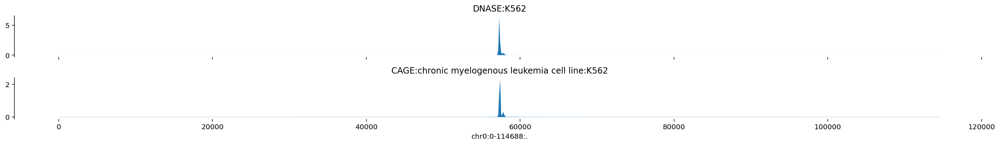

In [30]:
test_bergmann_plasmid(plasmid_min, landmark_min, extra_offset=-64)

## Test aavs1 insertion

In [33]:
def test_bergmann_insertion(insert, landmark, fasta_extractor=fasta_extractor, extra_offset=0, verbose=True):
    offset = compute_offset_to_center_landmark(landmark,insert)

    aavs1 = kipoiseq.Interval(chrom="chr19",start=55_115_750,end=55_115_780)
    
    modified_sequence, minbin, maxbin, landmarkbin = insert_sequence_at_landing_pad(insert, aavs1, fasta_extractor,landmark=landmark, shift_five_end=offset + extra_offset)
    sequence_one_hot = one_hot_encode(modified_sequence)
    predictions = model.predict_on_batch(sequence_one_hot[np.newaxis])['human'][0]
    
    if verbose:
        tracks = {'DNASE:K562': predictions[:, 121],
                  'CAGE:chronic myelogenous leukemia cell line:K562': np.log10(1 + predictions[:,  4828]),
                 }
        plot_tracks(tracks, target_interval)

        print(predictions[minbin-1:maxbin+1,  4828])
        print(predictions[landmarkbin,  4828])
        print(sum(predictions[minbin-1:maxbin+1,  4828]))
    else:
        return (predictions[landmarkbin,  4828], sum(predictions[landmarkbin-1:landmarkbin+2,  4828]))

[  0.31156868   1.5713701    4.250019   252.711        1.6156005
   0.9096566    2.0939806    2.0403166    0.94393235]
252.711
266.4474429488182


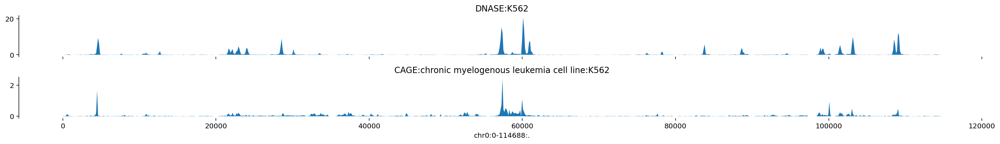

In [35]:
test_bergmann_insertion(plasmid_min, landmark_min, extra_offset=0)

[  4.8351383    3.3473766   30.223114   206.68454      0.713372
   0.719316     2.818737     1.5423566    0.23780273]
30.223114
251.12175308167934


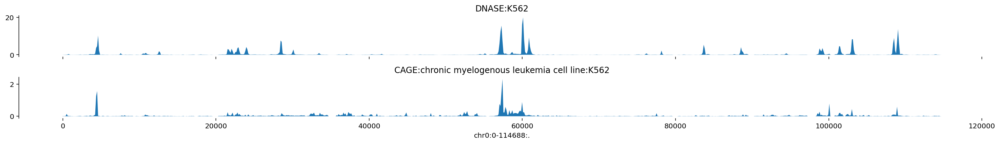

In [36]:
test_bergmann_insertion(plasmid_min, landmark_min, extra_offset=-64)

## Analysis

In [310]:
results = pd.read_csv(base_path_results + "bergmann_exp_cage_dnase_only_latest.tsv",sep="\t")
results = (results.groupby(["promoter","enhancer","insert_type"])[[x for x in results.keys() if "CAGE" in x or "DNASE" in x]].mean().reset_index())

In [311]:
merged_df_all = (results.merge(exp_df, on=["promoter","enhancer"]))
promoter_class = pd.read_csv(os.path.join(base_path_data,"promoter_classes.txt"),sep="\t")[["fragment","promoter_exp_class","randomBG"]].rename(columns={"fragment":"promoter", "randomBG":"randomBG_promoter"})
enhancer_class = pd.read_csv(os.path.join(base_path_data,"enhancer_classes.txt"),sep="\t")[["fragment","enhancer_exp_class","randomBG"]].rename(columns={"fragment":"enhancer", "randomBG":"randomBG_enhancer"})
merged_df_all = merged_df_all.merge(promoter_class,on="promoter").merge(enhancer_class,on="enhancer")

In [312]:
prom_only = pd.read_csv(base_path_results + "bergmann_promoteronly-latest_results.tsv", sep="\t")
prom_only = (prom_only.groupby(["fragment","insert_type"])[[x for x in prom_only.keys() if ("CAGE" in x or "DNASE" in x or "CHIP" in x)]].mean().reset_index())

In [ ]:
enhancer_centred = pd.read_csv(base_path_results + "bergmann_enhancercentered_cage_dnase_only_latest.tsv",sep="\t")
enhancer_centred = (enhancer_centred.groupby(["promoter","enhancer","insert_type"])[[x for x in enhancer_centred.keys() if "CAGE" in x or "DNASE" in x]].mean().reset_index())
enhancer_centred = (enhancer_centred.merge(exp_df, on=["promoter","enhancer"]))

enhancer_centred_min = enhancer_centred.query('insert_type == "min_plasmid"')

### Subset df

In [313]:
# will need to change to 'CAGE:chronic myelogenous leukemia cell line:K562 ENCODE, biol__landmark_sum' soon
pred_col = 'CAGE:chronic myelogenous leukemia cell line:K562 ENCODE, biol__landmark_sum'
pred_col_dnase = 'DNASE:K562_4_landmark_sum'

merged_df_min = merged_df_all.query('insert_type == "min_plasmid"')
merged_df_full = merged_df_all.query('insert_type == "full_plasmid"')
merged_df_ingenome = merged_df_all.query('insert_type == "aavs1"')

In [314]:
# standardize DNA_input (for use in regression later)
merged_df_min["DNA_input_scaled"] = (merged_df_min["DNA_input"] - merged_df_min["DNA_input"].mean())/merged_df_min["DNA_input"].std()

# Prepare some variables in log form
log_pred_col = "log_" + pred_col.replace(":","_").replace(" ","_").replace(",","_")
log_pred_col_dnase = "log_" + pred_col_dnase.replace(":","_").replace(" ","_").replace(",","_")

merged_df_min["log_DNA_input"] = np.log2(merged_df_min["DNA_input"] + 1)
merged_df_min["log_RNA_sum"] = np.log2(merged_df_min["RNA_sum"] + 1)
merged_df_min[log_pred_col] = np.log2(merged_df_min[pred_col] + 1)
merged_df_min[log_pred_col_dnase] = np.log2(merged_df_min[pred_col_dnase] + 1)

/scratch/tmp/karollus/ipykernel_786964/2912087511.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/scratch/tmp/karollus/ipykernel_786964/2912087511.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/scratch/tmp/karollus/ipykernel_786964/2912087511.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

In [ ]:
prom_only_min = prom_only.query('insert_type == "min_plasmid"')
prom_only_full = prom_only.query('insert_type == "full_plasmid"')
prom_only_ingenome = prom_only.query('insert_type == "aavs1"')

In [ ]:
merged_df_ingenome[log_pred_col] = np.log2(merged_df_ingenome[pred_col] + 1)

### Overall correlation

Enformer shows good, but not great, overall correlation with predictions

In [180]:
print(scipy.stats.pearsonr(np.log2(merged_df_full[pred_col]+1), merged_df_full['log(RNA/DNA)']))
print(scipy.stats.spearmanr(merged_df_full[pred_col], merged_df_full['log(RNA/DNA)']))

(0.3954093718811592, 0.0)
SpearmanrResult(correlation=0.448777773640749, pvalue=0.0)


In [181]:
print(scipy.stats.pearsonr(np.log2(merged_df_min[pred_col]+1), merged_df_min['log(RNA/DNA)']))
print(scipy.stats.spearmanr(merged_df_min[pred_col], merged_df_min['log(RNA/DNA)']))

(0.5242764134563132, 0.0)
SpearmanrResult(correlation=0.5470008777811513, pvalue=0.0)


In [182]:
print(scipy.stats.pearsonr(np.log2(merged_df_ingenome[pred_col]+1), merged_df_ingenome['log(RNA/DNA)']))
print(scipy.stats.spearmanr(merged_df_ingenome[pred_col], merged_df_ingenome['log(RNA/DNA)']))

(0.5281292459010362, 0.0)
SpearmanrResult(correlation=0.5148851638754156, pvalue=0.0)


In [306]:
# try DNAse, just for fun
print(scipy.stats.pearsonr(np.log2(merged_df_min['DNASE:K562_1_landmark_sum']+1), merged_df_min['log(RNA/DNA)']))
print(scipy.stats.pearsonr(np.log2(merged_df_min['DNASE:K562_2_landmark_sum']+1), merged_df_min['log(RNA/DNA)']))
print(scipy.stats.pearsonr(np.log2(merged_df_min['DNASE:K562_3_landmark_sum']+1), merged_df_min['log(RNA/DNA)']))
print(scipy.stats.pearsonr(np.log2(merged_df_min['DNASE:K562_4_landmark_sum']+1), merged_df_min['log(RNA/DNA)']))

(0.35464431965608, 0.0)
(0.3553053571681949, 0.0)
(0.3173708571867827, 0.0)
(0.37100724878608254, 0.0)


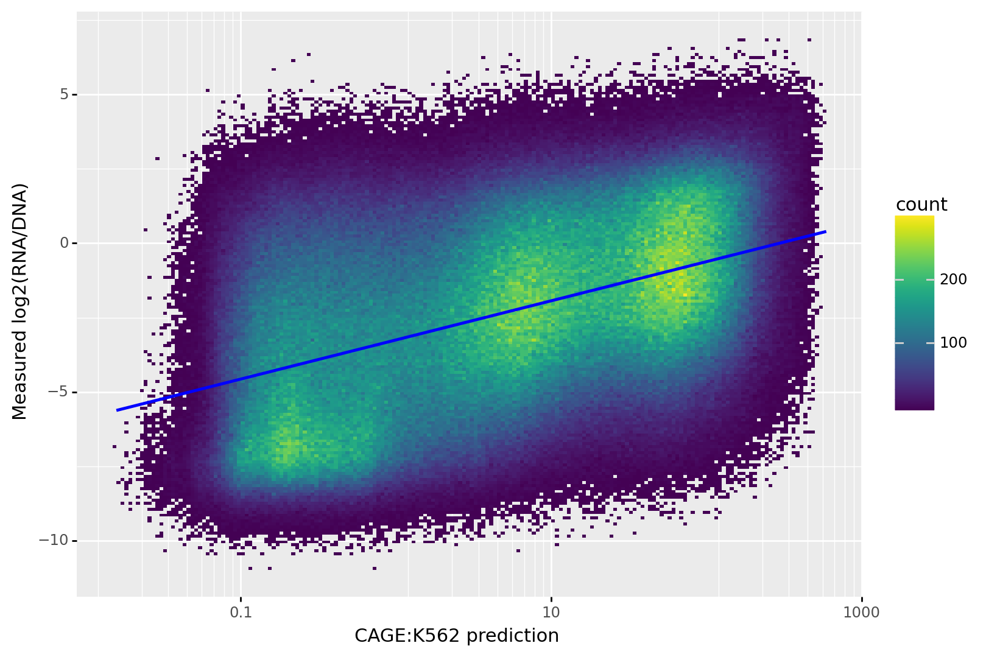

<ggplot: (1406934929905)>

In [31]:
scale = 1.3
p9.options.figure_size = (6.4*scale, 4.8*scale)
(p9.ggplot(data=merged_df,mapping=p9.aes(x=pred_col,y='log(RNA/DNA)'))
 #+ p9.geom_point(alpha=0.1)
 + p9.geom_bin2d(binwidth = (0.025, 0.1))
 + p9.scale_x_log10()
 + p9.geom_smooth(method="lm",color="blue")
 + p9.labs(x="CAGE:K562 prediction", y="Measured log2(RNA/DNA)")
)

In [54]:
ols_pred_fit = (statsmodels.regression.linear_model.OLS
                  .from_formula('log_RNA_sum ~ log_DNA_input + {}'.format(log_pred_col),
                                data=merged_df_min))

res_pred_fit = ols_pred_fit.fit(maxiter=100)

In [56]:
res_pred_fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            log_RNA_sum   R-squared:                       0.470
Model:                            OLS   Adj. R-squared:                  0.470
Method:                 Least Squares   F-statistic:                 2.675e+05
Date:                Thu, 28 Apr 2022   Prob (F-statistic):               0.00
Time:                        12:17:56   Log-Likelihood:            -1.3831e+06
No. Observations:              603615   AIC:                         2.766e+06
Df Residuals:                  603612   BIC:                         2.766e+06
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
===================================================================================================================================================
                                                                                      coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------------------------------------------------------------
Intercept                                                                          -5.5987      0.023   -244.389      0.000      -5.644      -5.554
log_DNA_input                                                                       1.1186      0.002    516.572      0.000       1.114       1.123
log_CAGE_chronic_myelogenous_leukemia_cell_line_K562_ENCODE__biol__landmark_sum     0.6315      0.001    471.691      0.000       0.629       0.634
==============================================================================
Omnibus:                    14441.126   Durbin-Watson:                   1.243
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             8472.638
Skew:                           0.132   Prob(JB):                         0.00
Kurtosis:                       2.483   Cond. No.                         82.8
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [57]:
scipy.stats.pearsonr(res_pred_fit.predict(), merged_df_min["log_RNA_sum"])

(0.6854817568567231, 0.0)

In [62]:
ols_pred_fit = (statsmodels.regression.linear_model.OLS
                  .from_formula('log_RNA_sum ~ log_DNA_input + {}'.format(log_pred_col_dnase),
                                data=merged_df_min))

res_pred_fit = ols_pred_fit.fit(maxiter=100)

In [63]:
scipy.stats.pearsonr(res_pred_fit.predict(), merged_df_min["log_RNA_sum"])

(0.6086513170393186, 0.0)

### Compare (simple) average promoter and enhancer effects

Predicted promoter strengths correlate very well with the average promoter effect measured in the MPRA

However, this is not the case with enhancers, where the correlation is basically nonexistent

#### Correlation of average effects

In [46]:
prom_df = merged_df_min.groupby("promoter")[["log(RNA/DNA)","RNA_sum",pred_col,'DNASE:K562_1_landmark_sum']].mean().reset_index()
enhance_df = merged_df_min.groupby("enhancer")[["log(RNA/DNA)","RNA_sum",pred_col,'DNASE:K562_1_landmark_sum']].mean().reset_index()

In [47]:
print(scipy.stats.pearsonr(np.log2(prom_df[pred_col]+1), prom_df['log(RNA/DNA)']))
print(scipy.stats.spearmanr(prom_df[pred_col], prom_df['log(RNA/DNA)']))

print(scipy.stats.pearsonr(np.log2(prom_df[pred_col]+1), np.log2(prom_df['RNA_sum'] + 1)))
print(scipy.stats.spearmanr(prom_df[pred_col], prom_df['RNA_sum']))

(0.7779703683649615, 1.3287599799054471e-199)
SpearmanrResult(correlation=0.8321622958111093, pvalue=1.1132757034917632e-252)
(0.7422985724842228, 3.025448163165664e-172)
SpearmanrResult(correlation=0.8056893117086434, pvalue=1.1846080329810215e-224)


In [51]:
# try DNAse, just for fun
print(scipy.stats.pearsonr(np.log2(prom_df['DNASE:K562_1_landmark_sum']+1), prom_df['log(RNA/DNA)']))
print(scipy.stats.spearmanr(prom_df['DNASE:K562_1_landmark_sum'], prom_df['log(RNA/DNA)']))

(0.5551040540004717, 2.6918438414325144e-80)
SpearmanrResult(correlation=0.7488710591395145, pvalue=6.165723991295245e-177)


In [49]:
print(scipy.stats.pearsonr(np.log2(enhance_df[pred_col]+1), enhance_df['log(RNA/DNA)']))
print(scipy.stats.spearmanr(enhance_df[pred_col], enhance_df['log(RNA/DNA)']))

print(scipy.stats.pearsonr(np.log2(enhance_df[pred_col]+1), np.log2(enhance_df['RNA_sum'] + 1)))
print(scipy.stats.spearmanr(enhance_df[pred_col], enhance_df['RNA_sum']))

(-0.02741593444495286, 0.386702859690862)
SpearmanrResult(correlation=-0.01161518231658512, pvalue=0.7138626791209894)
(-0.13179182485070848, 2.933570944928807e-05)
SpearmanrResult(correlation=-0.10552878730433839, pvalue=0.000835975447083089)


In [52]:
# try DNAse, just for fun
print(scipy.stats.pearsonr(np.log2(enhance_df['DNASE:K562_1_landmark_sum']+1), enhance_df['log(RNA/DNA)']))
print(scipy.stats.spearmanr(enhance_df[pred_col], enhance_df['log(RNA/DNA)']))

(-0.07987912098567332, 0.01154969535057691)
SpearmanrResult(correlation=-0.01161518231658512, pvalue=0.7138626791209894)


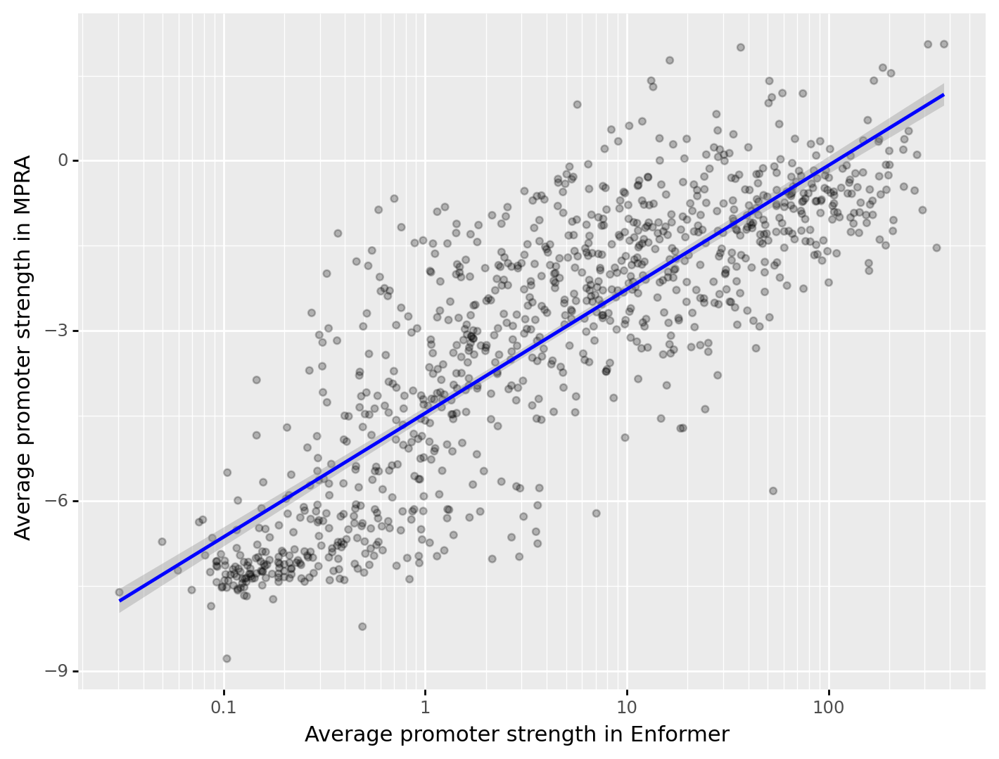

<ggplot: (1434870866198)>

In [54]:
scale = 1.3
p9.options.figure_size = (6.4*scale, 4.8*scale)
(p9.ggplot(data=prom_df,mapping=p9.aes(x=pred_col,y='log(RNA/DNA)'))
 + p9.geom_point(alpha=0.25)
 #+ p9.geom_bin2d(binwidth = (0.025, 0.1))
 + p9.scale_x_log10()
 + p9.geom_smooth(method="lm",color="blue")
 + p9.labs(x="Average promoter strength in Enformer", y="Average promoter strength in MPRA")
)

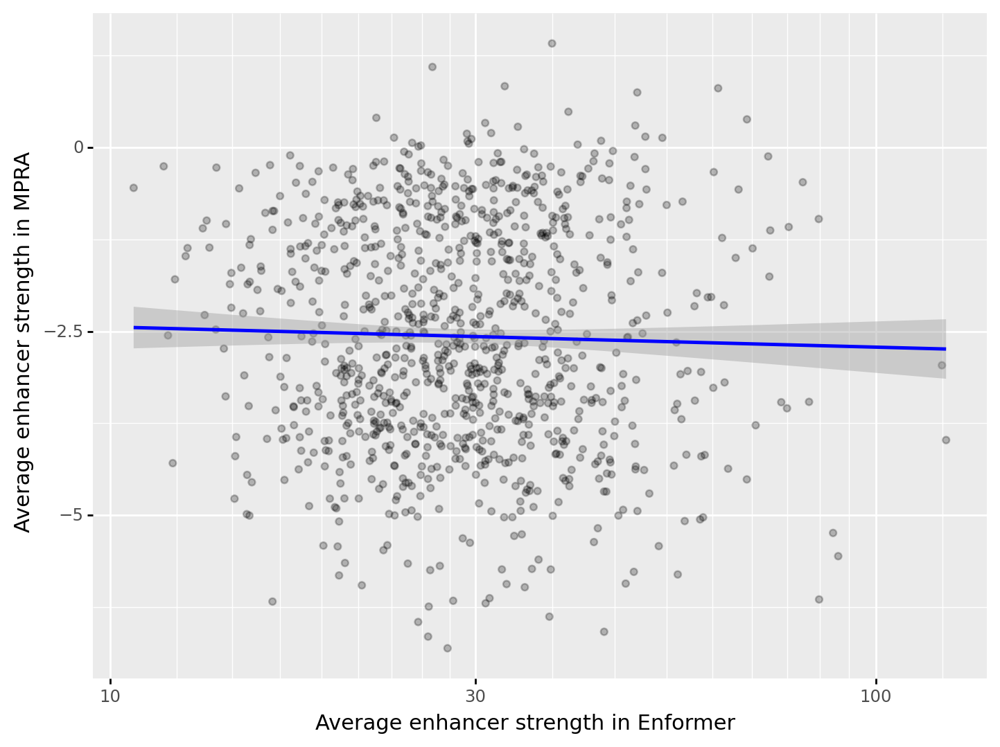

<ggplot: (1434904109041)>

In [55]:
scale = 1.3
p9.options.figure_size = (6.4*scale, 4.8*scale)
(p9.ggplot(data=enhance_df,mapping=p9.aes(x=pred_col,y='log(RNA/DNA)'))
 + p9.geom_point(alpha=0.25)
 #+ p9.geom_bin2d(binwidth = (0.025, 0.1))
 + p9.scale_x_log10()
 + p9.geom_smooth(method="lm",color="blue")
 + p9.labs(x="Average enhancer strength in Enformer", y="Average enhancer strength in MPRA")
)

In [45]:
# full insert
prom_df_full = merged_df_full.groupby("promoter")[["log(RNA/DNA)","RNA_sum",pred_col]].mean().reset_index()
enhance_df_full = merged_df_full.groupby("enhancer")[["log(RNA/DNA)","RNA_sum",pred_col]].mean().reset_index()

print(scipy.stats.pearsonr(np.log2(prom_df_full[pred_col]+1), prom_df_full['log(RNA/DNA)']))
print(scipy.stats.spearmanr(prom_df_full[pred_col], prom_df_full['log(RNA/DNA)']))

print(scipy.stats.pearsonr(np.log2(prom_df_full[pred_col]+1), np.log2(prom_df_full['RNA_sum'] + 1)))
print(scipy.stats.spearmanr(prom_df_full[pred_col], prom_df_full['RNA_sum']))

print(scipy.stats.pearsonr(np.log2(enhance_df_full[pred_col]+1), enhance_df_full['log(RNA/DNA)']))
print(scipy.stats.spearmanr(enhance_df_full[pred_col], enhance_df_full['log(RNA/DNA)']))

print(scipy.stats.pearsonr(np.log2(enhance_df_full[pred_col]+1), np.log2(enhance_df_full['RNA_sum'] + 1)))
print(scipy.stats.spearmanr(enhance_df_full[pred_col], enhance_df_full['RNA_sum']))

(0.597482066090515, 7.0748904386654824e-96)
SpearmanrResult(correlation=0.7470265069039863, pvalue=1.321629475065082e-175)
(0.5702466962196411, 1.3248904256014882e-85)
SpearmanrResult(correlation=0.7283305350117538, pvalue=9.759126606289509e-163)
(-0.17970594229964842, 1.0685646201016566e-08)
SpearmanrResult(correlation=-0.19187707547226582, pvalue=9.7192431388841e-10)
(-0.27882000738277446, 2.700307529594566e-19)
SpearmanrResult(correlation=-0.2964803721557228, pvalue=1.0164993525190744e-21)


In [41]:
# in-genome
prom_df_ingenome = merged_df_ingenome.groupby("promoter")[["log(RNA/DNA)","RNA_sum",pred_col]].mean().reset_index()
enhance_df_ingenome = merged_df_ingenome.groupby("enhancer")[["log(RNA/DNA)","RNA_sum",pred_col]].mean().reset_index()

print(scipy.stats.pearsonr(np.log2(prom_df_ingenome[pred_col]+1), prom_df_ingenome['log(RNA/DNA)']))
print(scipy.stats.spearmanr(prom_df_ingenome[pred_col], prom_df_ingenome['log(RNA/DNA)']))

print(scipy.stats.pearsonr(np.log2(prom_df_ingenome[pred_col]+1), np.log2(prom_df_ingenome['RNA_sum'] + 1)))
print(scipy.stats.spearmanr(prom_df_ingenome[pred_col], prom_df_ingenome['RNA_sum']))

print(scipy.stats.pearsonr(np.log2(enhance_df_ingenome[pred_col]+1), enhance_df_ingenome['log(RNA/DNA)']))
print(scipy.stats.spearmanr(enhance_df_ingenome[pred_col], enhance_df_ingenome['log(RNA/DNA)']))

print(scipy.stats.pearsonr(np.log2(enhance_df_ingenome[pred_col]+1), np.log2(enhance_df_ingenome['RNA_sum'] + 1)))
print(scipy.stats.spearmanr(enhance_df_ingenome[pred_col], enhance_df_ingenome['RNA_sum']))

(0.8148345081181145, 8.008278474144695e-234)
SpearmanrResult(correlation=0.8086504352750836, pvalue=1.4411833294981865e-227)
(0.7963184139739707, 9.466218348250389e-216)
SpearmanrResult(correlation=0.7956688011952239, pvalue=3.7666975509835285e-215)
(-0.004321496714512964, 0.8914900462732723)
SpearmanrResult(correlation=0.0001257409714323542, pvalue=0.9968329536972447)
(-0.09144585949876112, 0.0038186076660588516)
SpearmanrResult(correlation=-0.0759780943267917, pvalue=0.016310048490728188)


#### Variation within

In [71]:
merged_df_min[["RNA_sum",pred_col]].std()

RNA_sum                                                                         12646.737113
CAGE:chronic myelogenous leukemia cell line:K562  ENCODE, biol__landmark_sum       55.469287
dtype: float64

In [172]:
prom_df_std = (merged_df_min.groupby("promoter")[["RNA_sum",pred_col]]
               .std()
               .reset_index()
               .rename(columns={pred_col:"Predicted Expression", "RNA_sum":"Measured Expression"})
               .melt(id_vars="promoter")
               .rename(columns={"promoter":"element"})
              )
prom_df_std["element_type"] = "Promoter"

enhance_df_std = (merged_df_min.groupby("enhancer")[["RNA_sum",pred_col]]
                   .std()
                   .reset_index()
                   .rename(columns={pred_col:"Predicted Expression", "RNA_sum":"Measured Expression"})
                   .melt(id_vars="enhancer")
                  .rename(columns={"enhancer":"element"})
                  )
enhance_df_std["element_type"] = "Enhancer"

std_df = pd.concat([prom_df_std, enhance_df_std])

In [178]:
prom_df_std.query('variable == "Predicted Expression"').dropna().sort_values('value')

,element,variable,value,element_type
1102,chr12:54813030-54813294-promoter,Predicted Expression,0.000117,Promoter
1136,chr14:20750231-20750495-promoter,Predicted Expression,0.006480,Promoter
1517,chr2:206898296-206898560-promoter,Predicted Expression,0.008044,Promoter
1387,chr1:13346624-13346888-promoter,Predicted Expression,0.009382,Promoter
1059,chr11:73864495-73864759-promoter,Predicted Expression,0.010758,Promoter
...,...,...,...,...
1458,chr1:93297384-93297648-promoter,Predicted Expression,56.356707,Promoter
1342,chr19:39926534-39926798-promoter,Predicted Expression,59.286108,Promoter
1030,chr11:32605158-32605422-promoter,Predicted Expression,59.509482,Promoter
1780,chr8:146017755-146018019-promoter,Predicted Expression,60.679768,Promoter


/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/layer.py:324: PlotnineWarning: stat_boxplot : Removed 34 rows containing non-finite values.


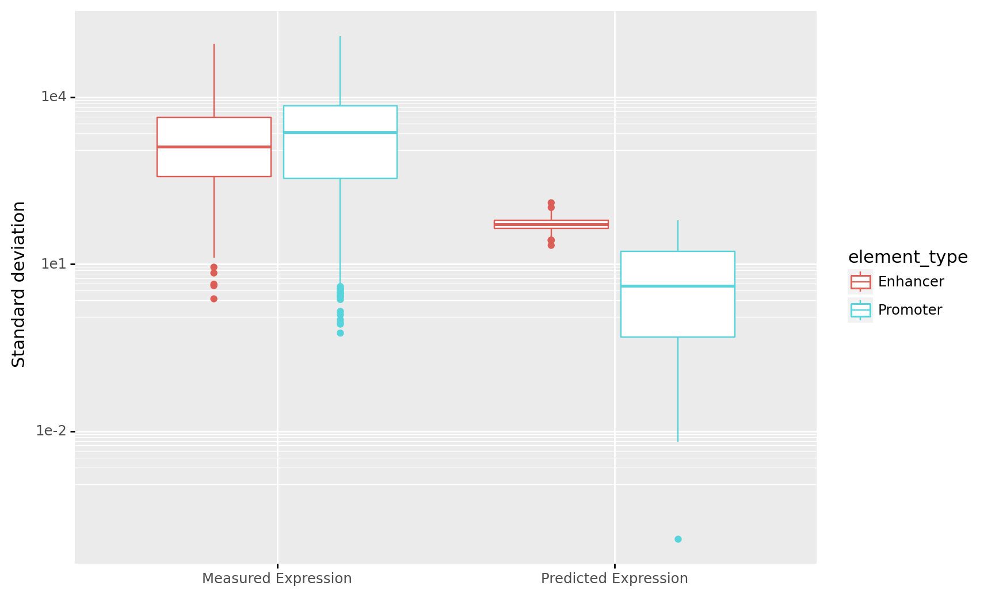

<ggplot: (1458063707971)>

In [70]:
(p9.ggplot(data=std_df,mapping=p9.aes(x="variable",y="value", color="element_type"))
 + p9.geom_boxplot()
 + p9.scale_y_log10()
 + p9.labs(x="", y="Standard deviation")
)

### Modelling average enhancer/promoter effects

We model the expression using promoter/enhancer fixed effects.

For the measured expression we use the model:

$RNA \sim Poisson(\lambda = \exp(\beta\log(DNA) + P + E))$

For the enformer prediction, we model with:

$\log(\hat{RNA} + 1) \sim Normal(\mu = P + E, \sigma^2)$

$\log(\hat{RNA} + 1) = P + E + \epsilon$

or

$RNA \sim Gamma(\exp(P + E))$

(Why Gamma? Because Enformer learns a Poisson rate parameter)

In [315]:
bg_prom = merged_df_min.groupby(['promoter','randomBG_promoter', 'promoter_exp_class'])['log(RNA/DNA)'].agg(["mean","size"]).reset_index().sort_values('mean').query('randomBG_promoter')
bg_prom.iloc[len(bg_prom)//2]

promoter              chr14:78352885-78353149-promoter
randomBG_promoter                                 True
promoter_exp_class                                   0
mean                                         -7.209376
size                                               100
Name: 172, dtype: object

In [316]:
bg_enh = merged_df_min.groupby(['enhancer','randomBG_enhancer', 'enhancer_exp_class'])['log(RNA/DNA)'].agg(["mean","size"]).reset_index().sort_values('mean').query('randomBG_enhancer')
bg_enh.iloc[len(bg_enh)//2]

enhancer              chr22:17329655-17329919-enhancer
randomBG_enhancer                                 True
enhancer_exp_class                                   0
mean                                         -3.512618
size                                               602
Name: 478, dtype: object

In [317]:
# baseline values
base_prom = "chr14:78352885-78353149-promoter"
base_enh = "chr22:17329655-17329919-enhancer"

#### Bergmann - promoter only model

In [146]:
poisson_bergmann_prom = (statsmodels.discrete.discrete_model.Poisson
                  .from_formula('RNA_sum ~ log_DNA_input + C(promoter, Treatment("{}"))'.format(base_prom),
                                data=merged_df_min))

#res_bergmann = poisson_bergmann.fit(disp=True,maxiter=100)
res_bergmann_prom = poisson_bergmann_prom.fit(method="minimize",min_method='dogleg',maxiter=100)

Optimization terminated successfully.
         Current function value: 1549.930238
         Iterations: 13
         Function evaluations: 14
         Gradient evaluations: 14
         Hessian evaluations: 13


In [147]:
res_bergmann_prom.params.to_csv(base_path_results + "bergmann_promoter_poisson_params_baselined.tsv",sep="\t")

In [148]:
bergmann_prom_params = pd.read_csv(base_path_results + "bergmann_promoter_poisson_params_baselined.tsv",sep="\t").set_index("Unnamed: 0").squeeze()

poisson_bergmann_prom = (statsmodels.discrete.discrete_model.Poisson
                  .from_formula('RNA_sum ~ log_DNA_input + C(promoter, Treatment("{}"))'.format(base_prom),
                                data=merged_df_min))

preds = poisson_bergmann_prom.predict(params=bergmann_prom_params)
pred_df = merged_df_min[["promoter","enhancer","RNA_sum"]]
pred_df["pred"] = preds

pred_df.to_csv(base_path_results + "bergmann_promoter_poisson_preds_baselined.tsv",sep="\t",index=None)

print(scipy.stats.pearsonr(pred_df["RNA_sum"], pred_df["pred"]))
print(sklearn.metrics.r2_score(pred_df["RNA_sum"], pred_df["pred"]))
print(scipy.stats.pearsonr(np.log2(pred_df["RNA_sum"]+1), np.log2(pred_df["pred"]+1)))
print(sklearn.metrics.r2_score(np.log2(pred_df["RNA_sum"]+1), np.log2(pred_df["pred"]+1)))

/scratch/tmp/karollus/ipykernel_2918635/2605562934.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


(0.707558696666554, 0.0)
0.500605289383346
(0.8017415851759373, 0.0)
0.535883291192217


In [65]:
pred_df2 = pd.read_csv(base_path_results + "bergmann_promoter_poisson_preds_baselined.tsv",sep="\t")

print(scipy.stats.spearmanr(pred_df2["RNA_sum"], pred_df2["pred"]))
print(scipy.stats.pearsonr(pred_df2["RNA_sum"], pred_df2["pred"]))

SpearmanrResult(correlation=0.7879277626232023, pvalue=0.0)
(0.707558696666554, 0.0)


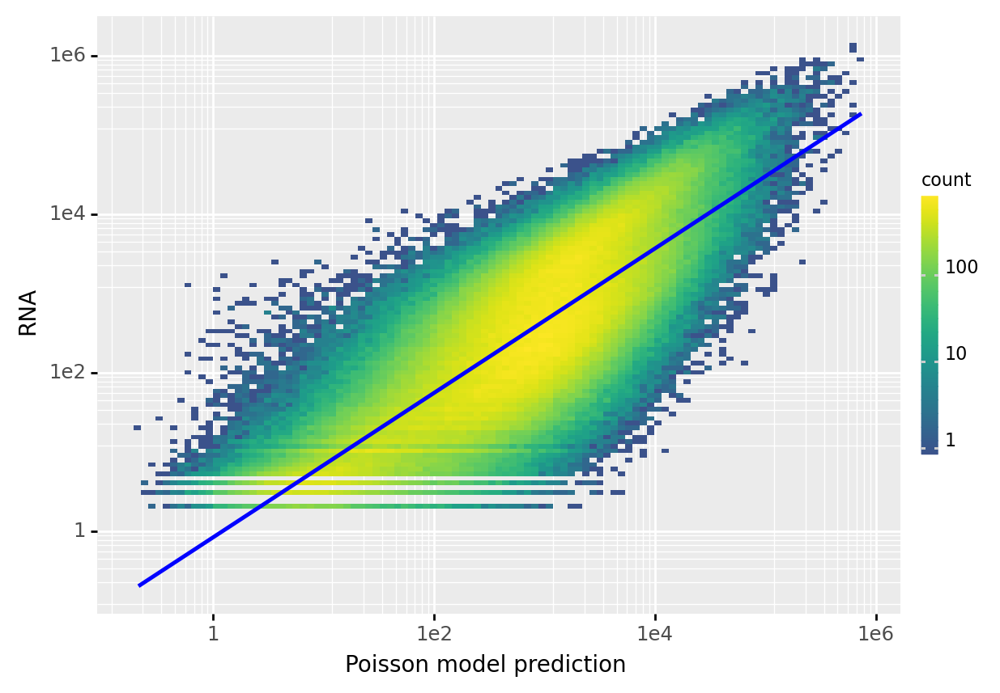

<ggplot: (1398520805407)>

In [74]:
p = (p9.ggplot(data=pred_df2,mapping=p9.aes(x="pred",y="RNA_sum"))
 #+ p9.geom_col(position="dodge")
 + p9.scale_x_log10()
 + p9.scale_y_log10()
 + p9.geom_bin2d(bins=100, raster=True)
 + p9.scale_fill_continuous(ListedColormap(cm.get_cmap('viridis', 512)(np.linspace(0.25, 1, 512))), trans="log10")
 + p9.geom_smooth(method="lm",color="blue")
 + p9.theme(legend_text=p9.element_text(size=8),legend_title=p9.element_text(size=8),
            legend_box_margin=0,legend_key_width=5,axis_title=p9.element_text(size=10))#
 + p9.labs(x="Poisson model prediction",y="RNA")
 #+ p9.scale_y_log10()
 #+ p9.labs(x="",y="Density")
)
p

#### Bergmann - multiplicative model

In [162]:
old_param = pd.read_csv(base_path_results + "bergmann_multiplicative_poisson_params.tsv",sep="\t").rename(columns={"Unnamed: 0":"Name", "0": "old"})
new_param = res_bergmann_mult.params.reset_index().rename(columns={"index":"Name", 0: "new"})
new_param["Name"] = new_param["Name"].str.replace('C(promoter, Treatment("{}"))'.format(base_prom),"promoter",regex=False).str.replace('C(enhancer, Treatment("{}"))'.format(base_enh),"enhancer",regex=False)
compare = old_param.merge(new_param,on="Name")
compare["class"] = compare["Name"].apply(lambda x: "prom" if x.startswith("prom") else "enh" if x.startswith("enh") else "other")

In [150]:
poisson_bergmann_mult = (statsmodels.discrete.discrete_model.Poisson
                  .from_formula('RNA_sum ~ log_DNA_input + C(promoter, Treatment("{}")) + C(enhancer, Treatment("{}"))'.format(base_prom,base_enh),
                                data=merged_df_min))

#res_bergmann = poisson_bergmann.fit(disp=True,maxiter=100)
res_bergmann_mult = poisson_bergmann_mult.fit(method="minimize",min_method='dogleg',maxiter=100)

Optimization terminated successfully.
         Current function value: 221.536430
         Iterations: 14
         Function evaluations: 15
         Gradient evaluations: 15
         Hessian evaluations: 14


In [151]:
res_bergmann_mult.params.to_csv(base_path_results + "bergmann_multiplicative_poisson_params_baselined.tsv",sep="\t")

In [152]:
bergmann_mult_params = pd.read_csv(base_path_results + "bergmann_multiplicative_poisson_params_baselined.tsv",sep="\t").set_index("Unnamed: 0").squeeze()

poisson_bergmann_mult = (statsmodels.discrete.discrete_model.Poisson
                  .from_formula('RNA_sum ~ log_DNA_input + C(promoter, Treatment("{}")) + C(enhancer, Treatment("{}"))'.format(base_prom,base_enh),
                                data=merged_df_min))

preds = poisson_bergmann_mult.predict(params=bergmann_mult_params)
pred_df = merged_df_min[["promoter","enhancer","RNA_sum"]]
pred_df["pred"] = preds

pred_df.to_csv(base_path_results + "bergmann_multiplicative_poisson_preds_baselined.tsv",sep="\t",index=None)

print(scipy.stats.pearsonr(pred_df["RNA_sum"], pred_df["pred"]))
print(sklearn.metrics.r2_score(pred_df["RNA_sum"], pred_df["pred"]))
print(scipy.stats.pearsonr(np.log2(pred_df["RNA_sum"]+1), np.log2(pred_df["pred"]+1)))
print(sklearn.metrics.r2_score(np.log2(pred_df["RNA_sum"]+1), np.log2(pred_df["pred"]+1)))

/scratch/tmp/karollus/ipykernel_2918635/2385832867.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


(0.9576481852489792, 0.0)
0.9149942690879428
(0.952042994767604, 0.0)
0.9008189139680797


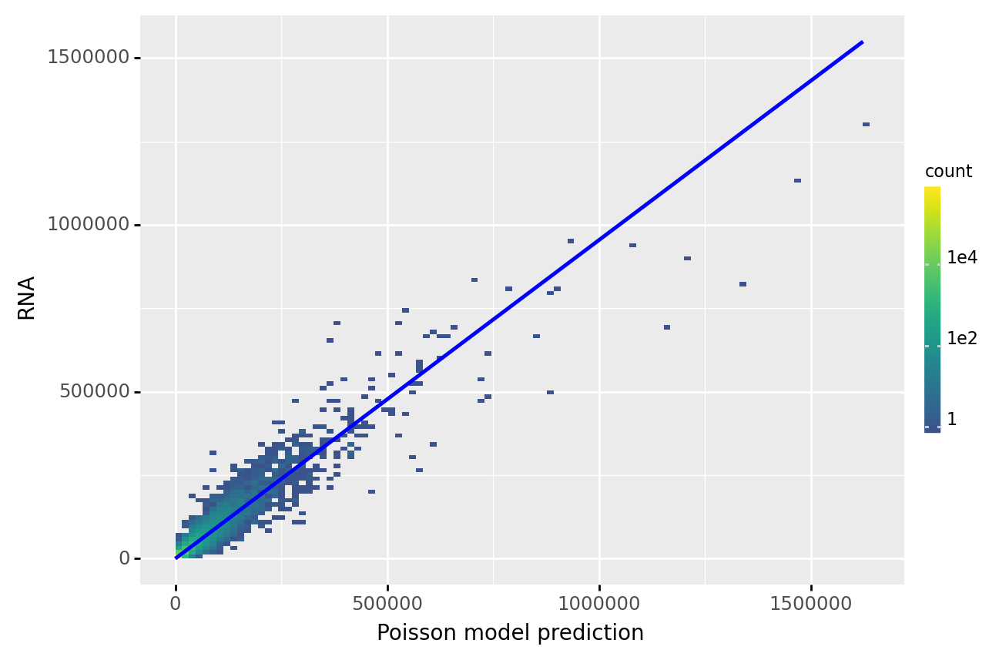

<ggplot: (1398517867328)>

In [72]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

pred_df3 = pd.read_csv(base_path_results + "bergmann_multiplicative_poisson_preds_baselined.tsv",sep="\t")

p = (p9.ggplot(data=pred_df3,mapping=p9.aes(x="pred",y="RNA_sum"))
 #+ p9.geom_col(position="dodge")
 #+ p9.scale_x_log10()
 #+ p9.scale_y_log10()
 + p9.geom_bin2d(bins=100, raster=True)
 + p9.scale_fill_continuous(ListedColormap(cm.get_cmap('viridis', 512)(np.linspace(0.25, 1, 512))), trans="log10")
 + p9.geom_smooth(method="lm",color="blue")
 + p9.theme(legend_text=p9.element_text(size=8),legend_title=p9.element_text(size=8),
            legend_box_margin=0,legend_key_width=5,axis_title=p9.element_text(size=10))#
 + p9.labs(x="Poisson model prediction",y="RNA")
 #+ p9.scale_y_log10()
 #+ p9.labs(x="",y="Density")
)
p

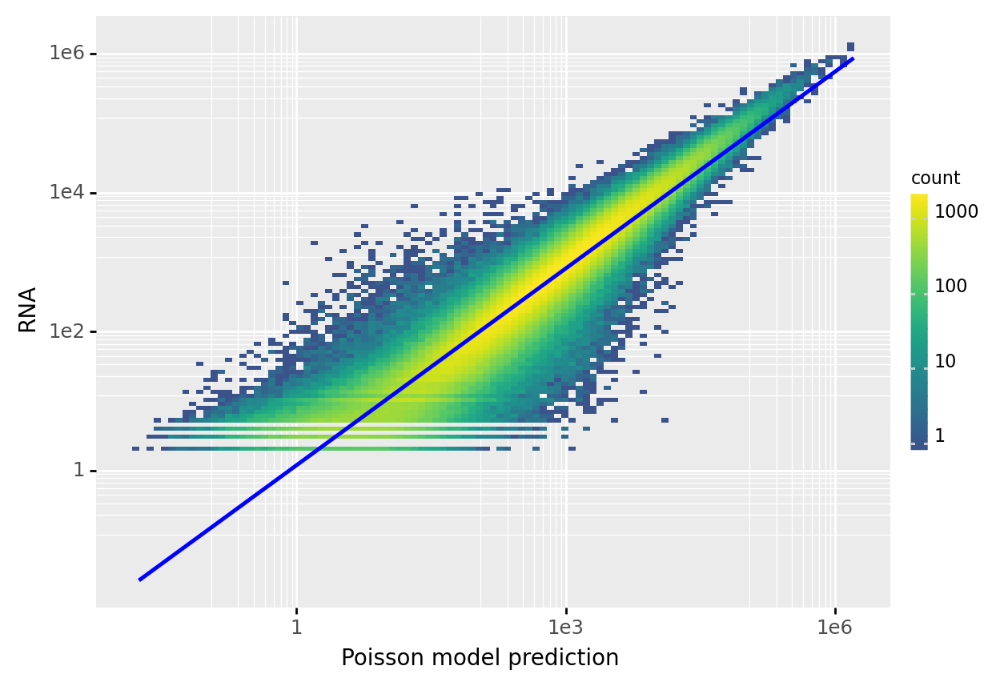

<ggplot: (1398520369279)>

In [73]:
p = (p9.ggplot(data=pred_df3,mapping=p9.aes(x="pred",y="RNA_sum"))
 #+ p9.geom_col(position="dodge")
 + p9.scale_x_log10()
 + p9.scale_y_log10()
 + p9.geom_bin2d(bins=100, raster=True)
 + p9.scale_fill_continuous(ListedColormap(cm.get_cmap('viridis', 512)(np.linspace(0.25, 1, 512))), trans="log10")
 + p9.geom_smooth(method="lm",color="blue")
 + p9.theme(legend_text=p9.element_text(size=8),legend_title=p9.element_text(size=8),
            legend_box_margin=0,legend_key_width=5,axis_title=p9.element_text(size=10))#
 + p9.labs(x="Poisson model prediction",y="RNA")
 #+ p9.scale_y_log10()
 #+ p9.labs(x="",y="Density")
)
p

In [153]:
90.1 - 53.5

36.599999999999994

#### Bergmann multiplicative log-linear model

In [55]:
ols_bergmann_mult = (statsmodels.regression.linear_model.OLS
                  .from_formula('log_RNA_sum ~ log_DNA_input + C(promoter, Treatment("{}")) + C(enhancer, Treatment("{}"))'.format(base_prom,base_enh),
                                data=merged_df_min))

#res_bergmann = poisson_bergmann.fit(disp=True,maxiter=100)
res_bergmann_mult = ols_bergmann_mult.fit()

In [56]:
res_bergmann_mult.params.to_csv(base_path_results + "bergmann_multiplicative_ols_params_baselined.tsv",sep="\t")

In [59]:
bergmann_mult_params = pd.read_csv(base_path_results + "bergmann_multiplicative_ols_params_baselined.tsv",sep="\t").set_index("Unnamed: 0").squeeze()

ols_bergmann_mult = (statsmodels.regression.linear_model.OLS
                  .from_formula('log_RNA_sum ~ log_DNA_input + C(promoter, Treatment("{}")) + C(enhancer, Treatment("{}"))'.format(base_prom,base_enh),
                                data=merged_df_min))

preds = ols_bergmann_mult.predict(params=bergmann_mult_params)
pred_df = merged_df_min[["promoter","enhancer","RNA_sum"]]
pred_df["pred"] = preds

pred_df.to_csv(base_path_results + "bergmann_multiplicative_ols_preds_baselined.tsv",sep="\t",index=None)

print(scipy.stats.pearsonr(np.log2(pred_df["RNA_sum"]+1), pred_df["pred"]))
print(sklearn.metrics.r2_score(np.log2(pred_df["RNA_sum"]+1), pred_df["pred"]))

/scratch/tmp/karollus/ipykernel_3231509/1283481511.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


(0.9511789728961898, 0.0)
0.90474143847977


#### Bergmann - enhancer residual model

In [79]:
residual_df = pd.read_csv(base_path_results + "bergmann_promoter_poisson_preds_baselined.tsv",sep="\t")
residual_df["residual"] = np.log2(residual_df["RNA_sum"]+1) - np.log2(residual_df["pred"]+1)

In [80]:
ols_bergmann_residual = (statsmodels.regression.linear_model.OLS
                  .from_formula('residual ~ C(enhancer, Treatment("{}"))'.format(base_enh),
                                data=residual_df))

res_bergmann_residual = ols_bergmann_residual.fit()

In [82]:
res_bergmann_residual.params.to_csv(base_path_results + "bergmann_residual_ols_params_baselined.tsv",sep="\t")

In [84]:
res_bergmann_residual = pd.read_csv(base_path_results + "bergmann_residual_ols_params_baselined.tsv",sep="\t").set_index("Unnamed: 0").squeeze()

ols_bergmann_residual = (statsmodels.regression.linear_model.OLS
                  .from_formula('residual ~ C(enhancer, Treatment("{}"))'.format(base_enh),
                                data=residual_df))

preds = ols_bergmann_residual.predict(params=res_bergmann_residual)
residual_df["residual_pred"] = preds

residual_df.to_csv(base_path_results + "bergmann_residual_ols_preds_baselined.tsv",sep="\t",index=None)

print(scipy.stats.pearsonr(residual_df["residual"], residual_df["residual_pred"]))
print(sklearn.metrics.r2_score(residual_df["residual"], residual_df["residual_pred"]))

(0.8043885213384641, 0.0)
0.6470408932610128


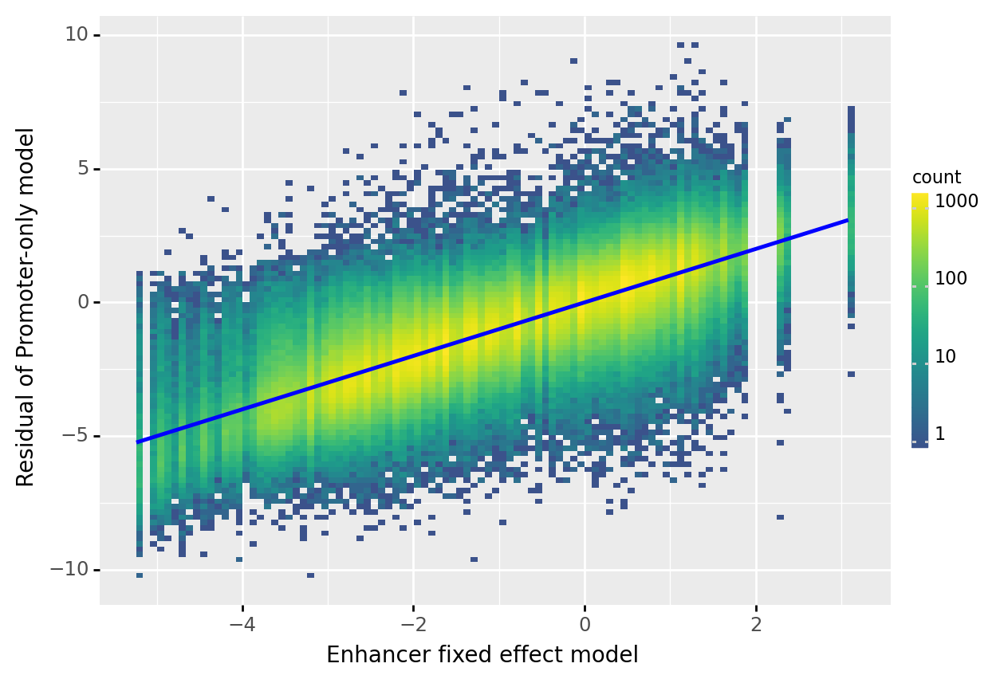

<ggplot: (1398519522295)>

In [87]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=residual_df,mapping=p9.aes(x="residual_pred",y="residual"))
 #+ p9.geom_col(position="dodge")
 #+ p9.scale_x_log10()
 #+ p9.scale_y_log10()
 + p9.geom_bin2d(bins=100, raster=True)
 + p9.scale_fill_continuous(ListedColormap(cm.get_cmap('viridis', 512)(np.linspace(0.25, 1, 512))), trans="log10")
 + p9.geom_smooth(method="lm",color="blue")
 + p9.theme(legend_text=p9.element_text(size=8),legend_title=p9.element_text(size=8),
            legend_box_margin=0,legend_key_width=5,axis_title=p9.element_text(size=10))#
 + p9.labs(x="Enhancer fixed effect model",y="Residual of Promoter-only model")
 #+ p9.scale_y_log10()
 #+ p9.labs(x="",y="Density")
)
p

#### Enformer - promoter only log-linear model

In [166]:
ols_enformer_prom = (statsmodels.regression.linear_model.OLS
                  .from_formula('{} ~ C(promoter, Treatment("{}"))'.format(log_pred_col,base_prom),
                                data=merged_df_min))

res_enformer_prom = ols_enformer_prom.fit()

In [168]:
res_enformer_prom.params.to_csv(base_path_results + "enformer_promoter_ols_params_baselined.tsv",sep="\t")

In [169]:
enformer_prom_params = pd.read_csv(base_path_results + "enformer_promoter_ols_params_baselined.tsv",sep="\t").set_index("Unnamed: 0").squeeze()

ols_enformer_prom = (statsmodels.regression.linear_model.OLS
                  .from_formula('{} ~ C(promoter, Treatment("{}"))'.format(log_pred_col,base_prom),
                                data=merged_df_min))

preds = ols_enformer_prom.predict(params=enformer_prom_params)
pred_df = merged_df_min[["promoter","enhancer",log_pred_col]]
pred_df["pred"] = preds

pred_df.to_csv(base_path_results + "enformer_promoter_ols_preds_baselined.tsv",sep="\t",index=None)

print(scipy.stats.pearsonr(pred_df[log_pred_col], pred_df["pred"]))
print(sklearn.metrics.r2_score(pred_df[log_pred_col], pred_df["pred"]))

/scratch/tmp/karollus/ipykernel_2918635/205292527.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


(0.9570877291921656, 0.0)
0.9160098153887718


In [77]:
0.957**2

0.9158489999999999

#### Enformer - multiplicative log-linear model

In [210]:
ols_enformer_mult = (statsmodels.regression.linear_model.OLS
                  .from_formula('{} ~ C(promoter, Treatment("{}")) + C(enhancer, Treatment("{}"))'.format(log_pred_col,base_prom,base_enh),
                                data=merged_df_min))

res_enformer_mult = ols_enformer_mult.fit()

In [182]:
res_enformer_mult.params.to_csv(base_path_results + "enformer_multiplicative_ols_params_baselined.tsv",sep="\t")

In [183]:
enformer_mult_params = pd.read_csv(base_path_results + "enformer_multiplicative_ols_params_baselined.tsv",sep="\t").set_index("Unnamed: 0").squeeze()

ols_enformer_mult = (statsmodels.regression.linear_model.OLS
                  .from_formula('{} ~ C(promoter, Treatment("{}")) + C(enhancer, Treatment("{}"))'.format(log_pred_col,base_prom,base_enh),
                                data=merged_df_min))

preds = ols_enformer_mult.predict(params=enformer_mult_params)
pred_df = merged_df_min[["promoter","enhancer",log_pred_col]]
pred_df["pred"] = preds

pred_df.to_csv(base_path_results + "enformer_multiplicative_ols_preds_baselined.tsv",sep="\t",index=None)

print(scipy.stats.pearsonr(pred_df[log_pred_col], pred_df["pred"]))
print(sklearn.metrics.r2_score(pred_df[log_pred_col], pred_df["pred"]))

/scratch/tmp/karollus/ipykernel_2918635/3840271429.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


(0.98262024628887, 0.0)
0.9655425484168525


In [113]:
ols_enformer_mult = (statsmodels.regression.linear_model.OLS
                  .from_formula('{} ~ C(promoter, Treatment("{}")) + C(enhancer, Treatment("{}"))'.format(log_pred_col,base_prom,base_enh),
                                data=merged_df_ingenome))

res_enformer_mult = ols_enformer_mult.fit()

res_enformer_mult.params.to_csv(base_path_results + "enformer_multiplicative_ols_params_baselined_aavs1.tsv",sep="\t")

enformer_mult_params = pd.read_csv(base_path_results + "enformer_multiplicative_ols_params_baselined_aavs1.tsv",sep="\t").set_index("Unnamed: 0").squeeze()

ols_enformer_mult = (statsmodels.regression.linear_model.OLS
                  .from_formula('{} ~ C(promoter, Treatment("{}")) + C(enhancer, Treatment("{}"))'.format(log_pred_col,base_prom,base_enh),
                                data=merged_df_ingenome))

preds = ols_enformer_mult.predict(params=enformer_mult_params)
pred_df = merged_df_ingenome[["promoter","enhancer",log_pred_col]]
pred_df["pred"] = preds

pred_df.to_csv(base_path_results + "enformer_multiplicative_ols_preds_baselined_aavs1.tsv",sep="\t",index=None)

print(scipy.stats.pearsonr(pred_df[log_pred_col], pred_df["pred"]))
print(sklearn.metrics.r2_score(pred_df[log_pred_col], pred_df["pred"]))

/scratch/tmp/karollus/ipykernel_3231509/1322745605.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


(0.9780249498882058, 0.0)
0.956532802603835


#### Enformer - Gamma promoter-only model

In [91]:
gamma_enformer_prom = smf.glm(formula='{} ~ C(promoter, Treatment("{}"))'.format(pred_col.replace(":","_").replace(" ","_").replace(",","_"), base_prom), 
                       data=merged_df_min.rename(columns={pred_col:pred_col.replace(":","_").replace(" ","_").replace(",","_")}), 
                       family=sm.families.Gamma(link=sm.families.links.Log()))


res_enformer_prom = gamma_enformer_prom.fit(method="minimize",min_method='dogleg',maxiter=100, max_start_irls=0)
# IRLS seems to take insane amounts of memory here

In [92]:
res_enformer_prom.params.to_csv(base_path_results + "enformer_promoter_gamma_params_baselined.tsv",sep="\t")

In [94]:
enformer_prom_params = pd.read_csv(base_path_results + "enformer_promoter_gamma_params_baselined.tsv",sep="\t").set_index("Unnamed: 0").squeeze()


gamma_enformer_prom = smf.glm(formula='{} ~ C(promoter, Treatment("{}"))'.format(pred_col.replace(":","_").replace(" ","_").replace(",","_"), base_prom), 
                       data=merged_df_min.rename(columns={pred_col:pred_col.replace(":","_").replace(" ","_").replace(",","_")}), 
                       family=sm.families.Gamma(link=sm.families.links.Log()))

In [95]:
preds = gamma_enformer_prom.predict(params=enformer_prom_params)
pred_df = merged_df_min[["promoter","enhancer",pred_col,log_pred_col]]
pred_df["pred"] = preds

pred_df.to_csv(base_path_results + "enformer_promoter_gamma_preds_baselined.tsv",sep="\t",index=None)

print(scipy.stats.pearsonr(pred_df[pred_col], pred_df["pred"]))
print(sklearn.metrics.r2_score(pred_df[pred_col], pred_df["pred"]))
print(scipy.stats.pearsonr(np.log2(pred_df[pred_col]+1), np.log2(pred_df["pred"]+1)))
print(sklearn.metrics.r2_score(np.log2(pred_df[pred_col]+1), np.log2(pred_df["pred"]+1)))

/scratch/tmp/karollus/ipykernel_3231509/3656321605.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


(0.9339220356973463, 0.0)
0.8722103687605445
(0.9541974683892154, 0.0)
0.9039513357805249


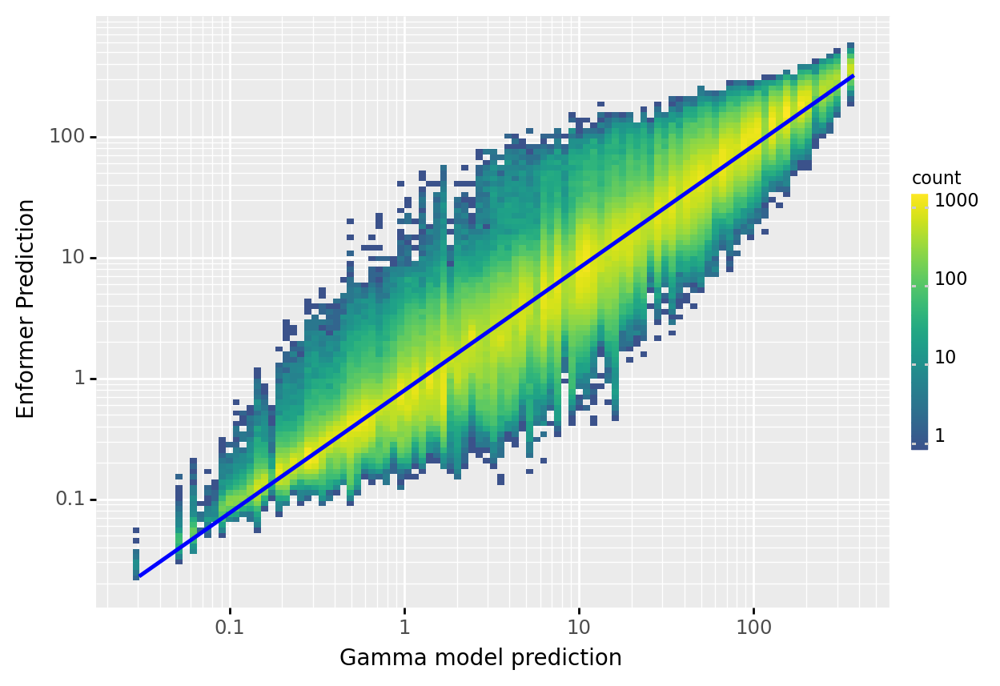

<ggplot: (1398517939240)>

In [96]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=pred_df,mapping=p9.aes(x="pred",y=pred_col,))
 #+ p9.geom_col(position="dodge")
 + p9.scale_x_log10()
 + p9.scale_y_log10()
 + p9.geom_bin2d(bins=100, raster=True)
 + p9.scale_fill_continuous(ListedColormap(cm.get_cmap('viridis', 512)(np.linspace(0.25, 1, 512))), trans="log10")
 + p9.geom_smooth(method="lm",color="blue")
 + p9.theme(legend_text=p9.element_text(size=8),legend_title=p9.element_text(size=8),
            legend_box_margin=0,legend_key_width=5,axis_title=p9.element_text(size=10))#
 + p9.labs(x="Gamma model prediction",y="Enformer Prediction")
 #+ p9.scale_y_log10()
 #+ p9.labs(x="",y="Density")
)
p

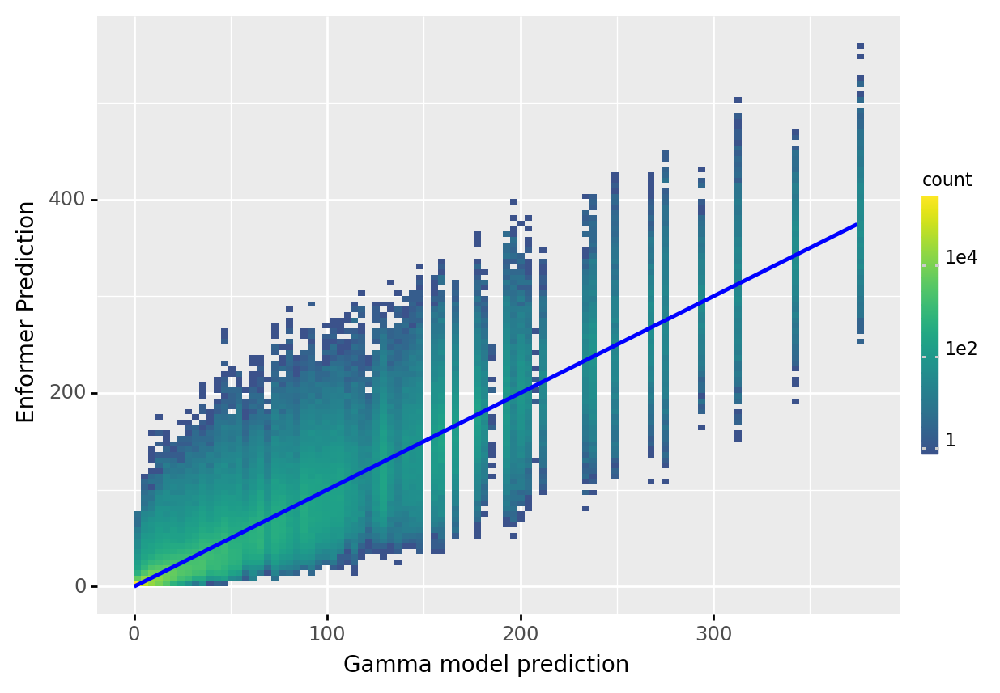

<ggplot: (1398520837873)>

In [97]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=pred_df,mapping=p9.aes(x="pred",y=pred_col))
 #+ p9.geom_col(position="dodge")
 #+ p9.scale_x_log10()
 #+ p9.scale_y_log10()
 + p9.geom_bin2d(bins=100, raster=True)
 + p9.scale_fill_continuous(ListedColormap(cm.get_cmap('viridis', 512)(np.linspace(0.25, 1, 512))), trans="log10")
 + p9.geom_smooth(method="lm",color="blue")
 + p9.theme(legend_text=p9.element_text(size=8),legend_title=p9.element_text(size=8),
            legend_box_margin=0,legend_key_width=5,axis_title=p9.element_text(size=10))#
 + p9.labs(x="Gamma model prediction",y="Enformer Prediction")
 #+ p9.scale_y_log10()
 #+ p9.labs(x="",y="Density")
)
p

#### Enformer - Gamma multiplicative model

In [27]:
gamma_enformer_mult = smf.glm(formula='{} ~ C(promoter, Treatment("{}")) + C(enhancer, Treatment("{}"))'.format(pred_col.replace(":","_").replace(" ","_").replace(",","_"), base_prom, base_enh), 
                       data=merged_df_min.rename(columns={pred_col:pred_col.replace(":","_").replace(" ","_").replace(",","_")}), 
                       family=sm.families.Gamma(link=sm.families.links.Log()))


res_enformer_mult = gamma_enformer_mult.fit(method="minimize",min_method='dogleg',maxiter=100, max_start_irls=0)
# IRLS seems to take insane amounts of memory here

In [28]:
res_enformer_mult.params.to_csv(base_path_results + "enformer_multiplicative_gamma_params_baselined.tsv",sep="\t")

In [29]:
enformer_mult_params = pd.read_csv(base_path_results + "enformer_multiplicative_gamma_params_baselined.tsv",sep="\t").set_index("Unnamed: 0").squeeze()


gamma_enformer_mult = smf.glm(formula='{} ~ C(promoter, Treatment("{}")) + C(enhancer, Treatment("{}"))'.format(pred_col.replace(":","_").replace(" ","_").replace(",","_"), base_prom, base_enh), 
                       data=merged_df_min.rename(columns={pred_col:pred_col.replace(":","_").replace(" ","_").replace(",","_")}), 
                       family=sm.families.Gamma(link=sm.families.links.Log()))

In [30]:
preds = gamma_enformer_mult.predict(params=enformer_mult_params)
pred_df = merged_df_min[["promoter","enhancer",pred_col,log_pred_col]]
pred_df["pred"] = preds

pred_df.to_csv(base_path_results + "enformer_multiplicative_gamma_preds_baselined.tsv",sep="\t",index=None)

print(scipy.stats.pearsonr(pred_df[pred_col], pred_df["pred"]))
print(sklearn.metrics.r2_score(pred_df[pred_col], pred_df["pred"]))
print(scipy.stats.pearsonr(np.log2(pred_df[pred_col]+1), np.log2(pred_df["pred"]+1)))
print(sklearn.metrics.r2_score(np.log2(pred_df[pred_col]+1), np.log2(pred_df["pred"]+1)))

/scratch/tmp/karollus/ipykernel_933531/3222107447.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


(0.8499958564799428, 0.0)
0.37636281058841403
(0.9841102503110595, 0.0)
0.96778662192904


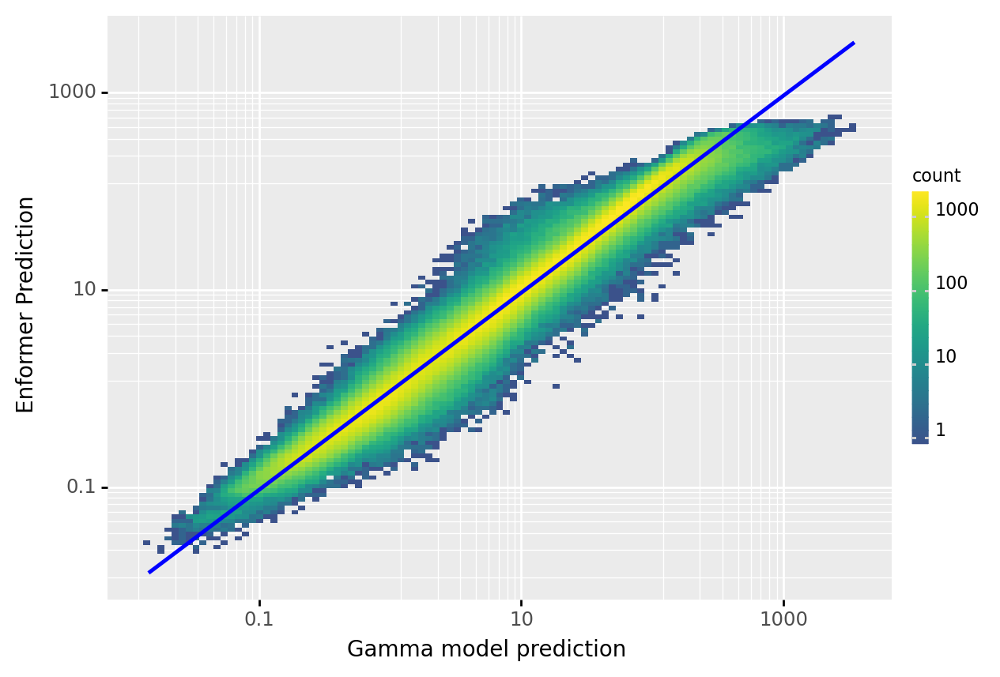

<ggplot: (1428534982897)>

In [31]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=pred_df,mapping=p9.aes(x="pred",y=pred_col,))
 #+ p9.geom_col(position="dodge")
 + p9.scale_x_log10()
 + p9.scale_y_log10()
 + p9.geom_bin2d(bins=100, raster=True)
 + p9.scale_fill_continuous(ListedColormap(cm.get_cmap('viridis', 512)(np.linspace(0.25, 1, 512))), trans="log10")
 + p9.geom_smooth(method="lm",color="blue")
 + p9.theme(legend_text=p9.element_text(size=8),legend_title=p9.element_text(size=8),
            legend_box_margin=0,legend_key_width=5,axis_title=p9.element_text(size=10))#
 + p9.labs(x="Gamma model prediction",y="Enformer Prediction")
 #+ p9.scale_y_log10()
 #+ p9.labs(x="",y="Density")
)
p

#### Enformer - enhancer residual model

In [121]:
residual_df = pd.read_csv(base_path_results + "enformer_promoter_ols_preds_baselined.tsv",sep="\t")
residual_df["residual"] = residual_df[log_pred_col] - residual_df["pred"]

In [122]:
ols_enformer_residual = (statsmodels.regression.linear_model.OLS
                  .from_formula('residual ~ C(enhancer, Treatment("{}"))'.format(base_enh),
                                data=residual_df))

res_enformer_residual = ols_enformer_residual.fit()

In [124]:
res_enformer_residual.params.to_csv(base_path_results + "enformer_residual_ols_params_baselined.tsv",sep="\t")

In [125]:
res_enformer_residual = pd.read_csv(base_path_results + "enformer_residual_ols_params_baselined.tsv",sep="\t").set_index("Unnamed: 0").squeeze()

ols_enformer_residual = (statsmodels.regression.linear_model.OLS
                  .from_formula('residual ~ C(enhancer, Treatment("{}"))'.format(base_enh),
                                data=residual_df))

preds = ols_enformer_residual.predict(params=res_enformer_residual)
residual_df["residual_pred"] = preds

residual_df.to_csv(base_path_results + "enformer_residual_ols_preds_baselined.tsv",sep="\t",index=None)

print(scipy.stats.pearsonr(residual_df["residual"], residual_df["residual_pred"]))
print(sklearn.metrics.r2_score(residual_df["residual"], residual_df["residual_pred"]))

(0.7651499076322068, 0.0)
0.5854543811493208


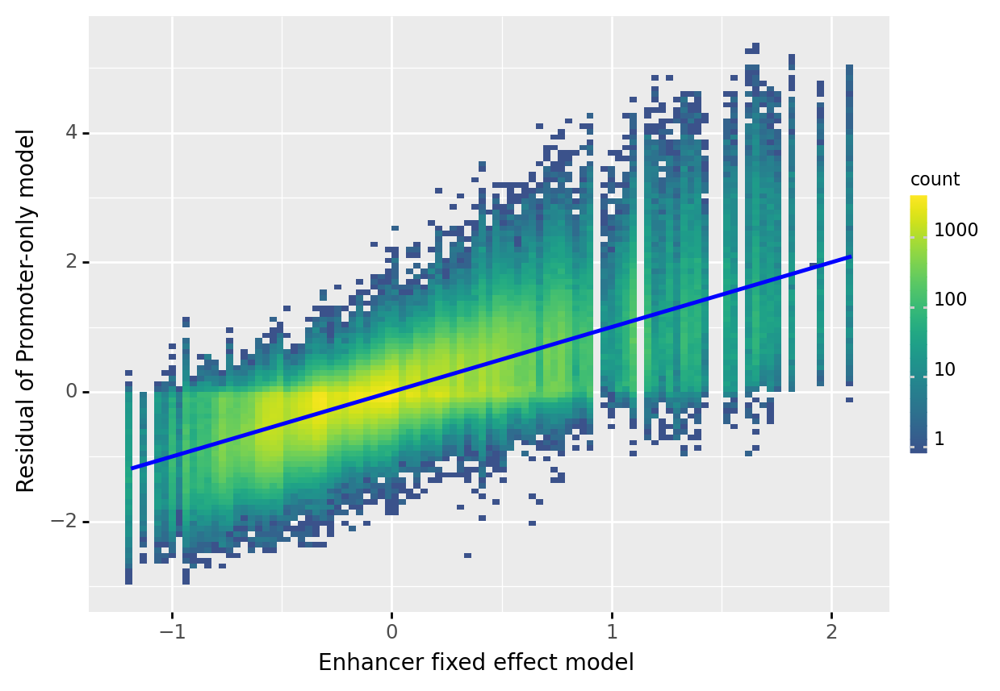

<ggplot: (1398519090158)>

In [126]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=residual_df,mapping=p9.aes(x="residual_pred",y="residual"))
 #+ p9.geom_col(position="dodge")
 #+ p9.scale_x_log10()
 #+ p9.scale_y_log10()
 + p9.geom_bin2d(bins=100, raster=True)
 + p9.scale_fill_continuous(ListedColormap(cm.get_cmap('viridis', 512)(np.linspace(0.25, 1, 512))), trans="log10")
 + p9.geom_smooth(method="lm",color="blue")
 + p9.theme(legend_text=p9.element_text(size=8),legend_title=p9.element_text(size=8),
            legend_box_margin=0,legend_key_width=5,axis_title=p9.element_text(size=10))#
 + p9.labs(x="Enhancer fixed effect model",y="Residual of Promoter-only model")
 #+ p9.scale_y_log10()
 #+ p9.labs(x="",y="Density")
)
p

### Compare variance explained

In [328]:
bergmann_prom_df = pd.read_csv(base_path_results + "bergmann_promoter_poisson_preds_baselined.tsv",sep="\t").rename(columns={"RNA_sum":"obs"})
bergmann_prom_df["pred"] = np.log2(bergmann_prom_df["pred"] + 1)
bergmann_prom_df["obs"] = np.log2(bergmann_prom_df["obs"] + 1)
bergmann_mult_df = pd.read_csv(base_path_results + "bergmann_multiplicative_poisson_preds_baselined.tsv",sep="\t").rename(columns={"RNA_sum":"obs"})
bergmann_mult_df["pred"] = np.log2(bergmann_mult_df["pred"] + 1)
bergmann_mult_df["obs"] = np.log2(bergmann_mult_df["obs"] + 1)
enformer_prom_df = pd.read_csv(base_path_results + "enformer_promoter_gamma_preds_baselined.tsv",sep="\t").rename(columns={pred_col:"obs"})
enformer_prom_df["pred"] = np.log2(enformer_prom_df["pred"] + 1)
enformer_prom_df["obs"] = np.log2(enformer_prom_df["obs"] + 1)
enformer_mult_df = pd.read_csv(base_path_results + "enformer_multiplicative_gamma_preds_baselined.tsv",sep="\t").rename(columns={pred_col:"obs"})
enformer_mult_df["pred"] = np.log2(enformer_mult_df["pred"] + 1)
enformer_mult_df["obs"] = np.log2(enformer_mult_df["obs"] + 1)

var_explain_list = [("Observed","Promoter",bergmann_prom_df),
                  ("Observed","Promoter\n+ Enhancer",bergmann_mult_df),
                  ("Predicted","Promoter",enformer_prom_df),
                  ("Predicted","Promoter\n+ Enhancer",enformer_mult_df)]

In [329]:
rows = []
for pred_type, reg_type, pred_df in var_explain_list:
    r2 = sklearn.metrics.r2_score(pred_df["obs"], pred_df["pred"])
    rows.append({
        "pred_type":pred_type,
        "reg_type":reg_type,
        "r2":r2
    })
var_explain_df = pd.DataFrame(rows)

In [336]:
var_explain_df

,pred_type,reg_type,r2
0,Observed,Promoter,0.535883
1,Observed,Promoter\n+ Enhancer,0.900819
2,Predicted,Promoter,0.903951
3,Predicted,Promoter\n+ Enhancer,0.967787


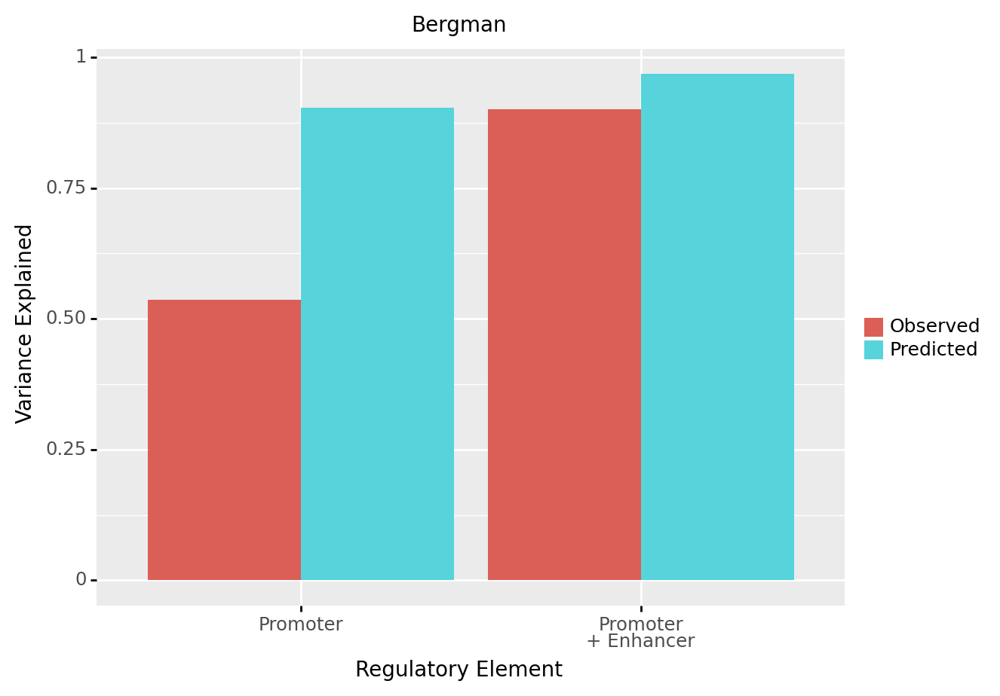

<ggplot: (1405546500374)>

In [330]:
scale = 1.0
p9.options.figure_size = (6.4*scale, 4.8*scale)
p = (p9.ggplot(data=var_explain_df,mapping=p9.aes(x="reg_type",y="r2",fill="pred_type"))
 + p9.geom_bar(stat="identity", position="dodge")
 + p9.labs(x="Regulatory Element", y="Variance Explained", fill="", title="Bergman")
 + p9.theme(legend_box_margin=0,legend_key_size =9, legend_text = p9.element_text(size=9),
            title=p9.element_text(size=10),
            legend_background=p9.element_blank(),
            #legend_position=(0.25,0.8),
           axis_title=p9.element_text(size=10))
     #axis_text_x=p9.element_text(rotation=45, hjust=1))    
)
p

In [331]:
p.save("Graphics/" + "enhancer_varexpl" + ".svg", width=3.0, height=2.6, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 3.0 x 2.6 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/enhancer_varexpl.svg


### Compare Model coefficients

#### Promoter only models

In [185]:
# Promoter only models

bergmann_prom_params = (pd.read_csv(base_path_results + "bergmann_promoter_poisson_params_baselined.tsv",sep="\t")
                        .rename(columns={"Unnamed: 0":"Name","0":"Bergmann"}))
enformer_prom_params = (pd.read_csv(base_path_results + "enformer_promoter_gamma_params_baselined.tsv",sep="\t")
                        .rename(columns={"Unnamed: 0":"Name","0":"Enformer"}))

parameters_prom = enformer_prom_params.merge(bergmann_prom_params, on="Name")
parameters_prom["Name"] = (parameters_prom["Name"]
                          .str.replace('C(promoter, Treatment("{}"))'.format(base_prom),"promoter",regex=False))

print(scipy.stats.pearsonr(parameters_prom.loc[parameters_prom["Name"].str.startswith("promoter")]["Bergmann"],
                           parameters_prom.loc[parameters_prom["Name"].str.startswith("promoter")]["Enformer"]))
print(scipy.stats.spearmanr(parameters_prom.loc[parameters_prom["Name"].str.startswith("promoter")]["Bergmann"],
                           parameters_prom.loc[parameters_prom["Name"].str.startswith("promoter")]["Enformer"]))

(0.8171769417209198, 5.152458008298378e-236)
SpearmanrResult(correlation=0.8202243098559161, pvalue=3.161028415051026e-239)


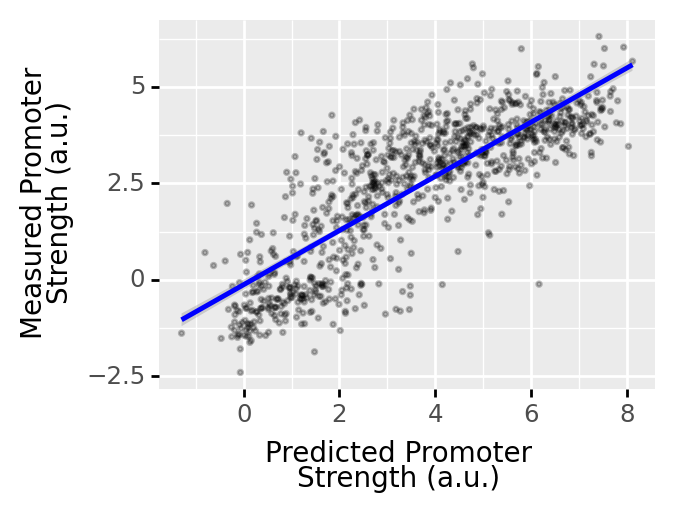

<ggplot: (1445395333181)>

In [186]:
scale = 0.5
p9.options.figure_size = (6.4*scale, 4.8*scale)
p = (p9.ggplot(data=parameters_prom.loc[parameters_prom["Name"].str.startswith("promoter")],mapping=p9.aes(x='Enformer',y='Bergmann'))
 + p9.geom_point(alpha=0.25, size=0.5)
 #+ p9.geom_bin2d(binwidth = (0.025, 0.1))
 + p9.geom_smooth(method="lm",color="blue")
 + p9.labs(x="Predicted Promoter\nStrength (a.u.)", y="Measured Promoter\nStrength (a.u.)")
 + p9.theme(axis_title=p9.element_text(size=10))
)
p

#### Log-linear OLS models

In [409]:
# compare ols params
bergmann_ols_params = (pd.read_csv(base_path_results + "bergmann_multiplicative_ols_params_baselined.tsv",sep="\t")
                        .rename(columns={"Unnamed: 0":"Name","0":"Bergmann"}))
enformer_ols_params = (pd.read_csv(base_path_results + "enformer_multiplicative_ols_params_baselined.tsv",sep="\t")
                        .rename(columns={"Unnamed: 0":"Name","0":"Enformer"}))

parameters_ols = enformer_ols_params.merge(bergmann_ols_params, on="Name")
parameters_ols["Name"] = (parameters_ols["Name"]
                          .str.replace('C(promoter, Treatment("{}"))'.format(base_prom),"promoter",regex=False)
                          .str.replace('C(enhancer, Treatment("{}"))'.format(base_enh),"enhancer",regex=False))

print(scipy.stats.pearsonr(parameters_ols.loc[parameters_ols["Name"].str.startswith("promoter")]["Bergmann"],
                     parameters_ols.loc[parameters_ols["Name"].str.startswith("promoter")]["Enformer"]))
print(scipy.stats.spearmanr(parameters_ols.loc[parameters_ols["Name"].str.startswith("promoter")]["Bergmann"],
                     parameters_ols.loc[parameters_ols["Name"].str.startswith("promoter")]["Enformer"]))

print(scipy.stats.pearsonr(parameters_ols.loc[parameters_ols["Name"].str.startswith("enhancer")]["Bergmann"],
                     parameters_ols.loc[parameters_ols["Name"].str.startswith("enhancer")]["Enformer"]))
print(scipy.stats.spearmanr(parameters_ols.loc[parameters_ols["Name"].str.startswith("enhancer")]["Bergmann"],
                     parameters_ols.loc[parameters_ols["Name"].str.startswith("enhancer")]["Enformer"]))

(0.7533558684125257, 4.860189902164334e-180)
SpearmanrResult(correlation=0.8213795323427127, pvalue=1.8456394432512747e-240)
(0.190818671689498, 1.2280140778576632e-09)
SpearmanrResult(correlation=0.20857720815108005, pvalue=2.8474349139523804e-11)


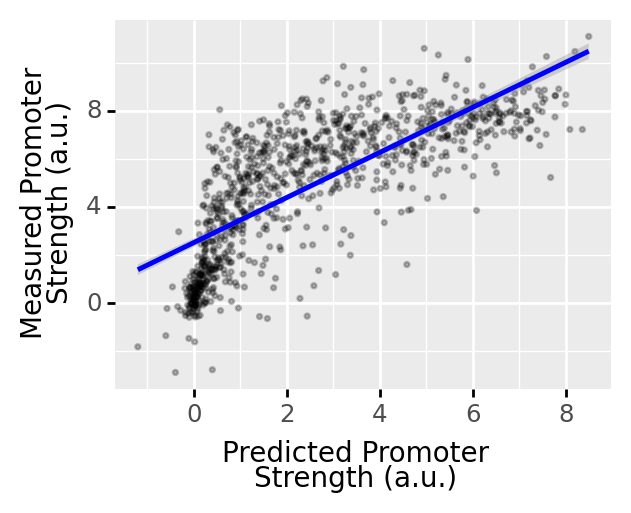

<ggplot: (1405736429093)>

In [410]:
scale = 0.5
p9.options.figure_size = (6.4*scale, 4.8*scale)
p = (p9.ggplot(data=parameters_ols.loc[parameters_ols["Name"].str.startswith("promoter")],mapping=p9.aes(x='Enformer',y='Bergmann'))
 + p9.geom_point(alpha=0.25, size=0.5)
 #+ p9.geom_bin2d(binwidth = (0.025, 0.1))
 + p9.geom_smooth(method="lm",color="blue")
 + p9.labs(x="Predicted Promoter\nStrength (a.u.)", y="Measured Promoter\nStrength (a.u.)")
 + p9.theme(axis_title=p9.element_text(size=10))
)
p

#### Poisson/Gamma models

In [319]:
bergmann_mult_params = (pd.read_csv(base_path_results + "bergmann_multiplicative_poisson_params_baselined.tsv",sep="\t")
                        .rename(columns={"Unnamed: 0":"Name","0":"Bergmann"}))
#bergmann_mult_params["Name"] = bergmann_mult_params["Name"].str.replace('C(promoter, Treatment("{}"))'.format(base_prom),"promoter",regex=False).str.replace('C(enhancer, Treatment("{}"))'.format(base_enh),"enhancer",regex=False)
enformer_mult_params = (pd.read_csv(base_path_results + "enformer_multiplicative_gamma_params_baselined.tsv",sep="\t")
                        .rename(columns={"Unnamed: 0":"Name","0":"Enformer"}))

parameters = enformer_mult_params.merge(bergmann_mult_params, on="Name")
parameters["Name"] = parameters["Name"].str.replace('C(promoter, Treatment("{}"))'.format(base_prom),"promoter",regex=False).str.replace('C(enhancer, Treatment("{}"))'.format(base_enh),"enhancer",regex=False)

In [39]:
print(scipy.stats.pearsonr(parameters.loc[parameters["Name"].str.startswith("promoter")]["Bergmann"],
                     parameters.loc[parameters["Name"].str.startswith("promoter")]["Enformer"]))
print(scipy.stats.spearmanr(parameters.loc[parameters["Name"].str.startswith("promoter")]["Bergmann"],
                     parameters.loc[parameters["Name"].str.startswith("promoter")]["Enformer"]))

(0.8060963144200044, 8.016428945270339e-225)
SpearmanrResult(correlation=0.8178365175381392, pvalue=1.0516760603158906e-236)


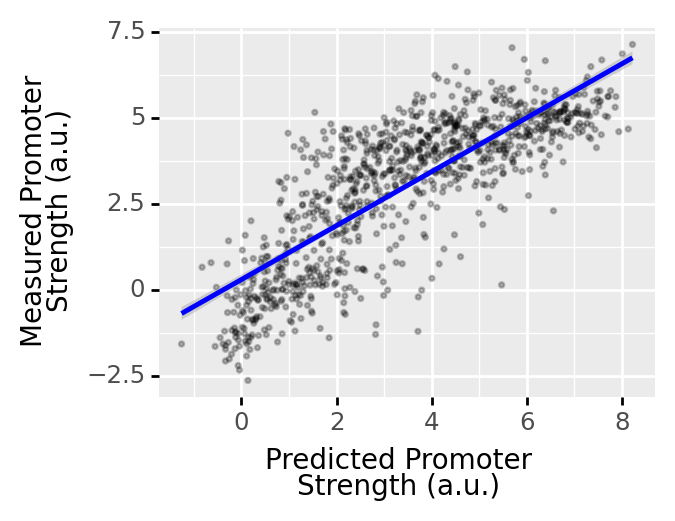

<ggplot: (1405507064610)>

In [334]:
scale = 0.5
p9.options.figure_size = (6.4*scale, 4.8*scale)
p = (p9.ggplot(data=parameters.loc[parameters["Name"].str.startswith("promoter")],mapping=p9.aes(x='Enformer',y='Bergmann'))
 + p9.geom_point(alpha=0.25, size=0.5, raster=True)
 #+ p9.geom_bin2d(binwidth = (0.025, 0.1))
 + p9.geom_smooth(method="lm",color="blue")
 + p9.labs(x="Predicted Promoter\nStrength (a.u.)", y="Measured Promoter\nStrength (a.u.)")
 + p9.theme(axis_title=p9.element_text(size=10))
)
p

In [335]:
p.save("Graphics/" + "xsup_bergmann_promoter" + ".svg", width=2.6, height=2.6, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 2.6 x 2.6 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/xsup_bergmann_promoter.svg


In [47]:
print(scipy.stats.pearsonr(parameters.loc[parameters["Name"].str.startswith("enhancer")]["Bergmann"],
                     parameters.loc[parameters["Name"].str.startswith("enhancer")]["Enformer"]))
print(scipy.stats.spearmanr(parameters.loc[parameters["Name"].str.startswith("enhancer")]["Bergmann"],
                     parameters.loc[parameters["Name"].str.startswith("enhancer")]["Enformer"]))

(0.1376139746888634, 1.2846376160029624e-05)
SpearmanrResult(correlation=0.1553704726931823, pvalue=8.132559620682583e-07)


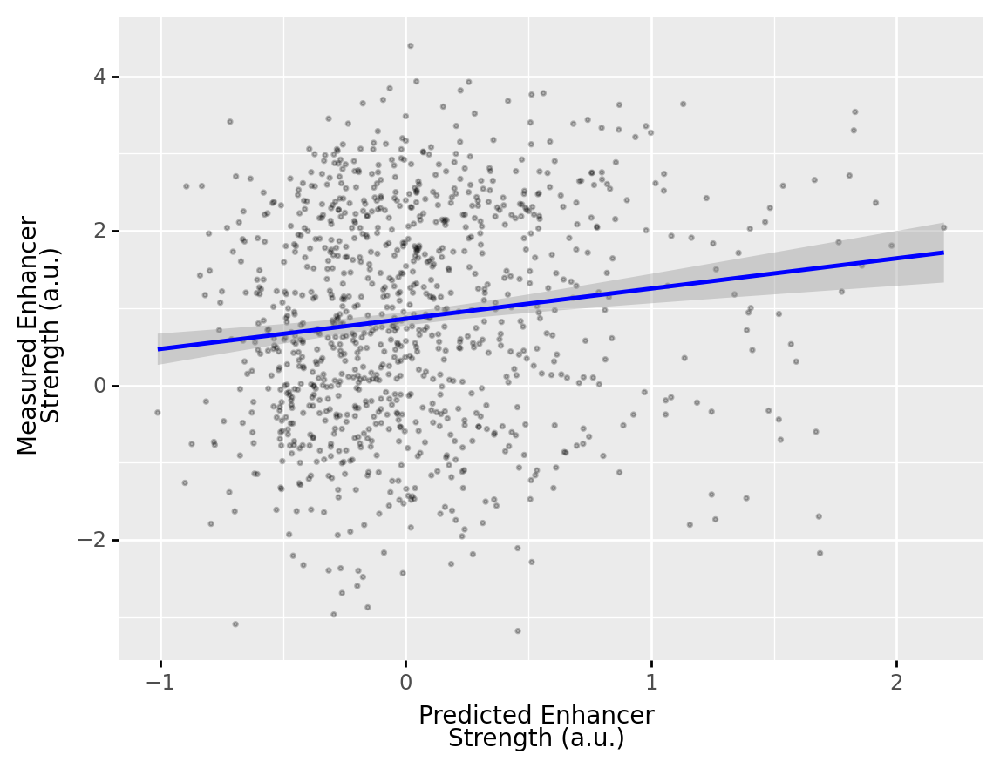

<ggplot: (1405506865198)>

In [332]:
scale = 1.0
p9.options.figure_size = (6.4*scale, 4.8*scale)
p = (p9.ggplot(data=parameters.loc[parameters["Name"].str.startswith("enhancer")],mapping=p9.aes(x='Enformer',y='Bergmann'))
 + p9.geom_point(alpha=0.25, size=0.5, raster=True)
 #+ p9.geom_bin2d(binwidth = (0.025, 0.1))
 + p9.geom_smooth(method="lm",color="blue")
 + p9.labs(x="Predicted Enhancer\nStrength (a.u.)", y="Measured Enhancer\nStrength (a.u.)")
 + p9.theme(axis_title=p9.element_text(size=10))
)
p

In [333]:
p.save("Graphics/" + "xsup_bergmann_enhancer" + ".svg", width=2.6, height=2.6, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 2.6 x 2.6 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/xsup_bergmann_enhancer.svg


### How much variation do enhancers induce per promoter?

In [320]:
promoter_param = parameters.loc[parameters.Name.str.startswith('prom')]
promoter_param["promoter"] = promoter_param["Name"].apply(lambda x: x.split("[")[1].split("]")[0].split('.')[1])
enhancer_param = parameters.loc[parameters.Name.str.startswith('enh')]
enhancer_param["enhancer"] = enhancer_param["Name"].apply(lambda x: x.split("[")[1].split("]")[0].split('.')[1])

/scratch/tmp/karollus/ipykernel_786964/1689396731.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/scratch/tmp/karollus/ipykernel_786964/1689396731.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [321]:
rows = []
for promoter in set(merged_df_min["promoter"]):
    subset = merged_df_min.query('promoter == @promoter')
    subset["RNA/DNA"] = subset["RNA_sum"]/subset["DNA_input"]
    if len(subset) < 2:
        continue
    r = scipy.stats.pearsonr(np.log2(subset[pred_col]+1),np.log2(subset["RNA/DNA"]))
    rows.append({
        "promoter":promoter,
        "class":subset["promoter_exp_class"].iloc[0],
        "n":len(subset),
        "avg":subset[pred_col].mean(),
        "max":subset[pred_col].max(),
        "min":subset[pred_col].min(),
        "std":subset[pred_col].std(),
        "cv":subset[pred_col].std()/subset[pred_col].mean(),
        "log2_avg":np.log2(subset[pred_col]+1).mean(),
        "log2_fc":np.log2(subset[pred_col]+1).max() - np.log2(subset[pred_col]+1).min(),
        "std_log2":np.log2(subset[pred_col]+1).std(),
        "avg_obs":subset["RNA/DNA"].mean(),
        "max_obs":subset["RNA/DNA"].max(),
        "min_obs":subset["RNA/DNA"].min(),
        "std_obs":subset["RNA/DNA"].std(),
        "cv_obs":subset["RNA/DNA"].std()/subset["RNA/DNA"].mean(),
        "log2_avg_obs":np.log2(subset["RNA/DNA"]).mean(),
        "log2_fc_obs":np.log2(subset["RNA/DNA"]).max() - np.log2(subset[pred_col]).min(),
        "std_log2_obs":np.log2(subset["RNA/DNA"]).std(),
        "r":r[0],
        "p":r[1]
    }) 
prom_var = pd.DataFrame(rows)

/scratch/tmp/karollus/ipykernel_786964/2526696615.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [322]:
prom_var_filtered = prom_var.query('n > 500').sort_values('log2_fc').merge(promoter_param,on="promoter")
prom_var_filtered["class"] = pd.Categorical(prom_var_filtered["class"],[0,1,2])

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/stats/smoothers.py:310: PlotnineWarning: Confidence intervals are not yet implementedfor lowess smoothings.


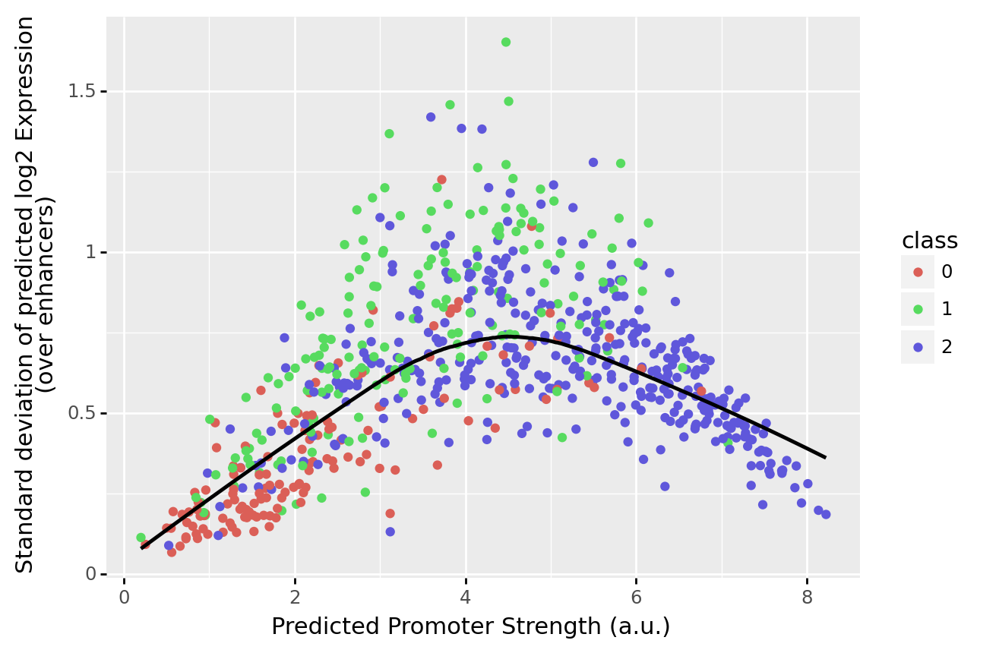

<ggplot: (1445442190638)>

In [195]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

(p9.ggplot(data=prom_var_filtered, 
            mapping=p9.aes(x="Enformer",y="std_log2",color="class"))
 + p9.geom_point()
 + p9.geom_smooth(color="black")
 + p9.labs(x="Predicted Promoter Strength (a.u.)",y="Standard deviation of predicted log2 Expression\n(over enhancers)")
 #+ p9.geom_smooth(method="lm", color="blue")
)

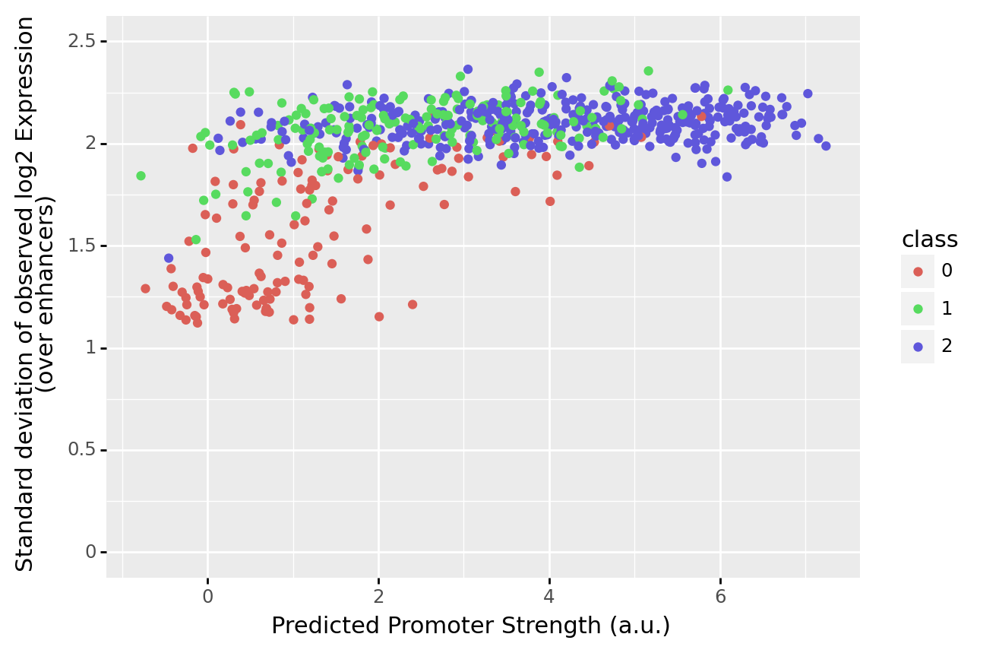

<ggplot: (1445261937661)>

In [38]:
(p9.ggplot(data=prom_var_filtered, 
            mapping=p9.aes(x="Enformer",y="std_log2_obs",color="class"))
 + p9.geom_point()
 + p9.coord_cartesian(ylim=(0,2.5))
 + p9.labs(x="Predicted Promoter Strength (a.u.)",y="Standard deviation of observed log2 Expression\n(over enhancers)")
 #+ p9.geom_smooth(method="lm", color="blue")
)

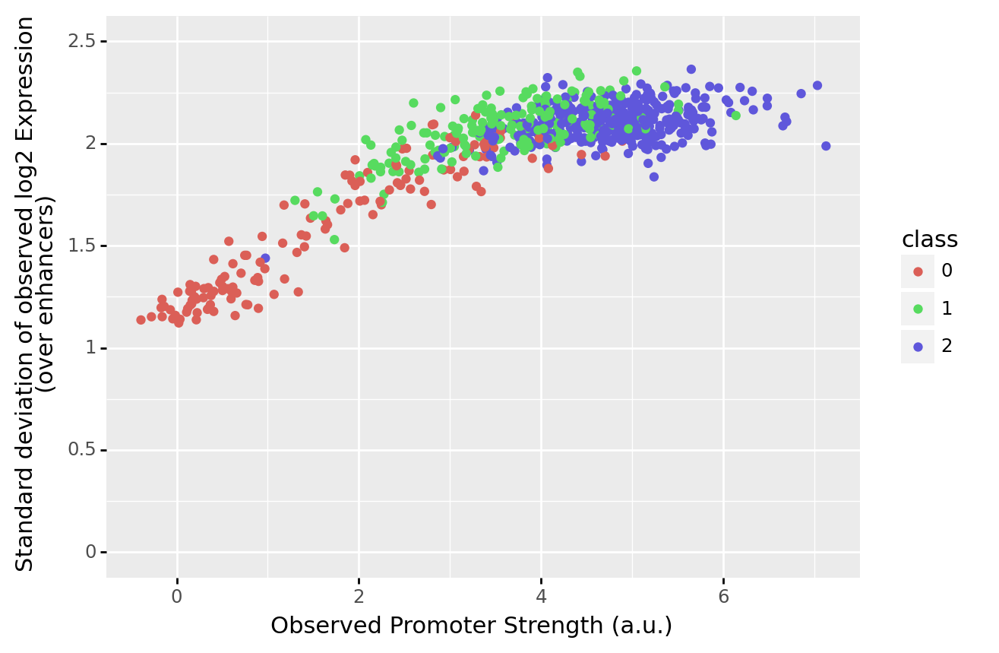

<ggplot: (1445488305496)>

In [196]:
(p9.ggplot(data=prom_var_filtered, 
            mapping=p9.aes(x="Bergmann",y="std_log2_obs",color="class"))
 + p9.geom_point()
 + p9.coord_cartesian(ylim=(0,2.5))
 + p9.labs(x="Observed Promoter Strength (a.u.)",y="Standard deviation of observed log2 Expression\n(over enhancers)")
 #+ p9.geom_smooth(method="lm", color="blue")
)

In [324]:
#strengths = prom_var_filtered[["promoter","Enformer","Bergmann"]].melt(id_vars="promoter",var_name="pred_obs",value_name="prom_strength")
#strengths["pred_obs"] = strengths["pred_obs"].apply(lambda x: "Predicted" if x == "Enformer" else "Observed")
strengths = prom_var_filtered[["promoter","Enformer"]].rename(columns={"Enformer":"prom_strength"})
stdevs = prom_var_filtered[["promoter","std_log2_obs","std_log2"]].melt(id_vars="promoter",var_name="pred_obs",value_name="std")
stdevs["pred_obs"] = stdevs["pred_obs"].apply(lambda x: "Predicted" if x == "std_log2" else "Observed")
plot_enh_std = strengths.merge(stdevs,on=["promoter"])

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/stats/smoothers.py:310: PlotnineWarning: Confidence intervals are not yet implementedfor lowess smoothings.


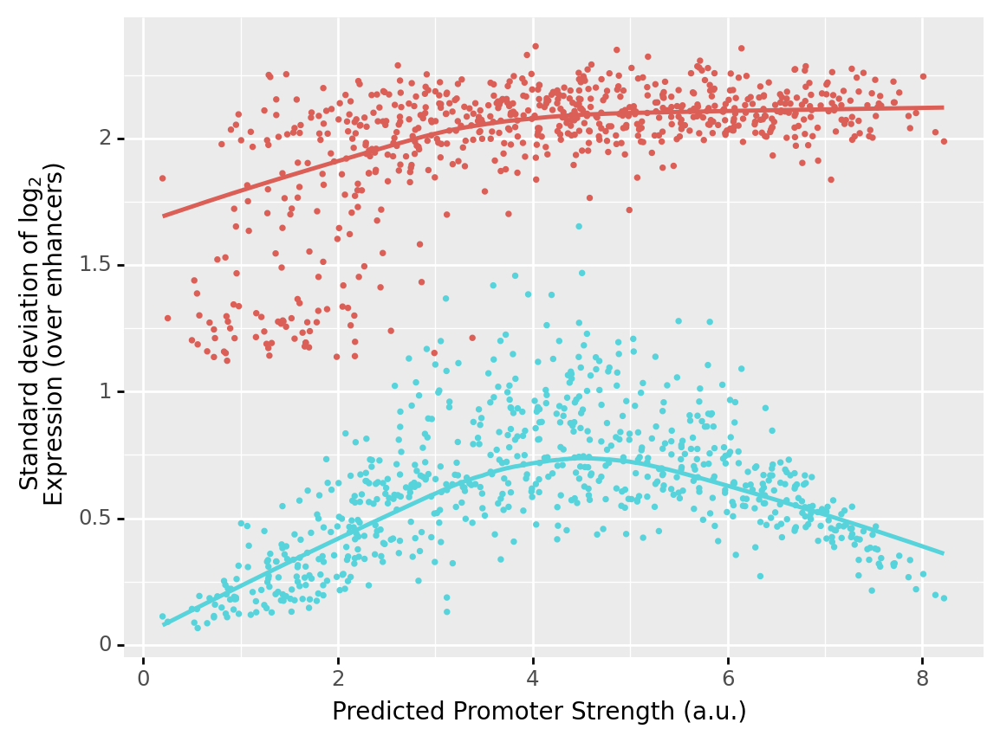

<ggplot: (1405644852833)>

In [326]:
p = (p9.ggplot(data=plot_enh_std, 
            mapping=p9.aes(x="prom_strength",y="std", color="pred_obs"))
 + p9.geom_point(size=0.5)
 #+ p9.coord_cartesian(ylim=(0,2.5))
 #+ p9.facet_wrap('~pred_obs')
 + p9.geom_smooth(method="lowess")
 + p9.labs(x="Predicted Promoter Strength (a.u.)",y="Standard deviation of $\mathregular{log_2}$\nExpression (over enhancers)")
 #+ p9.geom_smooth(method="lm", color="blue")
 + p9.theme(legend_position='none',
           axis_title=p9.element_text(size=10))
)
p

In [327]:
p.save("Graphics/" + "enhancer_std" + ".svg", width=2.5, height=2.6, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 2.5 x 2.6 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/enhancer_std.svg
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/stats/smoothers.py:310: PlotnineWarning: Confidence intervals are not yet implementedfor lowess smoothings.


# Enhancer Knockdown (Fulco et al. & Gasperini et al.)

In these CRISPRi studies, enhancers were knocked down using CRISPR interference, to measure the impact on expression of target genes. We replicate this by shuffling enhancer sequences.

In [133]:
base_path_data = "Data/Fulco_CRISPRi/"
base_path_results = "Results/Fulco_CRISPRi/"
base_path_data_gtex = "Data/GTEX/"

In [134]:
# liftover gasperini
gasperini_df = pd.read_csv(base_path_data + "gasperini.tsv",sep="\t")

#((gasperini_df["chr.candidate_enhancer"]+":"+gasperini_df["start.candidate_enhancer"].astype('str')+"-"+gasperini_df["stop.candidate_enhancer"].astype('str'))
#.to_csv(base_path_data + "gasperini_liftover_input.tsv",index=None))

#gasperini_lift
gasperini_df["liftover_coord"] = pd.read_csv(base_path_data + "hglft_genome_2c397_7c34e0.bed",header=None)

In [135]:
gasperini_df["ziga_key"] = "gasperini2019_" + gasperini_df["target_gene_short"] + "_" + gasperini_df["liftover_coord"].apply(lambda x: x.split(':')[1])

In [136]:
gasperini_df["Absolute Pct Change"] = np.abs((1-gasperini_df["Diff_expression_test_fold_change"])*100)  #Proportion remaining transcript of target gene (performed as described in “Method Details: Digital gene expression quantification - Differential expression tests”). 

In [137]:
fulco_df = pd.read_csv(base_path_data + "enhancer_knockdown_effects.tsv",sep="\t")

## Analysis

### Get data

#### Knockdown analysis

In [138]:
missing_genes = {"ADSS2":'ADSS',
                 "ADSS1":'ADSSL1',
                 "ZFTA":'C11orf95',
                 "RUSF1":'C16orf58',
                 "HROB":'C17orf53',
                 "BRME1":'C19orf57',
                 "MIR9-1HG":'C1orf61',
                 "DNAAF9":'C20orf194',
                 "BBLN":'C9orf16',
                 "CARS1":'CARS',
                 "YJU2B":'CCDC130',
                 "MIX23":'CCDC58',
                 "UVSSA":'CRIPAK', #same strand
                 "EOLA2":'CXorf40B',
                 "PABIR1":'FAM122A',
                 "NALF1":'FAM155A',
                 "SLX9":'FAM207A', #same strand
                 "CYRIA":'FAM49A',
                 "CYRIB":'FAM49B',
                 "CEP43":'FGFR1OP',
                 "CEP20":'FOPNL',
                 "H1-10":'H1FX',
                 "H2AZ2":'H2AFV',
                 "MACROH2A1":'H2AFY',
                 "H3-3A":'H3F3A',
                 "HARS1":'HARS',
                 "H1-5":'HIST1H1B',
                 "H1-2":'HIST1H1C',
                 "H1-3":'HIST1H1D',
                 "H1-4":'HIST1H1E',
                 "H2AC11":'HIST1H2AG',
                 "H2AC13":'HIST1H2AI',
                 "H2BC4":'HIST1H2BC',
                 "H2BC5":'HIST1H2BD',
                 "H2BC7":'HIST1H2BF',
                 "H2BC8":'HIST1H2BG',
                 "H2BC11":'HIST1H2BJ',
                 "H2BC12":'HIST1H2BK',
                 "H2BC13":'HIST1H2BL',
                 "H2BC15":'HIST1H2BN',
                 "H3C4":'HIST1H3D',
                 "H4C2":'HIST1H4B',
                 "H4C3":'HIST1H4C',
                 "H4C8":'HIST1H4H',
                 "H4C11":'HIST1H4J',
                 "H2AW":'HIST3H2A',
                 "IARS1":'IARS',
                 "GARRE1":'KIAA0355',
                 "ELAPOR1":'KIAA1324',
                 "ELAPOR2":'KIAA1324L',
                 "MARCHF6":'MARCH6',
                 "MARCHF9":'MARCH9',
                 "PPP5D1P":'PPP5D1',
                 "QARS1":'QARS',
                 "METTL25B":'RRNAD1',
                 "TARS3":'TARSL2',
                 "DYNLT2B":'TCTEX1D2',
                 "STING1":'TMEM173',
                 "PEDS1":'TMEM189',
                 "DYNC2I1":'WDR60',
                 "DNAAF10":'WDR92',
                 "POLR1H":'ZNRD1'}

In [139]:
results = pd.read_csv(base_path_results + "avsec_fulltable_fixed-latest_results.tsv",sep="\t")

In [140]:
set(results["enhancer_wide_type"])

{'fixed'}

In [141]:
results = results.groupby(['ziga_key','fulco_key','gene','enhancer_modification'])[[k for k in results.keys() if ("CAGE" in k) or ("DNASE" in k)]].mean().reset_index()

In [142]:
set(results["enhancer_modification"])

{'none', 'replace_with_n', 'shuffle'}

In [143]:
ziga_df = pd.read_csv(base_path_data + "ziga_additional_columns.tsv",sep="\t")

ziga_df["signed_tss_distance"] = (ziga_df['fix_enhancer_wide_start'] + ziga_df['fix_enhancer_wide_end'])/2 - (ziga_df['main_tss_start'] + ziga_df['main_tss_end'])/2

gene_locs = gtf_df.df.query('Feature == "gene"')[["Chromosome","Start","End","Score","Strand","Frame","gene_id","gene_name"]]
gene_locs["gene"] = gene_locs["gene_name"].apply(lambda x: missing_genes[x] if x in missing_genes else x) 

ziga_df = (ziga_df.merge(gene_locs[["Strand","gene"]].drop_duplicates(),on="gene"))

In [144]:
assert(len(ziga_df) == 8053)

In [145]:
ziga_df["Strand"] = ziga_df["Strand"].apply(lambda x: 1 if x=="+" else -1) 
# enhancer is upstream if sign of distance is opposite of strand
ziga_df["sign_of_dist"] = np.sign(ziga_df["signed_tss_distance"])
ziga_df["upstream"] = (ziga_df["sign_of_dist"] != ziga_df["Strand"])

In [146]:
ziga_df.keys()

Index(['chromosome', 'enhancer_wide_start', 'enhancer_wide_end',
       'enhancer_start', 'enhancer_end', 'sequence_start', 'sequence_end',
       'target_start', 'target_end', 'main_tss_start', 'main_tss_end',
       'main_tss_bin', 'validated', 'H3K27ac/abs(distance)',
       'relative_tss_distance', 'relative_main_tss_distance', 'is_enhancer',
       'dataset_name', 'cell_type_target', 'gene', 'Gene', 'Element name',
       'ziga_key', 'fulco_key', 'fix_enhancer_wide_start',
       'fix_enhancer_wide_end', 'actual_tss_distance', 'signed_tss_distance',
       'Strand', 'sign_of_dist', 'upstream'],
      dtype='object')

In [147]:
baseline = results.query('enhancer_modification == "none"').drop(columns=["enhancer_modification"])
ko = results.query('enhancer_modification == "shuffle"').drop(columns=["enhancer_modification"])
merged_df = baseline.merge(ko, on=['ziga_key','fulco_key','gene'], suffixes=("_ref","_alt"))
merged_df[[k for k in merged_df.keys() if ("CAGE" in k) or ("DNASE" in k)]] = np.log2(merged_df[[k for k in merged_df.keys() if ("CAGE" in k) or ("DNASE" in k)]]+1)
merged_df = merged_df.merge(ziga_df, on=["ziga_key",'fulco_key','gene'])

pred_col = "CAGE:chronic myelogenous leukemia cell line:K562 ENCODE, biol__landmark_sum"
merged_df['log2_fc_pred'] = merged_df[pred_col+"_alt"] - merged_df[pred_col+"_ref"]
merged_df['abs_delta'] = np.abs(2**(merged_df[pred_col+"_alt"]) - 2**(merged_df[pred_col+"_ref"]) - 2)

In [148]:
ko_n = results.query('enhancer_modification == "replace_with_n"').drop(columns=["enhancer_modification"])
merged_df_n = baseline.merge(ko_n, on=['ziga_key','fulco_key','gene'], suffixes=("_ref","_alt"))
merged_df_n[[k for k in merged_df_n.keys() if ("CAGE" in k) or ("DNASE" in k)]] = np.log2(merged_df_n[[k for k in merged_df_n.keys() if ("CAGE" in k) or ("DNASE" in k)]]+1)
merged_df_n = merged_df_n.merge(ziga_df, on=["ziga_key",'fulco_key','gene'])

merged_df_n['log2_fc_pred'] = merged_df_n[pred_col+"_alt"] - merged_df_n[pred_col+"_ref"]

In [149]:
scipy.stats.pearsonr(merged_df['log2_fc_pred'],merged_df_n['log2_fc_pred'])

(0.8980552737863945, 0.0)

#### Local results

In [150]:
local_results = pd.read_csv(base_path_results + "ful_gas_localeffects-enformer-latest_results.tsv", sep="\t")
local_results = local_results.groupby(["id","chr","wide_start","wide_end","start","end","type","seqtype","insert_seq"])[[x for x in local_results.keys() if x.endswith("landmark_sum")]].mean().reset_index()
local_results = local_results.query('seqtype == "aavs1"')

In [151]:
local_results_prom = local_results.query('type == "promoter"')
local_results_enh = local_results.query('type == "enhancer"')
local_merged = local_results_prom.merge(local_results_enh,on="chr",suffixes=("_prom","_enh"))
local_merged["id"] = local_merged["id_enh"] + "_" + local_merged["id_prom"]

### Overlaps

In [152]:
enhancer_pr = pr.PyRanges(merged_df.rename(columns={"fix_enhancer_wide_start":"Start",
                          "fix_enhancer_wide_end":"End",
                         "chromosome":"Chromosome"})
                         [["Chromosome","Start","End","ziga_key","actual_tss_distance","log2_fc_pred", "main_tss_start", "validated"]])

In [153]:
overlapped = enhancer_pr.join(enhancer_pr).df.query('ziga_key != ziga_key_b & main_tss_start == main_tss_start_b & validated < validated_b').sort_values('log2_fc_pred_b')

In [154]:
overlapped_regions = set(overlapped["ziga_key"])

### Noise analysis

In [155]:
noise_df = merged_df.copy()
noise_df['log_tss_distance'] =  np.log10(noise_df['actual_tss_distance'])
noise_df['abs_pct_change'] = np.abs((2**noise_df['log2_fc_pred'] - 1)*100)
noise_df["mod"] = "shuffle"

noise_df.groupby(['validated'])['abs_pct_change'].median()

validated
False    0.821207
True     4.247479
Name: abs_pct_change, dtype: float64

In [156]:
noise_df_n = merged_df_n.copy()
noise_df_n['log_tss_distance'] =  np.log10(noise_df_n['actual_tss_distance'])
noise_df_n['abs_pct_change'] = np.abs((2**noise_df_n['log2_fc_pred'] - 1)*100)
noise_df_n["mod"] = "n"

noise_df_n.groupby(['validated'])['abs_pct_change'].median()

validated
False    0.853654
True     4.351602
Name: abs_pct_change, dtype: float64

In [157]:
combined_noise = pd.concat([noise_df[["actual_tss_distance",'abs_pct_change','mod','validated']],
                           noise_df_n[["actual_tss_distance",'abs_pct_change','mod','validated']]])

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/pandas/core/arraylike.py:364: RuntimeWarning: divide by zero encountered in log10


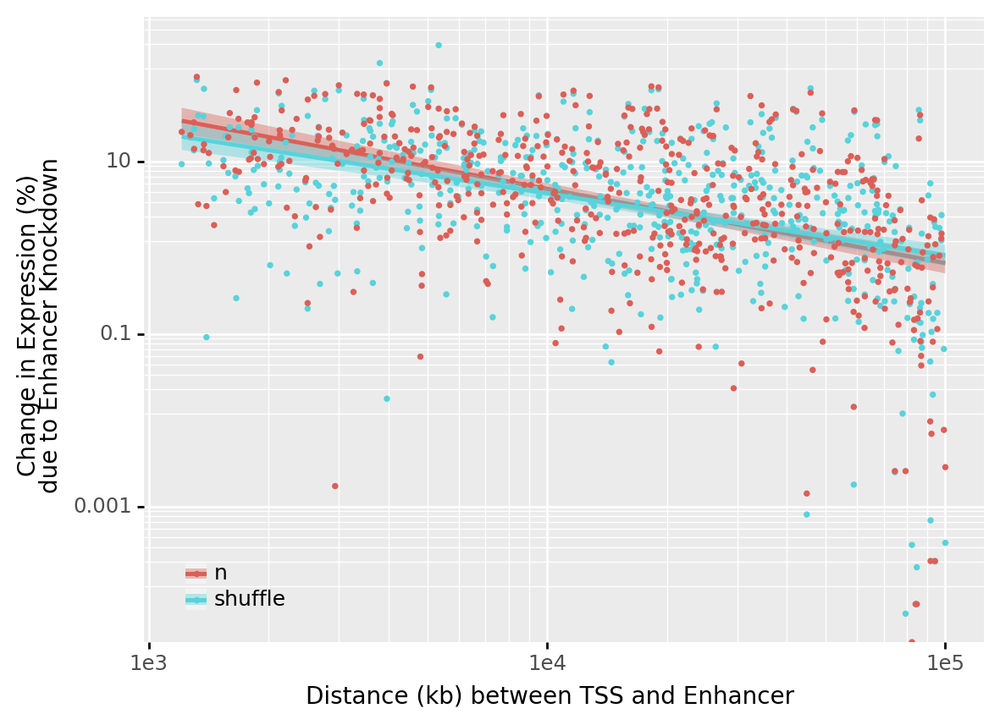

<ggplot: (1440120550352)>

In [158]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=combined_noise.query('validated & actual_tss_distance < 100_000 & actual_tss_distance > 980')
           ,mapping=p9.aes(x="actual_tss_distance",y="abs_pct_change",fill="mod", color="mod"))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 + p9.geom_smooth(method="lm")
 #+ p9.facet_wrap('~dataset')
 + p9.geom_point(size=0.5)
 + p9.labs(x="Distance (kb) between TSS and Enhancer",y="Change in Expression (%)\ndue to Enhancer Knockdown", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10)
           )
)
p

### Compute Average Precision

#### Fulco

In [159]:
bins = [0, 3000, 12500, 34500]  + [float('inf')]
#labels = list(range(1,max_bin+1))
labels = ["0-3","3-12.5","12.5-34.5",'34.5-131']

merged_df['bin'] = pd.cut(merged_df['actual_tss_distance'], bins=bins, right=True, labels=labels, retbins=False, precision=3, include_lowest=False, duplicates='raise', ordered=True)


for pred_bin in labels:
    print(pred_bin)
    subset = merged_df.query('bin == @pred_bin & dataset_name == "fulco2019"')
    print("Enformer: {}".format(sklearn.metrics.average_precision_score(subset['validated'], np.abs(subset["log2_fc_pred"]))))
    print("Enformer Absolute: {}".format(sklearn.metrics.average_precision_score(subset['validated'], np.abs(subset["abs_delta"]))))
    print("ABC: {}".format(sklearn.metrics.average_precision_score(subset['validated'], subset['H3K27ac/abs(distance)'])))
    print("Random: {}".format(np.sum(subset['validated'])/len(subset['validated'])))
    print(np.sum(subset['validated']))
    print(len(subset['validated']) - np.sum(subset['validated']))



0-3
Enformer: 0.9820668315172745
Enformer Absolute: 0.9751520533737923
ABC: 0.9914231754553344
Random: 0.9047619047619048
57
6
3-12.5
Enformer: 0.7544407211165706
Enformer Absolute: 0.7301042938705428
ABC: 0.6198242675440684
Random: 0.4107142857142857
46
66
12.5-34.5
Enformer: 0.16022873249219588
Enformer Absolute: 0.18081872477643096
ABC: 0.41209543964965345
Random: 0.17307692307692307
36
172
34.5-131
Enformer: 0.03322798979098985
Enformer Absolute: 0.03683615809420822
ABC: 0.17127419297509722
Random: 0.029508196721311476
27
888


In [160]:
bins = [0, 3000, 12500, 34500]  + [float('inf')]
#labels = list(range(1,max_bin+1))
labels = ["0-3","3-12.5","12.5-34.5",'34.5-131']

merged_df['bin_ziga'] = pd.cut(np.abs(merged_df['relative_tss_distance']), bins=bins, right=True, labels=labels, retbins=False, precision=3, include_lowest=False, duplicates='raise', ordered=True)


for pred_bin in labels:
    print(pred_bin)
    subset = merged_df.query('bin_ziga == @pred_bin & dataset_name == "fulco2019"')
    print("Enformer: {}".format(sklearn.metrics.average_precision_score(subset['validated'], np.abs(subset["log2_fc_pred"]))))
    print("Enformer Absolute: {}".format(sklearn.metrics.average_precision_score(subset['validated'], np.abs(subset["abs_delta"]))))
    print("ABC: {}".format(sklearn.metrics.average_precision_score(subset['validated'], subset['H3K27ac/abs(distance)'])))
    print("Random: {}".format(np.sum(subset['validated'])/len(subset['validated'])))
    print(np.sum(subset['validated'])/len(subset['validated']))
    print(np.sum(subset['validated']))
    print(len(subset['validated']) - np.sum(subset['validated']))

0-3
Enformer: 0.9805194550617726
Enformer Absolute: 0.9732188113772264
ABC: 0.987010347986913
Random: 0.9137931034482759
0.9137931034482759
53
5
3-12.5
Enformer: 0.7719260731985131
Enformer Absolute: 0.7430509003731939
ABC: 0.6730219434779342
Random: 0.41964285714285715
0.41964285714285715
47
65
12.5-34.5
Enformer: 0.21680518105071067
Enformer Absolute: 0.24485785466653465
ABC: 0.43893576848649113
Random: 0.17937219730941703
0.17937219730941703
40
183
34.5-131
Enformer: 0.07235156139391975
Enformer Absolute: 0.07726566903479437
ABC: 0.23135184033228695
Random: 0.028729281767955802
0.028729281767955802
26
879


#### Gasperini

In [161]:
for pred_bin in labels:
    print(pred_bin)
    subset = merged_df.query('bin == @pred_bin & dataset_name == "gasperini2019"')
    print("Enformer: {}".format(sklearn.metrics.average_precision_score(subset['validated'], np.abs(subset["log2_fc_pred"]))))
    print("Enformer Absolute: {}".format(sklearn.metrics.average_precision_score(subset['validated'], np.abs(subset["abs_delta"]))))
    print("ABC: {}".format(sklearn.metrics.average_precision_score(subset['validated'], subset['H3K27ac/abs(distance)'])))
    print("Random: {}".format(np.sum(subset['validated'])/len(subset['validated'])))
    print(np.sum(subset['validated'])/len(subset['validated']))
    print(np.sum(subset['validated']))
    print(len(subset['validated']) - np.sum(subset['validated']))

0-3
Enformer: 0.33528813984123707
Enformer Absolute: 0.44305131236438056
ABC: 0.3152757828145686
Random: 0.21634615384615385
0.21634615384615385
45
163
3-12.5
Enformer: 0.2699661396905996
Enformer Absolute: 0.3300083021503374
ABC: 0.35591618990611107
Random: 0.18876755070202808
0.18876755070202808
121
520
12.5-34.5
Enformer: 0.17204818717792214
Enformer Absolute: 0.22022186534435415
ABC: 0.21822609306804308
Random: 0.0991136180499597
0.0991136180499597
123
1118
34.5-131
Enformer: 0.10242648185932196
Enformer Absolute: 0.15502319270186815
ABC: 0.0874652534945684
Random: 0.03879957127545552
0.03879957127545552
181
4484


In [162]:
for pred_bin in labels:
    print(pred_bin)
    subset = merged_df.query('bin_ziga == @pred_bin & dataset_name == "gasperini2019"')
    print("Enformer: {}".format(sklearn.metrics.average_precision_score(subset['validated'], np.abs(subset["log2_fc_pred"]))))
    print("ABC: {}".format(sklearn.metrics.average_precision_score(subset['validated'], subset['H3K27ac/abs(distance)'])))
    print("Random: {}".format(np.sum(subset['validated'])/len(subset['validated'])))
    print(np.sum(subset['validated'])/len(subset['validated']))
    print(np.sum(subset['validated']))
    print(len(subset['validated']) - np.sum(subset['validated']))

0-3
Enformer: 0.3563025658330719
ABC: 0.22932945128359078
Random: 0.21875
0.21875
28
100
3-12.5
Enformer: 0.2896555993111749
ABC: 0.3737945290151355
Random: 0.210896309314587
0.210896309314587
120
449
12.5-34.5
Enformer: 0.18222326086373103
ABC: 0.2016513311498242
Random: 0.10248198558847077
0.10248198558847077
128
1121
34.5-131
Enformer: 0.10680388368195545
ABC: 0.11615988517211982
Random: 0.040341027240590556
0.040341027240590556
194
4615


### Correlation - Fulco

In [163]:
fulco_df["fulco_key"] = fulco_df["Gene"] + "_" + fulco_df['Element name']

In [164]:
fulco_merged = merged_df.merge(fulco_df[["fulco_key",'Fraction change in gene expr', 'Adjusted p-value', 'Significant',
       'RNA readout method', 'Perturbation method', 'nKO', 'nCtrl', 'semKO',
       'semCtrl', 'Power to detect 25% effects', 'Gene TSS',
       'Normalized HiC Contacts', 'DHS (RPM)', 'H3K27ac (RPM)', 'Activity',
       'ABC Score', 'Reference']], on='fulco_key')

In [165]:
# We do not have data for all supposedly validated enhancers
print(len(merged_df.query('validated and dataset_name == "fulco2019"')))
print(len(fulco_merged.query('validated')))

166
92


In [166]:
#set(merged_df.query('validated and dataset_name == "fulco2019"')['fulco_key']) - set(fulco_df["fulco_key"])

In [167]:
fulco_merged['log2_fc_obs'] = np.log2(1 + fulco_merged['Fraction change in gene expr'])

In [168]:
print(scipy.stats.pearsonr(fulco_merged['log2_fc_pred'], fulco_merged['log2_fc_obs']))
print(scipy.stats.spearmanr(fulco_merged['log2_fc_pred'], fulco_merged['log2_fc_obs']))

(0.3144899998333325, 4.102967127791464e-28)
SpearmanrResult(correlation=0.045966169208175714, pvalue=0.11718087999594218)


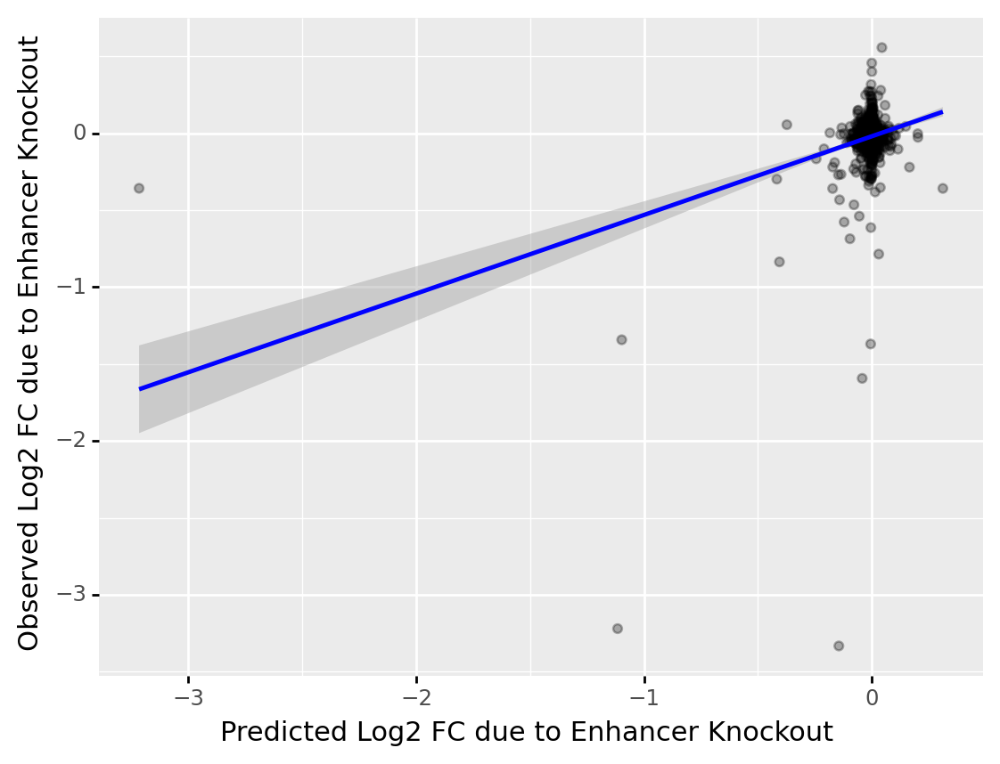

<ggplot: (1440120744617)>

In [169]:
scale = 1.0
p9.options.figure_size = (6.4*scale, 4.8*scale)

(p9.ggplot(data=fulco_merged,mapping=p9.aes(x="log2_fc_pred",y="log2_fc_obs"))
 + p9.geom_point(alpha=0.3)
 + p9.geom_smooth(method="lm", color="blue")
 + p9.labs(x="Predicted Log2 FC due to Enhancer Knockout",y="Observed Log2 FC due to Enhancer Knockout")
)

In [170]:
max_bin = 4
bins = [0] + fulco_merged['actual_tss_distance'].quantile(np.array(range(1,max_bin))/max_bin).tolist() + [float('inf')]
#labels = list(range(1,max_bin+1))
labels = ["First quartile","Second quartile","Third quartile","Fourth quartile"]

fulco_merged['quart_bin'] = pd.cut(fulco_merged['actual_tss_distance'], bins=bins, right=True, labels=labels, retbins=False, precision=3, include_lowest=False, duplicates='raise', ordered=True)

In [171]:
for pred_bin in ["First quartile","Second quartile","Third quartile","Fourth quartile"]:
    print(pred_bin)
    subset = fulco_merged.query('quart_bin == @pred_bin')
    print(scipy.stats.pearsonr(subset['log2_fc_pred'], subset['log2_fc_obs']))

First quartile
(0.31520673529284127, 3.91639689927768e-08)
Second quartile
(-0.018299394606122073, 0.755917127860207)
Third quartile
(0.013560627158239238, 0.818136552621807)
Fourth quartile
(0.10865740512529368, 0.06416051803401396)


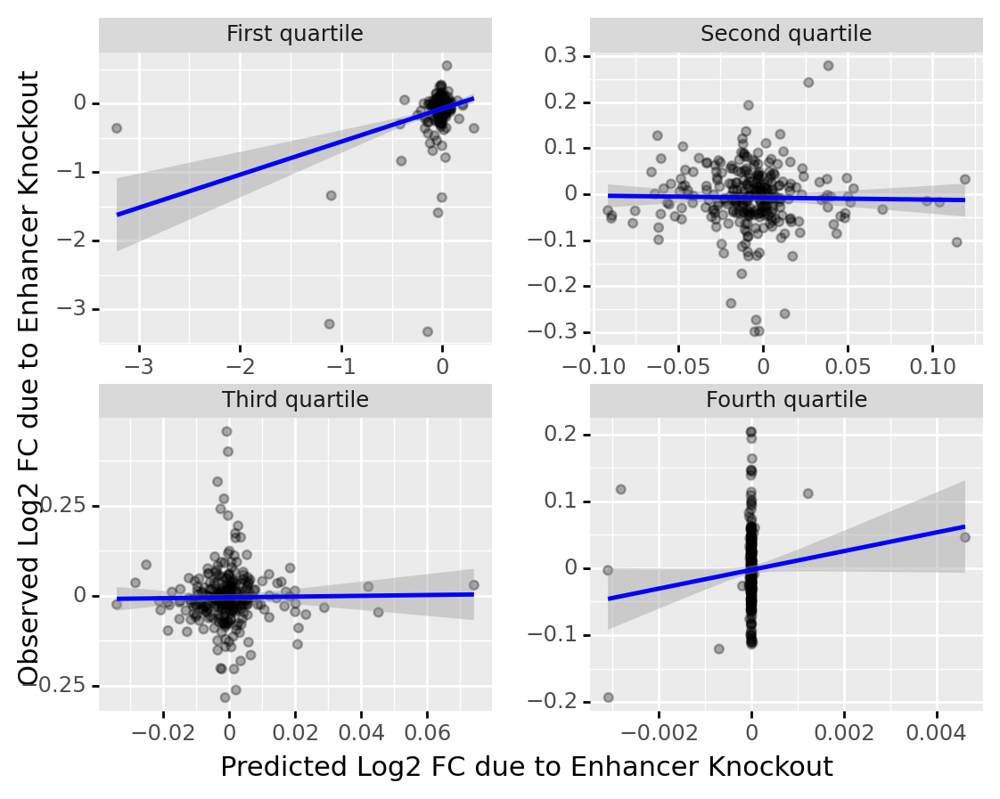

<ggplot: (1440253876065)>

In [172]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

(p9.ggplot(data=fulco_merged,mapping=p9.aes(x="log2_fc_pred",y="log2_fc_obs"))
 + p9.geom_point(alpha=0.3)
 + p9.geom_smooth(method="lm", color="blue")
 + p9.facet_wrap("~quart_bin", scales="free")
 + p9.theme(subplots_adjust={'hspace': 0.25,'wspace': 0.25})
 + p9.labs(x="Predicted Log2 FC due to Enhancer Knockout",y="Observed Log2 FC due to Enhancer Knockout")
)

### Decay with Distance - Fulco

In [173]:
cols = ["fulco_key", "ziga_key", "validated", 'actual_tss_distance', 'upstream']

plot_df_fulco = fulco_merged.copy()
plot_df_fulco["Observed"] = np.abs(plot_df_fulco["log2_fc_obs"])
plot_df_fulco["Predicted"] = np.abs(plot_df_fulco["log2_fc_pred"])
plot_df_fulco["Observed_Percent"] = np.abs(plot_df_fulco['Fraction change in gene expr']*100)
plot_df_fulco["Predicted_Percent"] = np.abs(2**plot_df_fulco["log2_fc_pred"]-1)*100
plot_df_percent_fulco = (plot_df_fulco[cols+["Observed_Percent", "Predicted_Percent"]]
                   .rename(columns={"Observed_Percent":"Observed", "Predicted_Percent":"Predicted"})
                   .melt(id_vars=cols, var_name="Type"))



In [174]:
print(plot_df_percent_fulco.groupby(['Type','validated'])["value"].median())
print(plot_df_percent_fulco.query('actual_tss_distance < 100000 & actual_tss_distance > 990').groupby(['Type','validated'])["value"].median())

Type       validated
Observed   False         2.316793
           True         14.826249
Predicted  False         0.300874
           True          1.666080
Name: value, dtype: float64
Type       validated
Observed   False         2.467223
           True         14.826249
Predicted  False         0.654230
           True          1.720292
Name: value, dtype: float64


In [175]:
#plot_df_percent['type_valid'] = plot_df_percent.apply(lambda x: x["Type"] if x["validated"] else ("Not-Significant" if x["Type"] == "Predicted" else ""),axis=1)

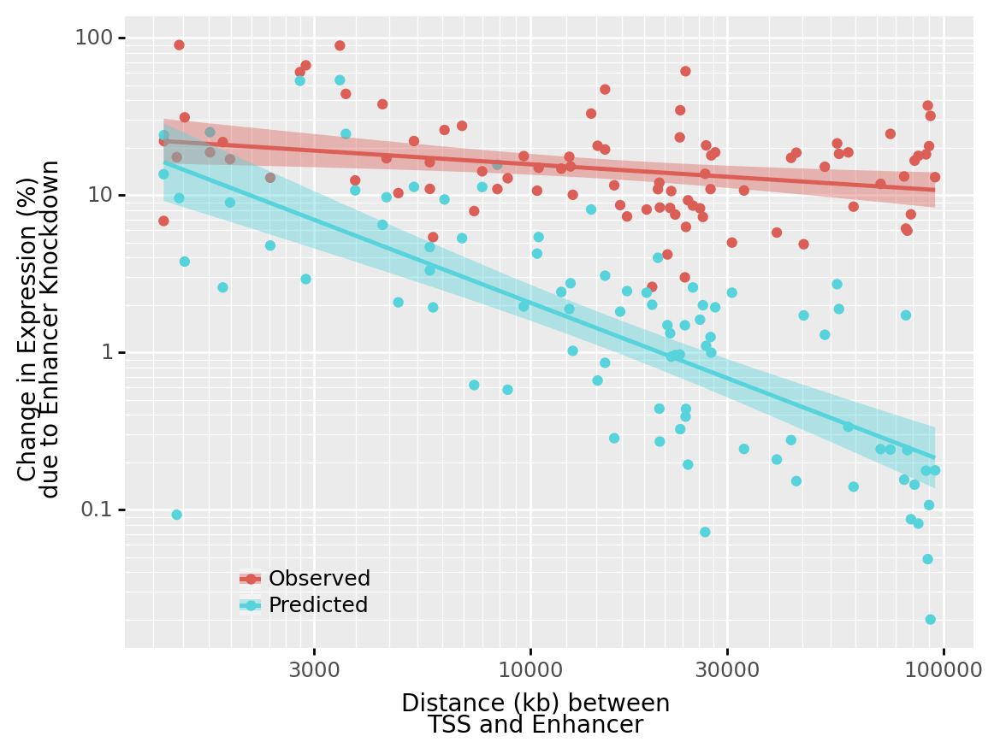

<ggplot: (1440159808991)>

In [176]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=plot_df_percent_fulco.query('validated & actual_tss_distance < 100000 & actual_tss_distance > 990'),mapping=p9.aes(x="actual_tss_distance",y="value",fill="Type", color="Type"))
 + p9.geom_point()
 #+ p9.geom_point(data=plot_df_percent_fulco.query('not validated & Distance < 100000 & Type == "Predicted"'),size=1,alpha=0.1,fill='grey')
 #+ p9.geom_smooth(data=plot_df_percent_fulco.query('not validated & Distance < 100000 & Type == "Predicted"'),method="lm", color="black", fill="")
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 #+ p9.geom_hline(yintercept = 3)
 + p9.geom_smooth(method="lm")
 + p9.labs(x="Distance (kb) between\nTSS and Enhancer",y="Change in Expression (%)\ndue to Enhancer Knockdown", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.29,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10))
)
p

In [177]:
#p.save("Graphics/" + "distal_fulco" + ".svg", width=2.6, height=2.9, dpi=300)

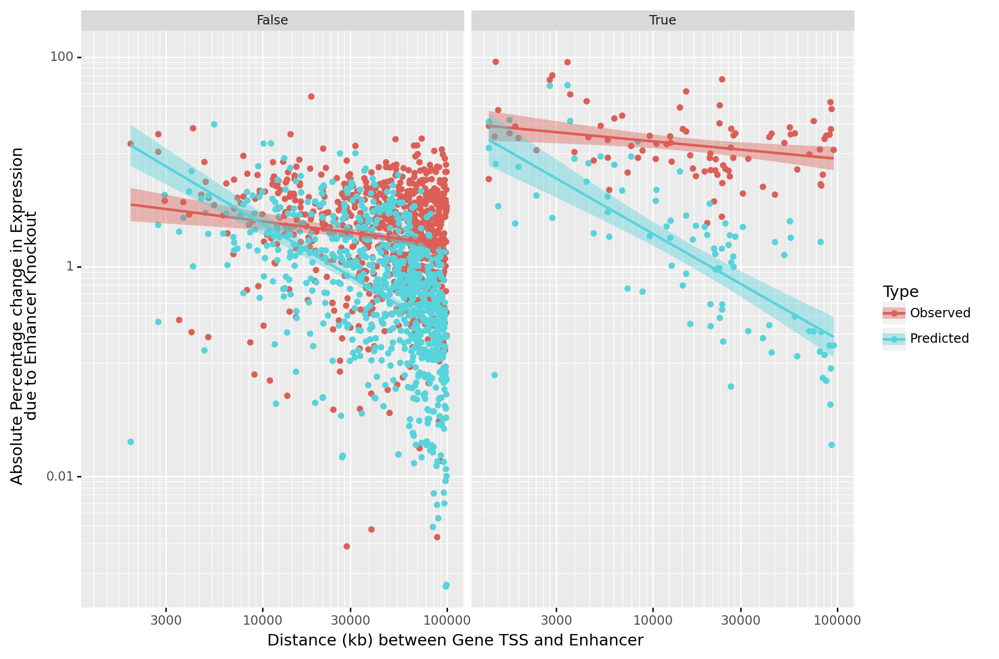

<ggplot: (1440160044819)>

In [178]:
scale = 1.5
p9.options.figure_size = (6.4*scale, 4.8*scale)

(p9.ggplot(data=plot_df_percent_fulco.query('actual_tss_distance < 100000 & actual_tss_distance > 990'),mapping=p9.aes(x="actual_tss_distance",y="value",fill="Type", color="Type"))
 + p9.geom_point()
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 #+ p9.geom_hline(yintercept=10)
 #+ p9.geom_hline(yintercept=2)
 + p9.coord_cartesian(ylim=(-3,2))
 + p9.geom_smooth(method="lm")
 + p9.facet_wrap("~validated")
 + p9.labs(x="Distance (kb) between Gene TSS and Enhancer",y="Absolute Percentage change in Expression\ndue to Enhancer Knockout")
)

### Correlation - Gasperini

In [179]:
gasperini_merged = merged_df.merge(gasperini_df[['ENSG', 'target_gene_short',
       'Diff_expression_test_raw_pval', 'Diff_expression_test_fold_change',
       'Diff_expression_test_Empirical_pval',
       'Diff_expression_test_Empirical_adjusted_pval',
       'high_confidence_subset', 'chr.candidate_enhancer',
       'start.candidate_enhancer', 'stop.candidate_enhancer', 'liftover_coord',
       'ziga_key']], on='ziga_key')

In [180]:
# Here we have data for all supposedly validated enhancers
print(len(merged_df.query('validated and dataset_name == "gasperini2019"')))
print(len(gasperini_merged.query('validated')))

470
470


In [181]:
gasperini_merged['log2_fc_obs'] = np.log2(gasperini_merged['Diff_expression_test_fold_change']) # Proportion remaining transcript of target gene (performed as described in “Method Details: Digital gene expression quantification - Differential expression tests”). 

In [182]:
scipy.stats.pearsonr(gasperini_merged['log2_fc_pred'], gasperini_merged['log2_fc_obs'])

(0.18116646404136008, 7.819417117938347e-05)

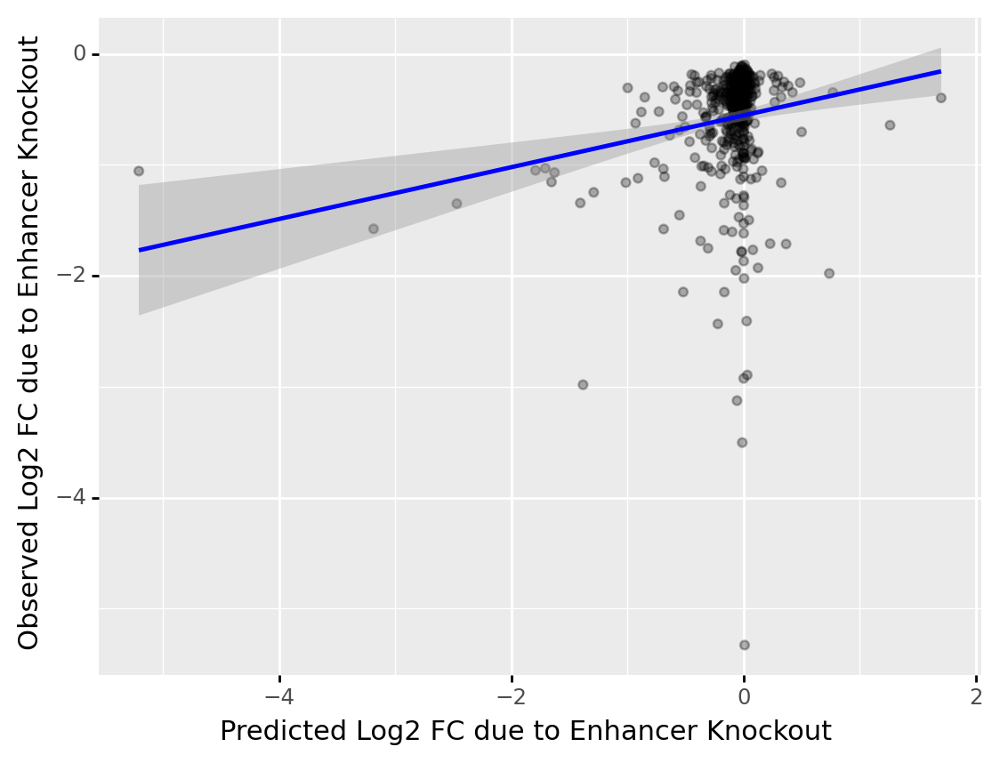

<ggplot: (1440160218682)>

In [183]:
scale = 1.0
p9.options.figure_size = (6.4*scale, 4.8*scale)

(p9.ggplot(data=gasperini_merged,mapping=p9.aes(x="log2_fc_pred",y="log2_fc_obs"))
 + p9.geom_point(alpha=0.3)
 + p9.geom_smooth(method="lm", color="blue")
 + p9.labs(x="Predicted Log2 FC due to Enhancer Knockout",y="Observed Log2 FC due to Enhancer Knockout")
)

In [184]:
max_bin = 4
bins = [0] + gasperini_merged['actual_tss_distance'].quantile(np.array(range(1,max_bin))/max_bin).tolist() + [float('inf')]
#labels = list(range(1,max_bin+1))
labels = ["First quartile","Second quartile","Third quartile","Fourth quartile"]

gasperini_merged['quart_bin'] = pd.cut(gasperini_merged['actual_tss_distance'], bins=bins, right=True, labels=labels, retbins=False, precision=3, include_lowest=False, duplicates='raise', ordered=True)

In [185]:
for pred_bin in ["First quartile","Second quartile","Third quartile","Fourth quartile"]:
    print(pred_bin)
    subset = gasperini_merged.query('quart_bin == @pred_bin')
    print(scipy.stats.pearsonr(subset['log2_fc_pred'], subset['log2_fc_obs']))

First quartile
(0.332587434806943, 0.00023351786353373942)
Second quartile
(0.36961669374680717, 4.108301725028786e-05)
Third quartile
(0.05307240163098508, 0.5698292376183471)
Fourth quartile
(0.15150229389274694, 0.10148747286657975)


In [186]:
subset = gasperini_merged.query('actual_tss_distance < 20_000 & actual_tss_distance > 1000')
print(scipy.stats.pearsonr(subset['log2_fc_pred'], subset['log2_fc_obs']))

(0.30739141324600716, 3.378309037986065e-06)


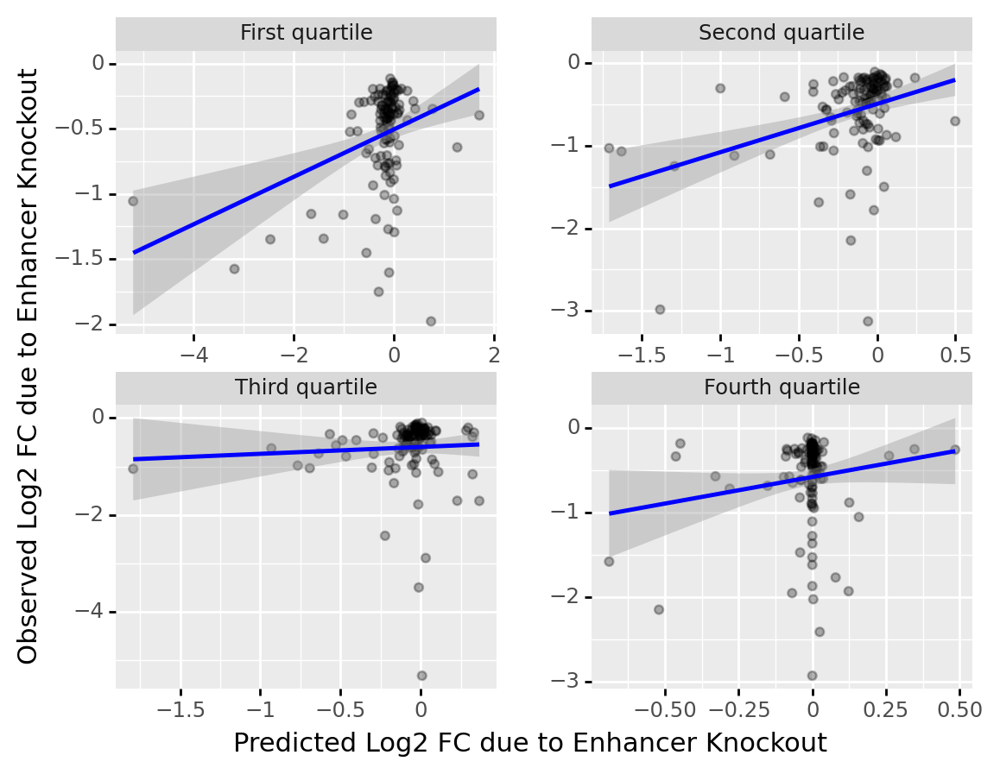

<ggplot: (1440235400491)>

In [187]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

(p9.ggplot(data=gasperini_merged,mapping=p9.aes(x="log2_fc_pred",y="log2_fc_obs"))
 + p9.geom_point(alpha=0.3)
 + p9.geom_smooth(method="lm", color="blue")
 + p9.facet_wrap("~quart_bin", scales="free")
 + p9.theme(subplots_adjust={'hspace': 0.25,'wspace': 0.25})
 + p9.labs(x="Predicted Log2 FC due to Enhancer Knockout",y="Observed Log2 FC due to Enhancer Knockout")
)

### Decay with Distance - Gasperini 

In [188]:
cols = ["ziga_key", "validated", 'actual_tss_distance', 'upstream']

plot_df_gasperini = gasperini_merged.copy()
plot_df_gasperini["Observed"] = np.abs(plot_df_gasperini["log2_fc_obs"])
plot_df_gasperini["Predicted"] = np.abs(plot_df_gasperini["log2_fc_pred"])
plot_df_gasperini["Observed_Percent"] = np.abs(1 - plot_df_gasperini['Diff_expression_test_fold_change'])*100
plot_df_gasperini["Predicted_Percent"] = np.abs(2**plot_df_gasperini["log2_fc_pred"]-1)*100
plot_df_percent_gasperini = (plot_df_gasperini[cols+["Observed_Percent", "Predicted_Percent"]]
                   .rename(columns={"Observed_Percent":"Observed", "Predicted_Percent":"Predicted"})
                   .melt(id_vars=cols, var_name="Type"))

In [189]:
plot_df_percent_nonvalid_gasperini = noise_df.query('dataset_name == "gasperini2019"')[['ziga_key', 'validated', 'actual_tss_distance', 'abs_pct_change', 'upstream']].rename(columns={"abs_pct_change":"value"})
plot_df_percent_nonvalid_gasperini["Type"] = "Predicted"
plot_df_percent_gasperini = pd.concat([plot_df_percent_gasperini,plot_df_percent_nonvalid_gasperini.query('not validated')])

In [190]:
plot_df_percent_gasperini.groupby(['Type','validated'])["value"].median()

Type       validated
Observed   True         24.076394
Predicted  False         1.003654
           True          4.343270
Name: value, dtype: float64

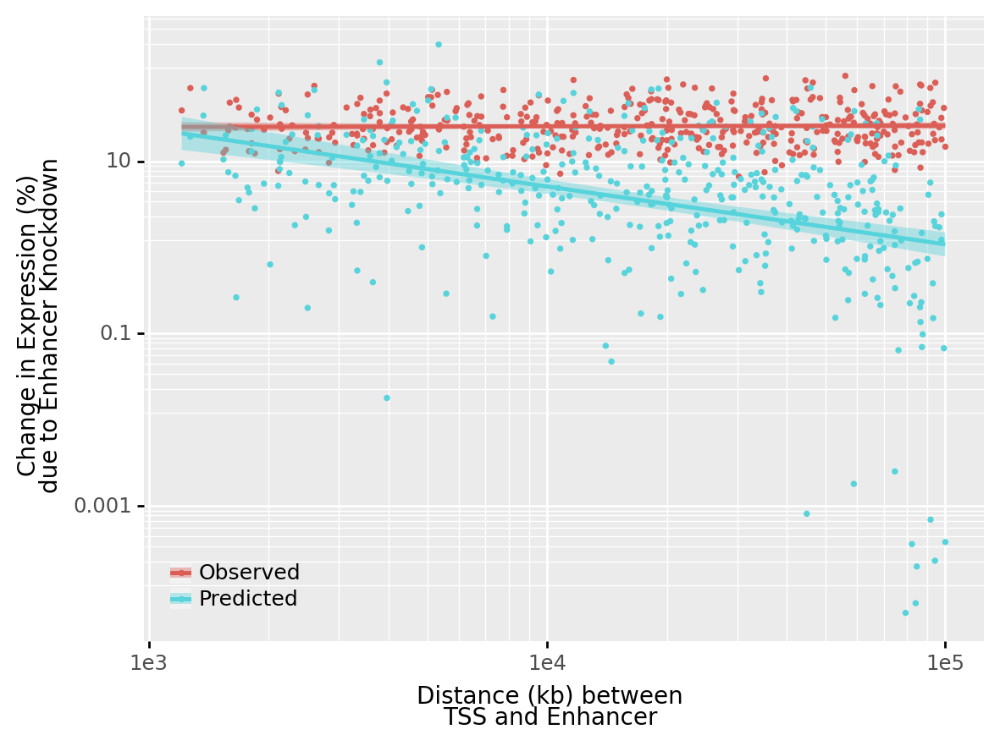

<ggplot: (1440120405640)>

In [191]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=plot_df_percent_gasperini.query('validated & actual_tss_distance < 100000 & actual_tss_distance > 990'),mapping=p9.aes(x="actual_tss_distance",y="value",fill="Type", color="Type"))
 #+ p9.geom_point(data=plot_df_percent_gasperini.query('not validated & actual_tss_distance < 100000 & actual_tss_distance > 500 & Type == "Predicted"'),size=1,alpha=0.05,color="grey",fill='grey')
 + p9.geom_point(size=0.5)
 #+ p9.geom_smooth(data=plot_df_percent_gasperini.query('not validated & actual_tss_distance < 100000 & actual_tss_distance > 500 & Type == "Predicted"'),method="lm", color="black", fill="")
 #+ p9.coords.coord_cartesian(ylim=(-2,2.3))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 #+ p9.geom_hline(yintercept = 3)
 + p9.geom_smooth(method="lm")
 + p9.labs(x="Distance (kb) between\nTSS and Enhancer",y="Change in Expression (%)\ndue to Enhancer Knockdown", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10)
           )
)
p

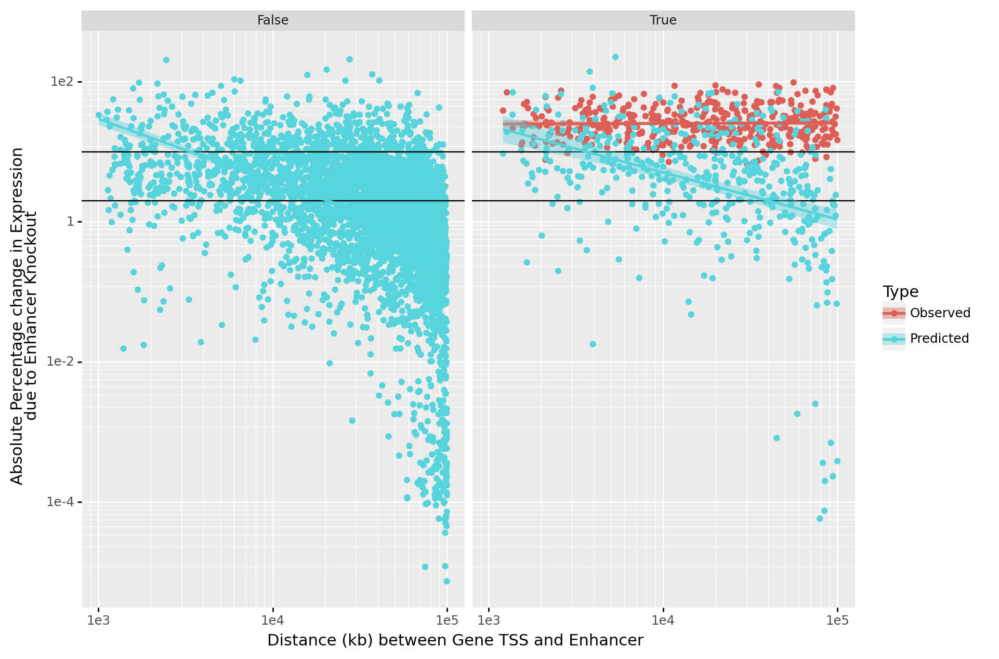

<ggplot: (1440120529893)>

In [192]:
scale = 1.5
p9.options.figure_size = (6.4*scale, 4.8*scale)

(p9.ggplot(data=plot_df_percent_gasperini.query('actual_tss_distance < 100000  & actual_tss_distance > 990'),mapping=p9.aes(x="actual_tss_distance",y="value",fill="Type", color="Type"))
 + p9.geom_point()
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 + p9.geom_hline(yintercept=10)
 + p9.geom_hline(yintercept=2)
 + p9.geom_smooth(method="lm")
 + p9.facet_wrap("~validated")
 + p9.labs(x="Distance (kb) between Gene TSS and Enhancer",y="Absolute Percentage change in Expression\ndue to Enhancer Knockout")
)

In [193]:
#p.save("Graphics/" + "distal_gasperini" + ".svg", width=2.6, height=2.9, dpi=300)

In [194]:
#p.save("Graphics/" + "xsup_distal_gasperini" + ".svg", width=6.4, height=4.8, dpi=300)

### Median effect

In [195]:
fulco_pct = plot_df_percent_fulco.drop(columns="fulco_key")
fulco_pct["dataset"] = "Fulco"
gasperini_pct = plot_df_percent_gasperini
gasperini_pct["dataset"] = "Gasperini"

plot_df_percent = pd.concat([fulco_pct,gasperini_pct])

In [196]:
# all
print(np.sum(plot_df_percent.query('actual_tss_distance < 100_000 & actual_tss_distance > 990 & Type == "Observed"')["validated"]))
print(plot_df_percent.query('actual_tss_distance < 100_000 & actual_tss_distance > 990').groupby(['validated','Type'])['value'].min())
print(plot_df_percent.query('actual_tss_distance < 100_000 & actual_tss_distance > 990').groupby(['validated','Type'])['value'].median())
print(plot_df_percent.query('actual_tss_distance < 100_000 & actual_tss_distance > 990').groupby(['validated','Type'])['value'].max())
# only distal
print("> 10kb")
print(plot_df_percent.query('actual_tss_distance < 100_000 & actual_tss_distance > 9999').groupby(['validated','Type'])['value'].median())

522
validated  Type     
False      Observed     0.002154
           Predicted    0.000007
True       Observed     2.608724
           Predicted    0.000058
Name: value, dtype: float64
validated  Type     
False      Observed      2.467223
           Predicted     1.468814
True       Observed     22.056936
           Predicted     4.066988
Name: value, dtype: float64
validated  Type     
False      Observed      42.000000
           Predicted    208.718029
True       Observed      97.512303
           Predicted    224.938846
Name: value, dtype: float64
> 10kb
validated  Type     
False      Observed      2.409788
           Predicted     1.265617
True       Observed     21.718717
           Predicted     2.537097
Name: value, dtype: float64


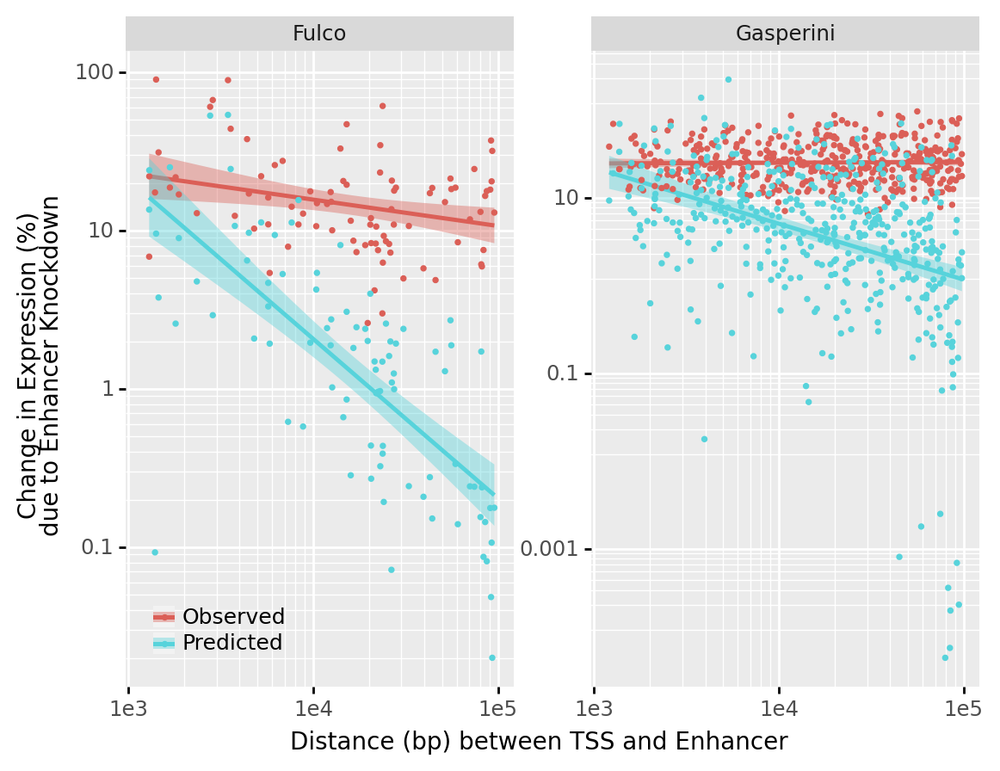

<ggplot: (1440120633914)>

In [197]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=plot_df_percent.query('validated & actual_tss_distance < 98_000 & actual_tss_distance > 999')
           ,mapping=p9.aes(x="actual_tss_distance",y="value",fill="Type", color="Type"))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 + p9.geom_smooth(method="lm")
 #+ p9.geom_hline(yintercept=5)
 + p9.facet_wrap('~dataset',scales="free_y")
 + p9.geom_point(size=0.5)
 + p9.labs(x="Distance (bp) between TSS and Enhancer",y="Change in Expression (%)\ndue to Enhancer Knockdown", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.2}
           )
)
p

In [227]:
plot_df_percent_sat = plot_df_percent.copy()
plot_df_percent_sat["value_sat"] = plot_df_percent_sat["value"].apply(lambda x: x if (x > 0.1 and x < 100) else (0.1 if x <= 0.1 else 100))
plot_df_percent_sat["idx_sat"] = plot_df_percent_sat["value"].apply(lambda x: "Truncated" if (x <= 0.1 or x >= 100) else "")

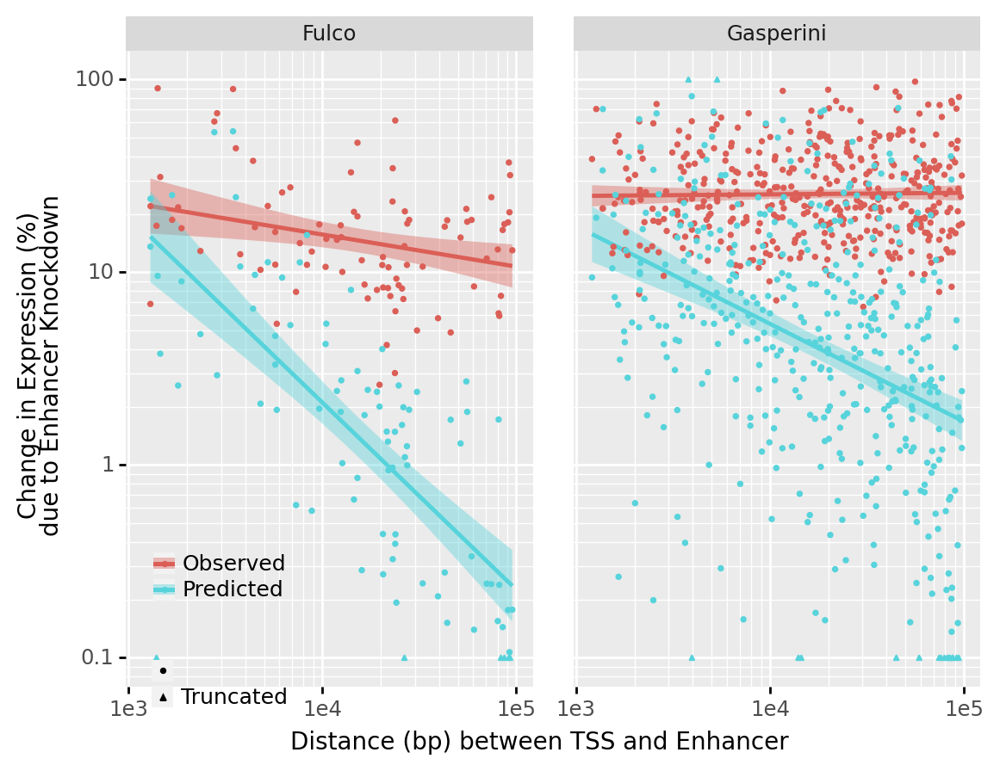

<ggplot: (1440119480483)>

In [231]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=plot_df_percent_sat.query('validated & actual_tss_distance < 98_000 & actual_tss_distance > 999')
           ,mapping=p9.aes(x="actual_tss_distance",y="value_sat"))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 + p9.geom_smooth(method="lm",mapping=p9.aes(fill="Type", color="Type"))
 #+ p9.geom_hline(yintercept=5)
 + p9.facet_wrap('~dataset')#,scales="free_y")
 + p9.geom_point(size=0.5, mapping=p9.aes(fill="Type", color="Type",shape="idx_sat"))
 + p9.labs(x="Distance (bp) between TSS and Enhancer",y="Change in Expression (%)\ndue to Enhancer Knockdown", color="", fill="",shape="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.1}
           )
)
p

In [232]:
p.save("Graphics/" + "enhancer_crispr" + ".svg", width=6.5, height=2.9, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.5 x 2.9 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/enhancer_crispr.svg


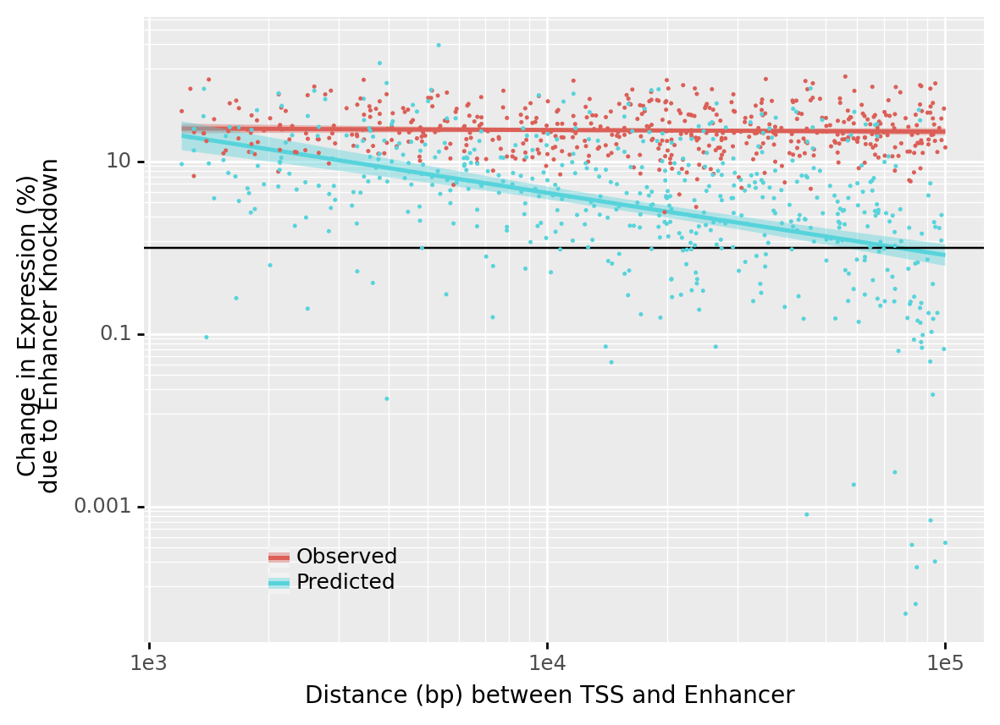

<ggplot: (1460315839470)>

In [117]:
p = (p9.ggplot(data=plot_df_percent.query('validated & actual_tss_distance < 100_000 & actual_tss_distance > 999')
           ,mapping=p9.aes(x="actual_tss_distance",y="value",fill="Type", color="Type"))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 + p9.geom_smooth(method="lm")
 #+ p9.facet_wrap('~dataset')
 + p9.geom_hline(yintercept=1)
 + p9.geom_point(size=0.02)
 + p9.labs(x="Distance (bp) between TSS and Enhancer",y="Change in Expression (%)\ndue to Enhancer Knockdown", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.3,0.22),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.05}
           )
)
p

In [118]:
#p.save("Graphics/" + "distal_enhancer" + ".svg", width=2.6, height=2.9, dpi=300)

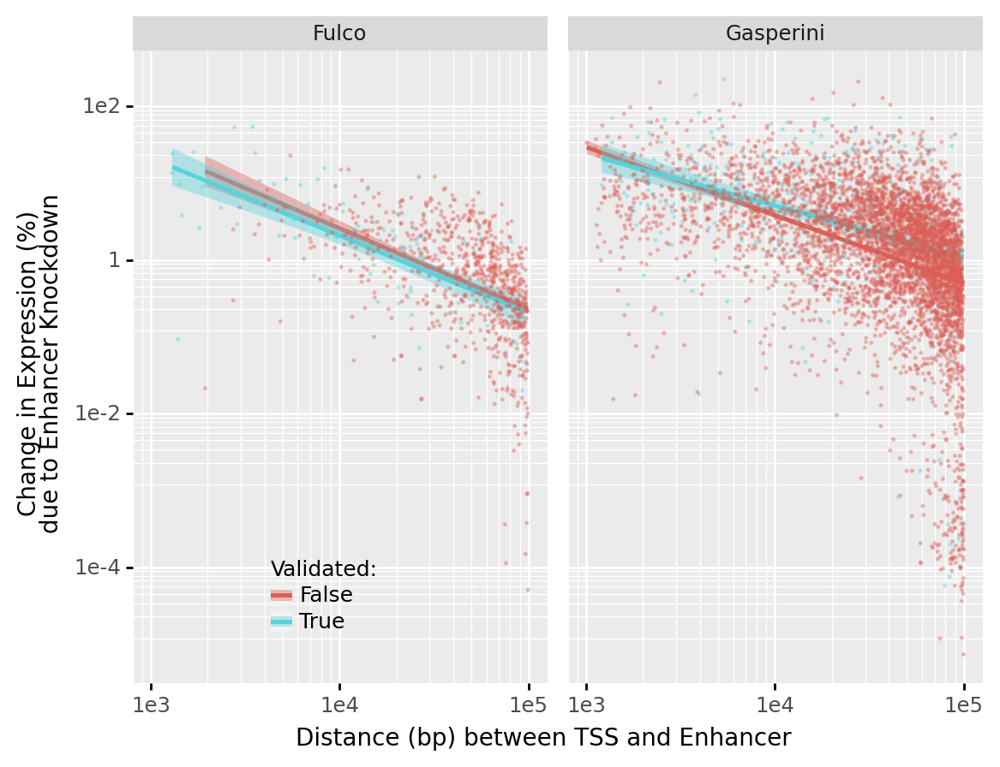

<ggplot: (1460315847696)>

In [119]:
p = (p9.ggplot(data=plot_df_percent.query('Type == "Predicted" & actual_tss_distance < 100_000 & actual_tss_distance > 999')
           ,mapping=p9.aes(x="actual_tss_distance",y="value",fill="validated", color="validated"))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 + p9.geom_smooth(method="lm")
 + p9.facet_wrap('~dataset')
 #+ p9.geom_hline(yintercept=1)
 + p9.geom_point(size=0.1, alpha=0.3, raster=True)
 + p9.labs(x="Distance (bp) between TSS and Enhancer",y="Change in Expression (%)\ndue to Enhancer Knockdown", color="Validated:", fill="Validated:")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_title=p9.element_text(size=9),
            legend_position=(0.3,0.22),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.05}
           )
)
p

In [120]:
p.save("Graphics/" + "supfig_enhancer_nonvalid" + ".svg", width=6.4, height=4.8, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.4 x 4.8 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/supfig_enhancer_nonvalid.svg


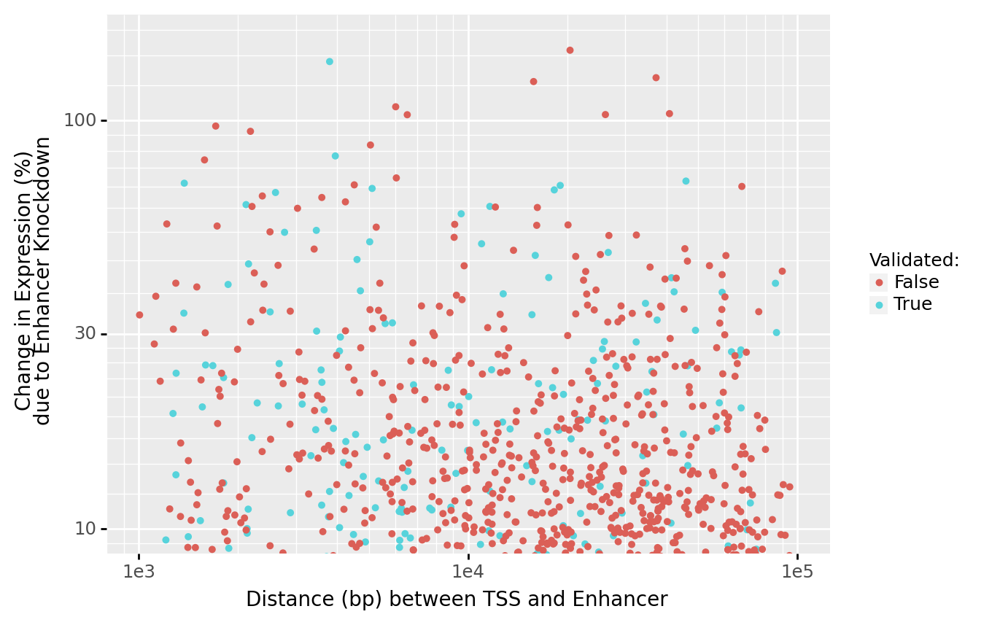

<ggplot: (1460299430364)>

In [121]:
p = (p9.ggplot(data=plot_df_percent.query('Type == "Predicted" & actual_tss_distance < 100_000 & actual_tss_distance > 999')
           ,mapping=p9.aes(x="actual_tss_distance",y="value",fill="validated", color="validated"))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 #+ p9.geom_smooth(method="lm")
 #+ p9.facet_wrap('~dataset')
 + p9.coord_cartesian(ylim=(1,2.2))
 #+ p9.geom_hline(yintercept=1)
 + p9.geom_point(size=1, alpha=1, raster=True)
 + p9.labs(x="Distance (bp) between TSS and Enhancer",y="Change in Expression (%)\ndue to Enhancer Knockdown", color="Validated:", fill="Validated:")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_title=p9.element_text(size=9),
            #legend_position=(0.3,0.22),
            legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.05}
           )
)
p

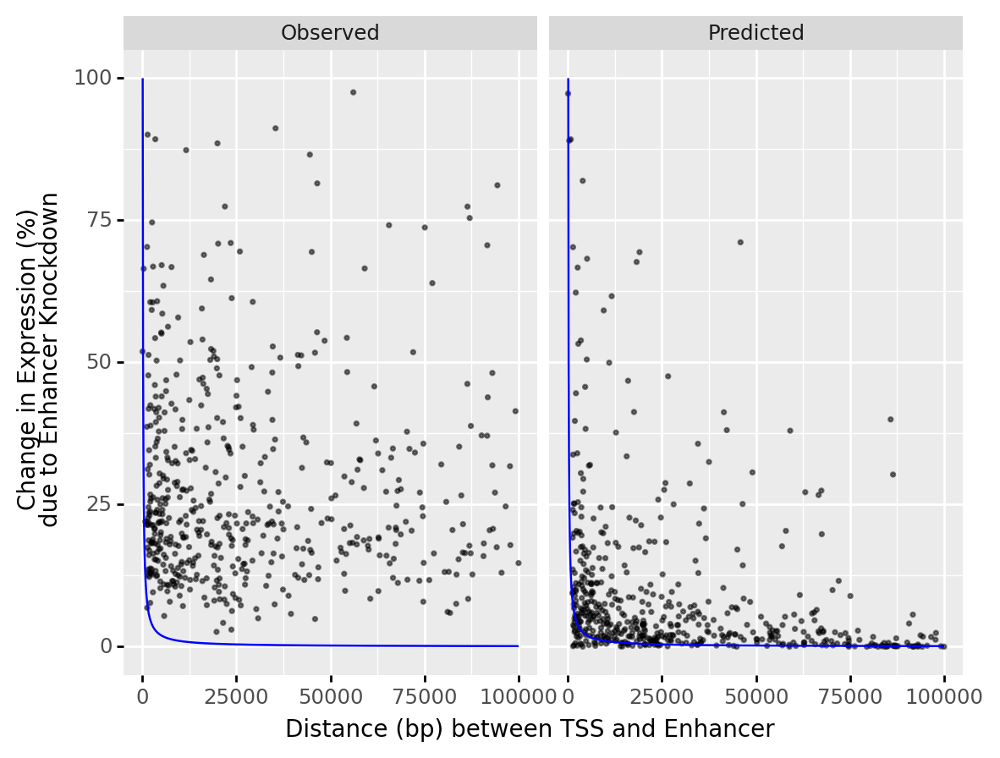

<ggplot: (1460299529524)>

In [122]:
a = 100*100#10**4.4608
k = 1
#a = 10**3.5296
#k = 0.7222
exp_line = pd.DataFrame({"x":np.linspace(100,100_000,1000),
                         "y":a*(1/(np.linspace(100,100_000,1000)))})

scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=(plot_df_percent
                     .query('validated & actual_tss_distance < 100_000')
                    )
           ,mapping=p9.aes(x="actual_tss_distance",y="value"))#,fill="Type", color="Type"))
 #+ p9.scale_y_log10()
 #+ p9.scale_x_log10()
 #+ p9.geom_smooth()
 #+ p9.facet_wrap('~dataset')
 + p9.geom_point(size=0.5, alpha=0.5)
 + p9.geom_line(data=exp_line, mapping=p9.aes(x="x",y="y"),color="blue")
 + p9.facet_wrap('~Type')
 + p9.coord_cartesian(ylim=(0,100))
 + p9.labs(x="Distance (bp) between TSS and Enhancer",y="Change in Expression (%)\ndue to Enhancer Knockdown", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10)
           )
)
p

### Impact of basal expression

In [123]:
promoter_effect = merged_df[["ziga_key","chromosome","main_tss_start","main_tss_end","log2_fc_pred","actual_tss_distance", "validated", pred_col+"_ref",pred_col+"_alt", "dataset_name"]]
promoter_effect["id"] = (promoter_effect["chromosome"] + "_" + ((promoter_effect["main_tss_start"] + promoter_effect["main_tss_end"])/2).astype('int').astype('str') + "_" + "promoter")
promoter_effect = promoter_effect.merge(local_results,on="id")
promoter_effect["abs_log2_fc_pred"] = np.abs(promoter_effect["log2_fc_pred"])
promoter_effect["abs_pct_change"] = np.abs(2**promoter_effect["log2_fc_pred"] - 1)*100
promoter_effect["basal"] = 2**promoter_effect[pred_col+"_ref"] - 1
promoter_effect["alt"] = 2**promoter_effect[pred_col+"_alt"] - 1
promoter_effect['delta'] = np.abs(promoter_effect["alt"] - promoter_effect["basal"])

/scratch/tmp/karollus/ipykernel_163395/2427637665.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


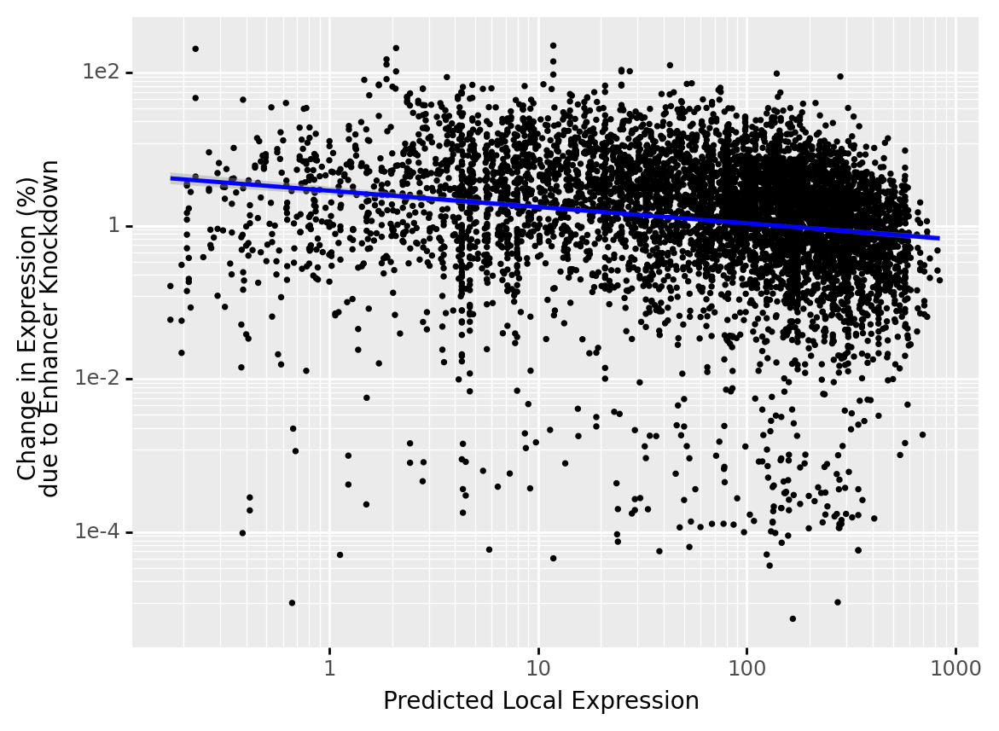

<ggplot: (1460297739289)>

In [124]:
p = (p9.ggplot(data=promoter_effect.query('actual_tss_distance < 100000 & actual_tss_distance > 990'),
               mapping=p9.aes(x=pred_col,y="abs_pct_change"))
 #+ p9.geom_point(data=plot_df_percent_gasperini.query('not validated & actual_tss_distance < 100000 & actual_tss_distance > 500 & Type == "Predicted"'),size=1,alpha=0.05,color="grey",fill='grey')
 + p9.geom_point(size=0.5)
 #+ p9.geom_smooth(data=plot_df_percent_gasperini.query('not validated & actual_tss_distance < 100000 & actual_tss_distance > 500 & Type == "Predicted"'),method="lm", color="black", fill="")
 #+ p9.coords.coord_cartesian(ylim=(-2,2.3))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 #+ p9.geom_hline(yintercept = 3)
 + p9.geom_smooth(method="lm",color="blue")
 + p9.labs(x="Predicted Local Expression",y="Change in Expression (%)\ndue to Enhancer Knockdown", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10)
           )
)
p

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/stats/smoothers.py:310: PlotnineWarning: Confidence intervals are not yet implementedfor lowess smoothings.


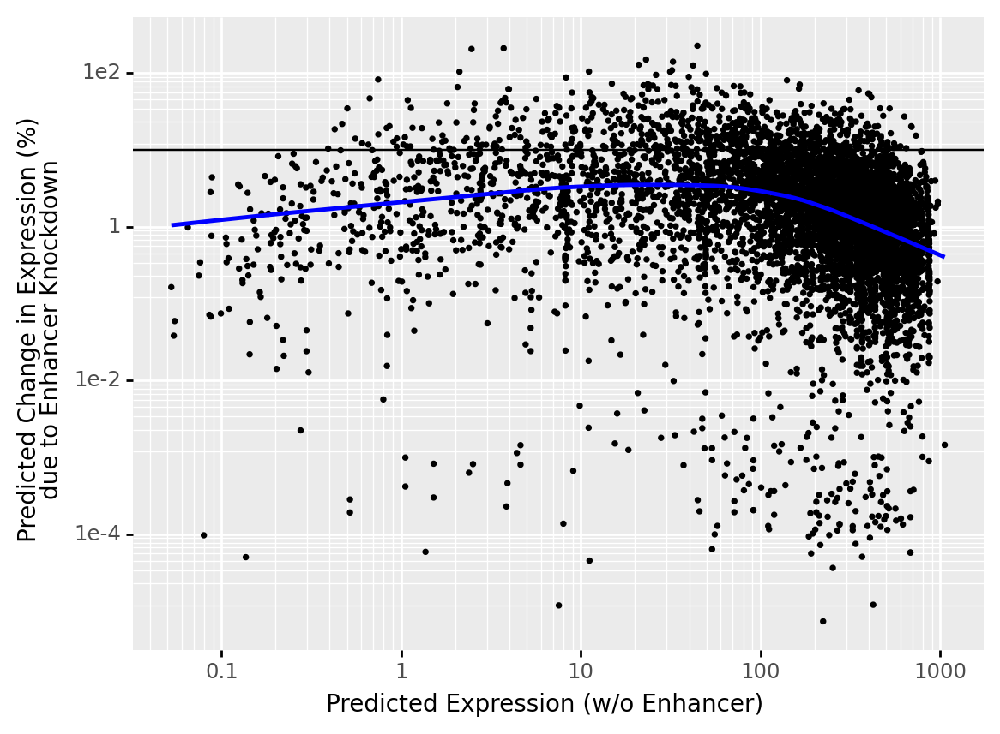

<ggplot: (1460524835407)>

In [125]:
p = (p9.ggplot(data=promoter_effect.query('actual_tss_distance < 100_000 and actual_tss_distance > 990'),
               mapping=p9.aes(x="alt",y="abs_pct_change"))
 #+ p9.geom_point(data=plot_df_percent_gasperini.query('not validated & actual_tss_distance < 100000 & actual_tss_distance > 500 & Type == "Predicted"'),size=1,alpha=0.05,color="grey",fill='grey')
 + p9.geom_point(size=0.5)
 #+ p9.geom_smooth(data=plot_df_percent_gasperini.query('not validated & actual_tss_distance < 100000 & actual_tss_distance > 500 & Type == "Predicted"'),method="lm", color="black", fill="")
 #+ p9.coords.coord_cartesian(ylim=(-2,2.3))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 + p9.geom_hline(yintercept = 10)
 + p9.geom_smooth(color="blue",method="lowess")#,method="lm")
 + p9.labs(x="Predicted Expression (w/o Enhancer)",y="Predicted Change in Expression (%)\ndue to Enhancer Knockdown", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10)
           )
)
p

In [126]:
p.save("Graphics/" + "supfig_enhancer_promrelative" + ".svg", width=6.4, height=4.8, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.4 x 4.8 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/supfig_enhancer_promrelative.svg
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/stats/smoothers.py:310: PlotnineWarning: Confidence intervals are not yet implementedfor lowess smoothings.


/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/stats/smoothers.py:310: PlotnineWarning: Confidence intervals are not yet implementedfor lowess smoothings.


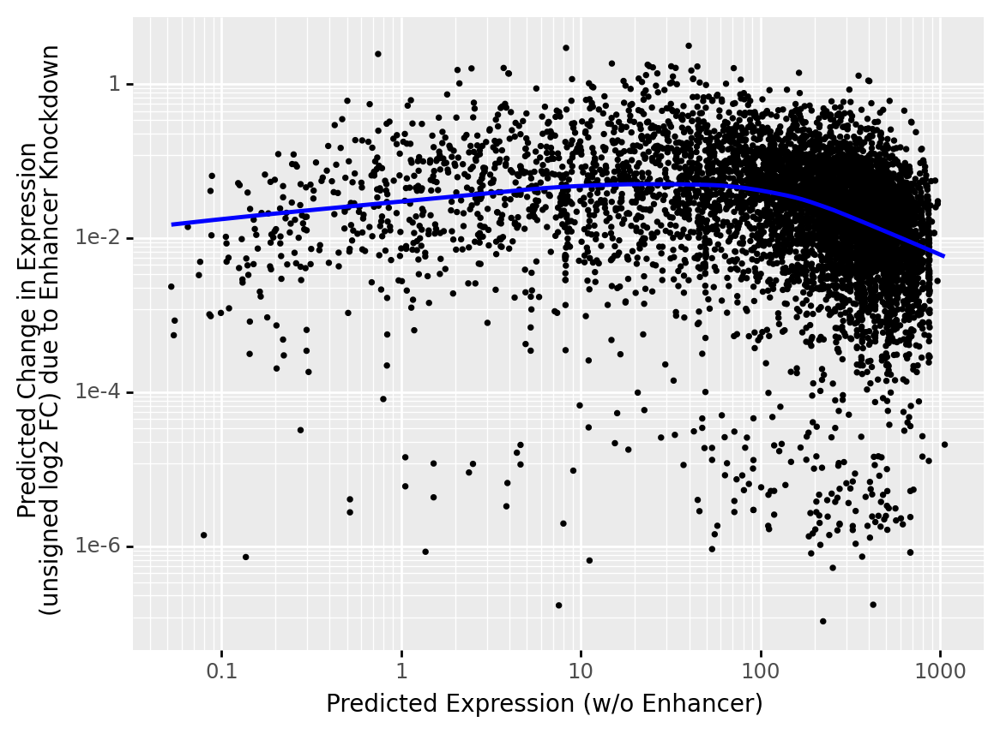

<ggplot: (1460419336494)>

In [127]:
p = (p9.ggplot(data=promoter_effect.query('actual_tss_distance < 100_000 and actual_tss_distance > 990'),
               mapping=p9.aes(x="alt",y="abs_log2_fc_pred"))
 #+ p9.geom_point(data=plot_df_percent_gasperini.query('not validated & actual_tss_distance < 100000 & actual_tss_distance > 500 & Type == "Predicted"'),size=1,alpha=0.05,color="grey",fill='grey')
 + p9.geom_point(size=0.5)
 #+ p9.geom_smooth(data=plot_df_percent_gasperini.query('not validated & actual_tss_distance < 100000 & actual_tss_distance > 500 & Type == "Predicted"'),method="lm", color="black", fill="")
 #+ p9.coords.coord_cartesian(ylim=(-2,2.3))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 #+ p9.geom_hline(yintercept = 10)
 + p9.geom_smooth(color="blue",method="lowess")#,method="lm")
 + p9.labs(x="Predicted Expression (w/o Enhancer)",y="Predicted Change in Expression\n(unsigned log2 FC) due to Enhancer Knockdown", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10)
           )
)
p

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/stats/smoothers.py:310: PlotnineWarning: Confidence intervals are not yet implementedfor lowess smoothings.


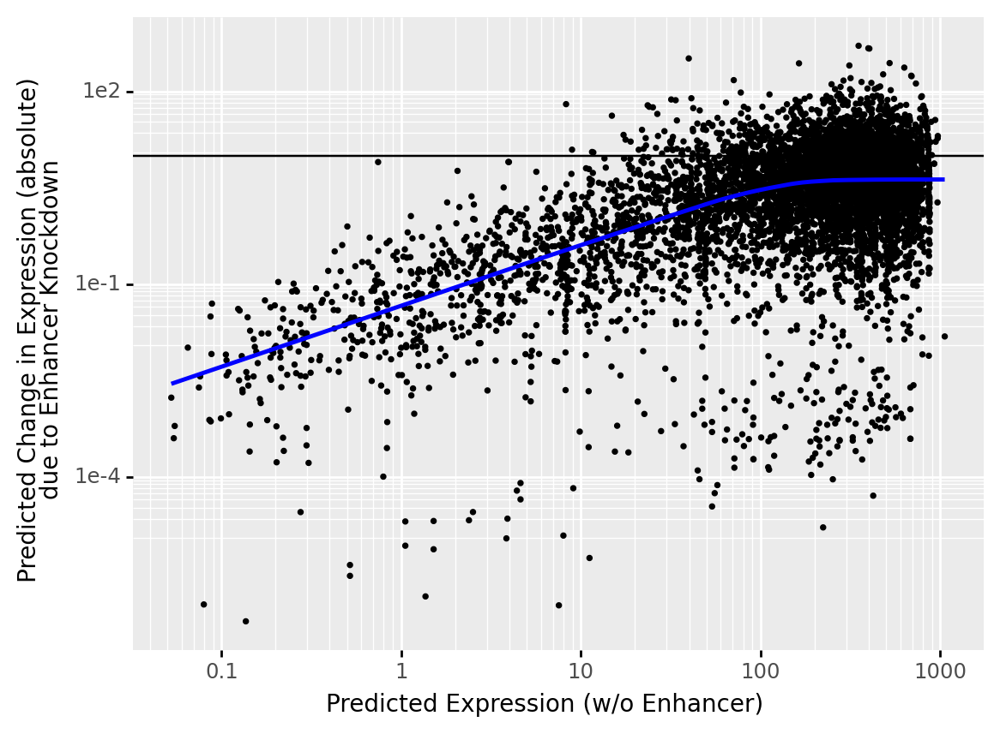

<ggplot: (1460322531422)>

In [128]:
p = (p9.ggplot(data=promoter_effect.query('actual_tss_distance < 100_000 and actual_tss_distance > 990'),
               mapping=p9.aes(x="alt",y="delta"))
 #+ p9.geom_point(data=plot_df_percent_gasperini.query('not validated & actual_tss_distance < 100000 & actual_tss_distance > 500 & Type == "Predicted"'),size=1,alpha=0.05,color="grey",fill='grey')
 + p9.geom_point(size=0.5)
 #+ p9.geom_smooth(data=plot_df_percent_gasperini.query('not validated & actual_tss_distance < 100000 & actual_tss_distance > 500 & Type == "Predicted"'),method="lm", color="black", fill="")
 #+ p9.coords.coord_cartesian(ylim=(-2,2.3))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 + p9.geom_hline(yintercept = 10)
 + p9.geom_smooth(color="blue",method="lowess")#,method="lm")
 + p9.labs(x="Predicted Expression (w/o Enhancer)",y="Predicted Change in Expression (absolute)\ndue to Enhancer Knockdown", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10)
           )
)
p

In [129]:
p.save("Graphics/" + "supfig_enhancer_promabsolute" + ".svg", width=6.4, height=4.8, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.4 x 4.8 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/supfig_enhancer_promabsolute.svg
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/stats/smoothers.py:310: PlotnineWarning: Confidence intervals are not yet implementedfor lowess smoothings.


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

Not Validated v.s. Validated: Mann-Whitney-Wilcoxon test two-sided, P_val=4.393e-03 U_stat=1.520e+06


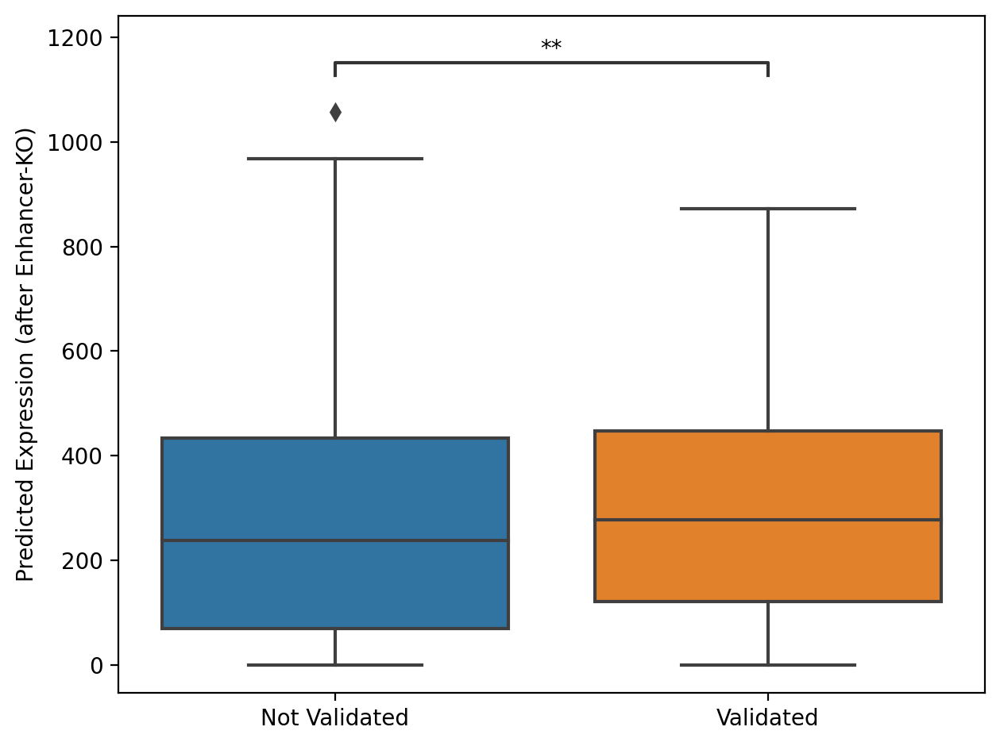

In [130]:

dims = (6.4, 4.8)
statplot_df = promoter_effect.query('actual_tss_distance < 100_000 and actual_tss_distance > 990').copy()
statplot_df["validated"] = statplot_df["validated"].apply(lambda x: "Validated" if x else "Not Validated")
x = "validated"
y = "alt"
#hue = "Motif_count"
box_pairs=[
    ("Validated", "Not Validated")
    ]
fig, ax = plt.subplots(figsize=dims, dpi=100)
ax = sns.boxplot(data=statplot_df, x=x, y=y, #hue=hue
                )
#plt.legend(bbox_to_anchor=(1, 0.5), title="Motif_count")
statannot.add_stat_annotation(ax, data=statplot_df, x=x, y=y, #hue=hue, 
                              box_pairs=box_pairs, comparisons_correction=None,
                    test='Mann-Whitney', loc='inside',  verbose=2)

ax.set_xlabel("",fontsize=10, color="black")
ax.set_ylabel("Predicted Expression (after Enhancer-KO)",fontsize=10, color="black")
#plt.legend(bbox_to_anchor=(1, 0.5), title="Motif_count")
#plt.setp(ax.get_legend().get_title(), fontsize='10')
#plt.setp(ax.get_legend().get_texts(), fontsize='10')
ax.tick_params(labelsize=10)
plt.tight_layout()
fig.savefig("Graphics/" + "supfig_enhancer_basalvalid" + ".svg")

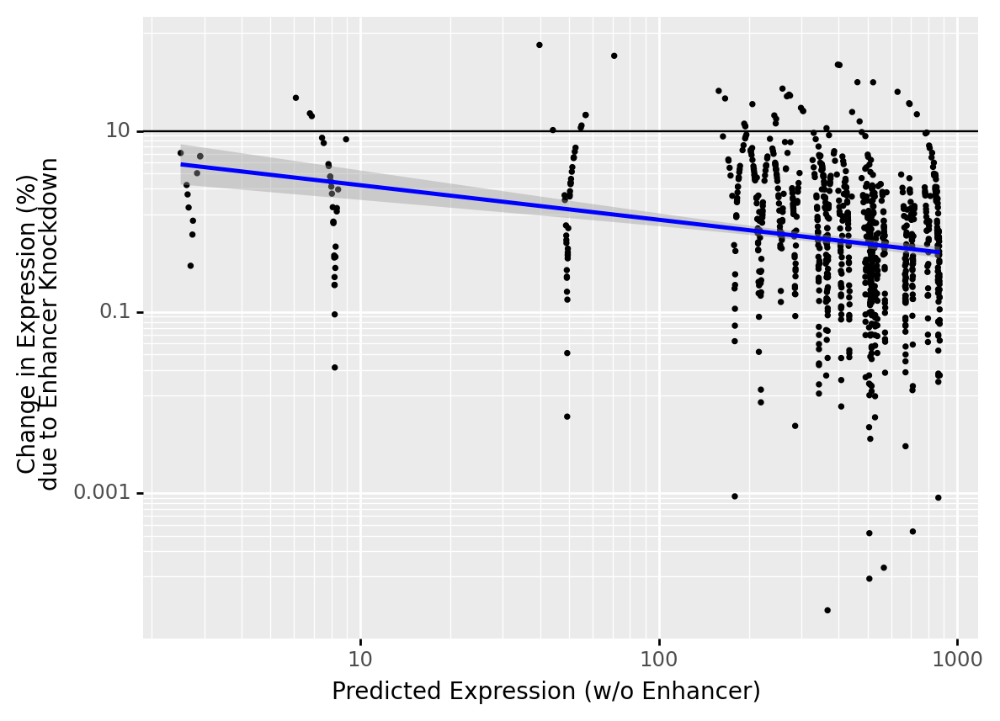

<ggplot: (1460387286456)>

In [131]:
p = (p9.ggplot(data=promoter_effect.query('actual_tss_distance < 100_000 and actual_tss_distance > 990 & dataset_name == "fulco2019"'),
               mapping=p9.aes(x="alt",y="abs_pct_change"))
 #+ p9.geom_point(data=plot_df_percent_gasperini.query('not validated & actual_tss_distance < 100000 & actual_tss_distance > 500 & Type == "Predicted"'),size=1,alpha=0.05,color="grey",fill='grey')
 + p9.geom_point(size=0.5)
 #+ p9.geom_smooth(data=plot_df_percent_gasperini.query('not validated & actual_tss_distance < 100000 & actual_tss_distance > 500 & Type == "Predicted"'),method="lm", color="black", fill="")
 #+ p9.coords.coord_cartesian(ylim=(-2,2.3))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 + p9.geom_hline(yintercept = 10)
 + p9.geom_smooth(color="blue",method="lm")
 + p9.labs(x="Predicted Expression (w/o Enhancer)",y="Change in Expression (%)\ndue to Enhancer Knockdown", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10)
           )
)
p

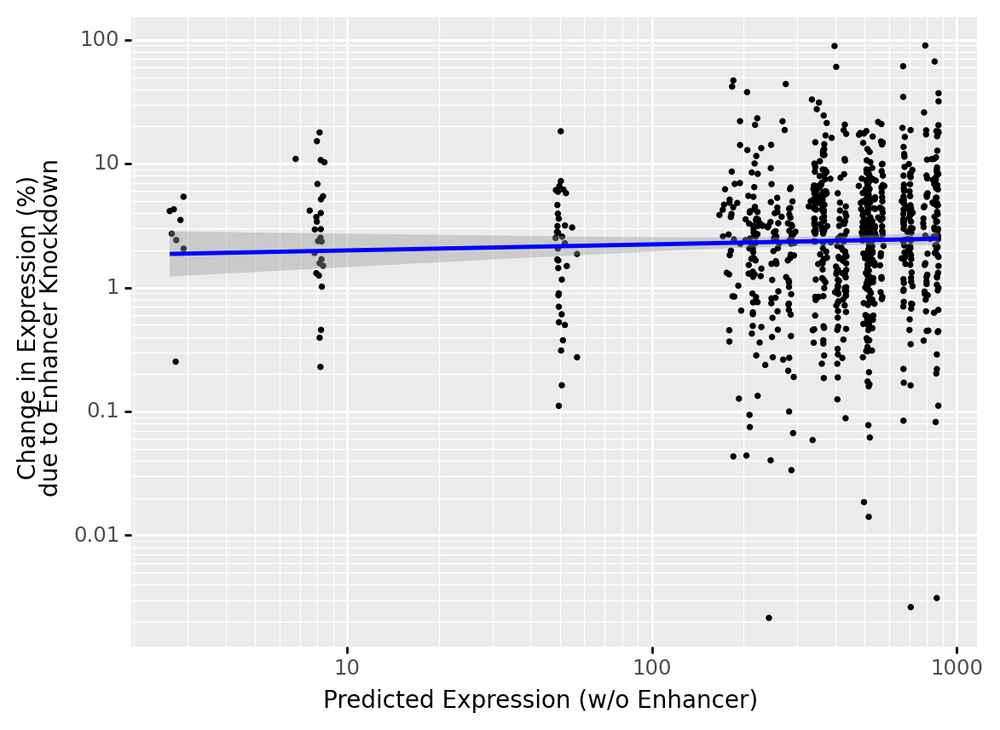

<ggplot: (1460299835314)>

In [132]:
plot_df_promoter = plot_df_percent.merge(promoter_effect[["ziga_key",pred_col,"alt"]], on="ziga_key")

p = (p9.ggplot(data=plot_df_promoter.query('actual_tss_distance < 100000 & actual_tss_distance > 999 & Type == "Observed" & dataset == "Fulco"'),
               mapping=p9.aes(x="alt",y="value"))
 #+ p9.geom_point(data=plot_df_percent_gasperini.query('not validated & actual_tss_distance < 100000 & actual_tss_distance > 500 & Type == "Predicted"'),size=1,alpha=0.05,color="grey",fill='grey')
 + p9.geom_point(size=0.5)
 #+ p9.geom_smooth(data=plot_df_percent_gasperini.query('not validated & actual_tss_distance < 100000 & actual_tss_distance > 500 & Type == "Predicted"'),method="lm", color="black", fill="")
 #+ p9.coords.coord_cartesian(ylim=(-2,2.3))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 #+ p9.geom_hline(yintercept = 3)
 + p9.geom_smooth(method="lm",color="blue")
 + p9.labs(x="Predicted Expression (w/o Enhancer)",y="Change in Expression (%)\ndue to Enhancer Knockdown", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10)
           )
)
p

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/stats/smoothers.py:310: PlotnineWarning: Confidence intervals are not yet implementedfor lowess smoothings.


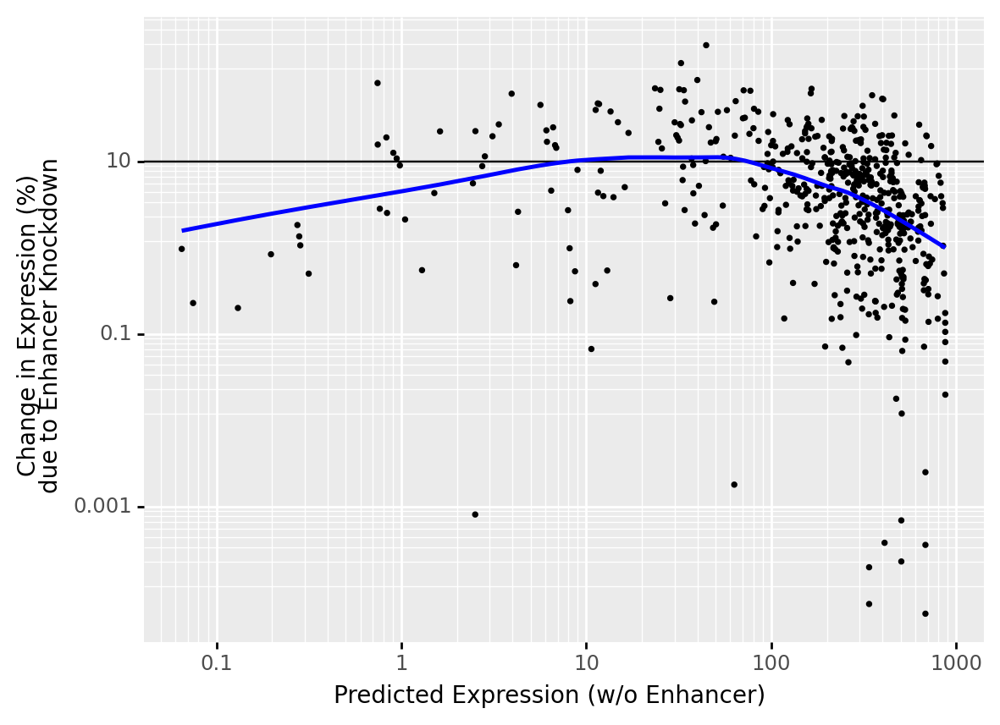

<ggplot: (1460312926717)>

In [133]:
p = (p9.ggplot(data=promoter_effect.query('actual_tss_distance < 100_000 and actual_tss_distance > 990 & validated'),
               mapping=p9.aes(x="alt",y="abs_pct_change"))
 #+ p9.geom_point(data=plot_df_percent_gasperini.query('not validated & actual_tss_distance < 100000 & actual_tss_distance > 500 & Type == "Predicted"'),size=1,alpha=0.05,color="grey",fill='grey')
 + p9.geom_point(size=0.5)
 #+ p9.geom_smooth(data=plot_df_percent_gasperini.query('not validated & actual_tss_distance < 100000 & actual_tss_distance > 500 & Type == "Predicted"'),method="lm", color="black", fill="")
 #+ p9.coords.coord_cartesian(ylim=(-2,2.3))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 + p9.geom_hline(yintercept = 10)
 + p9.geom_smooth(color="blue",method="lowess")#,method="lm")
 + p9.labs(x="Predicted Expression (w/o Enhancer)",y="Change in Expression (%)\ndue to Enhancer Knockdown", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10)
           )
)
p

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/stats/smoothers.py:310: PlotnineWarning: Confidence intervals are not yet implementedfor lowess smoothings.


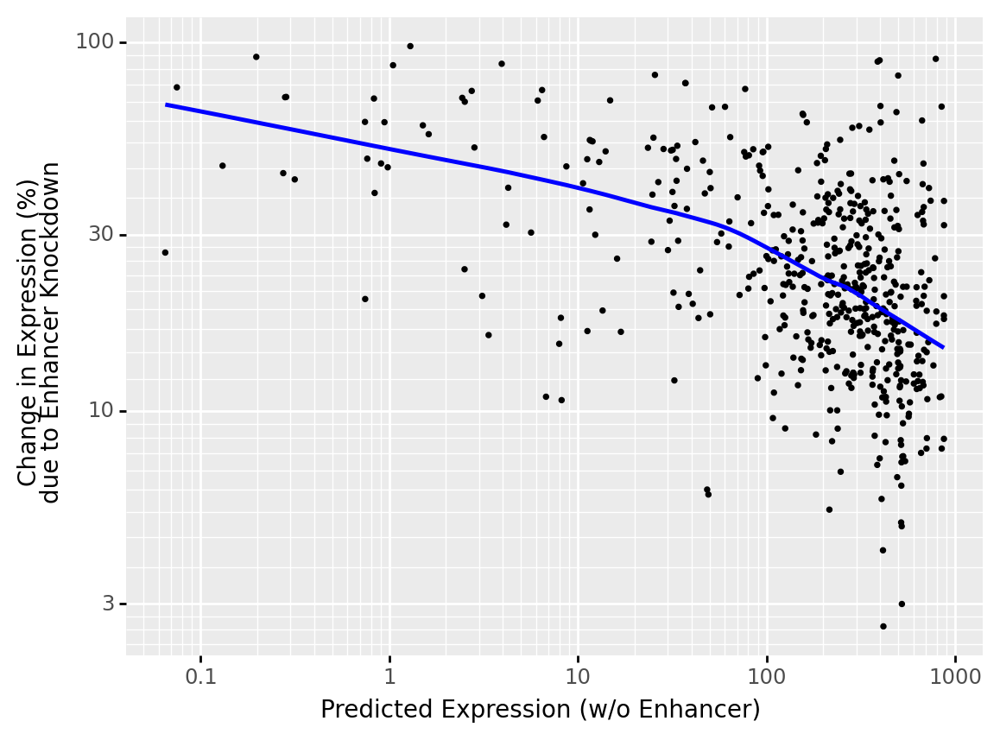

<ggplot: (1460314153174)>

In [134]:
plot_df_promoter = plot_df_percent.merge(promoter_effect[["ziga_key",pred_col,"alt"]], on="ziga_key")

p = (p9.ggplot(data=plot_df_promoter.query('actual_tss_distance < 100000 & actual_tss_distance > 999 & Type == "Observed" & validated'),
               mapping=p9.aes(x="alt",y="value"))
 #+ p9.geom_point(data=plot_df_percent_gasperini.query('not validated & actual_tss_distance < 100000 & actual_tss_distance > 500 & Type == "Predicted"'),size=1,alpha=0.05,color="grey",fill='grey')
 + p9.geom_point(size=0.5)
 #+ p9.geom_smooth(data=plot_df_percent_gasperini.query('not validated & actual_tss_distance < 100000 & actual_tss_distance > 500 & Type == "Predicted"'),method="lm", color="black", fill="")
 #+ p9.coords.coord_cartesian(ylim=(-2,2.3))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 #+ p9.geom_hline(yintercept = 3)
 + p9.geom_smooth(method="lowess",color="blue")
 + p9.labs(x="Predicted Expression (w/o Enhancer)",y="Change in Expression (%)\ndue to Enhancer Knockdown", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10)
           )
)
p

In [135]:
promoter_effect["log_dist"] = np.log10(promoter_effect["actual_tss_distance"])
promoter_effect["log_prom"] = np.log10(promoter_effect[pred_col]+1)
promoter_effect["log_pct"] = np.log10(promoter_effect["abs_pct_change"] + 0.001)

In [136]:
ols_dist_promoter = (statsmodels.regression.linear_model.OLS
                  .from_formula('log_pct ~ log_dist + log_prom + validated',
                                data=(promoter_effect
                                      .query('actual_tss_distance < 100_000 & actual_tss_distance > 999')))
                  )
res_ols_dist_promoter = ols_dist_promoter.fit()

res_ols_dist_promoter.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                log_pct   R-squared:                       0.249
Model:                            OLS   Adj. R-squared:                  0.248
Method:                 Least Squares   F-statistic:                     704.8
Date:                Sat, 03 Sep 2022   Prob (F-statistic):               0.00
Time:                        17:28:35   Log-Likelihood:                -7007.6
No. Observations:                6394   AIC:                         1.402e+04
Df Residuals:                    6390   BIC:                         1.405e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
=====================================================================================
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
Intercept             4.4606      0.103     43.297      0.000       4.259       4.663
validated[T.True]     0.1093      0.033      3.309      0.001       0.045       0.174
log_dist             -0.8633      0.022    -39.690      0.000      -0.906      -0.821
log_prom             -0.2561      0.013    -19.362      0.000      -0.282      -0.230
==============================================================================
Omnibus:                     1576.225   Durbin-Watson:                   1.531
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             4067.675
Skew:                          -1.332   Prob(JB):                         0.00
Kurtosis:                       5.858   Cond. No.                         58.3
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

### Recall cutoffs

In [137]:
prec_for_cutoff_rows = []
for obs_cut in [0,10,20,25,50]:
    if obs_cut == 0:
        asym_df =  plot_df_percent.query('actual_tss_distance > 1000 and Type == "Predicted"')
    else:
        high_obs = set(plot_df_percent.query('actual_tss_distance > 1000 and Type == "Observed" and value > @obs_cut')["ziga_key"])
        asym_df = plot_df_percent.query('actual_tss_distance > 1000 and Type == "Predicted" and ziga_key in @high_obs')
    for cutoff in [0, 1, 3, 5,8,10,15,20,25, 50]:
        subset = asym_df.query('value > @cutoff')
        prec = np.sum(subset['validated'])/len(subset)
        recall = np.sum(subset['validated'])/np.sum(asym_df['validated'])
        prec_for_cutoff_rows.append({"obs_cut":obs_cut,
                                     "cutoff":cutoff,
                                     "tp":np.sum(subset['validated']),
                                     "total":len(subset),
                                     "% of candidates":len(subset)/len(asym_df),
                                     "Recall":recall,
                                     "inv_recall":1-recall,
                                     "Precision":prec,
                                     "inv_prec":1-prec,
                                    })
    
prec_for_cutoff_df = pd.DataFrame(prec_for_cutoff_rows)
#prec_for_cutoff_df

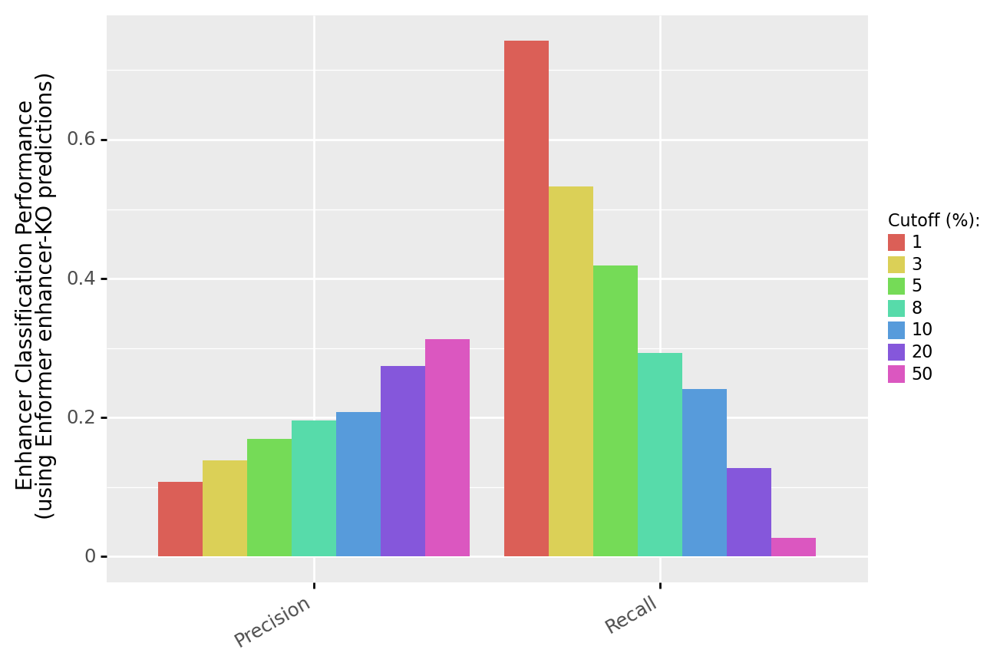

<ggplot: (1460345980895)>

In [138]:
prec_for_cutoff_plt = prec_for_cutoff_df[["obs_cut","cutoff","Recall","Precision"]].melt(id_vars=["obs_cut","cutoff"]).query('obs_cut in [0] and cutoff in [1,3,5,8,10,20,50]')
prec_for_cutoff_plt["cutoff"] = pd.Categorical(prec_for_cutoff_plt["cutoff"], [1,3,5,8,10,20,50])


p = (p9.ggplot(data=prec_for_cutoff_plt
           ,mapping=p9.aes(x="variable",y="value", fill="cutoff"))
 + p9.geom_bar(stat="identity",position="dodge")
 + p9.labs(x="",y="Enhancer Classification Performance\n(using Enformer enhancer-KO predictions)",
           fill="Cutoff (%):")
 #+ p9.coord_cartesian(ylim=(0,0.32))
 + p9.theme(#legend_position=(0.35,0.745), 
            legend_box_margin=0,
            legend_background=p9.element_rect(color="none", size=2, fill='none'),
            legend_text=p9.element_text(size=8),legend_key_size=8,
            legend_title=p9.element_text(size=8),
           axis_text_x=p9.element_text(rotation=30, hjust=1),
           axis_title=p9.element_text(size=10))
 #+ p9.facet_wrap('~obs_cut')
)
p

In [139]:
p.save("Graphics/" + "supfig_enhancer_recall" + ".svg", width=6.4, height=4.8, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.4 x 4.8 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/supfig_enhancer_recall.svg


### Can we recalibrate?

In [140]:
plot_df_percent["log_dist"] = np.log10(plot_df_percent["actual_tss_distance"])
plot_df_percent["log_pct"] = np.log10(plot_df_percent["value"])

ols_1_over_dist = (statsmodels.regression.linear_model.OLS
                  .from_formula('log_pct ~ log_dist',
                                data=(plot_df_percent
                                      .query('validated & actual_tss_distance < 100_000 & actual_tss_distance > 990 & Type == "Predicted"')))
                  )
res_ols_1_over_dist = ols_1_over_dist.fit()

res_ols_1_over_dist.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                log_pct   R-squared:                       0.176
Model:                            OLS   Adj. R-squared:                  0.174
Method:                 Least Squares   F-statistic:                     110.7
Date:                Sat, 03 Sep 2022   Prob (F-statistic):           1.33e-23
Time:                        17:28:36   Log-Likelihood:                -622.36
No. Observations:                 522   AIC:                             1249.
Df Residuals:                     520   BIC:                             1257.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      3.5296      0.292     12.090      0.000       2.956       4.103
log_dist      -0.7222      0.069    -10.521      0.000      -0.857      -0.587
==============================================================================
Omnibus:                      196.584   Durbin-Watson:                   1.395
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              942.541
Skew:                          -1.613   Prob(JB):                    2.14e-205
Kurtosis:                       8.738   Cond. No.                         37.5
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [141]:
plot_df_percent["pct_change_recalibrated"] = 10**(plot_df_percent["log_pct"] + 0.7222*plot_df_percent['log_dist'] - 3.5296)
plot_df_percent["pct_change_recalibrated"] = plot_df_percent.apply(lambda x: x["pct_change_recalibrated"] if x["Type"] == "Predicted" else x["value"] ,axis=1)

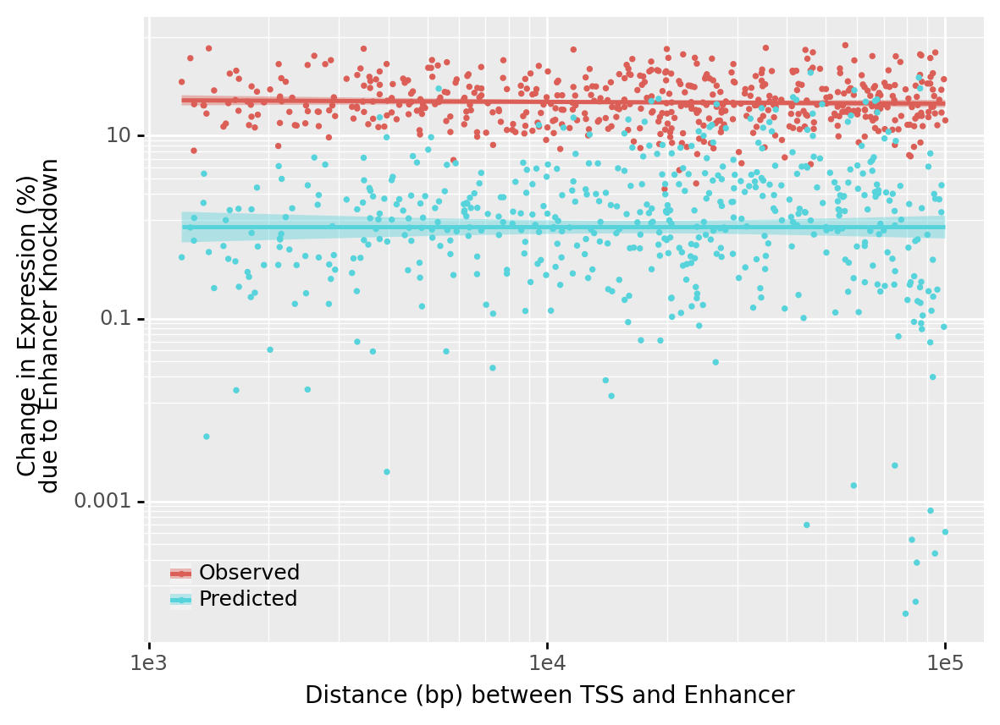

<ggplot: (1460299437087)>

In [142]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=plot_df_percent.query('validated & actual_tss_distance < 100_000 & actual_tss_distance > 999')
           ,mapping=p9.aes(x="actual_tss_distance",y="pct_change_recalibrated",fill="Type", color="Type"))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 + p9.geom_smooth(method="lm")
 #+ p9.facet_wrap('~dataset')
 + p9.geom_point(size=0.5)
 + p9.labs(x="Distance (bp) between TSS and Enhancer",y="Change in Expression (%)\ndue to Enhancer Knockdown", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.05}
           )
)
p

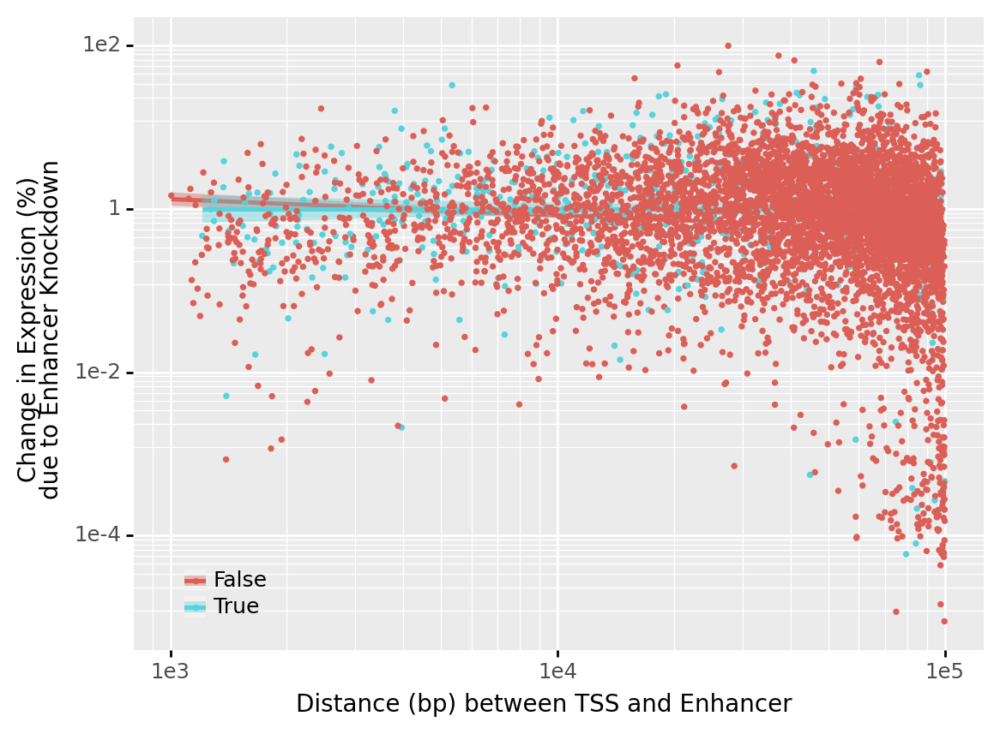

<ggplot: (1460297318777)>

In [143]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=plot_df_percent.query('actual_tss_distance < 100_000 & actual_tss_distance > 999 & Type == "Predicted"')
           ,mapping=p9.aes(x="actual_tss_distance",y="pct_change_recalibrated",fill="validated", color="validated"))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 + p9.geom_smooth(method="lm")
 #+ p9.facet_wrap('~dataset')
 + p9.geom_point(size=0.5)
 + p9.labs(x="Distance (bp) between TSS and Enhancer",y="Change in Expression (%)\ndue to Enhancer Knockdown", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.05}
           )
)
p

In [144]:
subset = plot_df_percent.query('Type == "Predicted" & actual_tss_distance > 1000 & ziga_key not in @ overlapped_regions')
print(sklearn.metrics.average_precision_score(subset['validated'], subset['value']))
print(sklearn.metrics.average_precision_score(subset['validated'], subset['pct_change_recalibrated']))

0.17207872943028055
0.1175465558731978


### Only upstream

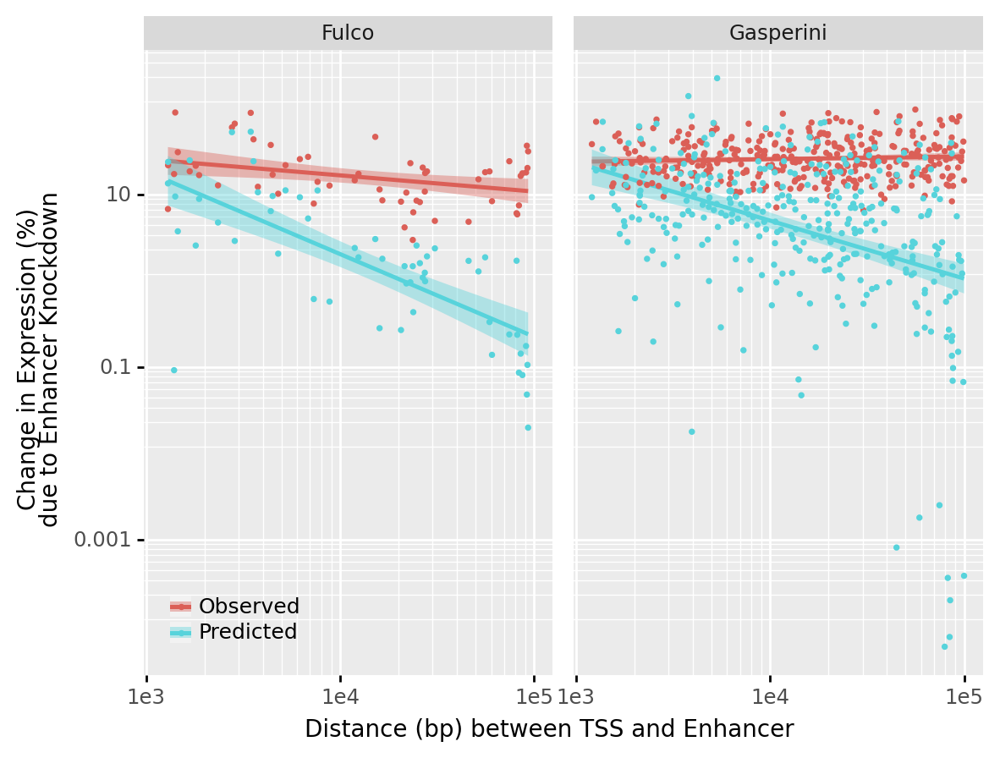

<ggplot: (1460315821060)>

In [145]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=plot_df_percent.query('validated & actual_tss_distance < 100_000 & actual_tss_distance > 999 & upstream')
           ,mapping=p9.aes(x="actual_tss_distance",y="value",fill="Type", color="Type"))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 + p9.geom_smooth(method="lm")
 + p9.facet_wrap('~dataset')
 + p9.geom_point(size=0.5)
 + p9.labs(x="Distance (bp) between TSS and Enhancer",y="Change in Expression (%)\ndue to Enhancer Knockdown", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.05}
           )
)
p

### Strongest effect per gene

In [146]:
plot_df_percent["gene"] = plot_df_percent["ziga_key"].apply(lambda x: x.split("_")[1])

In [147]:
valid_genes = set(plot_df_percent.query('validated')["gene"])

In [148]:
print(len(valid_genes))
print(len(plot_df_percent.query('gene in @valid_genes & actual_tss_distance > 999 & Type == "Predicted"')))
print(len(plot_df_percent.query('gene in @valid_genes & actual_tss_distance > 999 & Type == "Predicted"'))/len(valid_genes))

358
2070
5.782122905027933


In [149]:
plot_df_percent.query('gene in @valid_genes & actual_tss_distance > 999 & Type == "Predicted"').groupby('gene').size().describe()

count    358.000000
mean       5.782123
std       10.659356
min        1.000000
25%        2.000000
50%        3.000000
75%        5.000000
max       61.000000
dtype: float64

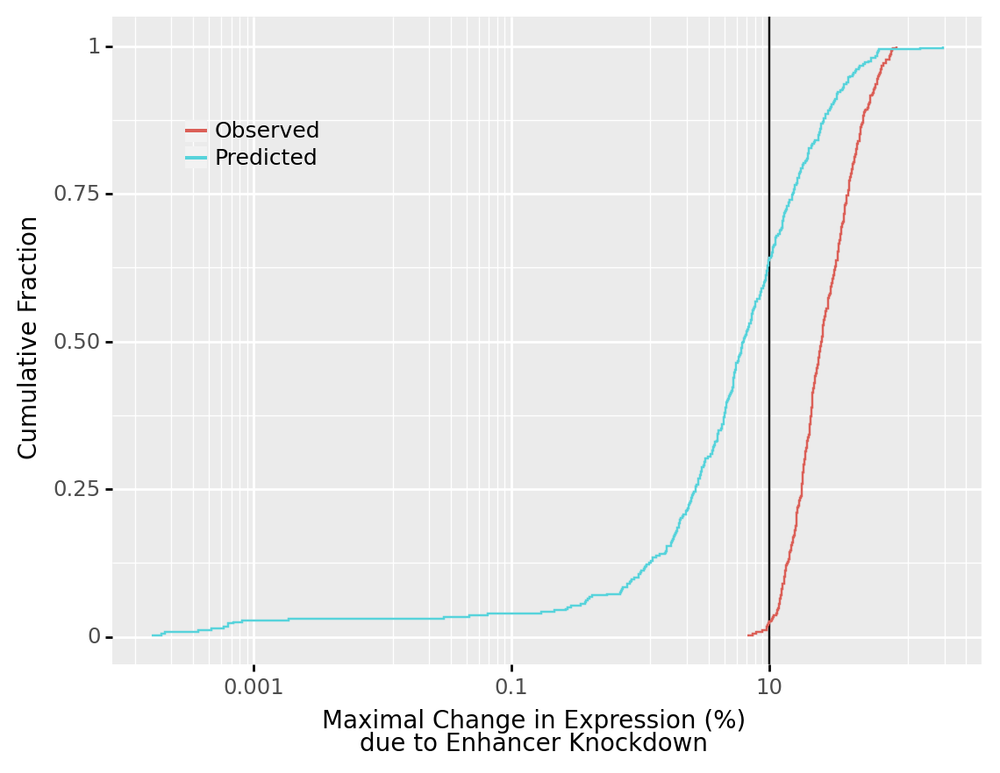

<ggplot: (1460358398790)>

In [150]:
strongest_effects = (plot_df_percent
                     .query('gene in @valid_genes & actual_tss_distance > 999')
                     .groupby(['gene','Type'])['value']
                     .agg({"median","max"})
                     .reset_index())

scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=strongest_effects#.query('Type == "Predicted"')
           ,mapping=p9.aes(x="max",color="Type"))
 #+ p9.scale_y_log10()
 + p9.scale_x_log10()
 #+ p9.geom_smooth(method="lm")
 #+ p9.facet_wrap('~dataset')
 #+ p9.geom_vline(xintercept=6.5)
 #+ p9.geom_vline(xintercept=25)
 + p9.geom_vline(xintercept=10)
 + p9.stat_ecdf()
 + p9.labs(x="Maximal Change in Expression (%)\ndue to Enhancer Knockdown",y="Cumulative Fraction", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.25,0.75),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.05}
           )
)
p

In [151]:
p.save("Graphics/" + "supfig_enhancer_maxeffect" + ".svg", width=6.4, height=4.8, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.4 x 4.8 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/supfig_enhancer_maxeffect.svg


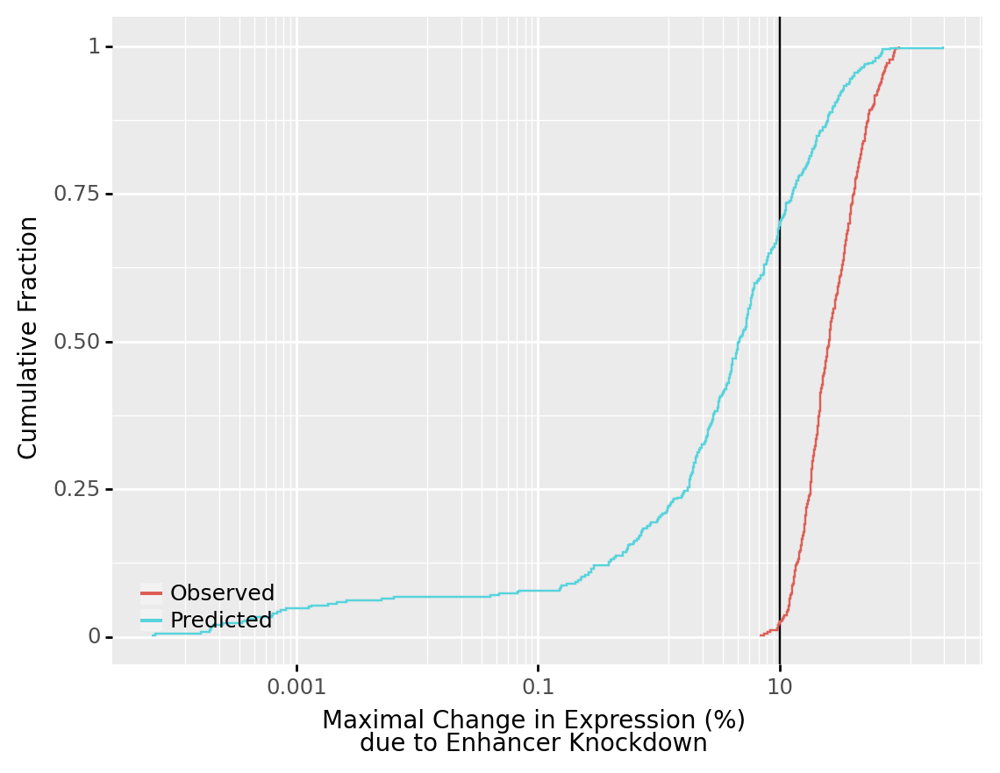

<ggplot: (1460399152893)>

In [152]:
strongest_effects_valid = (plot_df_percent
                     .query('gene in @valid_genes & actual_tss_distance > 999 & validated')
                     .groupby(['gene','Type'])['value']
                     .agg({"median","max"})
                     .reset_index())

scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=strongest_effects_valid#.query('Type == "Predicted"')
           ,mapping=p9.aes(x="max",color="Type"))
 #+ p9.scale_y_log10()
 + p9.scale_x_log10()
 #+ p9.geom_smooth(method="lm")
 #+ p9.facet_wrap('~dataset')
 + p9.geom_vline(xintercept=10)
 #+ p9.geom_vline(xintercept=25)
 #+ p9.geom_vline(xintercept=10)
 + p9.stat_ecdf()
 + p9.labs(x="Maximal Change in Expression (%)\ndue to Enhancer Knockdown",y="Cumulative Fraction", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.05}
           )
)
p

In [153]:
genes_with_distal = set(plot_df_percent.query('actual_tss_distance > 10_000 & validated')["gene"])

In [154]:
strongest_effects_distal = (plot_df_percent
                     .query('gene in @genes_with_distal & actual_tss_distance > 10_000')
                     .groupby(['gene','Type'])['value']
                     .agg(["median","max"])
                     .reset_index())

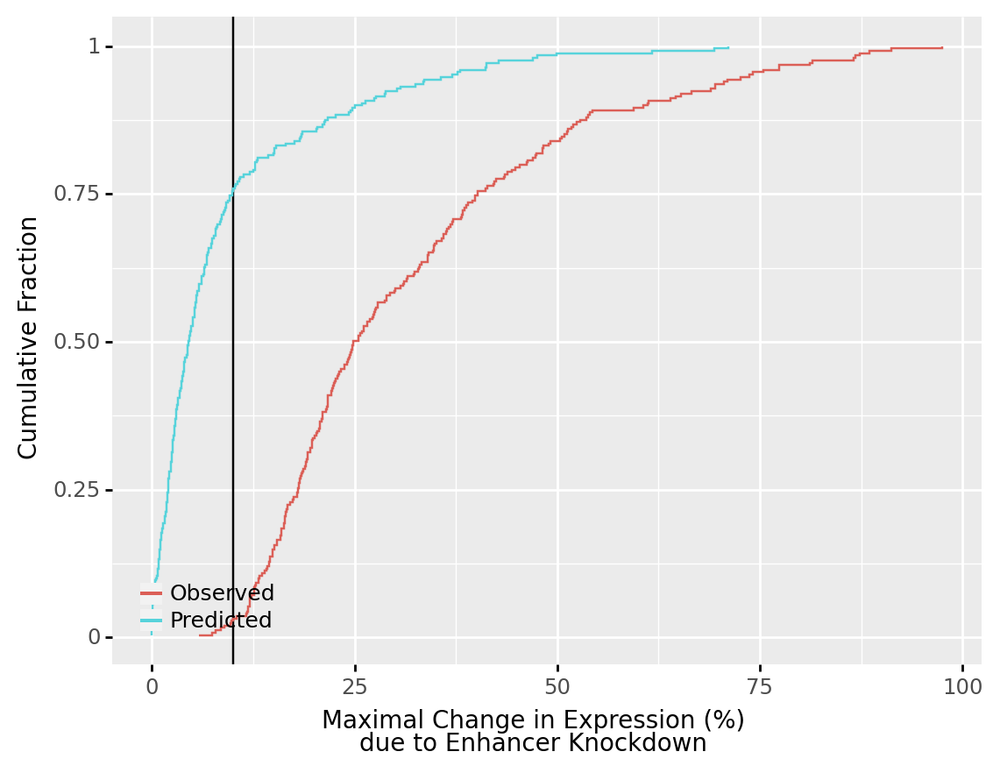

<ggplot: (1460315637384)>

In [155]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=strongest_effects_distal#.query('Type == "Predicted"')
           ,mapping=p9.aes(x="max",color="Type"))
 #+ p9.scale_y_log10()
 #+ p9.scale_x_log10()
 #+ p9.geom_smooth(method="lm")
 #+ p9.facet_wrap('~dataset')
 + p9.geom_vline(xintercept=10)
 + p9.stat_ecdf()
 + p9.labs(x="Maximal Change in Expression (%)\ndue to Enhancer Knockdown",y="Cumulative Fraction", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.05}
           )
)
p

### Which enhancer-gene pairs are seen in training?

In [156]:
valid_enhancers = ziga_df.query('validated')
valid_enhancers["tss_mid"] = (valid_enhancers["main_tss_end"] + valid_enhancers["main_tss_start"])/2
valid_enhancers["tss_id"] = valid_enhancers["chromosome"] + valid_enhancers["tss_mid"].astype('str')
valid_enhancers["enhancer_mid"] = (valid_enhancers['fix_enhancer_wide_start'] + valid_enhancers['fix_enhancer_wide_end'])/2

/scratch/tmp/karollus/ipykernel_163395/871297061.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/scratch/tmp/karollus/ipykernel_163395/871297061.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/scratch/tmp/karollus/ipykernel_163395/871297061.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#re

In [157]:
train_regions = (pd.read_csv(base_path_data_gtex + "human_regions.bed", names=["Chromosome","Start","End","set"], sep="\t")
                            .query('set == "train"')
                            .drop(columns="set"))
train_regions["id"] = train_regions["Chromosome"] + train_regions["Start"].astype('str') + train_regions["End"].astype('str')

train_regions_wide = train_regions.copy()
train_regions_wide["Start"] = train_regions_wide["Start"] - (SEEN_SEQUENCE_LENGTH - 131072)/2
train_regions_wide["End"] = train_regions_wide["End"] + (SEEN_SEQUENCE_LENGTH - 131072)/2
train_regions_wide = pr.PyRanges(train_regions_wide)

train_regions_predict = train_regions.copy()
train_regions_predict["Start"] = train_regions_predict["Start"] + (131072 - 896*128)/2
train_regions_predict["End"] = train_regions_predict["End"] - (131072 - 896*128)/2
train_regions_predict = pr.PyRanges(train_regions_predict)

In [158]:
tss_sites = pr.PyRanges(valid_enhancers[['chromosome', 'main_tss_start', 'main_tss_end','tss_id']]
                         .rename(columns={'chromosome':'Chromosome',
                                         "main_tss_start":"Start",
                                         "main_tss_end":"End"})
                        .drop_duplicates()
                       )

In [159]:
enhancer_sites = pr.PyRanges(valid_enhancers[['chromosome', "fix_enhancer_wide_start","fix_enhancer_wide_end",'tss_id','ziga_key']]
                         .rename(columns={'chromosome':'Chromosome',
                                         "fix_enhancer_wide_start":"Start",
                                         "fix_enhancer_wide_end":"End"})
                        .drop_duplicates()
                       )

In [160]:
tss_in_train = train_regions_predict.join(tss_sites, suffix="_tss",report_overlap=True).df
enhancer_in_train = train_regions_wide.join(enhancer_sites, suffix="_enhancer",report_overlap=True).df.query('Overlap == 2000')

In [161]:
both_in_train = tss_in_train.drop(columns="Overlap").merge(enhancer_in_train.drop(columns="Chromosome"),suffixes=("_predicted_region","_seen_region"), on=["id", "tss_id"])

In [162]:
#seen_pairs = both_in_train[["tss_mid","enhancer_mid","id"]].drop_duplicates().merge(valid_enhancers, on=["tss_mid","enhancer_mid"])
valid_enhancers_seen = (tss_in_train.groupby("tss_id")
                      .size().reset_index()
                      .rename(columns={0:"tss_seen_count"})
                      .merge(valid_enhancers, on=["tss_id"]))
valid_enhancers_seen = (both_in_train.groupby("ziga_key")
                      .size().reset_index()
                      .rename(columns={0:"enhancer_seen_count"})
                      .merge(valid_enhancers_seen, on=["ziga_key"],how="right"))
valid_enhancers_seen["enhancer_seen_count"] = valid_enhancers_seen["enhancer_seen_count"].fillna(0)
valid_enhancers_seen = valid_enhancers_seen.sort_values('enhancer_seen_count')

valid_enhancers_seen = (valid_enhancers_seen.groupby('tss_id')
                        .size().reset_index().rename(columns={0:"total_enhancers"})
                        .merge(valid_enhancers_seen, on=["tss_id"])
                       )

valid_enhancers_seen['fully_seen'] = (valid_enhancers_seen['enhancer_seen_count'] == valid_enhancers_seen['tss_seen_count'])

valid_enhancers_seen = (valid_enhancers_seen.groupby('tss_id')['fully_seen']
                        .sum().reset_index().rename(columns={'fully_seen':"fully_seen_enhancers"})
                        .merge(valid_enhancers_seen, on=["tss_id"])
                       )

In [163]:
# for tss, which are seen
# check for difference between enhancers which are seen fully and those which are not
seen_twice = valid_enhancers_seen.query('tss_seen_count > 0')
seen_twice = seen_twice.merge(merged_df[["ziga_key","log2_fc_pred"]],on="ziga_key")
seen_twice['abs_pct_change'] = np.abs((2**seen_twice['log2_fc_pred'] - 1)*100)
seen_twice["abs_log2_fc_pred"] = np.abs(seen_twice["log2_fc_pred"])
seen_twice["log_tss_distance"] = np.log10(seen_twice["actual_tss_distance"] + 1000)
seen_twice["log_abs_log2_fc_pred"] = np.log(np.abs(seen_twice["log2_fc_pred"]))
seen_twice['log_abs_pct_change'] = np.log(np.abs(seen_twice["abs_pct_change"]))

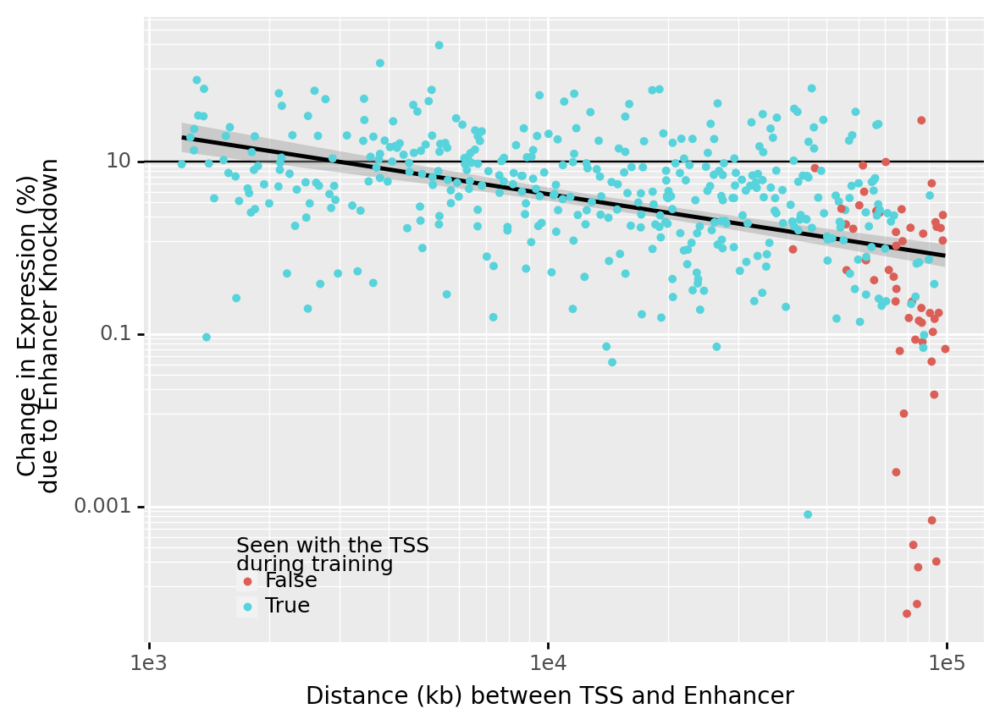

<ggplot: (1460315972596)>

In [164]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=seen_twice.query('actual_tss_distance > 999 & actual_tss_distance < 100_000')
           ,mapping=p9.aes(x="actual_tss_distance",y="abs_pct_change",color="fully_seen"))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 + p9.geom_hline(yintercept=10)
 + p9.geom_smooth(method="lm",color="black")
 + p9.geom_point(size=1)
 + p9.labs(x="Distance (kb) between TSS and Enhancer",y="Change in Expression (%)\ndue to Enhancer Knockdown", color="Seen with the TSS\nduring training")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_title=p9.element_text(size=9),
            legend_position=(0.3,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10)
           )
)
p

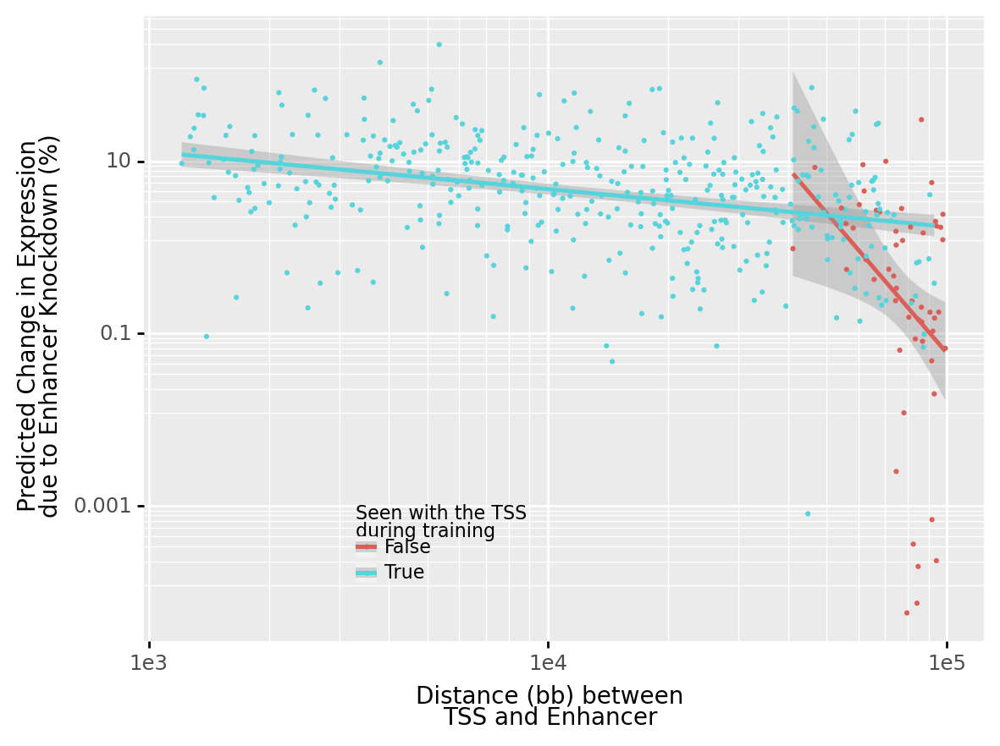

<ggplot: (1460340722246)>

In [178]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=seen_twice.query('actual_tss_distance > 999  & actual_tss_distance < 100_000')
           ,mapping=p9.aes(x="actual_tss_distance",y="abs_pct_change",color="fully_seen"))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 #+ p9.geom_hline(yintercept=10)
 + p9.geom_smooth(method="lm")
 + p9.geom_point(size=0.25)
 + p9.labs(x="Distance (bb) between\nTSS and Enhancer",y="Predicted Change in Expression\ndue to Enhancer Knockdown (%)", color="Seen with the TSS\nduring training")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=8),
            legend_title=p9.element_text(size=8),
            legend_position=(0.4,0.24),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10)
           )
)
p

In [179]:
p.save("Graphics/" + "classimba_train" + ".svg", width=2.4, height=3.0, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 2.4 x 3.0 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/classimba_train.svg


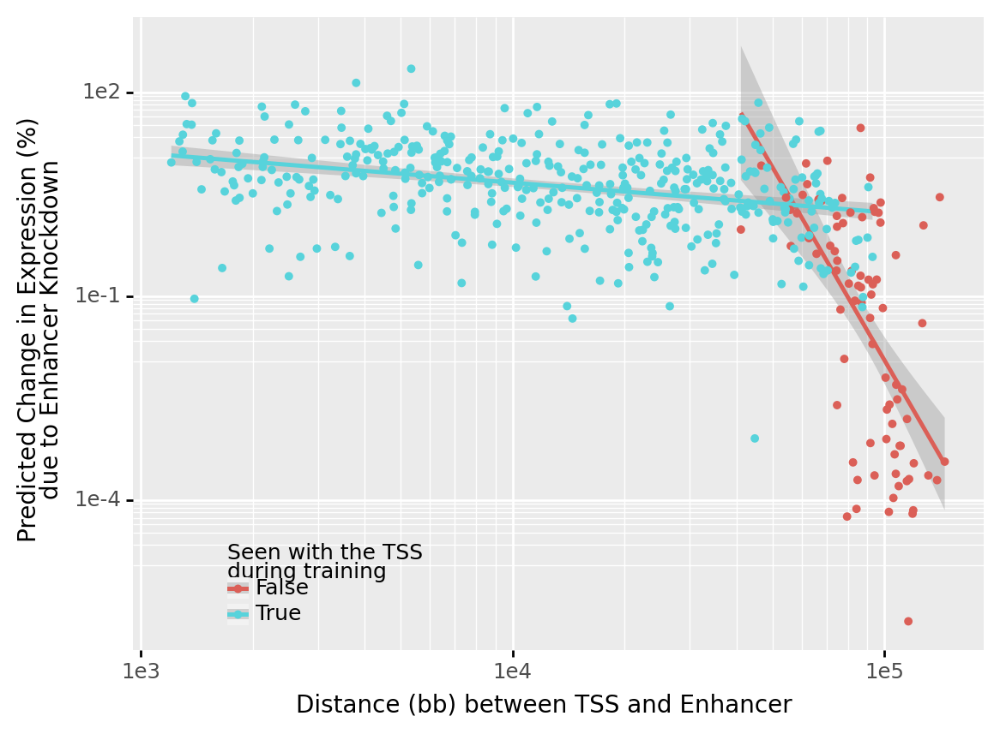

<ggplot: (1460315781093)>

In [167]:
p = (p9.ggplot(data=seen_twice.query('actual_tss_distance > 999')
           ,mapping=p9.aes(x="actual_tss_distance",y="abs_pct_change",color="fully_seen"))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 #+ p9.geom_hline(yintercept=10)
 + p9.geom_smooth(method="lm")
 + p9.geom_point(size=1)
 + p9.labs(x="Distance (bb) between TSS and Enhancer",y="Predicted Change in Expression (%)\ndue to Enhancer Knockdown", color="Seen with the TSS\nduring training")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_title=p9.element_text(size=9),
            legend_position=(0.3,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10)
           )
)
p

### The Enformer ABC score

In [402]:
with open(base_path_results+"avsec_enhancercentered-enformer-latest_results.tsv", 'r') as tsv:
    header = tsv.readline()
    cols = header.split("\t")
cols = [k for k in cols if k.endswith("landmark_sum_wide") and ("k562" in k.lower() or "H3K27ac" in k)]

enhancer_results = pd.read_csv(base_path_results+"avsec_enhancercentered-enformer-latest_results.tsv",sep="\t",
                     usecols = ["chr","old_index","enh_start", "enh_end","enh_mid","orient","offset"] + cols)

enhancer_results = enhancer_results.groupby(["chr","old_index","enh_start", "enh_end","enh_mid"])[cols].mean().reset_index()

enhancer_results = enhancer_results.rename(columns={x:x+"_enh" for x in cols})

enhancer_results["enhancer_id"] = enhancer_results["chr"] + "_" + enhancer_results["enh_start"].astype('str') + ":" + enhancer_results["enh_end"].astype('str')

In [403]:
ko_results = merged_df.copy()
ko_results["enhancer_id"] = ko_results["chromosome"] + "_" + ko_results["enhancer_start"].astype('str') + ":" + ko_results["enhancer_end"].astype('str')
ko_results = ko_results.query('actual_tss_distance > 1000')
ko_results = ko_results.merge(enhancer_results, on="enhancer_id")
ko_results["basal"] = 2**ko_results[pred_col+"_ref"] - 1
ko_results["delta"] = np.abs(2**(ko_results[pred_col+"_ref"]-1) - 2**(ko_results[pred_col+"_alt"]-1))
ko_results["abs_log2_fc_pred"] = np.abs(ko_results["log2_fc_pred"])
ko_results["pct_change"] = (2**ko_results["log2_fc_pred"] - 1)*100
ko_results["abs_pct_change"] = np.abs(2**ko_results["log2_fc_pred"] - 1)*100
ko_results["log_abs_pct_change"] = np.log10(ko_results["abs_pct_change"])
ko_results["log_dist"] = np.log10(ko_results["actual_tss_distance"]+1000)
ko_results["one_over_dist"] = 1/ko_results["actual_tss_distance"]
ko_results["valid_num"] = ko_results["validated"].astype('int')

In [404]:
track_types = ["H3K27ac", "DNASE"] #["H3K27ac","H3K27me", "H3K9me", "H3K9ac", "H3K79me", "DNASE"]
track_types_dist = [x+"_over_dist" for x in track_types] + ["combined_over_dist"]

for track_type in track_types:
    ko_results[track_type] = ko_results[[x for x in enhancer_results.keys() if x.endswith('landmark_sum_wide_enh') and track_type in x]].mean(axis=1)
    ko_results[track_type + "_over_dist"] = ko_results[track_type]/ko_results["actual_tss_distance"]
ko_results["combined"] = scipy.stats.mstats.gmean(ko_results[track_types],axis=1)
ko_results["combined_over_dist"] = ko_results["combined"]/ko_results["actual_tss_distance"]

In [405]:
print(scipy.stats.pearsonr(ko_results['H3K27ac/abs(distance)'],ko_results["combined_over_dist"]))
print(scipy.stats.spearmanr(ko_results['H3K27ac/abs(distance)'],ko_results["combined_over_dist"]))

(0.6966142171947121, 0.0)
SpearmanrResult(correlation=0.7434030211167062, pvalue=0.0)


/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/pandas/core/arraylike.py:364: RuntimeWarning: divide by zero encountered in log10


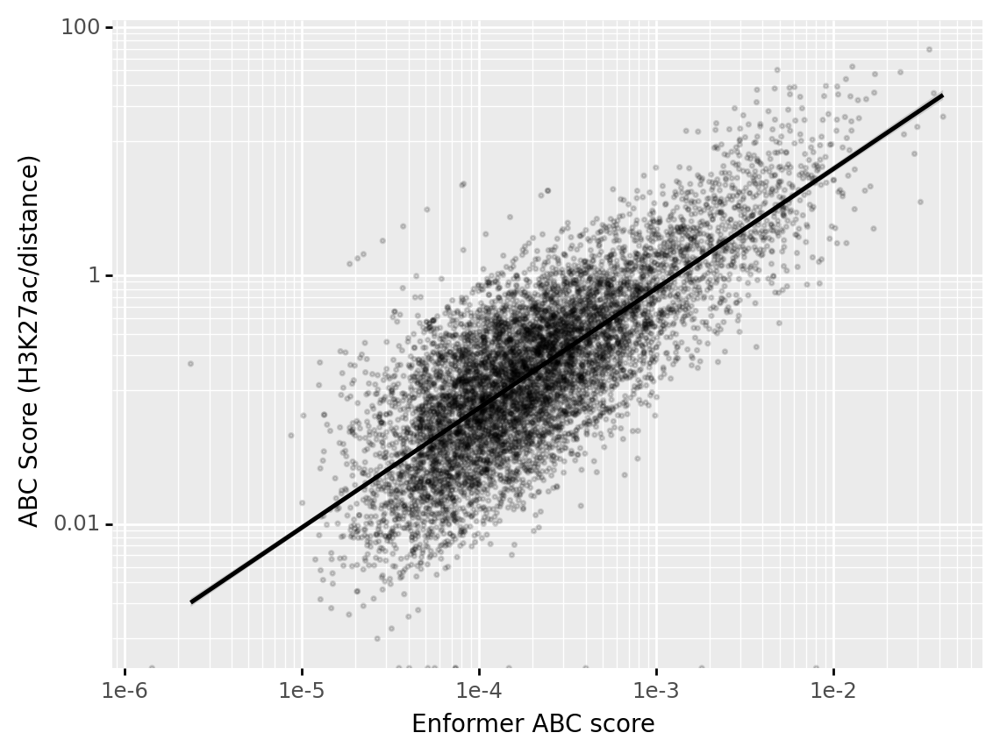

<ggplot: (1399127695782)>

In [406]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=ko_results
           ,mapping=p9.aes(x="combined_over_dist",y='H3K27ac/abs(distance)'))#,fill="validated", color="validated"))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 + p9.geom_smooth(method="lm")
 #+ p9.facet_wrap('~dataset_name')
 + p9.geom_point(size=0.5,alpha=0.15)
 + p9.labs(x="Enformer ABC score",y="ABC Score (H3K27ac/distance)", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.05}
           )
)
p

In [407]:
p.save("Graphics/" + "supfig_enhancer_eabc" + ".svg", width=6.4, height=4.8, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.4 x 4.8 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/supfig_enhancer_eabc.svg
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/pandas/core/arraylike.py:364: RuntimeWarning: divide by zero encountered in log10


In [409]:
auprc_rows = []

predictors = {
    "delta":"Predicted Absolute Change",
    "H3K27ac/abs(distance)":"ABC score (H3K27ac/distance)",
    "abs_log2_fc_pred":"Predicted (unsigned) Log-Fold Change",
    "abs_pct_change":"Predicted Percentage Change",
    "combined_over_dist":"Enformer-ABC",
    #pred_col+"_ref":"Predicted Basal Expression"
}

def bootstrap_auprc(subset, predictor, n=99, cutoff=0.05):
    samples = []
    for i in range(n):
        sample = subset.sample(frac=1.0,replace=True)
        samples.append(sklearn.metrics.average_precision_score(sample['validated'], sample[predictor]))
    samples = sorted(samples)
    return samples[math.floor((n+1)*cutoff/2)],samples[math.ceil((n+1)*(1-cutoff/2))]

#pred_bins = ["Full"] + [x for x in set(ko_results["bin"])]
datasets = {"Fulco":"fulco2019", "Gasperini":"gasperini2019", "Combined":"Combined"}

#for pred_bin in pred_bins:
for dataset in datasets:
    dataset_key = datasets[dataset]
    if dataset == "Combined":
        subset = ko_results.copy()
    else:
        #subset = ko_results.query('bin == @pred_bin')
        subset = ko_results.query('dataset_name == @dataset_key')
    for predictor in predictors.keys():
        auprc = sklearn.metrics.average_precision_score(subset['validated'], subset[predictor])
        min_auprc, max_auprc = bootstrap_auprc(subset, predictor)
        auprc_rows.append({
            "dataset":dataset,
            "predictor":predictors[predictor],
            "auprc":auprc,
            "min":min_auprc,
            "max":max_auprc
        })
    random = np.sum(subset['validated'])/len(subset['validated'])
    auprc_rows.append({
        "dataset":dataset,
        "predictor":"Random",
        "auprc":random,
        "min":random,
        "max":random
    })
    
auprc_df = pd.DataFrame(auprc_rows)

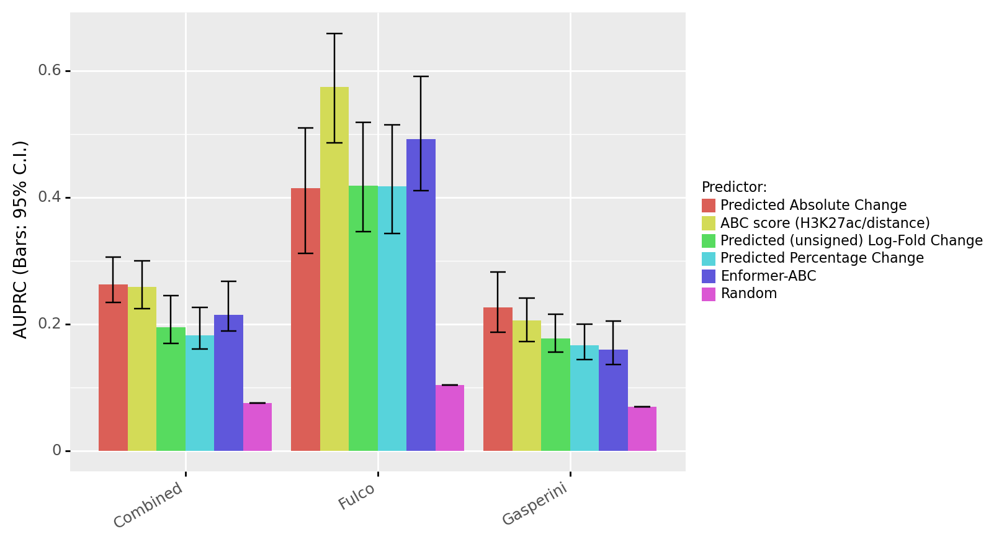

<ggplot: (1399040872084)>

In [421]:
auprc_df["predictor"] = pd.Categorical(auprc_df["predictor"], categories = [x for x in predictors.values()] + ["Random"])


p = (p9.ggplot(data=auprc_df
           ,mapping=p9.aes(x="dataset",y="auprc", fill="predictor",ymin="min",ymax="max"))
 + p9.geom_bar(stat="identity",position="dodge")
 + p9.geom_errorbar(position=p9.position_dodge(0.9))
 + p9.labs(x="",y="AUPRC (Bars: 95% C.I.)",
           fill="Predictor:")
 + p9.theme(#legend_position=(0.35,0.745), 
            legend_box_margin=0,
            #legend_position=(0.75,0.75),
            legend_background=p9.element_rect(color="none", size=2, fill='none'),
            legend_text=p9.element_text(size=8),legend_key_size=8,
            legend_title=p9.element_text(size=8),
           axis_text_x=p9.element_text(rotation=30, hjust=1),
           axis_title=p9.element_text(size=10))
)
p

In [422]:
p.save("Graphics/" + "supfig_enhancer_auprc" + ".svg", width=6.4, height=4.8, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.4 x 4.8 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/supfig_enhancer_auprc.svg


In [274]:
print(sklearn.metrics.average_precision_score(ko_results['validated'], preds))

0.2798739433799296


### Which pairs could be useful for in-silico analysis?

We posit the following criteria for enhancer-promoter pairs:
- high predicted effect
- not too close (> 3kb)
- some weak but close enhancers
- some intermediate strength enhancers

We posit the following criteria for locations:
- the strongest effects
- very far ones with strong effect
- some close but weak ones

In [361]:
# strong effects
candidates = (plot_df_percent.query('Type == "Predicted"')
              .query('actual_tss_distance > 3000 and actual_tss_distance < 90_000 and (value > 30)')
              #.groupby('ziga_key').size().reset_index()
              #.rename(columns={0:"count"})
              #.query('count == 2')
             )
strong_candidates = set(candidates["ziga_key"])
candidate_genes = set(candidates["gene"])
# weak enhancers
weak_candidates = set((plot_df_percent.query('Type == "Predicted"')
              .query('actual_tss_distance > 3000 and actual_tss_distance < 8_000 and (value < 0.1)')
             )["ziga_key"])
weak_for_gene_candidates = set((plot_df_percent.query('Type == "Predicted" and gene in @candidate_genes')
              .query('actual_tss_distance > 3000 and actual_tss_distance < 20_000 and (value < 1)')
             )["ziga_key"])
intermediate_candidates = set((plot_df_percent.query('Type == "Predicted" and gene in @candidate_genes')
              .query('actual_tss_distance > 3_000 and actual_tss_distance < 20_000 and (value < 8 and value > 4)')
             )["ziga_key"])


candidate_set = strong_candidates | weak_candidates | weak_for_gene_candidates | intermediate_candidates

candidate_locs = (merged_df.query('ziga_key in @candidate_set')
                  [["ziga_key","gene","main_tss_start","main_tss_end","main_tss_bin",'enhancer_start', 'enhancer_end','actual_tss_distance','chromosome',"validated"]
                   + ['fix_enhancer_wide_start', 'fix_enhancer_wide_end', "sequence_start","sequence_end"]
                   + [pred_col + "_ref",pred_col + "_alt", 'log2_fc_pred']]
                  .sort_values('log2_fc_pred'))
candidate_locs["abs_log2_fc_pred"] = np.abs(candidate_locs["log2_fc_pred"])
candidate_locs["candidate_type"] = candidate_locs["ziga_key"].apply(lambda x: "strong" if x in strong_candidates else ("intermediate" if x in intermediate_candidates else ("weak")))

In [363]:
candidate_locs["enhancer_size"] = candidate_locs["enhancer_end"] - candidate_locs["enhancer_start"]

In [364]:
n_total = 2_000_000
n_weak = 6
n_far = 6

print(len(candidate_locs["gene"].drop_duplicates()))
print(len(candidate_locs[["chromosome","enhancer_start"]].drop_duplicates()))
n_pred = len(candidate_locs["gene"].drop_duplicates()) * len(candidate_locs[["chromosome","enhancer_start"]].drop_duplicates())
print(n_pred)
print(n_total/(n_pred*6))

89
115
10235
32.56798567008631


In [12]:
10235*32

327520

In [379]:
test_locs = set(candidate_locs.sort_values("abs_log2_fc_pred",ascending=False).head(math.floor(n_total/(n_pred*6)) - n_weak - n_far)["ziga_key"])
test_locs = test_locs | set(candidate_locs.query('candidate_type == "weak"').head(n_weak)["ziga_key"])
test_locs = set(candidate_locs.query('ziga_key not in @test_locs').sort_values("actual_tss_distance",ascending=False).head(n_far)["ziga_key"]) | test_locs
candidate_locs["test_location"] = candidate_locs["ziga_key"].apply(lambda x: x in test_locs)

In [382]:
print(candidate_locs["validated"].describe())
print(candidate_locs.query('test_location')["actual_tss_distance"].describe())
print(((2**candidate_locs["log2_fc_pred"] - 1)*100).describe())
print(np.abs(((2**candidate_locs["log2_fc_pred"] - 1)*100)).describe())
print((2**candidate_locs[pred_col+"_alt"] - 1).describe())
print(np.sum(candidate_locs["log2_fc_pred"] > 0)/len(candidate_locs))
print(np.sum(candidate_locs.query('test_location')["log2_fc_pred"] > 0)/len(candidate_locs.query('test_location')))

count       118
unique        2
top       False
freq         86
Name: validated, dtype: object
count       32.000000
mean     25204.093750
std      27834.923866
min       3597.000000
25%       5224.750000
50%      13813.000000
75%      30004.250000
max      89961.000000
Name: actual_tss_distance, dtype: float64
count    118.000000
mean       1.966787
std       59.259705
min      -87.172065
25%      -38.262045
50%       -6.648776
75%       39.603948
max      224.938846
Name: log2_fc_pred, dtype: float64
count    118.000000
mean      47.161794
std       35.670275
min        0.017964
25%       32.849979
50%       39.231494
75%       54.606909
max      224.938846
Name: log2_fc_pred, dtype: float64
count    118.000000
mean      82.632729
std      155.238331
min        0.088524
25%       11.480217
50%       29.113441
75%       71.518022
max      858.481623
Name: CAGE:chronic myelogenous leukemia cell line:K562 ENCODE, biol__landmark_sum_alt, dtype: float64
0.4152542372881356
0.34375


In [385]:
(2**candidate_locs[pred_col+"_ref"] - 1).describe()

count    118.000000
mean     103.879430
std      184.767365
min        0.138375
25%       11.731341
50%       34.964902
75%       95.563895
max      863.221570
Name: CAGE:chronic myelogenous leukemia cell line:K562 ENCODE, biol__landmark_sum_ref, dtype: float64

In [386]:
candidate_locs.query('test_location').groupby('gene').size().reset_index().rename(columns={0:"count"}).query('count > 1')

,gene,count
0,ALAS2,2
3,C3,2
5,CD69,3
6,COL15A1,2
7,CXCL3,2
11,ICAM2,2
14,NFE2,2
20,THEMIS2,2


In [387]:
candidate_locs.to_csv(base_path_data + "in_silico_candidate_locs.tsv",sep="\t", index=None)

# Is Enformer multiplicative?

In this in-silico experiment, we analyze whether Enformer follows a multiplicative logic to determine expression (background and enhancer scale an innate promoter strength). For this purpose, we identify promoter, enhancer and backgrounds which are such that enformer links the enhancer with the promoter. We then test every combination of promoter and enhancer (in 32 backgrounds) and assess how well a multiplicative model explains the results

In [7]:
base_path_data = "Data/Fulco_CRISPRi/"
base_path_results = "Results/Fulco_CRISPRi/"
base_path_data_gtex = "Data/GTEX/"

In [8]:
candidate_locs = pd.read_csv(base_path_data + "in_silico_candidate_locs.tsv",sep="\t").rename(columns={"ziga_key":"location_key"})
candidate_locs["enhancer_id"] = candidate_locs["chromosome"] + ":" + candidate_locs["fix_enhancer_wide_start"].astype('str') + "-" +  candidate_locs["fix_enhancer_wide_end"].astype('str')
#candidate_locs["main_tss_mid"] = (candidate_locs["main_tss_start"] + candidate_locs["main_tss_end"])//2
candidate_locs["promoter_id"] = candidate_locs["chromosome"] + ":" + candidate_locs["main_tss_start"].astype('str') + "-" +  candidate_locs["main_tss_end"].astype('str')

## Analysis

In [9]:
pred_col = "CAGE:chronic myelogenous leukemia cell line:K562 ENCODE, biol__landmark_sum"

In [10]:
results = pd.read_csv(base_path_results + "fulco_in_fulco-enformer-latest_results.tsv",sep="\t")
results = results.groupby(["location_key","promoter_id","enhancer_id"])[[k for k in results.keys() if ("CAGE" in k) or ("DNASE" in k)]].mean().reset_index()

In [12]:
results["log_pred_col"] = np.log2(results[pred_col] + 1)

### Promoter and multiplicative model for each location

In [45]:
def fit_and_predict(df,dep_var,indep_vars,model_name,id_name,id_col="location_key"):
    df = df[[dep_var] + indep_vars]
    res_enformer = (statsmodels.regression.linear_model.OLS
                    .from_formula("{} ~ {}".format(dep_var, " + ".join(indep_vars)),
                                  data=df)).fit()
    df["model"] = model_name
    df[id_col] = id_name 
    df["preds"] = res_enformer.predict()
    params = res_enformer.params.reset_index().rename(columns={"index":"Name",0:"param"})
    params["model"] = model_name
    params[id_col] = id_name
    r2 = sklearn.metrics.r2_score(df[dep_var], df["preds"])
    return df, params, r2

In [ ]:
locations = set(results["location_key"])

rows = []
param_df_list_prom = []
param_df_list_mult = []
pred_df_list_prom = []
pred_df_list_mult = []
for loc in locations:
    subset = results.query('location_key == @loc')
    # promoter model
    prom_preds, prom_params, prom_r2 = fit_and_predict(subset,"log_pred_col",["promoter_id"],"promoter",loc)
    # promoter + enhancer model
    mult_preds, mult_params, mult_r2 = fit_and_predict(subset,"log_pred_col",["promoter_id","enhancer_id"],"multiplicative",loc)
    # metrics
    rows.append({"location_key":loc,
                 "r2_prom":prom_r2,
                 "r2_mult":mult_r2, 
                 "avg_expr":subset["log_pred_col"].mean(),
                 "total_std":subset["log_pred_col"].std(),
                 "median_std":subset.groupby('promoter_id')["log_pred_col"].std().median(),
                 "max_std":subset.groupby('promoter_id')["log_pred_col"].std().max()})
    # params
    param_df_list_prom.append(prom_params)
    param_df_list_mult.append(mult_params)
    # preds
    pred_df_list_prom.append(prom_preds)
    pred_df_list_mult.append(mult_preds)
    
var_explained = pd.DataFrame(rows).merge(candidate_locs[["location_key","log2_fc_pred","abs_log2_fc_pred","candidate_type","actual_tss_distance"]],on="location_key")
mult_params = pd.concat(param_df_list_mult)
mult_preds = pd.concat(pred_df_list_mult)

In [15]:
candidate_effects = candidate_locs[["enhancer_id","log2_fc_pred","actual_tss_distance"]].rename(columns={"enhancer_id":"Name"})
candidate_effects["Name"] = candidate_effects["Name"].apply(lambda x: "enhancer_id[T.{}]".format(x))
corr_with_ko = (mult_params.merge(candidate_effects,on="Name")
                .groupby('location_key')[['param','log2_fc_pred']].corr()
                .reset_index().query('level_1 == "param"')[["location_key","log2_fc_pred"]]
                .sort_values('log2_fc_pred').rename(columns={"log2_fc_pred":"corr_with_ko"}))

In [16]:
var_explained = var_explained.merge(corr_with_ko,on='location_key').sort_values('r2_prom')

#### Variance explained

In [69]:
var_explained_molten = var_explained[["location_key","r2_prom","r2_mult"]].melt(id_vars="location_key")
var_explained_molten["variable"] = var_explained_molten["variable"].apply(lambda x: "Promoter" if x =="r2_prom" else "Promoter +\nEnhancer")
var_explained_molten["location_key"] = pd.Categorical(var_explained_molten["location_key"],categories=[x for x in var_explained.sort_values("r2_prom")["location_key"]])

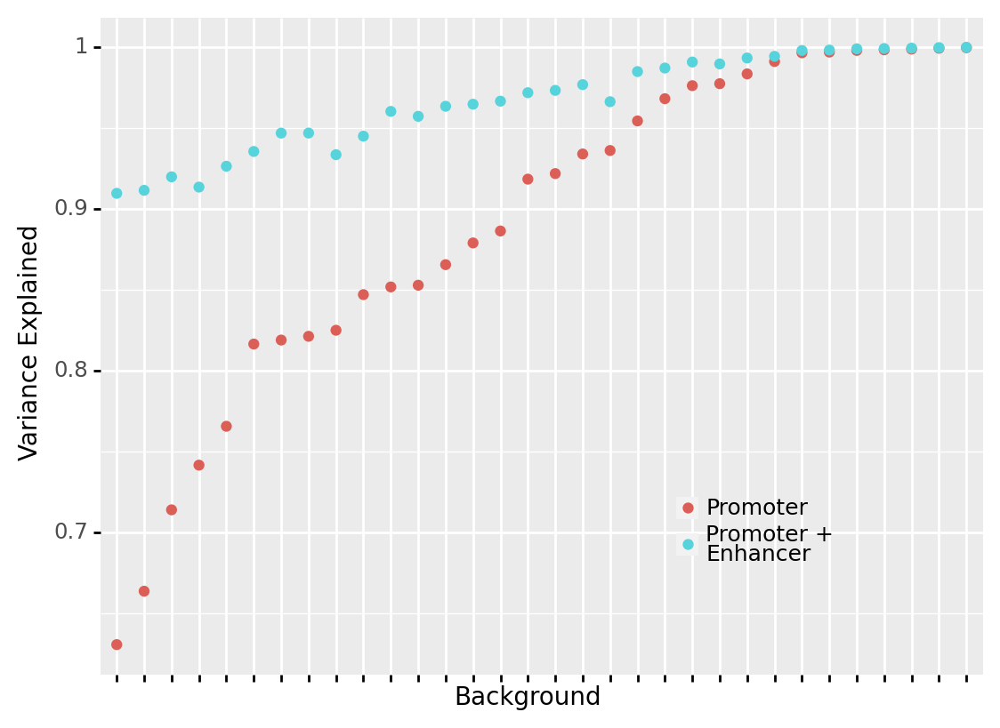

<ggplot: (1444942864345)>

In [91]:
scale = 1.0
p9.options.figure_size = (6.4*scale, 4.8*scale)
p = (p9.ggplot(data=var_explained_molten,mapping=p9.aes(x="location_key",y="value",fill="variable", color="variable"))
 + p9.geom_point(size = 1.5)
 + p9.labs(x="Background", y="Variance Explained", fill="",color="")
 + p9.theme(legend_box_margin=0,legend_key_size =9, 
            legend_text = p9.element_text(size=9),
            legend_background=p9.element_blank(),
            legend_position=(0.7,0.3),
           axis_title=p9.element_text(size=10),
            axis_text_x=p9.element_blank(),
            #axis_ticks_major_x=p9.element_blank(),
            #axis_text_x=p9.element_text(rotation=90, hjust=1)
           )
    )
p

In [92]:
p.save("Graphics/" + "supfig_insilico_location" + ".svg", width=6.4/2, height=3.0, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 3.2 x 3.0 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/supfig_insilico_location.svg


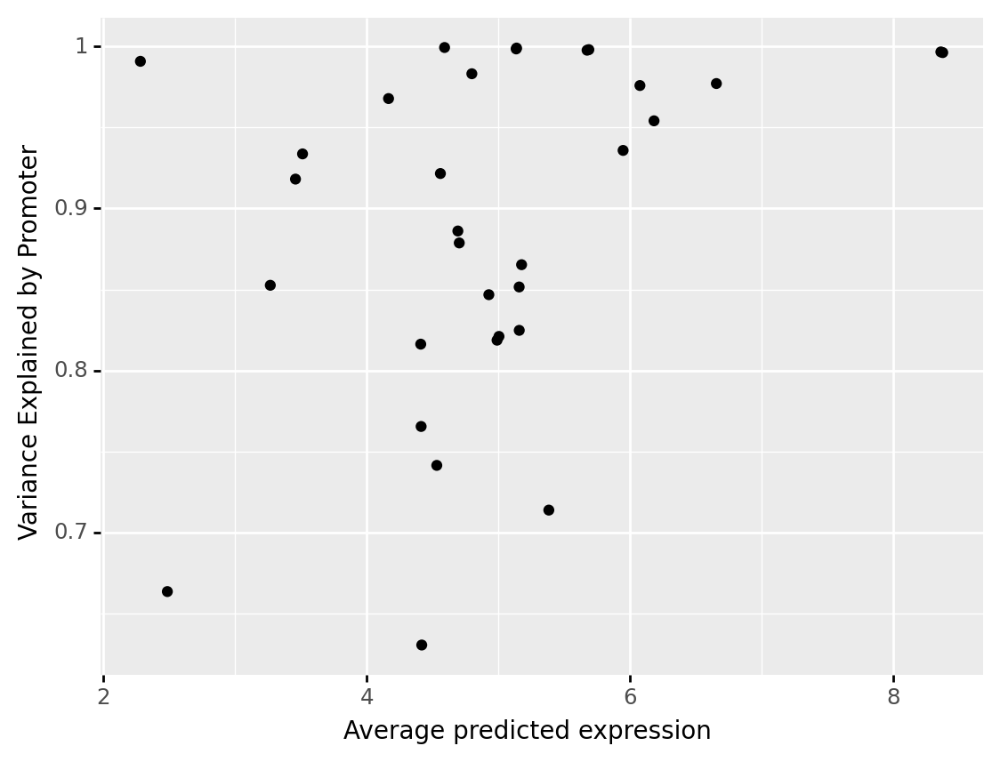

<ggplot: (1440268501014)>

In [29]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=var_explained
           ,mapping=p9.aes(x="avg_expr",y='r2_prom'))
 #+ p9.scale_y_log10()
 #+ p9.scale_x_log10()
 #+ p9.geom_smooth(method="lm")
 #+ p9.facet_wrap('~dataset_name')
 + p9.geom_point()
 + p9.labs(x="Average predicted expression",y="Variance Explained by Promoter", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.05}
           )
)
p

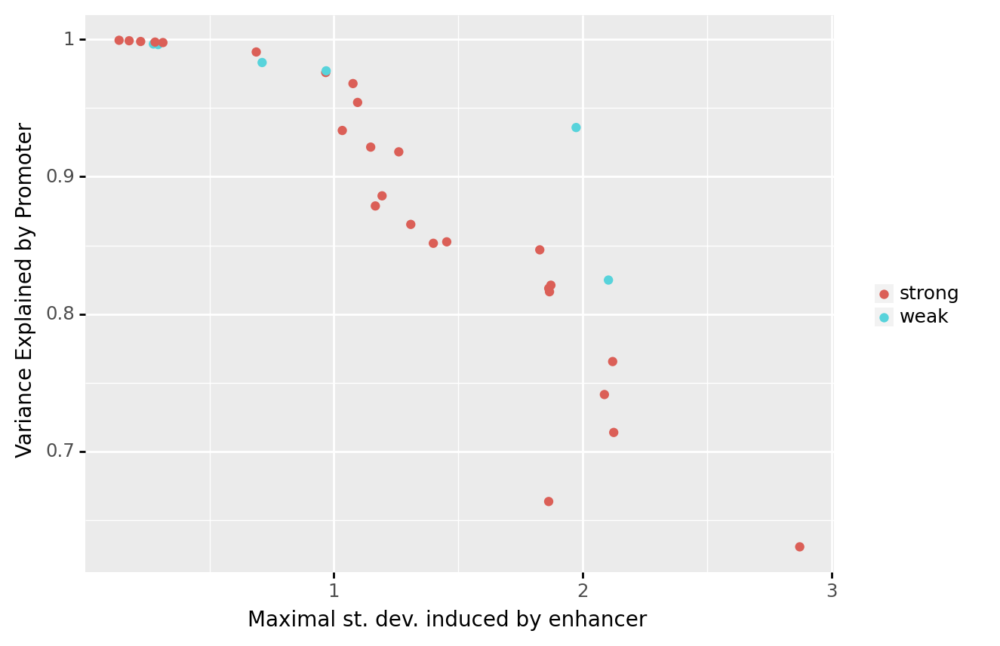

<ggplot: (1440270621778)>

In [30]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=var_explained
           ,mapping=p9.aes(x="max_std",y='r2_prom',color="candidate_type"))
 #+ p9.scale_y_log10()
 #+ p9.scale_x_log10()
 #+ p9.geom_smooth(method="lm")
 #+ p9.facet_wrap('~dataset_name')
 + p9.geom_point()
 + p9.labs(x="Maximal st. dev. induced by enhancer",y="Variance Explained by Promoter", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            #legend_position=(0.21,0.2),
            legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.05}
           )
)
p

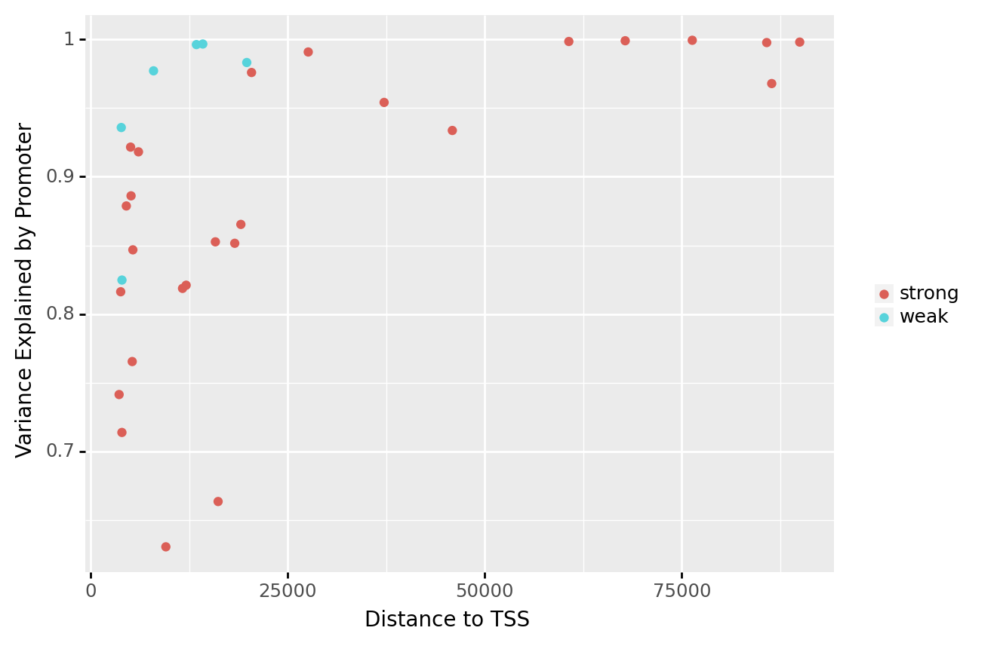

<ggplot: (1440391287772)>

In [31]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=var_explained
           ,mapping=p9.aes(x="actual_tss_distance",y='r2_prom',color="candidate_type"))
 #+ p9.scale_y_log10()
 #+ p9.scale_x_log10()
 #+ p9.geom_smooth(method="lm")
 #+ p9.facet_wrap('~dataset_name')
 + p9.geom_point()
 + p9.labs(x="Distance to TSS",y="Variance Explained by Promoter", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            #legend_position=(0.21,0.2),
            legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.05}
           )
)
p

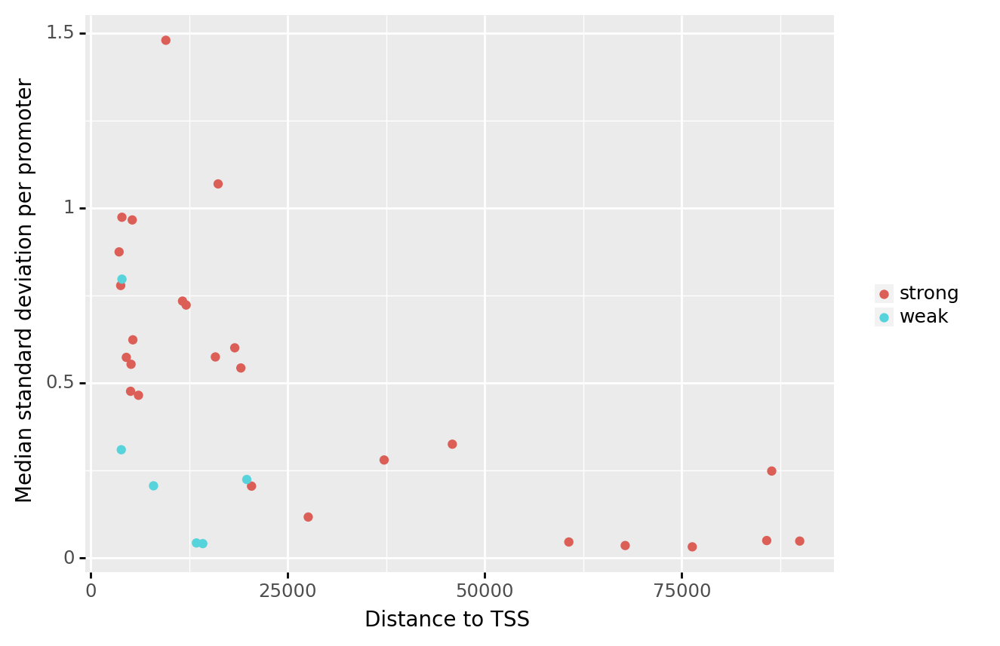

<ggplot: (1440391146765)>

In [32]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=var_explained
           ,mapping=p9.aes(x="actual_tss_distance",y='median_std',color="candidate_type"))
 #+ p9.scale_y_log10()
 #+ p9.scale_x_log10()
 #+ p9.geom_smooth(method="lm")
 #+ p9.facet_wrap('~dataset_name')
 + p9.geom_point()
 + p9.labs(x="Distance to TSS",y="Median standard deviation per promoter", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            #legend_position=(0.21,0.2),
            legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.05}
           )
)
p

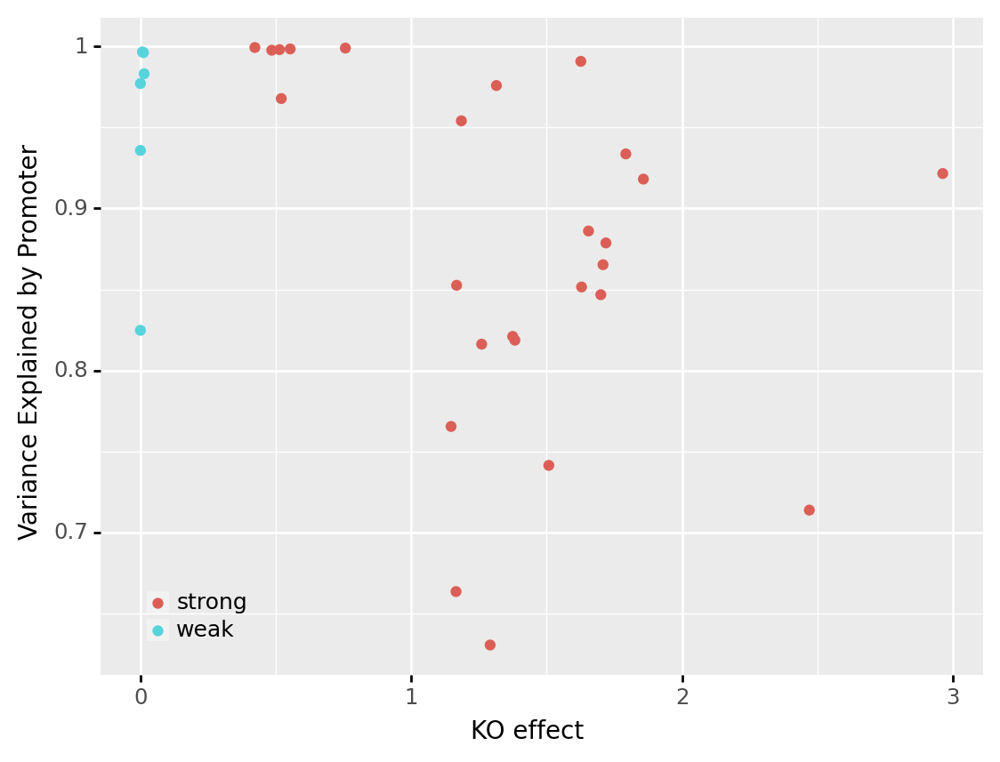

<ggplot: (1440285954807)>

In [33]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=var_explained
           ,mapping=p9.aes(x="abs_log2_fc_pred",y='r2_prom',color="candidate_type"))
 #+ p9.scale_y_log10()
 #+ p9.scale_x_log10()
 #+ p9.geom_smooth(method="lm")
 #+ p9.facet_wrap('~dataset_name')
 + p9.geom_point()
 + p9.labs(x="KO effect",y="Variance Explained by Promoter", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.05}
           )
)
p

#### What happens to the real promoter at each location?

In [34]:
real_prom = results.merge(candidate_locs[["location_key","promoter_id","log2_fc_pred","abs_log2_fc_pred",
                                          "candidate_type","actual_tss_distance",pred_col + "_ref",pred_col + "_alt"]],on=["location_key","promoter_id"])
real_prom["dev_from_ref"] = np.abs(real_prom[pred_col + "_ref"] - real_prom["log_pred_col"])

In [41]:
# sanity check
real_pair = real_prom.merge(candidate_locs[["location_key","enhancer_id","main_tss_bin"]],on=["location_key","enhancer_id"])
real_pair[["location_key","promoter_id","enhancer_id","dev_from_ref","actual_tss_distance",pred_col+"_ref","log_pred_col","main_tss_bin"]].sort_values("dev_from_ref").tail(5)

,location_key,promoter_id,enhancer_id,dev_from_ref,actual_tss_distance,"CAGE:chronic myelogenous leukemia cell line:K562 ENCODE, biol__landmark_sum_ref",log_pred_col,main_tss_bin
10,gasperini2019_CD69_9764660-9765179,chr12:9760902-9761030,chr12:9763919-9765919,0.002788,3953,3.272439,3.269651,448
7,gasperini2019_C3_6652567-6653052,chr19:6720562-6720690,chr19:6651809-6653809,0.004817,67817,3.786209,3.791027,599
8,gasperini2019_C3_6659890-6660036,chr19:6720562-6720690,chr19:6658963-6660963,0.004897,60663,3.786208,3.791105,599
2,gasperini2019_ALAS2_55116629-55116926,chrX:55030940-55031068,chrX:55115777-55117777,0.005523,85773,3.127716,3.133239,458
3,gasperini2019_ALAS2_55120753-55121178,chrX:55030940-55031068,chrX:55119965-55121965,0.006615,89961,3.126624,3.133239,458


In [51]:
real_prom_mean = real_prom.groupby(['location_key','promoter_id'])[["log_pred_col"]].mean().reset_index()
real_prom_std = real_prom.groupby(['location_key','promoter_id'])[["log_pred_col"]].std().reset_index().rename(columns={"log_pred_col":"std"})
real_prom_merged = (real_prom[['location_key','promoter_id',"log2_fc_pred","abs_log2_fc_pred","candidate_type","actual_tss_distance",
                               pred_col + "_ref",pred_col + "_alt"]]
                    .drop_duplicates()
                    .merge(real_prom_mean.merge(real_prom_std,on=["location_key","promoter_id"]),on=["location_key","promoter_id"]))
real_prom_merged["dev_from_ref"] = np.abs(real_prom_merged[pred_col + "_ref"] - real_prom_merged["log_pred_col"])
real_prom_merged["dev_from_alt"] = np.abs(real_prom_merged[pred_col + "_alt"] - real_prom_merged["log_pred_col"])
real_prom_merged = real_prom_merged.merge(var_explained[["location_key","r2_prom"]], on="location_key")

In [52]:
# the deviation of the mean expression from the reference (the one with the real enhancer)
# if low: every enhancer works like the "real" one
# if high: no enhancer works like the "real" one
real_prom_merged.sort_values("dev_from_ref")

,location_key,promoter_id,log2_fc_pred,abs_log2_fc_pred,candidate_type,actual_tss_distance,"CAGE:chronic myelogenous leukemia cell line:K562 ENCODE, biol__landmark_sum_ref","CAGE:chronic myelogenous leukemia cell line:K562 ENCODE, biol__landmark_sum_alt",log_pred_col,std,dev_from_ref,dev_from_alt,r2_prom
1,fulco2019_NFE2_54287161-54288101,chr12:54300975-54301103,-0.011645,0.011645,weak,13408,9.755257,9.743612,9.755539,0.030230,0.000282,0.011927,0.996267
0,fulco2019_NFE2_54286541-54287101,chr12:54300975-54301103,-0.007878,0.007878,weak,14218,9.755201,9.747323,9.750066,0.028602,0.005135,0.002743,0.996681
24,gasperini2019_PTBP1_789249-789664,chr19:797358-797486,-0.000300,0.000300,weak,7966,9.335265,9.334965,9.347618,0.019411,0.012353,0.012653,0.977149
26,gasperini2019_RPL26_8386953-8387244,chr17:8383161-8383289,-0.000276,0.000276,weak,3873,9.354367,9.354091,9.369699,0.023655,0.015332,0.015608,0.935852
6,gasperini2019_C3AR1_7989838-7990337,chr12:8066349-8066477,0.422839,0.422839,strong,76326,5.164151,5.586990,5.180277,0.067502,0.016126,0.406713,0.999404
8,gasperini2019_C3_6659890-6660036,chr19:6720562-6720690,0.553232,0.553232,strong,60663,3.786208,4.339440,3.818376,0.165485,0.032168,0.521064,0.998530
7,gasperini2019_C3_6652567-6653052,chr19:6720562-6720690,0.757109,0.757109,strong,67817,3.786209,4.543318,3.834070,0.108949,0.047861,0.709248,0.999061
5,gasperini2019_BEX4_103211079-103211362,chrX:103215115-103215243,-0.000259,0.000259,weak,3959,8.889938,8.889678,8.967126,0.120721,0.077189,0.077448,0.824734
3,gasperini2019_ALAS2_55120753-55121178,chrX:55030940-55031068,0.513913,0.513913,strong,89961,3.126624,3.640537,3.279963,0.181511,0.153339,0.360574,0.998089
2,gasperini2019_ALAS2_55116629-55116926,chrX:55030940-55031068,0.485184,0.485184,strong,85773,3.127716,3.612900,3.286103,0.196698,0.158387,0.326796,0.997732


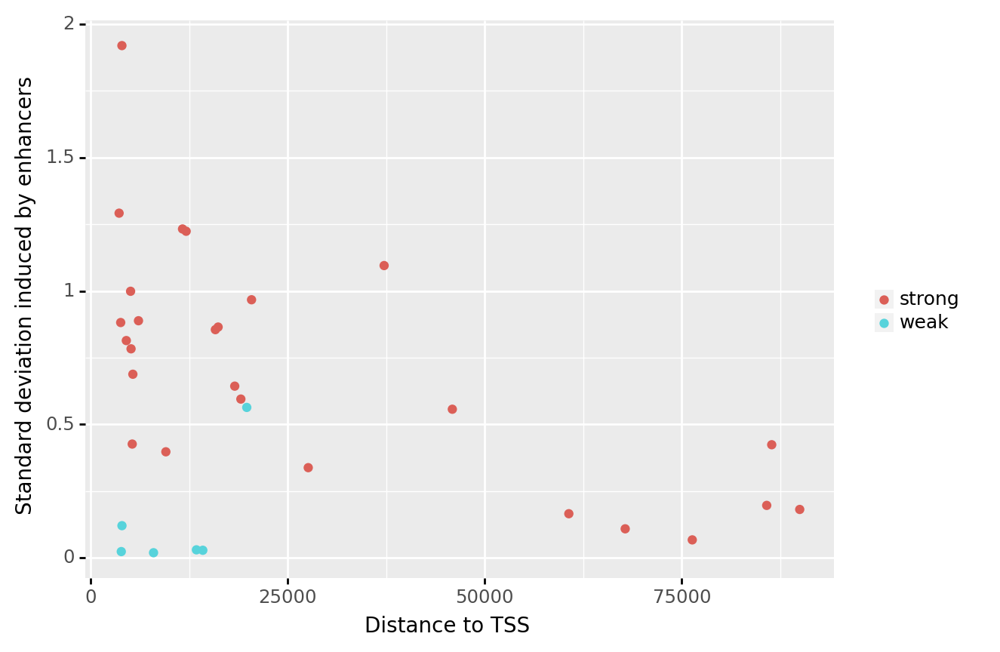

<ggplot: (1440264970713)>

In [45]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=real_prom_merged
           ,mapping=p9.aes(x="actual_tss_distance",y='std',color="candidate_type"))
 #+ p9.scale_y_log10()
 #+ p9.scale_x_log10()
 #+ p9.geom_smooth(method="lm")
 #+ p9.facet_wrap('~dataset_name')
 + p9.geom_point()
 + p9.labs(x="Distance to TSS",y="Standard deviation induced by enhancers", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            #legend_position=(0.21,0.2),
            legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.05}
           )
)
p

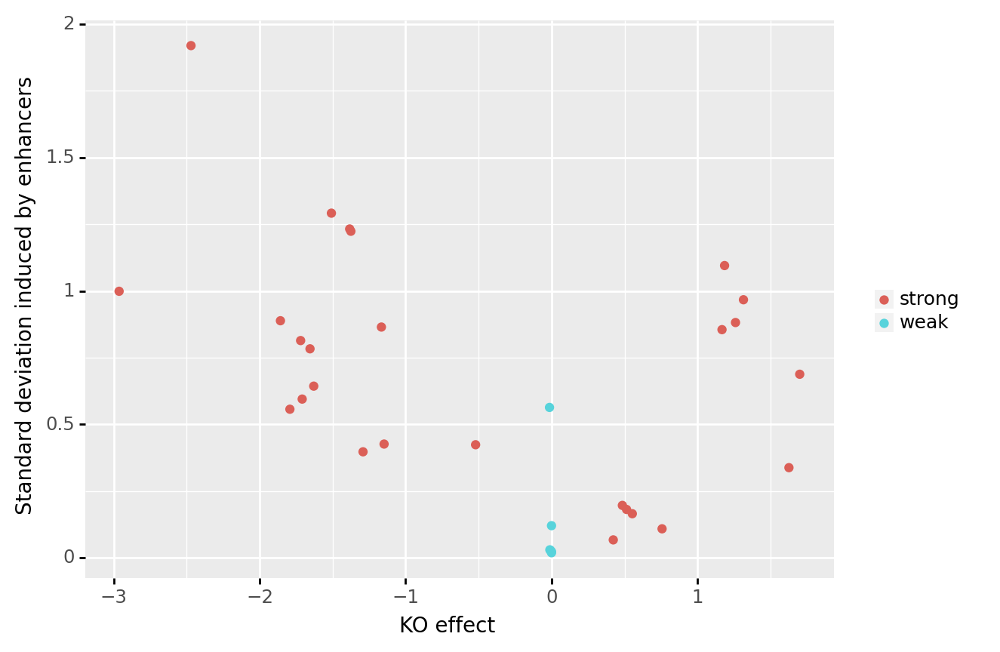

<ggplot: (1440253739514)>

In [47]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=real_prom_merged#.query('actual_tss_distance > 50_000')
           ,mapping=p9.aes(x="log2_fc_pred",y='std',color="candidate_type"))
 #+ p9.scale_y_log10()
 #+ p9.scale_x_log10()
 #+ p9.geom_smooth(method="lm")
 #+ p9.facet_wrap('~dataset_name')
 + p9.geom_point()
 + p9.labs(x="KO effect",y="Standard deviation induced by enhancers", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            #legend_position=(0.21,0.2),
            legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.05}
           )
)
p

#### Correlation of per-region enhancer effect with ko-effect

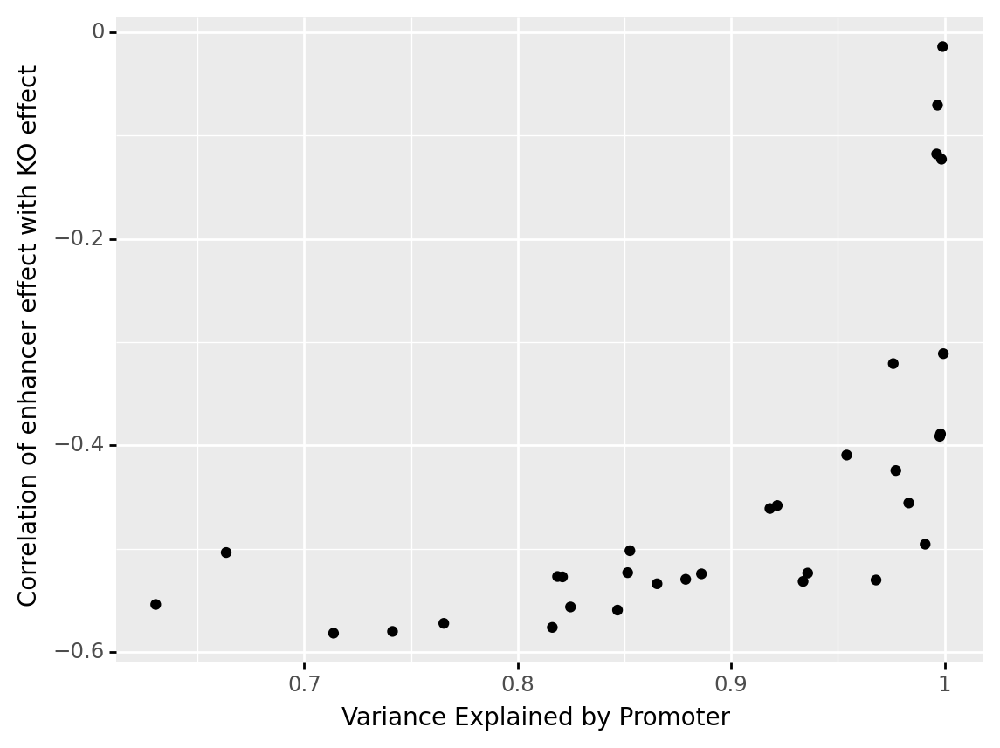

<ggplot: (1440250149096)>

In [53]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=var_explained
           ,mapping=p9.aes(x="r2_prom",y='corr_with_ko'))
 #+ p9.scale_y_log10()
 #+ p9.scale_x_log10()
 #+ p9.geom_smooth(method="lm")
 #+ p9.facet_wrap('~dataset_name')
 + p9.geom_point()
 + p9.labs(x="Variance Explained by Promoter",y="Correlation of enhancer effect with KO effect", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.05}
           )
)
p

#### Correlate promoter effects

In [54]:
# correlate parameters
params_pivot = mult_params[["Name","param","location_key"]].pivot('Name','location_key')
params_pivot.columns = params_pivot.columns.get_level_values(1)
params_pivot = params_pivot.reset_index()
prom_corr = params_pivot.loc[params_pivot.Name.str.startswith('prom')].corr()
enh_corr = params_pivot.loc[params_pivot.Name.str.startswith('enh')].corr()

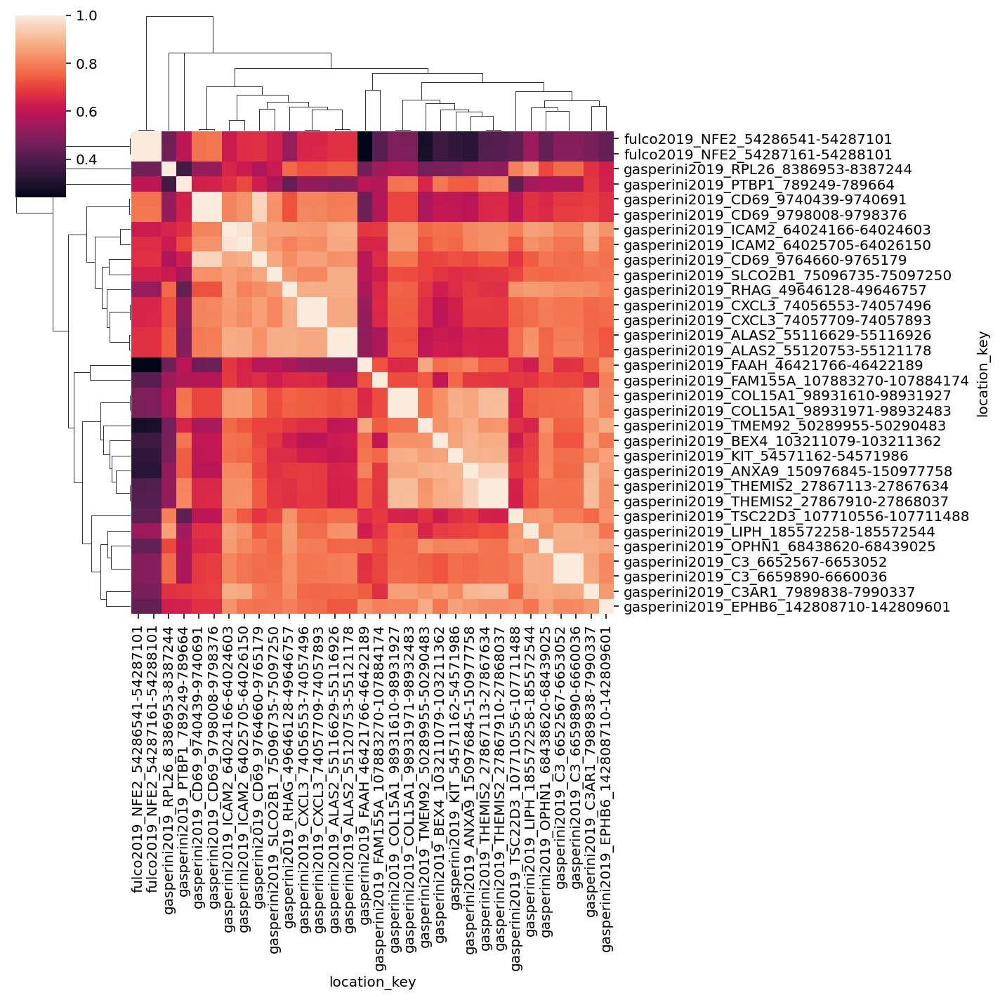

In [55]:
sns_plot = sns.clustermap(prom_corr)

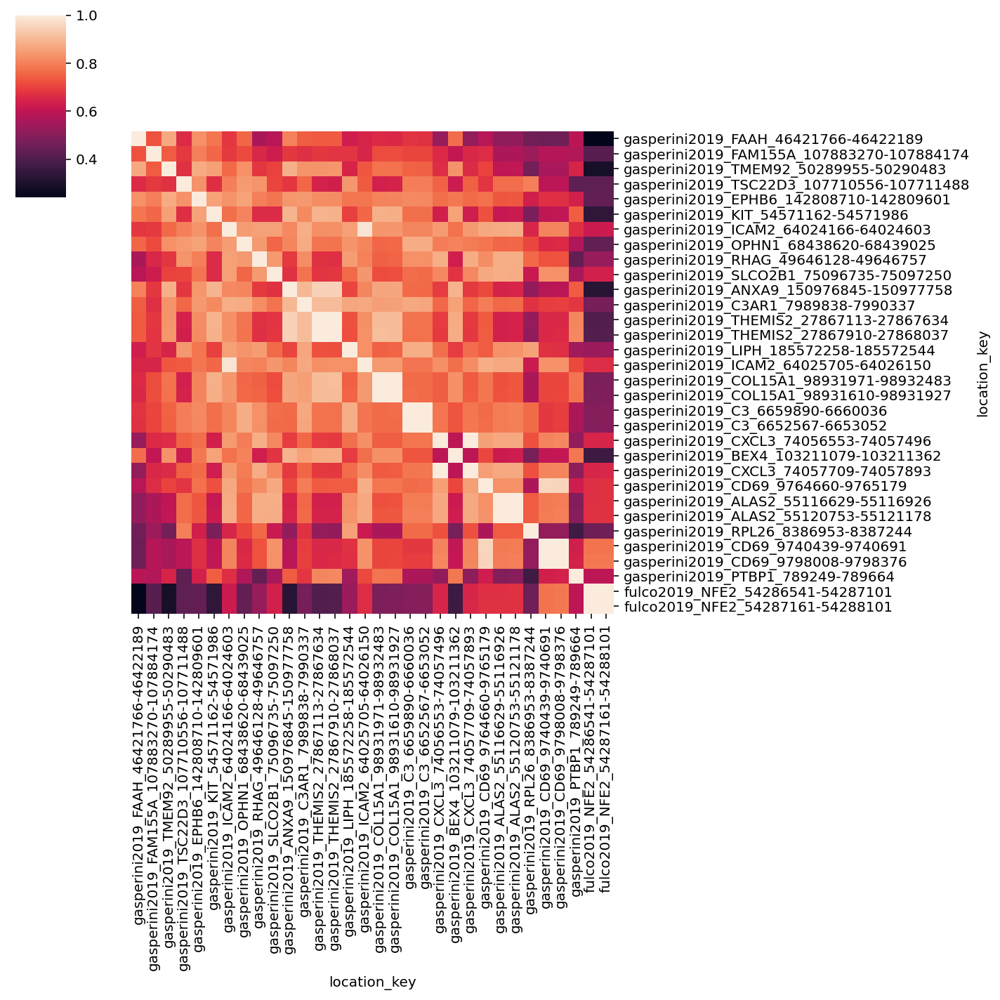

In [56]:
cluster_df = prom_corr.copy().reset_index()
cluster_df["location_key"] = pd.Categorical(cluster_df["location_key"], 
                                            categories=[x for x in var_explained.sort_values('avg_expr')["location_key"]])
cluster_df = cluster_df.sort_values("location_key")
cluster_df = cluster_df.set_index('location_key')
cluster_df = cluster_df[[x for x in var_explained.sort_values('avg_expr')["location_key"]]]

sns_plot = sns.clustermap(cluster_df,col_cluster=False,row_cluster=False)

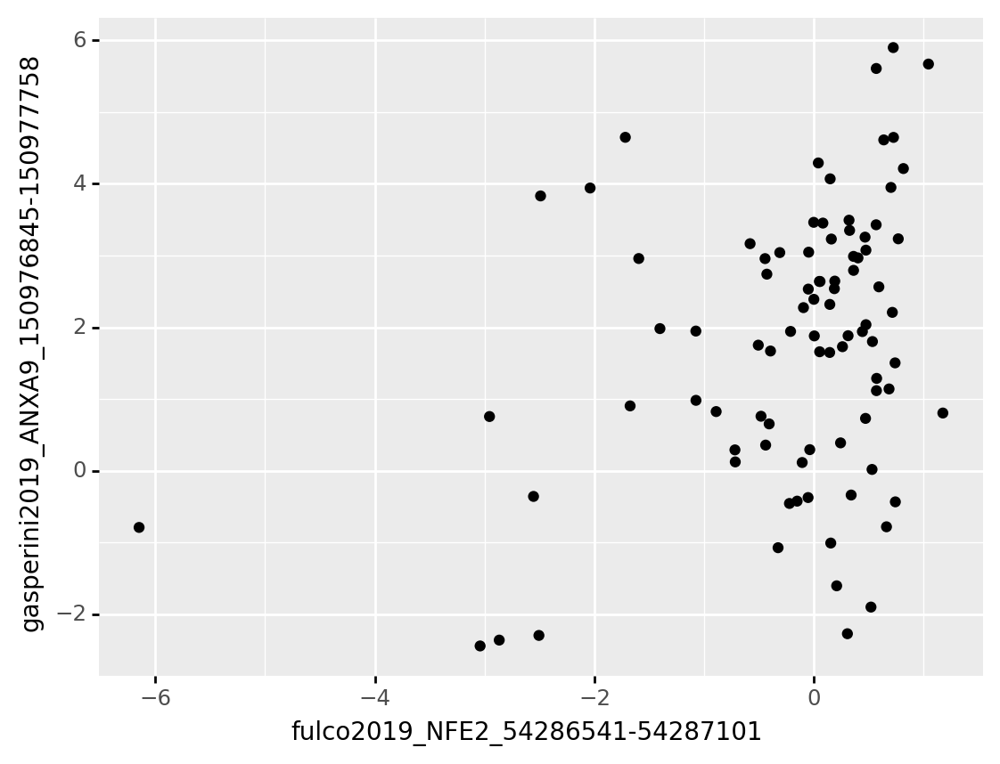

<ggplot: (1440187342821)>

In [57]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=params_pivot.loc[params_pivot.Name.str.startswith('prom')]
           ,mapping=p9.aes(x="fulco2019_NFE2_54286541-54287101",y='gasperini2019_ANXA9_150976845-150977758'))
 #+ p9.scale_y_log10()
 #+ p9.scale_x_log10()
 #+ p9.geom_smooth(method="lm")
 #+ p9.facet_wrap('~dataset_name')
 + p9.geom_point()
 #+ p9.labs(x="",y="", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.05}
           )
)
p

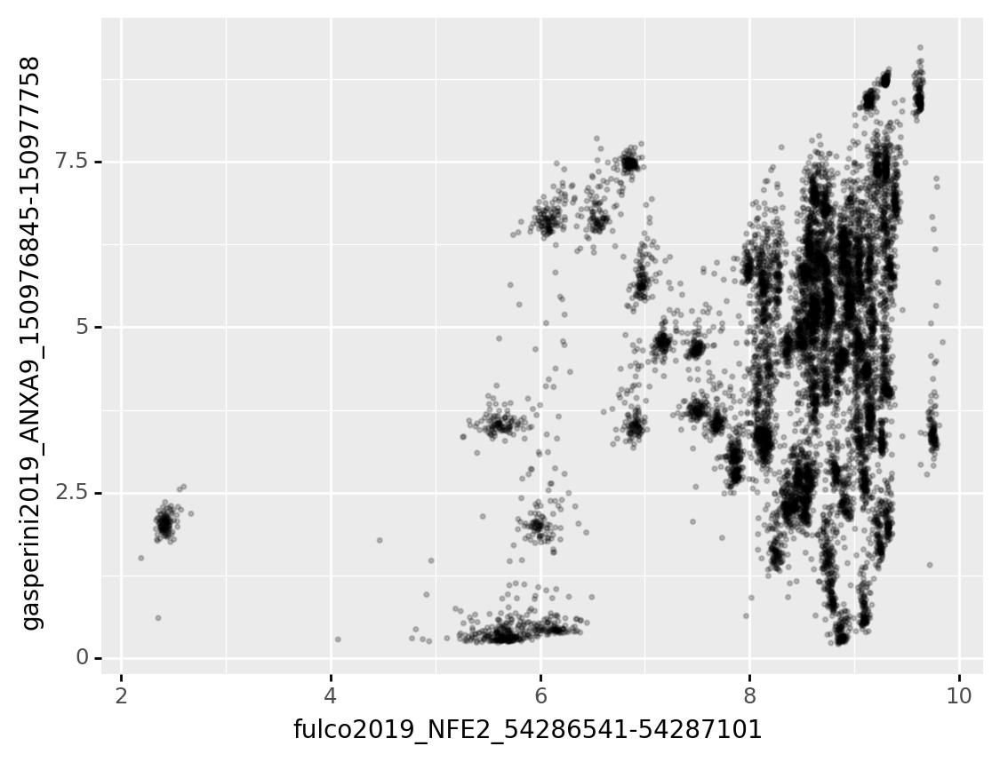

<ggplot: (1440229992253)>

In [58]:
x_loc = "fulco2019_NFE2_54286541-54287101"
y_loc = "gasperini2019_ANXA9_150976845-150977758"
loc_list = [x_loc,y_loc]

comparison = (results
              .query('location_key in @loc_list')
              [["location_key","promoter_id","enhancer_id","log_pred_col"]]
              .pivot(['enhancer_id','promoter_id'],'location_key')
             )
comparison.columns = comparison.columns.get_level_values(1)
comparison = comparison.reset_index()

scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=comparison
           ,mapping=p9.aes(x=x_loc,y=y_loc))
 #+ p9.scale_y_log10()
 #+ p9.scale_x_log10()
 #+ p9.geom_smooth(method="lm")
 #+ p9.facet_wrap('~dataset_name')
 + p9.geom_point(size=0.5,alpha=0.2)
 #+ p9.labs(x="",y="", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.05}
           )
)
p

#### Correlate enhancer effects

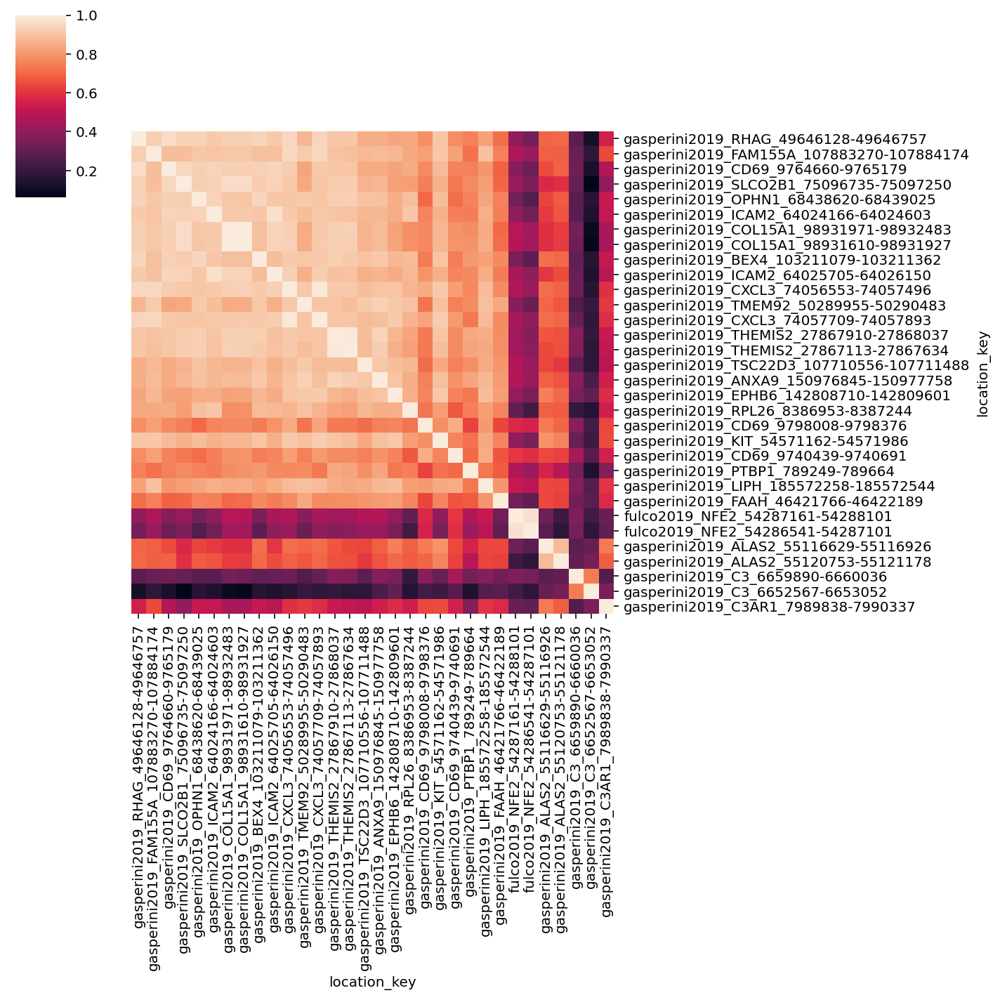

In [59]:
cluster_df = enh_corr.copy().reset_index()
cluster_df["location_key"] = pd.Categorical(cluster_df["location_key"], 
                                            categories=[x for x in var_explained.sort_values('r2_prom')["location_key"]])
cluster_df = cluster_df.sort_values("location_key")
cluster_df = cluster_df.set_index('location_key')
cluster_df = cluster_df[[x for x in var_explained.sort_values('r2_prom')["location_key"]]]

sns_plot = sns.clustermap(cluster_df,col_cluster=False,row_cluster=False)

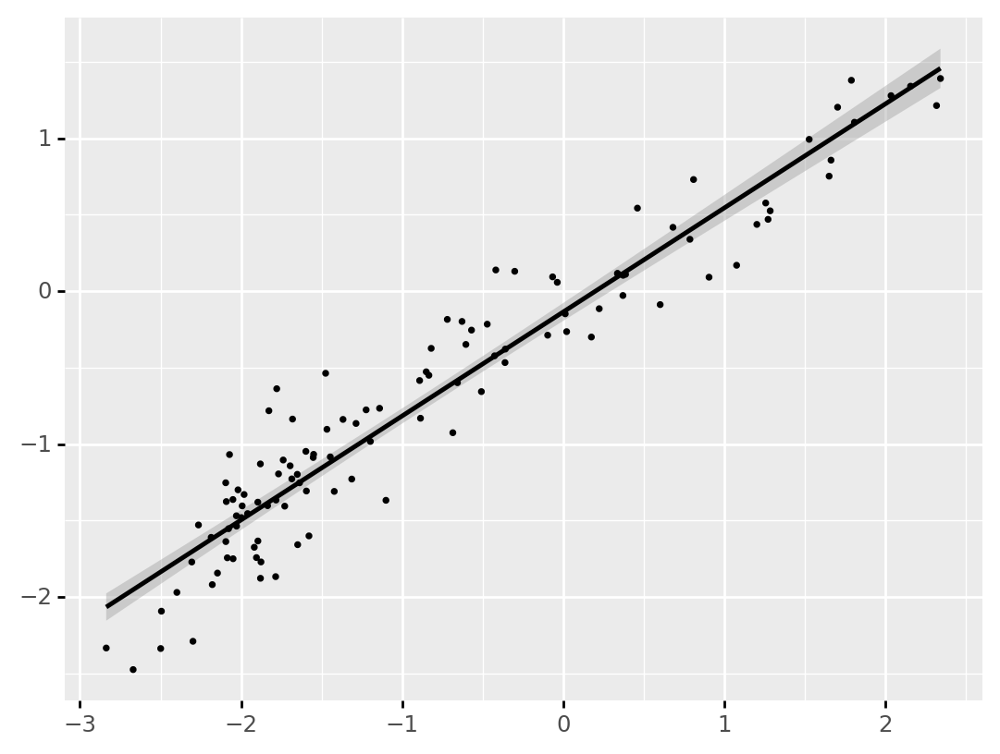

<ggplot: (1440241683658)>

In [60]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=params_pivot.loc[params_pivot.Name.str.startswith('enh')]
           ,mapping=p9.aes(x="gasperini2019_RHAG_49646128-49646757",y='gasperini2019_CD69_9764660-9765179'))
 #+ p9.scale_y_log10()
 #+ p9.scale_x_log10()
 + p9.geom_smooth(method="lm")
 #+ p9.facet_wrap('~dataset_name')
 + p9.geom_point(size=0.5)
 + p9.labs(x="",y="", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.05}
           )
)
p

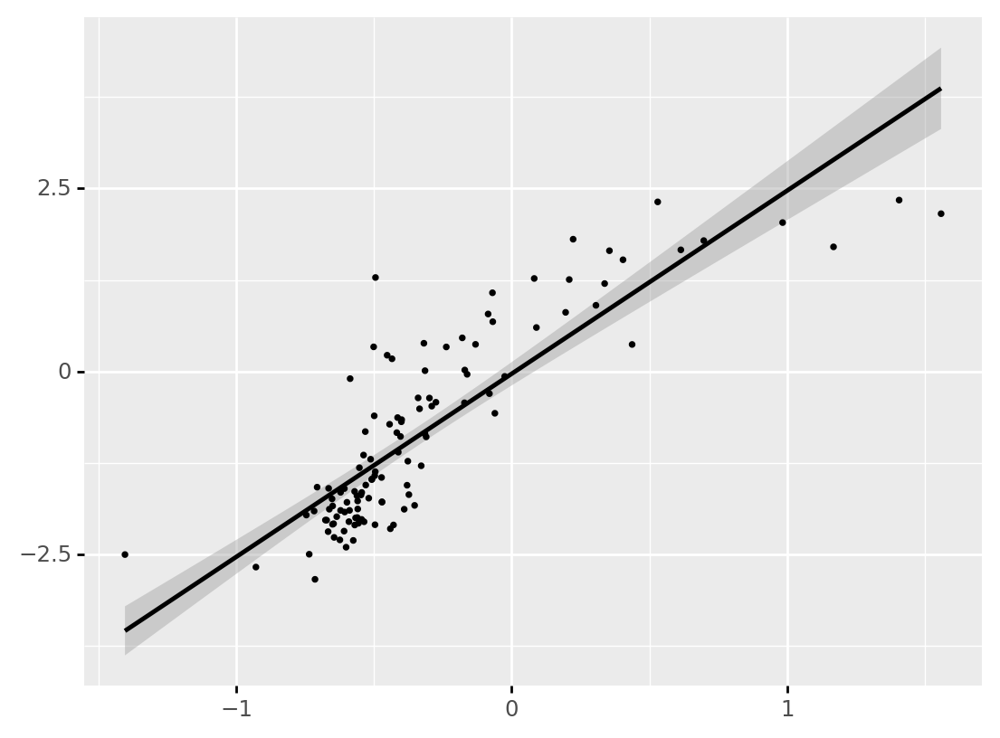

<ggplot: (1440248607582)>

In [61]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=params_pivot.loc[params_pivot.Name.str.startswith('enh')]
           ,mapping=p9.aes(x="gasperini2019_ANXA9_150976845-150977758",y='gasperini2019_RHAG_49646128-49646757'))
 #+ p9.scale_y_log10()
 #+ p9.scale_x_log10()
 + p9.geom_smooth(method="lm")
 #+ p9.facet_wrap('~dataset_name')
 + p9.geom_point(size=0.5)
 + p9.labs(x="",y="", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.05}
           )
)
p

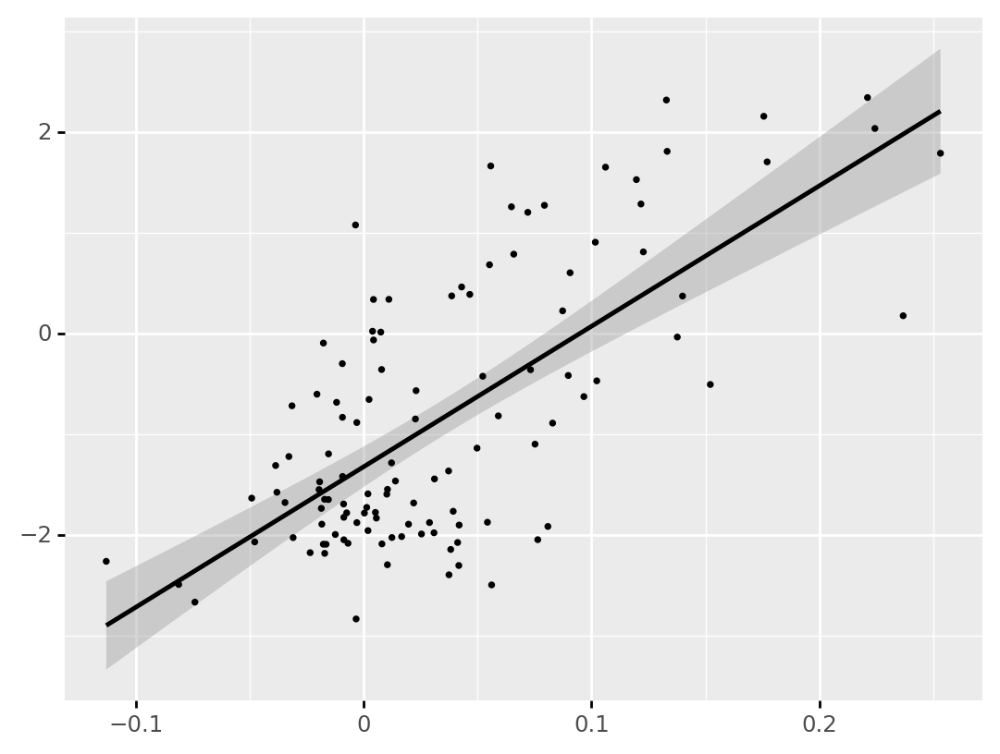

<ggplot: (1440217571079)>

In [62]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=params_pivot.loc[params_pivot.Name.str.startswith('enh')]
           ,mapping=p9.aes(x="gasperini2019_ALAS2_55116629-55116926",y='gasperini2019_RHAG_49646128-49646757'))
 #+ p9.scale_y_log10()
 #+ p9.scale_x_log10()
 + p9.geom_smooth(method="lm")
 #+ p9.facet_wrap('~dataset_name')
 + p9.geom_point(size=0.5)
 + p9.labs(x="",y="", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.05}
           )
)
p

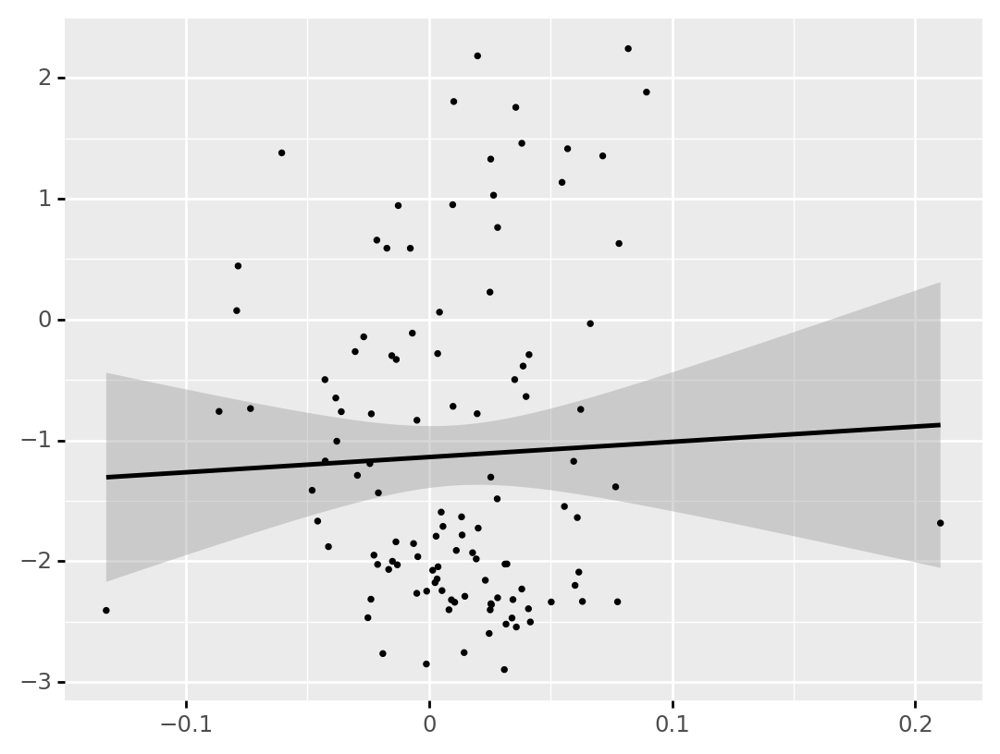

<ggplot: (1399113925563)>

In [235]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=params_pivot.loc[params_pivot.Name.str.startswith('enh')]
           ,mapping=p9.aes(x="gasperini2019_C3_6652567-6653052",y='gasperini2019_RHAG_49646128-49646757'))
 #+ p9.scale_y_log10()
 #+ p9.scale_x_log10()
 + p9.geom_smooth(method="lm")
 #+ p9.facet_wrap('~dataset_name')
 + p9.geom_point(size=0.5)
 + p9.labs(x="",y="", color="", fill="")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_position=(0.21,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10), subplots_adjust={'wspace': 0.05}
           )
)
p

#### Heatmap for "best" location

### Location and Multplicative model for each Promoter

In [ ]:
promoters = set(results["promoter_id"])

rows = []
param_df_list_loc = []
param_df_list_mult = []
pred_df_list_loc = []
pred_df_list_mult = []
for prom in promoters:
    subset = results.query('promoter_id == @prom')
    # promoter model
    loc_preds, loc_params, loc_r2 = fit_and_predict(subset,"log_pred_col",["location_key"],"location",prom,id_col="promoter_id")
    # promoter + enhancer model
    mult_preds, mult_params, mult_r2 = fit_and_predict(subset,"log_pred_col",["location_key","enhancer_id"],"multiplicative",prom,id_col="promoter_id")
    # metrics
    rows.append({"promoter_id":prom,
                 "r2_loc":loc_r2,
                 "r2_mult":mult_r2, 
                 "avg_expr":subset["log_pred_col"].mean(),
                 "total_std":subset["log_pred_col"].std(),
                 "median_std":subset.groupby('location_key')["log_pred_col"].std().median(),
                 "max_std":subset.groupby('location_key')["log_pred_col"].std().max()})
    # params
    param_df_list_loc.append(loc_params)
    param_df_list_mult.append(mult_params)
    # preds
    pred_df_list_loc.append(loc_preds)
    pred_df_list_mult.append(mult_preds)
    
var_explained_prom = pd.DataFrame(rows)
mult_params_prom = pd.concat(param_df_list_mult)
mult_preds_prom = pd.concat(pred_df_list_mult)

#### Variance explained

In [93]:
var_explained_prom_molten = var_explained_prom[["promoter_id","r2_loc","r2_mult"]].melt(id_vars="promoter_id")
var_explained_prom_molten["variable"] = var_explained_prom_molten["variable"].apply(lambda x: "Background" if x =="r2_loc" else "Background +\nEnhancer")
var_explained_prom_molten["promoter_id"] = pd.Categorical(var_explained_prom_molten["promoter_id"],categories=[x for x in var_explained_prom.sort_values("r2_loc")["promoter_id"]])

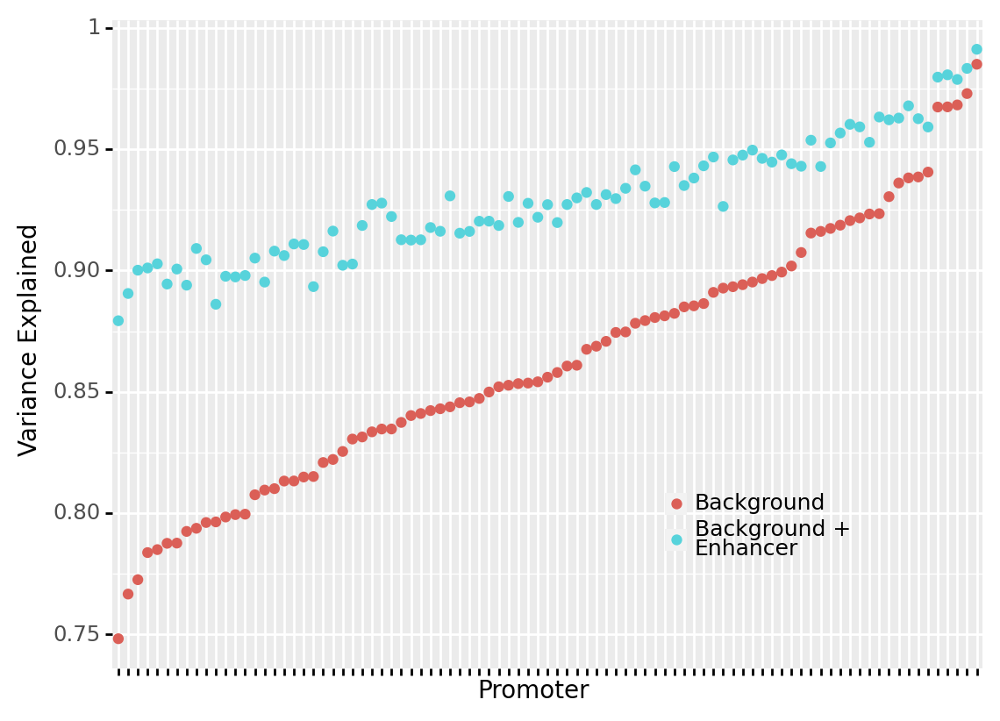

<ggplot: (1444922945829)>

In [94]:
scale = 1.0
p9.options.figure_size = (6.4*scale, 4.8*scale)
p = (p9.ggplot(data=var_explained_prom_molten,mapping=p9.aes(x="promoter_id",y="value",fill="variable",color="variable"))
 #+ p9.geom_bar(stat="identity", position="dodge")
 + p9.geom_point(size = 1.5)
 + p9.labs(x="Promoter", y="Variance Explained", fill="",color="")
 + p9.theme(legend_box_margin=0,legend_key_size =9, 
            legend_text = p9.element_text(size=9),
            legend_background=p9.element_blank(),
            legend_position=(0.7,0.3),
           axis_title=p9.element_text(size=10),
            axis_text_x=p9.element_blank(),
            #axis_ticks_direction_x=p9.element_blank(),
            #axis_text_x=p9.element_text(rotation=90, hjust=1)
           )    
)
p

In [95]:
p.save("Graphics/" + "supfig_insilico_promoter" + ".svg", width=6.7/2, height=3.0, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 3.35 x 3.0 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/supfig_insilico_promoter.svg


#### Correlate enhancer effect

In [48]:
params_pivot_prom = mult_params_prom[["Name","param","promoter_id"]].pivot('Name','promoter_id')
params_pivot_prom.columns = params_pivot_prom.columns.get_level_values(1)
params_pivot_prom = params_pivot_prom.reset_index()
enh_corr_prom = params_pivot_prom.loc[params_pivot_prom.Name.str.startswith('enh')].corr()

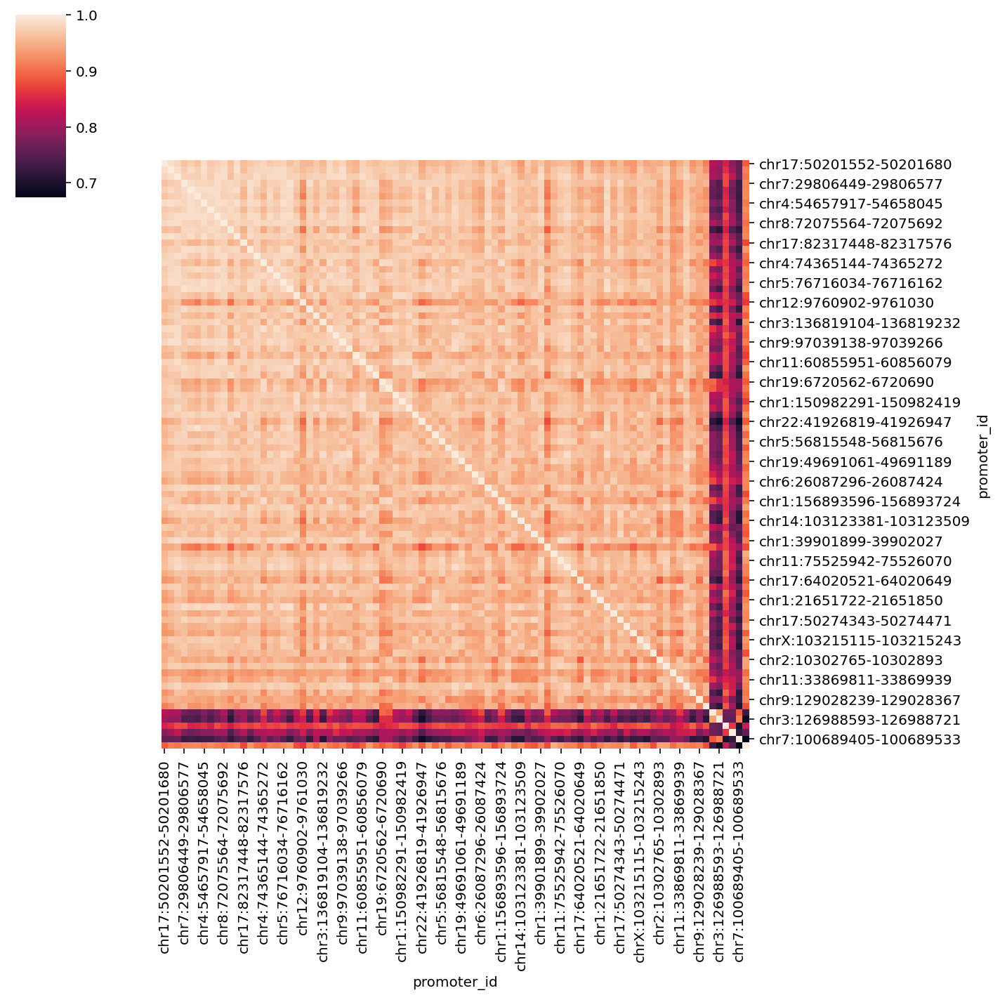

In [52]:
cluster_df = enh_corr_prom.copy().reset_index()
cluster_df["promoter_id"] = pd.Categorical(cluster_df["promoter_id"], 
                                            categories=[x for x in var_explained_prom.sort_values('r2_loc')["promoter_id"]])
cluster_df = cluster_df.sort_values("promoter_id")
cluster_df = cluster_df.set_index('promoter_id')
cluster_df = cluster_df[[x for x in var_explained_prom.sort_values('r2_loc')["promoter_id"]]]

sns_plot = sns.clustermap(cluster_df,col_cluster=False,row_cluster=False)

### Overall model: Promoter + Enhancer + Location

In [64]:
dep_var = "log_pred_col"
indep_vars = ["location_key"]

res_enformer = (statsmodels.regression.linear_model.OLS
                .from_formula("{} ~ {}".format(dep_var, " + ".join(indep_vars)),
                              data=results)).fit()
sklearn.metrics.r2_score(results[dep_var], res_enformer.predict())

0.2982163525972319

In [65]:
dep_var = "log_pred_col"
indep_vars = ["promoter_id"]

res_enformer = (statsmodels.regression.linear_model.OLS
                .from_formula("{} ~ {}".format(dep_var, " + ".join(indep_vars)),
                              data=results)).fit()
sklearn.metrics.r2_score(results[dep_var], res_enformer.predict())

0.4431450308148501

In [66]:
dep_var = "log_pred_col"
indep_vars = ["promoter_id","location_key"]

res_enformer = (statsmodels.regression.linear_model.OLS
                .from_formula("{} ~ {}".format(dep_var, " + ".join(indep_vars)),
                              data=results)).fit()
print(sklearn.metrics.r2_score(results[dep_var], res_enformer.predict()))

results["loc_prom_residuals"] = results["log_pred_col"] - res_enformer.predict()

0.741361383412082


In [67]:
dep_var = "log_pred_col"
indep_vars = ["promoter_id","enhancer_id","location_key"]

res_enformer = (statsmodels.regression.linear_model.OLS
                .from_formula("{} ~ {}".format(dep_var, " + ".join(indep_vars)),
                              data=results)).fit()
sklearn.metrics.r2_score(results[dep_var], res_enformer.predict())

0.7743839625362549

In [102]:
res_enformer = (statsmodels.regression.linear_model.OLS
                .from_formula("log_pred_col ~ promoter_id:location_key",
                              data=results)).fit()
sklearn.metrics.r2_score(results[dep_var], res_enformer.predict())

0.9196309811054565

### Compute consistency of enhancer effect per promoter

Here we remove the average effect per promoter and location (this is like the residual of a model with promoter:location interaction term)

So all remaining variation should be caused by the enhancer

We then check whether, holding the promoter fixed, does the same enhancer have similar effects across locations?

In [20]:
prom_pivot = results[["location_key","enhancer_id","promoter_id","log_pred_col"]]
prom_pivot = (prom_pivot.groupby(['location_key','promoter_id'])['log_pred_col']
                              .mean().reset_index().rename(columns={"log_pred_col":"loc_prom_mean"})
                              .merge(prom_pivot,on=['location_key','promoter_id'])
                             )
print(sklearn.metrics.r2_score(prom_pivot["log_pred_col"],prom_pivot["loc_prom_mean"]))
prom_pivot["loc_prom_residual"] = prom_pivot["log_pred_col"] - prom_pivot["loc_prom_mean"]
#prom_pivot = prom_pivot[["location_key","enhancer_id","promoter_id","loc_prom_residual"]].pivot(["location_key","enhancer_id"],"promoter_id")
#prom_pivot.columns = prom_pivot.columns.get_level_values(1)

0.916764498526163


In [21]:
res_enformer = (statsmodels.regression.linear_model.OLS
                .from_formula("loc_prom_residual ~ enhancer_id",
                              data=prom_pivot)).fit()
sklearn.metrics.r2_score(prom_pivot["loc_prom_residual"], res_enformer.predict())

0.39673671137252353

In [ ]:
res_enformer.summary()

In [26]:
prom_pivot = prom_pivot[["location_key","enhancer_id","promoter_id","loc_prom_residual"]].pivot(["location_key","enhancer_id"],"promoter_id")
prom_pivot.columns = prom_pivot.columns.get_level_values(1)

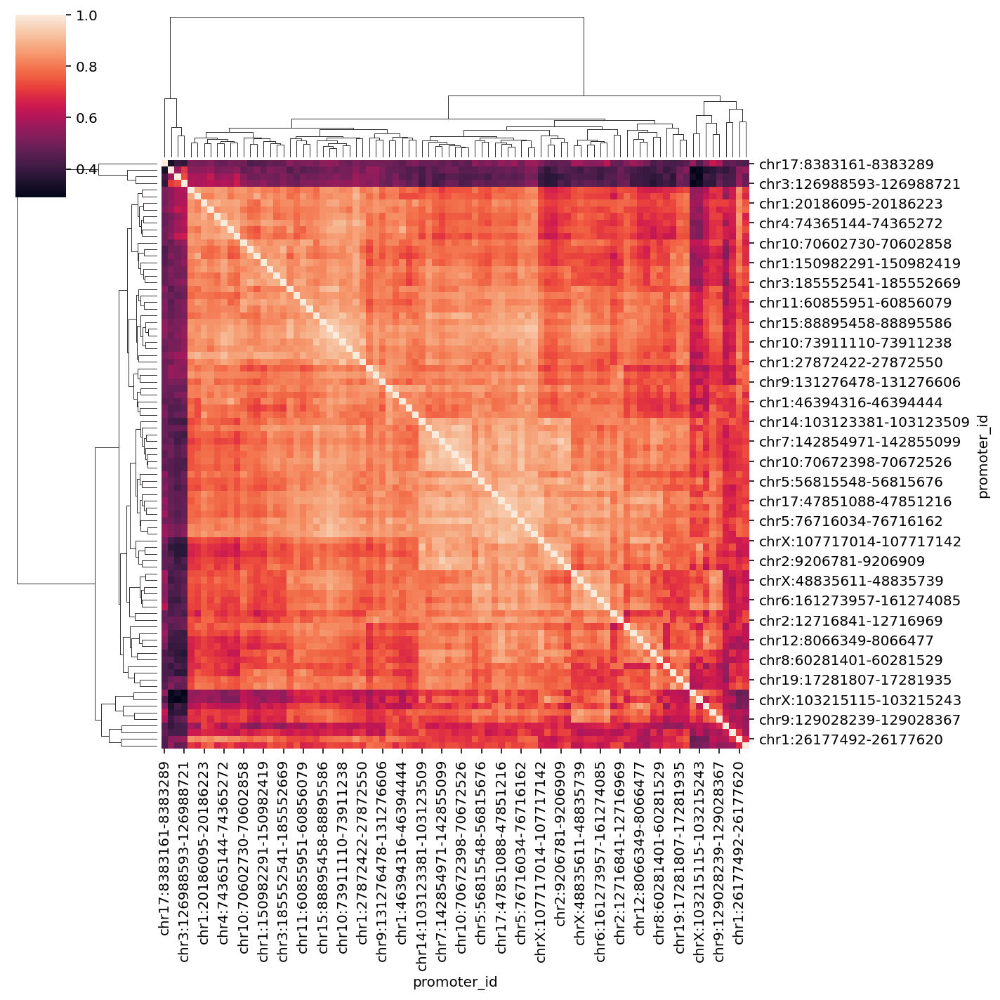

In [27]:
sns_plot = sns.clustermap(prom_pivot.corr())

# What fraction of the sequence influences predictions? (GTEx + (eQTL) + Cardoso-Moreira et al. (Kaessmann lab))

Here we:

- Analyze the performance of Xpresso, Basenji2 and Enformer on the GTEx data
- Analyze to what extent proximal and distal sequence contribute
- Test Enformer on GTEx eQTL

In [8]:
base_path_data = "Data/GTEX/"
base_path_data_kaessmann = "Data/Kaessmann/"
base_path_data_gtex_fc = "Data/gtex_aFC/"
base_path_data_tss_sim = "Data/TSS_sim/"
base_path_data_fulco = "Data/Fulco_CRISPRi/"
base_path_results = "Results/TSS_sim/"
base_path_results_xpresso = "Results/TSS_Xpresso/"
base_path_results_gtex_fc = "Results/gtex_aFC/"

In [9]:
# load gtex data
gtex_df = (pd.read_csv(base_path_data + "GTEx_Analysis_2017-06-05_v8_RNASeQCv1.1.9_gene_median_tpm.gct", sep="\t")
           .rename(columns={'Name':'gene_id','Description':'gene_name'})
          )
tissues = gtex_df.keys()[2:]
gtex_df = gtex_df.loc[~gtex_df.gene_id.str.endswith("PAR_Y")]
gtex_molten = gtex_df.melt(id_vars=['gene_id','gene_name'], var_name="tissue", value_name='observed_tpm')
gtex_molten['gene_id'] = gtex_molten['gene_id'].apply(lambda x: x.split('.')[0])

# remove genes which are never expressed (otherwise removing colMean will create phantom deviation for these)
nonexpressed_genes = set(gtex_molten.groupby('gene_id')["observed_tpm"].max().reset_index().query('observed_tpm == 0')["gene_id"])
gtex_molten = gtex_molten.query('gene_id not in @nonexpressed_genes')

In [10]:
# load kaessmann data
kaessmann_df = (pd.read_csv(base_path_data_kaessmann + "Human.RPKM.txt", sep=" ")
                .reset_index()
           .rename(columns={'index':'gene_id'})
          )
dev_tissues = kaessmann_df.keys()[1:]
kaessmann_molten = kaessmann_df.melt(id_vars=['gene_id'], var_name="sample", value_name='observed_tpm')
kaessmann_molten['gene_id'] = kaessmann_molten['gene_id'].apply(lambda x: x.split('.')[0])

# remove genes which are never expressed (otherwise removing colMean will create phantom deviation for these)
nonexpressed_genes = (kaessmann_molten.groupby('gene_id')["observed_tpm"].max().reset_index().query('observed_tpm == 0')["gene_id"])
kaessmann_molten = kaessmann_molten.query('gene_id not in @nonexpressed_genes')

In [11]:
test_set = pd.read_csv(base_path_data + "human_regions.bed", names=["Chromosome","Start","End","set"], sep="\t").query('set == "test"')

In [12]:
length_df = gtf_df.df.query('Feature == "exon"')
length_df["len"] = length_df["End"] - length_df["Start"]
length_df = length_df.groupby(['gene_id','transcript_id'])['len'].sum().reset_index()
length_df = length_df.groupby(['gene_id'])['len'].median().reset_index()

In [13]:
# compute length for each gene
gene_locs = gtf_df.df.query('Feature == "gene"')[["Chromosome","Start","End","Score","Strand","Frame","gene_id"]]
gene_locs = gene_locs.merge(length_df, on="gene_id")
gene_locs = gene_locs.loc[~gene_locs.gene_id.str.endswith("PAR_Y")]
gene_locs["gene_id"] = gene_locs["gene_id"].apply(lambda x: x.split('.')[0])

In [14]:
# remove y and MT chromosome from gtex and kaessmann
y_mt_chrom_genes = set(gene_locs.query('Chromosome == "chrY" or Chromosome == "chrMT"')["gene_id"])
gtex_molten = gtex_molten.query('gene_id not in @y_mt_chrom_genes')
kaessmann_molten = kaessmann_molten.query('gene_id not in @y_mt_chrom_genes')

In [15]:
# test genes are those which are fully contained in a test region
test_genes = set(test_set.merge(gene_locs, on="Chromosome",suffixes=("","_gene"))
                 .query('Start < Start_gene & End > End_gene')["gene_id"])

In [16]:
# train genes are all those which do not at all intersect a test region
intersect_genes = set(test_set.merge(gene_locs, on="Chromosome",suffixes=("","_gene"))
                      .query('(Start < Start_gene & End > Start_gene) or (Start < End_gene & End > End_gene)')["gene_id"])

In [17]:
# sanity check: ensure that no test gene touches a train region
#non_test_set = pd.read_csv(base_path_data + "human_regions.bed", names=["Chromosome","Start","End","set"], sep="\t").query('set != "test"')
#train_genes = set(non_test_set.merge(gene_locs, on="Chromosome",suffixes=("","_gene"))
#                  .query('(Start < Start_gene & End > Start_gene) | (Start < End_gene & End > End_gene)')["gene_id"])
#assert len(train_genes & test_genes) == 0

# another way to do it
#assert len(set(non_test_set.merge(gene_locs.query('gene_id in @test_genes'), on="Chromosome",suffixes=("","_gene"))
#                  .query('(Start < Start_gene & End > Start_gene) | (Start < End_gene & End > End_gene)')["gene_id"])) == 0

In [18]:
def fit_and_pred(lm, X_train, X_test, y_train, y_test):
    lm.fit(X_train, y_train)
    y_pred_train = lm.predict(X_train).reshape(-1)
    y_pred_test = lm.predict(X_test).reshape(-1)
    return lm, y_pred_train, y_pred_test

def null_model_pred(y_train, y_test, subset_train, subset_test, covariates):
    if len(covariates) > 0:
        X_train = subset_train[covariates]
        X_test = subset_test[covariates]
        lm_null = sklearn.linear_model.LinearRegression()
    else:
        X_train = np.ones(len(y_train))[:,np.newaxis]
        X_test = np.ones(len(y_test))[:,np.newaxis]
        lm_null = sklearn.linear_model.LinearRegression(fit_intercept=False)
    lm_null, y_pred_train_null, y_pred_test_null = fit_and_pred(lm_null, X_train, X_test, y_train, y_test)
    return np.concatenate([y_pred_train_null,y_pred_test_null])


def linearmodel_match_windowed(gene_df, obs_df, samples, sample_col, locs_df, windows, 
                               model_name, dataset_name,
                               lm = sklearn.linear_model.Lasso(alpha=0.0004), print_alpha=False,
                               remove_mean=True, covariates=[]):
    import warnings
    warnings.filterwarnings("ignore")

    windows = [str(x) if x != -1 else "ingenome" for x in windows]
    cage_tracks = [k for k in gene_df.keys() if "CAGE" in k]
    
    
    rows = []
    predictions = []
    model_dict = collections.defaultdict(dict)
    for sample in set(samples):
        print(sample)
        # prepare data
        subset = (obs_df.query('{} == @sample'.format(sample_col))
                  .merge(locs_df[['gene_id','len']],on="gene_id")
                  .merge(gene_df.drop(columns="gene_name"), on=["gene_id"]))
        subset = subset.query('(gene_id in @ test_genes) or (gene_id not in @intersect_genes)')
        subset['log_obs'] = np.log10(subset['observed_tpm']+1)
        subset["expressed"] = subset["log_obs"] > 0
        subset['log_len'] = np.log10(subset['len'])
        subset[[k for k in subset.keys() if "CAGE" in k]] = np.log10(subset[[k for k in subset.keys() if "CAGE" in k]]+1)
        subset_train = subset.query('gene_id not in @intersect_genes')
        subset_test = subset.query('gene_id in @test_genes')
        if remove_mean:
            mean = subset_train['log_obs'].mean()
            subset_train['log_obs'] = subset_train['log_obs'] - mean
            subset_test['log_obs'] = subset_test['log_obs'] - mean
        subset_pred = pd.concat([subset_train[["gene_id",sample_col,"expressed","log_obs"]],subset_test[["gene_id",sample_col,"expressed","log_obs"]]])
        y_train = np.array(subset_train['log_obs'])
        y_test = np.array(subset_test['log_obs'])
        print(np.mean(y_train))
        print(np.mean(y_test))
        subset_pred['log_pred_null'] = null_model_pred(y_train, y_test, subset_train, subset_test, covariates)
        for wdw in windows:
            wdw_cage_tracks = [x for x in cage_tracks if wdw in x] + covariates
            X_train = np.array(subset_train[wdw_cage_tracks])
            X_test = np.array(subset_test[wdw_cage_tracks])
            lm_pipe = pipeline.Pipeline([('scaler', sklearn.preprocessing.StandardScaler()),
                                       ('model', lm)])
            lm_pipe, y_pred_train, y_pred_test = fit_and_pred(lm_pipe, X_train, X_test, y_train, y_test)
            model_dict[sample][wdw] = lm_pipe
            tpl = (y_test, y_pred_test)
            r = scipy.stats.pearsonr(*tpl)[0]
            print(r)
            r2 = sklearn.metrics.r2_score(*tpl)
            print(r2)
            if print_alpha:
                print(lm_pipe['model'].alpha_)
            rho = scipy.stats.spearmanr(*tpl)[0]
            rows.append({sample_col:sample,
                         "window_size":wdw,
                         "r":r,
                         "R2":r2,
                         "RMSE":sklearn.metrics.mean_squared_error(*tpl,squared=False),
                         "rho":rho})
            subset_pred['log_pred_'+wdw] = np.concatenate([y_pred_train,y_pred_test])
        predictions.append(subset_pred)
            

    corrs_lm = pd.DataFrame(rows)
    corrs_lm["window_size"] = corrs_lm["window_size"].apply(lambda x: x if x != "ingenome" else "Full")
    #corrs_lm["window_size"] = pd.Categorical(corrs_lm["window_size"], [x for x in windows if x != "ingenome"] + ["Full"])
    corrs_lm.to_csv(base_path_results + dataset_name + "_corrs_modelmatched_{}.tsv".format(model_name), index=None, sep="\t")

    with open(base_path_results + dataset_name + "_{}_lm_models_pseudocount1.pkl".format(model_name), 'wb') as handle:
        pickle.dump(model_dict, handle, protocol=pickle.HIGHEST_PROTOCOL)
    
    pred_df = pd.concat(predictions)
    pred_df.to_csv(base_path_results + dataset_name + "_pred_modelmatched_{}.tsv".format(model_name), index=None, sep="\t")

## Prepare eQTL data

### Prepare SuSiE credible sets

Filter criteria:

- The credible set is small (at most 5k)
- Whole credible set can be scored by Enformer (furthest variant is within ~100k of canonical TSS)
- Whole credible set is 5' of the whole gene (no splicing, no NMD)
- No other protein coding transcript is 5' of the canonical one

In [17]:
susie_to_gtex = {'LCL':'Cells - EBV-transformed lymphocytes',
                 'adipose_subcutaneous':'Adipose - Subcutaneous',
                 'adipose_visceral':'Adipose - Visceral (Omentum)',
                 'adrenal_gland':'Adrenal Gland',
                 'artery_aorta':'Artery - Aorta',
                 'artery_coronary':'Artery - Coronary',
                 'artery_tibial':'Artery - Tibial',
                 'blood':'Whole Blood',
                 'brain_amygdala':'Brain - Amygdala',
                 'brain_anterior_cingulate_cortex':'Brain - Anterior cingulate cortex (BA24)',
                 'brain_caudate':'Brain - Caudate (basal ganglia)',
                 'brain_cerebellar_hemisphere':'Brain - Cerebellar Hemisphere',
                 'brain_cerebellum':'Brain - Cerebellum',
                 'brain_cortex':'Brain - Cortex',
                 'brain_frontal_cortex':'Brain - Frontal Cortex (BA9)',
                 'brain_hippocampus':'Brain - Hippocampus',
                 'brain_hypothalamus':'Brain - Hypothalamus',
                 'brain_nucleus_accumbens':'Brain - Nucleus accumbens (basal ganglia)',
                 'brain_putamen':'Brain - Putamen (basal ganglia)',
                 'brain_spinal_cord':'Brain - Spinal cord (cervical c-1)',
                 'brain_substantia_nigra':'Brain - Substantia nigra',
                 'breast':'Breast - Mammary Tissue',
                 'colon_sigmoid':'Colon - Sigmoid',
                 'colon_transverse':'Colon - Transverse',
                 'esophagus_gej':'Esophagus - Gastroesophageal Junction',
                 'esophagus_mucosa':'Esophagus - Mucosa',
                 'esophagus_muscularis':'Esophagus - Muscularis',
                 'fibroblast':'Cells - Cultured fibroblasts',
                 'heart_atrial_appendage':'Heart - Atrial Appendage', 
                 'heart_left_ventricle':'Heart - Left Ventricle', 
                 'kidney_cortex':'Kidney - Cortex',
                 'liver':'Liver', 
                 'lung':'Lung', 
                 'minor_salivary_gland':'Minor Salivary Gland',
                 'muscle':'Muscle - Skeletal', 
                 'nerve_tibial':'Nerve - Tibial', 
                 'ovary':'Ovary', 
                 'pancreas':'Pancreas', 
                 'pituitary':'Pituitary',
                 'prostate':'Prostate', 
                 'skin_not_sun_exposed':'Skin - Not Sun Exposed (Suprapubic)',
                 'skin_sun_exposed':'Skin - Sun Exposed (Lower leg)', 
                 'small_intestine':'Small Intestine - Terminal Ileum',
                 'spleen':'Spleen', 
                 'stomach':'Stomach', 
                 'testis':'Testis', 
                 'thyroid':'Thyroid', 
                 'uterus':'Uterus', 
                 'vagina':'Vagina',}

In [18]:
canonical_tss = pd.read_csv(base_path_data_tss_sim + 'only_protein_coding_ensembl_canonical_tss.tsv',sep="\t").rename(columns={"ts_id":"transcript_id"})
canonical_tss['tss'] = canonical_tss['tss'] - 1

all_tss = pd.read_csv('Data/TSS_sim/bigly_tss_from_biomart.txt',sep="\t").rename(columns={"Transcript stable ID":"transcript_id",
                                                                                         "Gene stable ID":"gene_id",
                                                                                         "Transcription start site (TSS)":"tss_noncanonical",
                                                                                         "Chromosome/scaffold name":"chromosome",
                                                                                         "Transcript type":"transcript_type"})
all_tss["chromosome"] = "chr" + all_tss["chromosome"].astype('str')
all_tss["tss_noncanonical"] = all_tss["tss_noncanonical"] - 1
all_tss = all_tss.query('transcript_type == "protein_coding"')

canonical_tss = canonical_tss.merge(all_tss[["gene_id","transcript_id","Strand"]],on=["gene_id","transcript_id"])

# throw out genes which have another protein coding TSS 5' of the canonical TSS

noncanonical_tss = all_tss[["gene_id","transcript_id","chromosome","tss_noncanonical","Strand"]].merge(canonical_tss[["gene_id","tss"]],on=["gene_id"])
# distance > 0 means ==TSS===tss==, where small letters denotes noncanonical
noncanonical_tss["distance"] = noncanonical_tss["tss_noncanonical"] - noncanonical_tss["tss"]
noncanonical_tss["abs_distance"] = np.abs(noncanonical_tss["distance"])
noncanonical_tss = noncanonical_tss.query('distance != 0')
noncanonical_tss["sign_of_dist"] = np.sign(noncanonical_tss["distance"])
# genes which have a protein coding transcript (significantly: >1 bin) 5' of the canoncial transcript
# if distance > 0 and strand = -1, then we have ==tss===TSS==
unclear_genes = set(noncanonical_tss.query('sign_of_dist != Strand & abs_distance > 128')["gene_id"])

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3444: DtypeWarning: Columns (3) have mixed types.Specify dtype option on import or set low_memory=False.


In [19]:
susie_paths = glob.glob(base_path_data_gtex_fc + "susie_credible_sets/GTEx_ge*.txt.gz")
susie_df_list = []
for path in susie_paths:
    susie_df = pd.read_csv(path, sep="\t").rename(columns={"molecular_trait_id":"gene_id","variant":"variant_id"})
    susie_df["tissue"] = path.split("/")[-1].split('.')[0][8:]
    susie_df_list.append(susie_df)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3444: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.


In [20]:
susie_df = pd.concat(susie_df_list)

susie_df = susie_df.merge(canonical_tss[["gene_id","tss","Strand"]],on="gene_id")
susie_df["tss_distance"] = (susie_df["position"]-1) - susie_df["tss"]
susie_df["abs_tss_distance"] = np.abs(susie_df["tss_distance"])
# if tss_distance > 0, then ==TSS===VAR==
susie_df["sign_of_distance"] = np.sign(susie_df["tss_distance"])
# end_distance is the distance between the last base of the reference allele and the TSS
susie_df['ref_len'] = susie_df['ref'].str.len()
susie_df['end_distance'] = (susie_df["position"]-1) + (susie_df['ref_len']-1) - susie_df["tss"]
# if this has a different sign than the distance to the variant start, the variant touches the tss
susie_df['crossing_variant'] = (np.sign(susie_df['end_distance']) != np.sign(susie_df['tss_distance'])).astype('int')

susie_gene_blocks = (susie_df
                     .groupby(['cs_id','gene_id','tissue'])[["position","tss_distance","abs_tss_distance","Strand","sign_of_distance","crossing_variant"]]
                     .agg({"position":["max","min"],
                           "tss_distance":["min","max","mean"],
                           "abs_tss_distance":["min","max","mean"],
                           "sign_of_distance":["min","max"],
                           "crossing_variant":["max"],
                           "Strand":["min","max"]},axis="columns")
                     .reset_index()
                    )
susie_gene_blocks.columns = ([x for x,y in zip(susie_gene_blocks.columns.get_level_values(0),susie_gene_blocks.columns.get_level_values(1)) if y == ""]
                   + [x + "_" + str(y) for x,y in zip(susie_gene_blocks.columns.get_level_values(0),susie_gene_blocks.columns.get_level_values(1)) if y != ""])
assert np.sum(susie_gene_blocks["Strand_min"] == susie_gene_blocks["Strand_max"]) == len(susie_gene_blocks)
susie_gene_blocks["block_size"] = susie_gene_blocks["position_max"] - susie_gene_blocks["position_min"]
 
# throw out blocks which are 3' of the canonical TSS
# if tss_distance > 0, then ==TSS===VAR==
# so if strand = 1, we want TSS distance to be negative: ==VAR==TSS[CDS]
# else, if strand = -1, we want TSS distance to be positive: [CDS]TSS==VAR==
# we also exclude blocks with inconsistent sign (i.e. blocks which span the TSS)
susie_gene_blocks = susie_gene_blocks.query('Strand_min != sign_of_distance_min & sign_of_distance_min == sign_of_distance_max')

# throw out blocks of genes which have another 5' protein coding transcript
susie_gene_blocks = susie_gene_blocks.query('gene_id not in @unclear_genes')

# limit to small blocks Enformer can score and throw out blocks that hit the TSS
susie_gene_blocks = susie_gene_blocks.query('abs_tss_distance_max < 95_000 & abs_tss_distance_min > 0 & crossing_variant_max < 1 & block_size < 5_000')

susie_df_small_blocks = susie_df.merge(susie_gene_blocks,on=["cs_id", 'gene_id', "tissue"])

susie_df_small_blocks["tissue"] = susie_df_small_blocks["tissue"].apply(lambda x: susie_to_gtex[x])

In [21]:
susie_gene_blocks['abs_tss_distance_min'].describe()

count     6141.000000
mean     14047.009933
std      19831.557251
min          2.000000
25%        328.000000
50%       5222.000000
75%      19117.000000
max      94279.000000
Name: abs_tss_distance_min, dtype: float64

In [22]:
susie_df_small_blocks

,gene_id,variant_id,chromosome,position,ref,alt,cs_id,cs_index,finemapped_region,pip,...,tss_distance_mean,abs_tss_distance_min,abs_tss_distance_max,abs_tss_distance_mean,sign_of_distance_min,sign_of_distance_max,crossing_variant_max,Strand_min,Strand_max,block_size
0,ENSG00000134222,chr1_109290514_CAA_C,1,109290514,CAA,C,ENSG00000134222_L1,L1,chr1:108283186-110283186,0.080023,...,9964.0,7328,11027,9964.0,1,1,0,-1,-1,3699
1,ENSG00000134222,chr1_109293135_T_C,1,109293135,T,C,ENSG00000134222_L1,L1,chr1:108283186-110283186,0.127942,...,9964.0,7328,11027,9964.0,1,1,0,-1,-1,3699
2,ENSG00000134222,chr1_109293597_G_A,1,109293597,G,A,ENSG00000134222_L1,L1,chr1:108283186-110283186,0.060036,...,9964.0,7328,11027,9964.0,1,1,0,-1,-1,3699
3,ENSG00000134222,chr1_109293601_G_A,1,109293601,G,A,ENSG00000134222_L1,L1,chr1:108283186-110283186,0.247504,...,9964.0,7328,11027,9964.0,1,1,0,-1,-1,3699
4,ENSG00000134222,chr1_109293840_A_G,1,109293840,A,G,ENSG00000134222_L1,L1,chr1:108283186-110283186,0.037069,...,9964.0,7328,11027,9964.0,1,1,0,-1,-1,3699
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14134,ENSG00000043462,chr5_170308258_G_C,5,170308258,G,C,ENSG00000043462_L1,L1,chr5:169297818-171297818,0.957260,...,10481.0,10481,10481,10481.0,1,1,0,-1,-1,0
14135,ENSG00000198759,chrX_13521185_A_G,X,13521185,A,G,ENSG00000198759_L1,L1,chrX:12569601-14569601,0.999461,...,-48416.0,48416,48416,48416.0,-1,-1,0,1,1,0
14136,ENSG00000168040,chr11_70128869_G_A,11,70128869,G,A,ENSG00000168040_L1,L1,chr11:69203163-71203163,0.987738,...,-74427.0,74427,74427,74427.0,-1,-1,0,1,1,0
14137,ENSG00000166483,chr11_9568842_C_T,11,9568842,C,T,ENSG00000166483_L1,L1,chr11:8573670-10573670,0.913657,...,-3094.0,1360,4828,3094.0,-1,-1,0,1,1,3468


In [80]:
susie_df_small_blocks.to_csv(base_path_data_gtex_fc + "susie_df_small_blocks.tsv",sep="\t",index=None)

### Intersect with CRE

In [39]:
cre_pr = pr.read_bed(base_path_data_gtex_fc + "GRCh38-cCREs.bed")

In [64]:
susie_df_small_blocks["chr_chrom"] = "chr" + susie_df_small_blocks["chromosome"].astype('str')
susie_df_small_blocks["actual_start"] = susie_df_small_blocks["position"] - 1
susie_df_small_blocks["actual_end"] = susie_df_small_blocks["position"] - 1 + susie_df_small_blocks["ref_len"]

susie_pr = (susie_df_small_blocks[["chr_chrom","actual_start","actual_end","variant_id","gene_id","cs_id","tissue","tss_distance","abs_tss_distance","tss"]]
            .rename(columns={"chr_chrom":"Chromosome","actual_start":"Start", "actual_end":"End"}))
susie_pr = pr.PyRanges(susie_pr)

In [65]:
cre_merged_df = susie_pr.join(cre_pr,strandedness=False).df.rename(columns={"Strand":"cre_type"})

In [69]:
susie_df_small_blocks

,gene_id,variant_id,chromosome,position,ref,alt,cs_id,cs_index,finemapped_region,pip,...,abs_tss_distance_mean,sign_of_distance_min,sign_of_distance_max,crossing_variant_max,Strand_min,Strand_max,block_size,chr_chrom,actual_start,actual_end
0,ENSG00000134222,chr1_109290514_CAA_C,1,109290514,CAA,C,ENSG00000134222_L1,L1,chr1:108283186-110283186,0.080023,...,9964.0,1,1,0,-1,-1,3699,chr1,109290513,109290516
1,ENSG00000134222,chr1_109293135_T_C,1,109293135,T,C,ENSG00000134222_L1,L1,chr1:108283186-110283186,0.127942,...,9964.0,1,1,0,-1,-1,3699,chr1,109293134,109293135
2,ENSG00000134222,chr1_109293597_G_A,1,109293597,G,A,ENSG00000134222_L1,L1,chr1:108283186-110283186,0.060036,...,9964.0,1,1,0,-1,-1,3699,chr1,109293596,109293597
3,ENSG00000134222,chr1_109293601_G_A,1,109293601,G,A,ENSG00000134222_L1,L1,chr1:108283186-110283186,0.247504,...,9964.0,1,1,0,-1,-1,3699,chr1,109293600,109293601
4,ENSG00000134222,chr1_109293840_A_G,1,109293840,A,G,ENSG00000134222_L1,L1,chr1:108283186-110283186,0.037069,...,9964.0,1,1,0,-1,-1,3699,chr1,109293839,109293840
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14134,ENSG00000043462,chr5_170308258_G_C,5,170308258,G,C,ENSG00000043462_L1,L1,chr5:169297818-171297818,0.957260,...,10481.0,1,1,0,-1,-1,0,chr5,170308257,170308258
14135,ENSG00000198759,chrX_13521185_A_G,X,13521185,A,G,ENSG00000198759_L1,L1,chrX:12569601-14569601,0.999461,...,48416.0,-1,-1,0,1,1,0,chrX,13521184,13521185
14136,ENSG00000168040,chr11_70128869_G_A,11,70128869,G,A,ENSG00000168040_L1,L1,chr11:69203163-71203163,0.987738,...,74427.0,-1,-1,0,1,1,0,chr11,70128868,70128869
14137,ENSG00000166483,chr11_9568842_C_T,11,9568842,C,T,ENSG00000166483_L1,L1,chr11:8573670-10573670,0.913657,...,3094.0,-1,-1,0,1,1,3468,chr11,9568841,9568842


### Look at effect size distribution

In [164]:
gtex_eqtl_paths = glob.glob(base_path_data_gtex_fc + "GTEx_Analysis_v8_eQTL/*pairs.txt.gz")
gtex_eqtl_df_list = []
for path in gtex_eqtl_paths:
    gtex_eqtl_df = pd.read_csv(path, sep="\t")
    gtex_eqtl_df['gene_id'] = gtex_eqtl_df['gene_id'].apply(lambda x: x.split('.')[0])
    gtex_eqtl_df["tissue"] = path.split("/")[-1].split('.')[0]
    gtex_eqtl_df_list.append(gtex_eqtl_df)

In [167]:
gtex_eqtl_df = pd.concat(gtex_eqtl_df_list)
gtex_eqtl_df["variant_id"] = gtex_eqtl_df["variant_id"].apply(lambda x: x[:-4]) 

gtex_to_gtex = {}
for tissue in set(gtex_eqtl_df["tissue"]):
    tissue_split = tissue.split("_")
    for real_tissue in tissues:
        real_tissue_split = [y for y in real_tissue.replace("(","").replace(")","").split(" ") if y != "-"] 
        if all([x == y for x,y in zip(tissue_split,real_tissue_split)]):
            gtex_to_gtex[tissue] = real_tissue
    if tissue not in gtex_to_gtex:
        assert False
        
gtex_eqtl_df["tissue"] = gtex_eqtl_df["tissue"].apply(lambda x: gtex_to_gtex[x]) 

In [520]:
gtex_eqtl_df_merged = gtex_eqtl_df[['variant_id','gene_id','slope','slope_se','tissue']].merge(susie_df_small_blocks, on=["gene_id","variant_id","tissue"])
gtex_eqtl_df_merged["abs_slope"] = np.abs(gtex_eqtl_df_merged["slope"])
gtex_eqtl_df_merged = gtex_eqtl_df_merged.merge(gtex_eqtl_df_merged.groupby(['cs_id','tissue'])["abs_slope"]
                                                  .max()
                                                  .reset_index()
                                                  .rename(columns={"abs_slope":"max_slope"}),
                                                  on=["cs_id",'tissue'])

In [521]:
effect_by_dist = gtex_eqtl_df_merged[['cs_id','tissue','abs_tss_distance_min','max_slope']].drop_duplicates()

In [523]:
effect_by_dist.to_csv(base_path_data_gtex_fc + "effect_by_dist.tsv",sep="\t",index=None)

## Prepare CRE data

- Find all CRE within range (+/- (196/2)kb) of canonical TSS
- Exclude MT and Y chromosome
- Exclude CRE that intersect the TSS
- Note their location

In [ ]:
cre_pr = pr.read_bed(base_path_data_gtex_fc + "GRCh38-cCREs.bed")

In [28]:
canonical_tss = pd.read_csv(base_path_data_tss_sim + 'only_protein_coding_ensembl_canonical_tss.tsv',sep="\t").rename(columns={"ts_id":"transcript_id"})
canonical_tss['tss'] = canonical_tss['tss'] - 1
gene_chr = gtf_df.df[["Chromosome","gene_id"]].drop_duplicates()
gene_chr["gene_id"] = gene_chr["gene_id"].apply(lambda x: x.split('.')[0])
canonical_tss = canonical_tss.merge(gene_chr, on="gene_id")
canonical_tss = canonical_tss.query('Chromosome != "chrY" and Chromosome != "chrMT"')

canonical_tss["Start"] = canonical_tss["tss"] - (SEEN_SEQUENCE_LENGTH)/2
canonical_tss["End"] = canonical_tss["tss"] + (SEEN_SEQUENCE_LENGTH)/2
canonical_tss_pr = pr.PyRanges(canonical_tss)

In [29]:
cre_joined = canonical_tss_pr.join(cre_pr,strandedness=False,suffix="_cre",report_overlap=True).df

In [30]:
cre_joined["cre_len"] = cre_joined["End_cre"] - cre_joined["Start_cre"]

In [31]:
# remove cre that intersect the TSS
intersects = cre_joined.loc[(np.sign(cre_joined["Start_cre"] - cre_joined["tss"]) != np.sign(cre_joined["End_cre"] - cre_joined["tss"]))]
cre_joined = cre_joined.loc[(np.sign(cre_joined["Start_cre"] - cre_joined["tss"]) == np.sign(cre_joined["End_cre"] - cre_joined["tss"]))]

In [32]:
cre_joined["abs_tss_distance_mean"] = np.abs((cre_joined["End_cre"] + cre_joined["Start_cre"])/2 - cre_joined["tss"])

In [33]:
cre_joined.groupby('gene_id').size().describe()

count    19580.000000
mean       112.651430
std         59.990145
min          1.000000
25%         67.000000
50%        105.000000
75%        154.000000
max        379.000000
dtype: float64

In [34]:
cre_joined["cre_len"].describe()

count    2.205715e+06
mean     2.677232e+02
std      6.836135e+01
min      1.500000e+02
25%      2.030000e+02
50%      2.750000e+02
75%      3.390000e+02
max      3.500000e+02
Name: cre_len, dtype: float64

In [35]:
379*350

132650

In [36]:
267*112

29904

In [ ]:
cre_joined.rename(columns={"Strand":"cre_type"}).to_csv(base_path_data_tss_sim + "cre_positions.tsv",sep="\t")

## Analysis - GTEx

In [23]:
with open(base_path_results  + "tss_sim-latest_results.tsv", 'r') as tsv:
    header = tsv.readline()
    cols = header.split("\t")
cols = [k for k in cols if "CAGE" in k and k.endswith("landmark_sum")]

results = pd.read_csv(base_path_results + "tss_sim-latest_results.tsv",sep="\t",
                     usecols = ['gene_id', 'gene_name', "transcript_id","window_type","window_size"] + cols)

In [24]:
results = (results.groupby(["gene_id","gene_name","window_size"])[[x for x in results.keys() if "CAGE" in x]].mean().reset_index())

In [25]:
windows = sorted(list(set(results["window_size"])))

### K562 - Across genes

In [26]:
pred_col = 'CAGE:chronic myelogenous leukemia cell line:K562 ENCODE, biol__landmark_sum'

In [30]:
k562_df = results[["gene_id","gene_name","window_size",pred_col]]
k562_df = k562_df[["gene_id","gene_name","window_size",pred_col]].pivot(["gene_id","gene_name"],["window_size"],[pred_col]).reset_index()
k562_df.columns = ([x for x,y in zip(k562_df.columns.get_level_values(0),k562_df.columns.get_level_values(1)) if y == ""]
                   + [x + "_" + str(y) for x,y in zip(k562_df.columns.get_level_values(0),k562_df.columns.get_level_values(1)) if y != ""])
k562_df = k562_df.rename(columns={pred_col+"_-1":pred_col+"_ingenome"})

In [31]:
rows = []
for wdw in windows:
    if wdw == -1:
        continue
    tpl = (np.log2(k562_df[pred_col+"_ingenome"]+1),np.log2(k562_df[pred_col+"_"+str(wdw)]+1))
    r = scipy.stats.pearsonr(*tpl)[0]
    rows.append({
        "window_size": wdw,
        "R": r,
        "R-squared": sklearn.metrics.r2_score(*tpl),
        "R-squared (after Rescaling)": r ** 2,
        "Explained Variance": sklearn.metrics.explained_variance_score(*tpl)
    })
k562_corrs = pd.DataFrame(rows)
k562_corrs["window_size"] = pd.Categorical(k562_corrs["window_size"], k562_corrs["window_size"])

In [32]:
k562_corrs

,window_size,R,R-squared,R-squared (after Rescaling),Explained Variance
0,1001,0.828831,0.469991,0.686960,0.679713
1,3001,0.878958,0.587596,0.772566,0.765276
2,12501,0.911317,0.693619,0.830499,0.829535
3,34501,0.964567,0.892662,0.930389,0.929982
4,39321,0.969905,0.909790,0.940716,0.940385
5,49153,0.977284,0.929651,0.955084,0.954749
6,65537,0.984472,0.949270,0.969185,0.968744
7,98305,0.994506,0.984734,0.989042,0.988852
8,131073,0.998062,0.995229,0.996127,0.996011


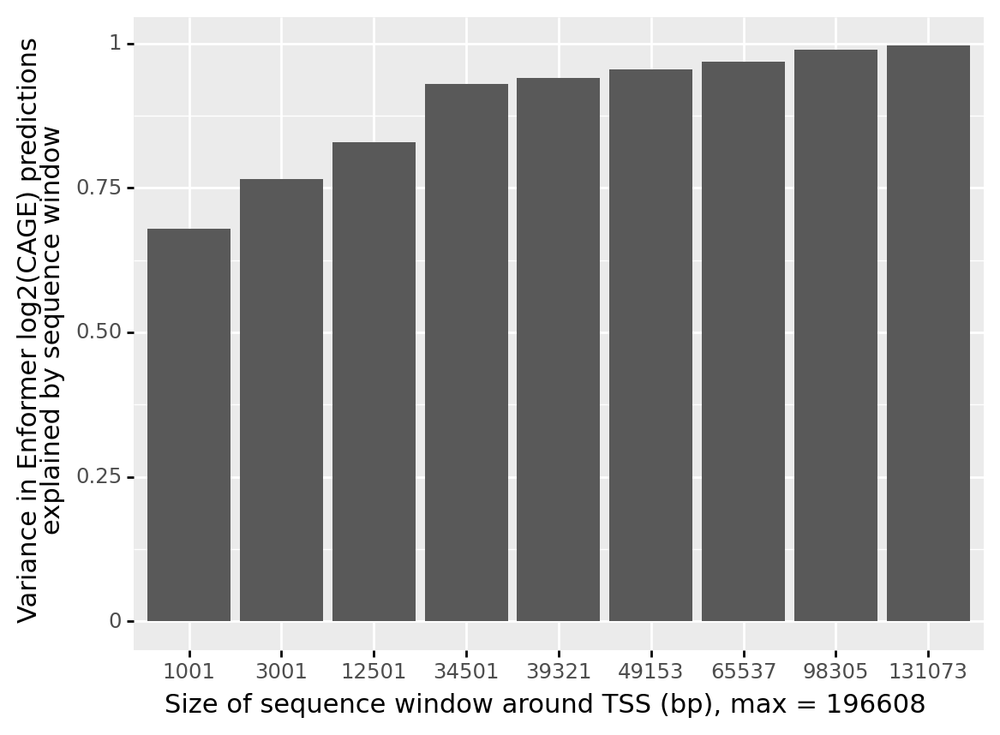

<ggplot: (1446454479180)>

In [33]:
(p9.ggplot(data=k562_corrs,mapping=p9.aes(x="window_size",y="Explained Variance"))
 + p9.geom_bar(stat="identity")
 + p9.labs(x="Size of sequence window around TSS (bp), max = 196608",y="Variance in Enformer log2(CAGE) predictions\nexplained by sequence window")
)

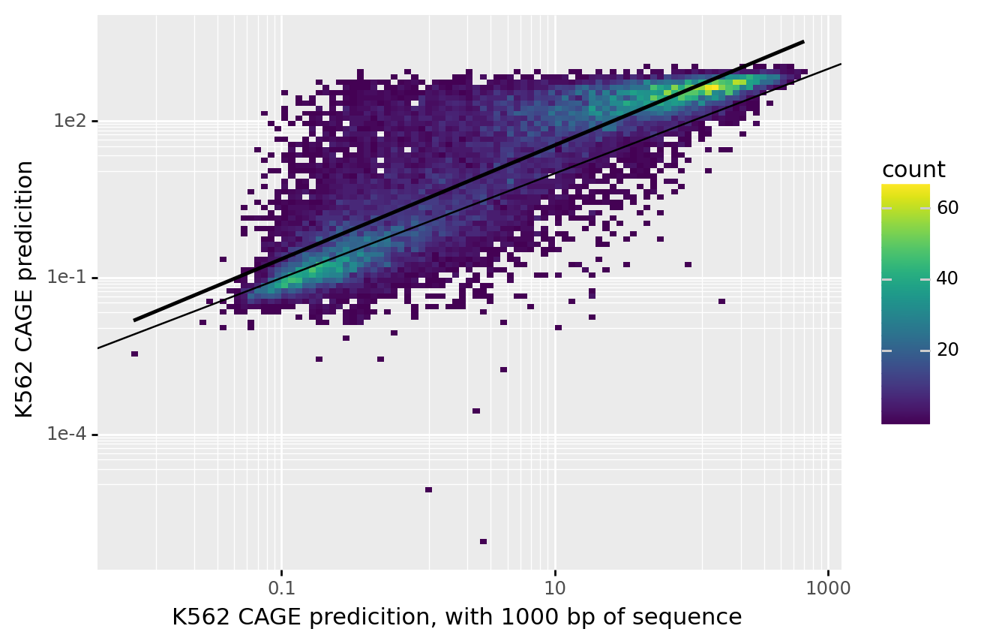

<ggplot: (1446277498414)>

In [34]:
(p9.ggplot(data=k562_df,mapping=p9.aes(x=pred_col+"_1001",y=pred_col+"_ingenome"))
 + p9.geom_bin2d(binwidth = (0.05, 0.1))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 + p9.geom_abline()
 + p9.geom_smooth(method="lm")
 + p9.labs(x="K562 CAGE predicition, with 1000 bp of sequence",y="K562 CAGE predicition")
)

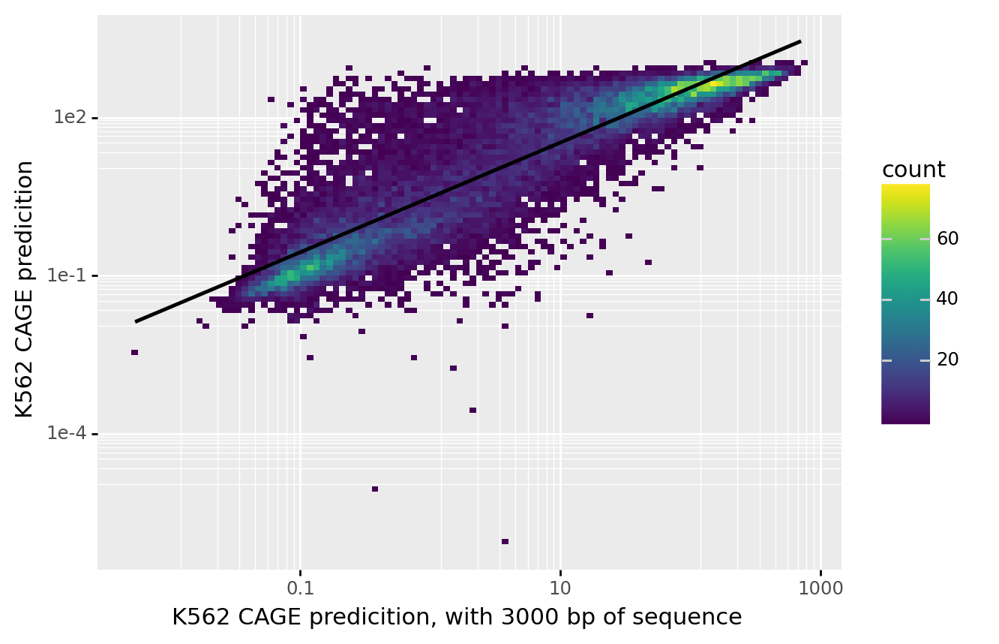

<ggplot: (1446437193198)>

In [35]:
(p9.ggplot(data=k562_df,mapping=p9.aes(x=pred_col+"_3001",y=pred_col+"_ingenome"))
 + p9.geom_bin2d(binwidth = (0.05, 0.1))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 + p9.geom_smooth(method="lm")
 + p9.labs(x="K562 CAGE predicition, with 3000 bp of sequence",y="K562 CAGE predicition")
)

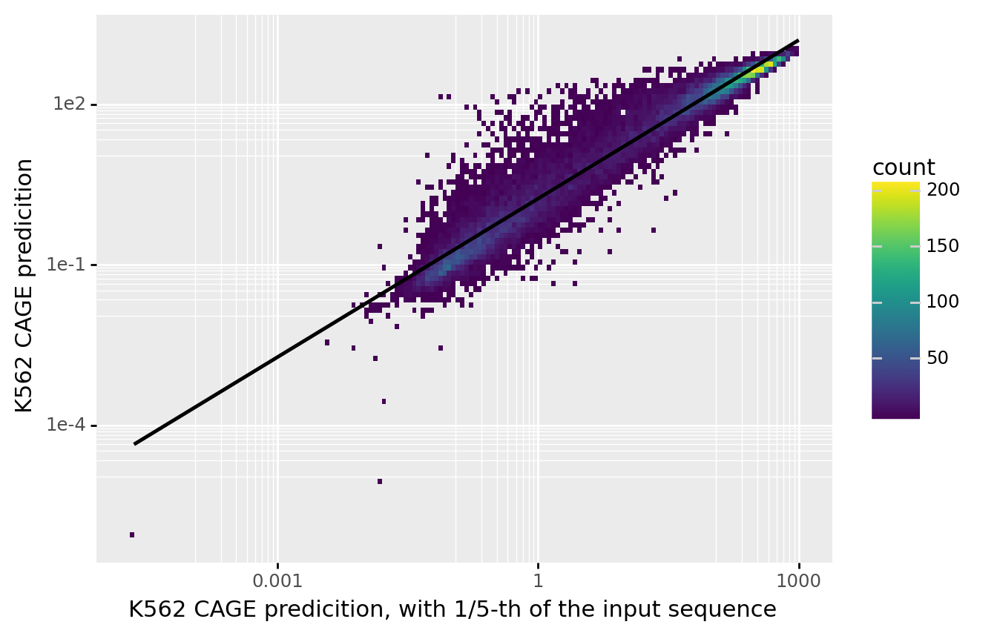

<ggplot: (1446437048817)>

In [36]:
(p9.ggplot(data=k562_df,mapping=p9.aes(x=pred_col+"_39321",y=pred_col+"_ingenome"))
 + p9.geom_bin2d(binwidth = (0.05, 0.1))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 + p9.geom_smooth(method="lm")
 + p9.labs(x="K562 CAGE predicition, with 1/5-th of the input sequence",y="K562 CAGE predicition")
)

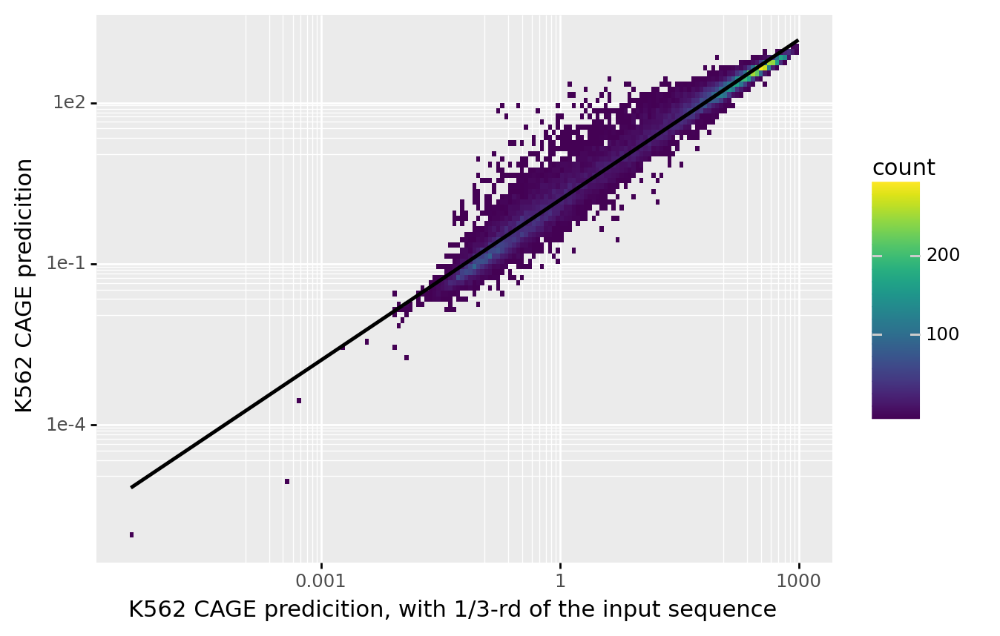

<ggplot: (1446316194807)>

In [37]:
(p9.ggplot(data=k562_df,mapping=p9.aes(x=pred_col+"_65537",y=pred_col+"_ingenome"))
 + p9.geom_bin2d(binwidth = (0.05, 0.1))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 + p9.geom_smooth(method="lm")
 + p9.labs(x="K562 CAGE predicition, with 1/3-rd of the input sequence",y="K562 CAGE predicition")
)

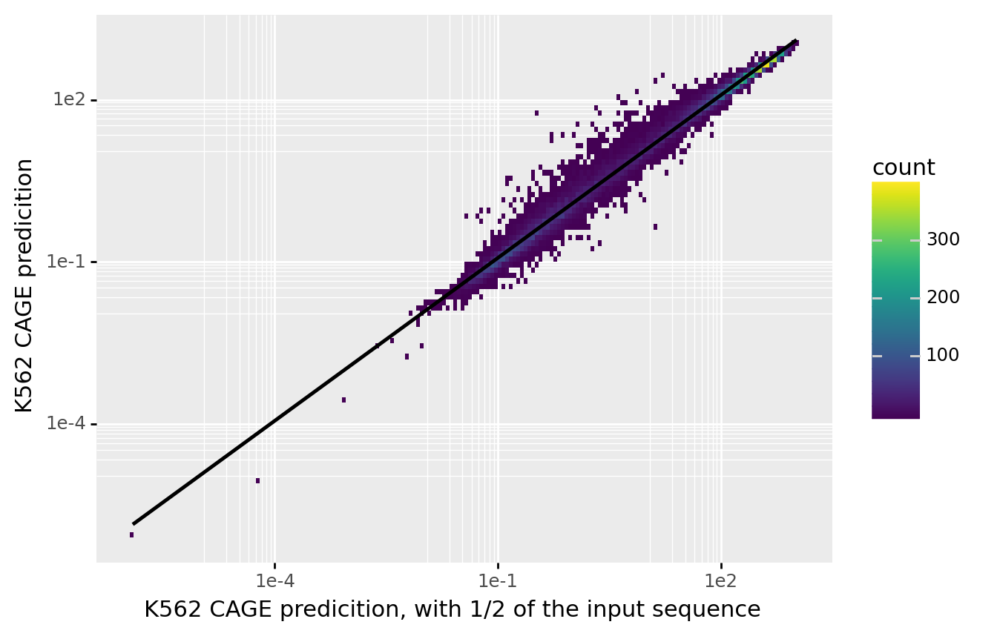

<ggplot: (1419294325580)>

In [260]:
(p9.ggplot(data=k562_df,mapping=p9.aes(x=pred_col+"_98305",y=pred_col+"_ingenome"))
 + p9.geom_bin2d(binwidth = (0.05, 0.1))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 + p9.geom_smooth(method="lm")
 + p9.labs(x="K562 CAGE predicition, with 1/2 of the input sequence",y="K562 CAGE predicition")
)

### Across Genes

In [39]:
universal_samples = ['Clontech Human Universal Reference Total RNA', 'SABiosciences XpressRef Human Universal Total RNA', 'CAGE:Universal RNA - Human Normal Tissues Biochain']
track_cols = [k for k in results.keys() if "CAGE" in k and k.endswith("landmark_sum") and not any(x in k for x in universal_samples)]

gene_df = results[["gene_id","gene_name","window_size"] + track_cols]
gene_df = gene_df[["gene_id","gene_name","window_size"]+track_cols].pivot(["gene_id","gene_name"],["window_size"],track_cols).reset_index()
gene_df.columns = ([x for x,y in zip(gene_df.columns.get_level_values(0),gene_df.columns.get_level_values(1)) if y == ""]
                   + [x + "_" + str(y) for x,y in zip(gene_df.columns.get_level_values(0),gene_df.columns.get_level_values(1)) if y != ""])
gene_df = gene_df.rename(columns={k+"_-1":k+"_ingenome" for k in track_cols})

In [40]:
rows = []
for wdw in windows:
    if wdw == -1:
        continue
    for col in track_cols:
        tpl = (np.log2(gene_df[col+"_ingenome"]+1),np.log2(gene_df[col+"_"+str(wdw)]+1))
        r = scipy.stats.pearsonr(*tpl)[0]
        rows.append({
            "track_name":col,
            "window_size": wdw,
            "R": r,
            "R-squared": sklearn.metrics.r2_score(*tpl),
            "R-squared (after Rescaling)": r ** 2,
            "Explained Variance": sklearn.metrics.explained_variance_score(*tpl)
        })
gene_corrs = pd.DataFrame(rows)
gene_corrs["window_size"] = pd.Categorical(gene_corrs["window_size"], [x for x in windows if x != -1])

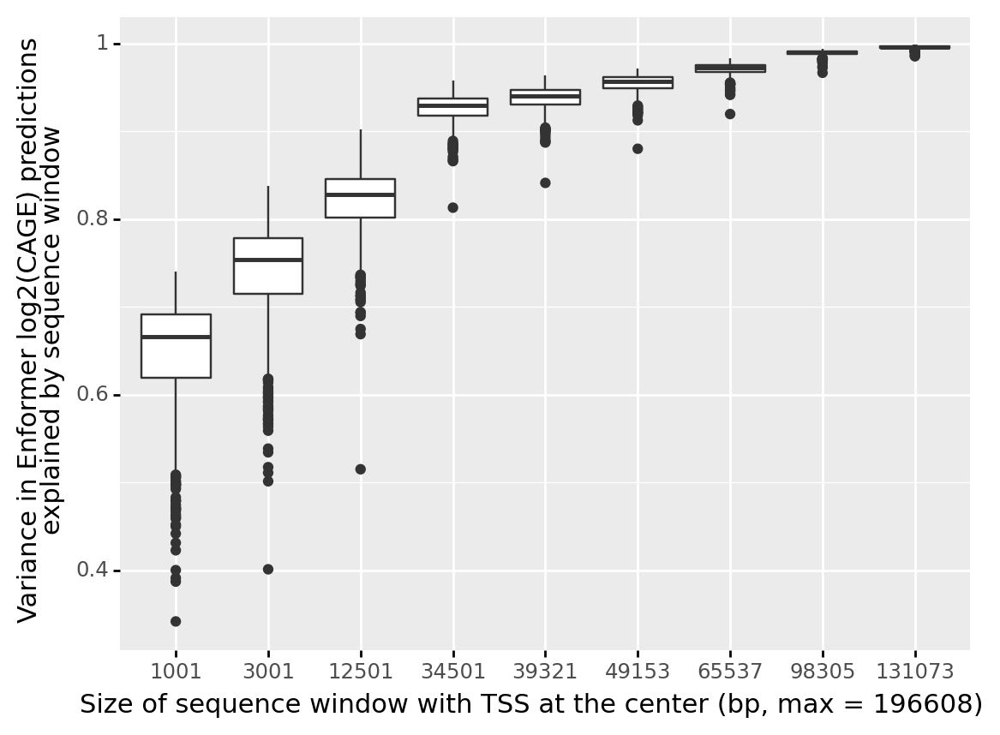

<ggplot: (1446315400936)>

In [41]:
(p9.ggplot(data=gene_corrs,mapping=p9.aes(x="window_size",y="Explained Variance"))
 + p9.geom_boxplot()
 + p9.labs(x="Size of sequence window with TSS at the center (bp, max = 196608)",y="Variance in Enformer log2(CAGE) predictions\nexplained by sequence window")
)

In [42]:
gene_corrs.groupby('window_size').median()

,R,R-squared,R-squared (after Rescaling),Explained Variance
window_size,,,,
1001,0.824806,0.419438,0.680304,0.666002
3001,0.873767,0.573638,0.763469,0.754363
12501,0.911714,0.689745,0.831222,0.828253
34501,0.965376,0.892328,0.931950,0.929543
39321,0.970739,0.912425,0.942334,0.940698
49153,0.979006,0.936806,0.958452,0.956685
65537,0.986808,0.960507,0.973790,0.972117
98305,0.995158,0.987124,0.990339,0.989590
131073,0.998038,0.995127,0.996080,0.995804


### GTEX - Across genes, matching with linear model

#### Train linear model for every tissue and window size and gather predictions

##### Enformer

In [22]:
#with open(base_path_results  + "tss_sim_groupby_20_05_2022.tsv", 'r') as tsv:
#    header = tsv.readline()
#    cols = header.split("\t")
#cols = [k for k in cols if "CAGE" in k and k.endswith("landmark_sum")]

#results = pd.read_csv(base_path_results + "tss_sim_groupby_20_05_2022.tsv",sep="\t",
#                     usecols = ['gene_id', 'gene_name', "transcript_id","window_type","window_size"] + cols)

with open(base_path_results  + "tss_sim-latest_results.tsv", 'r') as tsv:
    header = tsv.readline()
    cols = header.split("\t")
cols = [k for k in cols if "CAGE" in k and k.endswith("landmark_sum")]

results = pd.read_csv(base_path_results + "tss_sim-latest_results.tsv",sep="\t",
                     usecols = ['gene_id', 'gene_name', "transcript_id","window_type","window_size"] + cols)

results = (results.groupby(["gene_id","gene_name"])[[x for x in results.keys() if "CAGE" in x]].mean().reset_index())

universal_samples = ['Clontech Human Universal Reference Total RNA', 'SABiosciences XpressRef Human Universal Total RNA', 'CAGE:Universal RNA - Human Normal Tissues Biochain']
track_cols = [k for k in results.keys() if "CAGE" in k and k.endswith("landmark_sum") and not any(x in k for x in universal_samples)]

gene_df = results[["gene_id","gene_name","window_type","window_size"] + track_cols]
gene_df = gene_df[["gene_id","gene_name","window_size"]+track_cols].pivot(["gene_id","gene_name"],["window_size"],track_cols).reset_index()
gene_df.columns = ([x for x,y in zip(gene_df.columns.get_level_values(0),gene_df.columns.get_level_values(1)) if y == ""]
                   + [x + "_" + str(y) for x,y in zip(gene_df.columns.get_level_values(0),gene_df.columns.get_level_values(1)) if y != ""])
gene_df = gene_df.rename(columns={k+"_-1":k+"_ingenome" for k in track_cols})

In [24]:
windows = sorted(list(set(results["window_size"])))

In [ ]:
linearmodel_match_windowed(gene_df, gtex_molten, tissues, "tissue", gene_locs, windows, 
                           model_name = "enformer", dataset_name="gtex",
                           lm=sklearn.linear_model.RidgeCV(), print_alpha=True)

##### Basenji2

In [29]:
with open(base_path_results + "tss_sim-basenji2-latest_results.tsv", 'r') as tsv:
    header = tsv.readline()
    cols = header.split("\t")
cols = [k for k in cols if "CAGE" in k and k.endswith("landmark_sum")]

basenji2_results = pd.read_csv(base_path_results + "tss_sim-basenji2-latest_results.tsv",sep="\t",
                              usecols = ['gene_id', 'gene_name', 'orient', 'offset', 'window_size'] + cols)
basenji2_results = (basenji2_results.groupby(["gene_id","gene_name"])[[x for x in basenji2_results.keys() if "CAGE" in x]].mean().reset_index())

universal_samples = ['Clontech Human Universal Reference Total RNA', 'SABiosciences XpressRef Human Universal Total RNA', 'CAGE:Universal RNA - Human Normal Tissues Biochain']
track_cols = [k for k in basenji2_results.keys() if "CAGE" in k and k.endswith("landmark_sum") and not any(x in k for x in universal_samples)]

basenji2_gene_df = basenji2_results[["gene_id","gene_name"] + track_cols].rename(columns={t:t+"_basenji2" for t in track_cols})

In [ ]:
linearmodel_match_windowed(basenji2_gene_df, gtex_molten, tissues, "tissue", gene_locs, windows=["basenji2"], 
                           model_name="basenji2", dataset_name="gtex",
                           lm=sklearn.linear_model.RidgeCV(), print_alpha=True)

#### Analyze correlations

In [18]:
tissue_corrs_lasso = pd.read_csv(base_path_results + "gtex_corrs_modelmatched_enformer.tsv", sep="\t")
tissue_corrs_lasso["window_size"] = (pd.Categorical(tissue_corrs_lasso["window_size"], 
                                                    [str(x) for x in sorted([int(x) for x in set(tissue_corrs_lasso["window_size"]) if x != "Full"])] + ["Full"]))

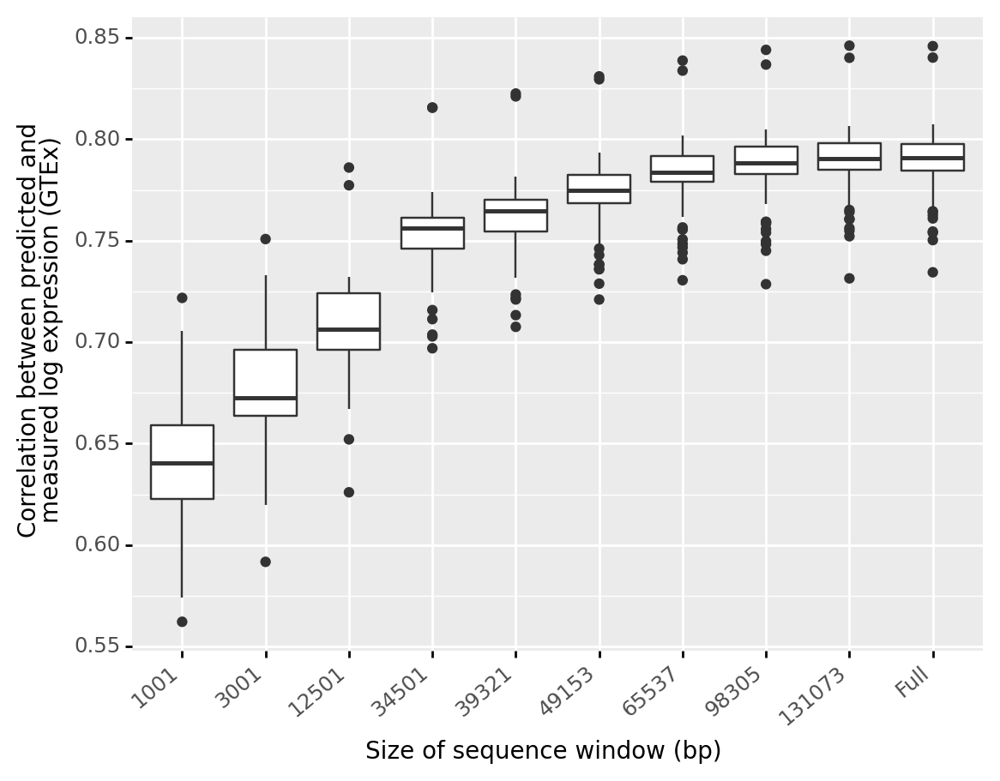

<ggplot: (1417166828039)>

In [19]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=tissue_corrs_lasso,mapping=p9.aes(x="window_size",y="r"))
 + p9.geom_boxplot()
 + p9.labs(x="Size of sequence window (bp)",y="Correlation between predicted and\nmeasured log expression (GTEx)")
+ p9.theme(axis_text_x=p9.element_text(rotation=40, hjust=1), axis_title=p9.element_text(size=10))
)
p

In [20]:
p.save("Graphics/" + "distal_gtex" + ".svg", width=2.8, height=2.9, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 2.8 x 2.9 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/distal_gtex.svg


#### Add exon-intron ratio


In [21]:
tissue_pred_df = pd.read_csv(base_path_results + "gtex_pred_modelmatched_enformer.tsv", sep="\t")
tissues = set(tissue_pred_df["tissue"])

In [22]:
gene_pos = gtf_df.df.query('Feature == "gene"')[["Chromosome","Start","End","gene_id"]]
gene_pos = gene_pos.loc[~gene_pos.gene_id.str.endswith("PAR_Y")]
gene_pos["gene_id"] = gene_pos["gene_id"].apply(lambda x: x.split('.')[0])
tissue_pred_df = gene_pos.merge(tissue_pred_df, on="gene_id")

In [23]:
exint = (pd.read_csv(base_path_data + "genomic_sequence_plus_features_hl_all_tissues.csv")
         .rename(columns={"Unnamed: 0":"transcript_id"}))
exint["transcript_id"] = exint["transcript_id"].apply(lambda x: x.split('.')[0])

In [24]:
transcript_to_gene = (pd.read_csv(base_path_data + "gene2transcript.txt", sep="\t")
                      .rename(columns={"Gene stable ID":"gene_id",
                                       "Transcript stable ID":"transcript_id"})
                     )

In [25]:
exint = transcript_to_gene.merge(exint, on="transcript_id")

In [26]:
# find matching to tissues
exint_tissue_match_dict = {k.replace(" - "," ").replace("(","").replace(")","").replace(" ","_").replace("-","_"):k for k in tissues}
exint_tissue_match_dict['Cells_Transformed_fibroblasts'] = 'Cells - Cultured fibroblasts'
matched = [k for k in exint.keys() if k in exint_tissue_match_dict]

exint_tissue_match_df = pd.DataFrame([{"key":k,"tissue":v} for k,v in exint_tissue_match_dict.items()])

In [27]:
# impute nan with median
exint = exint[["gene_id"]+matched]
exint_array = np.array(exint[matched])
row_medians = np.nanmedian(exint_array, axis=1)
idxs = np.where(np.isnan(exint_array))
exint_array[idxs] = np.take(row_medians, idxs[0])
exint[matched] = exint_array

In [28]:
# melt and match
exint_molten = (exint
                .melt(id_vars="gene_id",var_name="key",value_name="exon_intron_ratio")
                .merge(exint_tissue_match_df, on="key")
                .drop(columns=["key"])
                .groupby(['gene_id','tissue'])
                .mean()
                .reset_index()
               )

In [29]:
tissue_pred_df = exint_molten.merge(tissue_pred_df, on=["gene_id","tissue"], how="right")

In [30]:
# mean normalize exon-intron ratio for each tissue
exint_means = (tissue_pred_df
               .groupby('tissue')["exon_intron_ratio"]
               .mean()
               .reset_index()
               .rename(columns={"exon_intron_ratio":"mean_ratio"})
              )
tissue_pred_df = tissue_pred_df.merge(exint_means, on="tissue")
tissue_pred_df["mean_ratio"] = tissue_pred_df["mean_ratio"].fillna(0)
tissue_pred_df["exon_intron_ratio"] = tissue_pred_df["exon_intron_ratio"] - tissue_pred_df["mean_ratio"]
# replace nan with 0
tissue_pred_df["exon_intron_ratio"] = tissue_pred_df["exon_intron_ratio"].fillna(0)

In [31]:
row_list = []
for tissue in set(tissue_pred_df.tissue):
    subset_train = tissue_pred_df.query('tissue == @tissue & gene_id not in @intersect_genes')
    subset_test = tissue_pred_df.query('tissue == @tissue & gene_id in @test_genes')
    y_test = np.array(subset_test['log_obs'])
    y_train = np.array(subset_train['log_obs'])
    # train exon_intron model
    X_train = np.array(subset_train[["log_pred_ingenome","exon_intron_ratio"]])
    model = sklearn.linear_model.RidgeCV()
    model.fit(X_train, y_train)
    # test exon_intron model
    X_test = np.array(subset_test[["log_pred_ingenome","exon_intron_ratio"]])
    y_pred_exon_intron = model.predict(X_test).reshape(-1)
    row_list.append({
        "tissue":tissue,
        "Enformer":scipy.stats.pearsonr(subset_test["log_obs"],subset_test["log_pred_ingenome"])[0],
        "Enformer +\nExon-Intron Ratio":scipy.stats.pearsonr(subset_test["log_obs"],y_pred_exon_intron)[0],
        "r_exon_intron_obs":scipy.stats.pearsonr(subset_test["exon_intron_ratio"],subset_test["log_pred_ingenome"])[0],
        "r_exon_intron_pred":scipy.stats.pearsonr(subset_test["exon_intron_ratio"],subset_test["log_pred_ingenome"])[0]
    }
    )
gtex_corrs_full = pd.DataFrame(row_list)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/scipy/stats/stats.py:4023: PearsonRConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/scipy/stats/stats.py:4023: PearsonRConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/scipy/stats/stats.py:4023: PearsonRConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/scipy/stats/stats.py:4023: PearsonRConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/scipy/stats/stats.py:4023: PearsonRConstantInputWarning: An input array is constant; the correlation coeffici

#### Compare to other models

- Xpresso
- Basenji1
- Basenji2

In [32]:
gtex_corrs_full = gtex_corrs_full[["tissue","Enformer","Enformer +\nExon-Intron Ratio"]].melt(id_vars="tissue", var_name="model",value_name="r")

In [33]:
xpresso_pred_df = (pd.read_csv(base_path_results_xpresso + "xpresso_preds.tsv", sep = "\t")
                   [["gene_id","Prediction"]]
                   .rename(columns={"Prediction":"xpresso_pred"})
                  )

tissue_pred_df = (tissue_pred_df
                  .merge(xpresso_pred_df, on="gene_id")
                  .merge(gene_locs[["gene_id","len"]], on="gene_id")
                 )

tissue_pred_df["log_len"] = np.log10(tissue_pred_df["len"])

row_list = []
for tissue in tissues:
    subset_train = tissue_pred_df.query('tissue == @tissue & gene_id not in @intersect_genes')
    subset_test = tissue_pred_df.query('tissue == @tissue & gene_id in @test_genes')
    # train ridge
    y_train = np.array(subset_train['log_obs'])
    X_train = np.array(subset_train[['xpresso_pred']])
    model = sklearn.linear_model.RidgeCV()
    model.fit(X_train, y_train)
    # test ridge
    y_test = np.array(subset_test['log_obs'])
    X_test = np.array(subset_test[['xpresso_pred']])
    y_pred = model.predict(X_test).reshape(-1)
    tpl = (y_test, y_pred)
    r = scipy.stats.pearsonr(*tpl)
    r2 = sklearn.metrics.r2_score(*tpl)
    row_list.append({
        "tissue":tissue,
        "model":"Xpresso",
        "r":r[0],
        
    })
xpresso_corrs = pd.DataFrame(row_list)

In [34]:
basenji2_corrs = pd.read_csv(base_path_results + "gtex_corrs_modelmatched_basenji2.tsv", sep="\t")[["tissue","r"]]
basenji2_corrs["model"] = "Basenji2"

In [35]:
combined_corrs = pd.concat([gtex_corrs_full, xpresso_corrs, basenji2_corrs])

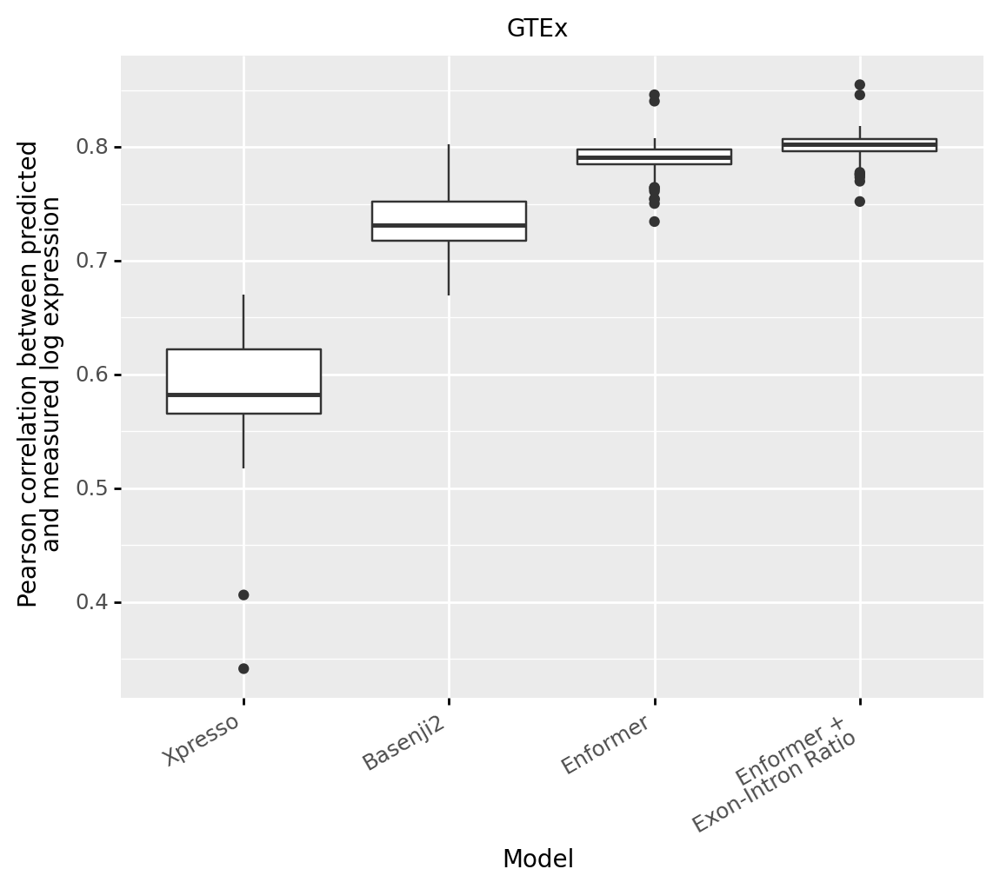

<ggplot: (1417116611639)>

In [36]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

combined_corrs["model_cat"] = pd.Categorical(combined_corrs["model"],
                                             categories=["Xpresso", "Basenji2", "Enformer", "Enformer +\nExon-Intron Ratio"])

p = (p9.ggplot(data=combined_corrs,mapping=p9.aes(x="model_cat",y="r"))
 + p9.geom_boxplot()
 + p9.labs(x="Model",y="Pearson correlation between predicted\nand measured log expression", title="GTEx")
 + p9.theme(axis_title=p9.element_text(size=10), title=p9.element_text(size=10),
           axis_text_x=p9.element_text(rotation=30, hjust=1))
)
p

In [40]:
combined_corrs.groupby('model').median()

,r
model,
Basenji2,0.731298
Enformer,0.790744
Enformer +\nExon-Intron Ratio,0.802102
Xpresso,0.582475


In [37]:
p.save("Graphics/" + "gtex_gtex" + ".svg", width=2.6, height=3.2, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 2.6 x 3.2 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/gtex_gtex.svg


/scratch/tmp/karollus/ipykernel_289434/2257996038.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


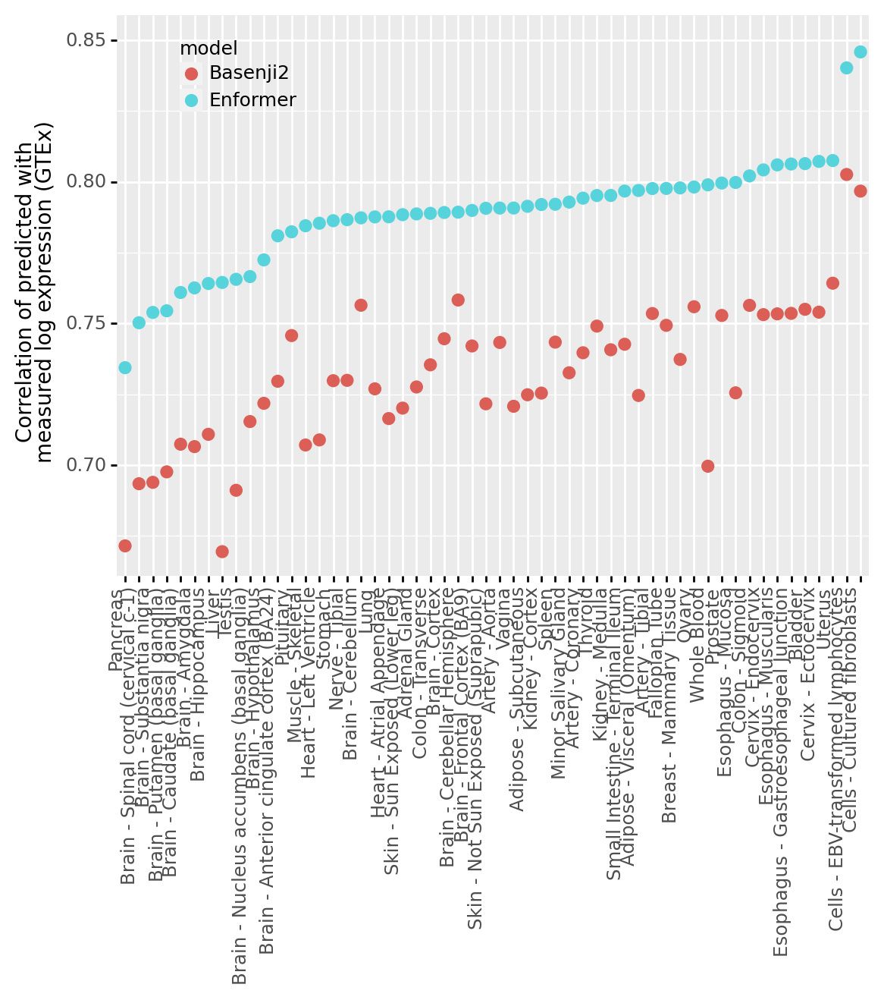

<ggplot: (1417122401527)>

In [38]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

plot_df = combined_corrs.query('model in ["Basenji2","Enformer"]')
plot_df["tissue_cat"] = pd.Categorical(plot_df['tissue'],
                                       plot_df.query('model == "Enformer"').sort_values('r')['tissue'])

p = (p9.ggplot(data=plot_df,mapping=p9.aes(x="tissue_cat",y="r",color="model"))
 #+ p9.geom_col(position="dodge")
 + p9.geom_point(size=2.5)
 + p9.coords.coord_cartesian(ylim=(0.67,0.85))
 + p9.labs(x="",y="Correlation of predicted with\nmeasured log expression (GTEx)")
 + p9.theme(axis_title=p9.element_text(size=10),
           axis_text_x=p9.element_text(rotation=90, hjust=1),
           legend_box_margin=0, legend_key_size=9, 
            legend_text=p9.element_text(size=9),
            legend_background=p9.element_blank(),
            legend_title=p9.element_text(size=9), legend_position=(0.25,0.8))
)
p

In [39]:
p.save("Graphics/" + "xsup_gtex_tissues" + ".svg", width=7.2, height=4.8, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 7.2 x 4.8 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/xsup_gtex_tissues.svg


### GTEX - Across tissues

#### Analyze correlations

In [63]:
tissue_pred_df = pd.read_csv(base_path_results + "gtex_pred_modelmatched_enformer.tsv", sep="\t")
tissue_var_df_molten = tissue_pred_df

In [64]:
rows = []

tissue_var_df_molten_indexed = tissue_var_df_molten.set_index("gene_id")
for gene in set(tissue_var_df_molten.query('gene_id in @test_genes')["gene_id"]):
    subset = tissue_var_df_molten_indexed.loc[gene]
    # skip genes which are constant across dev-stages (or never expressed)
    if not (subset["log_obs"].std() > 0):
        continue
    for col in [x for x in subset.keys() if x.startswith("log_pred")]:
        row_dict = {"gene_id":gene}
        row_dict["window_size"] = col.split("_")[-1]
        tpl = (subset["log_obs"],subset[col])
        corr_test =  scipy.stats.pearsonr(*tpl)
        r = corr_test[0]
        row_dict["R"] = r
        row_dict["p"] = corr_test[1]
        row_dict["rho"] = scipy.stats.spearmanr(*tpl)[0]
        row_dict["R-squared"]  = sklearn.metrics.r2_score(*tpl)
        row_dict["R-squared (after Rescaling)"] = r ** 2
        row_dict["Explained Variance"]  = sklearn.metrics.explained_variance_score(*tpl)
        row_dict["pred_mean_log_expr"] = subset["log_pred_ingenome"].mean()
        row_dict["pred_std_log_expr"] = subset["log_pred_ingenome"].std()
        row_dict["mean_log_expr"] = subset["log_obs"].mean()
        row_dict["std_log_expr"] = subset["log_obs"].std()
        rows.append(row_dict)
        
between_tissue_corrs = pd.DataFrame(rows)
between_tissue_corrs["window_size"] = between_tissue_corrs["window_size"].apply(lambda x: x if x != "ingenome" else "Full")
between_tissue_corrs["window_size"] = pd.Categorical(between_tissue_corrs["window_size"], 
                                                     ["null"] + [str(x) for x in sorted([int(x) for x in set(between_tissue_corrs["window_size"]) if x != "Full" and x!= "null"])] + ["Full"])

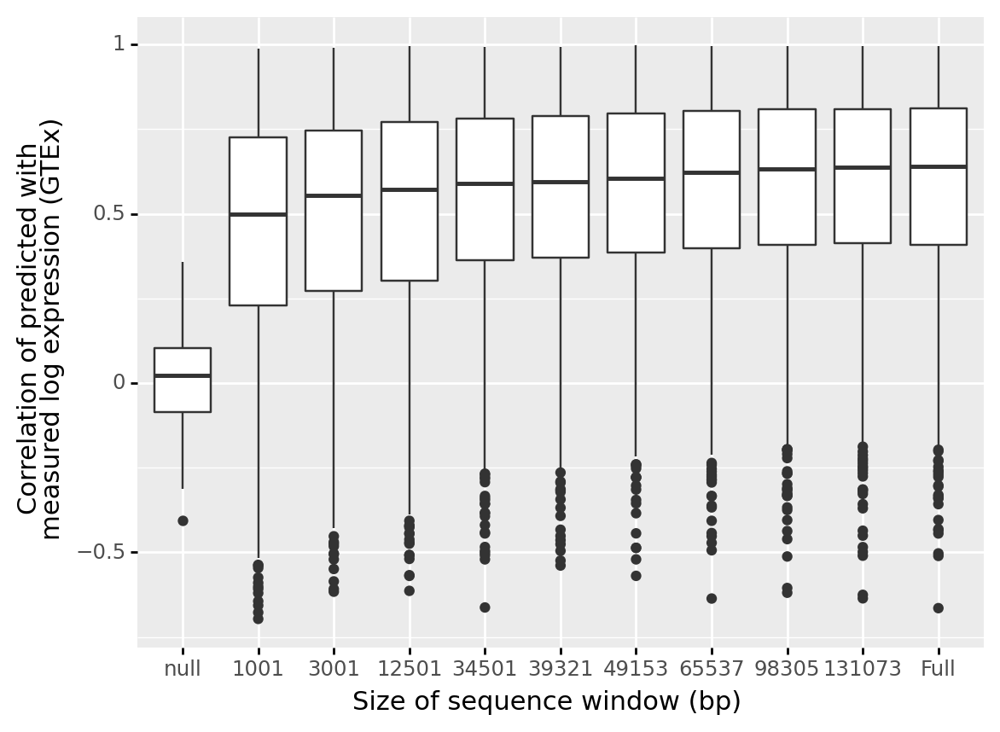

<ggplot: (1405543317462)>

In [65]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=between_tissue_corrs,mapping=p9.aes(x="window_size",y="R"))
 + p9.geom_boxplot()
 + p9.labs(x="Size of sequence window (bp)",y="Correlation of predicted with\nmeasured log expression (GTEx)")
)
p

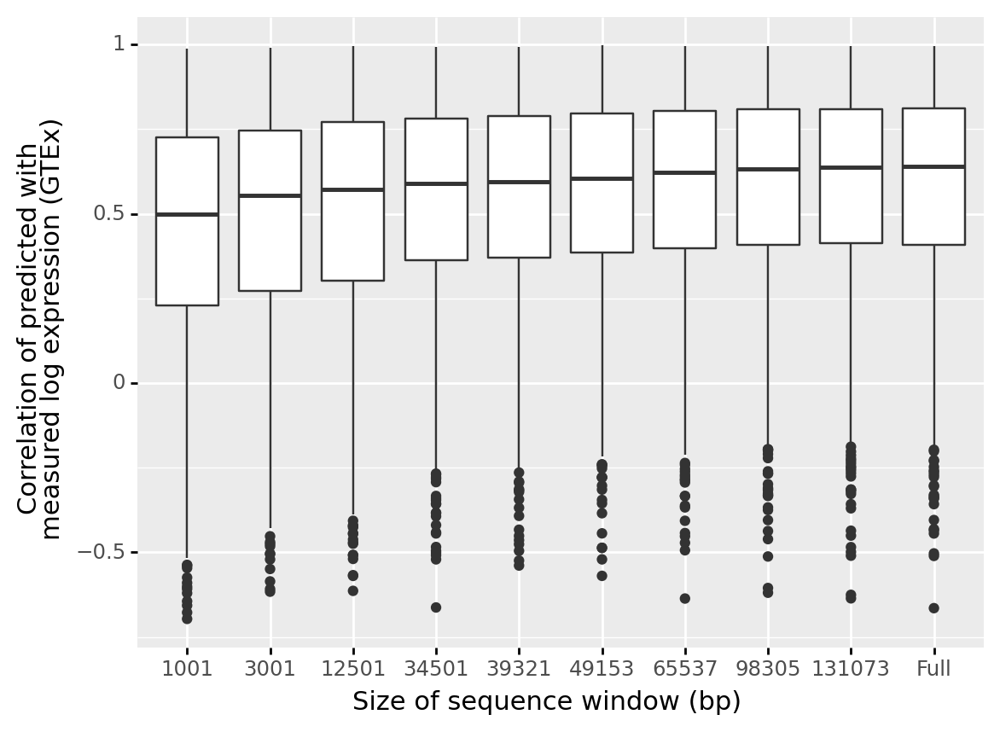

<ggplot: (1405543325477)>

In [66]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=between_tissue_corrs.query('window_size != "null"'),mapping=p9.aes(x="window_size",y="R"))
 + p9.geom_boxplot()
 + p9.labs(x="Size of sequence window (bp)",y="Correlation of predicted with\nmeasured log expression (GTEx)")
)
p

In [67]:
p.save("Graphics/" + "xsup_distal_gtexbtwn" + ".svg", width=6.4, height=4.8, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.4 x 4.8 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/xsup_distal_gtexbtwn.svg


In [68]:
between_tissue_corrs.groupby('window_size').median()

,R,p,rho,R-squared,R-squared (after Rescaling),Explained Variance,pred_mean_log_expr,pred_std_log_expr,mean_log_expr,std_log_expr
window_size,,,,,,,,,,
null,0.023549,4.988938e-01,0.012236,-5.037005,0.008840,4.440892e-16,0.033228,0.116099,-0.017109,0.188784
1001,0.498249,8.663962e-05,0.479931,-1.835029,0.258507,1.891556e-01,0.033228,0.116099,-0.017109,0.188784
3001,0.554760,1.277222e-05,0.518963,-1.500634,0.309033,2.436538e-01,0.033228,0.116099,-0.017109,0.188784
12501,0.572103,6.090357e-06,0.557309,-1.308362,0.327752,2.530563e-01,0.033228,0.116099,-0.017109,0.188784
34501,0.588941,2.777335e-06,0.571946,-1.013715,0.347099,2.873068e-01,0.033228,0.116099,-0.017109,0.188784
39321,0.593993,2.192151e-06,0.577663,-0.979877,0.352828,2.940027e-01,0.033228,0.116099,-0.017109,0.188784
49153,0.603510,1.361356e-06,0.577816,-0.921573,0.364225,3.075805e-01,0.033228,0.116099,-0.017109,0.188784
65537,0.622482,4.776855e-07,0.596493,-0.900614,0.388629,3.253255e-01,0.033228,0.116099,-0.017109,0.188784
98305,0.631756,3.009342e-07,0.603583,-0.800603,0.399116,3.473536e-01,0.033228,0.116099,-0.017109,0.188784


In [69]:
between_tissue_corrs.to_csv(base_path_results + "between_tissue_corrs_windows.tsv",index=None,sep="\t")

#### Compare models

In [70]:
tissue_pred_df = (pd.read_csv(base_path_results + "gtex_pred_modelmatched_enformer.tsv", sep="\t")
                  [["gene_id","tissue","log_obs","log_pred_ingenome","expressed"]]
                  .rename(columns={"log_pred_ingenome":"log_pred_enformer"})
                 )
tissue_pred_df_basenji2 = (pd.read_csv(base_path_results + "gtex_pred_modelmatched_basenji2.tsv", sep="\t")
                          [["gene_id","tissue","log_pred_basenji2"]]
                         )
tissue_pred_df = (tissue_pred_df
                  .merge(tissue_pred_df_basenji2, on=["gene_id", "tissue"])
                 )

In [71]:
tissue_var_df_molten = tissue_pred_df

In [72]:
expresed_in_all_tissues = set(tissue_pred_df.groupby('gene_id')['expressed'].min().reset_index().query('expressed')["gene_id"])

In [73]:
rows = []

tissue_var_df_molten_indexed = tissue_var_df_molten.set_index("gene_id")
for gene in set(tissue_var_df_molten.query('gene_id in @test_genes')["gene_id"]):
    subset = tissue_var_df_molten_indexed.loc[gene]
    for col in [x for x in subset.keys() if x.startswith("log_pred")]:
        row_dict = {"gene_id":gene}
        row_dict["model"] = col.split("_")[-1]
        tpl = (subset["log_obs"],subset[col])
        corr_test =  scipy.stats.pearsonr(*tpl)
        r = corr_test[0]
        row_dict["R"] = r
        row_dict["p"] = corr_test[1]
        row_dict["rho"] = scipy.stats.spearmanr(*tpl)[0]
        row_dict["R-squared"]  = sklearn.metrics.r2_score(*tpl)
        row_dict["pred_mean_log_expr_enformer"] = subset["log_pred_enformer"].mean()
        row_dict["pred_std_log_expr_enformer"] = subset["log_pred_enformer"].std()
        row_dict["pred_mean_log_expr_basenji2"] = subset["log_pred_basenji2"].mean()
        row_dict["pred_std_log_expr_basenji2"] = subset["log_pred_basenji2"].std()
        row_dict["mean_log_expr"] = subset["log_obs"].mean()
        row_dict["std_log_expr"] = subset["log_obs"].std()
        row_dict["mae_log_expr"] = np.abs(subset["log_obs"] - subset["log_obs"].mean()).mean()
        row_dict["dyn_range_log_expr"] = subset["log_obs"].quantile([0.05,0.95]).max() - subset["log_obs"].quantile([0.05,0.95]).min()
        rows.append(row_dict)
        
between_tissue_corrs = pd.DataFrame(rows)

In [74]:
between_tissue_corrs["dyn_range_log2_expr"] = between_tissue_corrs["dyn_range_log_expr"]/np.log10(2)
between_tissue_corrs["mae_log2_expr"] = between_tissue_corrs["mae_log_expr"]/np.log10(2)
between_tissue_corrs["sig"] = between_tissue_corrs["p"] < 0.05/(len(between_tissue_corrs)/2)
between_tissue_corrs["correct_direction"] = between_tissue_corrs["R"] > 0
between_tissue_corrs["trend_predicted"] = between_tissue_corrs["correct_direction"] & between_tissue_corrs["sig"] 
between_tissue_corrs["always_expressed"] = between_tissue_corrs['gene_id'].apply(lambda x: x in expresed_in_all_tissues)

In [75]:
between_tissue_corrs["mae_log2_expr"].describe()

count    2838.000000
mean        0.605026
std         0.415022
min         0.135301
25%         0.321291
50%         0.448819
75%         0.735747
max         2.828448
Name: mae_log2_expr, dtype: float64

In [76]:
between_tissue_corrs["dyn_range_log2_expr"].describe()

count    2838.000000
mean        2.278782
std         1.536627
min         0.482876
25%         1.166548
50%         1.668515
75%         2.892309
max         9.637927
Name: dyn_range_log2_expr, dtype: float64

In [77]:
between_tissue_corrs.query('not always_expressed')["dyn_range_log2_expr"].describe()

count    600.000000
mean       1.744757
std        1.172172
min        0.770461
25%        1.051454
50%        1.144176
75%        1.954421
max        8.160990
Name: dyn_range_log2_expr, dtype: float64

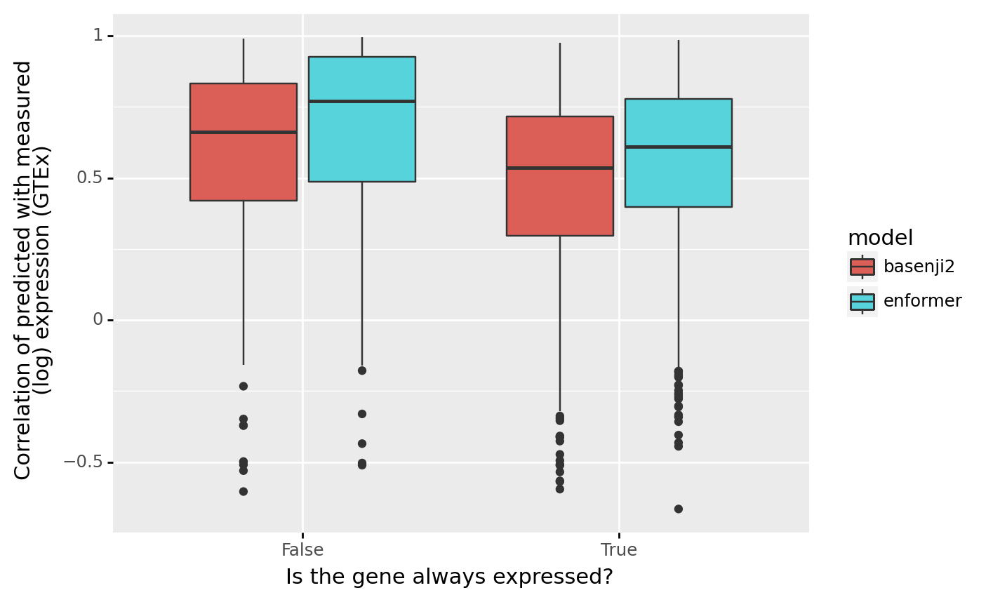

<ggplot: (1405540861010)>

In [78]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=between_tissue_corrs,mapping=p9.aes(x="always_expressed",y="R", fill="model"))
 + p9.geom_boxplot()
 + p9.labs(x="Is the gene always expressed?",y="Correlation of predicted with measured\n(log) expression (GTEx)")
)
p

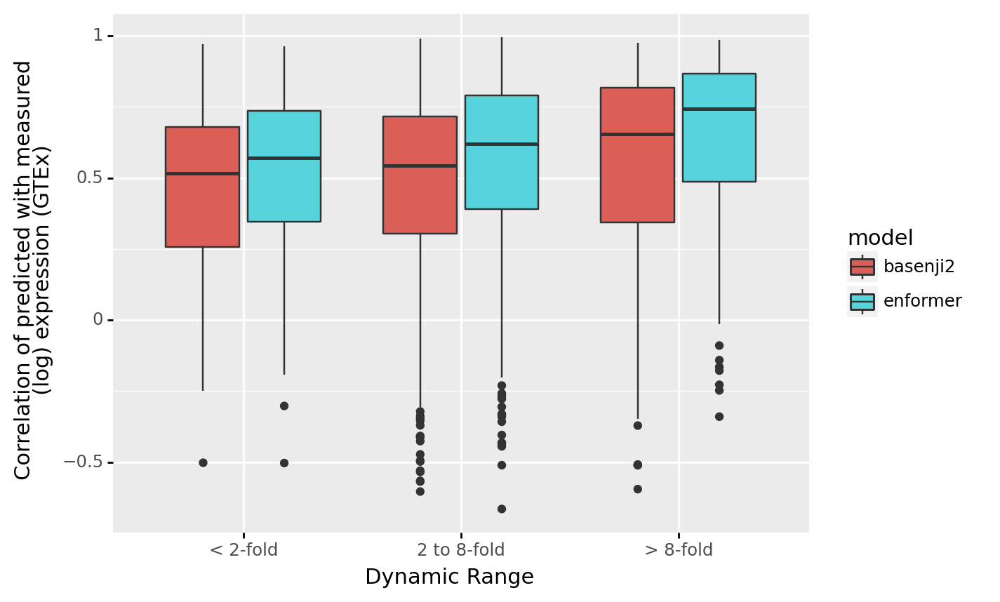

<ggplot: (1405543361540)>

In [79]:
between_tissue_corrs["Dynamic\nRange"] = between_tissue_corrs["dyn_range_log2_expr"].apply(lambda x: "< 2-fold" if x < 1 else ('2 to 8-fold' if x < 3 else '> 8-fold'))

between_tissue_corrs["Dynamic\nRange"] = pd.Categorical(between_tissue_corrs["Dynamic\nRange"], 
                                                        ["< 2-fold", '2 to 8-fold', '> 8-fold'])

scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=between_tissue_corrs,mapping=p9.aes(x="Dynamic\nRange",y="R", fill="model"))
 + p9.geom_boxplot()
 + p9.labs(x="Dynamic Range",y="Correlation of predicted with measured\n(log) expression (GTEx)")
)
p

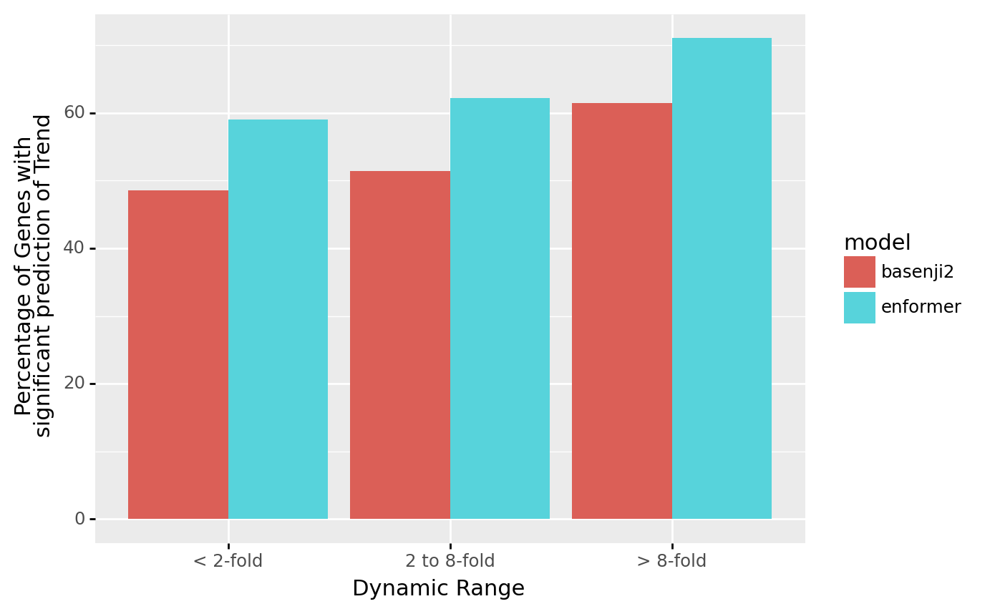

<ggplot: (1405541197397)>

In [80]:
between_tissue_corrs["Dynamic\nRange"] = between_tissue_corrs["dyn_range_log2_expr"].apply(lambda x: "< 2-fold" if x < 1 else ('2 to 8-fold' if x < 3 else '> 8-fold'))

between_tissue_corrs["Dynamic\nRange"] = pd.Categorical(between_tissue_corrs["Dynamic\nRange"], 
                                                        ["< 2-fold", '2 to 8-fold', '> 8-fold'])

scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

plot_df = (between_tissue_corrs
           .groupby(['Dynamic\nRange','model'])['trend_predicted']
          .agg(['sum','size'])
          .reset_index()
          )
plot_df["pct"] = 100*(plot_df["sum"]/plot_df["size"])

p = (p9.ggplot(data=plot_df,mapping=p9.aes(x="Dynamic\nRange", y="pct",fill="model"))
 + p9.geom_bar(stat="identity",position="dodge")
 + p9.labs(x="Dynamic Range",y="Percentage of Genes with\nsignificant prediction of Trend")
)
p

In [81]:
p.save("Graphics/" + "xsup_gtex_gtexbtwntissues" + ".svg", width=6.4, height=4.8, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.4 x 4.8 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/xsup_gtex_gtexbtwntissues.svg


#### RMSE analysis

In [82]:
gene_mean_df = (between_tissue_corrs
           .groupby('gene_id')
           [["pred_mean_log_expr_enformer","pred_std_log_expr_enformer","pred_mean_log_expr_basenji2","pred_std_log_expr_basenji2","mean_log_expr" ,"std_log_expr"]]
           .mean()
           .reset_index()
          )
# prediction of gene mean
print(scipy.stats.pearsonr(gene_mean_df["mean_log_expr"],gene_mean_df["pred_mean_log_expr_basenji2"]))
print(scipy.stats.pearsonr(gene_mean_df["mean_log_expr"],gene_mean_df["pred_mean_log_expr_enformer"]))
# prediction of gene standard deviation
print(scipy.stats.pearsonr(gene_mean_df["std_log_expr"],gene_mean_df["pred_std_log_expr_basenji2"]))
print(scipy.stats.pearsonr(gene_mean_df["std_log_expr"],gene_mean_df["pred_std_log_expr_enformer"]))

(0.7723125591713299, 1.5985527021888864e-281)
(0.8212951721830655, 0.0)
(0.6220867534550036, 8.946262278965657e-153)
(0.7218193654744639, 9.338544704498833e-229)


In [83]:
sklearn.metrics.r2_score(tissue_pred_df.query('gene_id in @test_genes')["log_obs"],
                         tissue_pred_df.query('gene_id in @test_genes')["log_pred_enformer"])

0.6237150162478317

In [84]:
gene_dev_df = tissue_pred_df.merge(gene_mean_df, on="gene_id")

In [85]:
# compute deviations
# y^bar_g - y^bar: deviation of gene mean around global mean
# y^bar_gc - y^bar: deviation of genes around global mean
# y_gc - y^bar_g : deviation of genes around gene means
# y_gc - y^hat_gc : residual

gene_dev_df["total"] = gene_dev_df["log_obs"] - gene_mean_df['mean_log_expr'].mean()
gene_dev_df["condition"] = gene_dev_df["log_obs"] - gene_dev_df['mean_log_expr']
gene_dev_df["basenji2"] = gene_dev_df["log_obs"] - gene_dev_df['log_pred_basenji2']
gene_dev_df["enformer"] = gene_dev_df["log_obs"] - gene_dev_df['log_pred_enformer']

In [86]:
1 - (np.sum(gene_dev_df["condition"]**2)/np.sum(gene_dev_df["total"]**2))

0.8173096131135384

In [87]:
1 - (np.sum(gene_dev_df["enformer"]**2)/np.sum(gene_dev_df["total"]**2))

0.6237150162478318

In [88]:
1 - (gene_dev_df["enformer"].var()/gene_dev_df["total"].var())

0.6244871828982443

In [89]:
# compute the dynamic ranges in log10
qtls = [0.025,0.975]
print("log10")
print(gene_dev_df["total"].quantile(qtls).max() - gene_dev_df["total"].quantile(qtls).min())
print(gene_dev_df["condition"].quantile(qtls).max() - gene_dev_df["condition"].quantile(qtls).min())
print(gene_dev_df["enformer"].quantile(qtls).max() - gene_dev_df["enformer"].quantile(qtls).min())
# log2
print("log2")
print((gene_dev_df["total"].quantile(qtls).max() - gene_dev_df["total"].quantile(qtls).min())/np.log10(2))
print((gene_dev_df["condition"].quantile(qtls).max() - gene_dev_df["condition"].quantile(qtls).min())/np.log10(2))
print((gene_dev_df["enformer"].quantile(qtls).max() - gene_dev_df["enformer"].quantile(qtls).min())/np.log10(2))

log10
2.342984213957343
1.1928541317481796
1.713017694109605
log2
7.7832250862224805
3.962575653356749
5.690521605101862


In [90]:
print(2**7.7832250862224805)
print(2**3.962575653356749)
print(2**5.690521605101862)

220.28463909812777
15.590287775504333
51.643740963607385


In [91]:
# compute the RMSE
print(gene_dev_df["total"].std()/np.log10(2))
print(gene_dev_df["condition"].std()/np.log10(2))
print(gene_dev_df["enformer"].std()/np.log10(2))
print(gene_dev_df["basenji2"].std()/np.log10(2))

2.261978863822522
0.9668217018328089
1.3861203036366847
1.5343696992517253


In [92]:
print(2**2.261978863822522)
print(2**0.9668217018328089)
print(2**1.3861203036366847)

4.796489383769148
1.954529963650311
2.6137484542860974


In [93]:
# compute the MAE
print(np.abs(gene_dev_df["total"]).mean()/np.log10(2))
print(np.abs(gene_dev_df["condition"]).mean()/np.log10(2))
print(np.abs(gene_dev_df["enformer"]).mean()/np.log10(2))
print(np.abs(gene_dev_df["basenji2"]).mean()/np.log10(2))

1.9089314796080616
0.6050264184534644
1.0210755008529042
1.1414189149327567


In [94]:
print(2**1.9089314796080616)
print(2**0.6050264184534644)
print(2**1.0210755008529042)

3.755308627707647
1.5210066054711613
2.029431297023434


In [95]:
#gene_mean_dev = (gene_mean_df["mean_log_expr"] - gene_mean_df['mean_log_expr'].mean())
#print(np.sum(np.abs(gene_mean_dev.quantile([0.05,0.95]))))

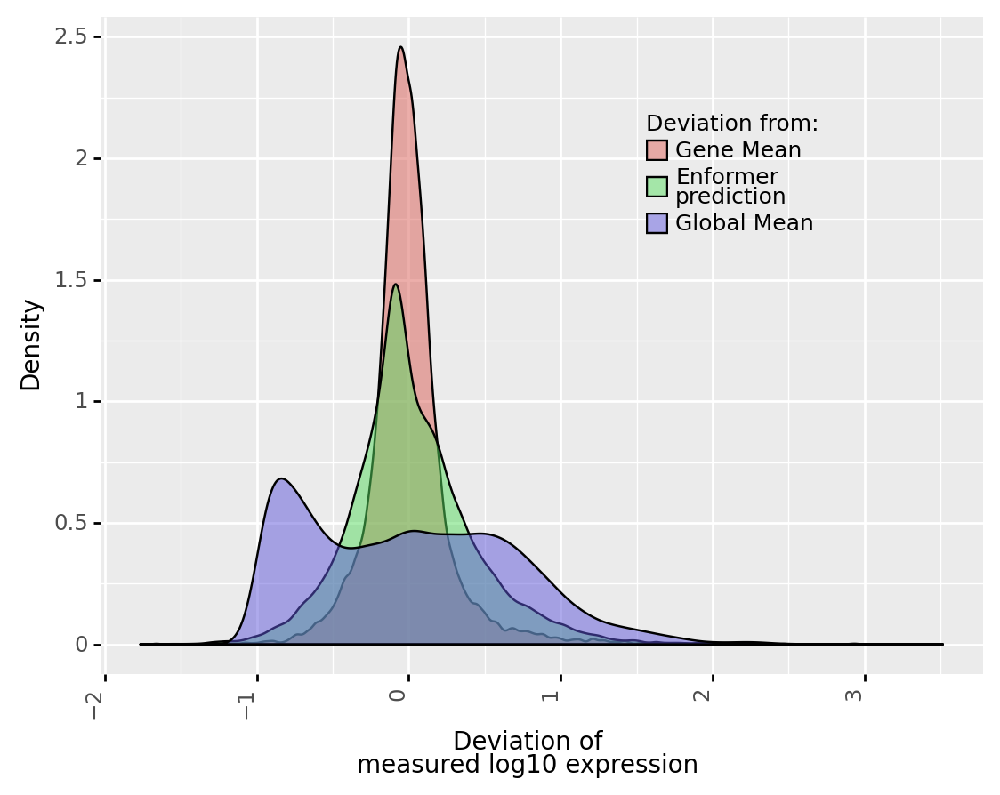

<ggplot: (1405547281137)>

In [96]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

plot_df = (gene_dev_df.sample(frac=0.2,random_state=10)
           [['gene_id','tissue',
             "total","condition",
             "basenji2","enformer"]]
           .melt(id_vars=['gene_id','tissue'],value_name='deviation',var_name='type')
           .query('type != "basenji2"')
          )
plot_df['deviation_log2'] = plot_df['deviation']/np.log10(2)

deviation_rename_dict = {"condition":"Gene Mean",
                        "enformer":"Enformer\nprediction",
                        "total":"Global Mean"}

plot_df["group"] = plot_df["type"].apply(lambda x: deviation_rename_dict[x])

plot_df["group"] = pd.Categorical(plot_df["group"],[x for x in deviation_rename_dict.values()])

p = (p9.ggplot(data=plot_df,mapping=p9.aes(x="deviation",fill="group"))
 #+ p9.geom_col(position="dodge")
 #+ p9.geom_point(size=2.5)
 #+ p9.coords.coord_cartesian(ylim=(0.67,0.85))
 #+ p9.geom_histogram(position="identity", alpha=0.5)
 + p9.geom_density(position="identity", alpha=0.5)
 #+ p9.scale_y_log10()
 + p9.labs(x="Deviation of\nmeasured log10 expression",y="Density",fill="Deviation from:")
 + p9.theme(axis_title=p9.element_text(size=10),
           axis_text_x=p9.element_text(rotation=90, hjust=1),
           legend_box_margin=0, legend_key_size=9, 
            legend_text=p9.element_text(size=9),
            legend_background=p9.element_blank(),
            legend_title=p9.element_text(size=9), legend_position=(0.68,0.70))
)
p

In [97]:
p.save("Graphics/" + "gtex_deviation" + ".svg", width=2.6, height=3.0, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 2.6 x 3.0 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/gtex_deviation.svg


#### Prediction of deviation

In [98]:
gene_dev_df['log2_fc'] = gene_dev_df['condition']/np.log10(2)
gene_dev_df['pred_log2_fc'] = (gene_dev_df['log_pred_enformer'] - gene_dev_df['pred_mean_log_expr_enformer'])/np.log10(2)
gene_dev_df['pred_log2_fc_basenji2'] = (gene_dev_df['log_pred_basenji2'] - gene_dev_df['pred_mean_log_expr_basenji2'])/np.log10(2)
gene_dev_df["abs_log2_fc"] = np.abs(gene_dev_df["log2_fc"])
gene_dev_df["abs_pred_log2_fc"] = np.abs(gene_dev_df["pred_log2_fc"])

In [99]:
print(scipy.stats.pearsonr(gene_dev_df['log2_fc'], gene_dev_df['pred_log2_fc']))
print(scipy.stats.pearsonr(gene_dev_df['log2_fc'], gene_dev_df['pred_log2_fc_basenji2']))

(0.6361563865435633, 0.0)
(0.5367194937130284, 0.0)


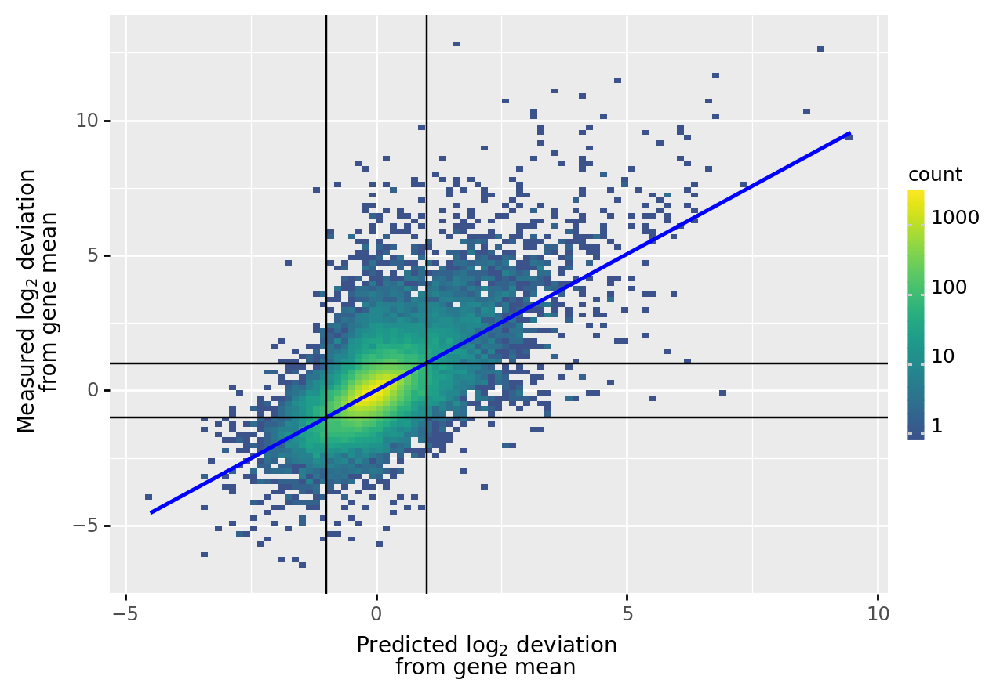

<ggplot: (1405547294377)>

In [101]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=gene_dev_df,mapping=p9.aes(x="pred_log2_fc",y="log2_fc",))
 #+ p9.geom_col(position="dodge")
 + p9.geom_bin2d(bins=100, raster=True)
 + p9.scale_fill_continuous(ListedColormap(cm.get_cmap('viridis', 512)(np.linspace(0.25, 1, 512))), trans="log10")
 + p9.geom_smooth(method="lm",color="blue")
 + p9.geom_vline(xintercept = 1)
 + p9.geom_vline(xintercept = -1)
 + p9.geom_hline(yintercept = 1)
 + p9.geom_hline(yintercept = -1)
 + p9.labs(x="Predicted $\mathregular{log_2}$ deviation\nfrom gene mean",y="Measured $\mathregular{log_2}$ deviation\nfrom gene mean")
 + p9.theme(legend_text=p9.element_text(size=9),legend_title=p9.element_text(size=9),
            legend_box_margin=0,legend_key_width=5,axis_title=p9.element_text(size=10))#
 #+ p9.scale_y_log10()
 #+ p9.labs(x="",y="Density")
)
p

In [102]:
p.save("Graphics/" + "gtex_btwn" + ".svg", width=2.6, height=3.0, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 2.6 x 3.0 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/gtex_btwn.svg


In [100]:
classify_df = gene_dev_df.copy()
classify_df["differential"] = classify_df['abs_log2_fc'] > 1
classify_df["pred_differential"] = classify_df['abs_pred_log2_fc'] > 1

classify_rows_gtex = []
classify_rows_gtex.append({"Dataset":"GTEx","Metric":"FPR","Score":np.sum(classify_df["pred_differential"])/np.sum(~classify_df["differential"])})
classify_rows_gtex.append({"Dataset":"GTEx","Metric":"Precision","Score":sklearn.metrics.precision_score(classify_df["differential"], classify_df["pred_differential"])})
classify_rows_gtex.append({"Dataset":"GTEx","Metric":"Recall","Score":sklearn.metrics.recall_score(classify_df["differential"], classify_df["pred_differential"])})
classify_rows_gtex.append({"Dataset":"GTEx","Metric":"MCC","Score":sklearn.metrics.matthews_corrcoef(classify_df["differential"], classify_df["pred_differential"])})
classify_rows_gtex.append({"Dataset":"GTEx","Metric":"Prevalence","Score":np.sum(classify_df["differential"])/len(classify_df["differential"])})

In [101]:
pd.DataFrame(classify_rows_gtex)

,Dataset,Metric,Score
0,GTEx,FPR,0.087292
1,GTEx,Precision,0.662562
2,GTEx,Recall,0.298761
3,GTEx,MCC,0.381294
4,GTEx,Prevalence,0.162190


In [99]:
sklearn.metrics.accuracy_score(classify_df["differential"], classify_df["pred_differential"])

0.8615874507347375

In [97]:
sklearn.metrics.confusion_matrix(classify_df["differential"],classify_df["pred_differential"], normalize="all")

array([[0.81313131, 0.02467831],
       [0.11373424, 0.04845614]])

In [110]:
0.05/(0.05+0.115)

0.30303030303030304

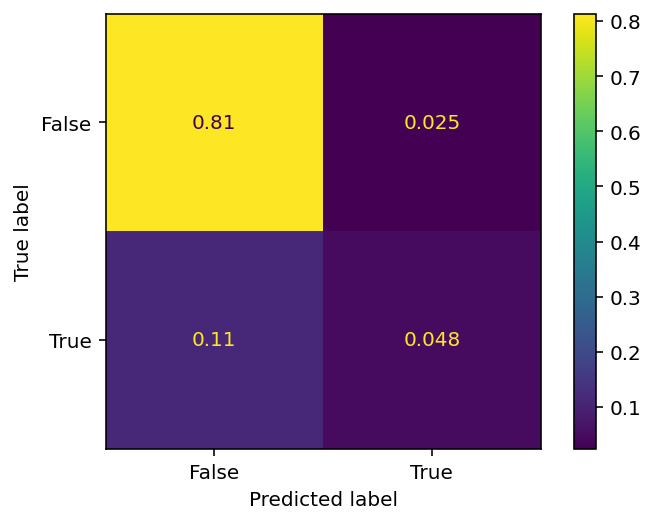

In [131]:
cmatrix = sklearn.metrics.ConfusionMatrixDisplay.from_predictions(classify_df["differential"],classify_df["pred_differential"], normalize="all")
ax,fig = cmatrix.ax_, cmatrix.figure_

In [400]:
classify_df = gene_dev_df.query('abs_log2_fc > 1 or abs_log2_fc < 0.3')
classify_df["differential"] = classify_df['abs_log2_fc'] > 1
classify_df["three_class_obs"] = classify_df['log2_fc'].apply(lambda x: "Up" if x > 1 else ("Down" if x < - 1 else "Neutral"))
classify_df["three_class_pred"] = classify_df['pred_log2_fc'].apply(lambda x: "Up" if x > 1 else ("Down" if x < - 1 else "Neutral"))

In [414]:
#print(sklearn.metrics.accuracy_score(classify_df["three_class_obs"], ["Neutral"]*len(classify_df)))
print(sklearn.metrics.balanced_accuracy_score(classify_df["three_class_obs"], classify_df["three_class_pred"]))
print(sklearn.metrics.precision_score(classify_df["three_class_obs"], classify_df["three_class_pred"],
                                      labels=["Up","Neutral","Down"],average=None))
print(sklearn.metrics.recall_score(classify_df["three_class_obs"],classify_df["three_class_pred"],
                                   labels=["Up","Neutral","Down"],average=None))

0.5225860586079877
[0.84947491 0.77836834 0.86190476]
[0.35305529 0.98272596 0.23197693]


### Kaessmann - Across genes, linear model matching

#### Train linear models and generate predictions

##### Enformer

In [ ]:
linearmodel_match_windowed(gene_df, kaessmann_molten, dev_tissues, "sample", gene_locs, windows, 
                           model_name = "enformer", dataset_name="kaessmann",
                          lm=sklearn.linear_model.RidgeCV(), print_alpha=True)

##### Basenji2

In [50]:
with open(base_path_results + "tss_sim-basenji2-latest_results.tsv", 'r') as tsv:
    header = tsv.readline()
    cols = header.split("\t")
cols = [k for k in cols if "CAGE" in k and k.endswith("landmark_sum")]

basenji2_results = pd.read_csv(base_path_results + "tss_sim-basenji2-latest_results.tsv",sep="\t",
                              usecols = ['gene_id', 'gene_name', 'orient', 'offset', 'window_size'] + cols)
basenji2_results = (basenji2_results.groupby(["gene_id","gene_name"])[[x for x in basenji2_results.keys() if "CAGE" in x]].mean().reset_index())

universal_samples = ['Clontech Human Universal Reference Total RNA', 'SABiosciences XpressRef Human Universal Total RNA', 'CAGE:Universal RNA - Human Normal Tissues Biochain']
track_cols = [k for k in basenji2_results.keys() if "CAGE" in k and k.endswith("landmark_sum") and not any(x in k for x in universal_samples)]

basenji2_gene_df = basenji2_results[["gene_id","gene_name"] + track_cols].rename(columns={t:t+"_basenji2" for t in track_cols})

In [ ]:
linearmodel_match_windowed(basenji2_gene_df, kaessmann_molten, dev_tissues, "sample", gene_locs, 
                           windows=["basenji2"], 
                           model_name = "basenji2", dataset_name="kaessmann",
                           lm=sklearn.linear_model.RidgeCV(), print_alpha=True)

#### Analyze correlations

In [431]:
kaessmann_corrs_lasso = pd.read_csv(base_path_results + "kaessmann_corrs_modelmatched_enformer.tsv", sep="\t")
kaessmann_corrs_lasso["window_size"] = (pd.Categorical(kaessmann_corrs_lasso["window_size"], 
                                                    [str(x) for x in sorted([int(x) for x in set(kaessmann_corrs_lasso["window_size"]) if x != "Full"])] + ["Full"]))

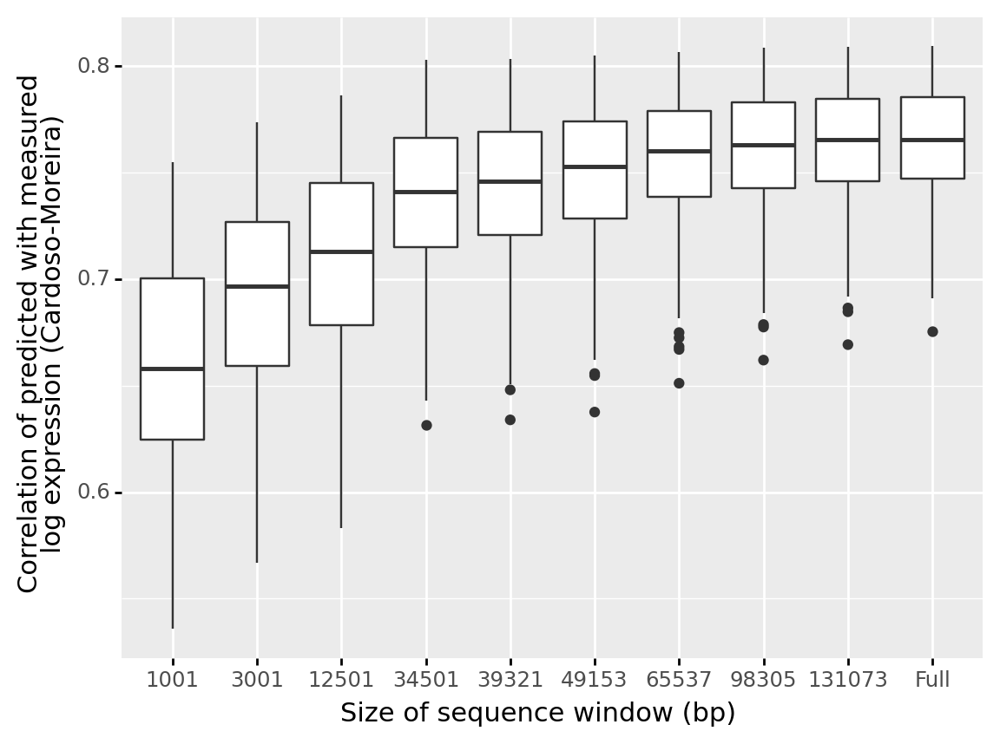

<ggplot: (8756721082293)>

In [434]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=kaessmann_corrs_lasso,mapping=p9.aes(x="window_size",y="r"))
 + p9.geom_boxplot()
 + p9.labs(x="Size of sequence window (bp)",y="Correlation of predicted with measured\nlog expression (Cardoso-Moreira)")
)
p

In [435]:
p.save("Graphics/" + "xsup_distal_kaess" + ".svg", width=6.4, height=4.8, dpi=300)

#### Compare to other models

In [107]:
kaessmann_corrs = pd.read_csv(base_path_results + "kaessmann_corrs_modelmatched_enformer.tsv", sep="\t").query('window_size == "Full"')
kaessmann_corrs["model"] = "Enformer"
kaessmann_corrs = kaessmann_corrs[["sample","model","r"]]

In [108]:
kaessmann_pred_df = pd.read_csv(base_path_results + "kaessmann_pred_modelmatched_enformer.tsv", sep="\t")

xpresso_pred_df = (pd.read_csv(base_path_results_xpresso + "xpresso_preds.tsv", sep = "\t")
                   [["gene_id","Prediction"]]
                   .rename(columns={"Prediction":"xpresso_pred"})
                  )

kaessmann_pred_df = (kaessmann_pred_df
                  .merge(xpresso_pred_df, on="gene_id")
                  .merge(gene_locs[["gene_id","len"]], on="gene_id")
                 )

kaessmann_pred_df["log_len"] = np.log10(kaessmann_pred_df["len"])

row_list = []
for sample in dev_tissues:
    subset_train = kaessmann_pred_df.query('sample == @sample & gene_id not in @intersect_genes')
    subset_test = kaessmann_pred_df.query('sample == @sample & gene_id in @test_genes')
    # train ridge
    y_train = np.array(subset_train['log_obs'])
    X_train = np.array(subset_train[['log_len','xpresso_pred']])
    model = sklearn.linear_model.RidgeCV()
    model.fit(X_train, y_train)
    # test ridge
    y_test = np.array(subset_test['log_obs'])
    X_test = np.array(subset_test[['log_len','xpresso_pred']])
    y_pred = model.predict(X_test).reshape(-1)
    tpl = (y_test, y_pred)
    r = scipy.stats.pearsonr(*tpl)
    row_list.append({
        "sample":sample,
        "model":"Xpresso",
        "r":r[0]
    })
xpresso_corrs = pd.DataFrame(row_list)

In [109]:
basenji2_corrs = pd.read_csv(base_path_results + "kaessmann_corrs_modelmatched_basenji2.tsv", sep="\t")[["sample","r"]]
basenji2_corrs["model"] = "Basenji2"

In [110]:
combined_corrs = pd.concat([kaessmann_corrs, xpresso_corrs,  basenji2_corrs])

In [122]:
combined_corrs.groupby('model').median()

,r,stage_num
model,,
Basenji2,0.729644,23.0
Enformer,0.765622,23.0
Xpresso,0.609452,23.0


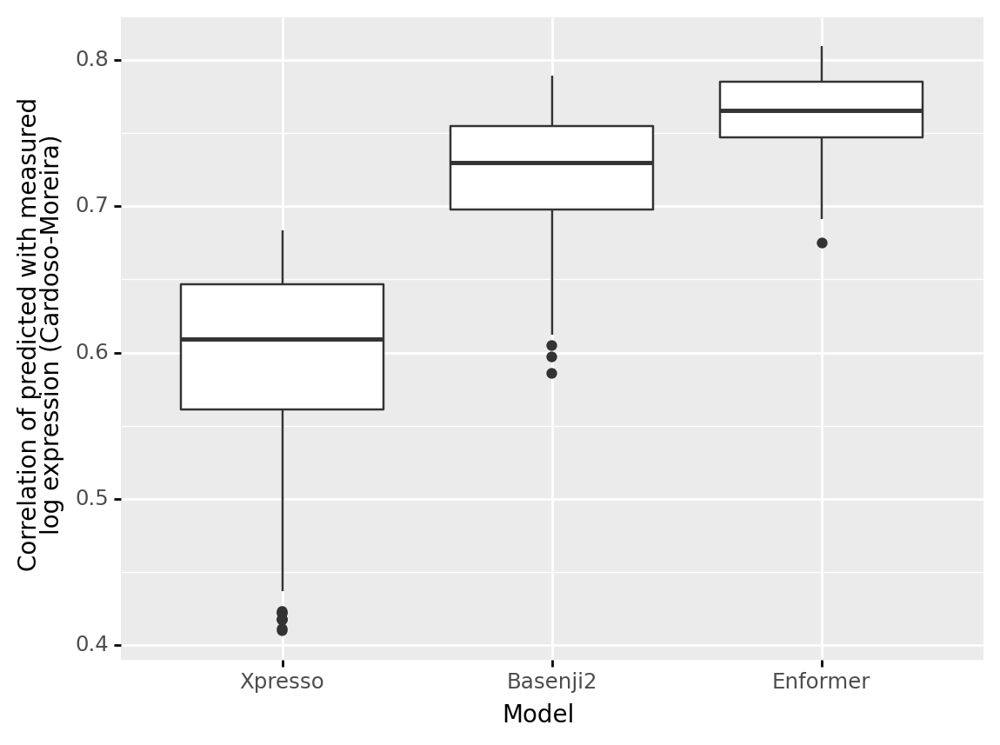

<ggplot: (1417123001272)>

In [111]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

combined_corrs["model_cat"] = pd.Categorical(combined_corrs["model"],
                                             categories=["Xpresso", "Basenji2", "Enformer"])

p = (p9.ggplot(data=combined_corrs
           ,mapping=p9.aes(x="model_cat",y="r"))
 + p9.geom_boxplot()
 + p9.labs(x="Model",y="Correlation of predicted with measured\nlog expression (Cardoso-Moreira)")
 + p9.theme(axis_title=p9.element_text(size=10))
)
p

In [112]:
p.save("Graphics/" + "xsup_gtex_kaessmann" + ".svg", width=6.4, height=4.8, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.4 x 4.8 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/xsup_gtex_kaessmann.svg


In [113]:
combined_corrs["tissue"] = combined_corrs["sample"].apply(lambda x: x.split('.')[0])
combined_corrs["stage"] = combined_corrs["sample"].apply(lambda x: x.split('.')[1].lower())
combined_corrs["stage_num"] = combined_corrs["sample"].apply(lambda x: int(x.split('.')[2]))

/scratch/tmp/karollus/ipykernel_289434/468756090.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


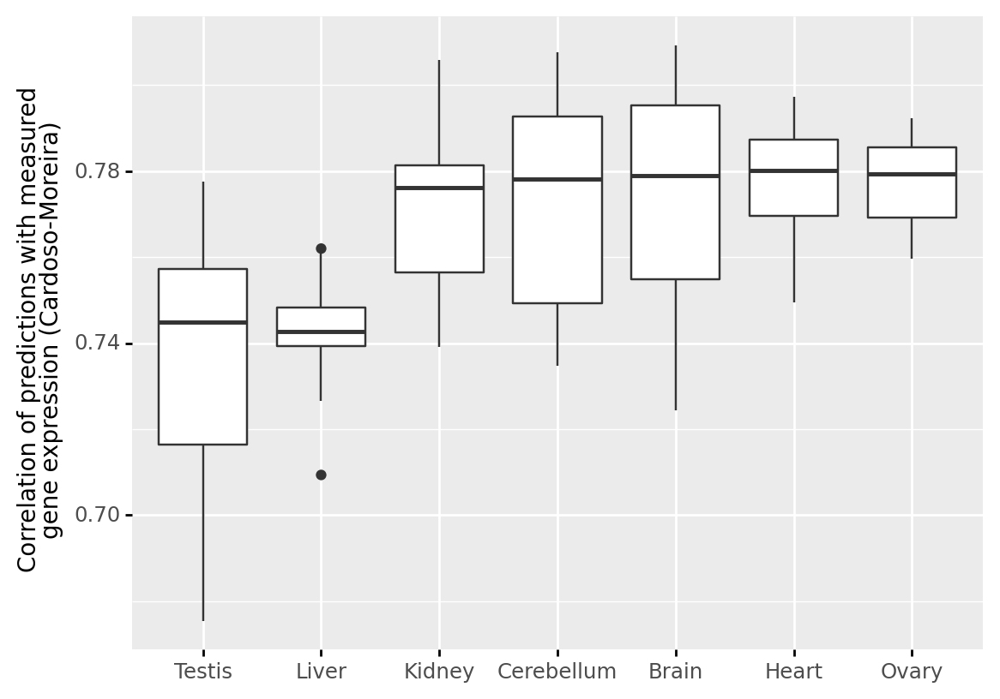

<ggplot: (1417122104333)>

In [114]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

plot_df = combined_corrs.query('model in ["Enformer"]')

plot_df["tissue"] =  pd.Categorical(plot_df["tissue"],
                                     categories=(combined_corrs
                                                 .query('model in ["Enformer"]')
                                                 .groupby(['tissue','model'])['r'].mean().reset_index()
                                                 .sort_values('r')["tissue"]))

p = (p9.ggplot(data=plot_df
           ,mapping=p9.aes(x="tissue",y="r"))#, color="model_cat"))
 #+ p9.geom_col(position="dodge")
 + p9.geom_boxplot()
 #+ p9.coords.coord_cartesian(ylim=(0.7,0.85))
 + p9.labs(x="",y="Correlation of predictions with measured\ngene expression (Cardoso-Moreira)",color="Model")
 + p9.theme(axis_title=p9.element_text(size=10),legend_background=p9.element_blank(),
            legend_text=p9.element_text(size=8),legend_key_size=8,
            legend_title=p9.element_text(size=8))
)
p

In [115]:
p.save("Graphics/" + "xsup_gtex_kaessmann_tissues" + ".svg", width=6.4, height=4.8, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.4 x 4.8 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/xsup_gtex_kaessmann_tissues.svg


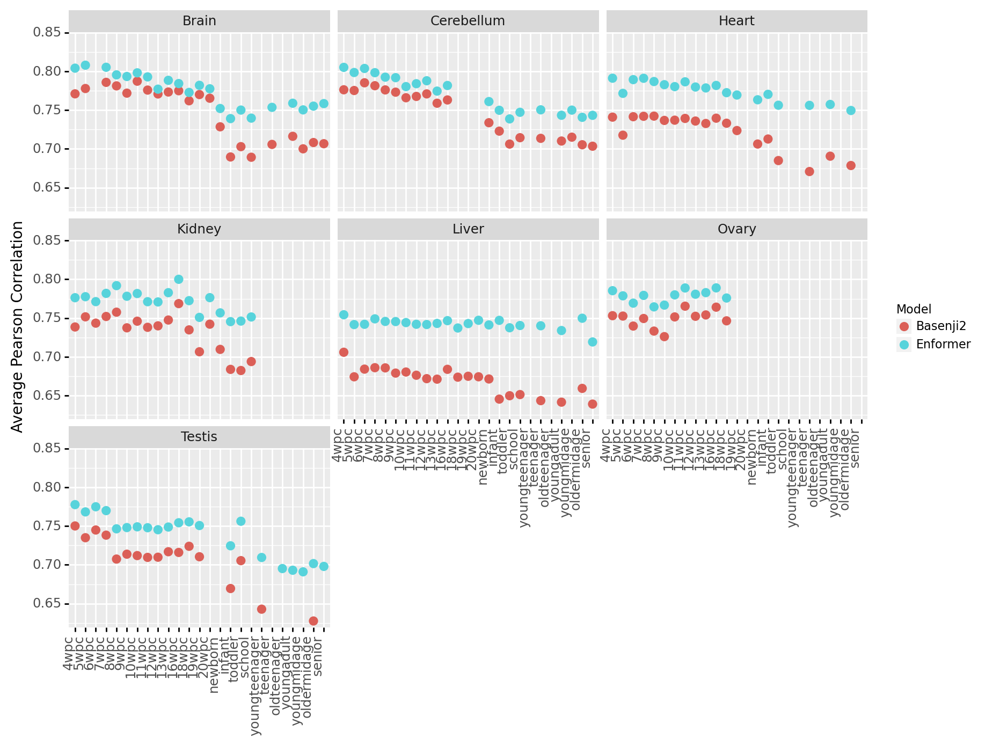

<ggplot: (1417122202146)>

In [116]:
stage_cats = ['4wpc','5wpc','6wpc','7wpc','8wpc','9wpc','10wpc','11wpc','12wpc','13wpc','16wpc','18wpc','19wpc','20wpc','newborn','infant','toddler',
              'school','youngteenager','teenager','oldteenager','youngadult','youngmidage','oldermidage','senior']

plot_df = combined_corrs.query('model in ["Basenji2","Enformer"]').groupby(['stage','model','tissue'])['r'].mean().reset_index().sort_values('r')

scale = 1.5
p9.options.figure_size = (6.4*scale, 4.8*scale)

plot_df["model_cat"] = pd.Categorical(plot_df["model"],
                                      categories=["Basenji2", "Enformer"])

plot_df["stage"] =  pd.Categorical(plot_df["stage"],
                                     categories=stage_cats)

(p9.ggplot(data=plot_df
           ,mapping=p9.aes(x="stage",y="r",color='model_cat'))
 #+ p9.geom_col(position="dodge")
 + p9.geom_point(size=2.5)
 + p9.coords.coord_cartesian(ylim=(0.63,0.84))
 + p9.labs(x="",y="Average Pearson Correlation",color="Model")
 + p9.facet_wrap('~tissue')
 + p9.theme(axis_title=p9.element_text(size=10),legend_background=p9.element_blank(),
            legend_text=p9.element_text(size=8),legend_key_size=8,
            legend_title=p9.element_text(size=8), axis_text_x=p9.element_text(rotation=90, hjust=1))
)

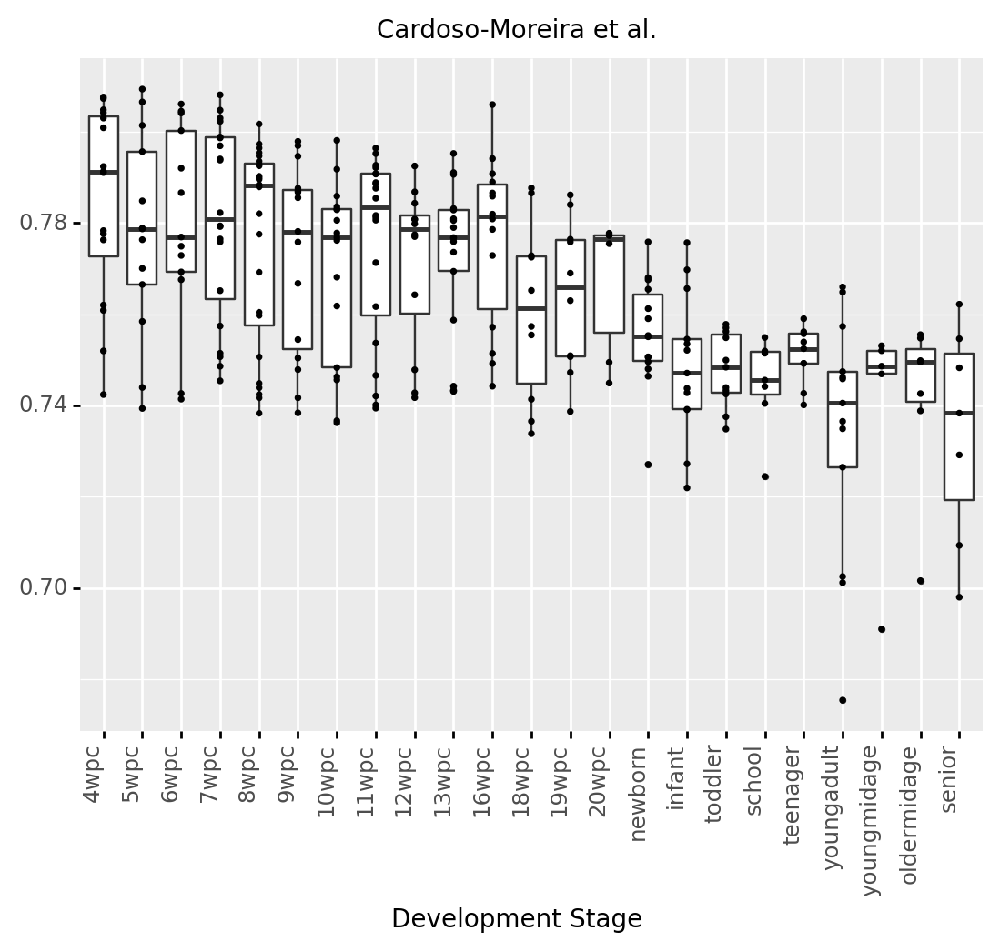

<ggplot: (1417130696057)>

In [117]:
stage_cats = ['4wpc','5wpc','6wpc','7wpc','8wpc','9wpc','10wpc','11wpc','12wpc','13wpc','16wpc','18wpc','19wpc','20wpc','newborn','infant','toddler',
              'school','youngteenager','teenager','oldteenager','youngadult','youngmidage','oldermidage','senior']

plot_df = combined_corrs.query('model in ["Enformer"]')



scale = 1.0
p9.options.figure_size = (6.4*scale, 4.8*scale)


plot_df = plot_df.query('stage not in ["youngteenager","oldteenager"]')
plot_df["stage"] = pd.Categorical(plot_df["stage"],
                                     categories=stage_cats)

p = (p9.ggplot(data=plot_df
           ,mapping=p9.aes(x="stage",y="r"))
 #+ p9.geom_col(position="dodge")
 + p9.geom_boxplot(outlier_size=0.5)
 + p9.geom_point(size=0.5)
 #+ p9.coords.coord_cartesian(ylim=(0.7,0.84))
 + p9.labs(x="Development Stage",y="", title="Cardoso-Moreira et al.")
 + p9.theme(axis_title=p9.element_text(size=10), title=p9.element_text(size=10),
            legend_background=p9.element_blank(),
            legend_text=p9.element_text(size=8),legend_key_size=8,
            legend_title=p9.element_text(size=8), axis_text_x=p9.element_text(rotation=90, hjust=1))
)
p

In [118]:
p.save("Graphics/" + "gtex_kaessmann_stages" + ".svg", width=3.3, height=3.3, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 3.3 x 3.3 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/gtex_kaessmann_stages.svg


### Kaessmann - Across development stages

#### Analyze correlations

In [123]:
kaessmann_pred_df = pd.read_csv(base_path_results + "kaessmann_pred_modelmatched_enformer.tsv", sep="\t")

dev_var_df = kaessmann_pred_df

dev_var_df["col"] = dev_var_df["sample"].apply(lambda x: "_".join(x.split("_")[1:]))
dev_var_df["tissue"] = dev_var_df["sample"].apply(lambda x: x.split(".")[0])
dev_var_df["dev_stage"] = dev_var_df["sample"].apply(lambda x: "_".join(x.split("_")[0].split(".")[1:]))
dev_var_df["dev_stage_number"] = dev_var_df["dev_stage"].apply(lambda x: int(x.split("_")[1]))
dev_var_df["dev_stage"] = dev_var_df["dev_stage"].apply(lambda x: x.split("_")[0])

dev_var_df_aggreg = dev_var_df.groupby(["gene_id","tissue","dev_stage"]).mean().reset_index()

In [124]:
rows = []

dev_var_df_indexed = dev_var_df_aggreg.set_index("gene_id")

for tissue in set(dev_var_df_aggreg["tissue"]):
    tissue_subset_df = dev_var_df_indexed.query('tissue == @tissue')
    for gene in set(tissue_subset_df.index[tissue_subset_df.index.isin(test_genes)]):
        subset = tissue_subset_df.loc[gene]
        # skip genes which are constant across dev-stages (or never expressed)
        if not (subset["log_obs"].std() > 0):
            continue
        for col in [x for x in subset.keys() if x.startswith("log_pred")]:
            row_dict = {"gene_id":gene, "tissue":tissue}
            row_dict["window_size"] = col.split("_")[-1]
            tpl = (subset["log_obs"],subset[col])
            corr_test =  scipy.stats.pearsonr(*tpl)
            r = corr_test[0]
            row_dict["R"] = r
            row_dict["p"] = corr_test[1]
            row_dict["rho"] = scipy.stats.spearmanr(*tpl)[0]
            row_dict["R-squared"]  = sklearn.metrics.r2_score(*tpl)
            row_dict["R-squared (after Rescaling)"] = r ** 2
            row_dict["Explained Variance"]  = sklearn.metrics.explained_variance_score(*tpl)
            row_dict["pred_mean_log_expr"] = subset["log_pred_ingenome"].mean()
            row_dict["pred_std_log_expr"] = subset["log_pred_ingenome"].std()
            row_dict["mean_log_expr"] = subset["log_obs"].mean()
            row_dict["std_log_expr"] = subset["log_obs"].std()
            rows.append(row_dict)
        
between_dev_corrs = pd.DataFrame(rows)
between_dev_corrs["window_size"] = between_dev_corrs["window_size"].apply(lambda x: x if x != "ingenome" else "Full")
between_dev_corrs["window_size"] = pd.Categorical(between_dev_corrs["window_size"], 
                                                  ['null'] + [str(x) for x in sorted([int(x) for x in set(between_dev_corrs["window_size"]) if x != "Full" and x != "null"])] + ["Full"])

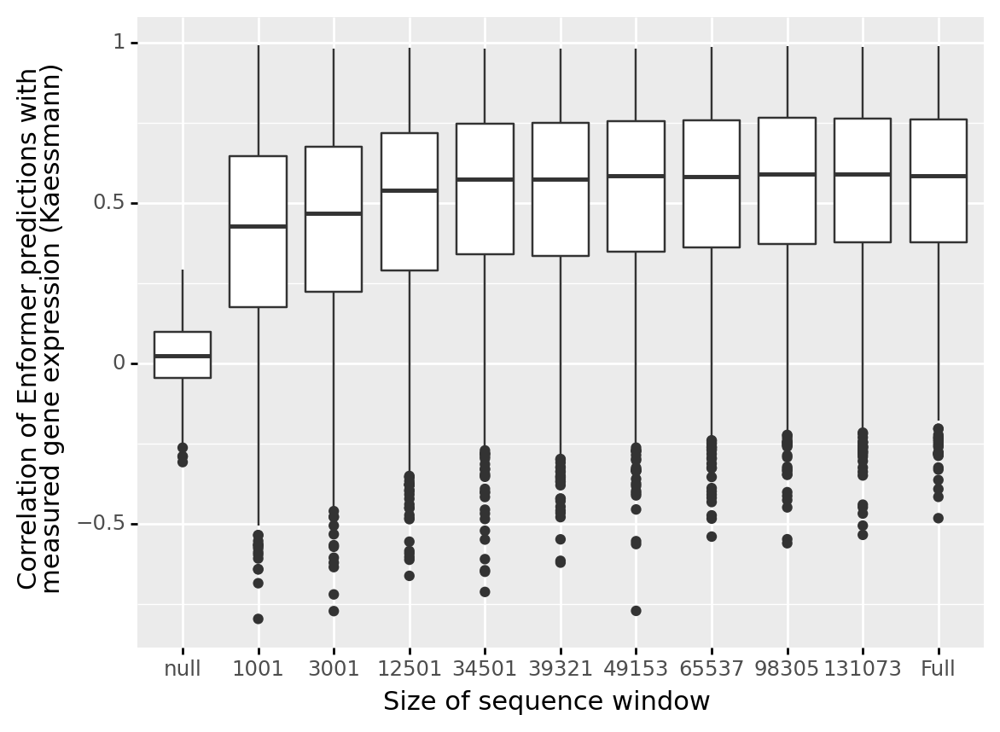

<ggplot: (1417122480716)>

In [125]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

(p9.ggplot(data=between_dev_corrs.groupby(["window_size","gene_id"])["R"].median().reset_index(),mapping=p9.aes(x="window_size",y="R"))
 + p9.geom_boxplot()
 + p9.labs(x="Size of sequence window",y="Correlation of Enformer predictions with\nmeasured gene expression (Kaessmann)")
)

#### Compare to other models

In [126]:
kaessmann_tissues = set([x.split(".")[0] for x in dev_tissues])

kaessmann_pred_df = (pd.read_csv(base_path_results + "kaessmann_pred_modelmatched_enformer.tsv", sep="\t")
                  [["gene_id","sample","log_obs","log_pred_ingenome"]]
                  .rename(columns={"log_pred_ingenome":"log_pred_enformer"})
                 )

kaessmann_pred_df_basenji2 = (pd.read_csv(base_path_results + "kaessmann_pred_modelmatched_basenji2.tsv", sep="\t")
                          [["gene_id","sample","log_pred_basenji2"]]
                         )

kaessmann_pred_df = (kaessmann_pred_df
                  .merge(kaessmann_pred_df_basenji2, on=["gene_id", "sample"])
                 )

In [127]:
dev_var_df = kaessmann_pred_df

dev_var_df["tissue"] = dev_var_df["sample"].apply(lambda x: x.split(".")[0])
dev_var_df["dev_stage"] = dev_var_df["sample"].apply(lambda x: "_".join(x.split("_")[0].split(".")[1:]))
dev_var_df["dev_stage_number"] = dev_var_df["dev_stage"].apply(lambda x: int(x.split("_")[1]))
dev_var_df["dev_stage"] = dev_var_df["dev_stage"].apply(lambda x: x.split("_")[0])

dev_var_df_aggreg = dev_var_df.groupby(["gene_id","tissue","dev_stage"]).mean().reset_index()

In [128]:
rows = []

dev_var_df_indexed = dev_var_df_aggreg.set_index("gene_id")

for tissue in kaessmann_tissues:
    tissue_subset_df = dev_var_df_indexed.query('tissue == @tissue')
    for gene in set(tissue_subset_df.index[tissue_subset_df.index.isin(test_genes)]):
        subset = tissue_subset_df.loc[gene]
        # skip genes which are constant across dev-stages (or never expressed)
        if not (subset["log_obs"].std() > 0):
            continue
        for col in [x for x in subset.keys() if x.startswith("log_pred")]:
            row_dict = {"gene_id":gene}
            row_dict["model"] = col.split("_")[-1]
            row_dict["tissue"] = tissue
            tpl = (subset["log_obs"],subset[col])
            corr_test =  scipy.stats.pearsonr(*tpl)
            r = corr_test[0]
            row_dict["R"] = r
            row_dict["p"] = corr_test[1]
            row_dict["rho"] = scipy.stats.spearmanr(*tpl)[0]
            row_dict["R-squared"]  = sklearn.metrics.r2_score(*tpl)
            row_dict["pred_mean_log_expr_enformer"] = subset["log_pred_enformer"].mean()
            row_dict["pred_std_log_expr_enformer"] = subset["log_pred_enformer"].std()
            row_dict["pred_mean_log_expr_basenji2"] = subset["log_pred_basenji2"].mean()
            row_dict["pred_std_log_expr_basenji2"] = subset["log_pred_basenji2"].std()
            row_dict["mean_log_expr"] = subset["log_obs"].mean()
            row_dict["std_log_expr"] = subset["log_obs"].std()
            rows.append(row_dict)
        
between_dev_corrs = pd.DataFrame(rows)

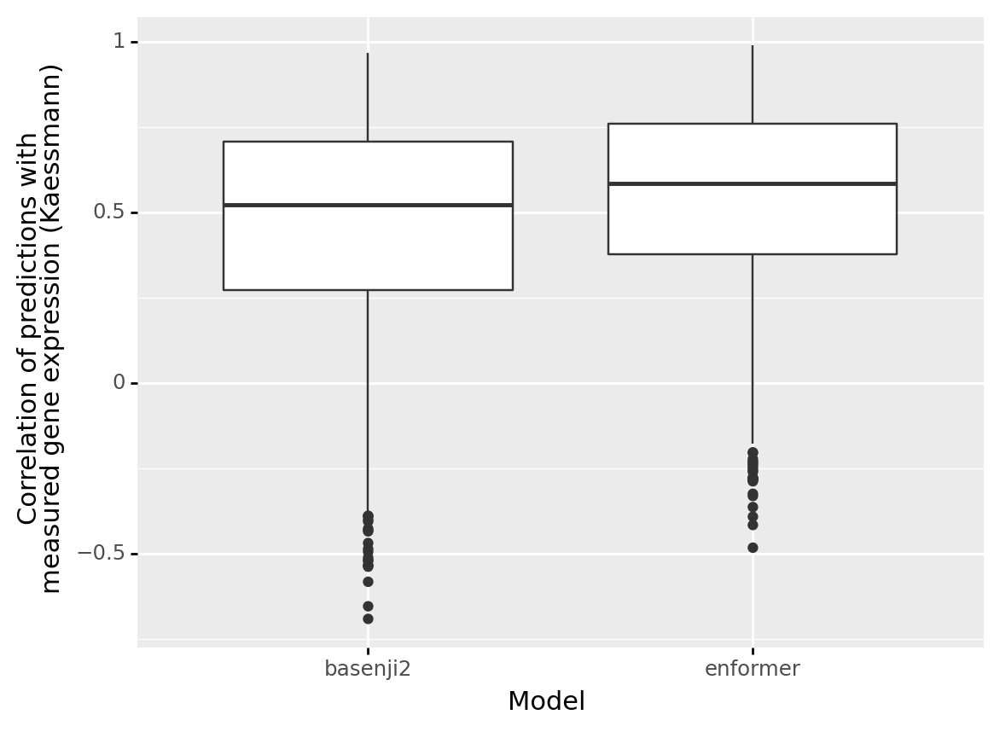

<ggplot: (1417121002397)>

In [129]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

(p9.ggplot(data=between_dev_corrs.groupby(["model","gene_id"])["R"].median().reset_index(),mapping=p9.aes(x="model",y="R"))
 + p9.geom_boxplot()
 + p9.labs(x="Model",y="Correlation of predictions with\nmeasured gene expression (Kaessmann)")
)

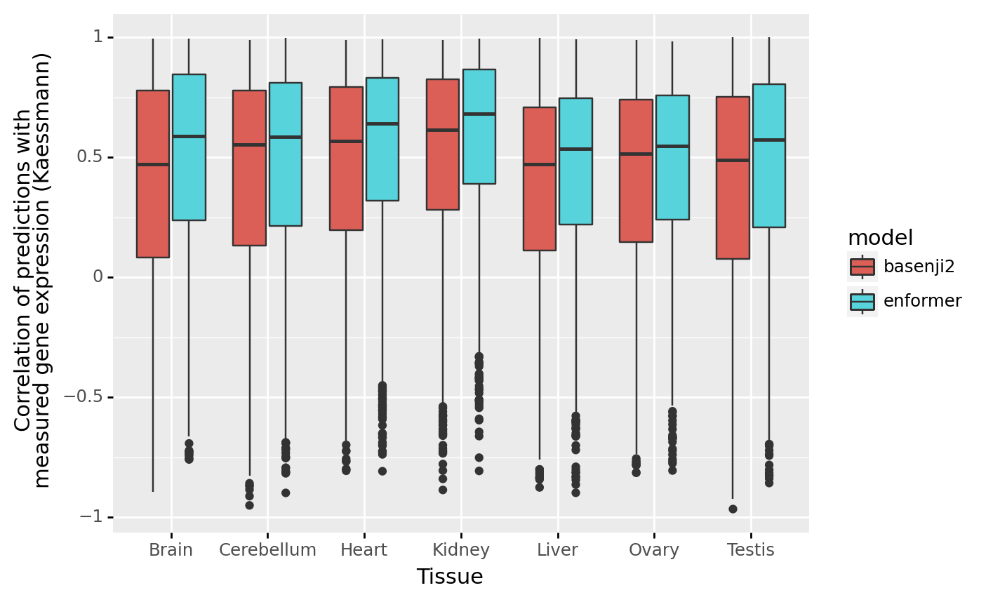

<ggplot: (1416933628182)>

In [130]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

(p9.ggplot(data=between_dev_corrs,mapping=p9.aes(x="tissue",y="R", fill="model"))
 + p9.geom_boxplot()
 + p9.labs(x="Tissue",y="Correlation of predictions with\nmeasured gene expression (Kaessmann)")
)

#### Look at DDG genes particularly

In [131]:
ddg_df = pd.read_csv(base_path_data_kaessmann + "human_ddg.tsv",sep="\t").rename(columns={"Human_ID":"gene_id"})

In [132]:
pattern_cols = [x for x in ddg_df.keys() if "pattern" in x]
ddg_df = (ddg_df[["gene_id"] + pattern_cols]
          .fillna("Not DDG")
          .rename(columns={x:x.split("_")[0] for x in pattern_cols})
          .melt(id_vars="gene_id",var_name="tissue",value_name="ddg_status")
         )

ddg_df["is_ddg"] = ddg_df["ddg_status"] != "Not DDG"

In [133]:
ddg_df = between_dev_corrs.merge(ddg_df, on=["gene_id","tissue"])

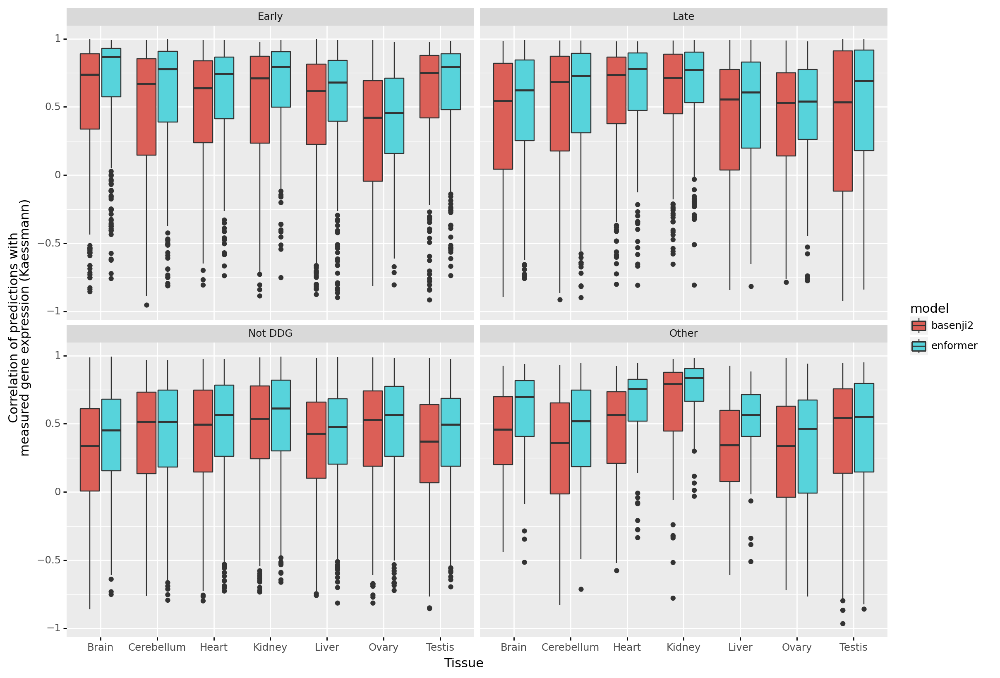

<ggplot: (1417121797548)>

In [134]:
scale = 2
p9.options.figure_size = (6.4*scale, 4.8*scale)

(p9.ggplot(data=ddg_df,mapping=p9.aes(x="tissue",y="R", fill="model"))
 + p9.geom_boxplot()
 + p9.labs(x="Tissue",y="Correlation of predictions with\nmeasured gene expression (Kaessmann)")
 + p9.facet_wrap('~ddg_status')
)

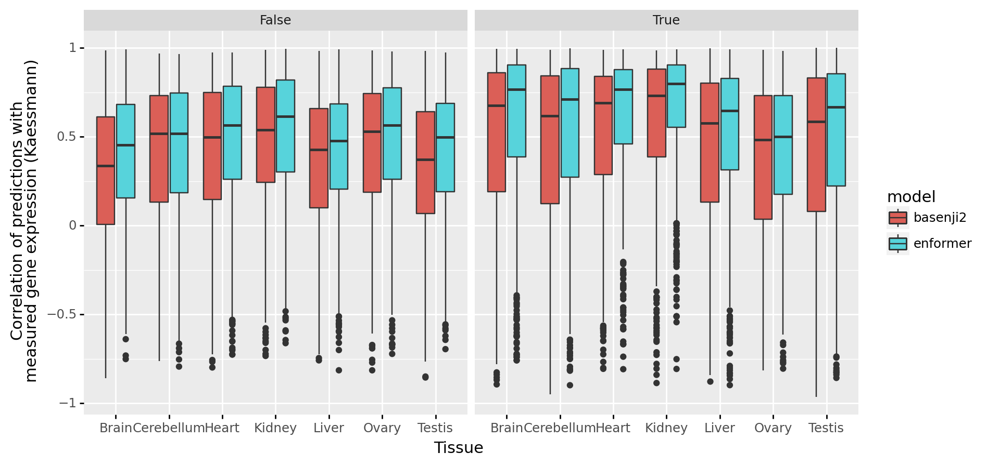

<ggplot: (1417122195716)>

In [135]:
scale = 1.5
p9.options.figure_size = (6.4*scale, 3.2*scale)

(p9.ggplot(data=ddg_df,mapping=p9.aes(x="tissue",y="R", fill="model"))
 + p9.geom_boxplot()
 + p9.labs(x="Tissue",y="Correlation of predictions with\nmeasured gene expression (Kaessmann)")
 + p9.facet_wrap('~is_ddg')
)

In [136]:
ddg_df.query('model == "enformer"').groupby(['tissue','is_ddg'])['R'].median().reset_index()

,tissue,is_ddg,R
0,Brain,False,0.454008
1,Brain,True,0.765482
2,Cerebellum,False,0.516632
3,Cerebellum,True,0.711599
4,Heart,False,0.564660
5,Heart,True,0.766081
6,Kidney,False,0.613624
7,Kidney,True,0.797296
8,Liver,False,0.476737
9,Liver,True,0.647768


#### RMSE analysis

In [137]:
gene_mean_df = (between_dev_corrs
           .groupby('gene_id')
           [["pred_mean_log_expr_enformer","pred_std_log_expr_enformer","pred_mean_log_expr_basenji2","pred_std_log_expr_basenji2","mean_log_expr" ,"std_log_expr"]]
           .mean()
           .reset_index()
          )
# prediction of gene mean
print(scipy.stats.pearsonr(gene_mean_df["mean_log_expr"],gene_mean_df["pred_mean_log_expr_basenji2"]))
print(scipy.stats.pearsonr(gene_mean_df["mean_log_expr"],gene_mean_df["pred_mean_log_expr_enformer"]))
# prediction of gene standard deviation
print(scipy.stats.pearsonr(gene_mean_df["std_log_expr"],gene_mean_df["pred_std_log_expr_basenji2"]))
print(scipy.stats.pearsonr(gene_mean_df["std_log_expr"],gene_mean_df["pred_std_log_expr_enformer"]))

(0.7732077559119426, 8.277250072437855e-280)
(0.8031286821764476, 7.85438e-318)
(0.3812406595916254, 7.885109433185265e-50)
(0.5386445440533605, 1.5660764975447842e-106)


In [138]:
sklearn.metrics.r2_score(dev_var_df_aggreg.query('gene_id in @test_genes')["log_obs"],
                         dev_var_df_aggreg.query('gene_id in @test_genes')["log_pred_enformer"])

0.5850397610474509

In [139]:
gene_dev_df = dev_var_df_aggreg.merge(gene_mean_df, on="gene_id")

In [140]:
# compute deviations
# y^bar_g - y^bar: deviation of gene mean around global mean
# y^bar_gc - y^bar: deviation of genes around global mean
# y_gc - y^bar_g : deviation of genes around gene means
# y_gc - y^hat_gc : residual

gene_dev_df["total"] = gene_dev_df["log_obs"] - gene_mean_df['mean_log_expr'].mean()
gene_dev_df["condition"] = gene_dev_df["log_obs"] - gene_dev_df['mean_log_expr']
gene_dev_df["basenji2"] = gene_dev_df["log_obs"] - gene_dev_df['log_pred_basenji2']
gene_dev_df["enformer"] = gene_dev_df["log_obs"] - gene_dev_df['log_pred_enformer']

In [141]:
# Variance explained by gene means
1 - (np.sum(gene_dev_df["condition"]**2)/np.sum(gene_dev_df["total"]**2))

0.7552156264832097

In [142]:
# Variance explained by enformer
1 - (np.sum(gene_dev_df["enformer"]**2)/np.sum(gene_dev_df["total"]**2))

0.5850398614467919

In [143]:
# compute the dynamic ranges in log10
print("log10")
print(gene_dev_df["total"].quantile([0.05,0.95]).max() - gene_dev_df["total"].quantile([0.05,0.95]).min())
print(gene_dev_df["condition"].quantile([0.05,0.95]).max() - gene_dev_df["condition"].quantile([0.05,0.95]).min())
print(gene_dev_df["enformer"].quantile([0.05,0.95]).max() - gene_dev_df["enformer"].quantile([0.05,0.95]).min())

print("log2")
print((gene_dev_df["total"].quantile([0.05,0.95]).max() - gene_dev_df["total"].quantile([0.05,0.95]).min())/np.log10(2))
print((gene_dev_df["condition"].quantile([0.05,0.95]).max() - gene_dev_df["condition"].quantile([0.05,0.95]).min())/np.log10(2))
print((gene_dev_df["enformer"].quantile([0.05,0.95]).max() - gene_dev_df["enformer"].quantile([0.05,0.95]).min())/np.log10(2))

log10
1.6371960784266888
0.7799725563090629
1.1579417090429214
log2
5.438647649765031
2.591012748044191
3.8465990955115683


In [144]:
# compute the RMSE
print(gene_dev_df["total"].std()/np.log10(2))
print(gene_dev_df["condition"].std()/np.log10(2))
print(gene_dev_df["enformer"].std()/np.log10(2))
print(gene_dev_df["basenji2"].std()/np.log10(2))

1.8401799785034592
0.9104413709630634
1.1837893070943253
1.2733113612999236


In [145]:
# compute the MAE
print(np.abs(gene_dev_df["total"]).mean()/np.log10(2))
print(np.abs(gene_dev_df["condition"]).mean()/np.log10(2))
print(np.abs(gene_dev_df["enformer"]).mean()/np.log10(2))
print(np.abs(gene_dev_df["basenji2"]).mean()/np.log10(2))

1.5322128226938565
0.5582544782157114
0.8486154190595729
0.9157668750161502


In [146]:
#gene_mean_dev = (gene_mean_df["mean_log_expr"] - gene_mean_df['mean_log_expr'].mean())
#print(np.sum(np.abs(gene_mean_dev.quantile([0.05,0.95]))))

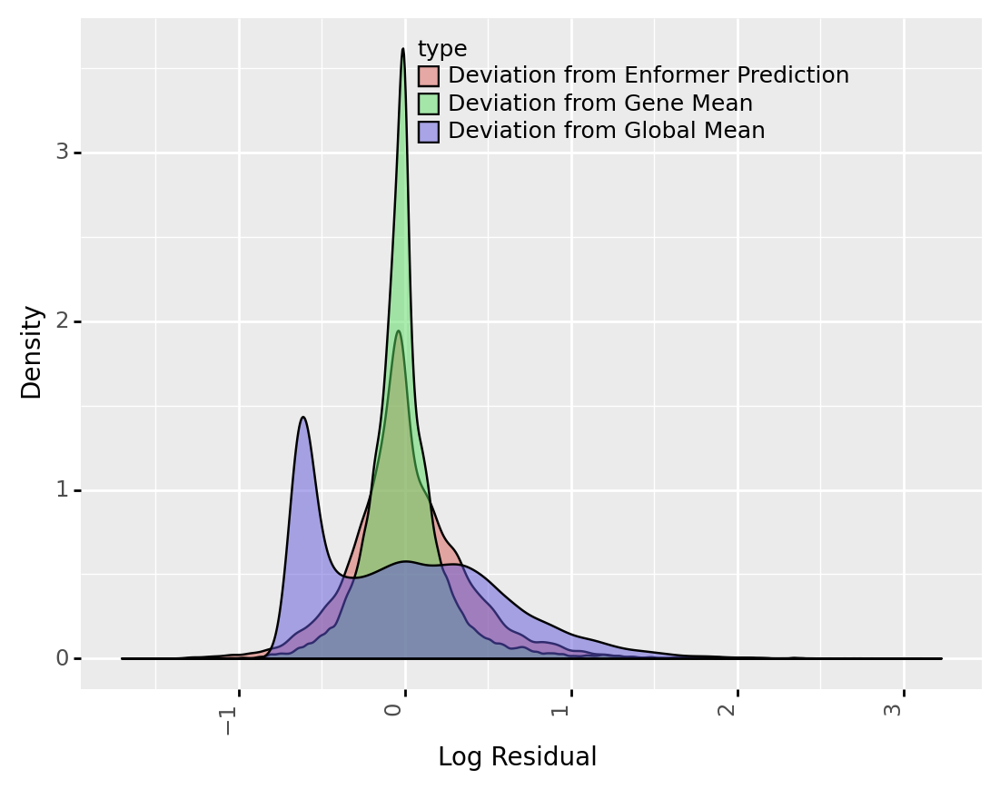

<ggplot: (1417122545469)>

In [147]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

plot_df = (gene_dev_df.sample(frac=0.1,random_state=10)
           [['gene_id','tissue',
             "total","condition",
             "basenji2","enformer"]]
           .melt(id_vars=['gene_id','tissue'],value_name='deviation',var_name='type')
           .query('type != "basenji2"')
          )
plot_df['deviation_log2'] = plot_df['deviation']/np.log10(2)

rename_types = {
    "total":"Deviation from Global Mean",
    "condition":"Deviation from Gene Mean",
    "enformer":"Deviation from Enformer Prediction",
}

plot_df['type'] = plot_df['type'].apply(lambda x: rename_types[x])

p = (p9.ggplot(data=plot_df,mapping=p9.aes(x="deviation",fill="type"))
 #+ p9.geom_col(position="dodge")
 #+ p9.geom_point(size=2.5)
 #+ p9.coords.coord_cartesian(ylim=(0.67,0.85))
 #+ p9.geom_histogram(position="identity", alpha=0.5)
 + p9.geom_density(position="identity", alpha=0.5)
 #+ p9.scale_y_log10()
 + p9.labs(x="Log Residual",y="Density",legend_title="Residual Type")
 + p9.theme(axis_title=p9.element_text(size=10),
           axis_text_x=p9.element_text(rotation=90, hjust=1),
           legend_box_margin=0, legend_key_size=9, 
            legend_text=p9.element_text(size=9),
            legend_background=p9.element_blank(),
            legend_title=p9.element_text(size=9), legend_position=(0.6,0.8))
)
p

#### Prediction of deviation

In [148]:
gene_dev_df['log2_fc'] = gene_dev_df['condition']/np.log10(2)
gene_dev_df['pred_log2_fc'] = (gene_dev_df['log_pred_enformer'] - gene_dev_df['pred_mean_log_expr_enformer'])/np.log10(2)
gene_dev_df['pred_log2_fc_basenji2'] = (gene_dev_df['log_pred_basenji2'] - gene_dev_df['pred_mean_log_expr_basenji2'])/np.log10(2)
gene_dev_df["abs_log2_fc"] = np.abs(gene_dev_df["log2_fc"])
gene_dev_df["abs_pred_log2_fc"] = np.abs(gene_dev_df["pred_log2_fc"])

In [149]:
print(scipy.stats.pearsonr(gene_dev_df['log2_fc'], gene_dev_df['pred_log2_fc_basenji2']))
print(scipy.stats.pearsonr(gene_dev_df['log2_fc'], gene_dev_df['pred_log2_fc']))

(0.5394079318028913, 0.0)
(0.6409965830182043, 0.0)


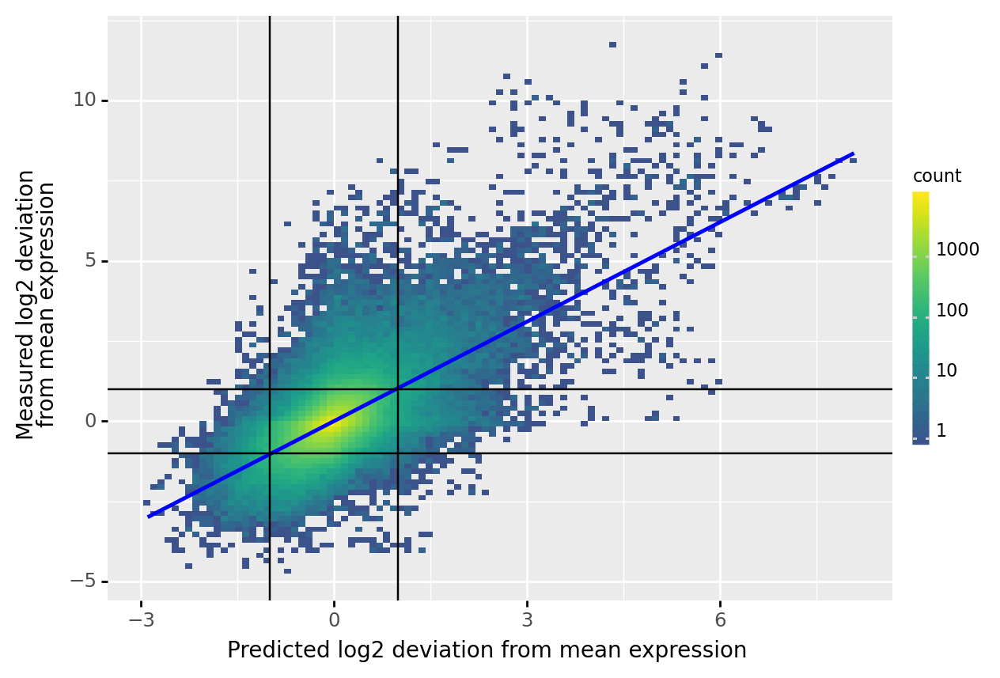

<ggplot: (1417130641908)>

In [150]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=gene_dev_df,mapping=p9.aes(x="pred_log2_fc",y="log2_fc",))
 #+ p9.geom_col(position="dodge")
 + p9.geom_bin2d(bins=100, raster=True)
 + p9.scale_fill_continuous(ListedColormap(cm.get_cmap('viridis', 512)(np.linspace(0.25, 1, 512))), trans="log10")
 + p9.geom_smooth(method="lm",color="blue")
 + p9.geom_vline(xintercept = 1)
 + p9.geom_vline(xintercept = -1)
 + p9.geom_hline(yintercept = 1)
 + p9.geom_hline(yintercept = -1)
 + p9.theme(legend_text=p9.element_text(size=8),legend_title=p9.element_text(size=8),
            legend_box_margin=0,legend_key_width=5,axis_title=p9.element_text(size=10))#
 + p9.labs(x="Predicted log2 deviation from mean expression",y="Measured log2 deviation\nfrom mean expression")
 #+ p9.scale_y_log10()
 #+ p9.labs(x="",y="Density")
)
p

### Performance improvements due to local vs long-range information

In [37]:
tissue_pred_df = (pd.read_csv(base_path_results + "gtex_pred_modelmatched_enformer.tsv", sep="\t")
                  .rename(columns={"log_pred_ingenome":"log_pred_enformer"})
                 )
tissue_pred_df_basenji2 = (pd.read_csv(base_path_results + "gtex_pred_modelmatched_basenji2.tsv", sep="\t")
                          [["gene_id","tissue","log_pred_basenji2"]]
                         )
tissue_pred_df = (tissue_pred_df
                  .merge(tissue_pred_df_basenji2, on=["gene_id", "tissue"])
                  .rename(columns={"tissue":"sample"})
                 )
tissue_pred_df["dataset"] = "GTEx"

In [38]:
kaessmann_pred_df = (pd.read_csv(base_path_results + "kaessmann_pred_modelmatched_enformer.tsv", sep="\t")
                  .rename(columns={"log_pred_ingenome":"log_pred_enformer"})
                 )
kaessmann_pred_df_basenji2 = (pd.read_csv(base_path_results + "kaessmann_pred_modelmatched_basenji2.tsv", sep="\t")
                          [["gene_id","sample","log_pred_basenji2"]]
                         )

kaessmann_pred_df = (kaessmann_pred_df
                  .merge(kaessmann_pred_df_basenji2, on=["gene_id", "sample"])
                 )
kaessmann_pred_df["dataset"] = "Cardoso-Moreira"

In [39]:
pred_df = pd.concat([tissue_pred_df,kaessmann_pred_df])
pred_df = pred_df.query('gene_id in @test_genes')

pred_df_means = (pred_df.groupby(['dataset','gene_id'])
                 .mean()
                 .reset_index()
                 .rename(columns={x:x+"_mean" for x in pred_df.keys() if "log" in x})
                )

pred_df_merged = pred_df.merge(pred_df_means,on=["dataset","gene_id"])

In [40]:
def compute_metrics(tpl, target, dataset, col):
    rmse = sklearn.metrics.mean_squared_error(*tpl,squared=False)
    mae = sklearn.metrics.mean_absolute_error(*tpl)
    r = scipy.stats.pearsonr(*tpl)
    r2 = sklearn.metrics.r2_score(*tpl)
    return ({
        "target":target,
        "dataset":dataset,
        "predictor":col.split("_")[-1],
        "rmse":rmse,
        "mae":mae,
        "r":r[0],
        "r2":r2
    })

rows = []
for dataset in ["GTEx","Cardoso-Moreira"]:
    subset = pred_df_merged.query('dataset == @dataset')
    for col in [k for k in pred_df.keys() if "pred" in k and "null" not in k]:
        tpl = (subset["log_obs"],subset[col]) # total variation
        rows.append(compute_metrics(tpl, "total", dataset, col))
        tpl = (subset["log_obs_mean"],subset[col+"_mean"]) # between gene
        rows.append(compute_metrics(tpl, "between-gene", dataset, col))
        tpl = (subset["log_obs"] - subset["log_obs_mean"],
               subset[col] - subset[col+"_mean"]) # between condition
        rows.append(compute_metrics(tpl, "between-condition", dataset, col))
        
perf_df = pd.DataFrame(rows) 

rows = []
for dataset in ["GTEx","Cardoso-Moreira"]:
    subset = pred_df_merged.query('dataset == @dataset')
    for col in [k for k in pred_df.keys() if "pred" in k and "null" not in k and "enformer" not in k]:
        tpl = (subset["log_pred_enformer"],subset[col]) # total variation
        rows.append(compute_metrics(tpl, "total", dataset, col))
        tpl = (subset["log_pred_enformer_mean"],subset[col+"_mean"]) # between gene
        rows.append(compute_metrics(tpl, "between-gene", dataset, col))
        tpl = (subset["log_pred_enformer"] - subset["log_pred_enformer_mean"],
               subset[col] - subset[col+"_mean"]) # between condition
        rows.append(compute_metrics(tpl, "between-condition", dataset, col))
        
self_corr_df = pd.DataFrame(rows)

In [41]:
perf_df.query('target == "total"')

,target,dataset,predictor,rmse,mae,r,r2
0,total,GTEx,enformer,0.417690,0.307374,0.790683,0.623715
3,total,GTEx,1001,0.522745,0.399436,0.643081,0.410630
6,total,GTEx,3001,0.500799,0.377560,0.679498,0.459077
9,total,GTEx,12501,0.480588,0.358702,0.709991,0.501857
12,total,GTEx,34501,0.448131,0.333287,0.754309,0.566869
15,total,GTEx,39321,0.441495,0.328797,0.762864,0.579603
18,total,GTEx,49153,0.432082,0.322128,0.774382,0.597337
21,total,GTEx,65537,0.423917,0.315108,0.783757,0.612412
24,total,GTEx,98305,0.420049,0.310959,0.788044,0.619453
27,total,GTEx,131073,0.417677,0.308838,0.790805,0.623738


In [42]:
predictor_cats = ['basenji2',#'1001','12501',
                  '39321','49153','65537','98305','enformer']
#pairs = [(x,y) for x, y in zip(predictor_cats[:-1],predictor_cats[1:])]
pairs = [('basenji2',x) for x in predictor_cats[1:]]

perf_df_indexed = perf_df.set_index(['dataset','target','predictor'])
    
rows = []
for dataset in ["GTEx","Cardoso-Moreira"]:
    for target in ["total","between-gene","between-condition"]:
        for pair in pairs:
            delta = (perf_df_indexed.loc[dataset,target,pair[1]] 
                     - perf_df_indexed.loc[dataset,target,pair[0]])
            metrics = {
                "dataset":dataset,
                "target":target,
                "predictor":pair[1]
            }
            for k in delta.keys():
                metrics[k] = delta[k]
            rows.append(metrics)
            
delta_over_basenji2 = pd.DataFrame(rows)

In [46]:
delta_over_basenji2

,dataset,target,predictor,rmse,mae,r,r2
0,GTEx,total,39321,-0.020465,-0.014805,0.027977,0.039877
1,GTEx,total,49153,-0.029877,-0.021473,0.039495,0.057611
2,GTEx,total,65537,-0.038043,-0.028493,0.048870,0.072686
3,GTEx,total,98305,-0.041911,-0.032643,0.053157,0.079727
4,GTEx,total,enformer,-0.044269,-0.036227,0.055796,0.083989
5,GTEx,between-gene,39321,-0.016008,-0.010180,0.022338,0.032375
6,GTEx,between-gene,49153,-0.025841,-0.017408,0.034369,0.051591
7,GTEx,between-gene,65537,-0.033940,-0.024706,0.043540,0.067034
8,GTEx,between-gene,98305,-0.037110,-0.028338,0.046945,0.072985
9,GTEx,between-gene,enformer,-0.039007,-0.032985,0.048983,0.076521


/scratch/tmp/karollus/ipykernel_41404/3366159458.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/scratch/tmp/karollus/ipykernel_41404/3366159458.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/scratch/tmp/karollus/ipykernel_41404/3366159458.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

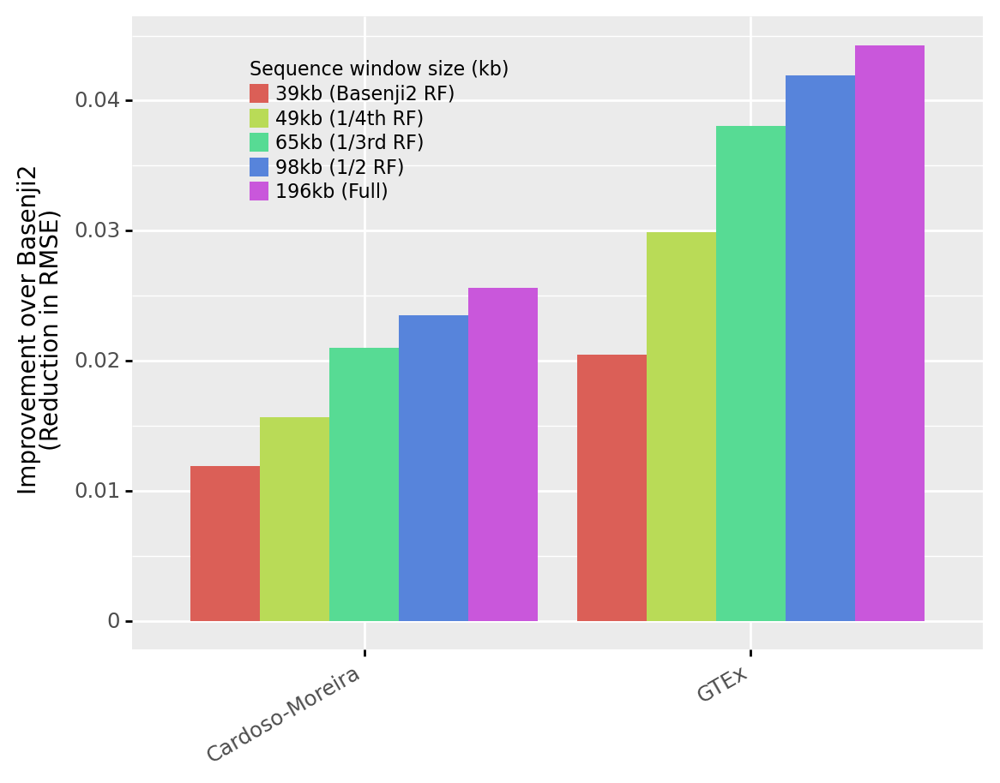

<ggplot: (1410715320339)>

In [43]:
plot_df = delta_over_basenji2.query('target == "total"')

rename_dict = {
    "39321":"39kb (Basenji2 RF)",
    "49153":"49kb (1/4th RF)",
    "65537":"65kb (1/3rd RF)",
    "98305":"98kb (1/2 RF)",
    "enformer": "196kb (Full)"
}
cats = ["39kb (Basenji2 RF)","49kb (1/4th RF)","65kb (1/3rd RF)","98kb (1/2 RF)","196kb (Full)"]
plot_df["predictor"] = plot_df["predictor"].apply(lambda x: rename_dict[x])
plot_df["predictor"] = pd.Categorical(plot_df["predictor"], cats)

plot_df["mae"] = plot_df['mae']*-1
plot_df["rmse"] = plot_df['rmse']*-1

p = (p9.ggplot(data=plot_df
           ,mapping=p9.aes(x="dataset",y="rmse", fill="predictor"))
 + p9.geom_bar(stat="identity",position="dodge")
 + p9.labs(x="",y="Improvement over Basenji2\n(Reduction in RMSE)",fill="Sequence window size (kb)")
 + p9.theme(legend_position=(0.35,0.745), legend_background=p9.element_rect(color="none", size=2, fill='none'),
            legend_text=p9.element_text(size=8),legend_key_size=8,
            legend_title=p9.element_text(size=8),
           axis_text_x=p9.element_text(rotation=30, hjust=1),
           axis_title=p9.element_text(size=10))
)
p

/scratch/tmp/karollus/ipykernel_41404/762472252.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/scratch/tmp/karollus/ipykernel_41404/762472252.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/scratch/tmp/karollus/ipykernel_41404/762472252.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#re

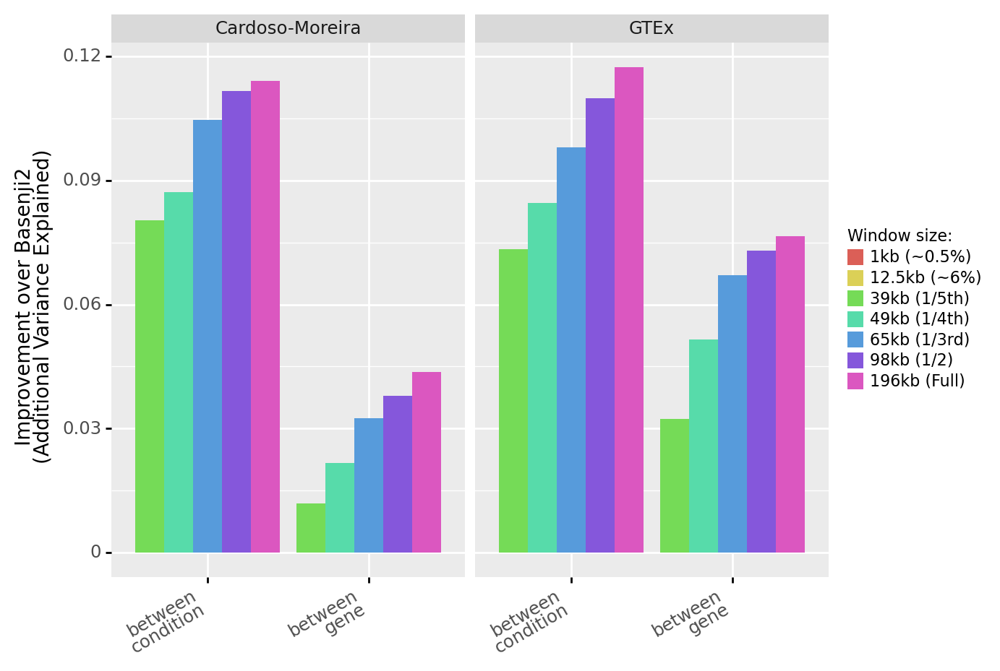

<ggplot: (1410705632892)>

In [44]:
plot_df = delta_over_basenji2.query('target != "total"')

rename_dict = {
    "1001":"1kb (~0.5%)",
    "12501":"12.5kb (~6%)",
    "39321":"39kb (1/5th)",
    "49153":"49kb (1/4th)",
    "65537":"65kb (1/3rd)",
    "98305":"98kb (1/2)",
    "enformer": "196kb (Full)"
}
cats = [x[1] for x in rename_dict.items()]
plot_df["predictor"] = plot_df["predictor"].apply(lambda x: rename_dict[x])
plot_df["predictor"] = pd.Categorical(plot_df["predictor"], cats)

plot_df["target"] = plot_df["target"].apply(lambda x: x.replace("-","\n"))
#plot_df["dataset"] = plot_df["dataset"].apply(lambda x: x.replace("-","\n"))

p = (p9.ggplot(data=plot_df
           ,mapping=p9.aes(x="target",y="r2", fill="predictor"))
 + p9.geom_bar(stat="identity",position="dodge")
 + p9.labs(x="",y="Improvement over Basenji2\n(Additional Variance Explained)",fill="Window size:")
 + p9.theme(#legend_position=(0.35,0.745),
            legend_box_margin=0,
            legend_background=p9.element_rect(color="none", size=2, fill='none'),
            legend_text=p9.element_text(size=8),legend_key_size=8,
            legend_title=p9.element_text(size=8),
           axis_text_x=p9.element_text(rotation=30, hjust=1),
           axis_title=p9.element_text(size=10))
 + p9.facet_wrap('~dataset')
)
p

In [45]:
p.save("Graphics/" + "windows_basenji" + ".svg", width=6.4, height=4.8, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.4 x 4.8 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/windows_basenji.svg


In [158]:
0.45/0.66

0.6818181818181818

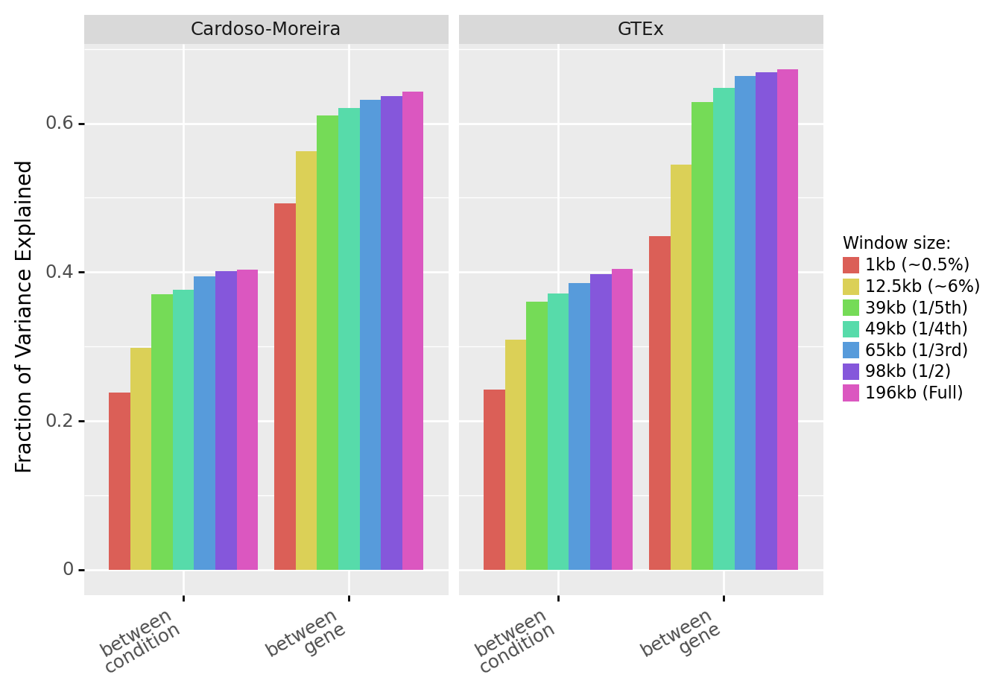

<ggplot: (8756725672732)>

In [656]:
plot_df = perf_df.query('target != "total"')

rename_dict = {
    "1001":"1kb (~0.5%)",
    "12501":"12.5kb (~6%)",
    "39321":"39kb (1/5th)",
    "49153":"49kb (1/4th)",
    "65537":"65kb (1/3rd)",
    "98305":"98kb (1/2)",
    "enformer": "196kb (Full)"
}
cats = [x[1] for x in rename_dict.items()]
plot_df = plot_df.query('predictor in @rename_dict.keys()')
plot_df["predictor"] = plot_df["predictor"].apply(lambda x: rename_dict[x])
plot_df["predictor"] = pd.Categorical(plot_df["predictor"], cats)

plot_df["target"] = plot_df["target"].apply(lambda x: x.replace("-","\n"))

p = (p9.ggplot(data=plot_df
           ,mapping=p9.aes(x="target",y="r2", fill="predictor"))
 + p9.geom_bar(stat="identity",position="dodge")
 + p9.labs(x="",y="Fraction of Variance Explained",
           fill="Window size:")
 + p9.theme(#legend_position=(0.35,0.745), 
            legend_box_margin=0,
            legend_background=p9.element_rect(color="none", size=2, fill='none'),
            legend_text=p9.element_text(size=8),legend_key_size=8,
            legend_title=p9.element_text(size=8),
           axis_text_x=p9.element_text(rotation=30, hjust=1),
           axis_title=p9.element_text(size=10))
 + p9.facet_wrap('~dataset')
)
p

In [657]:
p.save("Graphics/" + "windows_total" + ".svg", width=2.8, height=2.9, dpi=300)

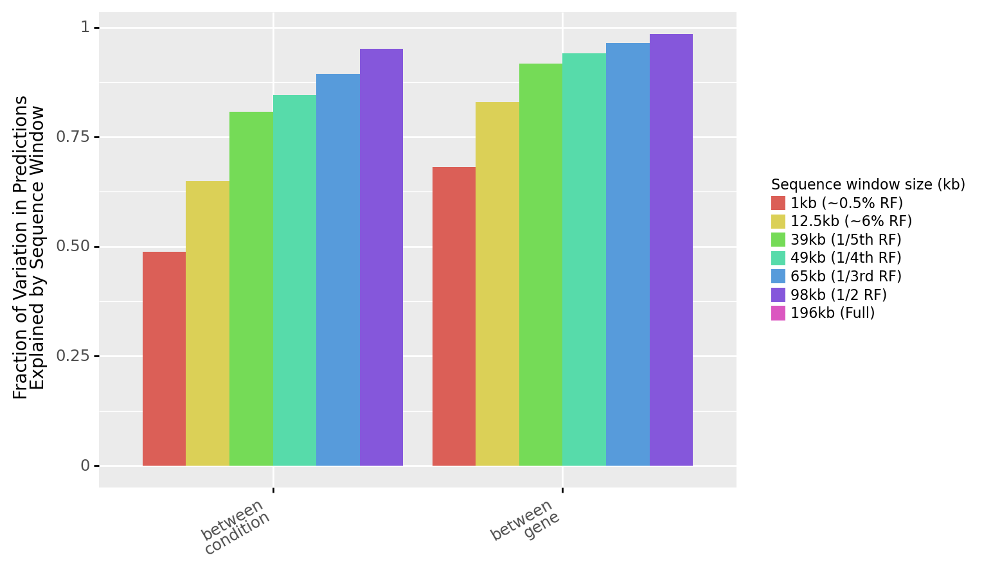

<ggplot: (8756726634837)>

In [628]:
plot_df = self_corr_df.query('target != "total" & dataset == "GTEx"')

rename_dict = {
    "1001":"1kb (~0.5% RF)",
    "12501":"12.5kb (~6% RF)",
    "39321":"39kb (1/5th RF)",
    "49153":"49kb (1/4th RF)",
    "65537":"65kb (1/3rd RF)",
    "98305":"98kb (1/2 RF)",
    "enformer": "196kb (Full)"
}
cats = [x[1] for x in rename_dict.items()]
plot_df = plot_df.query('predictor in @rename_dict.keys()')
plot_df["predictor"] = plot_df["predictor"].apply(lambda x: rename_dict[x])
plot_df["predictor"] = pd.Categorical(plot_df["predictor"], cats)

plot_df["target"] = plot_df["target"].apply(lambda x: x.replace("-","\n"))

p = (p9.ggplot(data=plot_df
           ,mapping=p9.aes(x="target",y="r2", fill="predictor"))
 + p9.geom_bar(stat="identity",position="dodge")
 + p9.labs(x="",y="Fraction of Variation in Predictions\nExplained by Sequence Window",
           fill="Sequence window size (kb)")
 + p9.theme(#legend_position=(0.35,0.745), 
            legend_background=p9.element_rect(color="none", size=2, fill='none'),
            legend_text=p9.element_text(size=8),legend_key_size=8,
            legend_title=p9.element_text(size=8),
           axis_text_x=p9.element_text(rotation=30, hjust=1),
           axis_title=p9.element_text(size=10))
 #+ p9.facet_wrap('~target')
)
p

## Analysis - eQTL

In [20]:
# Check consistency of ordering

with open(base_path_results_gtex_fc  + "gtex_eqtl_at_tss-enformer-latest_results.tsv", 'r') as tsv:
    header = tsv.readline()
    cols = header.split("\t")
cols_1 = [k for k in cols if "CAGE" in k and k.endswith("landmark_sum")]

with open(base_path_results  + "tss_sim_groupby_20_05_2022.tsv", 'r') as tsv:
    header = tsv.readline()
    cols = header.split("\t")
cols_2 = [k for k in cols if "CAGE" in k and k.endswith("landmark_sum")]

assert cols_1 == cols_2

In [21]:
with open(base_path_results_gtex_fc  + "gtex_eqtl_at_tss-enformer-latest_results.tsv", 'r') as tsv:
    header = tsv.readline()
    cols = header.split("\t")
universal_samples = ['Clontech Human Universal Reference Total RNA', 'SABiosciences XpressRef Human Universal Total RNA', 'CAGE:Universal RNA - Human Normal Tissues Biochain']
cage_tracks = [k for k in cols if "CAGE" in k and k.endswith("landmark_sum") and not any(x in k for x in universal_samples)]

metadata_cols = ['chromosome','variant_pos','variant_id','cs_id','tissue','variant_seq','allele']

results = pd.read_csv(base_path_results_gtex_fc  + "gtex_eqtl_at_tss-enformer-latest_results.tsv",sep="\t",
                      #nrows=4000,
                     usecols = metadata_cols + ['offset','orient'] + cage_tracks)

In [22]:
results = (results.groupby(metadata_cols)[cage_tracks].mean().reset_index())

### Prepare

#### Match to tissue

In [23]:
with open(base_path_results + "gtex_enformer_lm_models_pseudocount1.pkl", 'rb') as handle:
    model_dict = pickle.load(handle)

In [24]:
df_list = []

for sample in set(results["tissue"]):
    subset = results.query('tissue == @sample')
    lm_pipe = model_dict[sample]["ingenome"]
    X = np.array(np.log10(subset[cage_tracks] + 1))
    y_pred = lm_pipe.predict(X).reshape(-1)
    subset_pred = subset[metadata_cols].copy()
    subset_pred['log_pred'] = y_pred 
    df_list.append(subset_pred)

eqtl_pred_df = pd.concat(df_list)

In [25]:
eqtl_pred_df.to_csv(base_path_results_gtex_fc + 'modelmatched_preds.tsv',sep="\t",index=None)

#### Compute fold changes

In [26]:
eqtl_pred_df = pd.read_csv(base_path_results_gtex_fc + 'modelmatched_preds.tsv',sep="\t")

In [27]:
eqtl_pred_ref = eqtl_pred_df.query('allele == "ref"').drop(columns="allele")
eqtl_pred_alt = eqtl_pred_df.query('allele == "alt"').drop(columns="allele")

eqtl_pred_merged = eqtl_pred_ref.merge(eqtl_pred_alt,on=["chromosome","variant_pos","variant_id","cs_id","tissue"],suffixes=["_ref","_alt"])

In [28]:
eqtl_pred_merged["log2_fc"] = (eqtl_pred_merged["log_pred_alt"] - eqtl_pred_merged["log_pred_ref"])/np.log10(2)
eqtl_pred_merged["abs_log2_fc"] = np.abs(eqtl_pred_merged["log2_fc"])
eqtl_pred_merged["pct_change"] = (2**eqtl_pred_merged["log2_fc"] - 1)*100
eqtl_pred_merged["abs_pct_change"] = np.abs(eqtl_pred_merged["pct_change"])

#### Merge with metadata

In [29]:
susie_df_small_blocks = pd.read_csv(base_path_data_gtex_fc + "susie_df_small_blocks.tsv",sep="\t")
susie_df_small_blocks["chromosome"] = "chr" + susie_df_small_blocks["chromosome"] 
#susie_df_small_blocks = susie_df_small_blocks.melt([k for k in susie_df_small_blocks.keys() if k not in ["ref","alt"]],value_name="variant_seq",var_name="allele")

In [30]:
susie_df_merged = eqtl_pred_merged.merge(susie_df_small_blocks.drop(columns=['chromosome', 'position', 'ref', 'alt']),
                                         on=["variant_id","cs_id","tissue"])

#### Resolve blocks

For each credible set, we determine the maximal effect

In [31]:
max_effects =(susie_df_merged.groupby(['gene_id','cs_id','tissue'])
              [["log2_fc","abs_log2_fc", "abs_pct_change", 'abs_tss_distance_min','abs_tss_distance_mean']]
              .max().reset_index().sort_values('abs_log2_fc'))

In [32]:
susie_df_max_merged = susie_df_merged.merge((max_effects[['gene_id','cs_id','tissue',"abs_pct_change"]]
                                          .rename(columns={"abs_pct_change":"max_abs_pct_change"})),
                                           on=['gene_id','cs_id','tissue'])

### Maximal effect by block

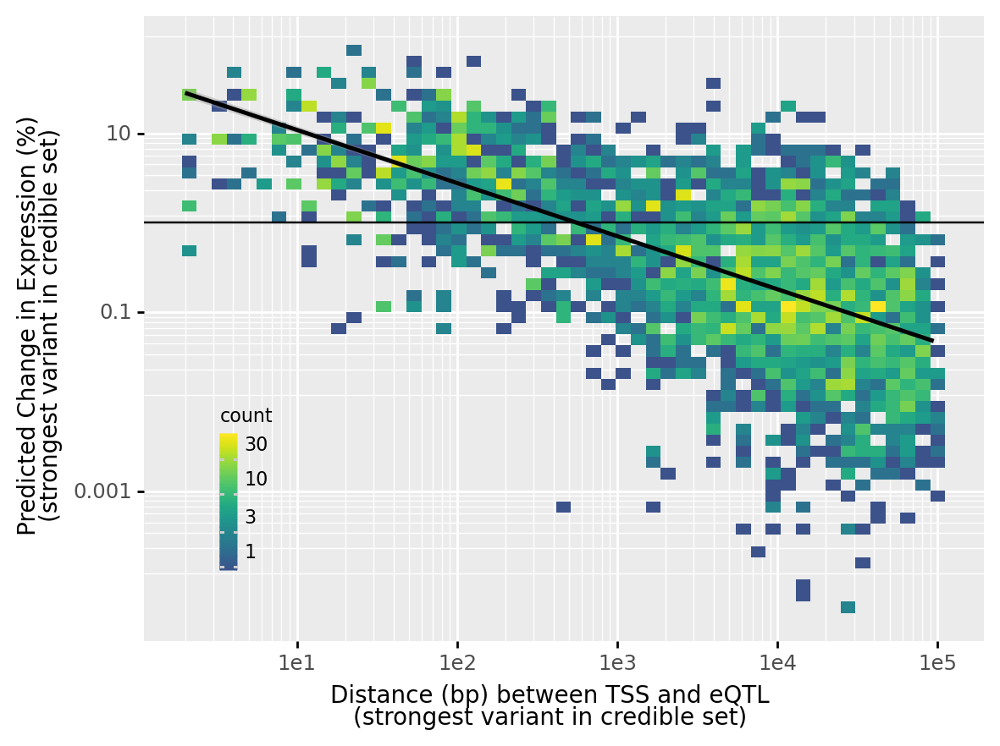

<ggplot: (1405540796236)>

In [33]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=susie_df_max_merged.query('abs_pct_change == max_abs_pct_change'),
               mapping=p9.aes(x="abs_tss_distance",y="abs_pct_change"))
 #+ p9.geom_point(size=0.5)
+ p9.geom_bin2d(bins=50, raster=True)
 + p9.scale_fill_continuous(ListedColormap(cm.get_cmap('viridis', 512)(np.linspace(0.25, 1, 512))), trans="log10")
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 + p9.geom_hline(yintercept=1)
 + p9.geom_smooth(method="lm")
 + p9.labs(x="Distance (bp) between TSS and eQTL\n(strongest variant in credible set)",
           y="Predicted Change in Expression (%)\n(strongest variant in credible set)")
 + p9.theme(legend_key_size=8,
            legend_title=p9.element_text(size=8),
            legend_text=p9.element_text(size=8),
            legend_box_margin=0,legend_key_width=5,
            legend_position=(0.22,0.3),
            legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10))
)
p

In [34]:
p.save("Graphics/" + "distal_eQTL_pred" + ".svg", width=2.7, height=2.9, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 2.7 x 2.9 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/distal_eQTL_pred.svg


In [35]:
max_effects["abs_pct_change"].median()

0.4273405149163523

In [36]:
susie_df_max_merged.query('abs_pct_change == max_abs_pct_change').query('abs_tss_distance > 10_000')["abs_pct_change"].median()

0.10923564633567029

In [37]:
one_over_dist_df = susie_df_max_merged.query('abs_pct_change == max_abs_pct_change')

one_over_dist_df["log_dist"] = np.log10(one_over_dist_df["abs_tss_distance"])
one_over_dist_df["log_pct"] = np.log10(one_over_dist_df["abs_pct_change"])

ols_1_over_dist = (statsmodels.regression.linear_model.OLS
                  .from_formula('log_pct ~ log_dist',
                                data=(one_over_dist_df))
                  )
res_ols_1_over_dist = ols_1_over_dist.fit()

res_ols_1_over_dist.summary()

/scratch/tmp/karollus/ipykernel_786964/3948140012.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/scratch/tmp/karollus/ipykernel_786964/3948140012.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                log_pct   R-squared:                       0.484
Model:                            OLS   Adj. R-squared:                  0.484
Method:                 Least Squares   F-statistic:                     5764.
Date:                Sat, 10 Sep 2022   Prob (F-statistic):               0.00
Time:                        17:57:48   Log-Likelihood:                -6464.3
No. Observations:                6141   AIC:                         1.293e+04
Df Residuals:                    6139   BIC:                         1.295e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      1.6316      0.028     58.064      0.000       1.577       1.687
log_dist      -0.5936      0.008    -75.918      0.000      -0.609      -0.578
==============================================================================
Omnibus:                      232.785   Durbin-Watson:                   1.948
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              319.109
Skew:                          -0.390   Prob(JB):                     5.09e-70
Kurtosis:                       3.799   Cond. No.                         12.2
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

### Distribution over distance

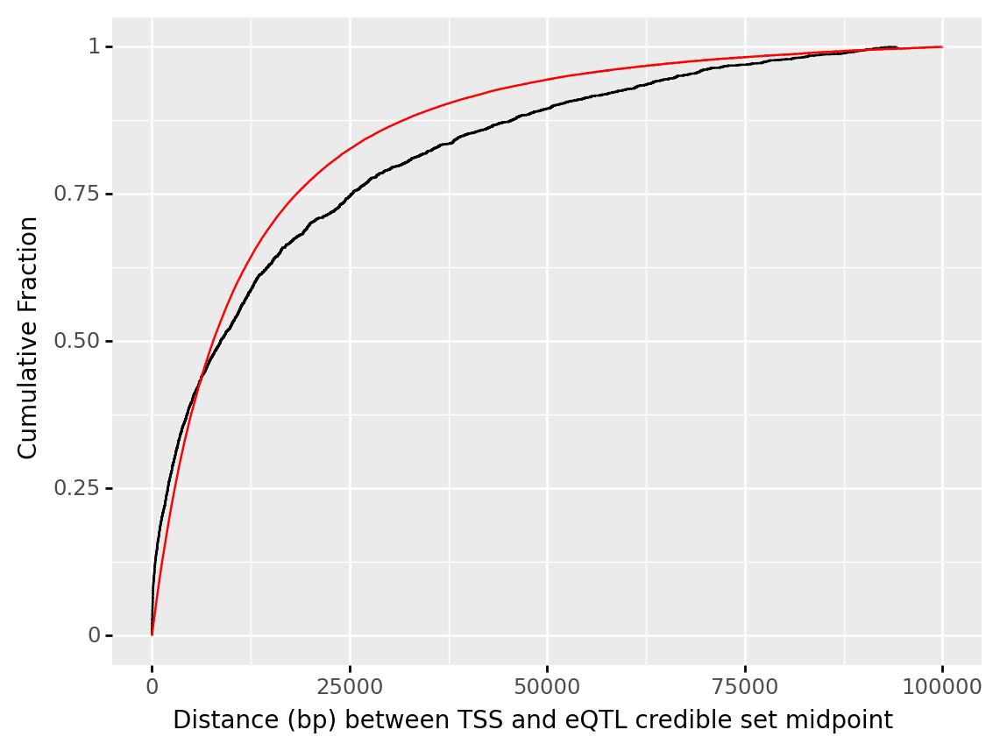

<ggplot: (1405540871211)>

In [39]:
#sample = scipy.stats.pareto.rvs(b=1.0, loc=-5000, scale=6000, size=100_000)
sample = scipy.stats.pareto.rvs(1.8423501778362956, -17829.909798770816, 17831.90979877046, size=100_000)

p = (p9.ggplot(data=max_effects[["abs_tss_distance_mean","gene_id"]].drop_duplicates()
               ,mapping=p9.aes(x="abs_tss_distance_mean"))
 #+ p9.geom_point(size=0.5)
 #+ p9.scale_x_log10()
 + p9.stat_ecdf()
 + p9.stat_ecdf(data=pd.DataFrame({"abs_tss_distance_mean":sample}).query("abs_tss_distance_mean < 100_000"),
                color="red")
 #+ p9.geom_vline(xintercept=10_000)
 #+ p9.geom_hline(yintercept=0.8)
 + p9.labs(x="Distance (bp) between TSS and eQTL credible set midpoint",
           y="Cumulative Fraction")
 + p9.theme(legend_key_size=8,
            legend_title=p9.element_text(size=8),
            legend_text=p9.element_text(size=8),
            legend_box_margin=0,legend_key_width=5,
            #legend_position=(0.29,0.2),
            legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10))
)
p

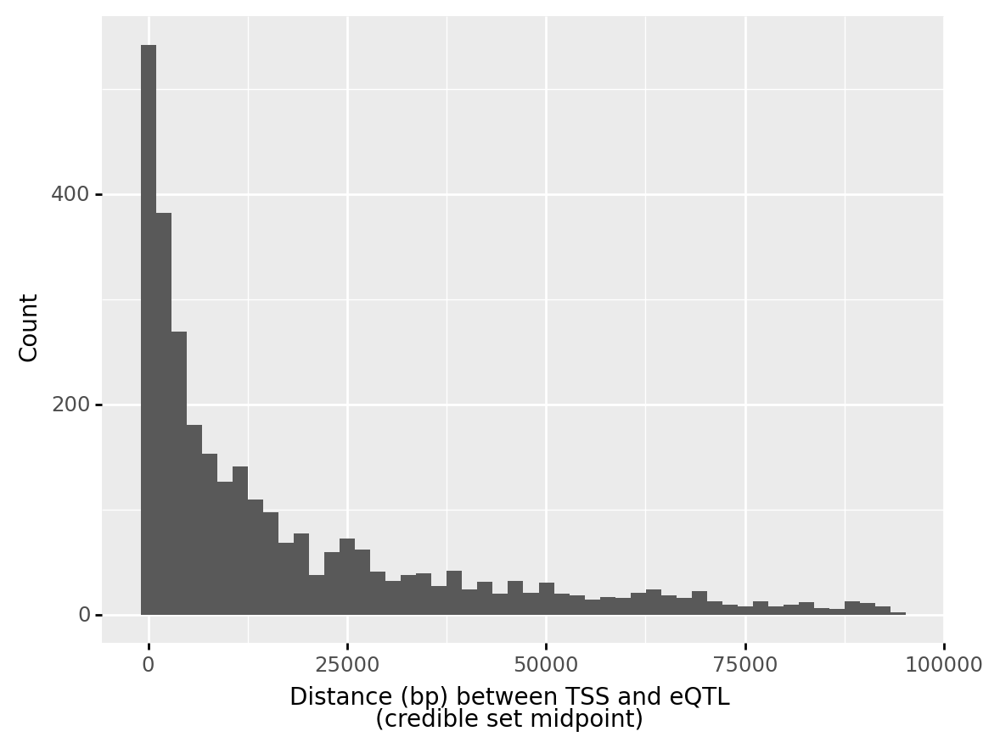

<ggplot: (1405541408034)>

In [42]:
#a = 1658070#2_000_000
#exp_line = pd.DataFrame({"x":np.linspace(1000,100_000),
#                         "y":a*(1/(np.linspace(1000,100_000)))})

p = (p9.ggplot(data=max_effects[["abs_tss_distance_mean","gene_id"]].drop_duplicates()
               ,mapping=p9.aes(x="abs_tss_distance_mean"))
 #+ p9.geom_point(size=0.5)
 #+ p9.scale_x_log10()
 + p9.geom_histogram(bins=50)#binwidth=2000)
 #+ p9.scale_y_log10()
 #+ p9.geom_line(data=exp_line,
 #                mapping=p9.aes(x="x",y="y"),
 #            color="blue")
 + p9.labs(x="Distance (bp) between TSS and eQTL\n(credible set midpoint)",
           y="Count")
 + p9.theme(legend_key_size=8,
            legend_title=p9.element_text(size=8),
            legend_text=p9.element_text(size=8),
            legend_box_margin=0,legend_key_width=5,
            #legend_position=(0.29,0.2),
            legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10))
)
p

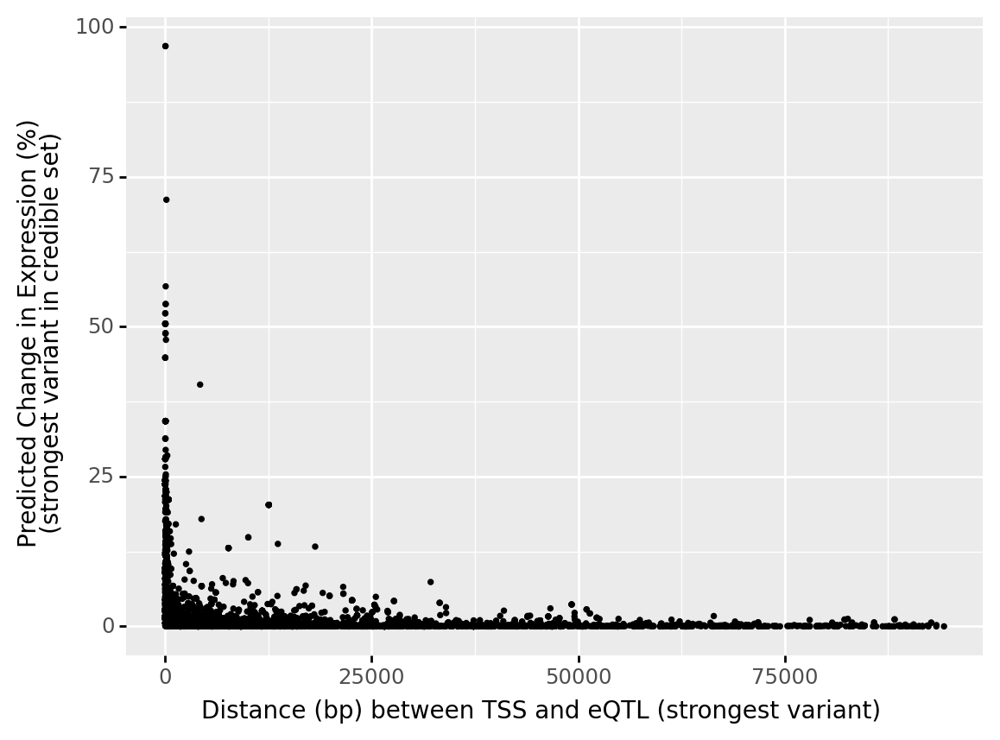

<ggplot: (1440160043761)>

In [94]:
a = 10**(1.6316)#2_000_000
k = 0.6
exp_line = pd.DataFrame({"x":np.linspace(0.25,100_000,10000),
                         "y":a*(1/(np.linspace(0.25,100_000,10000)**k))})

p = (p9.ggplot(data=susie_df_max_merged.query('abs_pct_change == max_abs_pct_change'),
               mapping=p9.aes(x="abs_tss_distance", y="abs_pct_change"))
 + p9.geom_point(size=0.5, color="black")
 #+ p9.scale_x_log10()
 #+ p9.geom_histogram(bins=50)#binwidth=2000)
 #+ p9.scale_y_log10()
 #+ p9.geom_line(data=exp_line,
 #                mapping=p9.aes(x="x",y="y"),
 #            color="blue")
 + p9.labs(x="Distance (bp) between TSS and eQTL (strongest variant)",
           y="Predicted Change in Expression (%)\n(strongest variant in credible set)")
 #+ p9.geom_line(data=exp_line,
 #                mapping=p9.aes(x="x",y="y"),
 #            color="blue")
 + p9.theme(legend_key_size=8,
            legend_title=p9.element_text(size=8),
            legend_text=p9.element_text(size=8),
            legend_box_margin=0,legend_key_width=5,
            #legend_position=(0.29,0.2),
            legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10))
)
p

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/pandas/core/arraylike.py:364: RuntimeWarning: divide by zero encountered in log10
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/layer.py:401: PlotnineWarning: geom_histogram : Removed 2 rows containing missing values.


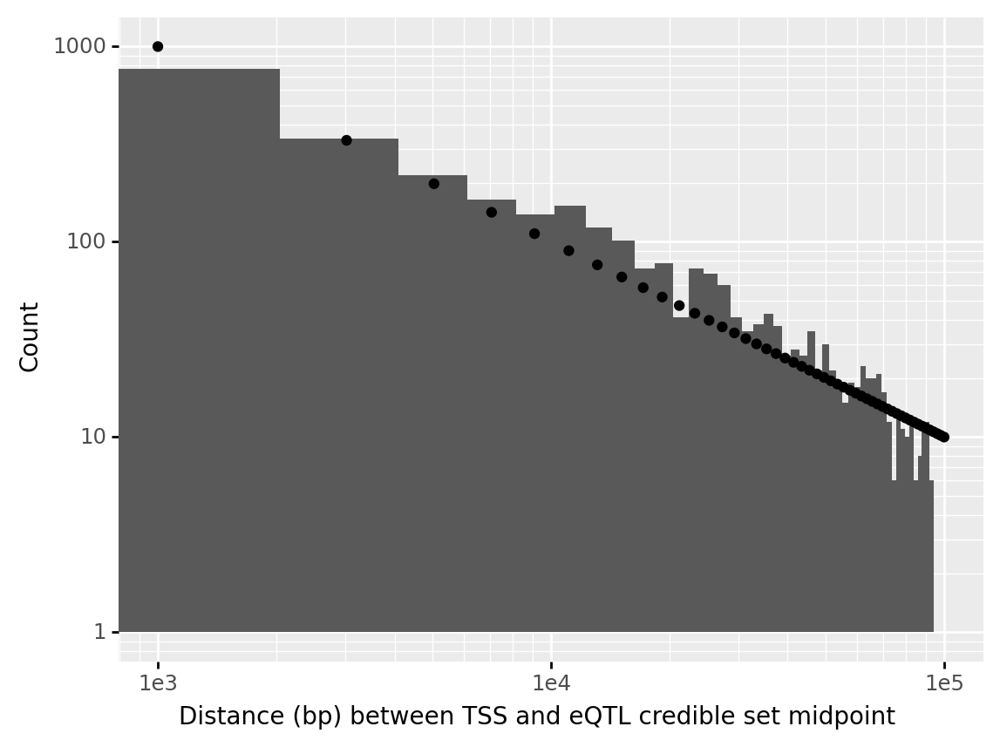

<ggplot: (1405541034135)>

In [43]:
a = 1000000#2_000_000
exp_line = pd.DataFrame({"x":np.linspace(1000,100_000),
                         "y":a*(1/(np.linspace(1000,100_000)))})

p = (p9.ggplot(data=max_effects[["abs_tss_distance_mean","gene_id"]].drop_duplicates()
               ,mapping=p9.aes(x="abs_tss_distance_mean"))
 #+ p9.geom_point(size=0.5)
 + p9.scale_x_log10()
 + p9.geom_histogram(breaks=np.linspace(1,100_000))#binwidth=2000)
 + p9.scale_y_log10()
 + p9.coords.coord_cartesian(xlim=(3,5))
 + p9.geom_point(data=exp_line,
                 mapping=p9.aes(x="x",y="y"))
 + p9.labs(x="Distance (bp) between TSS and eQTL credible set midpoint",
           y="Count")
 + p9.theme(legend_key_size=8,
            legend_title=p9.element_text(size=8),
            legend_text=p9.element_text(size=8),
            legend_box_margin=0,legend_key_width=5,
            #legend_position=(0.29,0.2),
            legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10))
)
p

### Normalized Effect size over distance

In [44]:
effect_by_dist = pd.read_csv(base_path_data_gtex_fc + "effect_by_dist.tsv",sep="\t")

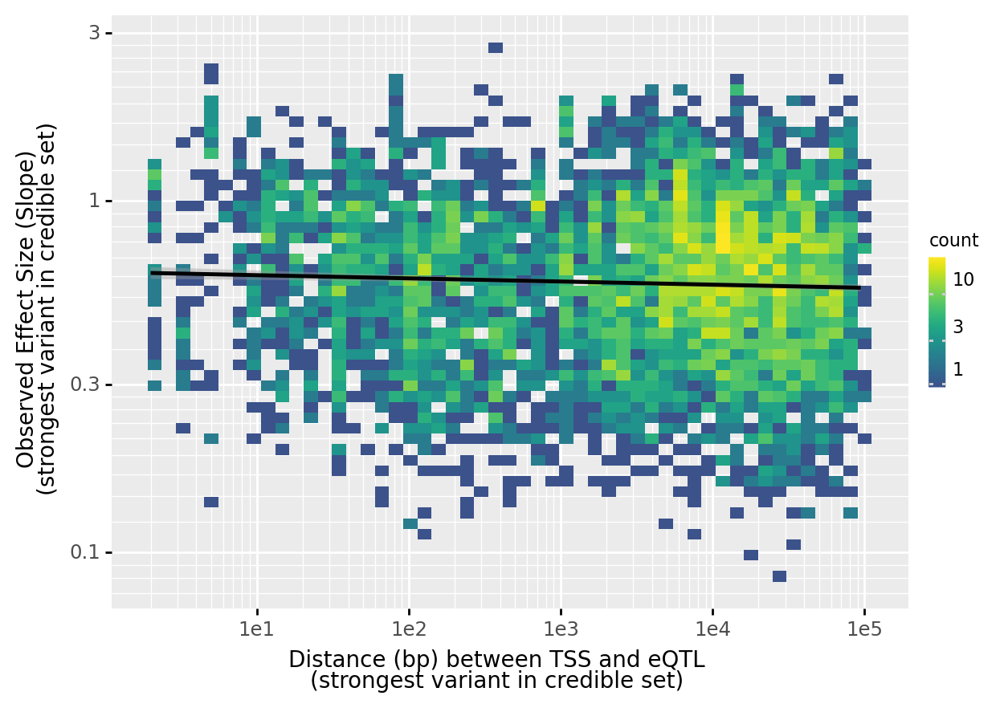

<ggplot: (1405541291352)>

In [45]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p=(p9.ggplot(data=effect_by_dist,mapping=p9.aes(x="abs_tss_distance_min",y="max_slope")) 
 #+ p9.geom_point(alpha=0.2)
 + p9.geom_bin2d(bins=50, raster=True)
 + p9.scale_fill_continuous(ListedColormap(cm.get_cmap('viridis', 512)(np.linspace(0.25, 1, 512))), trans="log10")
 + p9.scale_x_log10()
 + p9.scale_y_log10()
 + p9.geom_smooth(method="lm")
 + p9.labs(x="Distance (bp) between TSS and eQTL\n(strongest variant in credible set)",y="Observed Effect Size (Slope)\n(strongest variant in credible set)")
 + p9.theme(legend_key_size=8,
            legend_title=p9.element_text(size=8),
            legend_text=p9.element_text(size=8),
            legend_box_margin=0,legend_key_width=5,
            #legend_position=(0.22,0.3),
            legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10))
)
p

In [46]:
p.save("Graphics/" + "distal_eQTL_obs" + ".svg", width=2.7, height=2.9, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 2.7 x 2.9 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/distal_eQTL_obs.svg


### Which eQTL are seen in training

In [47]:
valid_eqtl = susie_df_max_merged.query('abs_pct_change == max_abs_pct_change')
valid_eqtl["tss_id"] = valid_eqtl["chromosome"] + valid_eqtl["tss"].astype('str')
valid_eqtl["tss_start"] = valid_eqtl["tss"]
valid_eqtl["tss_end"] = valid_eqtl["tss"] + 1
valid_eqtl["var_start"] = valid_eqtl['variant_pos'] - 1

/scratch/tmp/karollus/ipykernel_786964/2214173313.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/scratch/tmp/karollus/ipykernel_786964/2214173313.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/scratch/tmp/karollus/ipykernel_786964/2214173313.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

In [48]:
train_regions = (pd.read_csv(base_path_data + "human_regions.bed", names=["Chromosome","Start","End","set"], sep="\t")
                            .query('set == "train"')
                            .drop(columns="set"))
train_regions["id"] = train_regions["Chromosome"] + train_regions["Start"].astype('str') + train_regions["End"].astype('str')

train_regions_wide = train_regions.copy()
train_regions_wide["Start"] = train_regions_wide["Start"] - (SEEN_SEQUENCE_LENGTH - 131072)/2
train_regions_wide["End"] = train_regions_wide["End"] + (SEEN_SEQUENCE_LENGTH - 131072)/2
train_regions_wide = pr.PyRanges(train_regions_wide)

train_regions_predict = train_regions.copy()
train_regions_predict["Start"] = train_regions_predict["Start"] + (131072 - 896*128)/2
train_regions_predict["End"] = train_regions_predict["End"] - (131072 - 896*128)/2
train_regions_predict = pr.PyRanges(train_regions_predict)

In [49]:
tss_sites = pr.PyRanges(valid_eqtl[['chromosome', 'tss_start', 'tss_end','tss_id']]
                         .rename(columns={'chromosome':'Chromosome',
                                         "tss_start":"Start",
                                         "tss_end":"End"})
                        .drop_duplicates()
                       )

eqtl_sites = pr.PyRanges(valid_eqtl[['chromosome', 'variant_pos','var_start','variant_id','tss_id']]
                         .rename(columns={'chromosome':'Chromosome',
                                         "var_start":"Start",
                                         "variant_pos":"End"})
                        .drop_duplicates()
                       )

In [50]:
tss_in_train = train_regions_predict.join(tss_sites, suffix="_tss").df
eqtl_in_train = train_regions_wide.join(eqtl_sites, suffix="_eqtl").df

In [51]:
both_in_train = tss_in_train.merge(eqtl_in_train.drop(columns="Chromosome"),suffixes=("_predicted_region","_seen_region"), on=["tss_id","id"])

In [52]:
#seen_pairs = both_in_train[["tss_mid","enhancer_mid","id"]].drop_duplicates().merge(valid_enhancers, on=["tss_mid","enhancer_mid"])
valid_eqtl_seen = (tss_in_train.groupby("tss_id")
                      .size().reset_index()
                      .rename(columns={0:"tss_seen_count"})
                      .merge(valid_eqtl, on=["tss_id"]))
valid_eqtl_seen = (both_in_train.groupby(['variant_id','tss_id'])
                      .size().reset_index()
                      .rename(columns={0:"eqtl_seen_count"})
                      .merge(valid_eqtl_seen, on=['variant_id','tss_id'],how="right"))

valid_eqtl_seen = (valid_eqtl_seen.groupby('tss_id')
                        .size().reset_index().rename(columns={0:"total_eqtl"})
                        .merge(valid_eqtl_seen, on=["tss_id"])
                       )

valid_eqtl_seen['fully_seen'] = (valid_eqtl_seen['eqtl_seen_count'] == valid_eqtl_seen['tss_seen_count'])

valid_eqtl_seen = (valid_eqtl_seen.groupby('tss_id')['fully_seen']
                        .sum().reset_index().rename(columns={'fully_seen':"fully_seen_eqtl"})
                        .merge(valid_eqtl_seen, on=["tss_id"])
                       )

In [53]:
# for tss, which are seen
# check for difference between enhancers which are seen fully and those which are not
seen_twice = valid_eqtl_seen.query('tss_seen_count > 0')

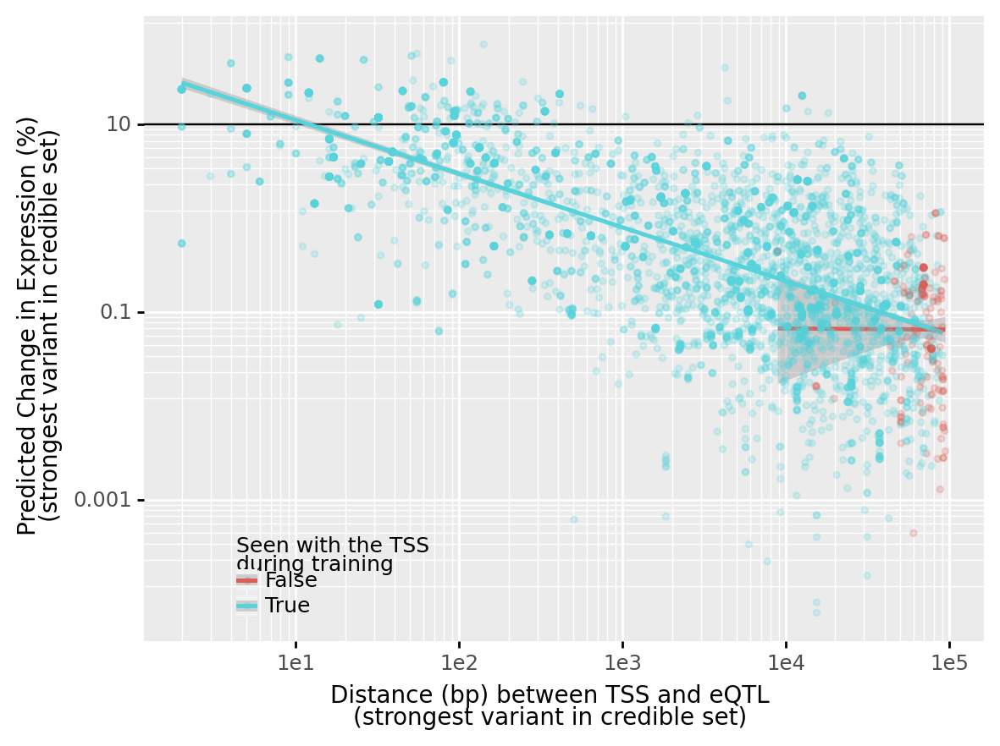

<ggplot: (1405543433698)>

In [54]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

p = (p9.ggplot(data=seen_twice
           ,mapping=p9.aes(x="abs_tss_distance",y="abs_pct_change",color="fully_seen"))
 + p9.scale_y_log10()
 + p9.scale_x_log10()
 + p9.geom_hline(yintercept=10)
 + p9.geom_smooth(method="lm")#,color="black")
 + p9.geom_point(size=1,alpha=0.2)
 + p9.labs(x="Distance (bp) between TSS and eQTL\n(strongest variant in credible set)",
           y="Predicted Change in Expression (%)\n(strongest variant in credible set)", 
           color="Seen with the TSS\nduring training")
 #+ p9.facet_wrap("~fully_seen")
 + p9.theme(legend_key_size=9,legend_text=p9.element_text(size=9),
            legend_title=p9.element_text(size=9),
            legend_position=(0.3,0.2),legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10)
           )
)
p

### Distribution of encode CRE 

In [55]:
cres = pr.read_bed(base_path_data_gtex_fc + "GRCh38-cCREs.bed")

gene_regions = (susie_df_small_blocks[["chromosome","tss","gene_id","Strand"]]
                .rename(columns={"chromosome":"Chromosome"})
                .drop_duplicates()
               )
gene_regions["Start"] = gene_regions["tss"] - 95_000
gene_regions["End"] = gene_regions["tss"] + 95_000
gene_regions = pr.PyRanges(gene_regions)

gene_cre_df = gene_regions.join(cres,suffix="_cre",strandedness=False).df.rename(columns={"Strand_cre":"cre_type"})

In [56]:
gene_cre_df["is_enhancer"] = gene_cre_df["cre_type"].apply(lambda x: True if "ELS" in x else False).astype('bool')
gene_cre_df["is_promoter"] = gene_cre_df["cre_type"].apply(lambda x: True if "PLS" in x else False).astype('bool')

In [57]:
gene_cre_df["Strand"] = gene_cre_df["Strand"].astype("int")
gene_cre_df["cre_mid"] = ((gene_cre_df["Start_cre"] + gene_cre_df["End_cre"])/2)
gene_cre_df["tss_distance_mean"] = gene_cre_df["cre_mid"] - gene_cre_df["tss"]
gene_cre_df["abs_tss_distance_mean"] = np.abs(gene_cre_df["cre_mid"] - gene_cre_df["tss"])
gene_cre_df["tss_distance_left"] = gene_cre_df["Start_cre"] - gene_cre_df["tss"]
gene_cre_df["tss_distance_right"] = gene_cre_df["End_cre"] - gene_cre_df["tss"]
gene_cre_df["sign_tss_distance_mean"] = np.sign(gene_cre_df["tss_distance_mean"])
gene_cre_df["sign_tss_distance_left"] = np.sign(gene_cre_df["tss_distance_left"])
gene_cre_df["sign_tss_distance_right"] = np.sign(gene_cre_df["tss_distance_right"])
# once again, only consider downstream elements
# throw out blocks which are 3' of the canonical TSS
# if tss_distance > 0, then ==TSS===CRE==
# so if strand = 1, we want TSS distance to be negative: ==CRE==TSS[CDS]
# else, if strand = -1, we want TSS distance to be positive: [CDS]TSS==CRE==
# we also exclude blocks with inconsistent sign (i.e. blocks which span the TSS)
gene_cre_df = gene_cre_df.query('Strand != sign_tss_distance_mean & sign_tss_distance_left == sign_tss_distance_right')

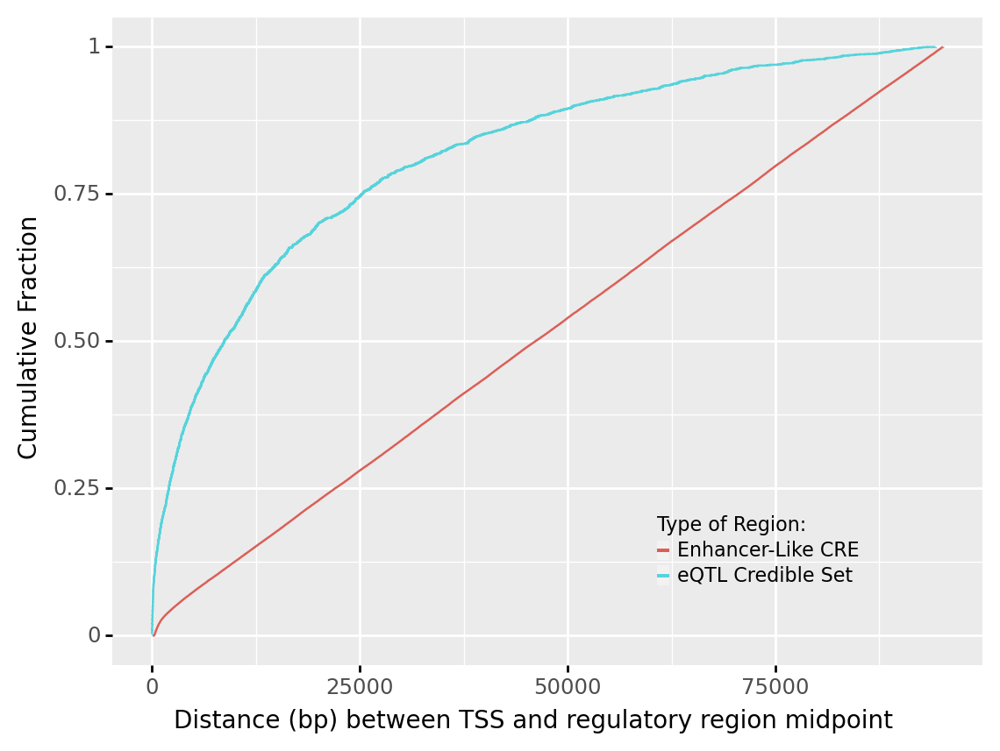

<ggplot: (1405542990270)>

In [58]:
# combine with eQTL plot
eqtl_dist_distbn = max_effects[["abs_tss_distance_mean","gene_id"]].drop_duplicates()
eqtl_dist_distbn["region_type"] = "eQTL Credible Set"
gene_dist_distbn = (gene_cre_df
                    .query('is_enhancer')
                    [["gene_id","abs_tss_distance_mean","cre_mid"]]
                    .drop_duplicates()[["abs_tss_distance_mean","gene_id"]])
gene_dist_distbn["region_type"] = "Enhancer-Like CRE"
dist_distbn = pd.concat([eqtl_dist_distbn,gene_dist_distbn])

p = (p9.ggplot(data=dist_distbn,mapping=p9.aes(x="abs_tss_distance_mean",color="region_type"))
 + p9.stat_ecdf()
 #+ p9.scale_x_log10()
 + p9.labs(x="Distance (bp) between TSS and regulatory region midpoint",
           y="Cumulative Fraction",color="Type of Region:")
 + p9.theme(legend_key_size=8,
            legend_title=p9.element_text(size=8),
            legend_text=p9.element_text(size=8),
            legend_box_margin=0,legend_key_width=5,
            legend_position=(0.7,0.25),
            legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10))
)
p

In [59]:
missing_genes = {"ADSS2":'ADSS',
                 "ADSS1":'ADSSL1',
                 "ZFTA":'C11orf95',
                 "RUSF1":'C16orf58',
                 "HROB":'C17orf53',
                 "BRME1":'C19orf57',
                 "MIR9-1HG":'C1orf61',
                 "DNAAF9":'C20orf194',
                 "BBLN":'C9orf16',
                 "CARS1":'CARS',
                 "YJU2B":'CCDC130',
                 "MIX23":'CCDC58',
                 "UVSSA":'CRIPAK', #same strand
                 "EOLA2":'CXorf40B',
                 "PABIR1":'FAM122A',
                 "NALF1":'FAM155A',
                 "SLX9":'FAM207A', #same strand
                 "CYRIA":'FAM49A',
                 "CYRIB":'FAM49B',
                 "CEP43":'FGFR1OP',
                 "CEP20":'FOPNL',
                 "H1-10":'H1FX',
                 "H2AZ2":'H2AFV',
                 "MACROH2A1":'H2AFY',
                 "H3-3A":'H3F3A',
                 "HARS1":'HARS',
                 "H1-5":'HIST1H1B',
                 "H1-2":'HIST1H1C',
                 "H1-3":'HIST1H1D',
                 "H1-4":'HIST1H1E',
                 "H2AC11":'HIST1H2AG',
                 "H2AC13":'HIST1H2AI',
                 "H2BC4":'HIST1H2BC',
                 "H2BC5":'HIST1H2BD',
                 "H2BC7":'HIST1H2BF',
                 "H2BC8":'HIST1H2BG',
                 "H2BC11":'HIST1H2BJ',
                 "H2BC12":'HIST1H2BK',
                 "H2BC13":'HIST1H2BL',
                 "H2BC15":'HIST1H2BN',
                 "H3C4":'HIST1H3D',
                 "H4C2":'HIST1H4B',
                 "H4C3":'HIST1H4C',
                 "H4C8":'HIST1H4H',
                 "H4C11":'HIST1H4J',
                 "H2AW":'HIST3H2A',
                 "IARS1":'IARS',
                 "GARRE1":'KIAA0355',
                 "ELAPOR1":'KIAA1324',
                 "ELAPOR2":'KIAA1324L',
                 "MARCHF6":'MARCH6',
                 "MARCHF9":'MARCH9',
                 "PPP5D1P":'PPP5D1',
                 "QARS1":'QARS',
                 "METTL25B":'RRNAD1',
                 "TARS3":'TARSL2',
                 "DYNLT2B":'TCTEX1D2',
                 "STING1":'TMEM173',
                 "PEDS1":'TMEM189',
                 "DYNC2I1":'WDR60',
                 "DNAAF10":'WDR92',
                 "POLR1H":'ZNRD1'}

gene_locs = gtf_df.df.query('Feature == "gene"')[["Chromosome","Start","End","Score","Strand","Frame","gene_id","gene_name"]]
gene_locs["gene"] = gene_locs["gene_name"].apply(lambda x: missing_genes[x] if x in missing_genes else x) 

ziga_df = pd.read_csv(base_path_data_fulco + "ziga_additional_columns.tsv",sep="\t")
ziga_df = (ziga_df.merge(gene_locs[["Strand","gene", "gene_id"]].drop_duplicates(),on="gene"))
ziga_df["gene_id"] = ziga_df["gene_id"].apply(lambda x: x.split('.')[0])
ziga_df["region_type"] = ziga_df["validated"].apply(lambda x: "Valid Enhancer" if x else "Non-valid Enhancer")

In [60]:
dist_distbn_all = pd.concat([dist_distbn,
                             (ziga_df[["actual_tss_distance","gene_id","region_type"]]
                              .rename(columns={"actual_tss_distance":"abs_tss_distance_mean"})
                             .query('abs_tss_distance_mean < 95_000'))])

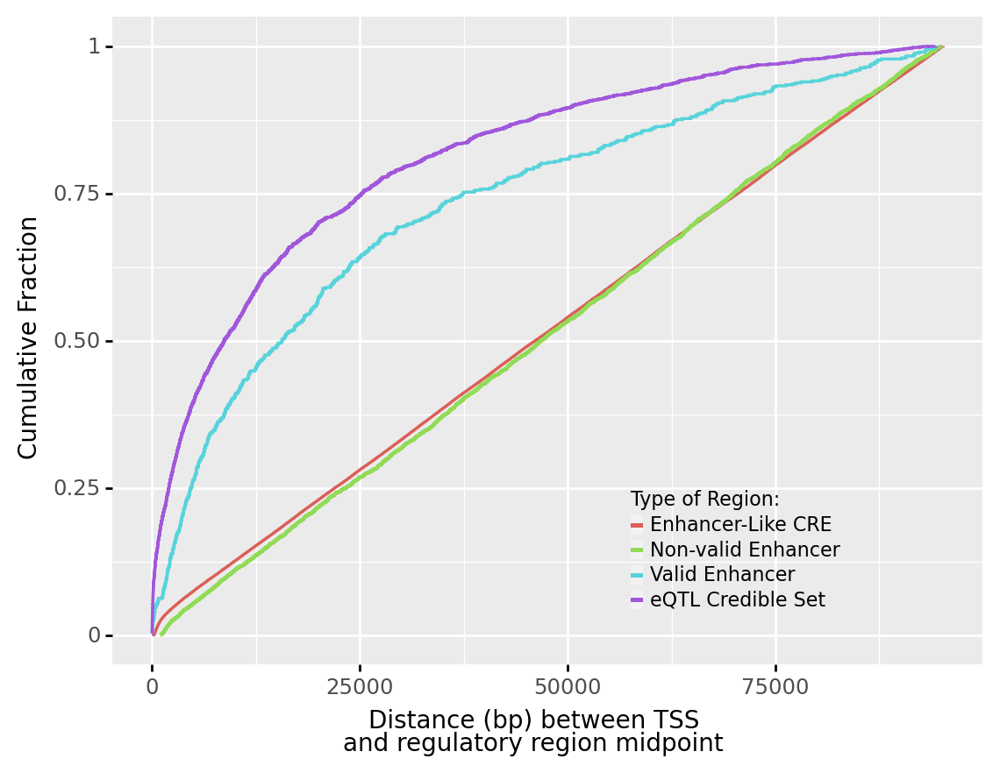

<ggplot: (1405542993143)>

In [61]:
p = (p9.ggplot(data=dist_distbn_all,mapping=p9.aes(x="abs_tss_distance_mean",color="region_type"))
 + p9.stat_ecdf(size=0.7)
 #+ p9.scale_x_log10()
 #+ p9.geom_vline(xintercept=10_000)
 + p9.labs(x="Distance (bp) between TSS\nand regulatory region midpoint",
           y="Cumulative Fraction",color="Type of Region:")
 + p9.theme(legend_key_size=8,
            legend_title=p9.element_text(size=8),
            legend_text=p9.element_text(size=8),
            legend_box_margin=0,legend_key_width=5,
            legend_position=(0.68,0.25),
            legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10))
)
p

In [62]:
p.save("Graphics/" + "classimba_distbn" + ".svg", width=2.9, height=3.0, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 2.9 x 3.0 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/classimba_distbn.svg


# Kircher Saturation Mutagenesis

We apply a number of models to the Kircher saturation mutagenesis data, which tested many variants in different loci (mostly promoters) using a reporter plasmid.

Some things are notable here:

- Data are of high quality (high replicate accuracy)
- Saturation mutagenesis: many variants!
- Most loci are promoters
- (Almost) all appear to be baseline expressed according to enformer (the denominator is never insane)
- The total correlation (pooling data across loci) is considerably lower than the weighted average of per-locus correlations for CAGE but not for DNASE (miscalibration for CAGE predictions)

In [103]:
base_path_data = "Data/Kircher_saturation_mutagenesis/"
base_path_results = "Results/Kircher_saturation_mutagenesis/"
fasta_file_hg19 = 'Data/Genome/genome_hg19.fa'
fasta_extractor_hg19 = FastaStringExtractor(fasta_file_hg19)

In [104]:
locus_list = []
for path in glob.glob(base_path_data + "*/*.tsv"):
    locus = path.split("/")[-1].split("_")[-1].split(".")[0]
    locus_df = pd.read_csv(path,sep="\t", names=["Chromosome", 
                                                  "Pos_hg38",
                                                  "Ref",
                                                  "Alt",
                                                  "log2FC",
                                                  "Variance"])
    locus_df["Locus"] = locus
    locus_list.append(locus_df)
kircher_df = pd.concat(locus_list)

In [105]:
kircher_df = kircher_df.reset_index(drop=True).rename(columns={"Locus":"locus","Pos_hg38":"variant_pos","Chromosome":"chromosome"})

In [106]:
#set(kircher_df["locus"])

In [107]:
def get_matching_cols(cell_descriptor, suffix = "_landmark_sum_wide", expr_type="CAGE", target_df=target_df):
    keys = [x for x in 
            target_df.loc[(target_df.description.str.contains(expr_type)) & (target_df.description.str.contains(cell_descriptor, case=False))]["description"]]
    if len(keys) == 0:
        keys = [x for x in target_df.loc[(target_df.description.str.contains(expr_type))]["description"]]
    # if a key appears several times, add a numbering
    key_dict = collections.defaultdict(list)
    # create equivalence classes
    for k in keys:
        key_dict[k].append(k)
    # number each one if equi class > 1 and concat
    keys_new = []
    for k in key_dict.keys():
        equi_class = key_dict[k]
        if len(equi_class) > 1:
            equi_class = [x + "_" + str(idx+1) for idx,x in enumerate(equi_class)]
        keys_new += equi_class
    keys = keys_new
    # add suffix
    keys = [x + suffix for x in keys]
    return keys

In [108]:
cell_type_dict = {
    "F9":get_matching_cols("hepg2"), 
    "LDLR":get_matching_cols("hepg2"), 
    "SORT1":get_matching_cols("hepg2"),
    "GP1BB":get_matching_cols("k562"), 
    "HBB":get_matching_cols("k562"), 
    "HBG1":get_matching_cols("k562"), 
    "PKLR":get_matching_cols("k562"),
    "HNF4A":get_matching_cols("hek293"), 
    "MSMB":get_matching_cols("hek293"), 
    "TERT-HEK293T":get_matching_cols("hek293"), 
    "MYCrs6983267":get_matching_cols("hek293"),
    "ZFAND3":get_matching_cols("pancreas"),
    "TERT-GBM":get_matching_cols("glioblastoma"),
    "IRF6":get_matching_cols("keratinocyte"),
    "IRF4":get_matching_cols("mel")
}

cell_type_dict_dnase = {
    "F9":get_matching_cols("hepg2",expr_type="DNASE"), 
    "LDLR":get_matching_cols("hepg2",expr_type="DNASE"), 
    "SORT1":get_matching_cols("hepg2",expr_type="DNASE"),
    "GP1BB":get_matching_cols("k562",expr_type="DNASE"), 
    "HBB":get_matching_cols("k562",expr_type="DNASE"), 
    "HBG1":get_matching_cols("k562",expr_type="DNASE"), 
    "PKLR":get_matching_cols("k562",expr_type="DNASE"),
    "HNF4A":get_matching_cols("hek293",expr_type="DNASE"), 
    "MSMB":get_matching_cols("hek293",expr_type="DNASE"), 
    "TERT-HEK293T":get_matching_cols("hek293",expr_type="DNASE"), 
    "MYCrs6983267":get_matching_cols("hek293",expr_type="DNASE"),
    "ZFAND3":get_matching_cols("pancreas",expr_type="DNASE"),
    "TERT-GBM":get_matching_cols("glioblastoma",expr_type="DNASE"),
    "IRF6":get_matching_cols("keratinocyte",expr_type="DNASE"),
    "IRF4":get_matching_cols("mel",expr_type="DNASE")
}

In [109]:
cell_type_dict_basenji1 = {
    "F9":get_matching_cols("hepg2", target_df=target_df_basenji1), 
    "LDLR":get_matching_cols("hepg2", target_df=target_df_basenji1), 
    "SORT1":get_matching_cols("hepg2", target_df=target_df_basenji1),
    "GP1BB":get_matching_cols("k562", target_df=target_df_basenji1), 
    "HBB":get_matching_cols("k562", target_df=target_df_basenji1), 
    "HBG1":get_matching_cols("k562", target_df=target_df_basenji1), 
    "PKLR":get_matching_cols("k562", target_df=target_df_basenji1),
    "HNF4A":get_matching_cols("hek293", target_df=target_df_basenji1), 
    "MSMB":get_matching_cols("hek293", target_df=target_df_basenji1), 
    "TERT-HEK293T":get_matching_cols("hek293", target_df=target_df_basenji1), 
    "MYCrs6983267":get_matching_cols("hek293", target_df=target_df_basenji1),
    "ZFAND3":get_matching_cols("pancreas", target_df=target_df_basenji1),
    "TERT-GBM":get_matching_cols("glioblastoma", target_df=target_df_basenji1),
    "IRF6":get_matching_cols("keratinocyte", target_df=target_df_basenji1),
    "IRF4":get_matching_cols("mel", target_df=target_df_basenji1)
}

cell_type_dict_dnase_basenji1 = {
    "F9":get_matching_cols("hepg2",expr_type="DNASE", target_df=target_df_basenji1), 
    "LDLR":get_matching_cols("hepg2",expr_type="DNASE", target_df=target_df_basenji1), 
    "SORT1":get_matching_cols("hepg2",expr_type="DNASE", target_df=target_df_basenji1),
    "GP1BB":get_matching_cols("k562",expr_type="DNASE", target_df=target_df_basenji1), 
    "HBB":get_matching_cols("k562",expr_type="DNASE", target_df=target_df_basenji1), 
    "HBG1":get_matching_cols("k562",expr_type="DNASE", target_df=target_df_basenji1), 
    "PKLR":get_matching_cols("k562",expr_type="DNASE", target_df=target_df_basenji1),
    "HNF4A":get_matching_cols("hek293",expr_type="DNASE", target_df=target_df_basenji1), 
    "MSMB":get_matching_cols("hek293",expr_type="DNASE", target_df=target_df_basenji1), 
    "TERT-HEK293T":get_matching_cols("hek293",expr_type="DNASE", target_df=target_df_basenji1), 
    "MYCrs6983267":get_matching_cols("hek293",expr_type="DNASE", target_df=target_df_basenji1),
    "ZFAND3":get_matching_cols("pancreas",expr_type="DNASE", target_df=target_df_basenji1),
    "TERT-GBM":get_matching_cols("glioblastoma",expr_type="DNASE", target_df=target_df_basenji1),
    "IRF6":get_matching_cols("keratinocyte",expr_type="DNASE", target_df=target_df_basenji1),
    "IRF4":get_matching_cols("mel",expr_type="DNASE", target_df=target_df_basenji1)
}

In [110]:
# reproducibility
repro_df = pd.DataFrame([
                        {"locus":"F9","replicate_r":0.61},
                        {"locus":"GP1BB","replicate_r":0.74},
                        {"locus":"HBB","replicate_r":0.62},
                        {"locus":"HBG1","replicate_r":0.78},
                        {"locus":"HNF4A","replicate_r":0.75},
                        {"locus":"IRF4","replicate_r":0.98},
                        {"locus":"IRF6","replicate_r":0.90},
                        {"locus":"LDLR","replicate_r":0.99},
                        {"locus":"MSMB","replicate_r":0.75},
                        {"locus":"MYCrs6983267","replicate_r":0.55},
                        {"locus":"PKLR","replicate_r":0.79},
                        {"locus":"SORT1","replicate_r":0.98},
                        {"locus":"TERT-GBM","replicate_r":0.90},
                        {"locus":"TERT-HEK293T","replicate_r":0.65},
                        {"locus":"ZFAND3","replicate_r":0.72}
                    ])

In [111]:
## Prepare Kircher for Expecto

# remap to hg19
kircher_lift = kircher_df["chromosome"] + ":" + kircher_df["variant_pos"].astype("str") + "-" + kircher_df["variant_pos"].astype("str")
kircher_lift.to_csv(base_path_data+"kircher_lift_input.txt", index=None, header=None)

kircher_lift = pd.read_csv(base_path_data+"kircher_lift_output.txt", header=None)

kircher_df["pos_hg19"] = kircher_lift[0].apply(lambda x: x.split(":")[1].split("-")[0])

## Test that liftover worked

In [150]:
# test that this worked
idx = 0

row0_interval = kipoiseq.Interval(chrom=kircher_df.iloc[idx]["chromosome"],
                  start=int(kircher_df.iloc[idx]["pos_hg19"])-1, 
                  end=int(kircher_df.iloc[idx]["pos_hg19"]))

row0_insert_ref = kircher_df.iloc[idx]["Ref"]
row0_insert_alt = kircher_df.iloc[idx]["Alt"]
landmark = 0
offset = compute_offset_to_center_landmark(landmark,row0_insert_ref)

modified_sequence_ref, minbin, maxbin, landmarkbin = insert_sequence_at_landing_pad(row0_insert_ref, row0_interval, fasta_extractor_hg19, mode="replace",landmark=landmark, shift_five_end=offset)
modified_sequence_alt, minbin, maxbin, landmarkbin = insert_sequence_at_landing_pad(row0_insert_alt, row0_interval, fasta_extractor_hg19, mode="replace",landmark=landmark, shift_five_end=offset)

print(modified_sequence_ref[393216//2])
print(modified_sequence_alt[393216//2])

T
A


In [151]:
kircher_df["ID"] = kircher_df["locus"] + "_" + kircher_df["variant_pos"].astype("str")

In [152]:
# write vcf
kircher_df[["chromosome", "pos_hg19", "ID", "Ref", "Alt"]].sort_values(["chromosome","pos_hg19"]).to_csv(base_path_data+"hg19_vfc.txt",index=None,header=None,sep="\t")

## Test Kircher within-genome

In [164]:
idx = 0

row0_interval = kipoiseq.Interval(chrom=kircher_df.iloc[idx]["chromosome"],
                  start=int(kircher_df.iloc[idx]["variant_pos"])-1, 
                  end=int(kircher_df.iloc[idx]["variant_pos"]))

In [123]:
landmark = 0

In [139]:
row0_interval

Interval(chrom='chr11', start=5227037, end=5227038, name='', strand='.', ...)

In [124]:
row0_insert_ref = kircher_df.iloc[idx]["Ref"]
row0_insert_alt = kircher_df.iloc[idx]["Alt"]

In [129]:
offset = compute_offset_to_center_landmark(landmark,row0_insert)

modified_sequence_ref, minbin, maxbin, landmarkbin = insert_sequence_at_landing_pad(row0_insert_ref, row0_interval, fasta_extractor, mode="replace",landmark=landmark, shift_five_end=offset)
modified_sequence_alt, minbin, maxbin, landmarkbin = insert_sequence_at_landing_pad(row0_insert_alt, row0_interval, fasta_extractor, mode="replace",landmark=landmark, shift_five_end=offset)

In [130]:
modified_sequence_ref == modified_sequence_alt

False

In [145]:
modified_sequence_ref[:393216//2] == modified_sequence_alt[:393216//2]

True

In [140]:
modified_sequence_ref[393216//2]

'T'

In [141]:
modified_sequence_alt[393216//2]

'A'

In [160]:
modified_sequence_ref[393216//2 + 1:] == modified_sequence_alt[393216//2 + 1:]

True

In [ ]:
# 18ba9c3f-b9d5-45d4-a578-d796b613b160
# https://hb.flatironinstitute.org/deepsea/jobs/18ba9c3f-b9d5-45d4-a578-d796b613b160

## Analysis - Enformer

In [113]:
enformer_cols = list(set(itertools.chain.from_iterable(cell_type_dict.values()))) + list(set(itertools.chain.from_iterable(cell_type_dict_dnase.values())))
result_df = pd.read_csv(base_path_results + "kircher_ingenome-latest_results.tsv",sep="\t", usecols=["chromosome","locus","variant_pos","variant_type", "nucleotide", "offset", "orient"]+enformer_cols)

In [114]:
result_df = result_df.query('offset in [-43, 0, 43]').groupby(["chromosome","locus","variant_pos","variant_type", "nucleotide"])[enformer_cols].mean().reset_index()

### CAGE

#### Reproduce paper results for LDLR

In [115]:
pred_col = "CAGE:hepatocellular carcinoma cell line: HepG2 ENCODE, biol__landmark_sum_wide"
#pred_col = "CAGE:hepatocellular carcinoma cell line: HepG2 ENCODE, biol__center_sum"

In [116]:
ldlr = result_df.query('locus == "LDLR"')[['chromosome','locus','variant_pos','variant_type','nucleotide'] + [x for x in result_df.keys() if "HepG2" in x]]

In [117]:
# first aggregate, then log2fc
ldlr_aggreg = ldlr.groupby(["chromosome","locus","variant_pos","variant_type", "nucleotide"])[pred_col].mean().reset_index()
ldlr_aggreg[pred_col] =  np.log2(ldlr_aggreg[pred_col] + 1) 

ldlr_ref = ldlr_aggreg.query('variant_type == "ref"').drop(columns="variant_type").rename(columns={pred_col:pred_col + "_ref","nucleotide":"Ref"})
ldlr_alt = ldlr_aggreg.query('variant_type == "alt"').drop(columns="variant_type").rename(columns={pred_col:pred_col + "_alt","nucleotide":"Alt"})

ldlr_aggreg = ldlr_ref.merge(ldlr_alt,on=["chromosome", "locus", "variant_pos"])

ldlr_aggreg[pred_col] = ldlr_aggreg[pred_col+"_alt"] - ldlr_aggreg[pred_col+"_ref"]

In [118]:
ldlr_merged = ldlr_aggreg.merge(kircher_df, on=["chromosome", "locus", "variant_pos","Ref","Alt"])

In [119]:
scipy.stats.pearsonr(ldlr_merged[pred_col], ldlr_merged["log2FC"])

(0.6431751404080668, 1.3228859843757083e-112)

In [120]:
# first log2fc, then aggreg
ldlr_prelog = ldlr.copy()
ldlr_prelog[pred_col] =  np.log2(ldlr_prelog[pred_col] + 1) 
ldlr_aggreg = ldlr_prelog.groupby(["chromosome","locus","variant_pos","variant_type", "nucleotide"])[pred_col].mean().reset_index()

ldlr_ref = ldlr_aggreg.query('variant_type == "ref"').drop(columns="variant_type").rename(columns={pred_col:pred_col + "_ref","nucleotide":"Ref"})
ldlr_alt = ldlr_aggreg.query('variant_type == "alt"').drop(columns="variant_type").rename(columns={pred_col:pred_col + "_alt","nucleotide":"Alt"})

ldlr_aggreg = ldlr_ref.merge(ldlr_alt,on=["chromosome", "locus", "variant_pos"])

ldlr_aggreg[pred_col] = ldlr_aggreg[pred_col+"_alt"] - ldlr_aggreg[pred_col+"_ref"]

ldlr_merged = ldlr_aggreg.merge(kircher_df, on=["chromosome", "locus", "variant_pos","Ref","Alt"])

In [121]:
scipy.stats.pearsonr(ldlr_merged[pred_col], ldlr_merged["log2FC"])

(0.6431751404080668, 1.3228859843757083e-112)

#### Overall cell-type matched results

In [122]:
cellmatched_aggreg = result_df[["chromosome","locus","variant_pos","variant_type", "nucleotide"] + [x for x in result_df.keys() if "CAGE" in x]]

In [123]:
locus_df_list = []
for locus in set(cellmatched_aggreg["locus"]):
    subset = cellmatched_aggreg.query('locus == @locus')
    cols = cell_type_dict[locus]
    subset["pred_col"] = np.mean(subset[cols],axis=1)
    subset = subset[["chromosome","locus","variant_pos","variant_type", "nucleotide", "pred_col"]]
    locus_df_list.append(subset)
cellmatched_pred = pd.concat(locus_df_list)

/scratch/tmp/karollus/ipykernel_786964/4049187612.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [124]:
cellmatched_pred["log2_pred"] =  np.log2(cellmatched_pred["pred_col"] + 1) 

cellmatched_ref = cellmatched_pred.query('variant_type == "ref"').drop(columns="variant_type").rename(columns={"log2_pred":"log2_pred_ref","pred_col":"pred_col_ref","nucleotide":"Ref"})
cellmatched_alt = cellmatched_pred.query('variant_type == "alt"').drop(columns="variant_type").rename(columns={"log2_pred":"log2_pred_alt","pred_col":"pred_col_alt","nucleotide":"Alt"})

cellmatched_pred = cellmatched_ref.merge(cellmatched_alt,on=["chromosome", "locus", "variant_pos"])

cellmatched_pred["log2_pred"] = cellmatched_pred["log2_pred_alt"] - cellmatched_pred["log2_pred_ref"]

cellmatched_merged = cellmatched_pred.merge(kircher_df, on=["chromosome", "locus", "variant_pos","Ref","Alt"])

##### Overall correlation

In [125]:
print(scipy.stats.pearsonr(cellmatched_merged["log2_pred"],cellmatched_merged["log2FC"]))
print(scipy.stats.spearmanr(cellmatched_merged["log2_pred"],cellmatched_merged["log2FC"]))

(0.3295556434056962, 0.0)
SpearmanrResult(correlation=0.38664158325341075, pvalue=0.0)


In [126]:
row_list = []
for locus in set(cellmatched_merged["locus"]):
    subset = cellmatched_merged.query('locus == @locus')
    row_list.append({
        "locus":locus,
        "count":len(subset.index),
        "r":scipy.stats.pearsonr(subset["log2_pred"],subset["log2FC"])[0],
        "pval":scipy.stats.pearsonr(subset["log2_pred"],subset["log2FC"])[1],
        "spearman":scipy.stats.spearmanr(subset["log2_pred"],subset["log2FC"])[0]
    })
corr_df = pd.DataFrame(row_list)

# basal expression at each locus
basal = cellmatched_merged.groupby(["locus"])["pred_col_ref"].median().reset_index().rename(columns={"pred_col_ref":"predicted_basal_expression"})
corr_df = corr_df.merge(basal,on="locus")


# variation of measured log2fc at each locus
sd_log2fc = cellmatched_merged.groupby(["locus"])["log2FC"].std().reset_index().rename(columns={"log2FC":"standard deviation of log2fc"})
corr_df = corr_df.merge(sd_log2fc,on="locus")

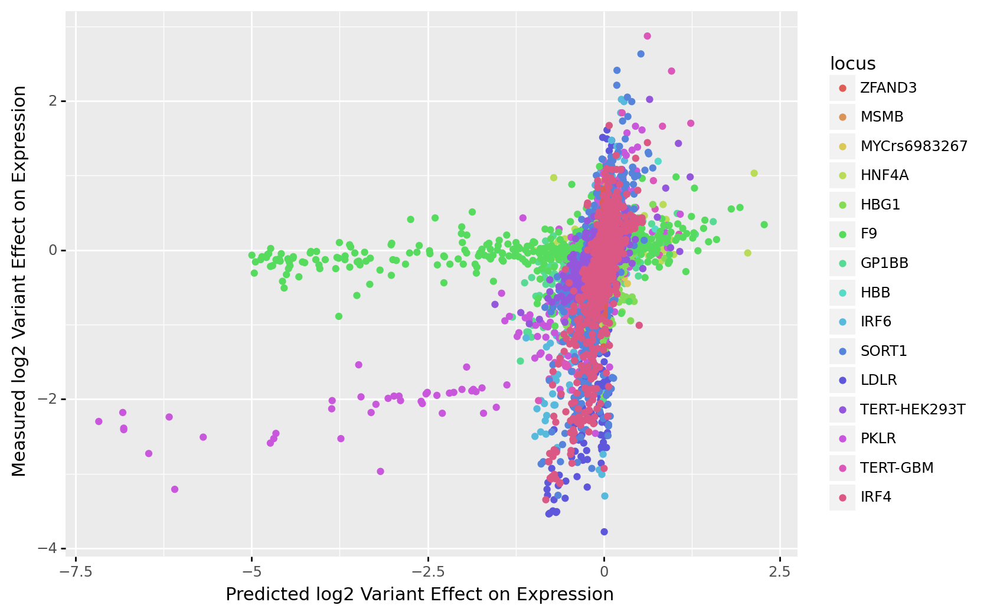

<ggplot: (1405641977001)>

In [127]:
p9.options.figure_size = (8, (4.8/6.4)*8)

plot_df = cellmatched_merged.copy()
plot_df["locus"] = pd.Categorical(plot_df["locus"], categories = list(corr_df.sort_values("r")["locus"]))

(p9.ggplot(data=plot_df,mapping=p9.aes(x="log2_pred",y="log2FC", color="locus"))
 + p9.geom_point()
 + p9.labs(x="Predicted log2 Variant Effect on Expression", y="Measured log2 Variant Effect on Expression")
 #+ p9.geom_smooth(method="lm",color="blue")
)

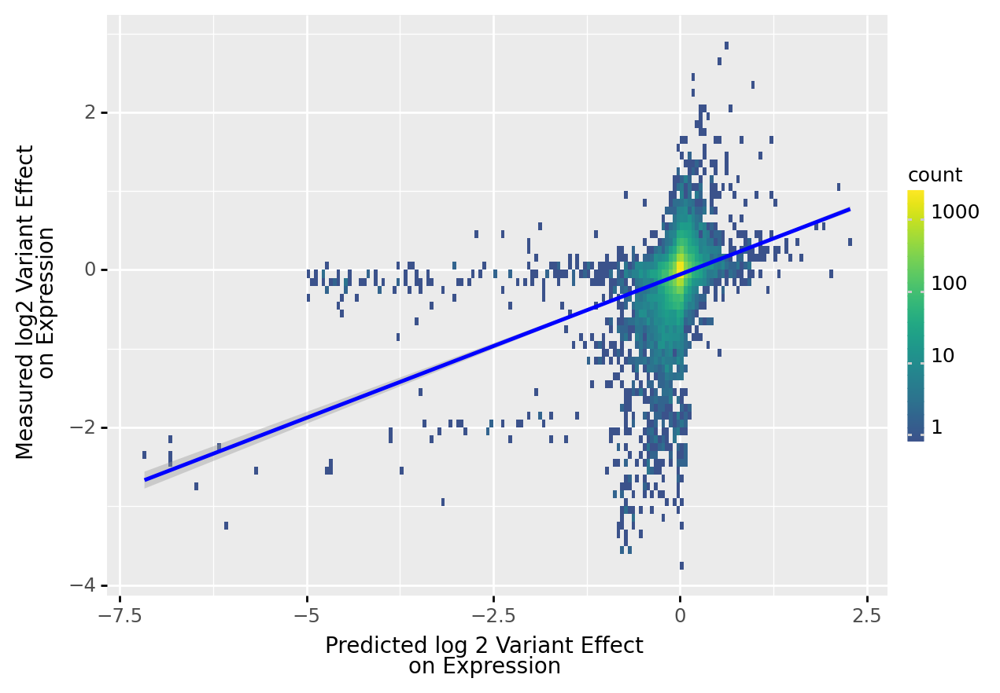

<ggplot: (1405641813685)>

In [128]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

plot_df = cellmatched_merged.copy()
plot_df["locus"] = pd.Categorical(plot_df["locus"], categories = list(corr_df.sort_values("r")["locus"]))

p = (p9.ggplot(data=plot_df,mapping=p9.aes(x="log2_pred",y="log2FC"))
 + p9.geom_bin2d(binwidth = (0.05, 0.1), raster=True)
 + p9.scale_fill_continuous(ListedColormap(cm.get_cmap('viridis', 512)(np.linspace(0.25, 1, 512))), trans="log10")
 + p9.geom_smooth(method="lm",color="blue")
 + p9.labs(x="Predicted log 2 Variant Effect\non Expression", y="Measured log2 Variant Effect\non Expression")
 + p9.theme(legend_box_margin = 0, legend_title=p9.element_text(size=9),
            legend_text=p9.element_text(size=9),legend_key_width=5,
           axis_title=p9.element_text(size=10))
)
p

In [129]:
p.save("Graphics/" + "xsup_kircher_cage_all" + ".svg", width=2.6, height=3.0, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 2.6 x 3.0 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/xsup_kircher_cage_all.svg


##### Disaggregated results

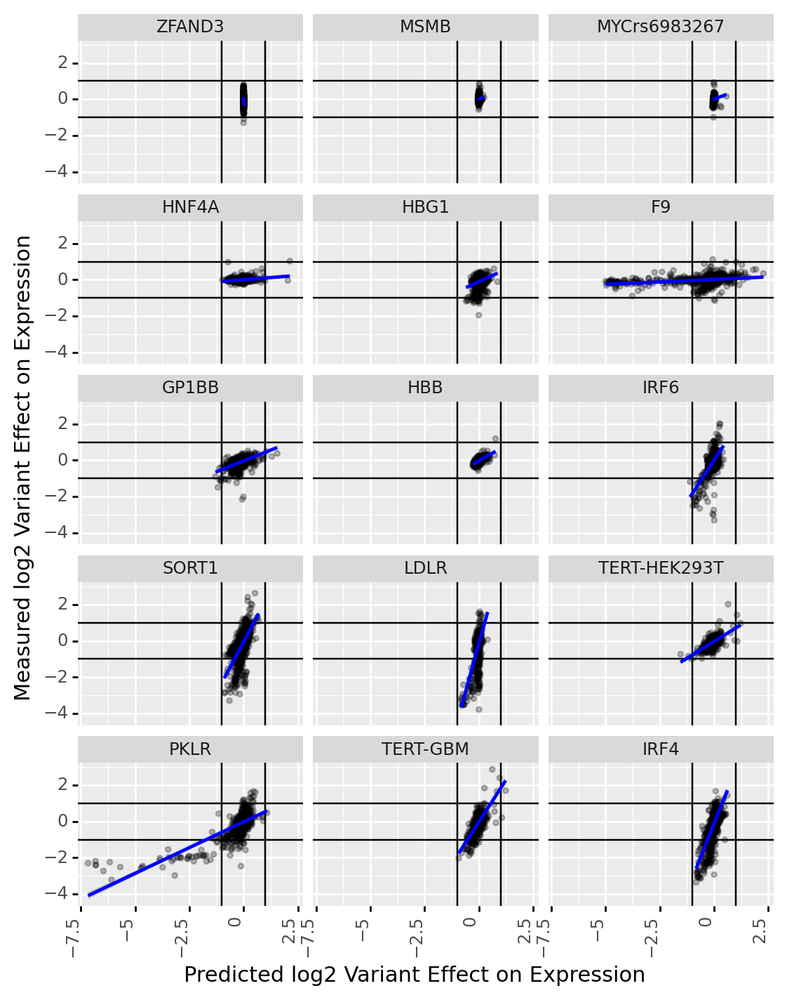

<ggplot: (1405546330329)>

In [208]:
scale = 1
p9.options.figure_size = (6.4*scale, 8.0*scale)

plot_df = cellmatched_merged.copy()
plot_df["locus"] = pd.Categorical(plot_df["locus"], categories = list(corr_df.sort_values("r")["locus"]))

p = (p9.ggplot(data=plot_df,mapping=p9.aes(x="log2_pred",y="log2FC"))
 + p9.geom_point(raster=True, alpha=0.25, size=1)
 + p9.geom_vline(xintercept = 1)
 + p9.geom_vline(xintercept = -1)
 + p9.geom_hline(yintercept = 1)
 + p9.geom_hline(yintercept = -1)
 #+ p9.geom_bin2d(binwidth = (0.25, 0.1), raster=True)
 #+ p9.scale_fill_continuous(ListedColormap(cm.get_cmap('viridis', 512)(np.linspace(0.25, 1, 512))), trans="log10")
 + p9.labs(x="Predicted log2 Variant Effect on Expression", y="Measured log2 Variant Effect on Expression")
 + p9.geom_smooth(method="lm",color="blue")
 + p9.facet_wrap('~locus', ncol=3)
 + p9.theme(axis_text_x=p9.element_text(rotation=90, hjust=1))
)
p
#p.save("Graphics/" + "xsup_kircher_cage_disaggreg" + ".svg", width=6.4, height=8.0, dpi=300)

In [131]:
p.save("Graphics/" + "xsup_kircher_cage_disaggreg" + ".svg", width=6.4, height=8.0, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.4 x 8.0 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/xsup_kircher_cage_disaggreg.svg


(0.29312717199537386, 1.97733199528011e-19)
(0.6431751404080668, 1.3228859843757083e-112)
(0.08090562054074261, 0.00047488736206241944)


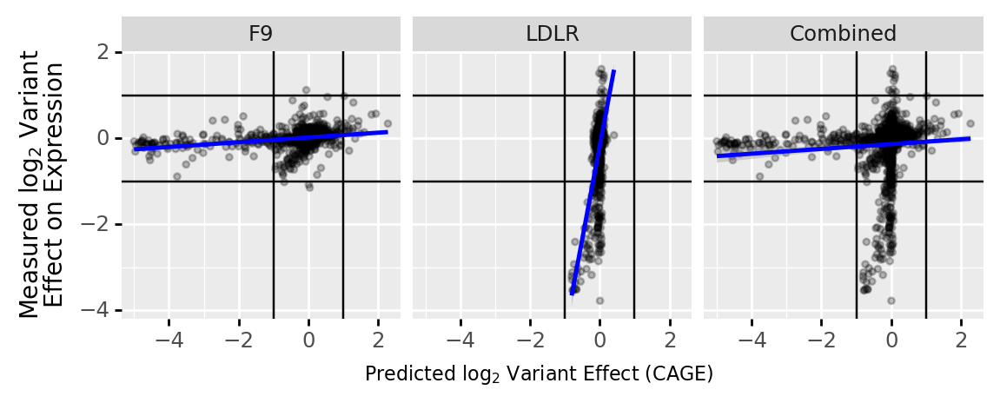

<ggplot: (1405547514106)>

In [209]:
p9.options.figure_size = (6.4*scale, 2.0*scale)

#plot_df_subset = plot_df.query('locus in ["F9","PKLR","TERT-HEK293T","LDLR"]')
#plot_df_subset()
print(scipy.stats.pearsonr(plot_df.query('locus in ["F9"]')["log2_pred"],plot_df.query('locus in ["F9"]')["log2FC"]))
print(scipy.stats.pearsonr(plot_df.query('locus in ["LDLR"]')["log2_pred"],plot_df.query('locus in ["LDLR"]')["log2FC"]))
print(scipy.stats.pearsonr(plot_df.query('locus in ["F9","LDLR"]')["log2_pred"],plot_df.query('locus in ["F9","LDLR"]')["log2FC"]))

plot_df_subset = plot_df.query('locus in ["F9","LDLR"]')
plot_df_comb = plot_df_subset.copy()
plot_df_comb["locus"] = "Combined"
plot_df_comb = pd.concat([plot_df_subset,plot_df_comb])
plot_df_comb["locus"] = pd.Categorical(plot_df_comb["locus"],["F9","LDLR","Combined"])

p = (p9.ggplot(data=plot_df_comb,mapping=p9.aes(x="log2_pred",y="log2FC"))
 + p9.geom_point(raster=True, alpha=0.25, size=1)
 + p9.geom_vline(xintercept = 1)
 + p9.geom_vline(xintercept = -1)
 + p9.geom_hline(yintercept = 1)
 + p9.geom_hline(yintercept = -1)
 #+ p9.geom_bin2d(binwidth = (0.25, 0.1), raster=True)
 #+ p9.scale_fill_continuous(ListedColormap(cm.get_cmap('viridis', 512)(np.linspace(0.25, 1, 512))), trans="log10")
 + p9.labs(x="Predicted $\mathregular{log_2}$ Variant Effect (CAGE)", y="Measured $\mathregular{log_2}$ Variant\nEffect on Expression")
 + p9.geom_smooth(method="lm",color="blue")
 + p9.facet_wrap('~locus', ncol=4)
 + p9.theme(axis_title_x=p9.element_text(size=8),axis_title_y=p9.element_text(size=10))
)
p

In [210]:
p.save("Graphics/" + "kircher_cage_ex" + ".svg", width=3.5, height=0.9, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 3.5 x 0.9 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/kircher_cage_ex.svg


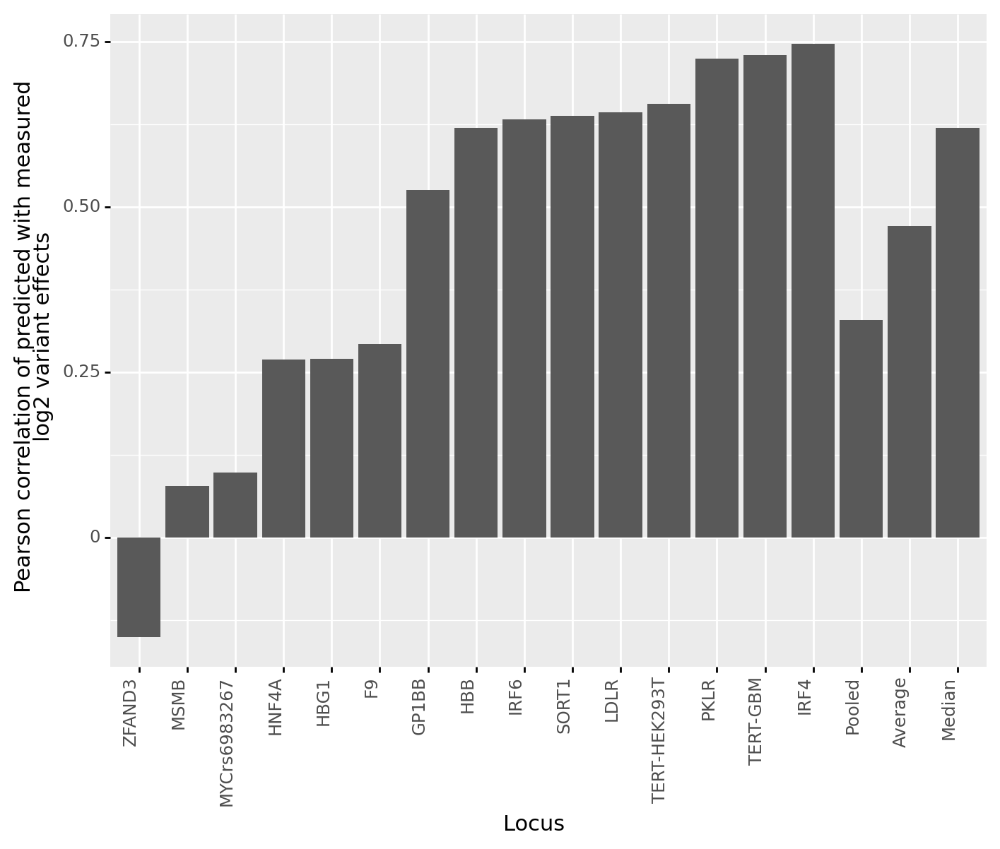

<ggplot: (1405507138551)>

In [134]:
p9.options.figure_size = (8, (4.8/6.4)*8)

plot_df = corr_df[["locus", "r"]].copy()

aggregvals = pd.DataFrame([{"locus":"Pooled", "r":scipy.stats.pearsonr(cellmatched_merged["log2_pred"],cellmatched_merged["log2FC"])[0]},
             {"locus":"Average", "r":np.abs(corr_df["r"]).mean()},
             {"locus":"Median", "r":corr_df["r"].median()}])
plot_df = pd.concat([plot_df, aggregvals])

plot_df["locus"] = pd.Categorical(plot_df["locus"], categories = list(corr_df.sort_values("r")["locus"]) + ["Pooled","Average","Median"])

(p9.ggplot(data=plot_df,mapping=p9.aes(x="locus",y="r"))
 + p9.geom_bar(stat="identity")
 + p9.labs(x="Locus", y="Pearson correlation of predicted with measured\nlog2 variant effects")
 + p9.theme(axis_text_x=p9.element_text(rotation=90, hjust=1))
)

##### Standardizing per locus

In [135]:
df_list = []
for locus in set(cellmatched_merged["locus"]):
    subset = cellmatched_merged.query('locus == @locus')
    subset["log2_pred_standardized"] = (subset["log2_pred"] - subset["log2_pred"].mean())/subset["log2_pred"].std()
    subset["log2_pred_standardized"] = scipy.stats.mstats.winsorize(subset["log2_pred_standardized"], limits=[0.01, 0.01])
    df_list.append(subset)
cellmatched_merged_standardized = pd.concat(df_list)

/scratch/tmp/karollus/ipykernel_786964/1642997106.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/scratch/tmp/karollus/ipykernel_786964/1642997106.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [136]:
print(scipy.stats.pearsonr(cellmatched_merged_standardized["log2_pred_standardized"],cellmatched_merged_standardized["log2FC"]))
print(scipy.stats.spearmanr(cellmatched_merged_standardized["log2_pred_standardized"],cellmatched_merged_standardized["log2FC"]))

(0.49327198775339726, 0.0)
SpearmanrResult(correlation=0.34503902590012786, pvalue=0.0)


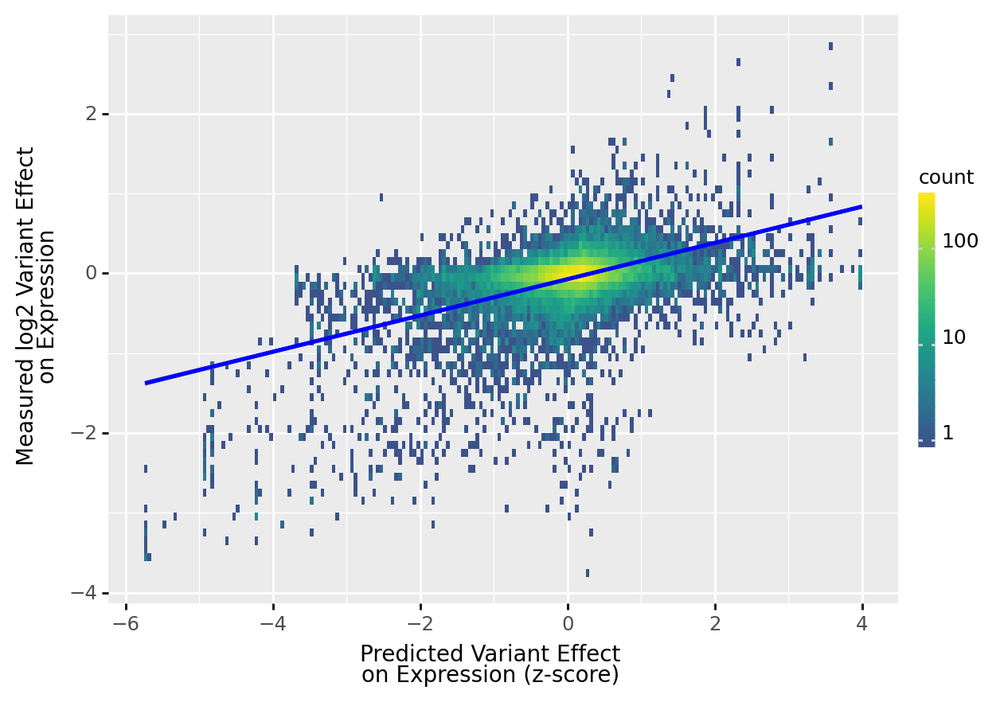

<ggplot: (1405541075137)>

In [137]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)


plot_df = cellmatched_merged_standardized.copy()
plot_df["locus"] = pd.Categorical(plot_df["locus"], categories = list(corr_df.sort_values("r")["locus"]))

p = (p9.ggplot(data=plot_df,mapping=p9.aes(x="log2_pred_standardized",y="log2FC"))
 + p9.geom_bin2d(binwidth = (0.05, 0.1), raster=True)
 + p9.scale_fill_continuous(ListedColormap(cm.get_cmap('viridis', 512)(np.linspace(0.25, 1, 512))), trans="log10")
 + p9.geom_smooth(method="lm",color="blue")
 + p9.labs(x="Predicted Variant Effect\non Expression (z-score)", y="Measured log2 Variant Effect\non Expression")
 + p9.geom_smooth(method="lm",color="blue")
 + p9.theme(legend_box_margin = 0, legend_title=p9.element_text(size=9),
            legend_text=p9.element_text(size=9),legend_key_width=5,
           axis_title=p9.element_text(size=10))
)
p

In [138]:
p.save("Graphics/" + "xsup_kircher_cage_norm" + ".svg", width=2.6, height=3.0, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 2.6 x 3.0 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/xsup_kircher_cage_norm.svg


In [139]:
row_list = []
for locus in set(cellmatched_merged_standardized["locus"]):
    subset = cellmatched_merged_standardized.query('locus == @locus')
    row_list.append({
        "locus":locus,
        "count":len(subset.index),
        "r":scipy.stats.pearsonr(subset["log2_pred_standardized"],subset["log2FC"])[0],
        "pval":scipy.stats.pearsonr(subset["log2_pred_standardized"],subset["log2FC"])[1],
        "spearman":scipy.stats.spearmanr(subset["log2_pred_standardized"],subset["log2FC"])[0]
    })
corr_df_std = pd.DataFrame(row_list)

In [140]:
corr_df_std.merge(corr_df,on="locus", suffixes=("_standardized",""))[["locus","r","r_standardized"]]

,locus,r,r_standardized
0,HNF4A,0.269006,0.220458
1,LDLR,0.643175,0.648773
2,GP1BB,0.525305,0.522345
3,IRF6,0.632594,0.619392
4,PKLR,0.724299,0.774928
5,MYCrs6983267,0.098260,0.228692
6,HBB,0.620064,0.602345
7,TERT-GBM,0.729650,0.734050
8,MSMB,0.078806,0.080101
9,HBG1,0.270979,0.254458


### DNASE

In [141]:
cellmatched_aggreg_dnase = result_df[["chromosome","locus","variant_pos","variant_type", "nucleotide"]+[x for x in result_df.keys() if "DNASE" in x]]

In [142]:
locus_df_list = []
for locus in set(cellmatched_aggreg_dnase["locus"]):
    subset = cellmatched_aggreg_dnase.query('locus == @locus')
    cols = list(set(cell_type_dict_dnase[locus]))
    subset["pred_col"] = np.mean(subset[cols],axis=1)
    subset = subset[["chromosome","locus","variant_pos","variant_type", "nucleotide", "pred_col"]]
    locus_df_list.append(subset)
cellmatched_pred_dnase = pd.concat(locus_df_list)

/scratch/tmp/karollus/ipykernel_786964/218875303.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [143]:
cellmatched_pred_dnase["log2_pred"] =  np.log2(cellmatched_pred_dnase["pred_col"] + 1) 

cellmatched_ref_dnase = cellmatched_pred_dnase.query('variant_type == "ref"').drop(columns="variant_type").rename(columns={"log2_pred":"log2_pred_ref","pred_col":"pred_col_ref","nucleotide":"Ref"})
cellmatched_alt_dnase = cellmatched_pred_dnase.query('variant_type == "alt"').drop(columns="variant_type").rename(columns={"log2_pred":"log2_pred_alt","pred_col":"pred_col_alt","nucleotide":"Alt"})

cellmatched_pred_dnase = cellmatched_ref_dnase.merge(cellmatched_alt_dnase,on=["chromosome", "locus", "variant_pos"])

cellmatched_pred_dnase["log2_pred"] = cellmatched_pred_dnase["log2_pred_alt"] - cellmatched_pred_dnase["log2_pred_ref"]

cellmatched_merged_dnase = cellmatched_pred_dnase.merge(kircher_df, on=["chromosome", "locus", "variant_pos","Ref","Alt"])

In [144]:
print(scipy.stats.pearsonr(cellmatched_merged_dnase["log2_pred"],cellmatched_merged_dnase["log2FC"]))
print(scipy.stats.spearmanr(cellmatched_merged_dnase["log2_pred"],cellmatched_merged_dnase["log2FC"]))

(0.6203581147796254, 0.0)
SpearmanrResult(correlation=0.44682297724327774, pvalue=0.0)


In [145]:
row_list = []
for locus in set(cellmatched_merged_dnase["locus"]):
    subset = cellmatched_merged_dnase.query('locus == @locus')
    row_list.append({
        "locus":locus,
        "count":len(subset.index),
        "r":scipy.stats.pearsonr(subset["log2_pred"],subset["log2FC"])[0],
        "pval":scipy.stats.pearsonr(subset["log2_pred"],subset["log2FC"])[1],
        "spearman":scipy.stats.spearmanr(subset["log2_pred"],subset["log2FC"])[0]
    })
corr_df_dnase = pd.DataFrame(row_list)

# basal expression at each locus
basal = cellmatched_merged_dnase.groupby(["locus"])["pred_col_ref"].median().reset_index().rename(columns={"pred_col_ref":"predicted_basal_expression"})
corr_df_dnase = corr_df_dnase.merge(basal,on="locus")

In [146]:
corr_df_merged = corr_df[["locus","count","r"]].merge(corr_df_dnase[["locus","count","r"]], on=["locus"], suffixes=("_enformer_CAGE","_enformer_DNASE"))

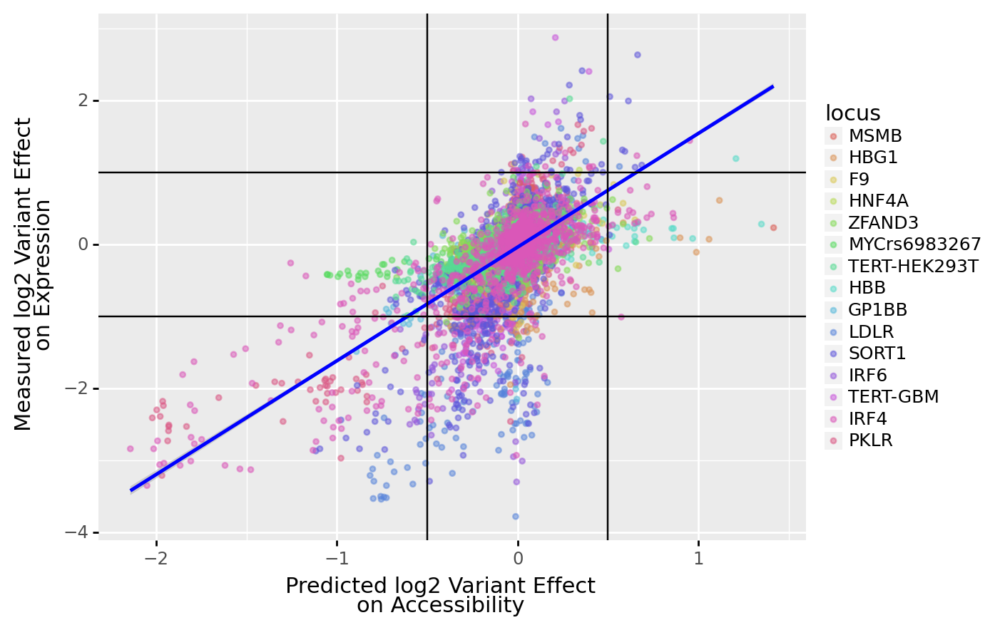

<ggplot: (1405543445357)>

In [147]:
p9.options.figure_size = (6.4,4.8)

plot_df = cellmatched_merged_dnase.copy()
plot_df["locus"] = pd.Categorical(plot_df["locus"], categories = list(corr_df_dnase.sort_values("r")["locus"]))

(p9.ggplot(data=plot_df,mapping=p9.aes(x="log2_pred",y="log2FC", color="locus"))
 + p9.geom_point(size=1, alpha=0.5)
 + p9.labs(x="Predicted log2 Variant Effect\non Accessibility", y="Measured log2 Variant Effect\non Expression")
 + p9.geom_smooth(method="lm",color="blue")
 + p9.geom_vline(xintercept = 0.5)
 + p9.geom_vline(xintercept = -0.5)
 + p9.geom_hline(yintercept = 1)
 + p9.geom_hline(yintercept = -1)
 + p9.theme(legend_box_margin = 0, legend_text=p9.element_text(size=9),legend_key_size=9)
)

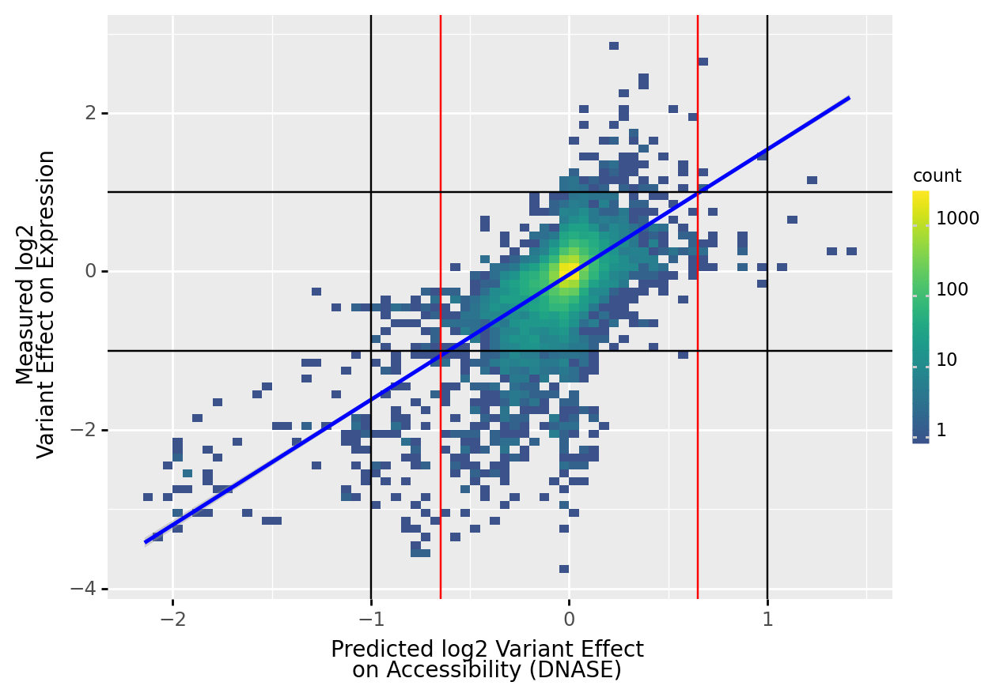

<ggplot: (1405546331706)>

In [148]:
p9.options.figure_size = (6.4,4.8)

plot_df = cellmatched_merged_dnase.copy()
plot_df["locus"] = pd.Categorical(plot_df["locus"], categories = list(corr_df_dnase.sort_values("r")["locus"]))


p = (p9.ggplot(data=plot_df,mapping=p9.aes(x="log2_pred",y="log2FC"))
 #+ p9.geom_point()
 + p9.geom_bin2d(binwidth = (0.05, 0.1), raster=True)
 + p9.labs(x="Predicted log2 Variant Effect\non Accessibility (DNASE)", y="Measured log2\nVariant Effect on Expression")
 + p9.scale_fill_continuous(ListedColormap(cm.get_cmap('viridis', 512)(np.linspace(0.25, 1, 512))), trans="log10")
 + p9.geom_smooth(method="lm",color="blue")
 + p9.geom_vline(xintercept = 0.65, color="red")
 + p9.geom_vline(xintercept = -0.65, color="red")
 + p9.geom_vline(xintercept = 1)
 + p9.geom_vline(xintercept = -1)
 + p9.geom_hline(yintercept = 1)
 + p9.geom_hline(yintercept = -1)
 + p9.theme(legend_text=p9.element_text(size=8),legend_title=p9.element_text(size=8),
            legend_box_margin=0,legend_key_width=5,axis_title=p9.element_text(size=10))#legend_key_size=10)
 #+ p9.scale_fill_gradient(low="lightgreen",high="darkgreen")
 #+ p9.guide_colorbar()
)
p

In [149]:
p.save("Graphics/" + "kircher_full" + ".svg", width=2.7, height=3.0, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 2.7 x 3.0 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/kircher_full.svg


In [150]:
ols_kircher_var = (statsmodels.regression.linear_model.OLS
                .from_formula('log2FC ~ log2_pred',
                             data=cellmatched_merged_dnase))

res_kircher_var = ols_kircher_var.fit()

res_kircher_var.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                 log2FC   R-squared:                       0.385
Model:                            OLS   Adj. R-squared:                  0.385
Method:                 Least Squares   F-statistic:                 1.155e+04
Date:                Sat, 10 Sep 2022   Prob (F-statistic):               0.00
Time:                        20:57:19   Log-Likelihood:                -4713.2
No. Observations:               18463   AIC:                             9430.
Df Residuals:                   18461   BIC:                             9446.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     -0.0392      0.002    -16.903      0.000      -0.044      -0.035
log2_pred      1.5789      0.015    107.468      0.000       1.550       1.608
==============================================================================
Omnibus:                    11321.446   Durbin-Watson:                   0.999
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           270313.690
Skew:                          -2.527   Prob(JB):                         0.00
Kurtosis:                      21.051   Cond. No.                         6.39
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

#### Stratify by predicted variant effects

In [151]:
pred_cutoff = 0.5
real_cutoff = 1

plot_df["abs_pred_log2fc"] = np.abs(plot_df["log2_pred"])
plot_df["abs_real_log2fc"] = np.abs(plot_df["log2FC"])

plot_df["pred_cutoff"] = plot_df["abs_pred_log2fc"] > pred_cutoff
plot_df["real_cutoff"] = plot_df["abs_real_log2fc"] > real_cutoff

print("Restricting by predicted variant effect size")
print(scipy.stats.pearsonr(plot_df.query('pred_cutoff')["log2_pred"], 
                           plot_df.query('pred_cutoff')["log2FC"]))
print(scipy.stats.pearsonr(plot_df.query('not pred_cutoff')["log2_pred"], 
                           plot_df.query('not pred_cutoff')["log2FC"]))
print("Restricting by measured variant effect size")
print(scipy.stats.pearsonr(plot_df.query('real_cutoff')["log2_pred"], 
                           plot_df.query('real_cutoff')["log2FC"]))
print(scipy.stats.pearsonr(plot_df.query('not real_cutoff')["log2_pred"], 
                           plot_df.query('not real_cutoff')["log2FC"]))

Restricting by predicted variant effect size
(0.7366192658820296, 2.9740160552798384e-54)
(0.4990097499090166, 0.0)
Restricting by measured variant effect size
(0.5847193670171799, 3.8980195102855576e-58)
(0.47182946153193156, 0.0)


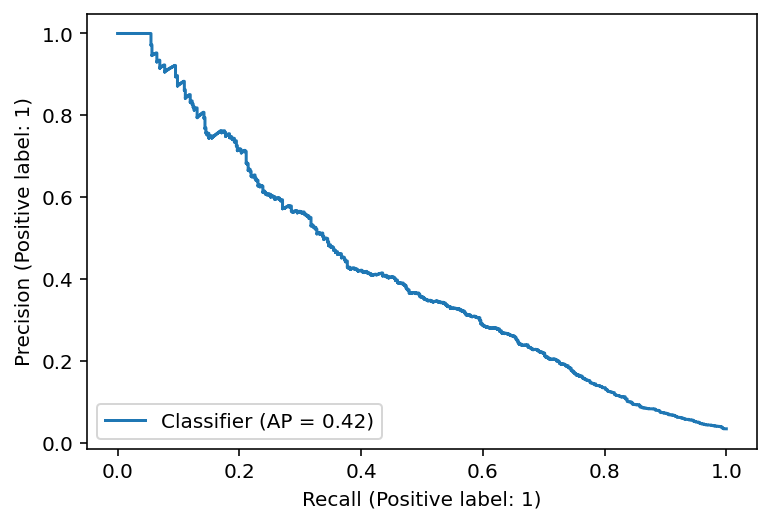

In [152]:
sklearn.metrics.PrecisionRecallDisplay.from_predictions(plot_df["real_cutoff"], plot_df["abs_pred_log2fc"])

In [153]:
print(sklearn.metrics.precision_score(plot_df["real_cutoff"],plot_df["pred_cutoff"]))
print(sklearn.metrics.recall_score(plot_df["real_cutoff"],plot_df["pred_cutoff"]))

0.5709677419354838
0.2854838709677419


#### Disaggregated results

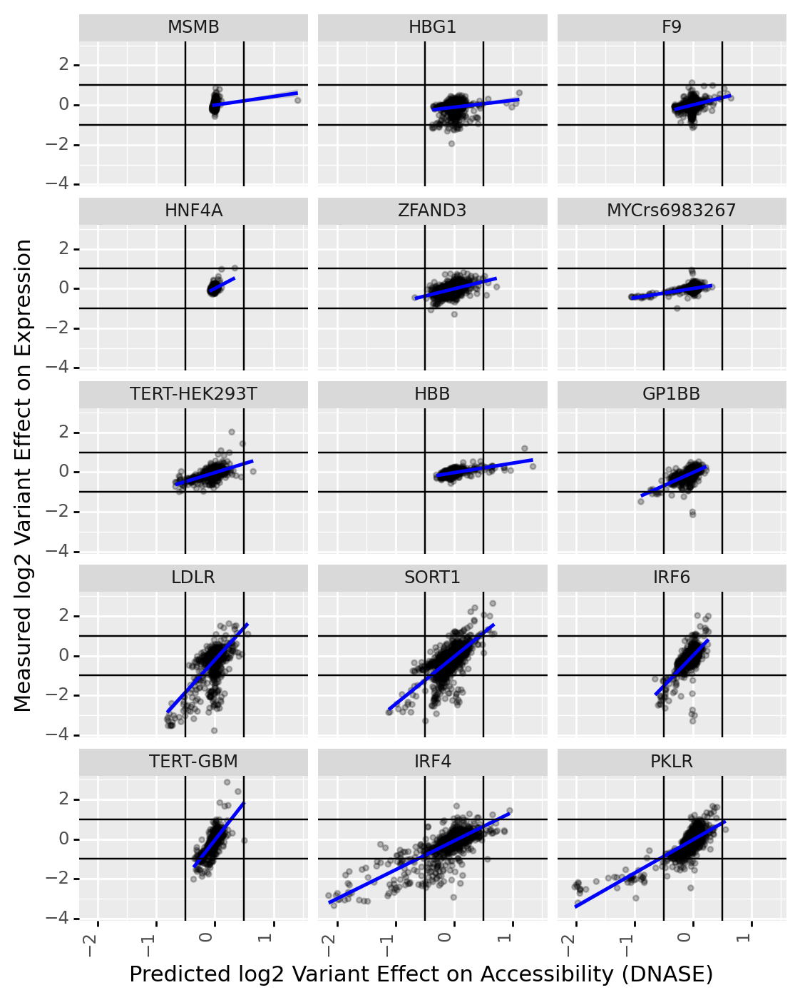

<ggplot: (1405507303437)>

In [211]:
p9.options.figure_size = (6.4,8.0) #(6.4, 4.8)

plot_df = cellmatched_merged_dnase.copy()
plot_df["locus"] = pd.Categorical(plot_df["locus"], categories = list(corr_df_dnase.sort_values("r")["locus"]))

p = (p9.ggplot(data=plot_df,mapping=p9.aes(x="log2_pred",y="log2FC"))
 + p9.geom_point(raster=True, alpha=0.25, size=1)
 #+ p9.geom_bin2d(binwidth = (0.25, 0.1), raster=True)
 #+ p9.scale_fill_continuous(ListedColormap(cm.get_cmap('viridis', 512)(np.linspace(0.25, 1, 512))), trans="log10")
 + p9.labs(x="Predicted log2 Variant Effect on Accessibility (DNASE)", y="Measured log2 Variant Effect on Expression")
 + p9.geom_smooth(method="lm",color="blue")
 + p9.geom_vline(xintercept = 0.5)
 + p9.geom_vline(xintercept = -0.5)
 + p9.geom_hline(yintercept = 1)
 + p9.geom_hline(yintercept = -1)
 + p9.facet_wrap('~locus', ncol=3)
 + p9.theme(axis_text_x=p9.element_text(rotation=90, hjust=1))
)
p

In [155]:
p.save("Graphics/" + "xsup_kircher_dnase_disaggreg" + ".svg", width=6.4, height=8.0, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.4 x 8.0 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/xsup_kircher_dnase_disaggreg.svg


(0.32699808222911, 4.7998146063610775e-24)
(0.6442803395835655, 4.1492076280535594e-113)
(0.5627798427738804, 4.924969686243875e-156)


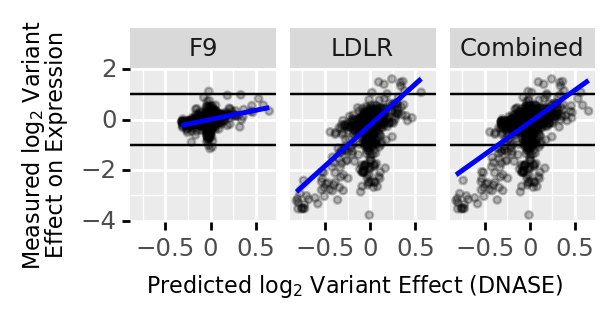

<ggplot: (1405541249178)>

In [212]:
p9.options.figure_size = (3.0*scale, 1.0*scale)

#plot_df_subset_dnase = plot_df.query('locus in ["F9","LDLR"]')
print(scipy.stats.pearsonr(plot_df.query('locus in ["F9"]')["log2_pred"],plot_df.query('locus in ["F9"]')["log2FC"]))
print(scipy.stats.pearsonr(plot_df.query('locus in ["LDLR"]')["log2_pred"],plot_df.query('locus in ["LDLR"]')["log2FC"]))
print(scipy.stats.pearsonr(plot_df.query('locus in ["F9","LDLR"]')["log2_pred"],plot_df.query('locus in ["F9","LDLR"]')["log2FC"]))

plot_df_subset = plot_df.query('locus in ["F9","LDLR"]')
plot_df_comb = plot_df_subset.copy()
plot_df_comb["locus"] = "Combined"
plot_df_comb = pd.concat([plot_df_subset,plot_df_comb])
plot_df_comb["locus"] = pd.Categorical(plot_df_comb["locus"],["F9","LDLR","Combined"])

p = (p9.ggplot(data=plot_df_comb,mapping=p9.aes(x="log2_pred",y="log2FC"))
 + p9.geom_point(raster=True, alpha=0.25, size=1)
 #+ p9.geom_vline(xintercept = 0.5, color="red")
 #+ p9.geom_vline(xintercept = -0.5, color="red")
 + p9.geom_hline(yintercept = 1)
 + p9.geom_hline(yintercept = -1)
 #+ p9.geom_bin2d(binwidth = (0.25, 0.1), raster=True)
 #+ p9.scale_fill_continuous(ListedColormap(cm.get_cmap('viridis', 512)(np.linspace(0.25, 1, 512))), trans="log10")
 + p9.labs(x="Predicted $\mathregular{log_2}$ Variant Effect (DNASE)", y="Measured $\mathregular{log_2}$ Variant\nEffect on Expression")
 + p9.geom_smooth(method="lm",color="blue")
 + p9.facet_wrap('~locus', ncol=4)
 + p9.scale_x_continuous(breaks=[0.5,0,-0.5])
 + p9.theme(axis_title=p9.element_text(size=8))
)
p

In [213]:
p.save("Graphics/" + "kircher_dnase_ex" + ".svg", width=3.5, height=0.9, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 3.5 x 0.9 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/kircher_dnase_ex.svg


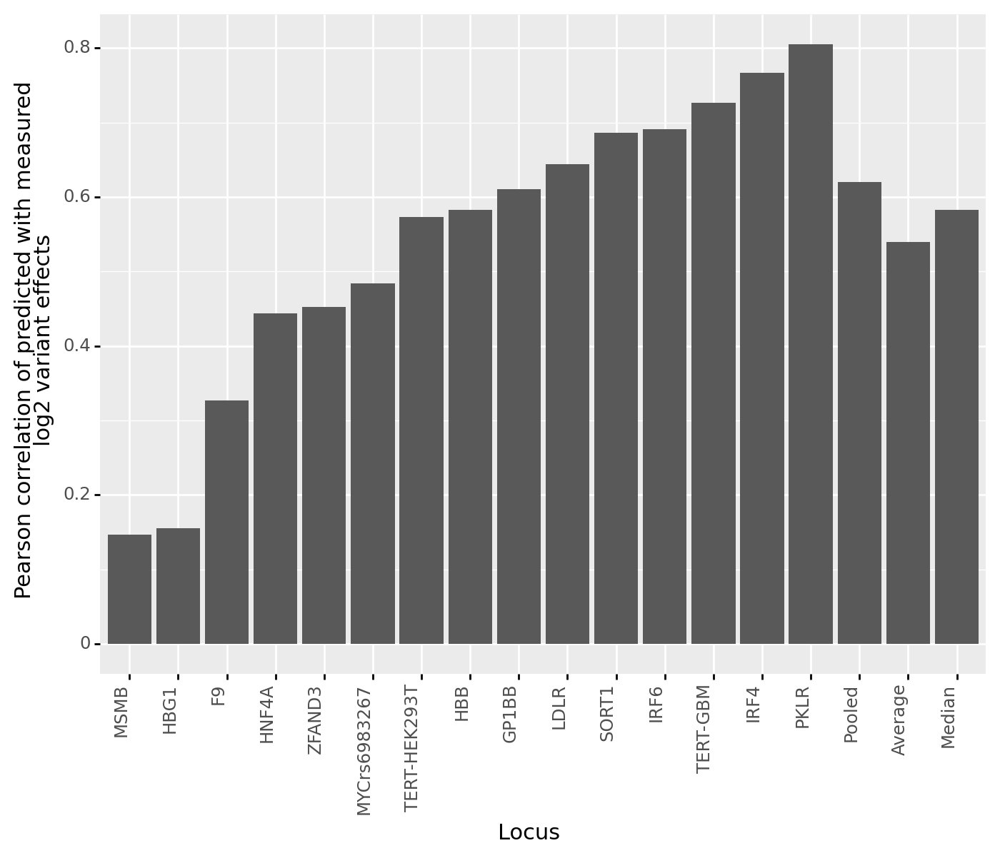

<ggplot: (1405545599371)>

In [158]:
p9.options.figure_size = (8, (4.8/6.4)*8)

plot_df = corr_df_dnase[["locus", "r"]].copy()

aggregvals = pd.DataFrame([{"locus":"Pooled", "r":scipy.stats.pearsonr(cellmatched_merged_dnase["log2_pred"],cellmatched_merged["log2FC"])[0]},
             {"locus":"Average", "r":np.abs(corr_df_dnase["r"]).mean()},
             {"locus":"Median", "r":corr_df_dnase["r"].median()}])
plot_df = pd.concat([plot_df, aggregvals])

plot_df["locus"] = pd.Categorical(plot_df["locus"], categories = list(corr_df_dnase.sort_values("r")["locus"]) + ["Pooled","Average","Median"])

(p9.ggplot(data=plot_df,mapping=p9.aes(x="locus",y="r"))
 + p9.geom_bar(stat="identity")
 + p9.labs(x="Locus", y="Pearson correlation of predicted with measured\nlog2 variant effects")
 + p9.theme(axis_text_x=p9.element_text(rotation=90, hjust=1))
)

In [159]:
print(scipy.stats.pearsonr(corr_df_dnase.merge(repro_df,on="locus")["replicate_r"],corr_df_dnase.merge(repro_df,on="locus")["r"]))

(0.4765336010104362, 0.07251583428147808)


### Association between predicted reference level and predicted variant effect

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/stats/smoothers.py:310: PlotnineWarning: Confidence intervals are not yet implementedfor lowess smoothings.


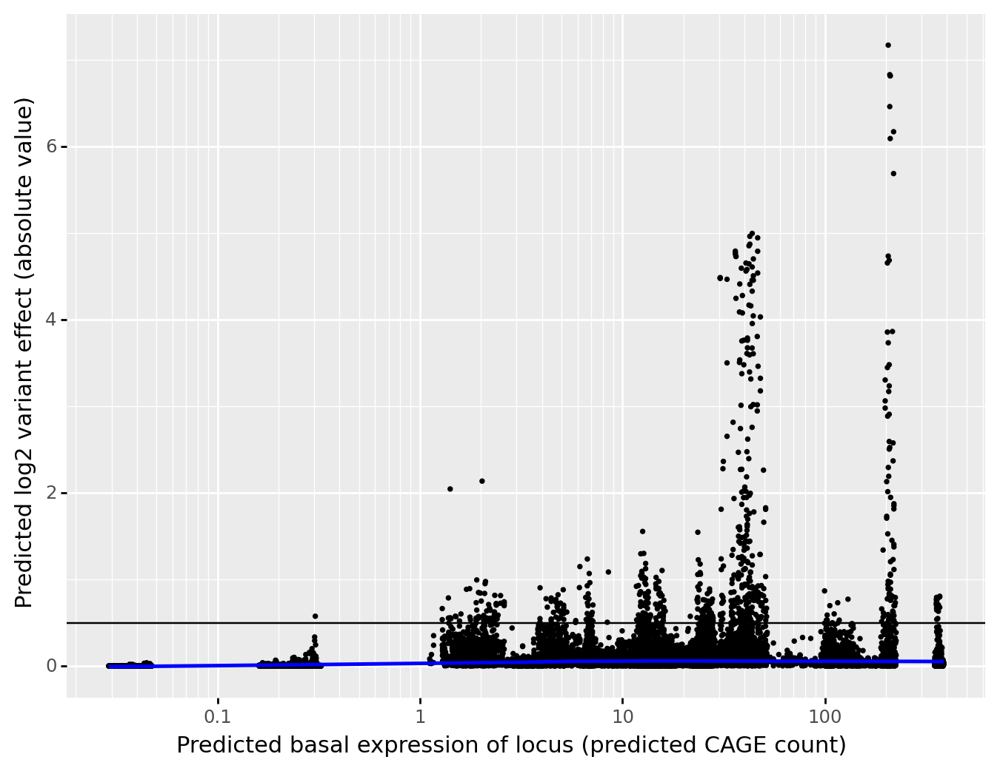

<ggplot: (1405545552942)>

In [160]:
p9.options.figure_size = (8, (4.8/6.4)*8)

plot_df = cellmatched_merged.copy()
plot_df["abs_log2_pred"] = np.abs(plot_df["log2_pred"])

(p9.ggplot(data=plot_df,
           mapping=p9.aes(x="pred_col_ref",y="abs_log2_pred"))
 + p9.geom_point(size=0.5)
 + p9.scale_x_log10()
 #+ p9.scale_y_log10()
 + p9.geom_hline(yintercept=0.5)
 + p9.geom_smooth(method="lowess",color="blue")
 + p9.labs(x="Predicted basal expression of locus (predicted CAGE count)", y="Predicted log2 variant effect (absolute value)")
)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/stats/smoothers.py:310: PlotnineWarning: Confidence intervals are not yet implementedfor lowess smoothings.


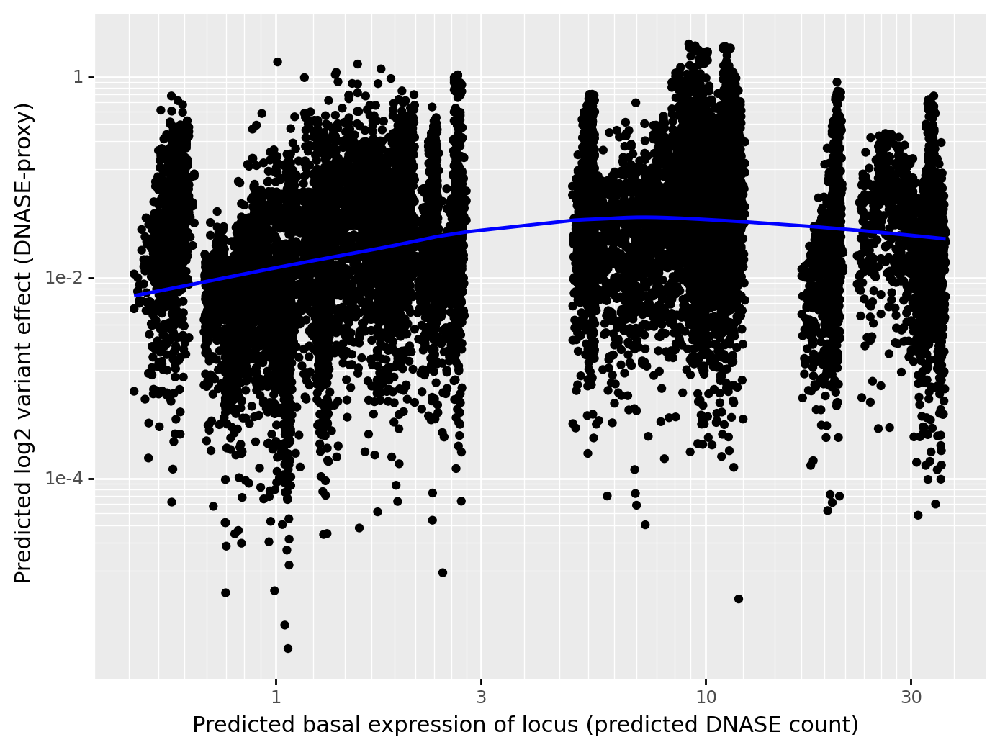

<ggplot: (1405545510129)>

In [161]:
p9.options.figure_size = (8, (4.8/6.4)*8)

plot_df = cellmatched_merged_dnase.copy()
plot_df["abs_log2_pred"] = np.abs(plot_df["log2_pred"])

(p9.ggplot(data=plot_df,mapping=p9.aes(x="pred_col_ref",y="abs_log2_pred"))
 + p9.geom_point()
 + p9.scale_x_log10()
 + p9.scale_y_log10()
 + p9.geom_smooth(method="lowess",color="blue")
 + p9.labs(x="Predicted basal expression of locus (predicted DNASE count)", y="Predicted log2 variant effect (DNASE-proxy)")
)

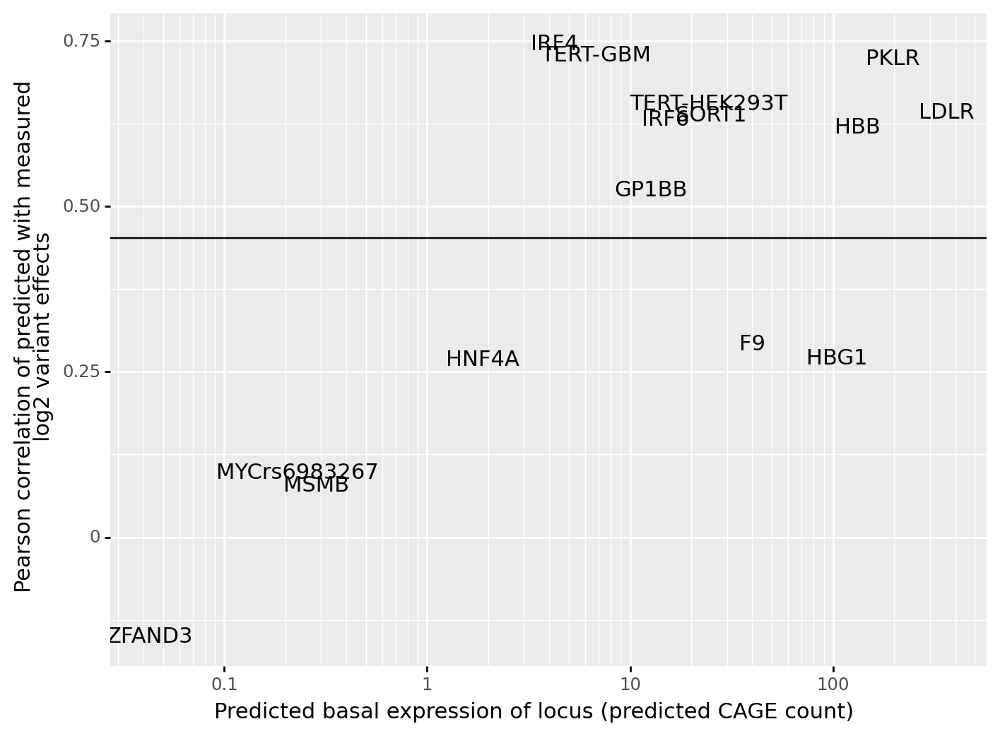

<ggplot: (1405545080327)>

In [162]:
p9.options.figure_size = (8, (4.8/6.4)*8)

(p9.ggplot(data=corr_df,mapping=p9.aes(x="predicted_basal_expression",y="r"))
 + p9.geom_point(alpha=0)
 + p9.geom_text(mapping=p9.aes(label="locus"))
 + p9.scale_x_log10()
 #+ p9.scale_y_log10()
 + p9.geom_hline(yintercept=corr_df["r"].mean())
 #+ p9.geom_smooth(method="lm",color="blue")
 + p9.labs(x="Predicted basal expression of locus (predicted CAGE count)", y="Pearson correlation of predicted with measured\nlog2 variant effects")
)

In [163]:
print(scipy.stats.pearsonr(np.log10(corr_df["predicted_basal_expression"]+1),corr_df["r"]))

(0.6064552700910728, 0.016536568721515887)


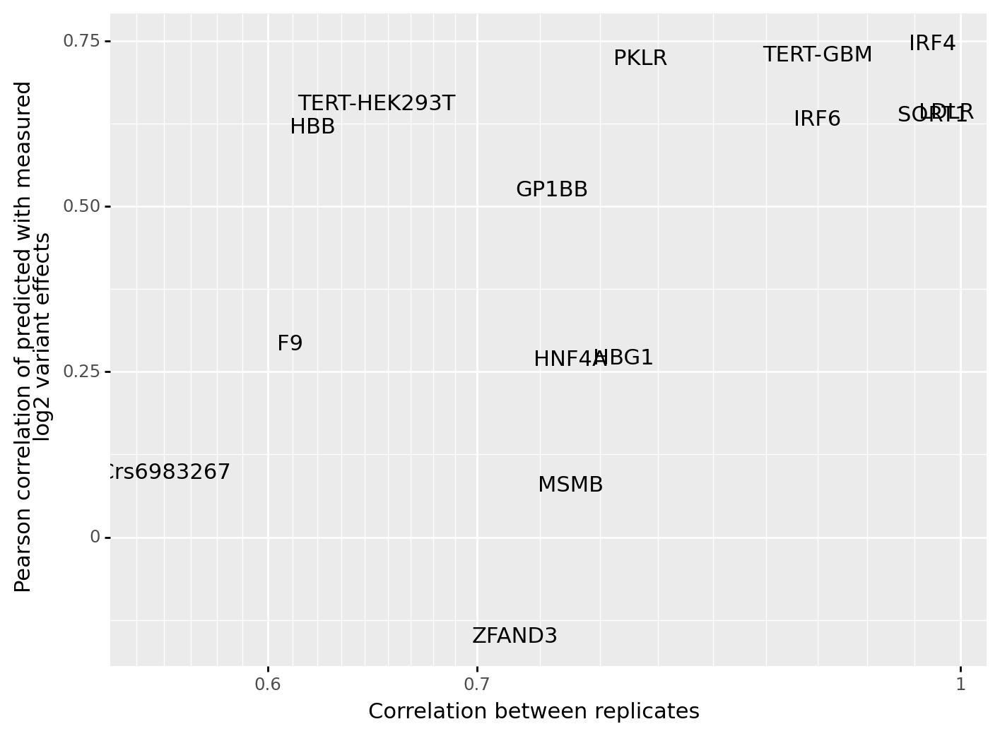

<ggplot: (1405545479355)>

In [164]:
p9.options.figure_size = (8, (4.8/6.4)*8)

(p9.ggplot(data=corr_df.merge(repro_df,on="locus"),mapping=p9.aes(x="replicate_r",y="r"))
 + p9.geom_point(alpha=0)
 + p9.geom_text(mapping=p9.aes(label="locus"))
 + p9.scale_x_log10()
 #+ p9.geom_smooth(method="lm",color="blue")
 + p9.labs(x="Correlation between replicates", y="Pearson correlation of predicted with measured\nlog2 variant effects")
)

In [165]:
print(scipy.stats.pearsonr(corr_df.merge(repro_df,on="locus")["replicate_r"],corr_df.merge(repro_df,on="locus")["r"]))

(0.5261736141698463, 0.04392432910570214)


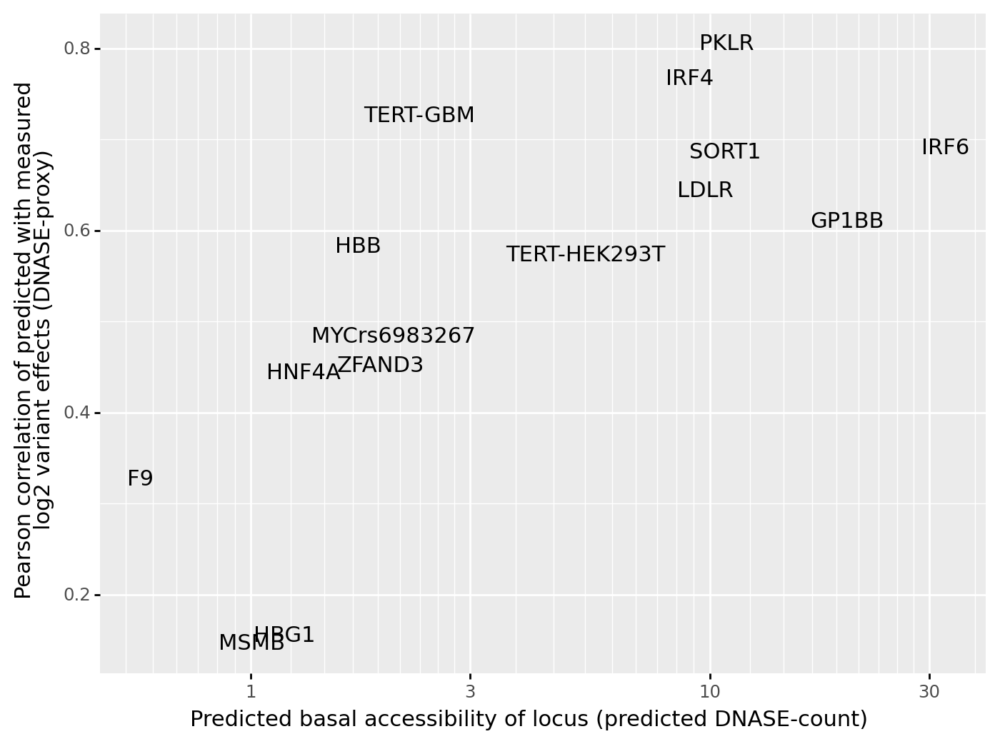

<ggplot: (1405545013517)>

In [166]:
p9.options.figure_size = (8, (4.8/6.4)*8)

(p9.ggplot(data=corr_df_dnase,mapping=p9.aes(x="predicted_basal_expression",y="r"))
 + p9.geom_point(alpha=0)
 + p9.geom_text(mapping=p9.aes(label="locus"))
 + p9.scale_x_log10()
 #+ p9.geom_smooth(method="lm",color="blue")
 + p9.labs(x="Predicted basal accessibility of locus (predicted DNASE-count)", y="Pearson correlation of predicted with measured\nlog2 variant effects (DNASE-proxy)")
)

In [167]:
scipy.stats.pearsonr(np.log10(corr_df_dnase["predicted_basal_expression"]+1),corr_df_dnase["r"])

(0.7165811866197023, 0.0026489179014046833)

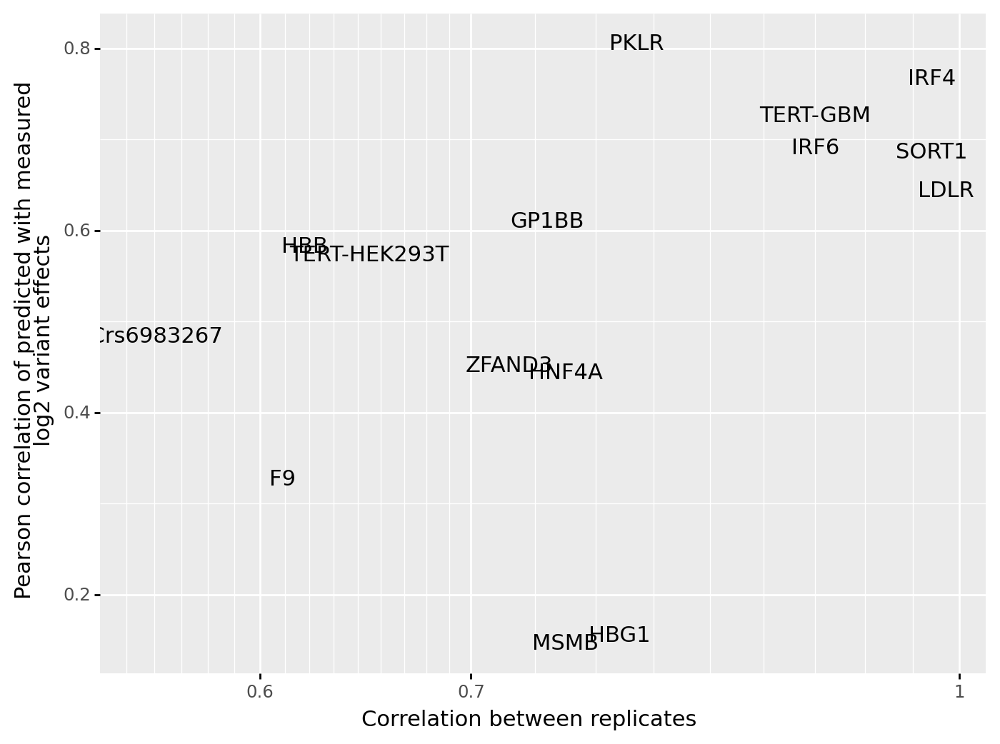

<ggplot: (1405545013917)>

In [168]:
p9.options.figure_size = (8, (4.8/6.4)*8)

(p9.ggplot(data=corr_df_dnase.merge(repro_df,on="locus"),mapping=p9.aes(x="replicate_r",y="r"))
 + p9.geom_point(alpha=0)
 + p9.geom_text(mapping=p9.aes(label="locus"))
 + p9.scale_x_log10()
 #+ p9.geom_smooth(method="lm",color="blue")
 + p9.labs(x="Correlation between replicates", y="Pearson correlation of predicted with measured\nlog2 variant effects")
)

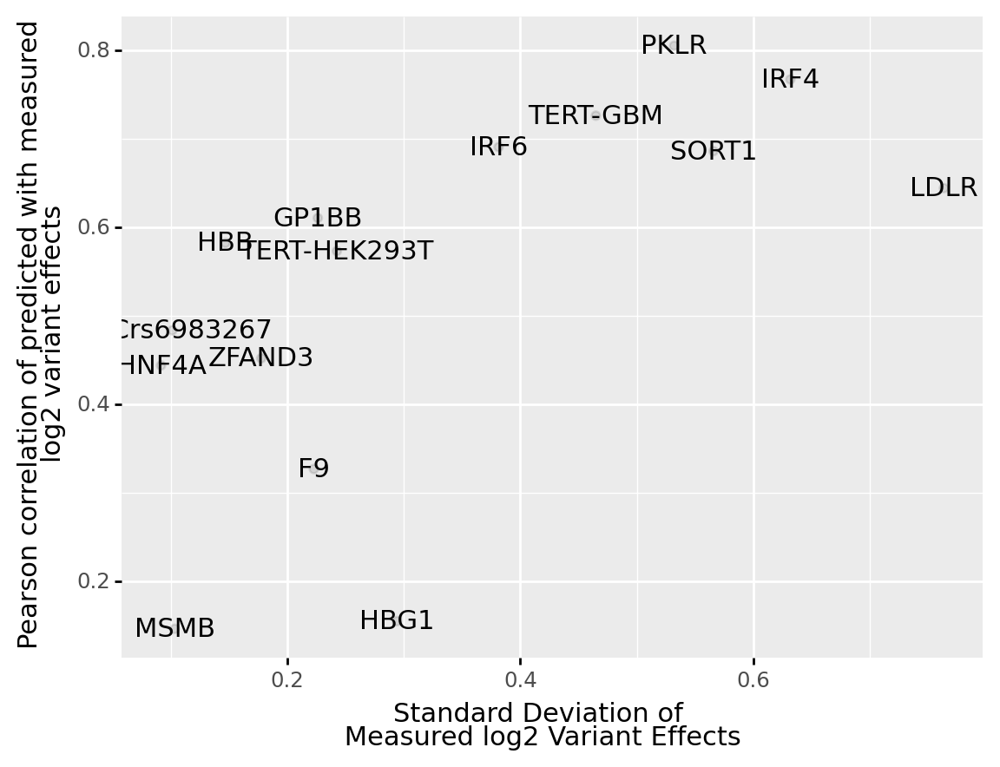

<ggplot: (1405544891895)>

In [169]:
p9.options.figure_size = (6.4,4.8)


(p9.ggplot(data=corr_df_dnase.merge(corr_df[["locus","standard deviation of log2fc"]],on="locus"),
           mapping=p9.aes(x="standard deviation of log2fc",y="r"))
 + p9.geom_point(alpha=0.1)
 + p9.geom_text(mapping=p9.aes(label="locus"))
 #+ p9.scale_x_log10()
 #+ p9.geom_smooth(method="lm",color="blue")
 + p9.labs(x="Standard Deviation of\n Measured log2 Variant Effects", y="Pearson correlation of predicted with measured\nlog2 variant effects")
)

## Analysis - Expecto

In [170]:
expecto_df = pd.read_csv(base_path_results + "expecto.tsv",sep="\t").rename(columns={"#chrom":"chromosome","ref_allele":"Ref","alt_allele":"Alt","position":"pos_hg19"})
expecto_df["pos_hg19"] = expecto_df["pos_hg19"].astype('str')
expecto_df = expecto_df.drop_duplicates()

expecto_df = expecto_df.rename(columns={k:k+"_effect" for k in [x for x in expecto_df.keys() if x not in ["chromosome","Ref","Alt","pos_hg19", "gene"]]})

In [171]:
expecto_df = kircher_df.merge(expecto_df, on=["chromosome","Ref","Alt","pos_hg19"])

In [172]:
def get_matching_keys(cell_descriptor):
    keys = [x for x in expecto_df.keys() if cell_descriptor in x.lower()]
    if len(keys) == 0:
        keys = [x for x in expecto_df.keys() if "_effect" in x]
    return keys

cell_type_dict_expecto = {
    "F9":get_matching_keys("hepg2"), 
    "LDLR":get_matching_keys("hepg2"), 
    "SORT1":get_matching_keys("hepg2"),
    "GP1BB":get_matching_keys("k562"), 
    "HBB":get_matching_keys("k562"), 
    "HBG1":get_matching_keys("k562"), 
    "PKLR":get_matching_keys("k562"),
    "HNF4A":get_matching_keys("hek293"), 
    "MSMB":get_matching_keys("hek293"), 
    "TERT-HEK293T":get_matching_keys("hek293"), 
    "MYCrs6983267":get_matching_keys("hek293"),
    "ZFAND3":get_matching_keys("pancreas"),
    "TERT-GBM":get_matching_keys("glioblastoma"),
    "IRF6":get_matching_keys("keratinocyte"),
    "IRF4":get_matching_keys("mel")
}

In [173]:
locus_df_list = []
for locus in set(expecto_df["locus"]):
    subset = expecto_df.query('locus == @locus')
    cols = cell_type_dict_expecto[locus]
    subset["pred_col"] =  np.mean(subset[cols],axis=1)# np.max(np.abs(subset[cols]),axis=1)
    subset = subset[["chromosome","locus","variant_pos","Ref", "Alt", "pred_col", "log2FC"]]
    locus_df_list.append(subset)
expecto_pred = pd.concat(locus_df_list)

/scratch/tmp/karollus/ipykernel_786964/3363083877.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [174]:
print(scipy.stats.pearsonr(expecto_pred["pred_col"],expecto_pred["log2FC"]))
print(scipy.stats.spearmanr(expecto_pred["pred_col"],expecto_pred["log2FC"]))

(0.31577801577616527, 0.0)
SpearmanrResult(correlation=0.2443426047748245, pvalue=7.02558659113946e-210)


In [175]:
row_list = []
for locus in set(expecto_pred["locus"]):
    subset = expecto_pred.query('locus == @locus')
    row_list.append({
        "locus":locus,
        "count":len(subset.index),
        "r":scipy.stats.pearsonr(subset["pred_col"],subset["log2FC"])[0],
        "pval":scipy.stats.pearsonr(subset["pred_col"],subset["log2FC"])[1],
        "spearman":scipy.stats.spearmanr(subset["pred_col"],subset["log2FC"])[0]
    })
corr_df_expecto = pd.DataFrame(row_list)

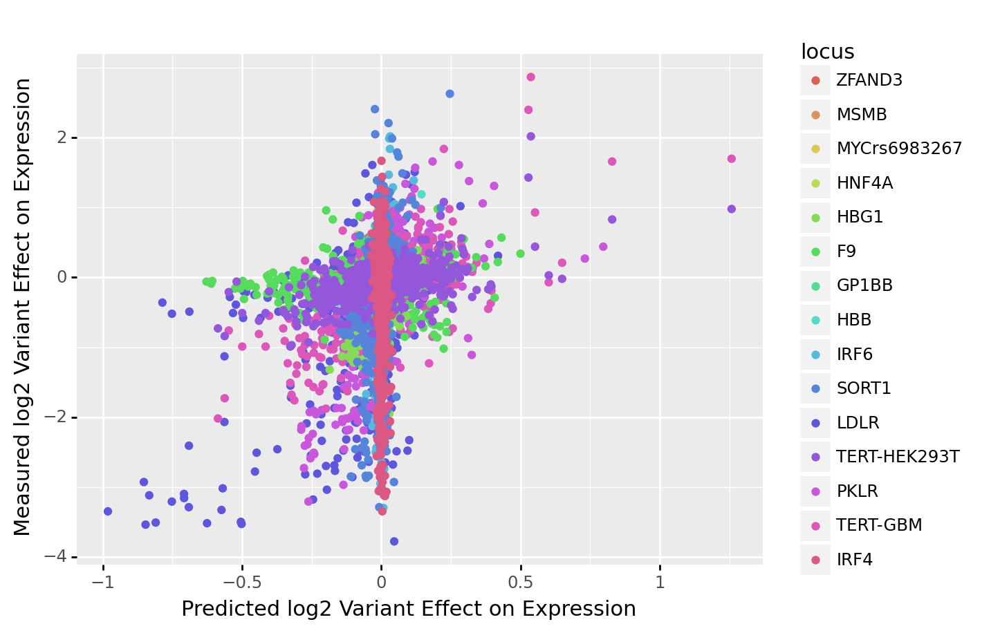

<ggplot: (1405544762085)>

In [176]:
plot_df = expecto_pred.copy()
plot_df["locus"] = pd.Categorical(plot_df["locus"], categories = list(corr_df.sort_values("r")["locus"]))

(p9.ggplot(data=plot_df,mapping=p9.aes(x="pred_col",y="log2FC", color="locus"))
 + p9.geom_point()
 + p9.labs(x="Predicted log2 Variant Effect on Expression", y="Measured log2 Variant Effect on Expression")
 #+ p9.geom_smooth(method="lm",color="blue")
)

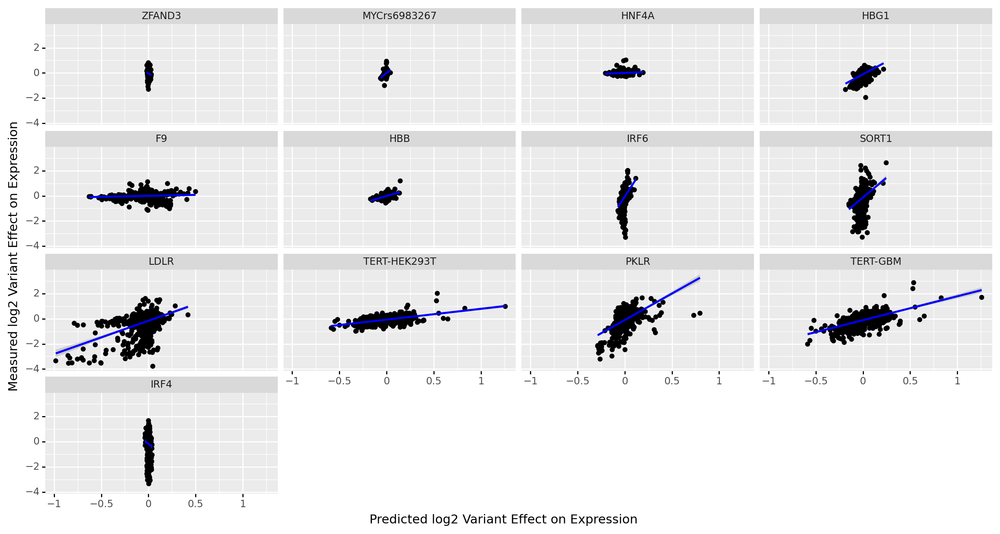

<ggplot: (1405544828389)>

In [177]:
p9.options.figure_size = (15,7.5) #(6.4, 4.8)

plot_df = expecto_pred.copy()
plot_df["locus"] = pd.Categorical(plot_df["locus"], categories = list(corr_df.sort_values("r")["locus"]))

(p9.ggplot(data=plot_df,mapping=p9.aes(x="pred_col",y="log2FC"))
 + p9.geom_point()
 + p9.labs(x="Predicted log2 Variant Effect on Expression", y="Measured log2 Variant Effect on Expression")
 + p9.geom_smooth(method="lm",color="blue")
 + p9.facet_wrap('~locus')
)

## Analysis - Basenji2

In [178]:
result_df_basenji2 = pd.read_csv(base_path_results + "kircher_ingenome-basenji2-latest_results.tsv",sep="\t", usecols=["chromosome","locus","variant_pos","variant_type", "nucleotide", "offset", "orient"]+enformer_cols)

### CAGE

In [179]:
cellmatched_aggreg_basenji2 = result_df_basenji2[["chromosome","locus","variant_pos","variant_type", "nucleotide"] + [x for x in result_df_basenji2.keys() if "CAGE" in x]]

In [180]:
locus_df_list = []
for locus in set(cellmatched_aggreg_basenji2["locus"]):
    subset = cellmatched_aggreg_basenji2.query('locus == @locus')
    cols = cell_type_dict[locus]
    subset["pred_col"] = np.mean(subset[cols],axis=1)
    subset = subset[["chromosome","locus","variant_pos","variant_type", "nucleotide", "pred_col"]]
    locus_df_list.append(subset)
cellmatched_pred_basenji2 = pd.concat(locus_df_list)

/scratch/tmp/karollus/ipykernel_786964/1337023225.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [181]:
cellmatched_pred_basenji2["log2_pred"] =  np.log2(cellmatched_pred_basenji2["pred_col"] + 1) 

cellmatched_ref_basenji2 = cellmatched_pred_basenji2.query('variant_type == "ref"').drop(columns="variant_type").rename(columns={"log2_pred":"log2_pred_ref","pred_col":"pred_col_ref","nucleotide":"Ref"})
cellmatched_alt_basenji2 = cellmatched_pred_basenji2.query('variant_type == "alt"').drop(columns="variant_type").rename(columns={"log2_pred":"log2_pred_alt","pred_col":"pred_col_alt","nucleotide":"Alt"})

cellmatched_pred_basenji2 = cellmatched_ref_basenji2.merge(cellmatched_alt_basenji2,on=["chromosome", "locus", "variant_pos"])

cellmatched_pred_basenji2["log2_pred"] = cellmatched_pred_basenji2["log2_pred_alt"] - cellmatched_pred_basenji2["log2_pred_ref"]

cellmatched_merged_basenji2 = cellmatched_pred_basenji2.merge(kircher_df, on=["chromosome", "locus", "variant_pos","Ref","Alt"])

In [182]:
print(scipy.stats.pearsonr(cellmatched_merged_basenji2["log2_pred"],cellmatched_merged_basenji2["log2FC"]))
print(scipy.stats.spearmanr(cellmatched_merged_basenji2["log2_pred"],cellmatched_merged_basenji2["log2FC"]))

(0.14904316365795509, 0.0)
SpearmanrResult(correlation=0.11873928188730343, pvalue=0.0)


In [183]:
row_list = []
for locus in set(cellmatched_merged_basenji2["locus"]):
    subset = cellmatched_merged_basenji2.query('locus == @locus')
    row_list.append({
        "locus":locus,
        "count":len(subset.index),
        "r":scipy.stats.pearsonr(subset["log2_pred"],subset["log2FC"])[0],
        "pval":scipy.stats.pearsonr(subset["log2_pred"],subset["log2FC"])[1],
        "spearman":scipy.stats.spearmanr(subset["log2_pred"],subset["log2FC"])[0]
    })
corr_df_basenji2 = pd.DataFrame(row_list)

# basal expression at each locus
basal = cellmatched_merged_basenji2.groupby(["locus"])["pred_col_ref"].median().reset_index().rename(columns={"pred_col_ref":"predicted_basal_expression"})
corr_df_basenji2 = corr_df_basenji2.merge(basal,on="locus")

In [184]:
corr_df_basenji2

,locus,count,r,pval,spearman,predicted_basal_expression
0,LDLR,34380,0.342462,0.000000e+00,0.179108,459.271600
1,GP1BB,41652,0.143037,2.992623e-189,0.113911,31.754504
2,HNF4A,30888,0.095866,5.647252e-64,0.070107,4.274578
3,IRF6,64296,0.066831,1.496971e-64,0.103216,2.643393
4,PKLR,50724,0.324615,0.000000e+00,0.198197,8.667870
5,MYCrs6983267,64512,0.092667,5.231811e-123,0.075362,0.291336
6,HBB,20304,0.030054,1.842198e-05,0.029278,61.694609
7,TERT-GBM,27900,0.330896,0.000000e+00,0.275776,10.104434
8,MSMB,63936,0.078797,1.358423e-88,0.046909,0.284875
9,HBG1,29700,0.153381,8.958426e-156,0.132526,20.224124


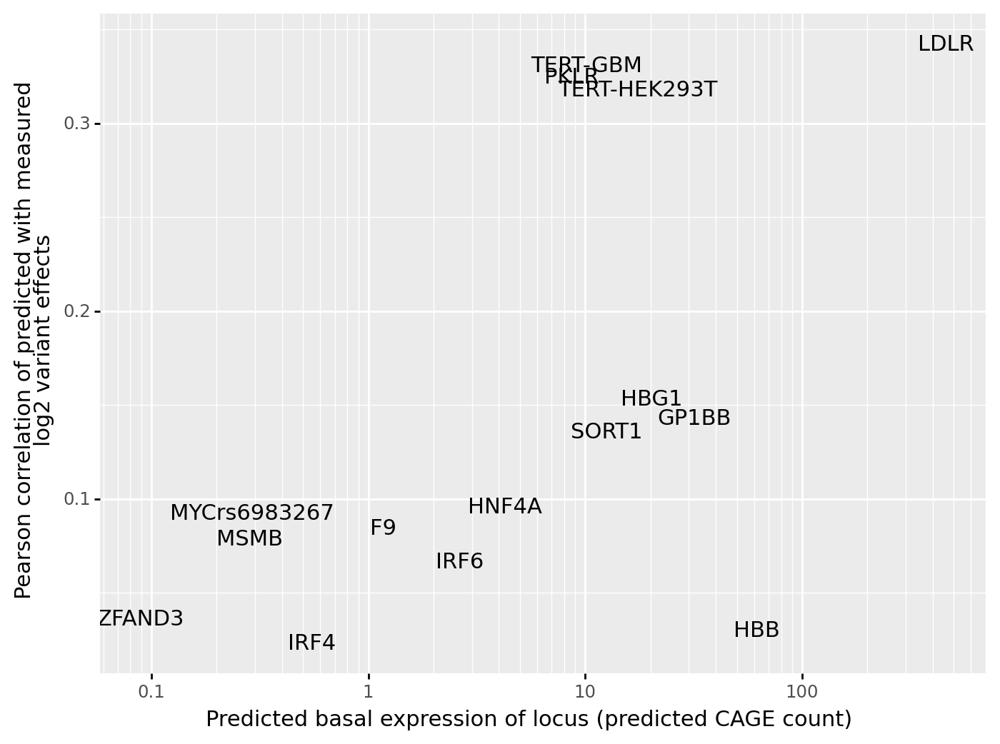

<ggplot: (1405642981560)>

In [185]:
p9.options.figure_size = (8, (4.8/6.4)*8)

(p9.ggplot(data=corr_df_basenji2,mapping=p9.aes(x="predicted_basal_expression",y="r"))
 + p9.geom_point(alpha=0)
 + p9.geom_text(mapping=p9.aes(label="locus"))
 + p9.scale_x_log10()
 #+ p9.geom_smooth(method="lm",color="blue")
 + p9.labs(x="Predicted basal expression of locus (predicted CAGE count)", y="Pearson correlation of predicted with measured\nlog2 variant effects")
)

### DNASE

In [186]:
cellmatched_aggreg_dnase_basenji2 = result_df_basenji2[["chromosome","locus","variant_pos","variant_type", "nucleotide"]+[x for x in result_df_basenji2.keys() if "DNASE" in x]]

In [187]:
locus_df_list = []
for locus in set(cellmatched_aggreg_dnase_basenji2["locus"]):
    subset = cellmatched_aggreg_dnase_basenji2.query('locus == @locus')
    cols = list(set(cell_type_dict_dnase[locus]))
    subset["pred_col"] = np.mean(subset[cols],axis=1)
    subset = subset[["chromosome","locus","variant_pos","variant_type", "nucleotide", "pred_col"]]
    locus_df_list.append(subset)
cellmatched_pred_dnase_basenji2 = pd.concat(locus_df_list)

/scratch/tmp/karollus/ipykernel_786964/2698742653.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [188]:
cellmatched_pred_dnase_basenji2["log2_pred"] =  np.log2(cellmatched_pred_dnase_basenji2["pred_col"] + 1) 

cellmatched_ref_dnase_basenji2 = cellmatched_pred_dnase_basenji2.query('variant_type == "ref"').drop(columns="variant_type").rename(columns={"log2_pred":"log2_pred_ref","pred_col":"pred_col_ref","nucleotide":"Ref"})
cellmatched_alt_dnase_basenji2 = cellmatched_pred_dnase_basenji2.query('variant_type == "alt"').drop(columns="variant_type").rename(columns={"log2_pred":"log2_pred_alt","pred_col":"pred_col_alt","nucleotide":"Alt"})

cellmatched_pred_dnase_basenji2 = cellmatched_ref_dnase_basenji2.merge(cellmatched_alt_dnase_basenji2,on=["chromosome", "locus", "variant_pos"])

cellmatched_pred_dnase_basenji2["log2_pred"] = cellmatched_pred_dnase_basenji2["log2_pred_alt"] - cellmatched_pred_dnase_basenji2["log2_pred_ref"]

cellmatched_merged_dnase_basenji2 = cellmatched_pred_dnase_basenji2.merge(kircher_df, on=["chromosome", "locus", "variant_pos","Ref","Alt"])

In [189]:
print(scipy.stats.pearsonr(cellmatched_merged_dnase_basenji2["log2_pred"],cellmatched_merged_dnase_basenji2["log2FC"]))
print(scipy.stats.spearmanr(cellmatched_merged_dnase_basenji2["log2_pred"],cellmatched_merged_dnase_basenji2["log2FC"]))

(0.21268731997605106, 0.0)
SpearmanrResult(correlation=0.1621830500148538, pvalue=0.0)


In [190]:
row_list = []
for locus in set(cellmatched_merged_dnase_basenji2["locus"]):
    subset = cellmatched_merged_dnase_basenji2.query('locus == @locus')
    row_list.append({
        "locus":locus,
        "count":len(subset.index),
        "r":scipy.stats.pearsonr(subset["log2_pred"],subset["log2FC"])[0],
        "pval":scipy.stats.pearsonr(subset["log2_pred"],subset["log2FC"])[1],
        "spearman":scipy.stats.spearmanr(subset["log2_pred"],subset["log2FC"])[0]
    })
corr_df_dnase_basenji2 = pd.DataFrame(row_list)

# basal expression at each locus
basal = cellmatched_merged_dnase_basenji2.groupby(["locus"])["pred_col_ref"].median().reset_index().rename(columns={"pred_col_ref":"predicted_basal_expression"})
corr_df_dnase_basenji2 = corr_df_dnase_basenji2.merge(basal,on="locus")

In [191]:
corr_df_dnase_basenji2

,locus,count,r,pval,spearman,predicted_basal_expression
0,LDLR,34380,0.379046,0.000000e+00,0.229434,17.158028
1,GP1BB,41652,0.197359,0.000000e+00,0.146842,19.874429
2,HNF4A,30888,0.123872,7.143815e-106,0.075545,1.436094
3,IRF6,64296,0.132293,7.415184e-249,0.151991,9.542452
4,PKLR,50724,0.390641,0.000000e+00,0.229658,7.877185
5,MYCrs6983267,64512,0.210329,0.000000e+00,0.074459,2.213828
6,HBB,20304,0.113653,2.370140e-59,0.108973,1.101460
7,TERT-GBM,27900,0.407604,0.000000e+00,0.354854,2.160156
8,MSMB,63936,0.107790,1.651831e-164,0.066224,0.977392
9,HBG1,29700,0.117823,2.764168e-92,0.112537,1.893980


## Analysis - Basenji1

In [192]:
basenji1_cols = list(set(itertools.chain.from_iterable(cell_type_dict_basenji1.values()))) + list(set(itertools.chain.from_iterable(cell_type_dict_dnase_basenji1.values())))
result_df_basenji1 = pd.read_csv(base_path_results + "kircher_ingenome-basenji1-latest_results.tsv",sep="\t", usecols=["chromosome","locus","variant_pos","variant_type", "nucleotide", "offset", "orient"]+basenji1_cols)

### CAGE

In [193]:
cellmatched_aggreg_basenji1 = result_df_basenji1[["chromosome","locus","variant_pos","variant_type", "nucleotide"] + [x for x in result_df_basenji1.keys() if "CAGE" in x]]

In [194]:
locus_df_list = []
for locus in set(cellmatched_aggreg_basenji1["locus"]):
    subset = cellmatched_aggreg_basenji1.query('locus == @locus')
    cols = cell_type_dict_basenji1[locus]
    subset["pred_col"] = np.mean(subset[cols],axis=1)
    subset = subset[["chromosome","locus","variant_pos","variant_type", "nucleotide", "pred_col"]]
    locus_df_list.append(subset)
cellmatched_pred_basenji1 = pd.concat(locus_df_list)

/scratch/tmp/karollus/ipykernel_786964/2988160137.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [195]:
cellmatched_pred_basenji1["log2_pred"] =  np.log2(cellmatched_pred_basenji1["pred_col"] + 1) 

cellmatched_ref_basenji1 = cellmatched_pred_basenji1.query('variant_type == "ref"').drop(columns="variant_type").rename(columns={"log2_pred":"log2_pred_ref","pred_col":"pred_col_ref","nucleotide":"Ref"})
cellmatched_alt_basenji1 = cellmatched_pred_basenji1.query('variant_type == "alt"').drop(columns="variant_type").rename(columns={"log2_pred":"log2_pred_alt","pred_col":"pred_col_alt","nucleotide":"Alt"})

cellmatched_pred_basenji1 = cellmatched_ref_basenji1.merge(cellmatched_alt_basenji1,on=["chromosome", "locus", "variant_pos"])

cellmatched_pred_basenji1["log2_pred"] = cellmatched_pred_basenji1["log2_pred_alt"] - cellmatched_pred_basenji1["log2_pred_ref"]

cellmatched_merged_basenji1 = cellmatched_pred_basenji1.merge(kircher_df, on=["chromosome", "locus", "variant_pos","Ref","Alt"])

In [196]:
print(scipy.stats.pearsonr(cellmatched_merged_basenji1["log2_pred"],cellmatched_merged_basenji1["log2FC"]))
print(scipy.stats.spearmanr(cellmatched_merged_basenji1["log2_pred"],cellmatched_merged_basenji1["log2FC"]))

(0.0881843310898999, 0.0)
SpearmanrResult(correlation=0.09933323309903587, pvalue=0.0)


In [197]:
row_list = []
for locus in set(cellmatched_merged_basenji1["locus"]):
    subset = cellmatched_merged_basenji1.query('locus == @locus')
    row_list.append({
        "locus":locus,
        "count":len(subset.index),
        "r":scipy.stats.pearsonr(subset["log2_pred"],subset["log2FC"])[0],
        "pval":scipy.stats.pearsonr(subset["log2_pred"],subset["log2FC"])[1],
        "spearman":scipy.stats.spearmanr(subset["log2_pred"],subset["log2FC"])[0]
    })
corr_df_basenji1 = pd.DataFrame(row_list)

# basal expression at each locus
basal = cellmatched_merged_basenji1.groupby(["locus"])["pred_col_ref"].median().reset_index().rename(columns={"pred_col_ref":"predicted_basal_expression"})
corr_df_basenji1 = corr_df_basenji1.merge(basal,on="locus")

In [198]:
corr_df_basenji1

,locus,count,r,pval,spearman,predicted_basal_expression
0,LDLR,34380,0.273072,0.000000e+00,0.172106,69.216478
1,GP1BB,41652,0.239649,0.000000e+00,0.203418,6.467269
2,HNF4A,30888,0.038014,2.340278e-11,0.025872,1.267675
3,IRF6,64296,0.079452,1.533847e-90,0.111334,0.432129
4,PKLR,50724,0.235069,0.000000e+00,0.205550,0.499758
5,MYCrs6983267,64512,0.020680,1.496038e-07,0.036117,0.303615
6,HBB,20304,0.196086,4.009988e-175,0.177386,5.794657
7,TERT-GBM,27900,0.234723,0.000000e+00,0.186199,8.265036
8,MSMB,63936,0.011692,3.112255e-03,0.008242,0.326651
9,HBG1,29700,0.154681,2.015063e-158,0.130104,4.277144


### DNASE

In [199]:
cellmatched_aggreg_dnase_basenji1 = result_df_basenji1[["chromosome","locus","variant_pos","variant_type", "nucleotide"]+[x for x in result_df_basenji1.keys() if "DNASE" in x]]

In [200]:
locus_df_list = []
for locus in set(cellmatched_aggreg_dnase_basenji1["locus"]):
    subset = cellmatched_aggreg_dnase_basenji1.query('locus == @locus')
    cols = list(set(cell_type_dict_dnase_basenji1[locus]))
    subset["pred_col"] = np.mean(subset[cols],axis=1)
    subset = subset[["chromosome","locus","variant_pos","variant_type", "nucleotide", "pred_col"]]
    locus_df_list.append(subset)
cellmatched_pred_dnase_basenji1 = pd.concat(locus_df_list)

/scratch/tmp/karollus/ipykernel_786964/2070397085.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [201]:
cellmatched_pred_dnase_basenji1["log2_pred"] =  np.log2(cellmatched_pred_dnase_basenji1["pred_col"] + 1) 

cellmatched_ref_dnase_basenji1 = cellmatched_pred_dnase_basenji1.query('variant_type == "ref"').drop(columns="variant_type").rename(columns={"log2_pred":"log2_pred_ref","pred_col":"pred_col_ref","nucleotide":"Ref"})
cellmatched_alt_dnase_basenji1 = cellmatched_pred_dnase_basenji1.query('variant_type == "alt"').drop(columns="variant_type").rename(columns={"log2_pred":"log2_pred_alt","pred_col":"pred_col_alt","nucleotide":"Alt"})

cellmatched_pred_dnase_basenji1 = cellmatched_ref_dnase_basenji1.merge(cellmatched_alt_dnase_basenji1,on=["chromosome", "locus", "variant_pos"])

cellmatched_pred_dnase_basenji1["log2_pred"] = cellmatched_pred_dnase_basenji1["log2_pred_alt"] - cellmatched_pred_dnase_basenji1["log2_pred_ref"]

cellmatched_merged_dnase_basenji1 = cellmatched_pred_dnase_basenji1.merge(kircher_df, on=["chromosome", "locus", "variant_pos","Ref","Alt"])

In [202]:
print(scipy.stats.pearsonr(cellmatched_merged_dnase_basenji1["log2_pred"],cellmatched_merged_dnase_basenji1["log2FC"]))
print(scipy.stats.spearmanr(cellmatched_merged_dnase_basenji1["log2_pred"],cellmatched_merged_dnase_basenji1["log2FC"]))

(0.17383988634856207, 0.0)
SpearmanrResult(correlation=0.15759172285932682, pvalue=0.0)


In [203]:
row_list = []
for locus in set(cellmatched_merged_dnase_basenji1["locus"]):
    subset = cellmatched_merged_dnase_basenji1.query('locus == @locus')
    row_list.append({
        "locus":locus,
        "count":len(subset.index),
        "r":scipy.stats.pearsonr(subset["log2_pred"],subset["log2FC"])[0],
        "pval":scipy.stats.pearsonr(subset["log2_pred"],subset["log2FC"])[1],
        "spearman":scipy.stats.spearmanr(subset["log2_pred"],subset["log2FC"])[0]
    })
corr_df_dnase_basenji1 = pd.DataFrame(row_list)

# basal expression at each locus
basal = cellmatched_merged_dnase_basenji1.groupby(["locus"])["pred_col_ref"].median().reset_index().rename(columns={"pred_col_ref":"predicted_basal_expression"})
corr_df_dnase_basenji1 = corr_df_dnase_basenji1.merge(basal,on="locus")

In [204]:
corr_df_dnase_basenji1

,locus,count,r,pval,spearman,predicted_basal_expression
0,LDLR,34380,0.324657,0.000000e+00,0.204613,73.762351
1,GP1BB,41652,0.203512,0.000000e+00,0.166468,74.126395
2,HNF4A,30888,0.042597,6.912776e-14,0.038778,29.646330
3,IRF6,64296,0.147373,5.828344e-309,0.180520,22.030698
4,PKLR,50724,0.369192,0.000000e+00,0.258432,56.930853
5,MYCrs6983267,64512,0.234443,0.000000e+00,0.081496,58.345327
6,HBB,20304,0.326102,0.000000e+00,0.277877,35.678291
7,TERT-GBM,27900,0.301803,0.000000e+00,0.262175,27.719828
8,MSMB,63936,0.095085,2.687945e-128,0.058333,25.753252
9,HBG1,29700,0.213517,2.655901e-303,0.184365,36.671588


## Combined Plot

- make boxplot for loci
- make barplot with average, median and pooled performance for each method

In [205]:
corr_df_full = (corr_df_merged.merge(corr_df_expecto[["locus", "count", "r"]], on="locus", how="left")
                  .fillna(0)
                  .rename(columns={"count":"count_expecto","r":"r_expecto"})
                  .merge(corr_df_basenji2[["locus", "count", "r"]].rename(columns={"count":"count_basenji2_CAGE","r":"r_basenji2_CAGE"}), on="locus")
                  .merge(corr_df_dnase_basenji2[["locus", "count", "r"]].rename(columns={"count":"count_basenji2_DNASE","r":"r_basenji2_DNASE"}), on="locus")
                  .merge(corr_df_basenji1[["locus", "count", "r"]].rename(columns={"count":"count_basenji1_CAGE","r":"r_basenji1_CAGE"}), on="locus")
                  .merge(corr_df_dnase_basenji1[["locus", "count", "r"]].rename(columns={"count":"count_basenji1_DNASE","r":"r_basenji1_DNASE"}), on="locus")
                 )

/scratch/tmp/karollus/ipykernel_786964/1233067138.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/scratch/tmp/karollus/ipykernel_786964/1233067138.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/scratch/tmp/karollus/ipykernel_786964/1233067138.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.h

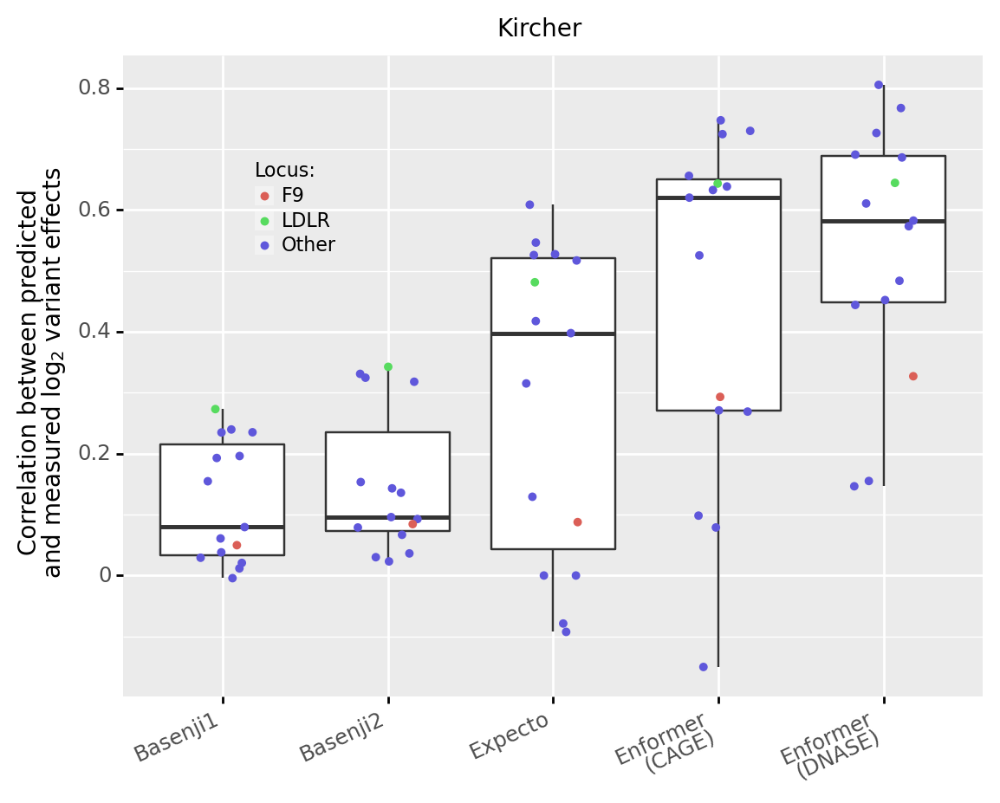

<ggplot: (1405545698862)>

In [206]:
scale = 1.0
p9.options.figure_size = (6.4*scale, 4.8*scale)

corr_df_full_molten = corr_df_full.melt('locus')
corr_df_full_molten = corr_df_full_molten.loc[corr_df_full_molten.variable.str.startswith('r')]
corr_df_full_molten["Model"] = corr_df_full_molten["variable"].apply(lambda x: x.split("_")[1].capitalize())
corr_df_full_molten["pred_type"] = corr_df_full_molten["variable"].apply(lambda x: x.split("_")[2] if len(x.split("_")) > 2 else "CAGE")
corr_df_full_molten["Prediction"] = corr_df_full_molten["pred_type"].apply(lambda x: "Expression" if x == "CAGE" else "Accessibility")

corr_df_full_molten["Model_cat"] = pd.Categorical(corr_df_full_molten["Model"], categories = ["Basenji1","Basenji2", 
                                                                    "Expecto","Enformer"])
corr_df_full_molten["Prediction"] = pd.Categorical(corr_df_full_molten["Prediction"], categories = ["Expression","Accessibility"])

corr_df_full_both_enformer = corr_df_full_molten.query('pred_type == "CAGE" or Model_cat == "Enformer"')
corr_df_full_both_enformer["Model_both"] = corr_df_full_both_enformer.apply(lambda x: x["Model"] if x["Model"] != "Enformer" else ("Enformer\n(CAGE)" if x["pred_type"] == "CAGE" else "Enformer\n(DNASE)"), 
                                                                     axis=1)
corr_df_full_both_enformer["Model_both"] = pd.Categorical(corr_df_full_both_enformer["Model_both"], categories = ["Basenji1","Basenji2", 
                                                                    "Expecto","Enformer\n(CAGE)","Enformer\n(DNASE)"])
corr_df_full_both_enformer["special_points"] = corr_df_full_both_enformer.apply(lambda x: x["locus"] if (x["locus"] in ["F9","LDLR"]) else "Other",axis=1)

p = (p9.ggplot(data=corr_df_full_both_enformer,mapping=p9.aes(x="Model_both",y='value'))
 + p9.geom_boxplot()
 + p9.geom_jitter(width=0.2,size=1,mapping=p9.aes(color="special_points"))
 #+ p9.geom_line(p9.aes(group="locus"))
 + p9.labs(x="", y="Correlation between predicted\nand measured $\mathregular{log_2}$ variant effects",
           title="Kircher",color="Locus:")
 #+ p9.scale_alpha_discrete(range=(0.7,1))
 #+ p9.scale_fill_manual(aesthetics = "fill", values = colors, labels = labels[1:2],
 #                   breaks = names(colors)[1:2], name = "First Group:")
 + p9.theme(legend_text=p9.element_text(size=8),legend_key_size=8,
            legend_box_margin=0,
            title=p9.element_text(size=10),
            legend_background=p9.element_blank(),
            legend_title=p9.element_text(size=8),
            axis_title=p9.element_text(size=10),#p9.element_rect(color="none", size=2, fill='none'),
            legend_position=(0.28,0.7),
            axis_text_x=p9.element_text(rotation=25, hjust=1))
)
p

In [207]:
p.save("Graphics/" + "kircher_box" + ".svg", width=2.5, height=2.8, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 2.5 x 2.8 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/kircher_box.svg


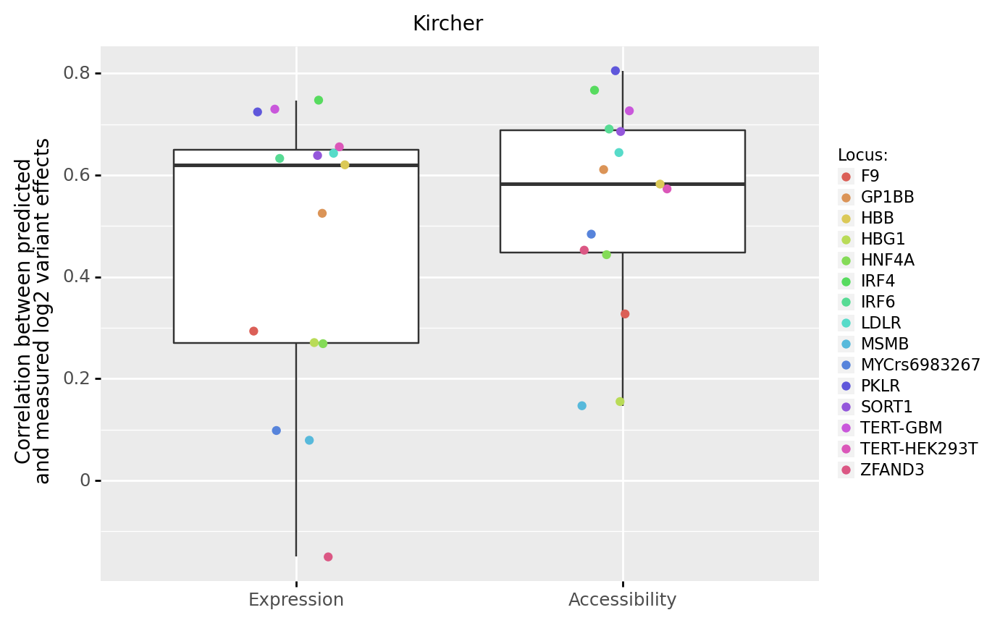

<ggplot: (1429240164612)>

In [245]:
p = (p9.ggplot(data=corr_df_full_molten.query('Model == "Enformer"'),mapping=p9.aes(x="Prediction",y='value'))
 + p9.geom_boxplot()
 + p9.geom_jitter(p9.aes(color="locus"),width=0.15)
 #+ p9.geom_line(p9.aes(group="locus"))
 + p9.labs(x="", y="Correlation between predicted\nand measured log2 variant effects",
           color="Locus:",title="Kircher")
 #+ p9.scale_alpha_discrete(range=(0.7,1))
 #+ p9.scale_fill_manual(aesthetics = "fill", values = colors, labels = labels[1:2],
 #                   breaks = names(colors)[1:2], name = "First Group:")
 + p9.theme(legend_text=p9.element_text(size=8),legend_key_size=8,
            legend_box_margin=0,
            title=p9.element_text(size=10),
            legend_background=p9.element_blank(),
            legend_title=p9.element_text(size=8),
            axis_title=p9.element_text(size=10))#p9.element_rect(color="none", size=2, fill='none'),
            #legend_position=(0.23,0.7))
            #axis_text_x=p9.element_text(rotation=30, hjust=1))
)
p

In [246]:
p.save("Graphics/" + "xsup_kircher_box" + ".svg", width=6.4, height=4.8, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 6.4 x 4.8 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/xsup_kircher_box.svg


In [208]:
scale = 1
p9.options.figure_size = (6.4*scale, 4.8*scale)

corrs_cage = corr_df[["locus","r"]]
corrs_cage["Method"] = "Enformer_CAGE"
corrs_dnase = corr_df_dnase[["locus","r"]]
corrs_dnase["Method"] = "Enformer_DNASE"
corrs_expecto = corr_df_expecto[["locus","r"]]
corrs_expecto["Method"] = "Expecto"

pooled_locus = "Pooled"
avg_locus = "Average\nover loci"
med_locus = "Median\nlocus"

aggregvals_cage = pd.DataFrame([{"locus":pooled_locus, "Method":"Enformer_CAGE","r":scipy.stats.pearsonr(cellmatched_merged["log2_pred"],cellmatched_merged["log2FC"])[0]},
             {"locus":avg_locus, "Method":"Enformer_CAGE","r":np.abs(corr_df["r"]).mean()},
             {"locus":med_locus, "Method":"Enformer_CAGE","r":corr_df["r"].median()}])
aggregvals_dnase = pd.DataFrame([{"locus":pooled_locus, "Method":"Enformer_DNASE","r":scipy.stats.pearsonr(cellmatched_merged_dnase["log2_pred"],cellmatched_merged_dnase["log2FC"])[0]},
             {"locus":avg_locus, "Method":"Enformer_DNASE","r":np.abs(corr_df_dnase["r"]).mean()},
             {"locus":med_locus, "Method":"Enformer_DNASE","r":corr_df_dnase["r"].median()}])

aggregvals_expecto = pd.DataFrame([{"locus":pooled_locus, "Method":"Expecto","r":scipy.stats.pearsonr(expecto_pred["pred_col"],expecto_pred["log2FC"])[0]},
             {"locus":avg_locus, "Method":"Expecto","r":np.abs(corr_df_expecto["r"]).mean()},
             {"locus":med_locus, "Method":"Expecto","r":corr_df_expecto["r"].median()}])

aggregvals_cage_basenji2 = pd.DataFrame([{"locus":pooled_locus, "Method":"Basenji2_CAGE","r":scipy.stats.pearsonr(cellmatched_merged_basenji2["log2_pred"],cellmatched_merged_basenji2["log2FC"])[0]},
             {"locus":avg_locus, "Method":"Basenji2_CAGE","r":np.abs(corr_df_basenji2["r"]).mean()},
             {"locus":med_locus, "Method":"Basenji2_CAGE","r":corr_df_basenji2["r"].median()}])
aggregvals_dnase_basenji2 = pd.DataFrame([{"locus":pooled_locus, "Method":"Basenji2_DNASE","r":scipy.stats.pearsonr(cellmatched_merged_dnase_basenji2["log2_pred"],cellmatched_merged_dnase_basenji2["log2FC"])[0]},
             {"locus":avg_locus, "Method":"Basenji2_DNASE","r":np.abs(corr_df_dnase_basenji2["r"]).mean()},
             {"locus":med_locus, "Method":"Basenji2_DNASE","r":corr_df_dnase_basenji2["r"].median()}])

aggregvals_cage_basenji1 = pd.DataFrame([{"locus":pooled_locus, "Method":"Basenji1_CAGE","r":scipy.stats.pearsonr(cellmatched_merged_basenji1["log2_pred"],cellmatched_merged_basenji1["log2FC"])[0]},
             {"locus":avg_locus, "Method":"Basenji1_CAGE","r":np.abs(corr_df_basenji1["r"]).mean()},
             {"locus":med_locus, "Method":"Basenji1_CAGE","r":corr_df_basenji1["r"].median()}])
aggregvals_dnase_basenji1 = pd.DataFrame([{"locus":pooled_locus, "Method":"Basenji1_DNASE","r":scipy.stats.pearsonr(cellmatched_merged_dnase_basenji1["log2_pred"],cellmatched_merged_dnase_basenji1["log2FC"])[0]},
             {"locus":avg_locus, "Method":"Basenji1_DNASE","r":np.abs(corr_df_dnase_basenji1["r"]).mean()},
             {"locus":med_locus, "Method":"Basenji1_DNASE","r":corr_df_dnase_basenji1["r"].median()}])

#corrs_cage,corrs_dnase,corrs_expecto,
plot_df = pd.concat([aggregvals_cage,aggregvals_dnase,
                     aggregvals_expecto,
                     aggregvals_cage_basenji2,aggregvals_dnase_basenji2,
                     aggregvals_cage_basenji1,aggregvals_dnase_basenji1])

#plot_df["locus"] = pd.Categorical(plot_df["locus"], categories = list(corr_df_dnase.sort_values("r")["locus"]) + ["Pooled","Average","Median"])
plot_df["locus"] = pd.Categorical(plot_df["locus"], [pooled_locus,avg_locus,med_locus])

/scratch/tmp/karollus/ipykernel_1138238/868952028.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/scratch/tmp/karollus/ipykernel_1138238/868952028.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/scratch/tmp/karollus/ipykernel_1138238/868952028.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

In [209]:
plot_df["Model"] = plot_df["Method"].apply(lambda x: x.split("_")[0])
plot_df["Prediction"] = plot_df["Method"].apply(lambda x: "Accessibility" if "DNASE" in x else "Expression")

In [311]:
plot_df.to_csv(base_path_results + "kircher_table.tsv",sep="\t")

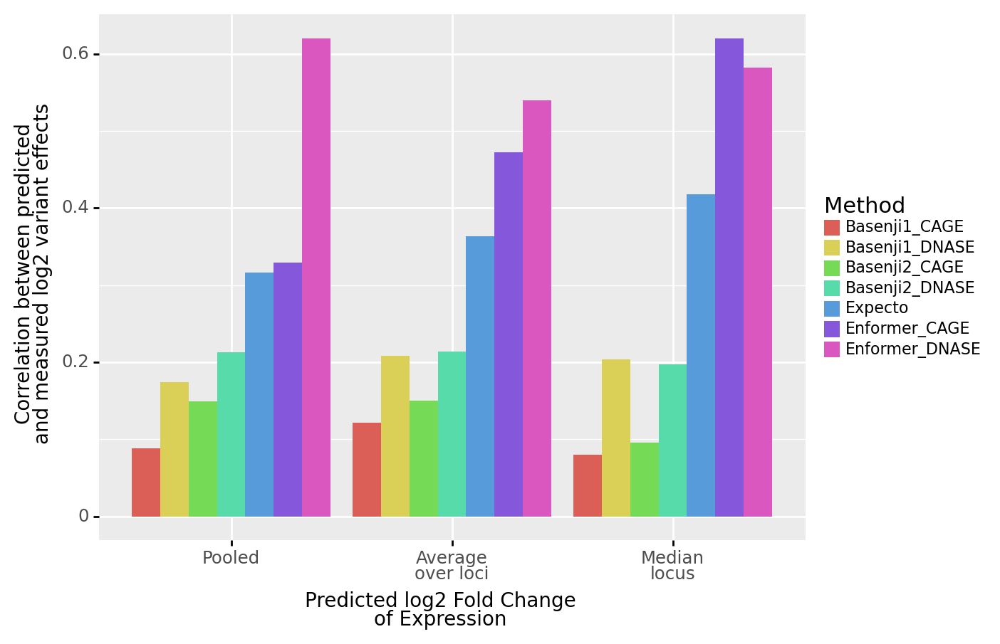

<ggplot: (1430704350233)>

In [314]:
plot_df["Method"] = pd.Categorical(plot_df["Method"], categories = ["Basenji1_CAGE", "Basenji1_DNASE","Basenji2_CAGE", "Basenji2_DNASE",
                                                                    "Expecto","Enformer_CAGE","Enformer_DNASE"])
plot_df["Model"] = pd.Categorical(plot_df["Model"], categories = ["Basenji1","Basenji2", 
                                                                    "Expecto","Enformer"])
plot_df["Prediction"] = pd.Categorical(plot_df["Prediction"], categories = ["Expression","Accessibility"])

p = (p9.ggplot(data=plot_df,mapping=p9.aes(x="locus",y='r',fill='Method'))
 + p9.geom_bar(stat="identity",position="dodge")
 + p9.labs(x="Predicted log2 Fold Change\nof Expression", y="Correlation between predicted\nand measured log2 variant effects")
 #+ p9.scale_alpha_discrete(range=(0.7,1))
 #+ p9.scale_fill_manual(aesthetics = "fill", values = colors, labels = labels[1:2],
 #                   breaks = names(colors)[1:2], name = "First Group:")
 + p9.theme(legend_text=p9.element_text(size=8),legend_key_size=8,
            legend_box_margin=0,
            legend_background=p9.element_blank(),
            axis_title=p9.element_text(size=10))#p9.element_rect(color="none", size=2, fill='none'),
            #legend_position=(0.23,0.7))
            #axis_text_x=p9.element_text(rotation=30, hjust=1))
)
p

In [315]:
p.save("Graphics/" + "kircher_bars" + ".svg", width=2.3, height=3.0, dpi=300)

/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Saving 2.3 x 3.0 in image.
/opt/modules/i12g/anaconda/envs/karollus-tfhub/lib/python3.9/site-packages/plotnine/ggplot.py:722: PlotnineWarning: Filename: Graphics/kircher_bars.svg


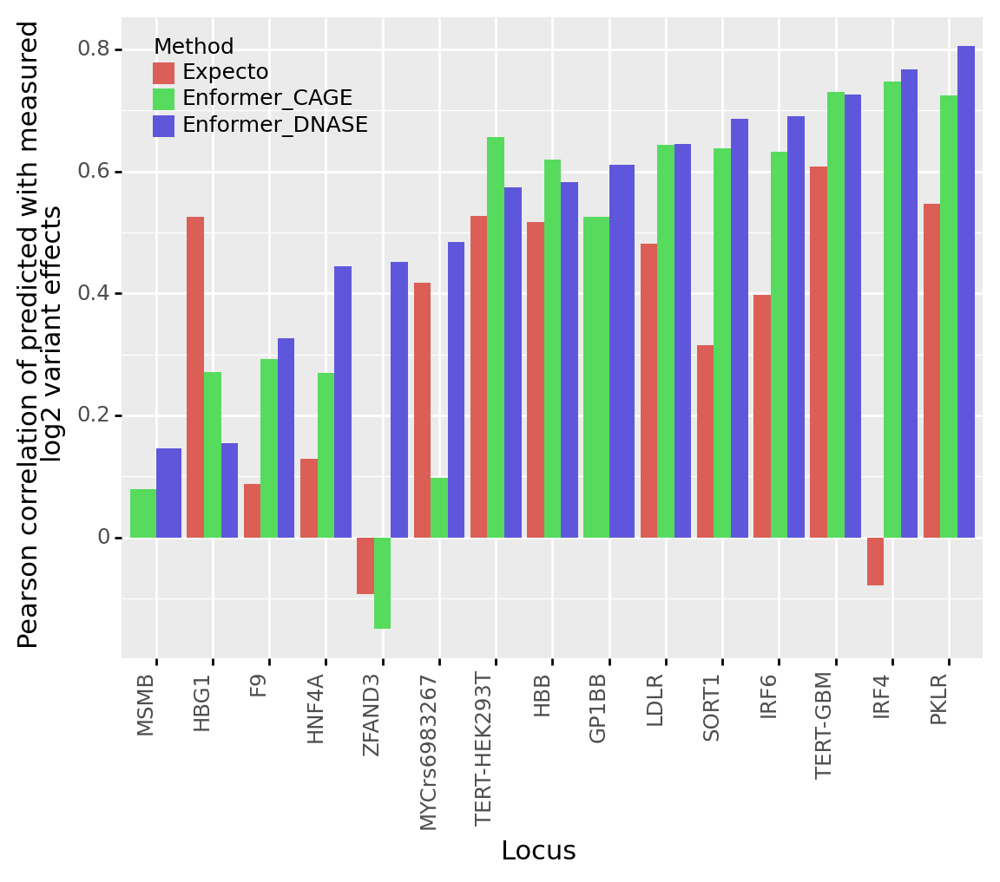

<ggplot: (1430328079065)>

In [591]:
scale = 1.0
p9.options.figure_size = (6.4*scale, 4.8*scale)

corrs_cage = corr_df[["locus","r"]]
corrs_cage["Method"] = "Enformer_CAGE"
corrs_dnase = corr_df_dnase[["locus","r"]]
corrs_dnase["Method"] = "Enformer_DNASE"
corrs_expecto = corr_df_expecto[["locus","r"]]
corrs_expecto["Method"] = "Expecto"
#corrs_cage_basenji2 = corr_df_basenji2[["locus","r"]]
#corrs_cage_basenji2["Method"] = "Basenji2_CAGE"
#corrs_dnase_basenji2 = corr_df_dnase_basenji2[["locus","r"]]
#corrs_dnase_basenji2["Method"] = "Basenji2_DNASE"

plot_df = pd.concat([corrs_cage,corrs_dnase,corrs_expecto])#,corrs_cage_basenji2,corrs_dnase_basenji2])

plot_df["locus"] = pd.Categorical(plot_df["locus"], categories = list(corr_df_dnase.sort_values("r")["locus"]))
plot_df["Method"] = pd.Categorical(plot_df["Method"], categories = ["Expecto","Enformer_CAGE","Enformer_DNASE"])

p = (p9.ggplot(data=plot_df.query('Method in ["Expecto","Enformer_CAGE","Enformer_DNASE"]')
           ,mapping=p9.aes(x="locus",y='r',fill='Method'))
 + p9.geom_bar(stat="identity",position="dodge")
 + p9.labs(x="Locus", y="Pearson correlation of predicted with measured\nlog2 variant effects")
 + p9.theme(axis_text_x=p9.element_text(rotation=90, hjust=1), legend_box_margin=0,
            legend_position=(0.25,0.8),legend_background=p9.element_blank(),
           legend_title=p9.element_text(size=9), legend_key_size=9, legend_text=p9.element_text(size=9))
)
p

In [592]:
p.save("Graphics/" + "xsup_kircher_bars" + ".svg", width=6.4, height=4.8, dpi=300)